In [1]:
import os
import sys
import numpy as np
import matplotlib.pyplot as plt

# Add the directory where dynamics.py and utils.py are located to sys.path
module_path = os.path.abspath(os.path.join('../../src'))
if module_path not in sys.path:
    sys.path.append(module_path)

from tqdm import tqdm

from scipy.optimize import fsolve
from scipy.stats import vonmises_fisher
from scipy.optimize import approx_fprime
from scipy.linalg import block_diag, solve

from dynamics import SatelliteDynamics
from utils import get_form_initial_conditions

In [2]:
# Simulation parameters
dt = 60.0  # Time step [s]
T = 395  # Duration [min]
T_RMSE = 300  # Index from which the RMSE is calculated
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6  # Number of states
n_p = 3  
n_y_1 = 3  # Number of measurements
n_y_2 = 3 + 3 * 3
n_y_3 = 3 + 3 * 3
n_y_4 = 3 + 3 * 3
K = T
W = 1 # Window size [min]

In [3]:
# Initial state vector and get the true state vectors (propagation) F
X_initial = get_form_initial_conditions(formation)
X_true = np.zeros((24, 1, T))
X_true[:, :, 0] = X_initial
for t in range(T - 1):
    X_true[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_true[:, :, t])

# Observation noise
sigma_abs = 1e-1  # [m]
R_abs = np.diag(np.concatenate([sigma_abs * np.ones(3)])) ** 2
sigma_rel = 1e0  # [m]
R_rel = np.diag(np.concatenate([sigma_rel * np.ones(3)])) ** 2
sigma_ang = np.deg2rad(0.5)
def equation(k_ang, sigma_ang):
    # return 1 - 1 / (2 * k_ang) - 1 / (8 * k_ang ** 2) - 1 / (8 * k_ang ** 3) - np.exp(-sigma_ang ** 2 / 2)
    def stable_coth(x):
        if x > 700:  # Prevent overflow
            return 1 + 2 / (np.exp(2 * x) - 1)
        else:
            return np.cosh(x) / np.sinh(x)
    return stable_coth(k_ang) - 1 / k_ang - np.exp(-sigma_ang ** 2 / 2)
k_ang = fsolve(equation, x0=1.0, args=(sigma_ang))[0]

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P = np.array([[1, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0]])

/tmp/ipykernel_73063/4007323918.py:18: RuntimeWarning: overflow encountered in exp
  return 1 + 2 / (np.exp(2 * x) - 1)


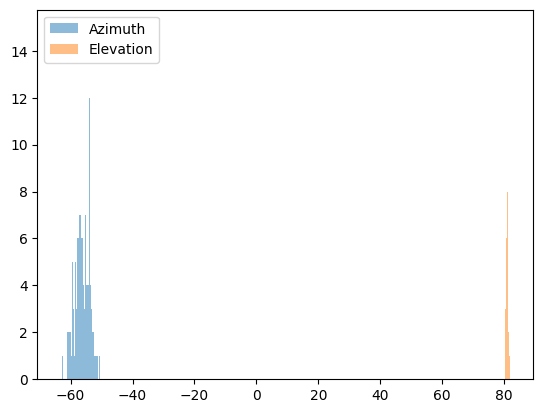

Azimuth std: 2.313181407956292 degrees
Elevation std: 0.3556089171330733 degrees
Kappa = 1 / min(var(az), var(el)) = 25959.718542497547, kappa should be = 26262.950803314492


In [4]:
def dxdydz2azi_ele(dx, dy, dz):
    azi = np.arctan2(dy, dx)
    ele = np.arctan2(dz, np.sqrt(dx**2 + dy**2))
    return np.rad2deg(azi), np.rad2deg(ele)

def azi_ele2dxdydz(azi, ele):
    azi = np.deg2rad(azi)
    ele = np.deg2rad(ele)
    dx = np.cos(ele) * np.cos(azi)
    dy = np.cos(ele) * np.sin(azi)
    dz = np.sin(ele)
    return dx, dy, dz

a = P @ X_true[:6, :, 0]
b = P @ X_true[6:12, :, 0]
c = a - b
normalized_c = c / np.linalg.norm(c)

set_c_with_noise = vonmises_fisher(normalized_c.reshape(-1), k_ang).rvs(1000)
az = []
el = []
for c_with_noise in set_c_with_noise:
    az_i, el_i = dxdydz2azi_ele(c_with_noise[0], c_with_noise[1], c_with_noise[2])
    az.append(az_i)
    el.append(el_i)
plt.hist(az, bins=360, alpha=0.5, label='Azimuth')
plt.hist(el, bins=360, alpha=0.5, label='Elevation')
plt.legend()
plt.show()

print(f"Azimuth std: {np.std(az)} degrees")
print(f"Elevation std: {np.std(el)} degrees")
print(f"Kappa = 1 / min(var(az), var(el)) = {1 / min(np.deg2rad(np.std(az))**2, np.deg2rad(np.std(el))**2)}, kappa should be = {k_ang}")

In [5]:
# In case kappa needs to be estimated
gamma = np.mean(set_c_with_noise, axis=0)
gamma_norm = np.linalg.norm(gamma)
gamma_norm * (3 - gamma_norm**2) / (1 - gamma_norm**2), (gamma_norm * 3 - gamma_norm) / (1 - gamma_norm**2) # Wiki, Filipa's thesis

(25581.214657907793, 25580.214696999737)

In [6]:
azi, ele = dxdydz2azi_ele(normalized_c[0], normalized_c[1], normalized_c[2])
dx, dy, dz = azi_ele2dxdydz(azi, ele)
normalized_c, azi, ele, np.array([dx, dy, dz])

(array([[ 0.08591572],
        [-0.12987116],
        [ 0.98780158]]),
 array([-56.51353727]),
 array([81.0415721]),
 array([[ 0.08591572],
        [-0.12987116],
        [ 0.98780158]]))

In [7]:
def h(x_vec):
    x_1_k = x_vec[:n_x]
    x_2_k = x_vec[n_x:2*n_x]
    x_3_k = x_vec[2*n_x:3*n_x]
    x_4_k = x_vec[3*n_x:]
    
    # Self measurements
    y_1_k = P @ x_1_k 
    
    # Relative range and bearing measurements
    d_21_k_vec = P @ x_2_k - P @ x_1_k
    d_23_k_vec = P @ x_2_k - P @ x_3_k
    d_24_k_vec = P @ x_2_k - P @ x_4_k
    d_31_k_vec = P @ x_3_k - P @ x_1_k
    d_32_k_vec = P @ x_3_k - P @ x_2_k
    d_34_k_vec = P @ x_3_k - P @ x_4_k
    d_41_k_vec = P @ x_4_k - P @ x_1_k
    d_42_k_vec = P @ x_4_k - P @ x_2_k
    d_43_k_vec = P @ x_4_k - P @ x_3_k
    
    d_21_k = np.linalg.norm(d_21_k_vec)
    d_23_k = np.linalg.norm(d_23_k_vec)
    d_24_k = np.linalg.norm(d_24_k_vec)
    d_31_k = np.linalg.norm(d_31_k_vec)
    d_32_k = np.linalg.norm(d_32_k_vec)
    d_34_k = np.linalg.norm(d_34_k_vec)
    d_41_k = np.linalg.norm(d_41_k_vec)
    d_42_k = np.linalg.norm(d_42_k_vec)
    d_43_k = np.linalg.norm(d_43_k_vec)
    
    y_2_k = np.vstack([d_21_k, d_23_k, d_24_k, d_21_k_vec / d_21_k, d_23_k_vec / d_23_k, d_24_k_vec / d_24_k])
    y_3_k = np.vstack([d_31_k, d_32_k, d_34_k, d_31_k_vec / d_31_k, d_32_k_vec / d_32_k, d_34_k_vec / d_34_k])
    y_4_k = np.vstack([d_41_k, d_42_k, d_43_k, d_41_k_vec / d_41_k, d_42_k_vec / d_42_k, d_43_k_vec / d_43_k])
    
    return y_1_k.reshape(-1), y_2_k.reshape(-1), y_3_k.reshape(-1), y_4_k.reshape(-1)

def h_with_noise(x_vec):
    y_1_k, y_2_k, y_3_k, y_4_k = h(x_vec)
    abs_noise = np.random.multivariate_normal(np.zeros(3), R_abs)
    y_1_k = y_1_k + abs_noise
    y_2_k_rel = y_2_k[:3]
    y_2_k_ang = y_2_k[3:]
    y_2_k = np.concatenate((
        y_2_k_rel + np.random.multivariate_normal(np.zeros(3), R_rel), 
        vonmises_fisher.rvs(y_2_k_ang[:3], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_2_k_ang[3:6], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_2_k_ang[6:], k_ang).reshape(-1),
    ))
    y_3_k_rel = y_3_k[:3]
    y_3_k_ang = y_3_k[3:]
    y_3_k = np.concatenate((    
        y_3_k_rel + np.random.multivariate_normal(np.zeros(3), R_rel), 
        vonmises_fisher.rvs(y_3_k_ang[:3], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_3_k_ang[3:6], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_3_k_ang[6:], k_ang).reshape(-1),
    ))
    y_4_k_rel = y_4_k[:3]
    y_4_k_ang = y_4_k[3:]
    y_4_k = np.concatenate((
        y_4_k_rel + np.random.multivariate_normal(np.zeros(3), R_rel), 
        vonmises_fisher.rvs(y_4_k_ang[:3], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_4_k_ang[3:6], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_4_k_ang[6:], k_ang).reshape(-1),
    ))
    return np.vstack([y_1_k.reshape(-1, 1), y_2_k.reshape(-1, 1), y_3_k.reshape(-1, 1), y_4_k.reshape(-1, 1)])

In [8]:
# Simulation setup
np.random.seed(42)
X_est = np.zeros_like(X_true)
initial_dev = np.concatenate(
    (
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
    )
)
X_est[:, :, 0] = X_initial + initial_dev
for t in range(T - 1):
    X_est[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_est[:, :, t])

# Observations
Y = np.zeros((39, 1, T))
for t in range(T):
    Y[:, :, t] = h_with_noise(X_true[:, :, t])
    
dev_chief_initial = np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).reshape(-1, 1)
dev_deputy1_initial = np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).reshape(-1, 1)
dev_deputy2_initial = np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).reshape(-1, 1)
dev_deputy3_initial = np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).reshape(-1, 1)

In [9]:
def f(x_0, y):
    f_x_0 = 0

    # Extract x_1(0), x_2(0), x_3(0), x_4(0) from flattened state vector x_0
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    # Iterate over all sliding window time steps
    for k in range(W):    
        # Get the observed data for each agent
        y_1_k = y[:n_y_1, :, k]
        y_2_k = y[n_y_1:n_y_1 + n_y_2, :, k]
        y_3_k = y[n_y_1 + n_y_2:n_y_1 + n_y_2 + n_y_3, :, k]
        y_4_k = y[n_y_1 + n_y_2 + n_y_3:, :, k]

        # Update the cost function with the residuals for self-measurements
        residual = y_1_k - P @ x_1_k
        f_x_0 += 1 / 2 * residual.T @ np.linalg.inv(R_abs) @ residual
        
        # Pairwise relative measurements and bearings in y_2_k, y_3_k, and y_4_k
        # y_2_k contains y_21, y_23, y_24 and u_21, u_23, u_24
        y_21_k = y_2_k[0]
        y_23_k = y_2_k[1]
        y_24_k = y_2_k[2]
        u_21_k = y_2_k[3:6]
        u_23_k = y_2_k[6:9]
        u_24_k = y_2_k[9:]

        # y_3_k contains y_31, y_32, y_34 and u_31, u_32, u_34
        y_31_k = y_3_k[0]
        y_32_k = y_3_k[1]
        y_34_k = y_3_k[2]
        u_31_k = y_3_k[3:6]
        u_32_k = y_3_k[6:9]
        u_34_k = y_3_k[9:]

        # y_4_k contains y_41, y_42, y_43 and u_41, u_42, u_43
        y_41_k = y_4_k[0]
        y_42_k = y_4_k[1]
        y_43_k = y_4_k[2]
        u_41_k = y_4_k[3:6]
        u_42_k = y_4_k[6:9]
        u_43_k = y_4_k[9:]

        # Process each pairwise measurement
        pairs = [
            (x_2_k, x_1_k, y_21_k, u_21_k),  # (2, 1)
            (x_2_k, x_3_k, y_23_k, u_23_k),  # (2, 3)
            (x_2_k, x_4_k, y_24_k, u_24_k),  # (2, 4)
            (x_3_k, x_1_k, y_31_k, u_31_k),  # (3, 1)
            (x_3_k, x_2_k, y_32_k, u_32_k),  # (3, 2)
            (x_3_k, x_4_k, y_34_k, u_34_k),  # (3, 4)
            (x_4_k, x_1_k, y_41_k, u_41_k),  # (4, 1)
            (x_4_k, x_2_k, y_42_k, u_42_k),  # (4, 2)
            (x_4_k, x_3_k, y_43_k, u_43_k)   # (4, 3)
        ]

        # Iterate over each pair and update the cost function with the residuals for pairwise measurements
        for x_i_k, x_j_k, y_ij_k, u_ij_k in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            
            f_x_0 += (y_ij_k - d_ij_k) ** 2 / (2 * sigma_rel**2) # Range
            
            f_x_0 -= k_ang * u_ij_k.T @ d_ij_k_vec / d_ij_k # Bearing
        
        if k < W - 1:
            # Get x_1(k), x_2(k), x_3(k), x_4(k) from the state vector x_0
            x_1_k = SatelliteDynamics().x_new(dt, x_1_k)
            x_2_k = SatelliteDynamics().x_new(dt, x_2_k)
            x_3_k = SatelliteDynamics().x_new(dt, x_3_k)
            x_4_k = SatelliteDynamics().x_new(dt, x_4_k)

    return f_x_0

def grad_f(x_0, y):
    grad_f_x_0 = np.zeros_like(x_0)

    # Extract x_1(0), x_2(0), x_3(0), x_4(0) from flattened state vector x_0
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    STM_t0_1 = np.eye(n_x)
    STM_t0_2 = np.eye(n_x)
    STM_t0_3 = np.eye(n_x)
    STM_t0_4 = np.eye(n_x)
    
    # Iterate over all sliding window time steps
    for k in range(W):
        # Get the observed data for each agent
        y_1_k = y[:n_y_1, :, k]
        y_2_k = y[n_y_1:n_y_1 + n_y_2, :, k]
        y_3_k = y[n_y_1 + n_y_2:n_y_1 + n_y_2 + n_y_3, :, k]
        y_4_k = y[n_y_1 + n_y_2 + n_y_3:, :, k]

        # Compute gradients for the absolute residual terms
        grad_f_x_0[:n_x, :] -= STM_t0_1.T @ P.T @ np.linalg.inv(R_abs) @ (y_1_k - P @ x_1_k)

        # Pairwise relative measurements and bearings in y_2_k, y_3_k, and y_4_k
        # y_2_k contains y_21, y_23, y_24 and u_21, u_23, u_24
        y_21_k = y_2_k[0]
        y_23_k = y_2_k[1]
        y_24_k = y_2_k[2]
        u_21_k = y_2_k[3:6]
        u_23_k = y_2_k[6:9]
        u_24_k = y_2_k[9:]

        # y_3_k contains y_31, y_32, y_34 and u_31, u_32, u_34
        y_31_k = y_3_k[0]
        y_32_k = y_3_k[1]
        y_34_k = y_3_k[2]
        u_31_k = y_3_k[3:6]
        u_32_k = y_3_k[6:9]
        u_34_k = y_3_k[9:]

        # y_4_k contains y_41, y_42, y_43 and u_41, u_42, u_43
        y_41_k = y_4_k[0]
        y_42_k = y_4_k[1]
        y_43_k = y_4_k[2]
        u_41_k = y_4_k[3:6]
        u_42_k = y_4_k[6:9]
        u_43_k = y_4_k[9:]

        # Process each pairwise measurement
        pairs = [
            (2, 1, x_2_k, x_1_k, y_21_k, u_21_k, STM_t0_2, STM_t0_1),  # (2, 1)
            (2, 3, x_2_k, x_3_k, y_23_k, u_23_k, STM_t0_2, STM_t0_3),  # (2, 3)
            (2, 4, x_2_k, x_4_k, y_24_k, u_24_k, STM_t0_2, STM_t0_4),  # (2, 4)
            (3, 1, x_3_k, x_1_k, y_31_k, u_31_k, STM_t0_3, STM_t0_1),  # (3, 1)
            (3, 2, x_3_k, x_2_k, y_32_k, u_32_k, STM_t0_3, STM_t0_2),  # (3, 2)
            (3, 4, x_3_k, x_4_k, y_34_k, u_34_k, STM_t0_3, STM_t0_4),  # (3, 4)
            (4, 1, x_4_k, x_1_k, y_41_k, u_41_k, STM_t0_4, STM_t0_1),  # (4, 1)
            (4, 2, x_4_k, x_2_k, y_42_k, u_42_k, STM_t0_4, STM_t0_2),  # (4, 2)
            (4, 3, x_4_k, x_3_k, y_43_k, u_43_k, STM_t0_4, STM_t0_3)   # (4, 3)
        ]
        
        # Iterate over each pair and compute gradients
        for i, j, x_i_k, x_j_k, y_ij_k, u_ij_k, STM_t0_i, STM_t0_j in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)

            # Range
            grad_f_x_0[(i - 1) * n_x:i * n_x, :] -= (y_ij_k - d_ij_k) / sigma_rel**2 * (STM_t0_i.T @ P.T @ d_ij_k_vec) / d_ij_k
            grad_f_x_0[(j - 1) * n_x:j * n_x, :] += (y_ij_k - d_ij_k) / sigma_rel**2 * (STM_t0_j.T @ P.T @ d_ij_k_vec) / d_ij_k
            
            # Bearing
            grad_f_x_0[(i - 1) * n_x:i * n_x, :] -= k_ang * STM_t0_i.T @ (P.T / d_ij_k - P.T @ d_ij_k_vec @ d_ij_k_vec.T / d_ij_k**3) @ u_ij_k
            grad_f_x_0[(j - 1) * n_x:j * n_x, :] += k_ang * STM_t0_j.T @ (P.T / d_ij_k - P.T @ d_ij_k_vec @ d_ij_k_vec.T / d_ij_k**3) @ u_ij_k
        
        if k < W - 1:
            # Get x_1(k), x_2(k), x_3(k), x_4(k) from the state vector x_0
            STM_t0_1_old = STM_t0_1
            STM_t0_2_old = STM_t0_2
            STM_t0_3_old = STM_t0_3
            STM_t0_4_old = STM_t0_4
            x_1_k, STM_t0_1 = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, STM_t0_2 = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, STM_t0_3 = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, STM_t0_4 = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            STM_t0_1 = STM_t0_1 @ STM_t0_1_old
            STM_t0_2 = STM_t0_2 @ STM_t0_2_old
            STM_t0_3 = STM_t0_3 @ STM_t0_3_old
            STM_t0_4 = STM_t0_4 @ STM_t0_4_old

    return grad_f_x_0

def hessian_f(x_0, y):
    hessian_f_x_0 = np.zeros((x_0.shape[0], x_0.shape[0]))  # Initialize Hessian matrix
    
    # Extract x_1(0), x_2(0), x_3(0), x_4(0) from flattened state vector x_0
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    STM_t0_1 = np.eye(n_x)
    STM_t0_2 = np.eye(n_x)
    STM_t0_3 = np.eye(n_x)
    STM_t0_4 = np.eye(n_x)

    # Iterate over all sliding window time steps
    for k in range(W):
        # Get the observed data for each agent
        y_1_k = y[:n_y_1, :, k]
        y_2_k = y[n_y_1:n_y_1 + n_y_2, :, k]
        y_3_k = y[n_y_1 + n_y_2:n_y_1 + n_y_2 + n_y_3, :, k]
        y_4_k = y[n_y_1 + n_y_2 + n_y_3:, :, k]

        # Absolute measurement residuals' Hessian
        hessian_f_x_0[:n_x, :n_x] += STM_t0_1.T @ P.T @ np.linalg.inv(R_abs) @ P @ STM_t0_1 

        # Pairwise relative measurements and bearings in y_2_k, y_3_k, and y_4_k
        # y_2_k contains y_21, y_23, y_24 and u_21, u_23, u_24
        y_21_k = y_2_k[0]
        y_23_k = y_2_k[1]
        y_24_k = y_2_k[2]
        u_21_k = y_2_k[3:6]
        u_23_k = y_2_k[6:9]
        u_24_k = y_2_k[9:]

        # y_3_k contains y_31, y_32, y_34 and u_31, u_32, u_34
        y_31_k = y_3_k[0]
        y_32_k = y_3_k[1]
        y_34_k = y_3_k[2]
        u_31_k = y_3_k[3:6]
        u_32_k = y_3_k[6:9]
        u_34_k = y_3_k[9:]

        # y_4_k contains y_41, y_42, y_43 and u_41, u_42, u_43
        y_41_k = y_4_k[0]
        y_42_k = y_4_k[1]
        y_43_k = y_4_k[2]
        u_41_k = y_4_k[3:6]
        u_42_k = y_4_k[6:9]
        u_43_k = y_4_k[9:]

        # Process each pairwise measurement
        pairs = [
            (2, 1, x_2_k, x_1_k, y_21_k, u_21_k, STM_t0_2, STM_t0_1),  # (2, 1)
            (2, 3, x_2_k, x_3_k, y_23_k, u_23_k, STM_t0_2, STM_t0_3),  # (2, 3)
            (2, 4, x_2_k, x_4_k, y_24_k, u_24_k, STM_t0_2, STM_t0_4),  # (2, 4)
            (3, 1, x_3_k, x_1_k, y_31_k, u_31_k, STM_t0_3, STM_t0_1),  # (3, 1)
            (3, 2, x_3_k, x_2_k, y_32_k, u_32_k, STM_t0_3, STM_t0_2),  # (3, 2)
            (3, 4, x_3_k, x_4_k, y_34_k, u_34_k, STM_t0_3, STM_t0_4),  # (3, 4)
            (4, 1, x_4_k, x_1_k, y_41_k, u_41_k, STM_t0_4, STM_t0_1),  # (4, 1)
            (4, 2, x_4_k, x_2_k, y_42_k, u_42_k, STM_t0_4, STM_t0_2),  # (4, 2)
            (4, 3, x_4_k, x_3_k, y_43_k, u_43_k, STM_t0_4, STM_t0_3)   # (4, 3)
        ]

        # Iterate over each pair and compute gradients
        for i, j, x_i_k, x_j_k, y_ij_k, u_ij_k, STM_t0_i, STM_t0_j in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)

            # Update the Hessian for x_i(k) and x_j(k)
            idx_i = n_x * (i - 1)
            idx_j = n_x * (j - 1)
            
            # Range
            hessian_range_common = (y_ij_k - d_ij_k) / d_ij_k * P.T @ P - y_ij_k / d_ij_k**3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ P
            hessian_f_x_0[idx_i:idx_i + n_x, idx_i:idx_i + n_x] -= 1 / (sigma_rel ** 2) * (STM_t0_i.T @ hessian_range_common @ STM_t0_i)
            hessian_f_x_0[idx_i:idx_i + n_x, idx_j:idx_j + n_x] += 1 / (sigma_rel ** 2) * (STM_t0_i.T @ hessian_range_common @ STM_t0_j)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_i:idx_i + n_x] += 1 / (sigma_rel ** 2) * (STM_t0_j.T @ hessian_range_common @ STM_t0_i)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_j:idx_j + n_x] -= 1 / (sigma_rel ** 2) * (STM_t0_j.T @ hessian_range_common @ STM_t0_j)
            
            # Bearing
            hessian_ang_common = 3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ u_ij_k @ d_ij_k_vec.T @ P / d_ij_k**5 - P.T @ (u_ij_k @ d_ij_k_vec.T + d_ij_k_vec.T @ u_ij_k * np.eye(3) + d_ij_k_vec @ u_ij_k.T) @ P / d_ij_k**3
            hessian_f_x_0[idx_i:idx_i + n_x, idx_i:idx_i + n_x] -= k_ang * (STM_t0_i.T @ hessian_ang_common @ STM_t0_i)
            hessian_f_x_0[idx_i:idx_i + n_x, idx_j:idx_j + n_x] += k_ang * (STM_t0_i.T @ hessian_ang_common @ STM_t0_j)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_i:idx_i + n_x] += k_ang * (STM_t0_j.T @ hessian_ang_common @ STM_t0_i)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_j:idx_j + n_x] -= k_ang * (STM_t0_j.T @ hessian_ang_common @ STM_t0_j)

        if k < W - 1:
            # Get x_1(k), x_2(k), x_3(k), x_4(k) from the state vector x_0
            STM_t0_1_old = STM_t0_1
            STM_t0_2_old = STM_t0_2
            STM_t0_3_old = STM_t0_3
            STM_t0_4_old = STM_t0_4
            x_1_k, STM_t0_1 = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, STM_t0_2 = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, STM_t0_3 = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, STM_t0_4 = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            STM_t0_1 = STM_t0_1 @ STM_t0_1_old
            STM_t0_2 = STM_t0_2 @ STM_t0_2_old
            STM_t0_3 = STM_t0_3 @ STM_t0_3_old
            STM_t0_4 = STM_t0_4 @ STM_t0_4_old

    return hessian_f_x_0

In [10]:
def L(x_0, y):
    return f(x_0, y)
    
def grad_L(x_0, y):
    return grad_f(x_0, y)

def hessian_L(x_0, y):
    return hessian_f(x_0, y)

In [11]:
class approxH_Newton:
    def __init__(self, grad_tol=1e-9, max_iter=20):
        self.grad_tol = grad_tol
        self.max_iter = max_iter
        
        # Storage for results
        self.cost_function_values = []
        self.grad_norm_values = []

    def solve(self, x_init, Y, X_true):
        x = x_init
            
        prev_cost_function_value = None
        prev_grad_norm_value = None
        prev_global_error = None
        
        for iteration in range(self.max_iter):
            # Compute the cost function, gradient and approximated Hessian
            L_x = L(x, Y)
            grad_L_x = grad_L(x, Y)
            hessian_L_x = hessian_L(x, Y)

            # Convergence tracking
            cost_function_value = L_x[0][0]
            grad_norm_value = np.linalg.norm(grad_L_x)

            # Store the norms
            self.cost_function_values.append(cost_function_value)
            self.grad_norm_values.append(grad_norm_value)
            
            if prev_cost_function_value is not None:
                cost_function_change = (cost_function_value - prev_cost_function_value) / abs(prev_cost_function_value) * 100
                grad_norm_change = (grad_norm_value - prev_grad_norm_value) / abs(prev_grad_norm_value) * 100
                global_error_change = (np.linalg.norm(x - X_true) - prev_global_error) / abs(prev_global_error) * 100
            prev_cost_function_value = cost_function_value
            prev_grad_norm_value = grad_norm_value
            prev_global_error = np.linalg.norm(x - X_true)

            # Check convergence and print metrics
            if grad_norm_value < self.grad_tol or iteration + 1 == self.max_iter:
                print(f"STOP on Iteration {iteration}\nCost function = {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm = {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error = {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                print(f"Final position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
                break
            else:
                if iteration == 0:
                    print(f"Before applying the algorithm\nCost function: {cost_function_value}\nGradient norm: {grad_norm_value}\nGlobal relative error: {np.linalg.norm(x - X_true)}")
                else:
                    print(f"Iteration {iteration}\nCost function: {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm: {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error: {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                    
            # Print relative errors 
            print(f"Position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
            
            # Solve for the Newton step
            delta_x = - np.linalg.pinv(hessian_L_x) @ grad_L_x
            # delta_x = solve(hessian_L_x, -grad_L_x)
            x += delta_x

        return x

In [12]:
def give_me_the_plots(cost_function_values, grad_norm_values):
    iterations = np.arange(0, len(cost_function_values))

    # Plot 1
    plt.semilogy(iterations, cost_function_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$L(x^{(m)})$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()
    
    # Plot 2
    plt.semilogy(iterations, grad_norm_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$||\nabla L(x^{(m)})||_2$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()

Windows:   0%|          | 0/395 [00:00<?, ?it/s]

Before applying the algorithm
Cost function: 399793.51933494647
Gradient norm: 8631.336705114092
Global relative error: 395.60563949432424
Position relative errors: 82.78540989608044 m, 181.7491507333766 m, 258.73787052498585 m, 222.8729633755392 m

Iteration 1
Cost function: -191444.51955960726 (-147.89%)
Gradient norm: 693.9027985818743 (-91.96%)
Global relative error: 347.2244657231626 (-12.23%)
Position relative errors: 0.1278062043625924 m, 155.02307313402625 m, 152.7902521987575 m, 270.53243469736407 m

Iteration 2
Cost function: -232683.76048033842 (-21.54%)
Gradient norm: 293.1086049538602 (-57.76%)
Global relative error: 120.05368758299336 (-65.42%)
Position relative errors: 0.12780620436259893 m, 69.9137919774156 m, 66.96850197699784 m, 70.99403027012809 m

Iteration 3
Cost function: -235936.25418206683 (-1.40%)
Gradient norm: 94.24775742431538 (-67.85%)
Global relative error: 31.24562052862035 (-73.97%)
Position relative errors: 0.1278062043625755 m, 11.416519581911576 m, 23

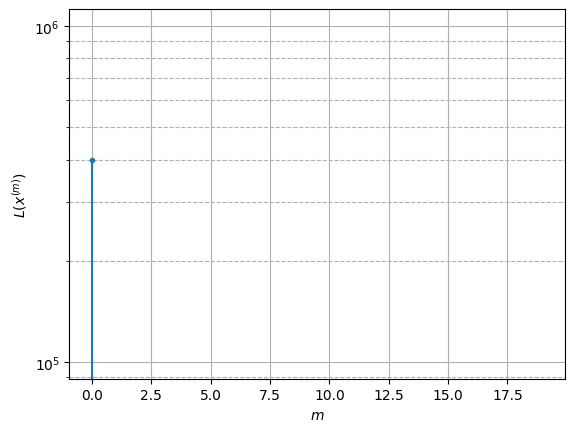

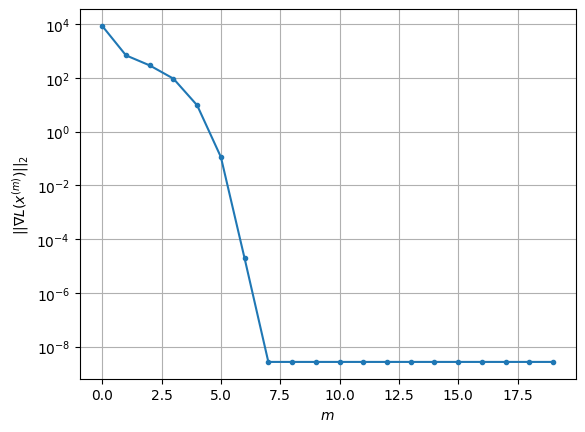

Windows:   0%|          | 1/395 [00:00<03:35,  1.83it/s]

Before applying the algorithm
Cost function: -236318.57467694613
Gradient norm: 80.50683289214331
Global relative error: 10.91199098387709
Position relative errors: 0.9067582313660109 m, 6.213374647266843 m, 6.079276739850853 m, 6.533379857042606 m

Iteration 1
Cost function: -236358.19838766276 (-0.02%)
Gradient norm: 0.02884987262551251 (-99.96%)
Global relative error: 4.539473672152064 (-58.40%)
Position relative errors: 0.17015850108576994 m, 2.2510808845901438 m, 2.8941718748917435 m, 2.6708832089074215 m

Iteration 2
Cost function: -236358.1985501318 (-0.00%)
Gradient norm: 2.9451645768691863e-06 (-99.99%)
Global relative error: 4.505585896732843 (-0.75%)
Position relative errors: 0.17015850108576994 m, 2.2501846611197633 m, 2.8647746253394097 m, 2.645832854802825 m

Iteration 3
Cost function: -236358.19855013184 (-0.00%)
Gradient norm: 1.2953089135581898e-09 (-99.96%)
Global relative error: 4.505579471308693 (-0.00%)
Position relative errors: 0.17015850108576994 m, 2.25018407456

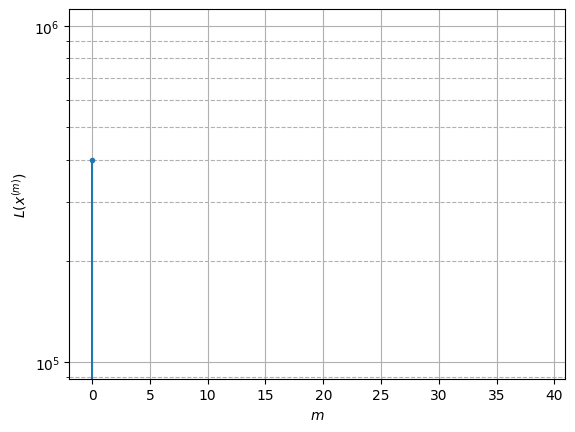

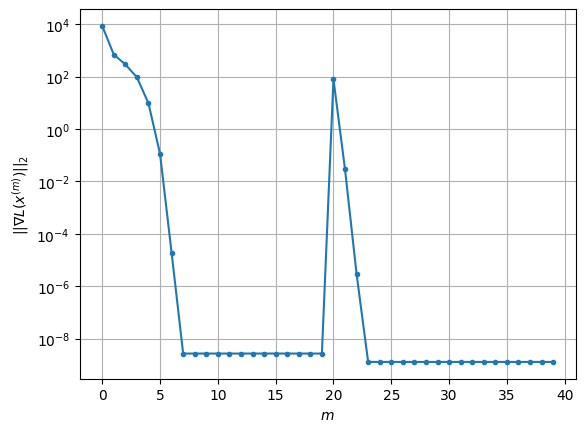

Windows:   1%|          | 2/395 [00:01<03:15,  2.01it/s]

Before applying the algorithm
Cost function: -236296.16898583752
Gradient norm: 103.8306111924557
Global relative error: 5.145908390846324
Position relative errors: 1.063709910700604 m, 2.7515682025644383 m, 3.2717724701249336 m, 2.6594399815570755 m

Iteration 1
Cost function: -236355.59080271874 (-0.03%)
Gradient norm: 0.08096116528100171 (-99.92%)
Global relative error: 7.234675465999699 (40.59%)
Position relative errors: 0.03947951658930125 m, 5.910261624480149 m, 3.3835367019288682 m, 2.44106670848646 m

Iteration 2
Cost function: -236355.59185341705 (-0.00%)
Gradient norm: 1.5004609817627917e-05 (-99.98%)
Global relative error: 7.314254386779771 (1.10%)
Position relative errors: 0.03947951658930125 m, 5.965515560305189 m, 3.4356269152157393 m, 2.4708702300554646 m

STOP on Iteration 3
Cost function = -236355.59185341708 (-0.00%)
Gradient norm = 8.18910011997702e-10 (-99.99%)
Global relative error = 7.3142894139385595 (0.00%)
Final position relative errors: 0.03947951658930125 m, 

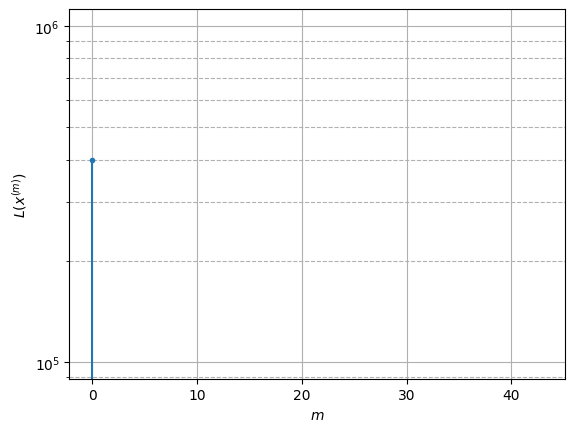

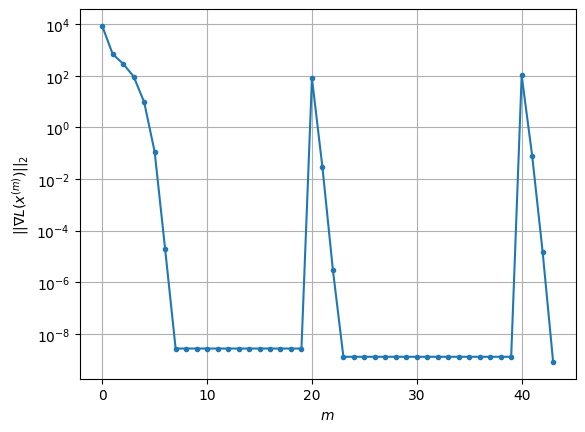

Windows:   1%|          | 3/395 [00:01<03:07,  2.09it/s]

Before applying the algorithm
Cost function: -236305.06581122457
Gradient norm: 98.50553686583655
Global relative error: 7.389390703456461
Position relative errors: 0.9698178803584412 m, 5.750159405608033 m, 3.2109170098408586 m, 3.207424593855666 m

Iteration 1
Cost function: -236362.5185178502 (-0.02%)
Gradient norm: 0.11756534684447888 (-99.88%)
Global relative error: 8.47107661014331 (14.64%)
Position relative errors: 0.07449940827965039 m, 5.188103401817637 m, 4.747861062773663 m, 4.7216874849698955 m

Iteration 2
Cost function: -236362.52113008546 (-0.00%)
Gradient norm: 4.2076224477206275e-05 (-99.96%)
Global relative error: 8.4275957375765 (-0.51%)
Position relative errors: 0.07449940827965039 m, 5.134464156913604 m, 4.725578185720497 m, 4.724865489957136 m

Iteration 3
Cost function: -236362.52113008624 (-0.00%)
Gradient norm: 1.81956249985357e-09 (-100.00%)
Global relative error: 8.427520760532323 (-0.00%)
Position relative errors: 0.07449940827965039 m, 5.134396858536336 m, 

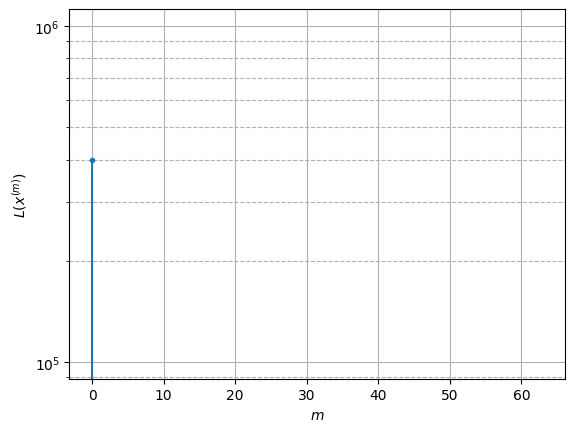

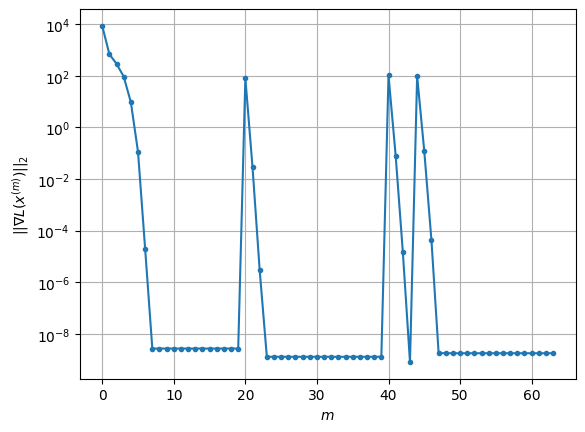

Windows:   1%|          | 4/395 [00:01<02:58,  2.19it/s]

Before applying the algorithm
Cost function: -236305.56328763507
Gradient norm: 92.06591765818692
Global relative error: 9.06868938860326
Position relative errors: 0.9477143089323076 m, 5.230042812670352 m, 5.301593526898322 m, 5.08744271420112 m

Iteration 1
Cost function: -236356.67261787457 (-0.02%)
Gradient norm: 0.08248357977635544 (-99.91%)
Global relative error: 6.386848143668516 (-29.57%)
Position relative errors: 0.2081783336292257 m, 1.8764879312328508 m, 3.9571457288600134 m, 4.644096469462542 m

Iteration 2
Cost function: -236356.67600210046 (-0.00%)
Gradient norm: 0.00015038994923290843 (-99.82%)
Global relative error: 6.107927719519499 (-4.37%)
Position relative errors: 0.2081783336292257 m, 1.7504042548178795 m, 3.695356168796992 m, 4.532462999321034 m

Iteration 3
Cost function: -236356.67600210372 (-0.00%)
Gradient norm: 1.880878017781873e-09 (-100.00%)
Global relative error: 6.107735626496185 (-0.00%)
Position relative errors: 0.2081783336292257 m, 1.7503131052513117 

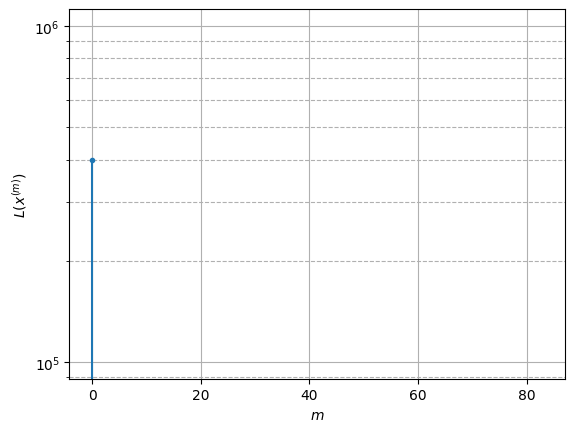

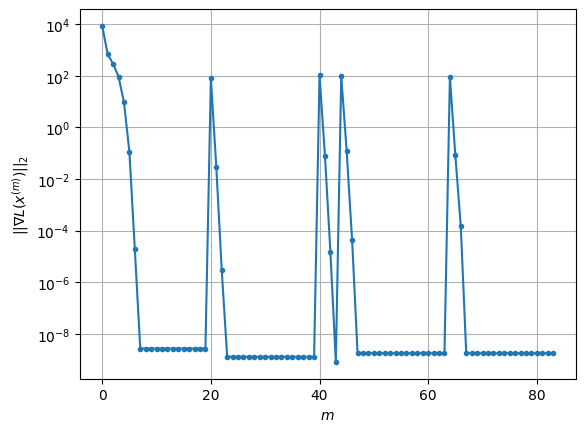

Windows:   1%|▏         | 5/395 [00:02<03:07,  2.07it/s]

Before applying the algorithm
Cost function: -236308.5475508141
Gradient norm: 95.7868419367478
Global relative error: 6.22339244671347
Position relative errors: 1.0272149600601141 m, 1.5377726268295966 m, 4.002049795764653 m, 4.392452664795305 m

Iteration 1
Cost function: -236359.95304913787 (-0.02%)
Gradient norm: 0.03709175167702291 (-99.96%)
Global relative error: 8.867007396276621 (42.48%)
Position relative errors: 0.16785827079270776 m, 3.5701324220303396 m, 7.832702380784783 m, 2.1208291610126597 m

Iteration 2
Cost function: -236359.95480387204 (-0.00%)
Gradient norm: 0.00011299509949516697 (-99.70%)
Global relative error: 8.624234172991171 (-2.74%)
Position relative errors: 0.16785827079270776 m, 3.468126386522153 m, 7.542411671763908 m, 2.330817211344173 m

Iteration 3
Cost function: -236359.9548038734 (-0.00%)
Gradient norm: 1.0373075445788628e-09 (-100.00%)
Global relative error: 8.62413279796458 (-0.00%)
Position relative errors: 0.16785827079270776 m, 3.468076232108524 m

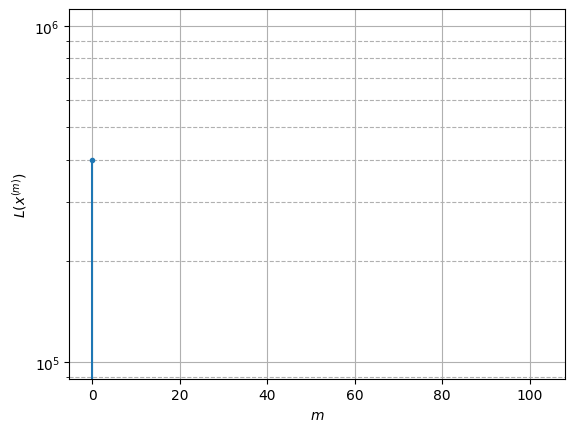

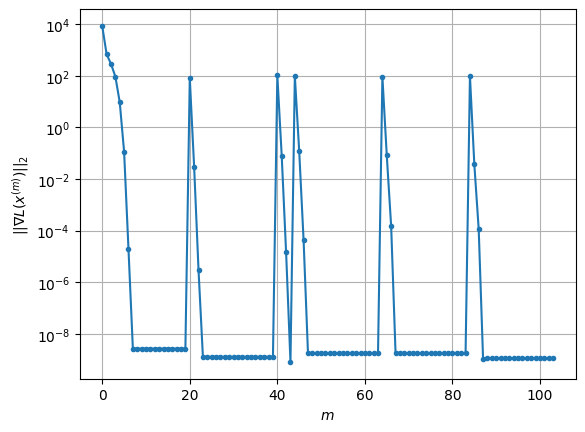

Windows:   2%|▏         | 6/395 [00:02<02:58,  2.18it/s]

Before applying the algorithm
Cost function: -236290.83006563436
Gradient norm: 110.5424640237427
Global relative error: 8.991558840452196
Position relative errors: 1.0477922147158 m, 3.5114381152525516 m, 7.72790533775897 m, 2.774687813225012 m

Iteration 1
Cost function: -236359.97563010865 (-0.03%)
Gradient norm: 0.119699264551346 (-99.89%)
Global relative error: 5.954867702417064 (-33.77%)
Position relative errors: 0.13389148755159155 m, 2.238270213735431 m, 3.128532020901086 m, 4.543600490660328 m

Iteration 2
Cost function: -236359.9801411243 (-0.00%)
Gradient norm: 0.0002518950693433066 (-99.79%)
Global relative error: 6.041922337836242 (1.46%)
Position relative errors: 0.13389148755159155 m, 2.122128717104094 m, 3.3379665743570657 m, 4.565172134092999 m

Iteration 3
Cost function: -236359.98014113712 (-0.00%)
Gradient norm: 1.4237791589141753e-09 (-100.00%)
Global relative error: 6.041985725052085 (0.00%)
Position relative errors: 0.13389148755159155 m, 2.121926856880979 m, 3.3

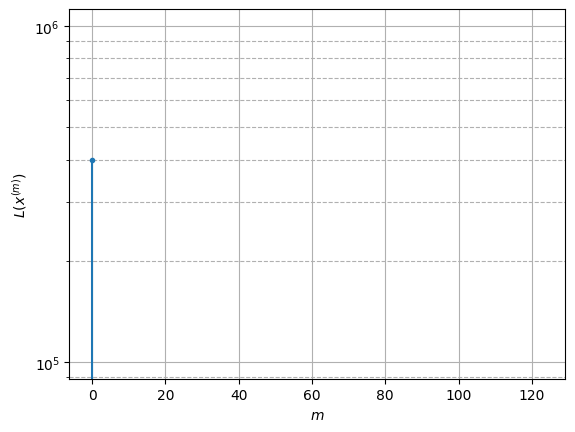

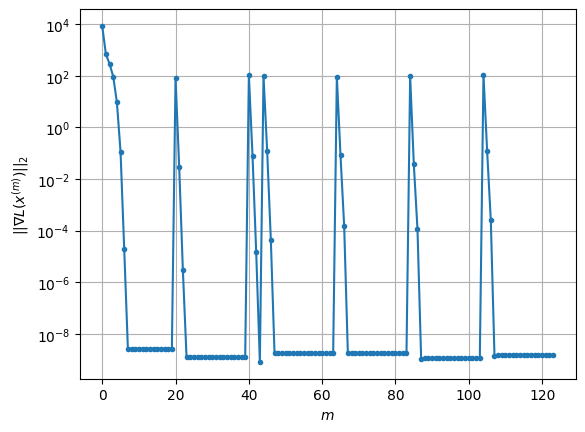

Windows:   2%|▏         | 7/395 [00:03<03:04,  2.10it/s]

Before applying the algorithm
Cost function: -236314.15160804044
Gradient norm: 83.77227556362793
Global relative error: 5.894695743029775
Position relative errors: 0.8976194770749873 m, 1.961278186446805 m, 3.883134260471053 m, 3.875012683565137 m

Iteration 1
Cost function: -236360.92193469102 (-0.02%)
Gradient norm: 0.13981534473239512 (-99.83%)
Global relative error: 16.5275222018612 (180.38%)
Position relative errors: 0.20086709195401298 m, 4.806885916863366 m, 10.976595439994355 m, 11.380957464261888 m

Iteration 2
Cost function: -236360.92737082683 (-0.00%)
Gradient norm: 0.0003718369283429951 (-99.73%)
Global relative error: 15.991993421073177 (-3.24%)
Position relative errors: 0.20086709195401298 m, 4.626533906955192 m, 10.829601636621511 m, 10.817475136134775 m

Iteration 3
Cost function: -236360.9273708519 (-0.00%)
Gradient norm: 3.78089209163108e-09 (-100.00%)
Global relative error: 15.990698809499513 (-0.01%)
Position relative errors: 0.20086709195401298 m, 4.6262035374967

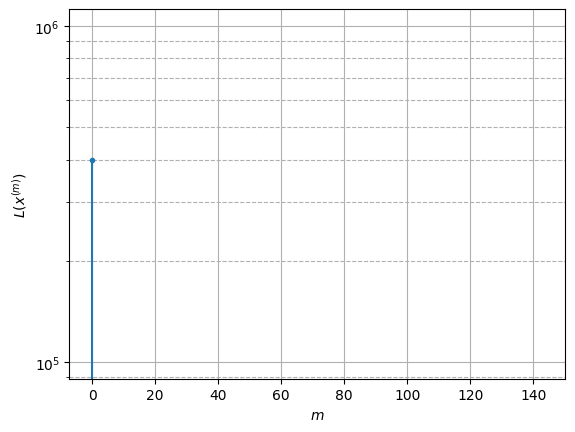

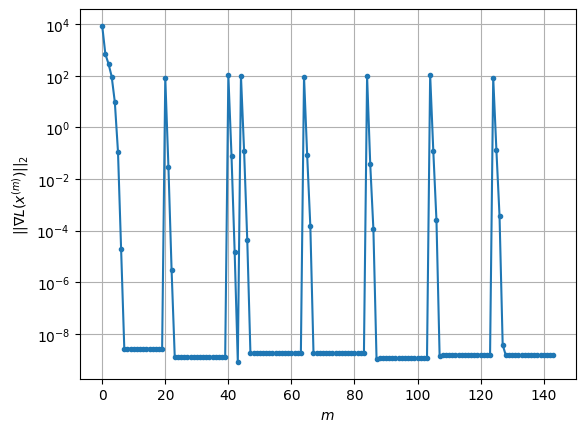

Windows:   2%|▏         | 8/395 [00:03<03:08,  2.05it/s]

Before applying the algorithm
Cost function: -236293.44153520628
Gradient norm: 103.1674741523045
Global relative error: 16.430655868584804
Position relative errors: 1.0604534904396956 m, 4.198209644380988 m, 10.705039151563858 m, 11.688386900338564 m

Iteration 1
Cost function: -236357.70726601908 (-0.03%)
Gradient norm: 0.042276122899428364 (-99.96%)
Global relative error: 17.857511643765317 (8.68%)
Position relative errors: 0.08163388649742795 m, 6.47013264533018 m, 11.990734437497162 m, 11.543095526645416 m

Iteration 2
Cost function: -236357.70866676967 (-0.00%)
Gradient norm: 9.066444480983055e-05 (-99.79%)
Global relative error: 17.712547504080565 (-0.81%)
Position relative errors: 0.08163388649742795 m, 6.565353030417157 m, 11.989428394460527 m, 11.263957851181875 m

Iteration 3
Cost function: -236357.7086667704 (-0.00%)
Gradient norm: 1.4967690166293674e-09 (-100.00%)
Global relative error: 17.71253634742747 (-0.00%)
Position relative errors: 0.08163388649742795 m, 6.565383203

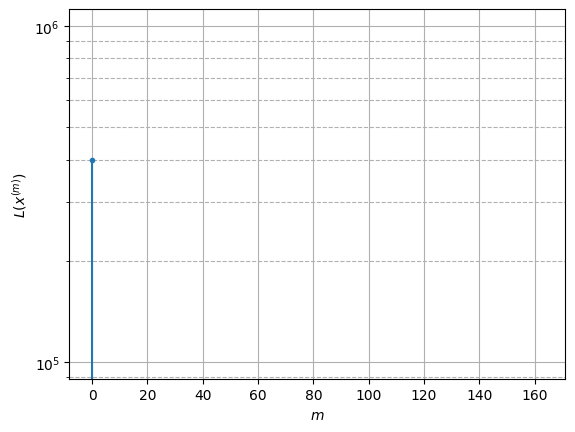

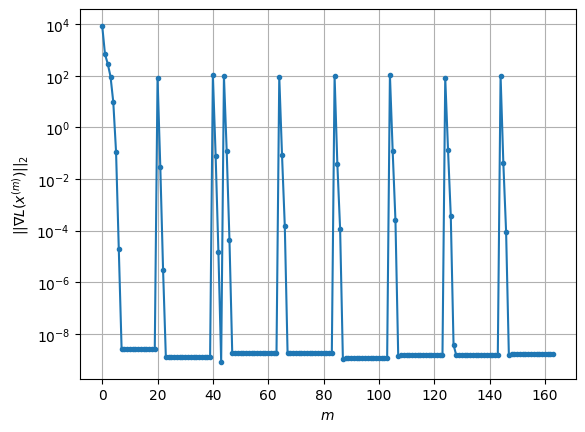

Windows:   2%|▏         | 9/395 [00:04<03:06,  2.07it/s]

Before applying the algorithm
Cost function: -236277.83428185
Gradient norm: 114.96958887508391
Global relative error: 18.353291829355978
Position relative errors: 1.0280969519789536 m, 6.558385101287095 m, 12.174530278221189 m, 12.023062648678414 m

Iteration 1
Cost function: -236356.02167507407 (-0.03%)
Gradient norm: 0.2247476278570158 (-99.80%)
Global relative error: 32.82370123955191 (78.84%)
Position relative errors: 0.1443504975856097 m, 7.64941740998647 m, 14.806202857799653 m, 28.277846393847042 m

Iteration 2
Cost function: -236356.0735167645 (-0.00%)
Gradient norm: 0.006219072469112904 (-97.23%)
Global relative error: 29.427886880089936 (-10.35%)
Position relative errors: 0.1443504975856097 m, 7.012668209774572 m, 13.709440254188332 m, 25.076936059116 m

Iteration 3
Cost function: -236356.07352107464 (-0.00%)
Gradient norm: 1.471825657437922e-07 (-100.00%)
Global relative error: 29.411974526921654 (-0.05%)
Position relative errors: 0.1443504975856097 m, 7.009578638474084 m, 

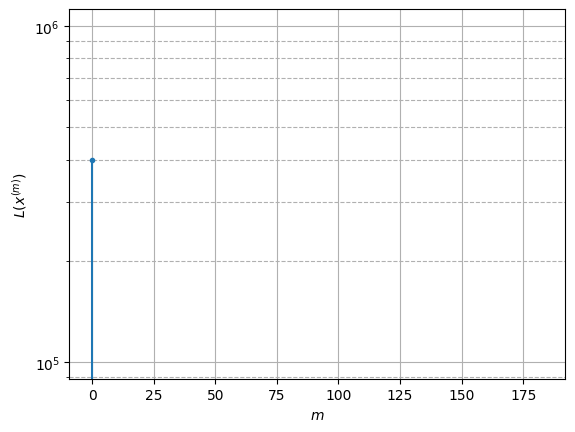

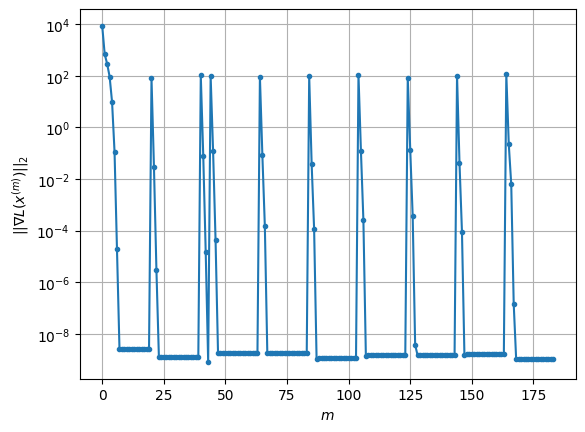

Windows:   3%|▎         | 10/395 [00:04<03:10,  2.02it/s]

Before applying the algorithm
Cost function: -236303.12631073766
Gradient norm: 84.78897807849874
Global relative error: 30.113348209950818
Position relative errors: 0.8874945994682522 m, 6.528902609636461 m, 13.595606362931557 m, 26.049150172998626 m

Iteration 1
Cost function: -236359.57645259716 (-0.02%)
Gradient norm: 1.5397676646205032 (-98.18%)
Global relative error: 45.55898626772332 (51.29%)
Position relative errors: 0.2132143217528319 m, 7.602608007266282 m, 26.452016037955605 m, 36.3051811875229 m

Iteration 2
Cost function: -236360.80791399057 (-0.00%)
Gradient norm: 0.14615631737738352 (-90.51%)
Global relative error: 29.786424672933038 (-34.62%)
Position relative errors: 0.2132143217528319 m, 5.609873191324845 m, 18.7961788419577 m, 22.414678913948006 m

Iteration 3
Cost function: -236360.81101508558 (-0.00%)
Gradient norm: 0.00020563705998078596 (-99.86%)
Global relative error: 29.289211904304576 (-1.67%)
Position relative errors: 0.2132143217528319 m, 5.544119222859297 m

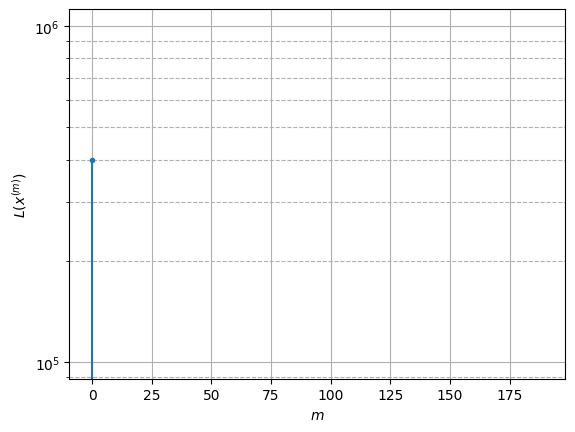

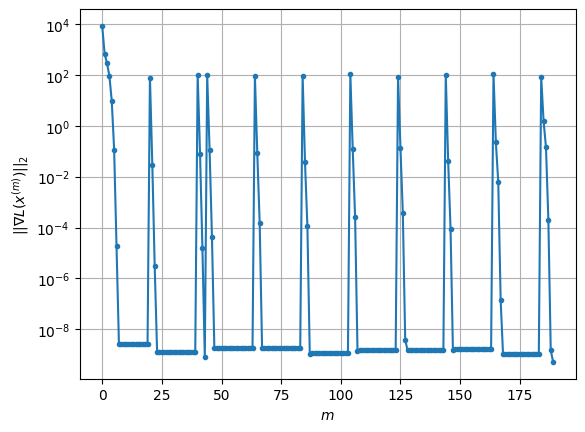

Windows:   3%|▎         | 11/395 [00:05<03:13,  1.99it/s]

Before applying the algorithm
Cost function: -236288.54901851056
Gradient norm: 109.62523590520642
Global relative error: 29.377240363443665
Position relative errors: 1.1175033308092606 m, 5.944508710422668 m, 18.819627343662315 m, 21.731477117310053 m

Iteration 1
Cost function: -236360.33664426417 (-0.03%)
Gradient norm: 0.8145884186550701 (-99.26%)
Global relative error: 26.03729013904755 (-11.37%)
Position relative errors: 0.22337419792833338 m, 3.7355900192708713 m, 17.913869795691294 m, 18.52102683679274 m

Iteration 2
Cost function: -236360.40043895115 (-0.00%)
Gradient norm: 0.0020180438273435224 (-99.75%)
Global relative error: 24.299887084819343 (-6.67%)
Position relative errors: 0.22337419792833338 m, 3.7311607637012467 m, 16.485939381263467 m, 17.456405001059174 m

Iteration 3
Cost function: -236360.40044436234 (-0.00%)
Gradient norm: 8.564367333715297e-07 (-99.96%)
Global relative error: 24.26492075222714 (-0.14%)
Position relative errors: 0.22337419792833338 m, 3.73109651

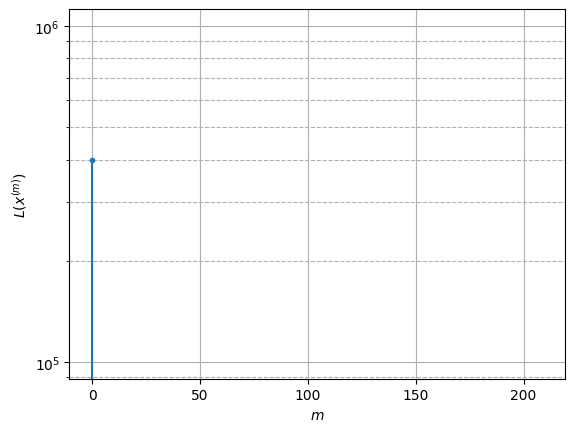

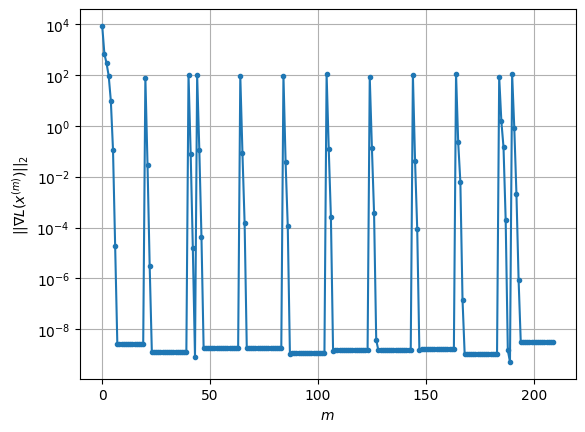

Windows:   3%|▎         | 12/395 [00:05<03:02,  2.10it/s]

Before applying the algorithm
Cost function: -236291.59403263344
Gradient norm: 104.44561660496157
Global relative error: 24.02805288676803
Position relative errors: 1.042577934699936 m, 4.0309466037884025 m, 16.24368359046752 m, 17.209119681781036 m

Iteration 1
Cost function: -236353.9523881325 (-0.03%)
Gradient norm: 1.1876413867049058 (-98.86%)
Global relative error: 45.02031435026236 (87.37%)
Position relative errors: 0.2769530361818225 m, 7.369315055426807 m, 37.99637360595593 m, 22.993912676509552 m

Iteration 2
Cost function: -236354.38859225667 (-0.00%)
Gradient norm: 0.047402591500596156 (-96.01%)
Global relative error: 34.64606476583634 (-23.04%)
Position relative errors: 0.2769530361818225 m, 6.165911628726462 m, 28.31320404682062 m, 18.989901045460844 m

Iteration 3
Cost function: -236354.3891161002 (-0.00%)
Gradient norm: 5.448793416420917e-05 (-99.89%)
Global relative error: 34.27996095016729 (-1.06%)
Position relative errors: 0.2769530361818225 m, 6.125713555460133 m, 2

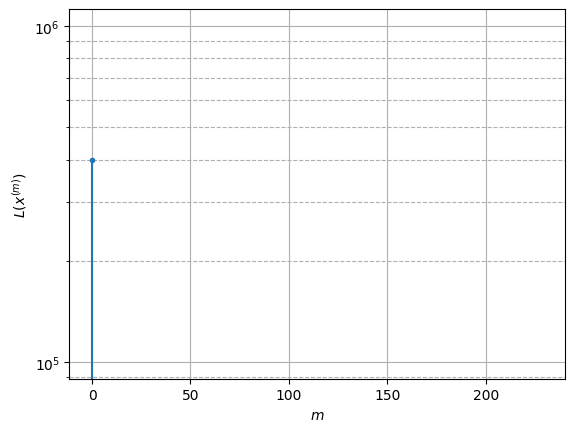

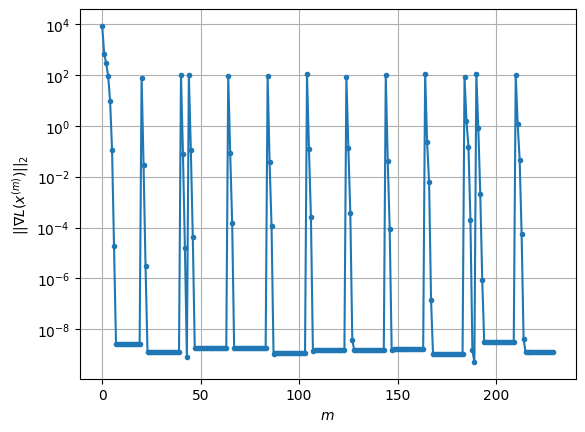

Windows:   3%|▎         | 13/395 [00:06<02:57,  2.15it/s]

Before applying the algorithm
Cost function: -236293.71795605618
Gradient norm: 99.54148108972508
Global relative error: 33.982772353999444
Position relative errors: 1.024292102849131 m, 6.587215151784692 m, 28.085603632740984 m, 17.93283130080801 m

Iteration 1
Cost function: -236355.27435658113 (-0.03%)
Gradient norm: 0.4403172103946063 (-99.56%)
Global relative error: 31.227827386748952 (-8.11%)
Position relative errors: 0.03842072648783803 m, 2.205615989175666 m, 6.9538829876638975 m, 30.363692585542374 m

Iteration 2
Cost function: -236355.32689164247 (-0.00%)
Gradient norm: 0.005086199695058228 (-98.84%)
Global relative error: 31.356678821391633 (0.41%)
Position relative errors: 0.03842072648783803 m, 1.927593141948669 m, 9.863078014823492 m, 29.702579653812734 m

Iteration 3
Cost function: -236355.32690171443 (-0.00%)
Gradient norm: 1.2309040542687056e-06 (-99.98%)
Global relative error: 31.351227521868783 (-0.02%)
Position relative errors: 0.03842072648783803 m, 1.9236065843932

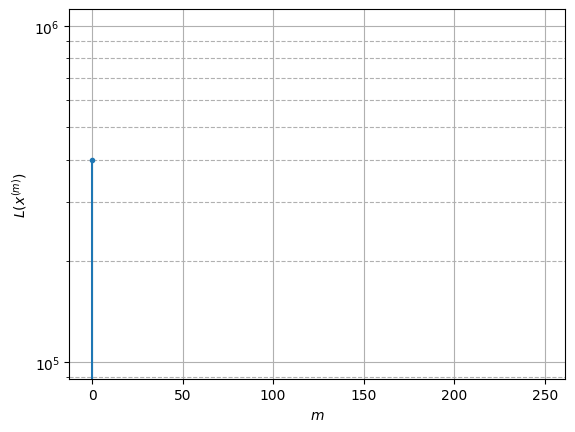

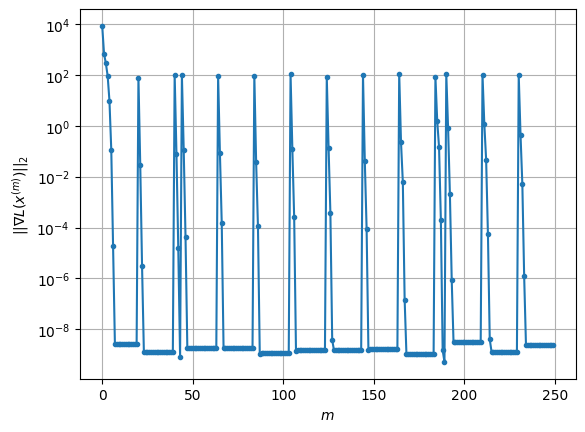

Windows:   4%|▎         | 14/395 [00:06<03:06,  2.04it/s]

Before applying the algorithm
Cost function: -236313.73061063912
Gradient norm: 92.1481568190498
Global relative error: 30.738649941907457
Position relative errors: 0.9676839849760593 m, 2.3840046954564635 m, 10.152977893739363 m, 28.899154896303163 m

Iteration 1
Cost function: -236359.31400261933 (-0.02%)
Gradient norm: 0.43987351576046807 (-99.52%)
Global relative error: 41.1393325079588 (33.84%)
Position relative errors: 0.14296190915050175 m, 1.1822949370408184 m, 25.921759854282193 m, 31.923160715922105 m

Iteration 2
Cost function: -236359.37019784396 (-0.00%)
Gradient norm: 0.008553667971413983 (-98.06%)
Global relative error: 37.45005654579513 (-8.97%)
Position relative errors: 0.14296190915050175 m, 1.298433899287686 m, 23.317875075727066 m, 29.275868438026645 m

Iteration 3
Cost function: -236359.37021156275 (-0.00%)
Gradient norm: 1.7258368545374286e-06 (-99.98%)
Global relative error: 37.401657008038356 (-0.13%)
Position relative errors: 0.14296190915050175 m, 1.3005897219

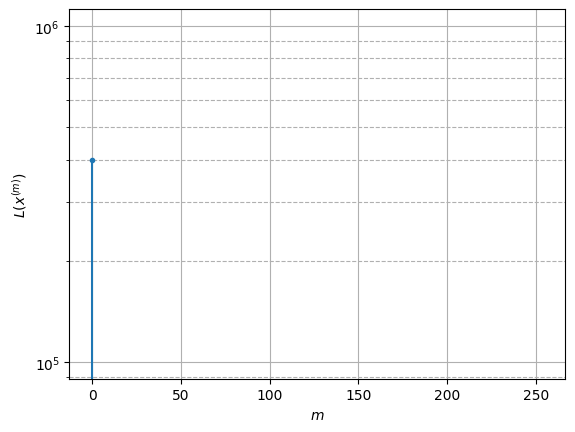

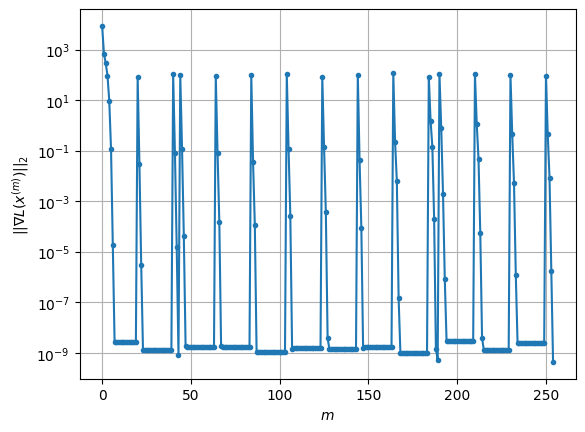

Windows:   4%|▍         | 15/395 [00:07<03:02,  2.09it/s]

Before applying the algorithm
Cost function: -236281.67589770898
Gradient norm: 117.73333862212885
Global relative error: 37.32712446112387
Position relative errors: 1.0648554071863543 m, 1.5670911546606534 m, 23.708775317090016 m, 28.768349425530783 m

Iteration 1
Cost function: -236360.6704269392 (-0.03%)
Gradient norm: 1.8556126447078811 (-98.42%)
Global relative error: 60.81879187617023 (62.93%)
Position relative errors: 0.0944734738527279 m, 2.665013889477019 m, 27.70197336533308 m, 54.077854243392565 m

Iteration 2
Cost function: -236361.2018878483 (-0.00%)
Gradient norm: 0.051757751609291726 (-97.21%)
Global relative error: 54.38931721314423 (-10.57%)
Position relative errors: 0.0944734738527279 m, 2.6014572825894273 m, 30.10815892970637 m, 45.22078630939386 m

Iteration 3
Cost function: -236361.20283074904 (-0.00%)
Gradient norm: 0.00016259381586823803 (-99.69%)
Global relative error: 53.84430977941446 (-1.00%)
Position relative errors: 0.0944734738527279 m, 2.5732358085328983 

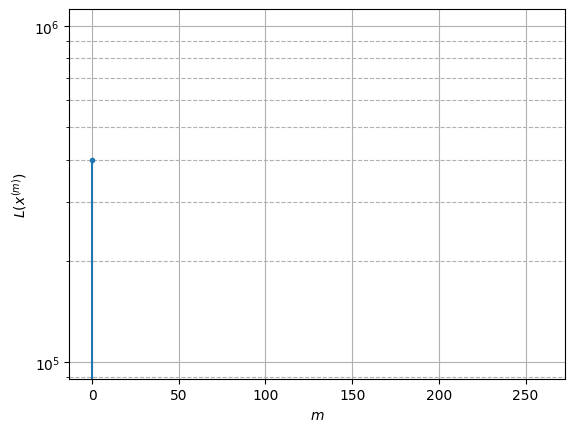

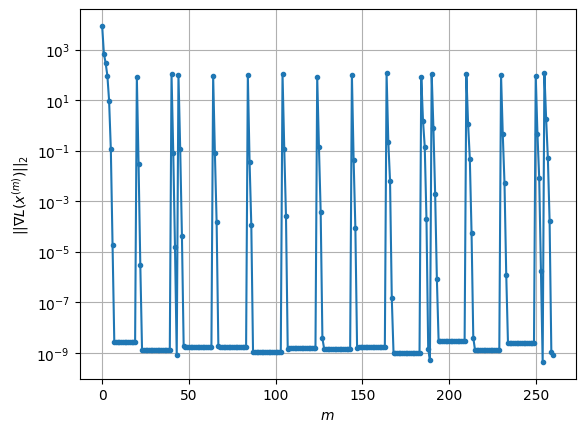

Windows:   4%|▍         | 16/395 [00:07<02:49,  2.24it/s]

Before applying the algorithm
Cost function: -236284.41932541906
Gradient norm: 89.42381486559695
Global relative error: 54.35863617344191
Position relative errors: 0.8684039350723657 m, 2.2960024220704627 m, 29.734259912601544 m, 45.43906536017034 m

Iteration 1
Cost function: -236187.7665213579 (0.04%)
Gradient norm: 32.708045254523775 (-63.42%)
Global relative error: 340.2785742203792 (525.99%)
Position relative errors: 0.0952020901357936 m, 30.785849505661098 m, 228.45521204763855 m, 250.29971208080795 m

Iteration 2
Cost function: -236325.14373152607 (-0.06%)
Gradient norm: 3.573874604867484 (-89.07%)
Global relative error: 212.15709074027455 (-37.65%)
Position relative errors: 0.0952020901357936 m, 19.04428250787812 m, 148.41286408932532 m, 150.40464907621256 m

Iteration 3
Cost function: -236349.84968615038 (-0.01%)
Gradient norm: 5.244747346497342 (46.75%)
Global relative error: 58.172591385783385 (-72.58%)
Position relative errors: 0.0952020901357936 m, 4.97346906002436 m, 46.

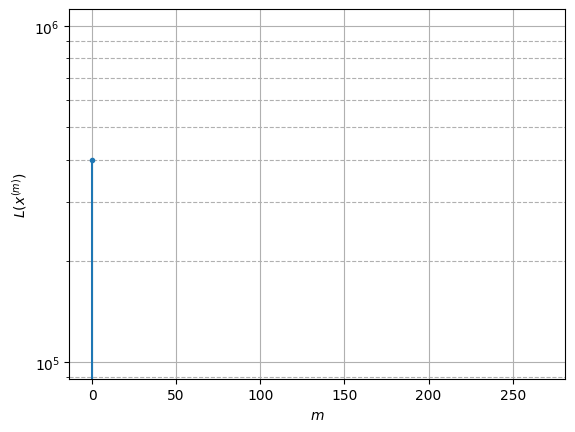

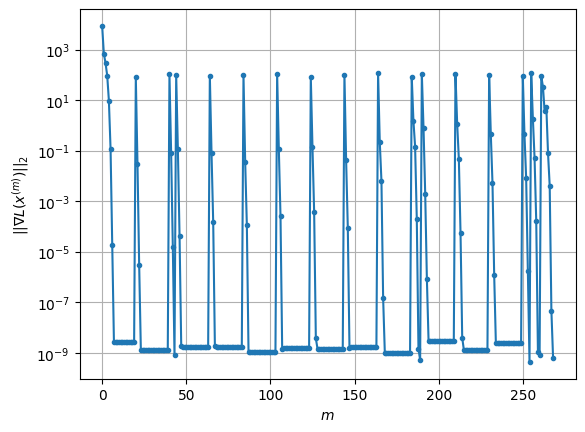

Windows:   4%|▍         | 17/395 [00:08<02:58,  2.12it/s]

Before applying the algorithm
Cost function: -236287.73369564762
Gradient norm: 107.50705085624179
Global relative error: 36.45446416558537
Position relative errors: 1.0154799963557297 m, 3.4172144906763533 m, 31.5578337806953 m, 17.89753865605962 m

Iteration 1
Cost function: -236351.74342325795 (-0.03%)
Gradient norm: 0.042182340503181356 (-99.96%)
Global relative error: 29.018077875222225 (-20.40%)
Position relative errors: 0.08158738708215296 m, 1.3593329773363725 m, 26.942348002110663 m, 10.691288268216397 m

Iteration 2
Cost function: -236351.7471478755 (-0.00%)
Gradient norm: 0.0009633990690774662 (-97.72%)
Global relative error: 27.434190269627667 (-5.46%)
Position relative errors: 0.08158738708215296 m, 1.3381726720598353 m, 25.66940111704988 m, 9.58742088434813 m

Iteration 3
Cost function: -236351.74714795922 (-0.00%)
Gradient norm: 2.5517230232179962e-09 (-100.00%)
Global relative error: 27.431475061199237 (-0.01%)
Position relative errors: 0.08158738708215296 m, 1.33814634

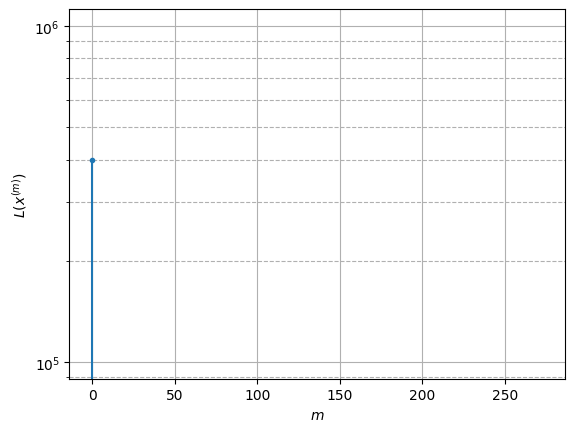

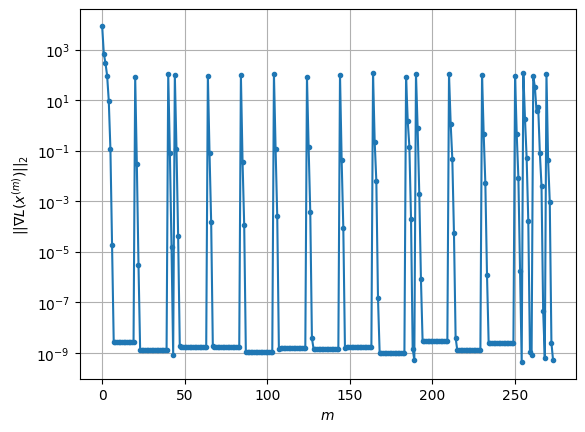

Windows:   5%|▍         | 18/395 [00:08<02:56,  2.14it/s]

Before applying the algorithm
Cost function: -236306.27239132638
Gradient norm: 95.91231379007921
Global relative error: 27.57171818643191
Position relative errors: 0.8827393837813345 m, 1.4173957838780953 m, 26.068819676527742 m, 8.821984601606982 m

Iteration 1
Cost function: -236359.06348263414 (-0.02%)
Gradient norm: 0.38301365906366347 (-99.60%)
Global relative error: 45.268777417429014 (64.19%)
Position relative errors: 0.08388748455265428 m, 4.76855640440282 m, 28.531740632227876 m, 34.82032718953249 m

Iteration 2
Cost function: -236359.10754220415 (-0.00%)
Gradient norm: 0.007950052950896428 (-97.92%)
Global relative error: 40.349246450932874 (-10.87%)
Position relative errors: 0.08388748455265428 m, 4.951880633850883 m, 25.60869124900129 m, 30.78518848835581 m

Iteration 3
Cost function: -236359.10755405686 (-0.00%)
Gradient norm: 1.8692618864443156e-06 (-99.98%)
Global relative error: 40.27709897260089 (-0.18%)
Position relative errors: 0.08388748455265428 m, 4.9567281829806

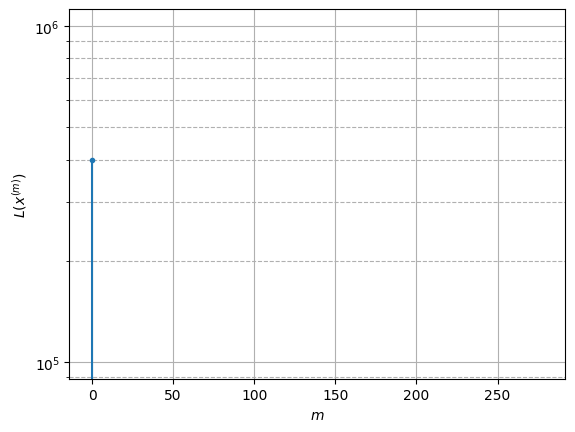

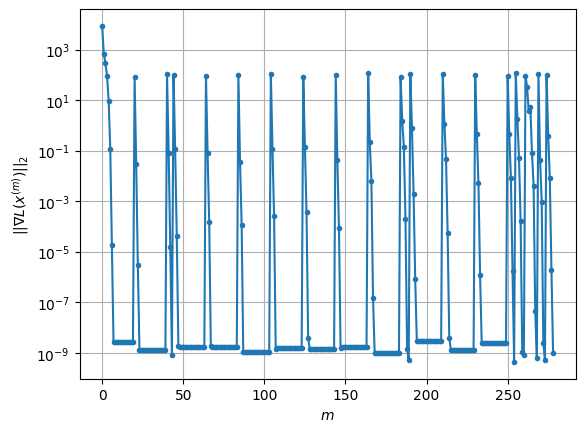

Windows:   5%|▍         | 19/395 [00:08<02:49,  2.22it/s]

Before applying the algorithm
Cost function: -236321.2777492537
Gradient norm: 74.53261667288993
Global relative error: 39.94580275699751
Position relative errors: 0.9352451658794144 m, 5.313740839377132 m, 25.252167536015243 m, 30.477599058429835 m

Iteration 1
Cost function: -236354.77890171343 (-0.01%)
Gradient norm: 0.5375893934714816 (-99.28%)
Global relative error: 34.41441943747109 (-13.85%)
Position relative errors: 0.21811383531605735 m, 3.5721413408747966 m, 28.1257182417891 m, 19.506097717332654 m

Iteration 2
Cost function: -236354.8027835433 (-0.00%)
Gradient norm: 0.0002715565315905352 (-99.95%)
Global relative error: 33.79712645877755 (-1.79%)
Position relative errors: 0.21811383531605735 m, 3.395624660521777 m, 27.461840640798435 m, 19.403984177752942 m

Iteration 3
Cost function: -236354.80278390745 (-0.00%)
Gradient norm: 8.492431381716974e-08 (-99.97%)
Global relative error: 33.782501237723224 (-0.04%)
Position relative errors: 0.21811383531605735 m, 3.39352082008011

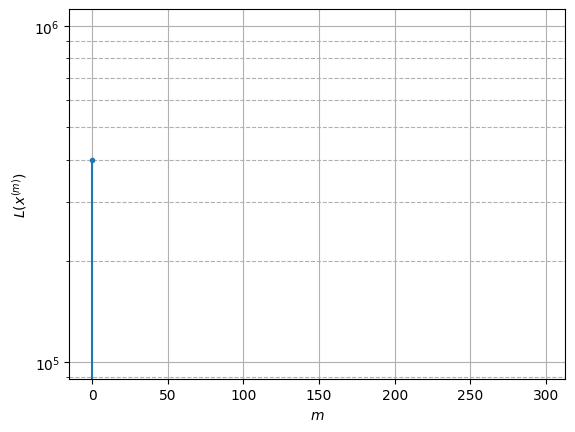

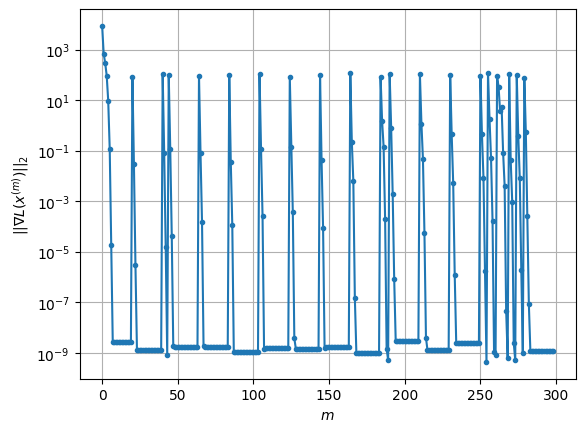

Windows:   5%|▌         | 20/395 [00:09<02:54,  2.15it/s]

Before applying the algorithm
Cost function: -236285.77032399367
Gradient norm: 112.17643188314621
Global relative error: 34.12182237277749
Position relative errors: 1.151612707442602 m, 3.306840947890606 m, 28.157016968805806 m, 18.953076435407095 m

Iteration 1
Cost function: -236358.00399415087 (-0.03%)
Gradient norm: 1.3331637678237491 (-98.81%)
Global relative error: 51.27712962483555 (50.28%)
Position relative errors: 0.1103277493307739 m, 8.126334643170361 m, 49.18583298615468 m, 12.00198845468682 m

Iteration 2
Cost function: -236358.28904689767 (-0.00%)
Gradient norm: 0.029118579802344956 (-97.82%)
Global relative error: 51.91015132243633 (1.23%)
Position relative errors: 0.1103277493307739 m, 7.803286696967693 m, 47.445568823419066 m, 19.562149974997904 m

Iteration 3
Cost function: -236358.28928685555 (-0.00%)
Gradient norm: 4.546385871313248e-05 (-99.84%)
Global relative error: 51.813481501722855 (-0.19%)
Position relative errors: 0.1103277493307739 m, 7.792332689517764 m, 

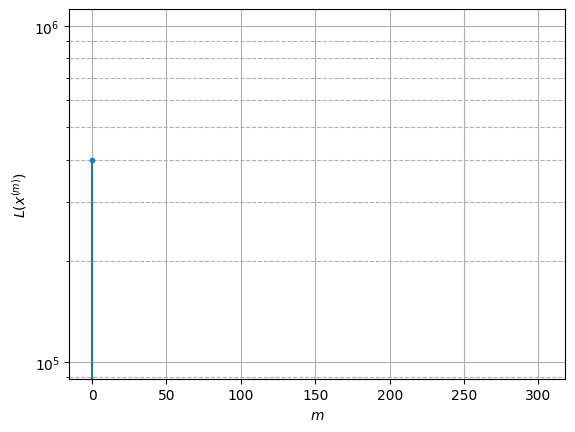

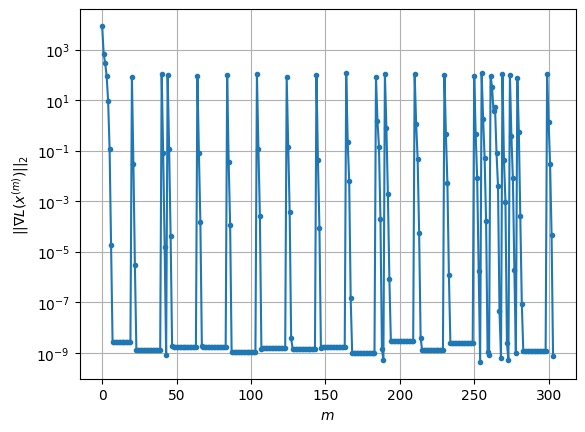

Windows:   5%|▌         | 21/395 [00:09<02:52,  2.16it/s]

Before applying the algorithm
Cost function: -236270.05631982262
Gradient norm: 113.59046628830671
Global relative error: 51.719946385817536
Position relative errors: 1.0279195974538995 m, 8.02080008644088 m, 46.83996301578972 m, 20.385786170521783 m

Iteration 1
Cost function: -236344.1508726561 (-0.03%)
Gradient norm: 7.870920772806151 (-93.07%)
Global relative error: 172.34801073073487 (233.23%)
Position relative errors: 0.05065278217449951 m, 15.384694765946845 m, 137.78189979323588 m, 102.3879529297609 m

Iteration 2
Cost function: -236357.21420700243 (-0.01%)
Gradient norm: 1.4274075592345357 (-81.86%)
Global relative error: 81.56785015575251 (-52.67%)
Position relative errors: 0.05065278217449951 m, 12.36602703859544 m, 64.35076694874458 m, 48.57335888530309 m

Iteration 3
Cost function: -236358.26775479157 (-0.00%)
Gradient norm: 0.2721797760619805 (-80.93%)
Global relative error: 47.02814458111349 (-42.34%)
Position relative errors: 0.05065278217449951 m, 12.088612036130598 m,

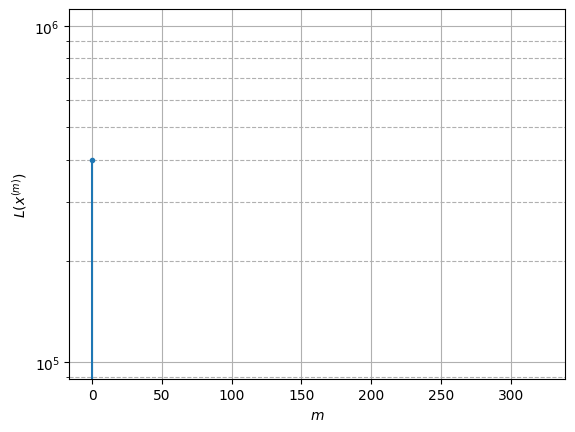

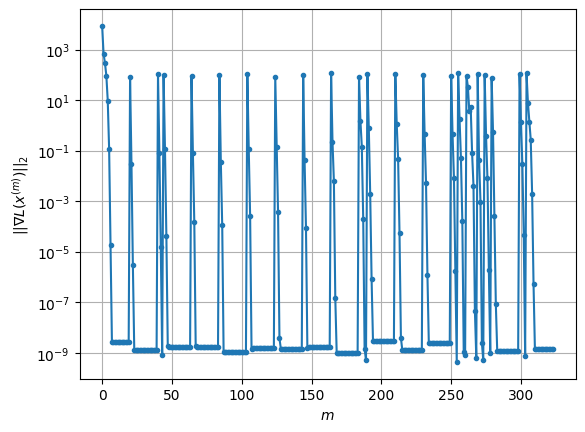

Windows:   6%|▌         | 22/395 [00:10<02:56,  2.11it/s]

Before applying the algorithm
Cost function: -236299.3486589543
Gradient norm: 94.16129164668064
Global relative error: 44.87722267198622
Position relative errors: 0.9200103022534242 m, 11.799806889549188 m, 33.04428724404772 m, 27.963507065884723 m

Iteration 1
Cost function: -236360.04851149526 (-0.03%)
Gradient norm: 0.5663144635219511 (-99.40%)
Global relative error: 23.799165574210768 (-46.97%)
Position relative errors: 0.25531998682508966 m, 1.9726012715814034 m, 6.8804202675839745 m, 22.6958839577708 m

Iteration 2
Cost function: -236360.20225576614 (-0.00%)
Gradient norm: 0.041606737802955575 (-92.65%)
Global relative error: 14.828994607500873 (-37.69%)
Position relative errors: 0.25531998682508966 m, 2.1189532930344246 m, 7.830023746774842 m, 12.411045546902795 m

Iteration 3
Cost function: -236360.202493372 (-0.00%)
Gradient norm: 3.143615942946485e-05 (-99.92%)
Global relative error: 14.688792949501927 (-0.95%)
Position relative errors: 0.25531998682508966 m, 2.1274246919730

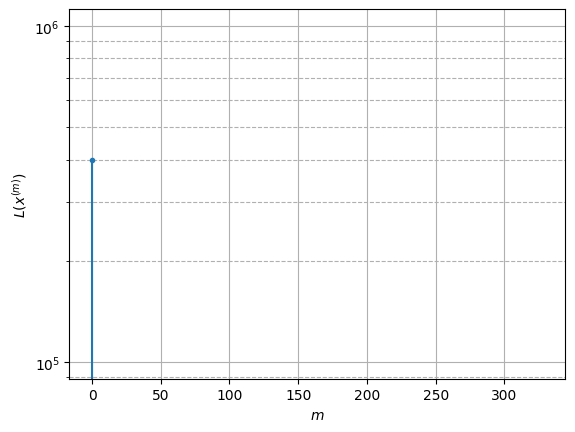

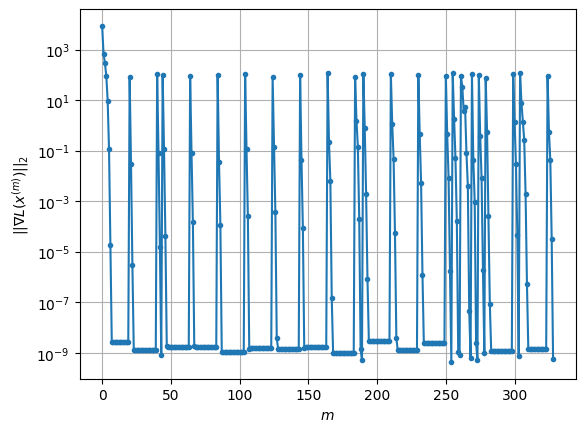

Windows:   6%|▌         | 23/395 [00:10<02:53,  2.14it/s]

Before applying the algorithm
Cost function: -236307.79674266395
Gradient norm: 92.5401591374765
Global relative error: 14.278100379707883
Position relative errors: 0.9814087991585716 m, 2.2842260686819116 m, 7.5911188002409595 m, 11.83459459014156 m

Iteration 1
Cost function: -236358.551555289 (-0.02%)
Gradient norm: 1.9047601516439912 (-97.94%)
Global relative error: 82.57357466312831 (478.32%)
Position relative errors: 0.1823163522360846 m, 16.604934328775485 m, 48.464926315479254 m, 64.75946634917902 m

Iteration 2
Cost function: -236359.12173611618 (-0.00%)
Gradient norm: 0.08613070418158583 (-95.48%)
Global relative error: 61.46849901900799 (-25.56%)
Position relative errors: 0.1823163522360846 m, 14.79215472154368 m, 36.92776163206523 m, 46.860165676191045 m

Iteration 3
Cost function: -236359.12450658443 (-0.00%)
Gradient norm: 0.0007651338359238275 (-99.11%)
Global relative error: 59.59866701284593 (-3.04%)
Position relative errors: 0.1823163522360846 m, 14.602790414466623 m,

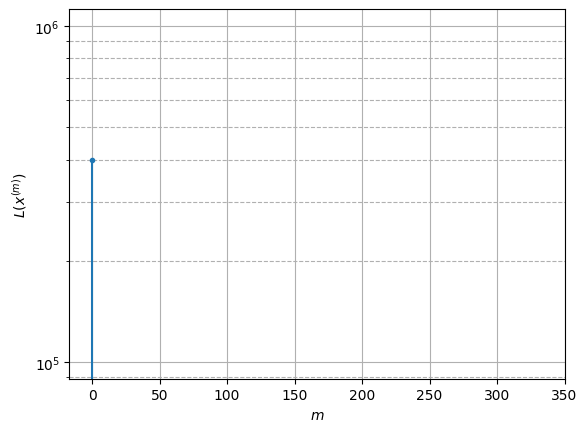

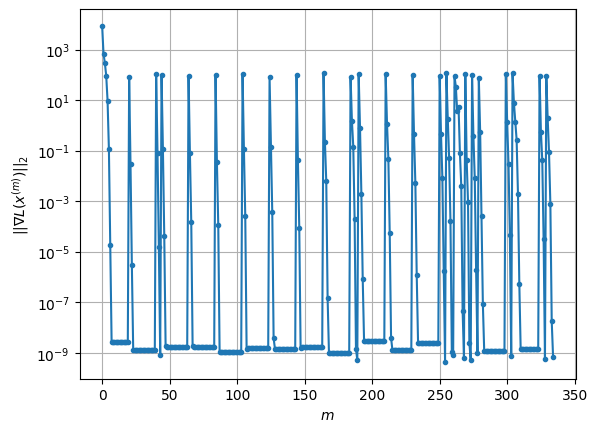

Windows:   6%|▌         | 24/395 [00:11<02:52,  2.15it/s]

Before applying the algorithm
Cost function: -236289.79786571677
Gradient norm: 102.0850910246192
Global relative error: 60.171043988407625
Position relative errors: 1.0583224802636744 m, 14.22318770950639 m, 36.78482043383557 m, 45.43139508290125 m

Iteration 1
Cost function: -236347.77492986334 (-0.02%)
Gradient norm: 7.115310809998709 (-93.03%)
Global relative error: 118.96116253078442 (97.71%)
Position relative errors: 0.07769582360360579 m, 12.329613540822152 m, 33.146077448171894 m, 113.58287541585601 m

Iteration 2
Cost function: -236357.82451322957 (-0.00%)
Gradient norm: 1.0858692255101547 (-84.74%)
Global relative error: 47.625886432055296 (-59.97%)
Position relative errors: 0.07769582360360579 m, 9.067468226491753 m, 13.605096798518337 m, 44.731427842490525 m

Iteration 3
Cost function: -236358.4773714662 (-0.00%)
Gradient norm: 0.17225509512786139 (-84.14%)
Global relative error: 23.28335648240867 (-51.11%)
Position relative errors: 0.07769582360360579 m, 8.565707982817386 

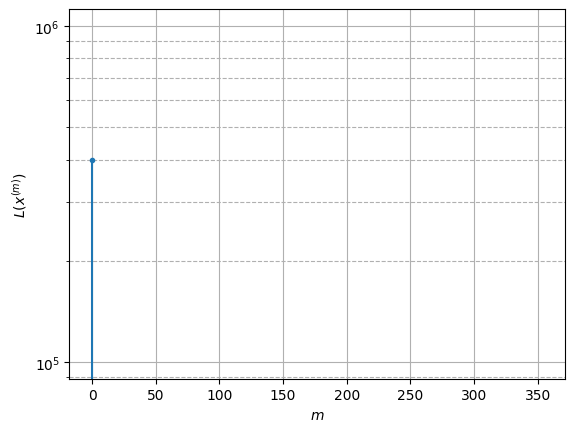

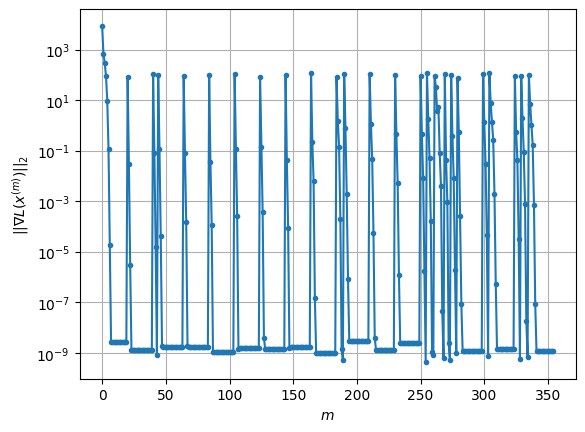

Windows:   6%|▋         | 25/395 [00:11<02:52,  2.15it/s]

Before applying the algorithm
Cost function: -236296.99092173085
Gradient norm: 109.10871471485746
Global relative error: 21.26088213707292
Position relative errors: 1.0067013584122904 m, 8.4724131465589 m, 9.474420064527873 m, 17.013658714672946 m

Iteration 1
Cost function: -236358.19925080574 (-0.03%)
Gradient norm: 1.3875989284134624 (-98.73%)
Global relative error: 90.57241688290985 (326.00%)
Position relative errors: 0.09790651081758531 m, 15.502374095907419 m, 51.97509328426735 m, 72.53701490364739 m

Iteration 2
Cost function: -236358.78033705466 (-0.00%)
Gradient norm: 0.16774429411322334 (-87.91%)
Global relative error: 54.382319338553074 (-39.96%)
Position relative errors: 0.09790651081758531 m, 14.883312227807485 m, 29.74143776714 m, 43.027436699754745 m

Iteration 3
Cost function: -236358.78609705323 (-0.00%)
Gradient norm: 0.0015691454185423816 (-99.06%)
Global relative error: 51.023031067555515 (-6.18%)
Position relative errors: 0.09790651081758531 m, 14.828683398985781 

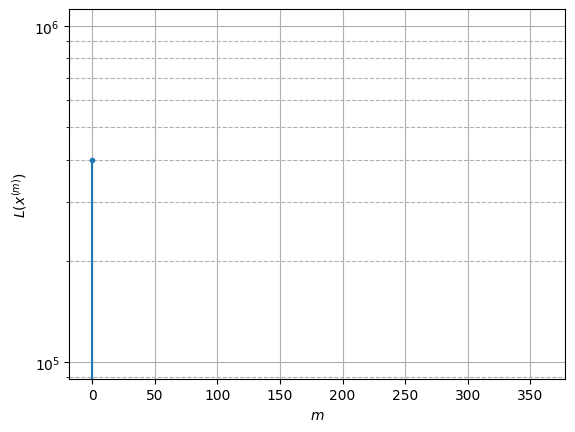

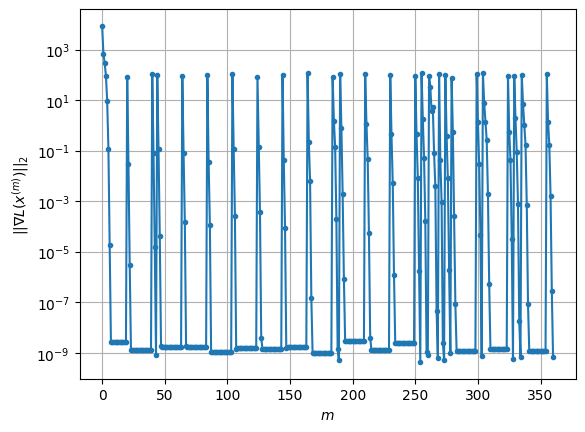

Windows:   7%|▋         | 26/395 [00:12<02:57,  2.08it/s]

Before applying the algorithm
Cost function: -236298.37766395372
Gradient norm: 92.98571088947688
Global relative error: 51.116219108680305
Position relative errors: 0.8846990131815408 m, 14.595066548450628 m, 26.944853025448456 m, 40.90285281130903 m

Iteration 1
Cost function: -236305.98944587357 (-0.00%)
Gradient norm: 15.825877320815836 (-82.98%)
Global relative error: 399.3485735480256 (681.26%)
Position relative errors: 0.18979009908083658 m, 28.269481869427157 m, 227.9069428526582 m, 326.7085983648847 m

Iteration 2
Cost function: -236351.9336268198 (-0.02%)
Gradient norm: 3.711953396462193 (-76.55%)
Global relative error: 232.07532796323954 (-41.89%)
Position relative errors: 0.18979009908083658 m, 16.078772675364437 m, 136.3220959429585 m, 187.12744409234412 m

Iteration 3
Cost function: -236361.309240622 (-0.00%)
Gradient norm: 2.5065723763983736 (-32.47%)
Global relative error: 90.76522366105576 (-60.89%)
Position relative errors: 0.18979009908083658 m, 6.764704635753361 m, 

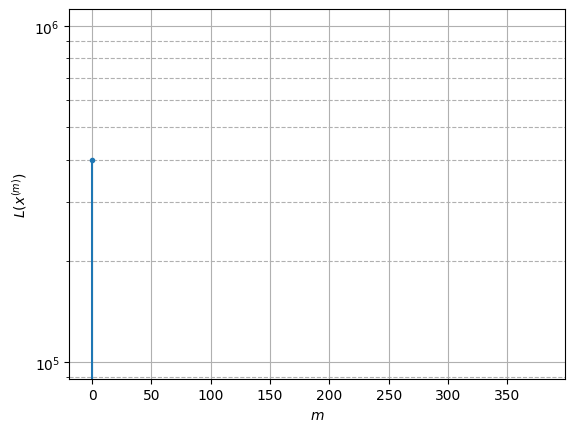

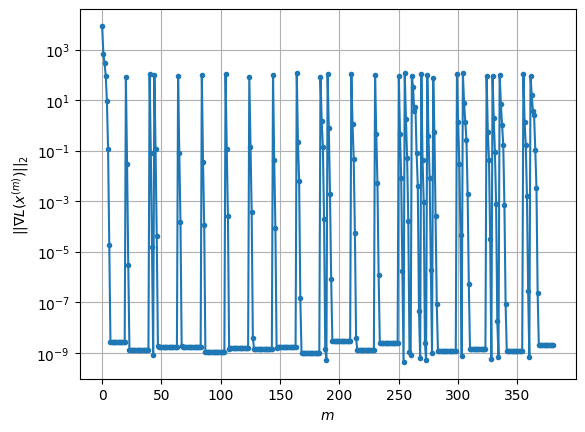

Windows:   7%|▋         | 27/395 [00:12<02:48,  2.18it/s]

Before applying the algorithm
Cost function: -236295.54166362208
Gradient norm: 101.45298404683606
Global relative error: 57.20295274524631
Position relative errors: 0.9610278089209624 m, 5.104072479255655 m, 32.891007292818074 m, 46.512186093832085 m

Iteration 1
Cost function: 518570903.01756734 (219558.61%)
Gradient norm: 80311.16125209122 (79060.97%)
Global relative error: 33594.331081958924 (58628.32%)
Position relative errors: 0.32325582898657224 m, 199.27468543599403 m, 22769.936852567545 m, 24699.58190068705 m

Iteration 2
Cost function: 416398.77226756304 (-99.92%)
Gradient norm: 1598.2032414462712 (-98.01%)
Global relative error: 19134.745580917588 (-43.04%)
Position relative errors: 0.32325582898657224 m, 1138.4240902918398 m, 12420.773248996764 m, 14510.9224664988 m

Iteration 3
Cost function: 291912118984.59607 (70103881.67%)
Gradient norm: 1943036.5606503037 (121476.31%)
Global relative error: 438625.4270822332 (2192.30%)
Position relative errors: 0.32325582898657224 m, 1

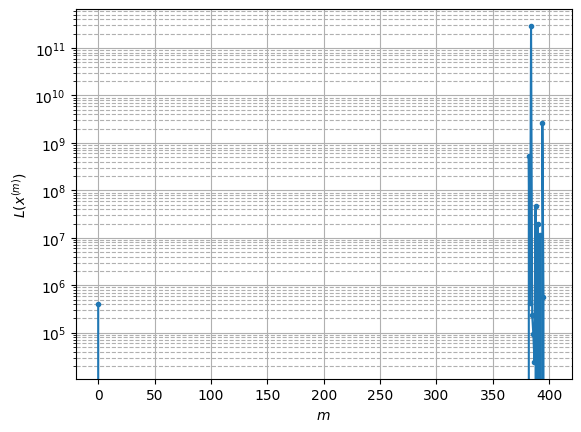

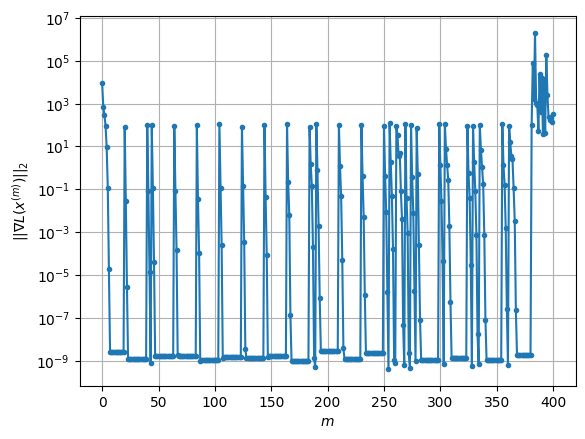

Windows:   7%|▋         | 28/395 [00:13<03:27,  1.77it/s]

Before applying the algorithm
Cost function: 1455335.2902790082
Gradient norm: 4470.515991205495
Global relative error: 20916.096765268205
Position relative errors: 1.013491638996451 m, 1902.3592513681176 m, 14943.256187936106 m, 14510.7966731455 m

Iteration 1
Cost function: -126649.88447743501 (-108.70%)
Gradient norm: 53.25852797695083 (-98.81%)
Global relative error: 21453.606986823976 (2.57%)
Position relative errors: 0.12928447276518584 m, 1991.99237671045 m, 15272.472712299601 m, 14934.550203926763 m

Iteration 2
Cost function: 2633051.436341825 (2179.00%)
Gradient norm: 6048.906182419971 (11257.63%)
Global relative error: 16244.280886552424 (-24.28%)
Position relative errors: 0.12928447276518584 m, 1386.2789907258143 m, 12548.762079487582 m, 10221.714913790833 m

Iteration 3
Cost function: -173954.17704075956 (-106.61%)
Gradient norm: 43.02871311922594 (-99.29%)
Global relative error: 15730.595692039557 (-3.16%)
Position relative errors: 0.12928447276518584 m, 1336.130537746799

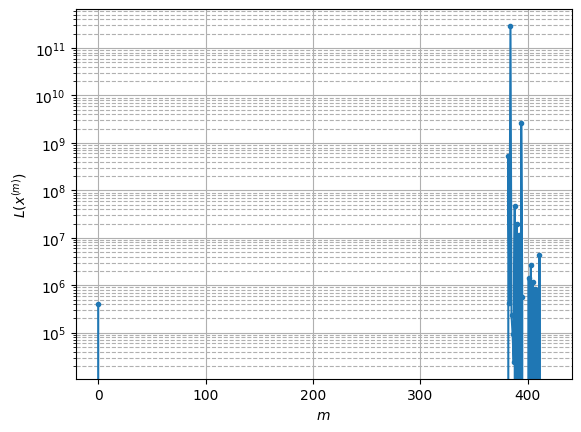

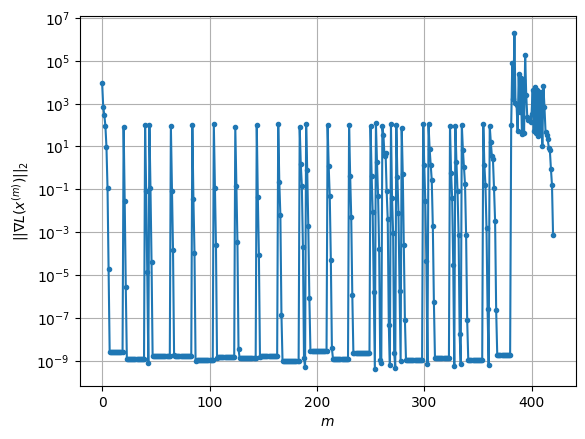

Windows:   7%|▋         | 29/395 [00:14<03:39,  1.66it/s]

Before applying the algorithm
Cost function: -234318.75183323264
Gradient norm: 193.99765108239748
Global relative error: 195.0097087126685
Position relative errors: 0.9272969842090865 m, 22.026067984092936 m, 164.6930619010858 m, 102.04085452449102 m

Iteration 1
Cost function: -236337.91072062278 (-0.86%)
Gradient norm: 7.116457401026061 (-96.33%)
Global relative error: 206.7869663535524 (6.04%)
Position relative errors: 0.0764064277533462 m, 16.341650433701584 m, 79.32537427148135 m, 190.24889161920322 m

Iteration 2
Cost function: -236356.42311901407 (-0.01%)
Gradient norm: 3.0135312088400554 (-57.65%)
Global relative error: 45.79132072079981 (-77.86%)
Position relative errors: 0.0764064277533462 m, 3.3502837074074905 m, 5.104698904346367 m, 45.30914424670933 m

Iteration 3
Cost function: -236358.3680253044 (-0.00%)
Gradient norm: 0.33896625473947245 (-88.75%)
Global relative error: 21.815936382078544 (-52.36%)
Position relative errors: 0.0764064277533462 m, 4.899041560501263 m, 12

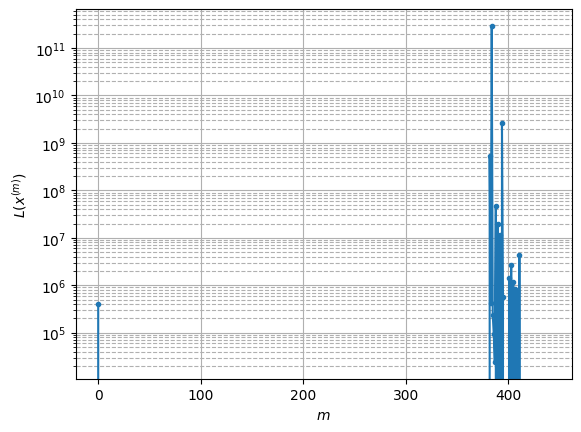

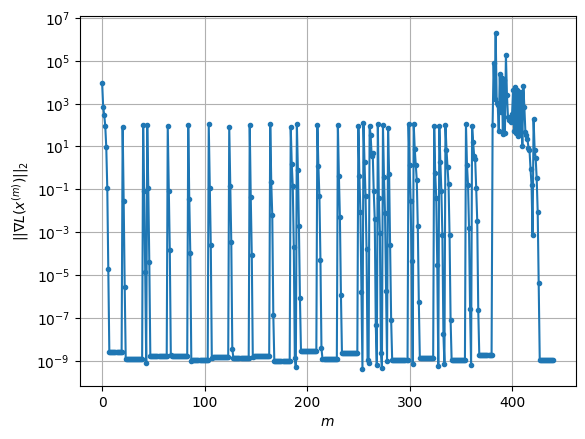

Windows:   8%|▊         | 30/395 [00:14<03:41,  1.64it/s]

Before applying the algorithm
Cost function: -233712.49436610448
Gradient norm: 212.7828360442319
Global relative error: 160.3080764106974
Position relative errors: 0.9264679351482252 m, 9.95772933712204 m, 115.5023698376021 m, 110.68501049959671 m

Iteration 1
Cost function: -236318.57055627104 (-1.12%)
Gradient norm: 4.372258351832539 (-97.95%)
Global relative error: 223.55810390421996 (39.46%)
Position relative errors: 0.0464186286054173 m, 8.077432175030681 m, 209.22538484716395 m, 78.30083928580287 m

Iteration 2
Cost function: -236348.2676775399 (-0.01%)
Gradient norm: 6.148757552509087 (40.63%)
Global relative error: 23.347189140319124 (-89.56%)
Position relative errors: 0.0464186286054173 m, 5.5695009436299 m, 16.622190029019478 m, 15.201213281483566 m

Iteration 3
Cost function: -236355.262467223 (-0.00%)
Gradient norm: 0.31371976861941975 (-94.90%)
Global relative error: 26.268825036408423 (12.51%)
Position relative errors: 0.0464186286054173 m, 6.0323064760053215 m, 17.10509

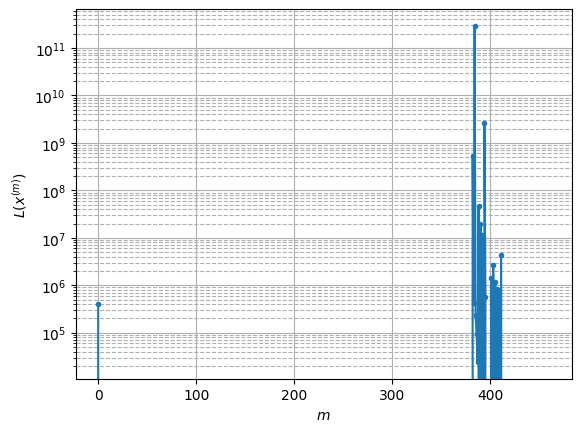

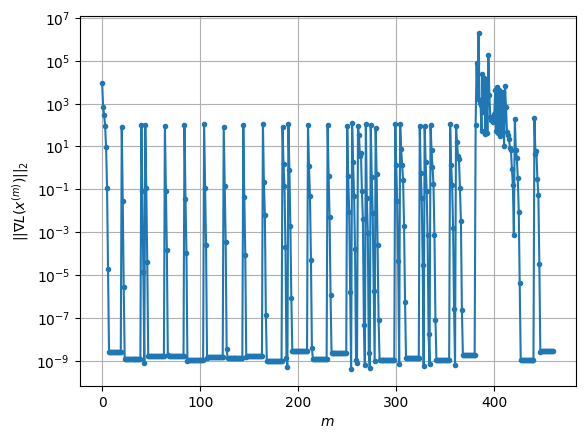

Windows:   8%|▊         | 31/395 [00:15<03:47,  1.60it/s]

Before applying the algorithm
Cost function: -232960.5330832244
Gradient norm: 233.7772664433798
Global relative error: 152.69487850797358
Position relative errors: 0.9287241884644771 m, 17.39540462149137 m, 89.09499814520143 m, 122.7501821976044 m

Iteration 1
Cost function: -236347.99310184072 (-1.45%)
Gradient norm: 0.5384665201000335 (-99.77%)
Global relative error: 177.55794996581426 (16.28%)
Position relative errors: 0.09259468807367292 m, 20.151196622175554 m, 119.01774246885385 m, 130.18750288194218 m

Iteration 2
Cost function: -236357.87868315016 (-0.00%)
Gradient norm: 5.283999505811447 (881.31%)
Global relative error: 69.37152210428474 (-60.93%)
Position relative errors: 0.09259468807367292 m, 9.364918718335849 m, 67.03450211524046 m, 14.977849007352727 m

Iteration 3
Cost function: -236360.39367832523 (-0.00%)
Gradient norm: 0.002768490297775487 (-99.95%)
Global relative error: 70.53402834884976 (1.68%)
Position relative errors: 0.09259468807367292 m, 11.125112139508447 m,

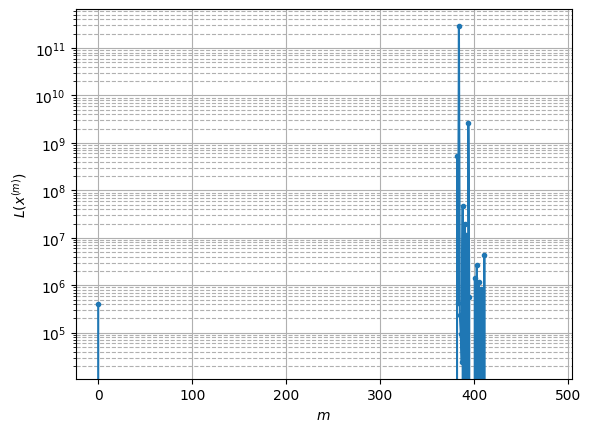

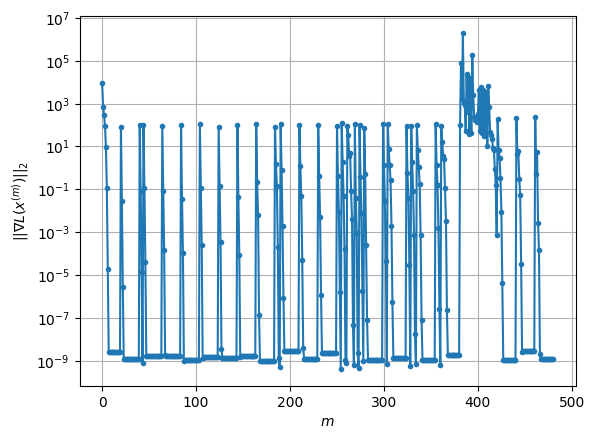

Windows:   8%|▊         | 32/395 [00:16<04:05,  1.48it/s]

Before applying the algorithm
Cost function: -232001.25236877878
Gradient norm: 273.7967364195342
Global relative error: 114.92017373860502
Position relative errors: 1.0055515241410011 m, 15.127637659799685 m, 58.066595372946324 m, 97.97096449775088 m

Iteration 1
Cost function: -236354.9250463447 (-1.88%)
Gradient norm: 0.15231632141293755 (-99.94%)
Global relative error: 113.89092849486175 (-0.90%)
Position relative errors: 0.1594811075360039 m, 0.9934602262397958 m, 50.6023644784741 m, 101.99402683938096 m

Iteration 2
Cost function: -236357.12110842107 (-0.00%)
Gradient norm: 1.361020053816618 (793.55%)
Global relative error: 70.35154932049254 (-38.23%)
Position relative errors: 0.1594811075360039 m, 4.4533793096439975 m, 61.02750417180163 m, 34.61756505883914 m

Iteration 3
Cost function: -236357.26988028237 (-0.00%)
Gradient norm: 3.796369723116016e-05 (-100.00%)
Global relative error: 70.26911619393299 (-0.12%)
Position relative errors: 0.1594811075360039 m, 4.668450210830554 m,

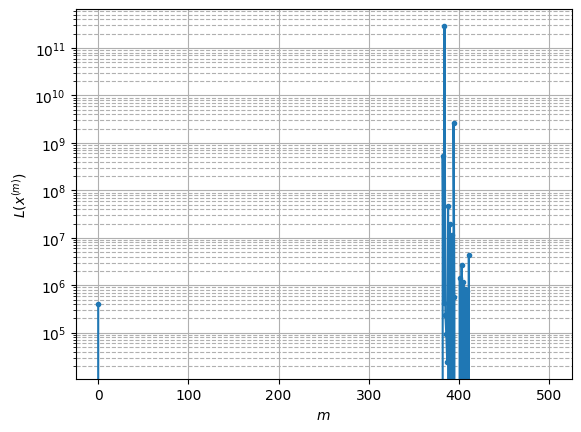

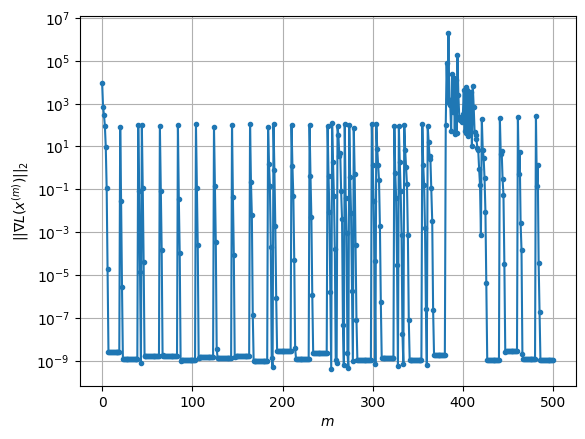

Windows:   8%|▊         | 33/395 [00:16<03:53,  1.55it/s]

Before applying the algorithm
Cost function: -231151.6775081715
Gradient norm: 273.2907656699121
Global relative error: 165.00596182015
Position relative errors: 0.8463438089978623 m, 11.271330992056035 m, 101.13650688131031 m, 129.8608403674611 m

Iteration 1
Cost function: -236346.18020451153 (-2.25%)
Gradient norm: 0.6555802360048978 (-99.76%)
Global relative error: 156.1568944892031 (-5.36%)
Position relative errors: 0.1135295282113339 m, 47.06451871922667 m, 79.63323151231305 m, 125.78420001443546 m

Iteration 2
Cost function: -236358.64423186154 (-0.01%)
Gradient norm: 4.932549983493834 (652.39%)
Global relative error: 65.31171748401215 (-58.18%)
Position relative errors: 0.1135295282113339 m, 20.758176740895955 m, 40.96371675645115 m, 46.36703795508034 m

Iteration 3
Cost function: -236360.50117954458 (-0.00%)
Gradient norm: 0.001490640716588422 (-99.97%)
Global relative error: 65.99022002941588 (1.04%)
Position relative errors: 0.1135295282113339 m, 19.734889700477716 m, 40.822

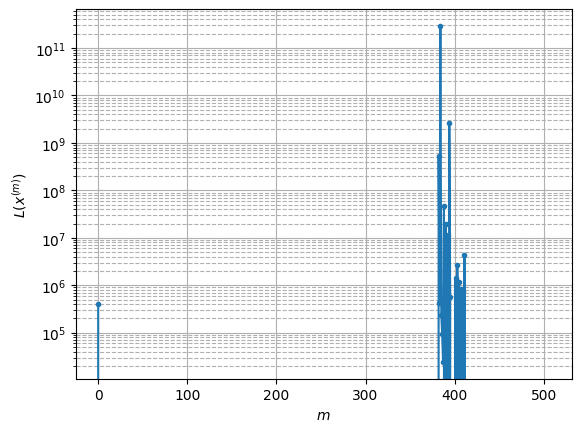

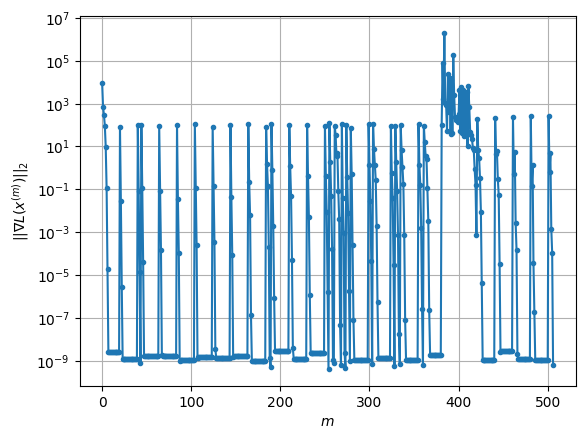

Windows:   9%|▊         | 34/395 [00:17<04:02,  1.49it/s]

Before applying the algorithm
Cost function: -229426.38451222787
Gradient norm: 337.19245678889286
Global relative error: 107.33707693974698
Position relative errors: 1.039104119296731 m, 30.950404918401333 m, 75.74963194485603 m, 69.40786198491762 m

Iteration 1
Cost function: -236351.0474859274 (-3.02%)
Gradient norm: 0.8497700741295706 (-99.75%)
Global relative error: 130.93186834001938 (21.98%)
Position relative errors: 0.22016183218324442 m, 23.09874927650053 m, 93.84979772058045 m, 88.28921897126749 m

Iteration 2
Cost function: -236354.75362608908 (-0.00%)
Gradient norm: 1.3914484551893163 (63.74%)
Global relative error: 15.276144618877632 (-88.33%)
Position relative errors: 0.22016183218324442 m, 14.564902896852292 m, 2.975956105205972 m, 2.3530136342120227 m

Iteration 3
Cost function: -236354.92339836853 (-0.00%)
Gradient norm: 0.0005643409747239393 (-99.96%)
Global relative error: 16.902823749714052 (10.65%)
Position relative errors: 0.22016183218324442 m, 15.726884932922385

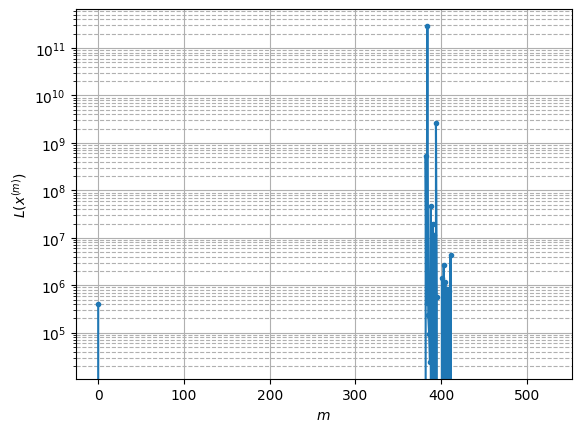

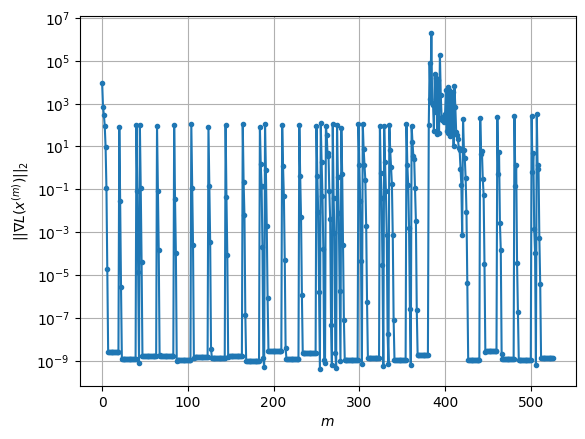

Windows:   9%|▉         | 35/395 [00:18<03:59,  1.50it/s]

Before applying the algorithm
Cost function: -228484.44028047356
Gradient norm: 343.0062050146441
Global relative error: 154.6829657902849
Position relative errors: 0.7805482890947193 m, 9.063931467940044 m, 111.50698326972116 m, 106.78679460190355 m

Iteration 1
Cost function: -236348.74222812554 (-3.44%)
Gradient norm: 0.718217647283861 (-99.79%)
Global relative error: 119.13694514169894 (-22.98%)
Position relative errors: 0.346536994306965 m, 38.61014882731728 m, 76.16260849029374 m, 83.0371971357782 m

Iteration 2
Cost function: -236357.47058241165 (-0.00%)
Gradient norm: 3.385105576209057 (371.32%)
Global relative error: 59.288693950440475 (-50.23%)
Position relative errors: 0.346536994306965 m, 7.250031975320861 m, 42.70606501657972 m, 40.395905887710576 m

Iteration 3
Cost function: -236358.35763331177 (-0.00%)
Gradient norm: 0.0008155272319171684 (-99.98%)
Global relative error: 60.449947097090956 (1.96%)
Position relative errors: 0.346536994306965 m, 6.066657047630696 m, 43.43

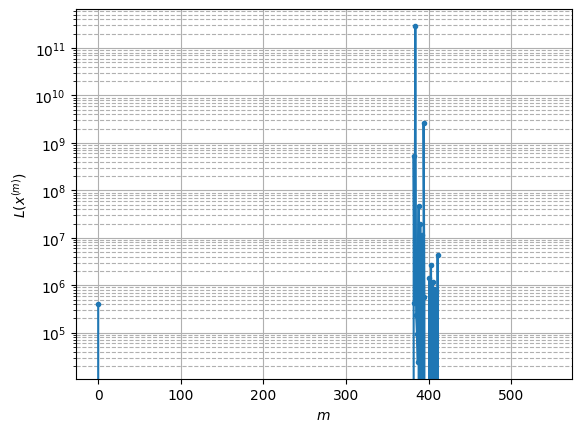

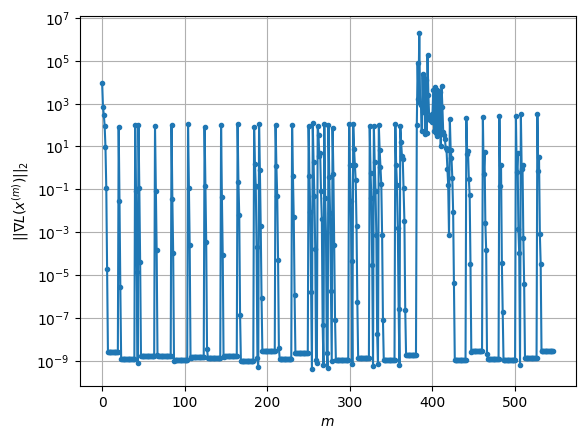

Windows:   9%|▉         | 36/395 [00:18<03:56,  1.52it/s]

Before applying the algorithm
Cost function: -226823.27665802097
Gradient norm: 366.9278987565014
Global relative error: 109.10583841308046
Position relative errors: 0.8729897313610678 m, 19.681905734399677 m, 72.71800061004949 m, 78.87457202631477 m

Iteration 1
Cost function: -236349.71534920484 (-4.20%)
Gradient norm: 0.24880230279461527 (-99.93%)
Global relative error: 93.54600610343917 (-14.26%)
Position relative errors: 0.1490313622310988 m, 9.372683121773154 m, 51.866963342225006 m, 77.23966109427184 m

Iteration 2
Cost function: -236353.9708064888 (-0.00%)
Gradient norm: 1.995787137953468 (702.16%)
Global relative error: 106.20908679587237 (13.54%)
Position relative errors: 0.1490313622310988 m, 8.557391095268366 m, 56.21457668870872 m, 89.66717128728465 m

Iteration 3
Cost function: -236354.283858259 (-0.00%)
Gradient norm: 0.00023158853668560917 (-99.99%)
Global relative error: 106.85158599212872 (0.60%)
Position relative errors: 0.1490313622310988 m, 8.669248002164458 m, 56.

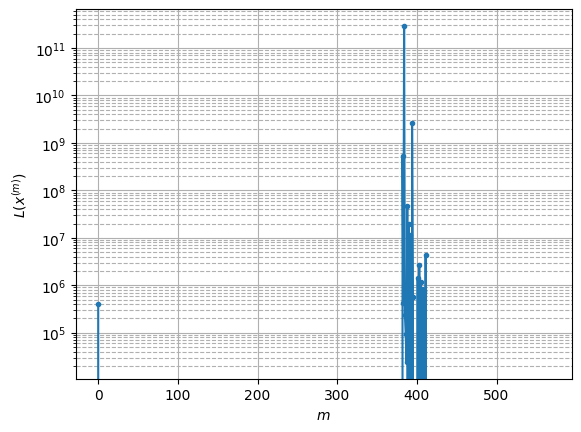

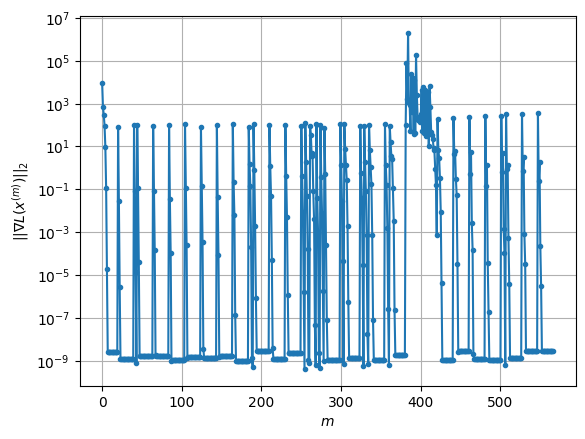

Windows:   9%|▉         | 37/395 [00:19<03:55,  1.52it/s]

Before applying the algorithm
Cost function: -225010.83189993177
Gradient norm: 400.160427487328
Global relative error: 208.9452903624917
Position relative errors: 0.8005174116519692 m, 20.602979937650627 m, 147.56331316045117 m, 146.4623312423077 m

Iteration 1
Cost function: -236334.38308051066 (-5.03%)
Gradient norm: 0.5550065718438425 (-99.86%)
Global relative error: 229.5052770467327 (9.84%)
Position relative errors: 0.18146912864988435 m, 15.186322406905658 m, 143.57311872159792 m, 178.3869657882907 m

Iteration 2
Cost function: -236349.5465194366 (-0.01%)
Gradient norm: 9.76749253921229 (1659.89%)
Global relative error: 140.24921902193515 (-38.89%)
Position relative errors: 0.18146912864988435 m, 17.196261984879847 m, 79.6460914365867 m, 114.12157687060231 m

Iteration 3
Cost function: -236357.07988235558 (-0.00%)
Gradient norm: 0.0033744929943566528 (-99.97%)
Global relative error: 144.4934104946383 (3.03%)
Position relative errors: 0.18146912864988435 m, 17.469221426156885 m, 

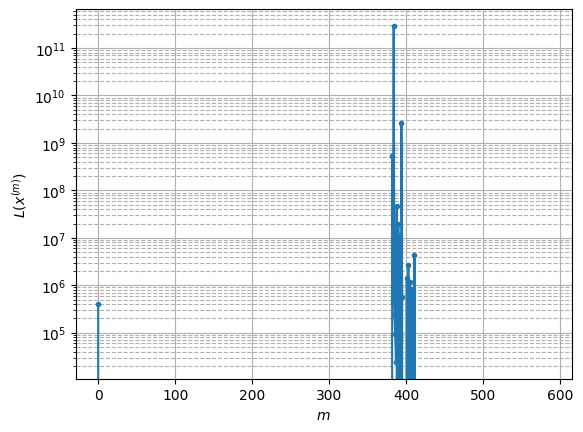

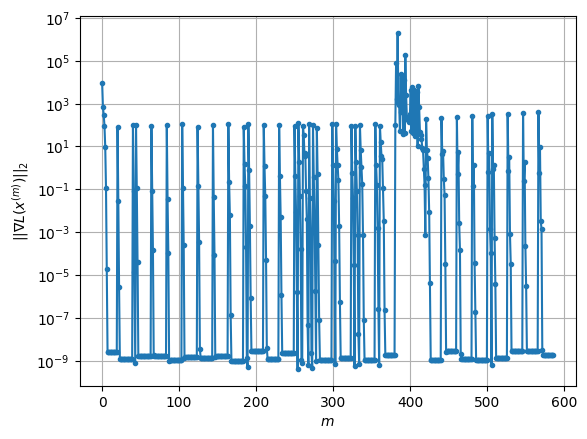

Windows:  10%|▉         | 38/395 [00:20<03:59,  1.49it/s]

Before applying the algorithm
Cost function: -222074.25707416324
Gradient norm: 438.78559601995414
Global relative error: 224.06593089722315
Position relative errors: 0.8801637067287595 m, 20.92650627036805 m, 141.24896852822073 m, 172.65173112025755 m

Iteration 1
Cost function: -236349.94024757578 (-6.43%)
Gradient norm: 0.30555519269630543 (-99.93%)
Global relative error: 206.4638012327461 (-7.86%)
Position relative errors: 0.10527694840646466 m, 26.553787684196745 m, 126.02246612645887 m, 161.3492109071822 m

Iteration 2
Cost function: -236357.7739644303 (-0.00%)
Gradient norm: 7.452583887949719 (2339.03%)
Global relative error: 82.66105055232413 (-59.96%)
Position relative errors: 0.10527694840646466 m, 6.429673669033464 m, 58.48272846526188 m, 58.00268352455245 m

Iteration 3
Cost function: -236362.0700607015 (-0.00%)
Gradient norm: 0.000960757012635207 (-99.99%)
Global relative error: 84.15791433465473 (1.81%)
Position relative errors: 0.10527694840646466 m, 6.517851861935302 m,

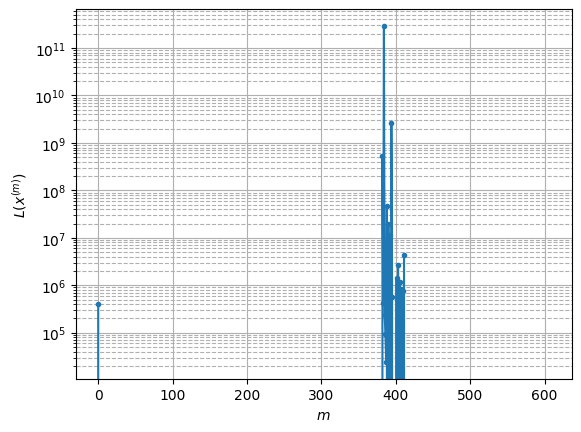

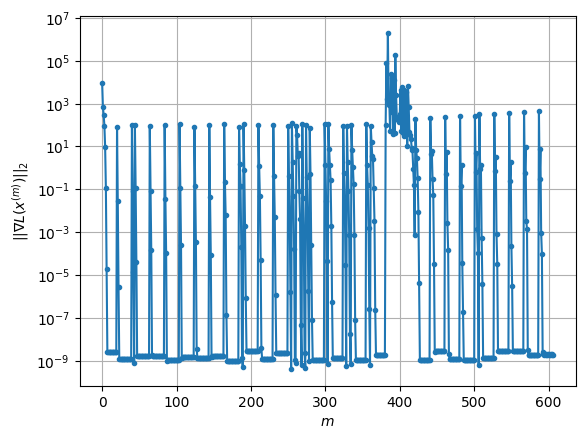

Windows:  10%|▉         | 39/395 [00:20<03:57,  1.50it/s]

Before applying the algorithm
Cost function: -222255.00075450508
Gradient norm: 444.90995579123137
Global relative error: 149.5416636020824
Position relative errors: 1.0486386734171533 m, 10.815844790728672 m, 105.89533183290966 m, 104.99458057443131 m

Iteration 1
Cost function: -236341.54978674333 (-6.34%)
Gradient norm: 0.2941065770501308 (-99.93%)
Global relative error: 124.74270583764039 (-16.58%)
Position relative errors: 0.16956990566287386 m, 7.308033253633541 m, 72.25653639726434 m, 101.38715769912244 m

Iteration 2
Cost function: -236346.02423026777 (-0.00%)
Gradient norm: 2.079010963789325 (606.89%)
Global relative error: 35.05467728415717 (-71.90%)
Position relative errors: 0.16956990566287386 m, 6.547464755755044 m, 13.525411756125822 m, 31.560288819524914 m

Iteration 3
Cost function: -236346.36918839626 (-0.00%)
Gradient norm: 0.00044528878547301113 (-99.98%)
Global relative error: 35.76338738008959 (2.02%)
Position relative errors: 0.16956990566287386 m, 6.6365409015316

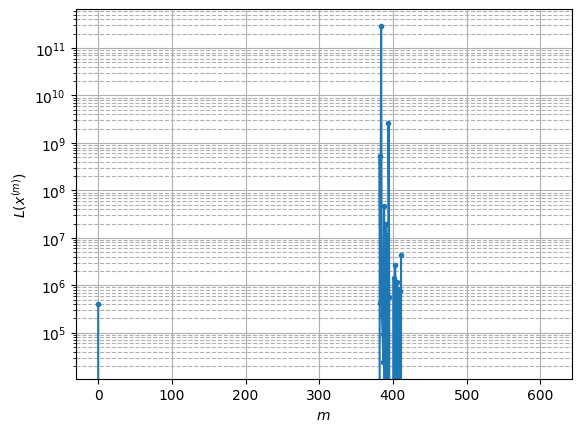

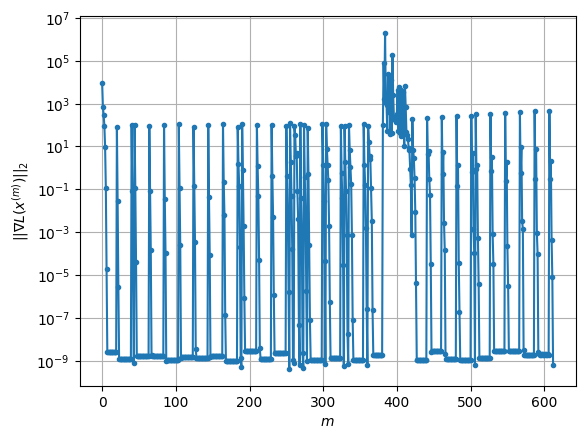

Windows:  10%|█         | 40/395 [00:21<04:05,  1.45it/s]

Before applying the algorithm
Cost function: -219726.74611405216
Gradient norm: 481.21118034212316
Global relative error: 157.1661130790238
Position relative errors: 1.0266225697109057 m, 10.487849822481829 m, 101.37111055327013 m, 119.61212375935683 m

Iteration 1
Cost function: -236349.1943290785 (-7.57%)
Gradient norm: 0.3409767362078014 (-99.93%)
Global relative error: 131.12012010023733 (-16.57%)
Position relative errors: 0.08357174179403583 m, 17.875714863499446 m, 64.37304382706351 m, 112.79216732504324 m

Iteration 2
Cost function: -236355.35296030837 (-0.00%)
Gradient norm: 3.265750135694803 (857.76%)
Global relative error: 78.76470650141883 (-39.93%)
Position relative errors: 0.08357174179403583 m, 11.614022313754655 m, 48.41303461490612 m, 60.976951576380145 m

Iteration 3
Cost function: -236356.17556420632 (-0.00%)
Gradient norm: 0.0003817449860784638 (-99.99%)
Global relative error: 79.76017658241851 (1.26%)
Position relative errors: 0.08357174179403583 m, 12.1808320001845

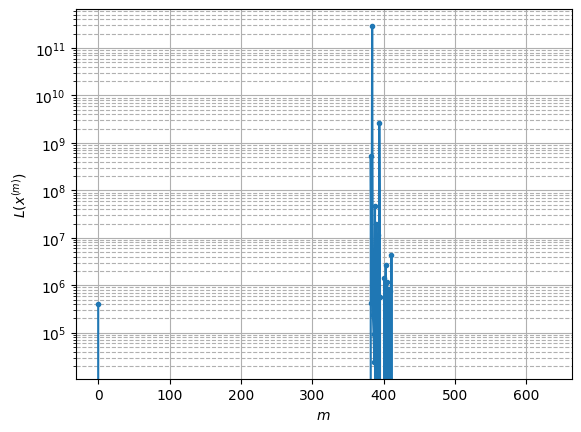

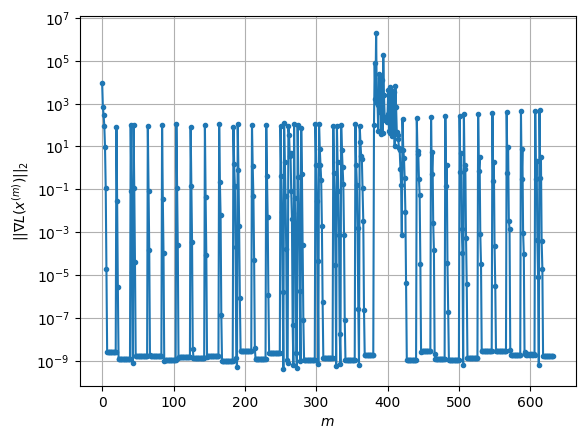

Windows:  10%|█         | 41/395 [00:22<03:55,  1.50it/s]

Before applying the algorithm
Cost function: -219150.36533713184
Gradient norm: 488.00142355348555
Global relative error: 148.70276836712713
Position relative errors: 0.8823192679442813 m, 12.250280707866906 m, 105.27388172917539 m, 104.26945086093703 m

Iteration 1
Cost function: -236338.0573549371 (-7.84%)
Gradient norm: 1.1625384642978276 (-99.76%)
Global relative error: 102.93753147529209 (-30.78%)
Position relative errors: 0.29034115261336196 m, 66.65764239367734 m, 44.205592475623796 m, 64.7434822547565 m

Iteration 2
Cost function: -236353.70930294233 (-0.01%)
Gradient norm: 3.1415781752056584 (170.23%)
Global relative error: 68.64769209079817 (-33.31%)
Position relative errors: 0.29034115261336196 m, 16.063528803468756 m, 42.10298966306066 m, 51.71813740898733 m

Iteration 3
Cost function: -236354.55137187976 (-0.00%)
Gradient norm: 0.013670721494215977 (-99.56%)
Global relative error: 73.98492145873905 (7.77%)
Position relative errors: 0.29034115261336196 m, 17.777575835045695

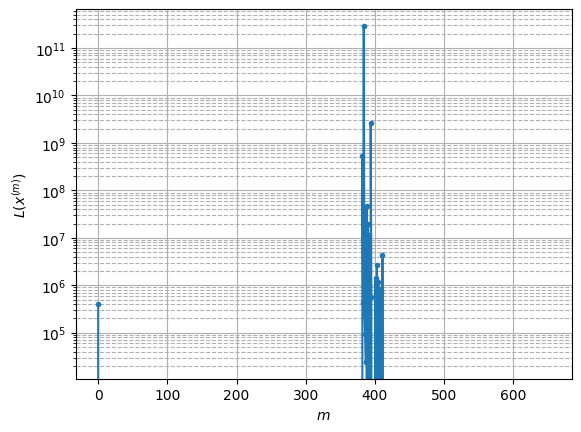

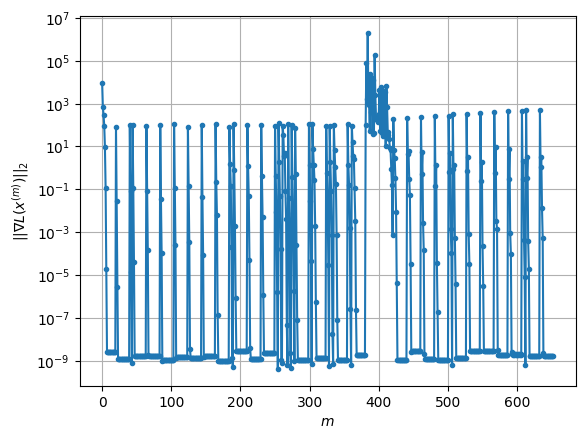

Windows:  11%|█         | 42/395 [00:23<04:04,  1.44it/s]

Before applying the algorithm
Cost function: -216252.07071658986
Gradient norm: 513.1555120402136
Global relative error: 128.99418754061261
Position relative errors: 1.0654943090929807 m, 21.95248341923474 m, 84.470135200113 m, 94.94364281107467 m

Iteration 1
Cost function: -236166.11393086435 (-9.21%)
Gradient norm: 12.11972983206016 (-97.64%)
Global relative error: 320.4217818202406 (148.40%)
Position relative errors: 0.1464256596610751 m, 225.14457795631395 m, 163.4255908929979 m, 158.95011016235844 m

Iteration 2
Cost function: -236313.49801550302 (-0.06%)
Gradient norm: 10.912124091785635 (-9.96%)
Global relative error: 238.89510666338228 (-25.44%)
Position relative errors: 0.1464256596610751 m, 54.147956451457155 m, 208.89958225675713 m, 102.43465883387522 m

Iteration 3
Cost function: -236351.05696370863 (-0.02%)
Gradient norm: 1.250896864407014 (-88.54%)
Global relative error: 157.2030542228579 (-34.20%)
Position relative errors: 0.1464256596610751 m, 27.349570812592976 m, 122

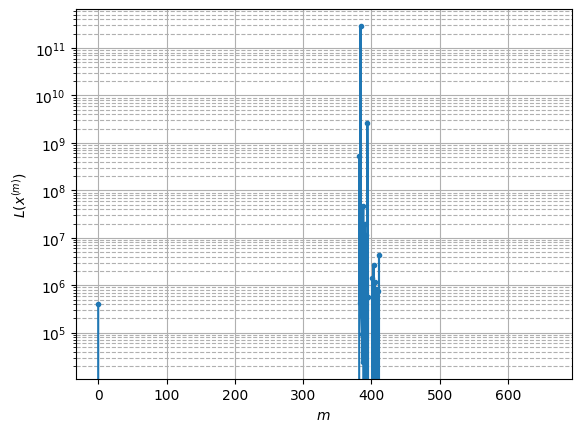

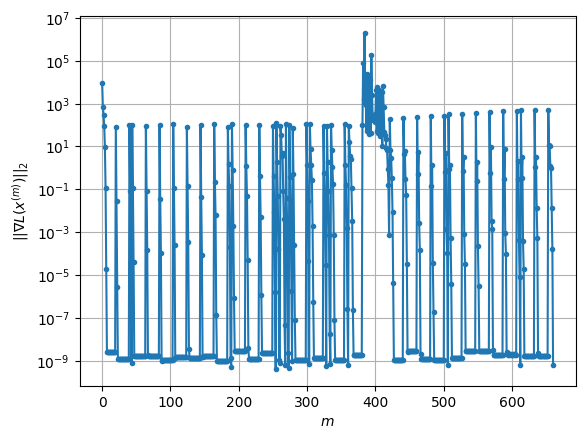

Windows:  11%|█         | 43/395 [00:23<03:57,  1.49it/s]

Before applying the algorithm
Cost function: -213052.59175049004
Gradient norm: 561.1314461917221
Global relative error: 235.4579137070331
Position relative errors: 1.0183613579373154 m, 22.76448668355385 m, 156.61754279450446 m, 174.3132678104271 m

Iteration 1
Cost function: -236330.8989661655 (-10.93%)
Gradient norm: 1.2598526293036054 (-99.78%)
Global relative error: 202.9573543826288 (-13.80%)
Position relative errors: 0.07016233454428294 m, 74.46912670780847 m, 99.61153669311359 m, 160.36387851553772 m

Iteration 2
Cost function: -236356.48587081034 (-0.01%)
Gradient norm: 5.401154238690328 (328.71%)
Global relative error: 62.10792396991762 (-69.40%)
Position relative errors: 0.07016233454428294 m, 14.5782751464388 m, 52.664288145630856 m, 29.399588045737374 m

Iteration 3
Cost function: -236359.0471446314 (-0.00%)
Gradient norm: 0.007828729540663767 (-99.86%)
Global relative error: 70.27282469438401 (13.15%)
Position relative errors: 0.07016233454428294 m, 13.328414503558905 m, 

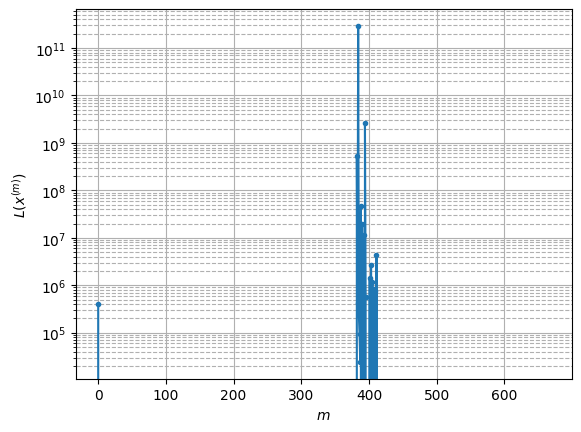

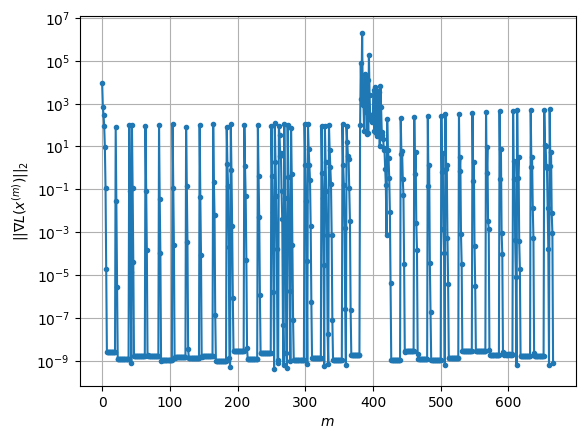

Windows:  11%|█         | 44/395 [00:24<03:55,  1.49it/s]

Before applying the algorithm
Cost function: -211089.02714744798
Gradient norm: 579.8713780897817
Global relative error: 191.3108102073282
Position relative errors: 0.9268198305102474 m, 20.87374468822879 m, 141.17392832054284 m, 127.38185071601171 m

Iteration 1
Cost function: -236351.4273094028 (-11.97%)
Gradient norm: 0.48352730702761554 (-99.92%)
Global relative error: 157.93098544945303 (-17.45%)
Position relative errors: 0.14146717746756812 m, 18.616408888127378 m, 100.23681588688136 m, 120.58667526910197 m

Iteration 2
Cost function: -236354.84864844862 (-0.00%)
Gradient norm: 1.209108723175761 (150.06%)
Global relative error: 60.67602421454766 (-61.58%)
Position relative errors: 0.14146717746756812 m, 4.157868224136567 m, 32.01549572910967 m, 51.305361376618805 m

Iteration 3
Cost function: -236355.0383075005 (-0.00%)
Gradient norm: 0.004642650865814021 (-99.62%)
Global relative error: 59.50911998550687 (-1.92%)
Position relative errors: 0.14146717746756812 m, 4.229954315763762

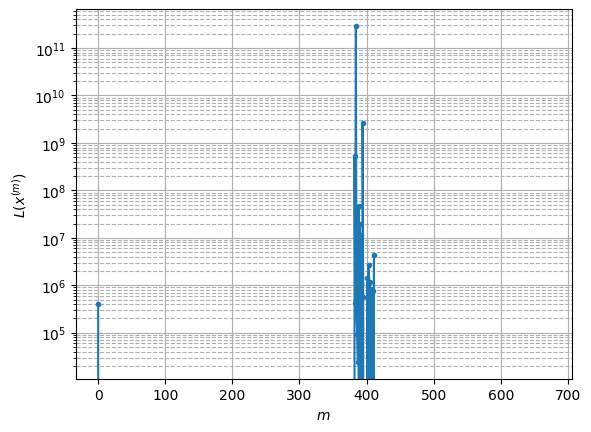

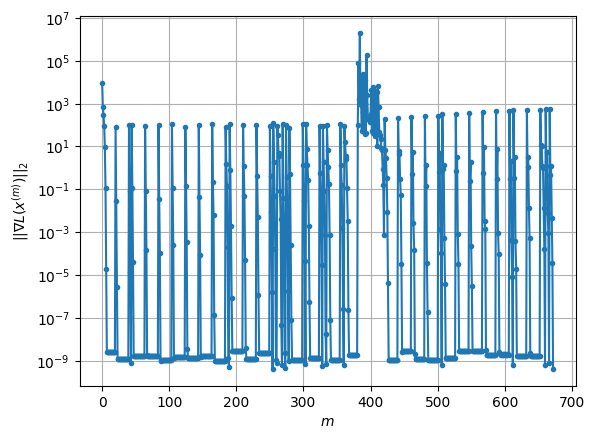

Windows:  11%|█▏        | 45/395 [00:25<04:02,  1.44it/s]

Before applying the algorithm
Cost function: -209064.84697602148
Gradient norm: 599.6930219163075
Global relative error: 200.2053185243951
Position relative errors: 0.9709238133971677 m, 17.707372644876656 m, 137.26181421178103 m, 144.63678704893843 m

Iteration 1
Cost function: -236349.40525626251 (-13.05%)
Gradient norm: 0.6589769166751523 (-99.89%)
Global relative error: 173.42007001357197 (-13.38%)
Position relative errors: 0.12300419855192793 m, 30.384439626663198 m, 97.44239091237043 m, 140.17561063703158 m

Iteration 2
Cost function: -236357.50105490745 (-0.00%)
Gradient norm: 1.0235231057530705 (55.32%)
Global relative error: 75.54573687734882 (-56.44%)
Position relative errors: 0.12300419855192793 m, 20.635233613764118 m, 40.59193526430478 m, 60.22088622432855 m

Iteration 3
Cost function: -236357.65585132036 (-0.00%)
Gradient norm: 0.002123637803527962 (-99.79%)
Global relative error: 75.89124276007745 (0.46%)
Position relative errors: 0.12300419855192793 m, 21.62054205084120

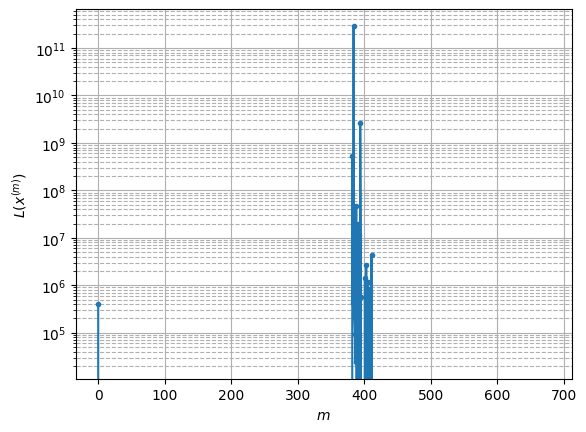

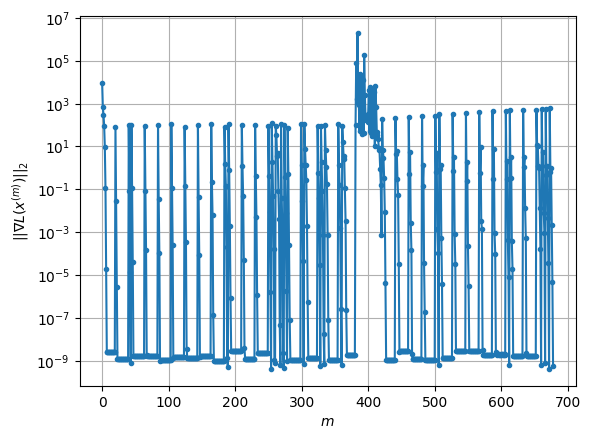

Windows:  12%|█▏        | 46/395 [00:25<03:49,  1.52it/s]

Before applying the algorithm
Cost function: -207566.32630208187
Gradient norm: 611.8004846651095
Global relative error: 211.8529136832535
Position relative errors: 0.9608080584543343 m, 31.769992286622323 m, 142.91443282892763 m, 153.10052204317734 m

Iteration 1
Cost function: -236341.3824763735 (-13.86%)
Gradient norm: 0.7469100906931845 (-99.88%)
Global relative error: 177.50146063253936 (-16.21%)
Position relative errors: 0.08061159669302474 m, 58.765780221508415 m, 89.53903119134942 m, 141.52388661765903 m

Iteration 2
Cost function: -236353.19398498544 (-0.00%)
Gradient norm: 2.1144468711852844 (183.09%)
Global relative error: 125.62662314636432 (-29.23%)
Position relative errors: 0.08061159669302474 m, 9.622966396760145 m, 60.51130951939631 m, 109.6390686276768 m

Iteration 3
Cost function: -236353.66346840427 (-0.00%)
Gradient norm: 0.01065534535823559 (-99.50%)
Global relative error: 128.6811380349958 (2.43%)
Position relative errors: 0.08061159669302474 m, 8.67599053543637 m

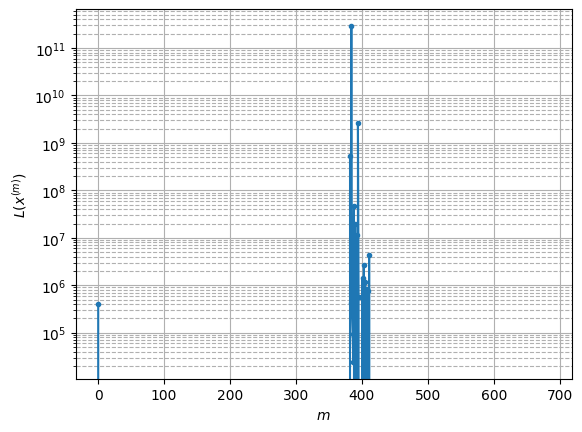

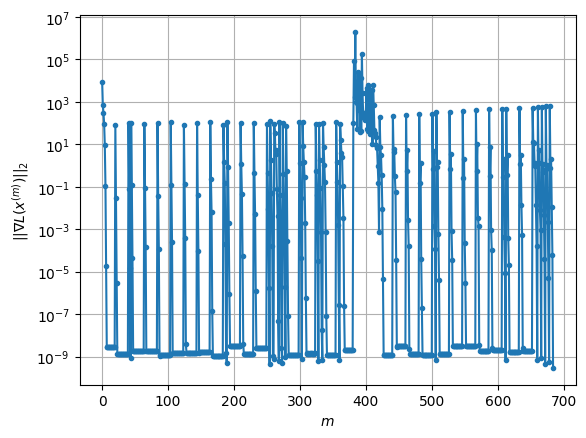

Windows:  12%|█▏        | 47/395 [00:26<03:57,  1.47it/s]

Before applying the algorithm
Cost function: -204376.83841582894
Gradient norm: 644.0854656219095
Global relative error: 243.63035972546416
Position relative errors: 1.0076667275952949 m, 22.401659060833623 m, 158.64894130326772 m, 183.51097200255086 m

Iteration 1
Cost function: -236335.83386075063 (-15.64%)
Gradient norm: 0.5272910822836306 (-99.92%)
Global relative error: 218.09406357538234 (-10.48%)
Position relative errors: 0.175539216042279 m, 25.380966575516304 m, 116.51383994488367 m, 182.58746493863825 m

Iteration 2
Cost function: -236348.62322105133 (-0.01%)
Gradient norm: 9.916874293525012 (1780.72%)
Global relative error: 140.6684600740274 (-35.50%)
Position relative errors: 0.175539216042279 m, 16.222110111866943 m, 63.14703498407938 m, 124.61838116723042 m

Iteration 3
Cost function: -236356.06242947263 (-0.00%)
Gradient norm: 0.0010591462752116692 (-99.99%)
Global relative error: 142.68927893078938 (1.44%)
Position relative errors: 0.175539216042279 m, 15.98162585312033

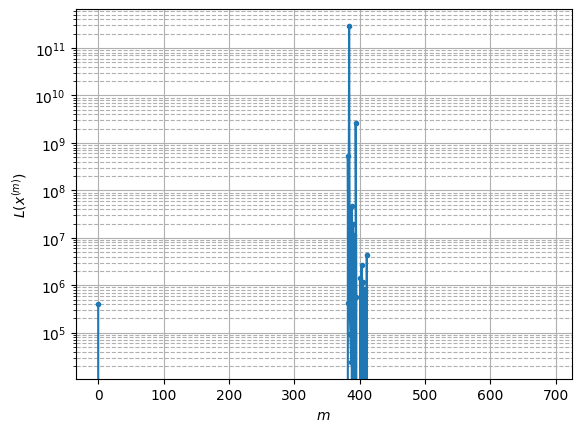

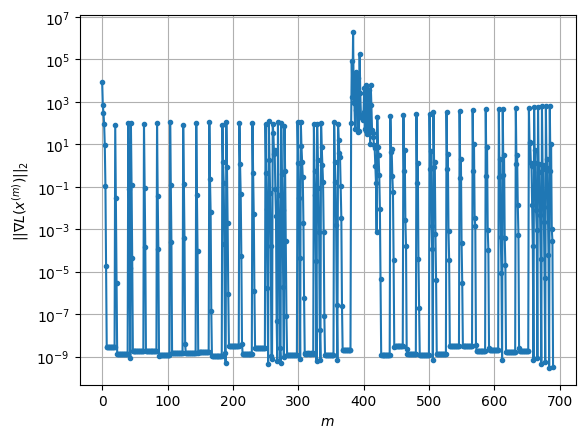

Windows:  12%|█▏        | 48/395 [00:27<03:51,  1.50it/s]

Before applying the algorithm
Cost function: -207793.25089237213
Gradient norm: 613.6729200142345
Global relative error: 151.36229193886086
Position relative errors: 1.1316831655864332 m, 11.035032628858817 m, 91.27126710621056 m, 120.20796276596269 m

Iteration 1
Cost function: -236353.78756766886 (-13.74%)
Gradient norm: 0.3789815216257186 (-99.94%)
Global relative error: 72.27236266077043 (-52.25%)
Position relative errors: 0.07223522774808465 m, 12.897987410628803 m, 34.84792949394545 m, 61.93109606506797 m

Iteration 2
Cost function: -236356.25537536474 (-0.00%)
Gradient norm: 1.3988206849271525 (269.10%)
Global relative error: 48.75346074904612 (-32.54%)
Position relative errors: 0.07223522774808465 m, 4.601904087136901 m, 22.53534414081311 m, 42.90434946188069 m

Iteration 3
Cost function: -236356.45000549132 (-0.00%)
Gradient norm: 0.005752881952152763 (-99.59%)
Global relative error: 52.02659195703195 (6.71%)
Position relative errors: 0.07223522774808465 m, 4.613847062117869 m

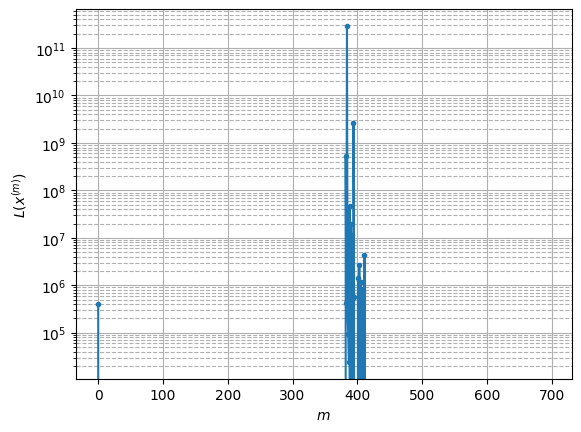

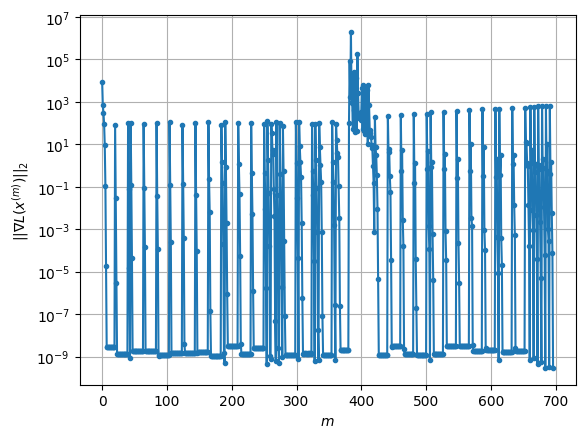

Windows:  12%|█▏        | 49/395 [00:27<03:49,  1.50it/s]

Before applying the algorithm
Cost function: -204375.43775932805
Gradient norm: 640.2702492689369
Global relative error: 160.1919103597676
Position relative errors: 0.9688336025067349 m, 12.625055420383102 m, 112.25792492259454 m, 113.54388797773595 m

Iteration 1
Cost function: -236345.91076269982 (-15.64%)
Gradient norm: 0.8021850763681327 (-99.87%)
Global relative error: 116.24729272673224 (-27.43%)
Position relative errors: 0.210542669872943 m, 31.3548738055628 m, 78.86642438083568 m, 79.39323935531728 m

Iteration 2
Cost function: -236356.54421111906 (-0.00%)
Gradient norm: 0.9981808050431769 (24.43%)
Global relative error: 49.291213867206636 (-57.60%)
Position relative errors: 0.210542669872943 m, 24.847776461483775 m, 6.640803206715436 m, 41.9643407813047 m

Iteration 3
Cost function: -236356.85514170918 (-0.00%)
Gradient norm: 0.013025544887143461 (-98.70%)
Global relative error: 53.904858735484574 (9.36%)
Position relative errors: 0.210542669872943 m, 24.14582740524818 m, 17.4

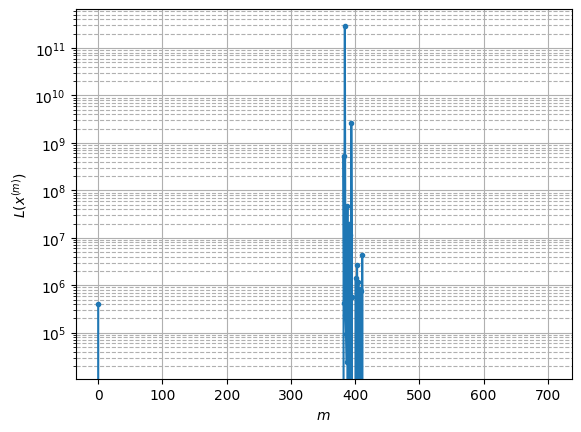

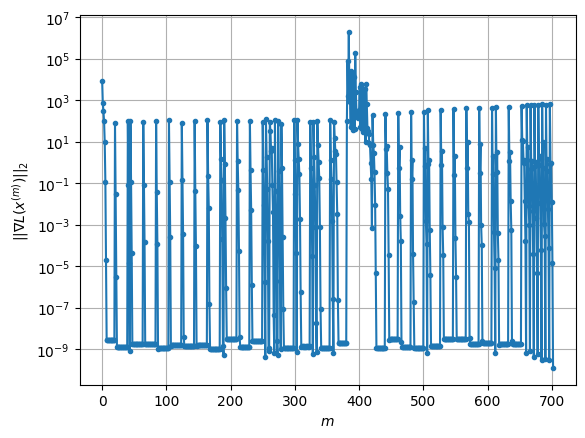

Windows:  13%|█▎        | 50/395 [00:28<03:49,  1.50it/s]

Before applying the algorithm
Cost function: -202615.01976425605
Gradient norm: 665.9814232368634
Global relative error: 184.4404089587401
Position relative errors: 1.1443893722246745 m, 32.69490186971919 m, 121.64274598587872 m, 134.69966230449594 m

Iteration 1
Cost function: -236301.25387987963 (-16.63%)
Gradient norm: 2.7434784878154934 (-99.59%)
Global relative error: 144.3724323988138 (-21.72%)
Position relative errors: 0.16067230424875695 m, 109.33924728944238 m, 52.2684601718204 m, 78.41727455716935 m

Iteration 2
Cost function: -236352.19200637267 (-0.02%)
Gradient norm: 5.965306069321542 (117.44%)
Global relative error: 109.86992901296864 (-23.90%)
Position relative errors: 0.16067230424875695 m, 9.358465046618957 m, 56.19321652382259 m, 93.90993285468903 m

Iteration 3
Cost function: -236357.42770289967 (-0.00%)
Gradient norm: 0.04946261186638518 (-99.17%)
Global relative error: 107.03667627809953 (-2.58%)
Position relative errors: 0.16067230424875695 m, 9.55660182118726 m, 

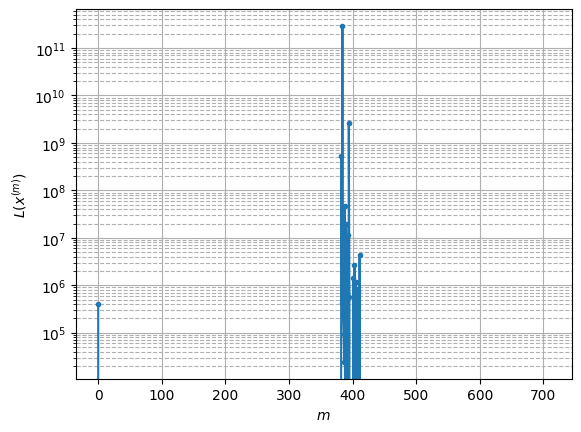

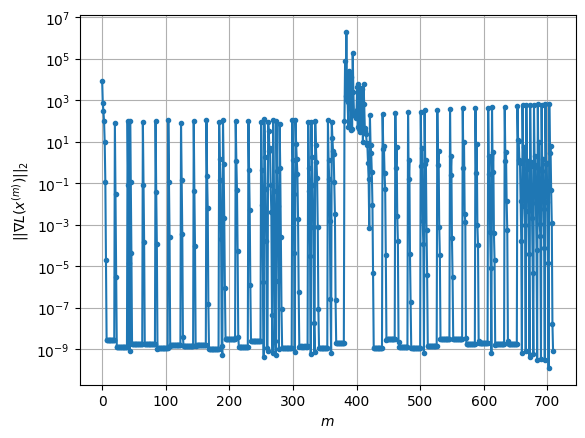

Windows:  13%|█▎        | 51/395 [00:29<03:54,  1.47it/s]

Before applying the algorithm
Cost function: -203637.3674219688
Gradient norm: 640.7143753426033
Global relative error: 177.0787162621775
Position relative errors: 0.9239184227733385 m, 9.004645113541878 m, 101.74756973743824 m, 144.6214758184735 m

Iteration 1
Cost function: -236357.73814900633 (-16.07%)
Gradient norm: 0.4974818390833217 (-99.92%)
Global relative error: 107.55861953572648 (-39.26%)
Position relative errors: 0.21144168359560622 m, 9.579383259778742 m, 41.199180477478066 m, 98.85686417438215 m

Iteration 2
Cost function: -236359.1255636182 (-0.00%)
Gradient norm: 0.47962759067383204 (-3.59%)
Global relative error: 28.052632298710304 (-73.92%)
Position relative errors: 0.21144168359560622 m, 3.1537010643560115 m, 6.264415922668307 m, 27.03186000344342 m

Iteration 3
Cost function: -236359.14541193622 (-0.00%)
Gradient norm: 0.0003973038925966491 (-99.92%)
Global relative error: 27.578164097420803 (-1.69%)
Position relative errors: 0.21144168359560622 m, 3.167762038771034

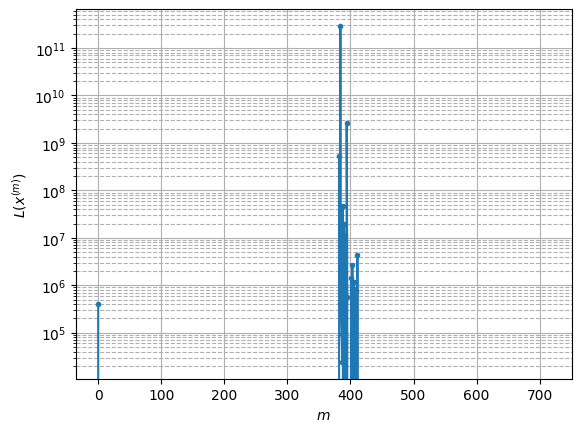

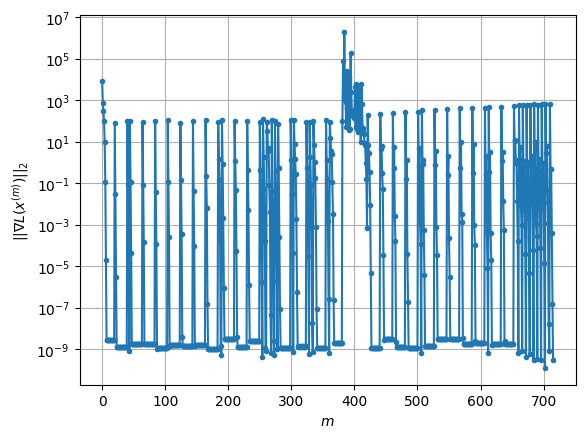

Windows:  13%|█▎        | 52/395 [00:29<03:48,  1.50it/s]

Before applying the algorithm
Cost function: -200474.13795879376
Gradient norm: 673.3407717848085
Global relative error: 166.56843836442468
Position relative errors: 1.097844358718473 m, 13.492836058184556 m, 113.10671738500378 m, 121.49768469104421 m

Iteration 1
Cost function: -236330.56134719515 (-17.89%)
Gradient norm: 1.7455970834319097 (-99.74%)
Global relative error: 80.33223238925521 (-51.77%)
Position relative errors: 0.1187876333155978 m, 62.56464197895791 m, 23.785423234629334 m, 44.341930456343825 m

Iteration 2
Cost function: -236355.50368924593 (-0.01%)
Gradient norm: 2.3470622867339634 (34.46%)
Global relative error: 31.16967683408185 (-61.20%)
Position relative errors: 0.1187876333155978 m, 5.466818215261857 m, 24.8167572341643 m, 17.855285863925236 m

Iteration 3
Cost function: -236356.46353010018 (-0.00%)
Gradient norm: 0.009972240123817987 (-99.58%)
Global relative error: 27.552299740517235 (-11.61%)
Position relative errors: 0.1187876333155978 m, 9.049252211673087 m

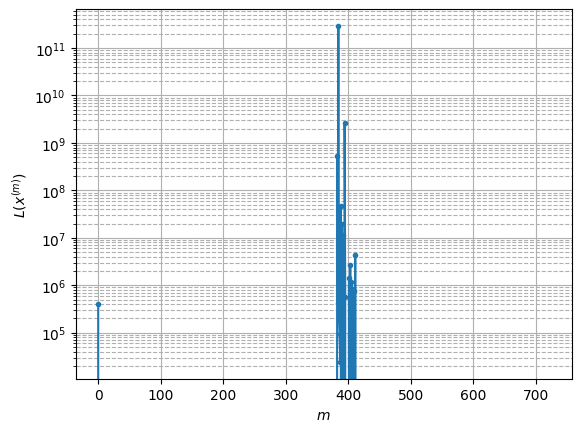

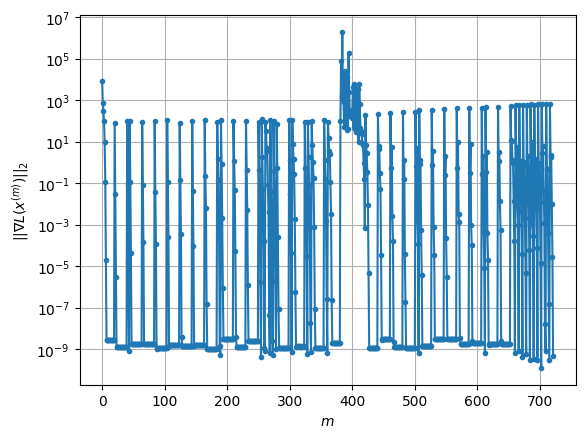

Windows:  13%|█▎        | 53/395 [00:30<03:59,  1.43it/s]

Before applying the algorithm
Cost function: -199609.16596251845
Gradient norm: 682.9683401421985
Global relative error: 161.15573014823016
Position relative errors: 1.0384223190437685 m, 15.952460323032865 m, 109.30822555793638 m, 117.304652491767 m

Iteration 1
Cost function: -236323.36520553834 (-18.39%)
Gradient norm: 2.0412463651890547 (-99.70%)
Global relative error: 140.53903316155078 (-12.79%)
Position relative errors: 0.10080473573823362 m, 71.07342183287865 m, 71.65528637450305 m, 97.76685505038387 m

Iteration 2
Cost function: -236354.16416908125 (-0.01%)
Gradient norm: 3.9230267494039 (92.19%)
Global relative error: 133.49272443575103 (-5.01%)
Position relative errors: 0.10080473573823362 m, 9.509069571040786 m, 90.8129702958745 m, 97.34443466433373 m

Iteration 3
Cost function: -236356.14618288644 (-0.00%)
Gradient norm: 0.04464605397622832 (-98.86%)
Global relative error: 126.58314227922067 (-5.18%)
Position relative errors: 0.10080473573823362 m, 9.918103194169136 m, 75.

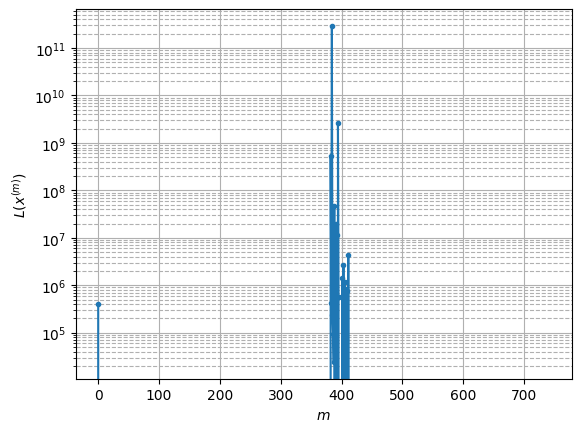

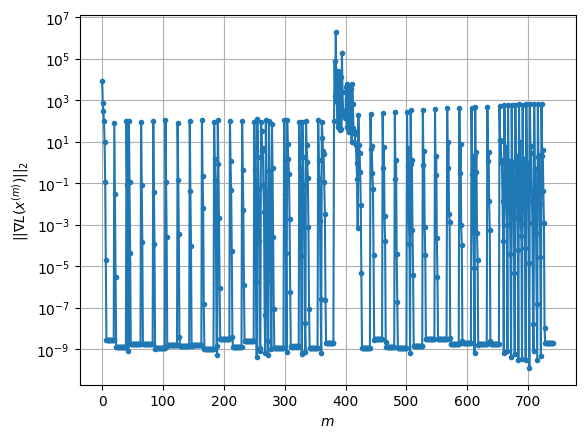

Windows:  14%|█▎        | 54/395 [00:31<03:55,  1.45it/s]

Before applying the algorithm
Cost function: -200739.09589765355
Gradient norm: 668.4174282304267
Global relative error: 164.60006313335816
Position relative errors: 1.0564733307953 m, 8.444715818836015 m, 108.47333604774397 m, 123.48024797415017 m

Iteration 1
Cost function: -236328.68772951103 (-17.73%)
Gradient norm: 1.8432125400789858 (-99.72%)
Global relative error: 89.43999760615198 (-45.66%)
Position relative errors: 0.3520382767498882 m, 64.90569071632571 m, 38.51170647852359 m, 47.92258202901206 m

Iteration 2
Cost function: -236347.08848292398 (-0.01%)
Gradient norm: 1.02471598115504 (-44.41%)
Global relative error: 45.80439778677111 (-48.79%)
Position relative errors: 0.3520382767498882 m, 14.417392892788566 m, 23.095692574340205 m, 36.73869272423159 m

Iteration 3
Cost function: -236347.39926251987 (-0.00%)
Gradient norm: 0.013888339082206658 (-98.64%)
Global relative error: 41.89522530609979 (-8.53%)
Position relative errors: 0.3520382767498882 m, 13.053895306897632 m, 16.

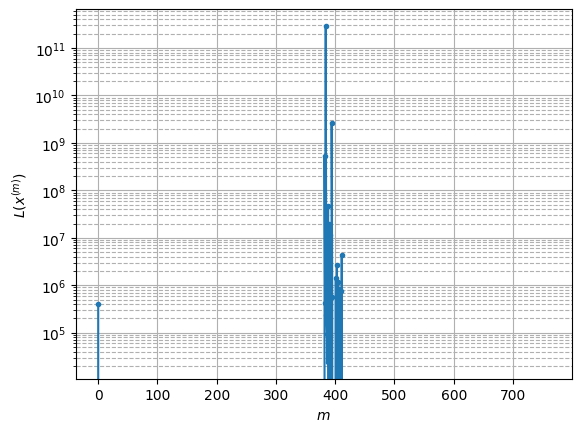

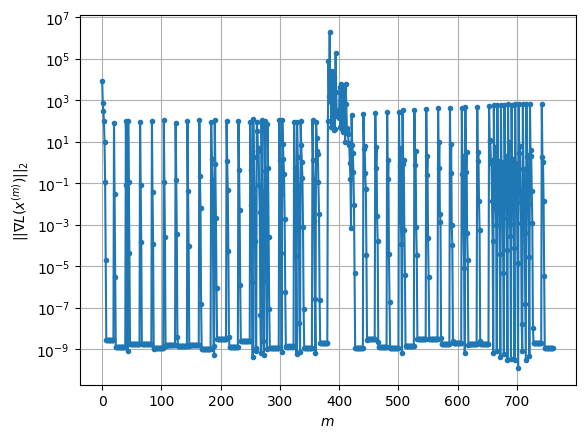

Windows:  14%|█▍        | 55/395 [00:31<03:51,  1.47it/s]

Before applying the algorithm
Cost function: -199063.9456369564
Gradient norm: 687.001349534822
Global relative error: 154.05285100478474
Position relative errors: 0.7078228261126711 m, 14.681651254642127 m, 109.99990784690631 m, 106.81461799448388 m

Iteration 1
Cost function: -236352.87167061755 (-18.73%)
Gradient norm: 0.7622626600388807 (-99.89%)
Global relative error: 27.248971494252523 (-82.31%)
Position relative errors: 0.07919009382557467 m, 20.296933592396865 m, 13.024786317854792 m, 12.409792189749888 m

Iteration 2
Cost function: -236358.44133078668 (-0.00%)
Gradient norm: 1.0177667055275958 (33.52%)
Global relative error: 76.86910527852233 (182.10%)
Position relative errors: 0.07919009382557467 m, 9.26741267293789 m, 18.85137450196198 m, 73.89659772029383 m

Iteration 3
Cost function: -236358.56249464053 (-0.00%)
Gradient norm: 0.0015843782959407825 (-99.84%)
Global relative error: 76.07632703500218 (-1.03%)
Position relative errors: 0.07919009382557467 m, 8.91179143871738 

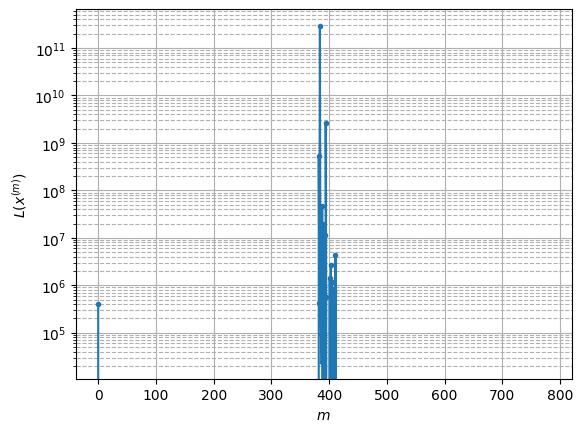

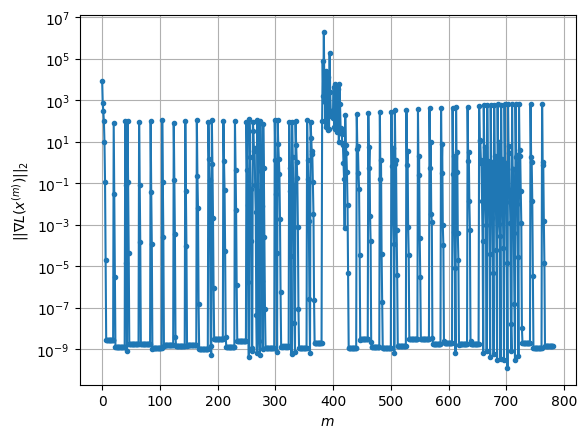

Windows:  14%|█▍        | 56/395 [00:32<03:54,  1.45it/s]

Before applying the algorithm
Cost function: -198118.17744619658
Gradient norm: 691.2771984054325
Global relative error: 191.64343744461064
Position relative errors: 0.9884986547393751 m, 15.464031391599656 m, 116.38084483991892 m, 151.44551355216421 m

Iteration 1
Cost function: -236349.25963766055 (-19.30%)
Gradient norm: 0.8591426700796047 (-99.88%)
Global relative error: 101.53489088503605 (-47.02%)
Position relative errors: 0.18540814366603064 m, 22.933300170939564 m, 35.477682713177984 m, 92.29219016279521 m

Iteration 2
Cost function: -236355.9147511234 (-0.00%)
Gradient norm: 2.6729062355854616 (211.11%)
Global relative error: 69.10327530775764 (-31.94%)
Position relative errors: 0.18540814366603064 m, 2.1256767986764014 m, 55.09439770434229 m, 41.57484844758673 m

Iteration 3
Cost function: -236356.46541835583 (-0.00%)
Gradient norm: 0.0020354604872638133 (-99.92%)
Global relative error: 71.73489117820206 (3.81%)
Position relative errors: 0.18540814366603064 m, 1.9829583049537

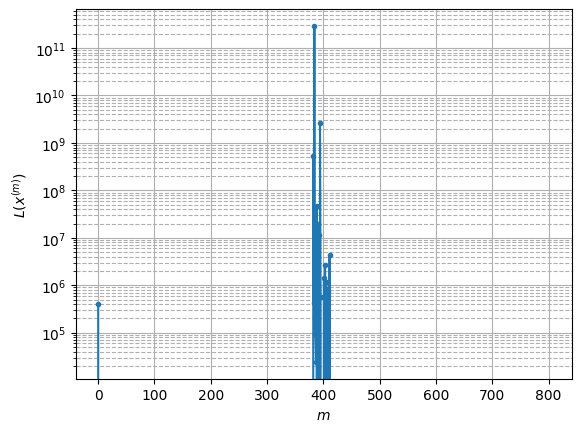

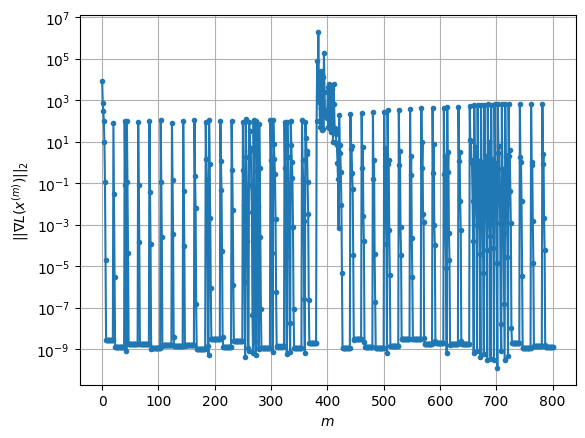

Windows:  14%|█▍        | 57/395 [00:33<03:55,  1.44it/s]

Before applying the algorithm
Cost function: -197921.6646719968
Gradient norm: 691.0114150371228
Global relative error: 152.61538715986657
Position relative errors: 0.9465674470785848 m, 14.692087037575705 m, 112.20859296017885 m, 102.35773318946656 m

Iteration 1
Cost function: -236356.2944068696 (-19.42%)
Gradient norm: 0.7074526088306924 (-99.90%)
Global relative error: 30.702516443375462 (-79.88%)
Position relative errors: 0.2465007795942281 m, 19.293819483040796 m, 9.9916003133548 m, 21.53302341846418 m

Iteration 2
Cost function: -236359.95262619664 (-0.00%)
Gradient norm: 0.8805683187571097 (24.47%)
Global relative error: 58.61290966694542 (90.91%)
Position relative errors: 0.2465007795942281 m, 2.5135837408759882 m, 39.23097395015738 m, 43.39580495826257 m

Iteration 3
Cost function: -236360.02855160795 (-0.00%)
Gradient norm: 0.0020288638967916757 (-99.77%)
Global relative error: 59.761503806883134 (1.96%)
Position relative errors: 0.2465007795942281 m, 2.300093890691415 m, 38

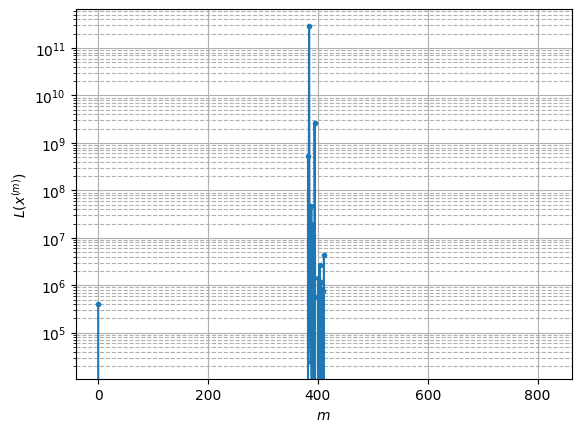

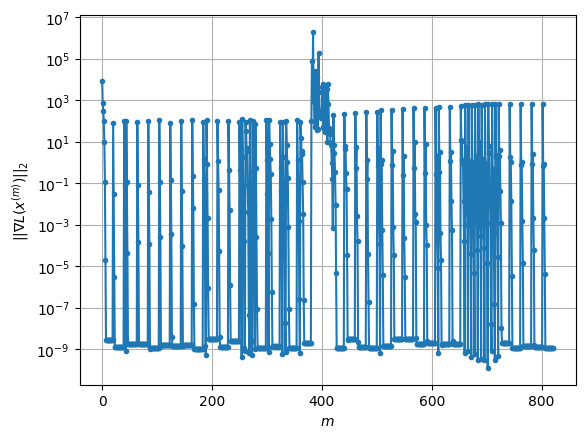

Windows:  15%|█▍        | 58/395 [00:33<03:40,  1.53it/s]

Before applying the algorithm
Cost function: -198098.4144621158
Gradient norm: 678.9300448223554
Global relative error: 181.53373829345193
Position relative errors: 1.1258770108679512 m, 13.638299787314372 m, 124.56618359905657 m, 131.31524831450494 m

Iteration 1
Cost function: -236352.03998494206 (-19.31%)
Gradient norm: 0.7108520339679508 (-99.90%)
Global relative error: 86.95188562069842 (-52.10%)
Position relative errors: 0.20325213879030216 m, 22.324982063349214 m, 55.886837280824835 m, 62.70603570511824 m

Iteration 2
Cost function: -236358.71162290018 (-0.00%)
Gradient norm: 3.194618980205235 (349.41%)
Global relative error: 105.71032057774212 (21.57%)
Position relative errors: 0.20325213879030216 m, 5.484319843765289 m, 49.285575461732996 m, 93.32034113817262 m

Iteration 3
Cost function: -236359.50466652575 (-0.00%)
Gradient norm: 0.001782771778752012 (-99.94%)
Global relative error: 106.92048171488403 (1.14%)
Position relative errors: 0.20325213879030216 m, 5.845064563162377

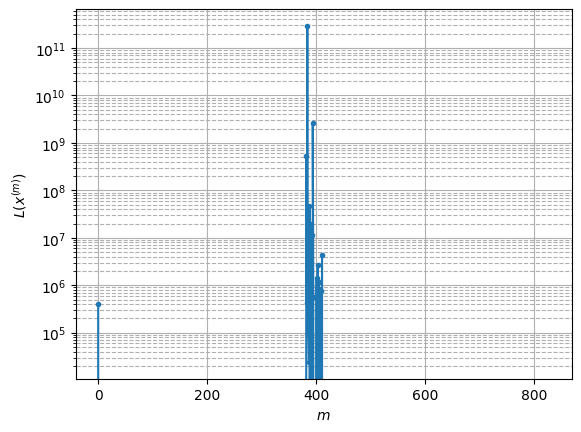

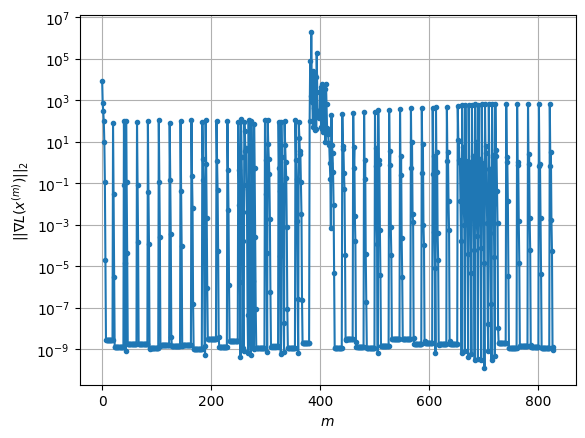

Windows:  15%|█▍        | 59/395 [00:34<03:41,  1.52it/s]

Before applying the algorithm
Cost function: -196652.70708344996
Gradient norm: 692.6142568889388
Global relative error: 173.48487205269328
Position relative errors: 1.2205352777259886 m, 20.236995564324623 m, 121.68553980580253 m, 121.95016204669919 m

Iteration 1
Cost function: -236353.55506008674 (-20.19%)
Gradient norm: 0.757706031694384 (-99.89%)
Global relative error: 103.0343242960511 (-40.61%)
Position relative errors: 0.09059494885118408 m, 12.665258219549667 m, 47.57371382600677 m, 90.47449501640482 m

Iteration 2
Cost function: -236358.69845036828 (-0.00%)
Gradient norm: 2.6130298905536473 (244.86%)
Global relative error: 75.36824097752043 (-26.85%)
Position relative errors: 0.09059494885118408 m, 5.418707076422128 m, 35.76624251149219 m, 66.06825664849165 m

Iteration 3
Cost function: -236359.23552839836 (-0.00%)
Gradient norm: 0.0013279290182881497 (-99.95%)
Global relative error: 75.30786550201192 (-0.08%)
Position relative errors: 0.09059494885118408 m, 5.750423770405125

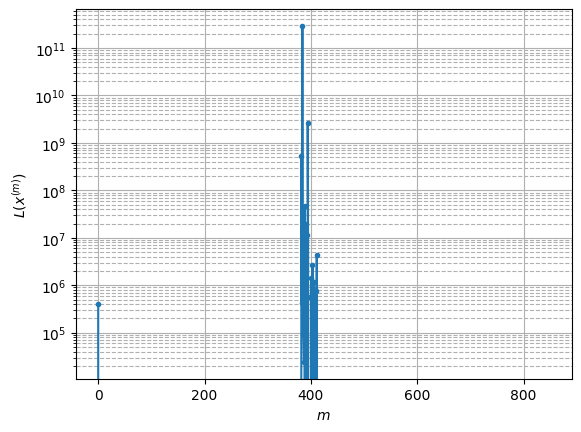

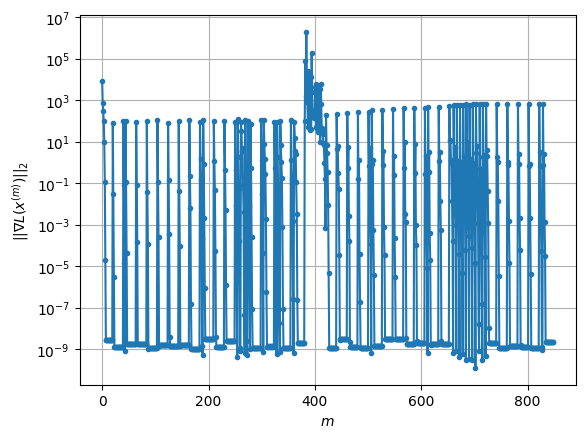

Windows:  15%|█▌        | 60/395 [00:35<03:36,  1.54it/s]

Before applying the algorithm
Cost function: -199663.81386098327
Gradient norm: 661.9390423118614
Global relative error: 186.70980336308787
Position relative errors: 1.0789363712891578 m, 11.95492619432785 m, 112.52535701918828 m, 148.48487978379637 m

Iteration 1
Cost function: -236353.97904566984 (-18.38%)
Gradient norm: 0.7662792619103377 (-99.88%)
Global relative error: 121.4294413521256 (-34.96%)
Position relative errors: 0.2994753031995795 m, 15.795754075286473 m, 54.62757860131467 m, 107.25945431433425 m

Iteration 2
Cost function: -236356.30737682362 (-0.00%)
Gradient norm: 0.673268423858697 (-12.14%)
Global relative error: 51.97554076928855 (-57.20%)
Position relative errors: 0.2994753031995795 m, 5.113717138930082 m, 21.801817893087264 m, 46.83104712910906 m

Iteration 3
Cost function: -236356.34439461492 (-0.00%)
Gradient norm: 0.00026055342261451723 (-99.96%)
Global relative error: 51.82328005562055 (-0.29%)
Position relative errors: 0.2994753031995795 m, 5.36848497763359 m

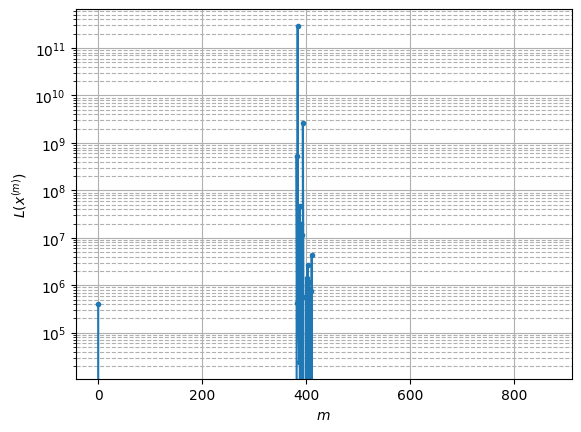

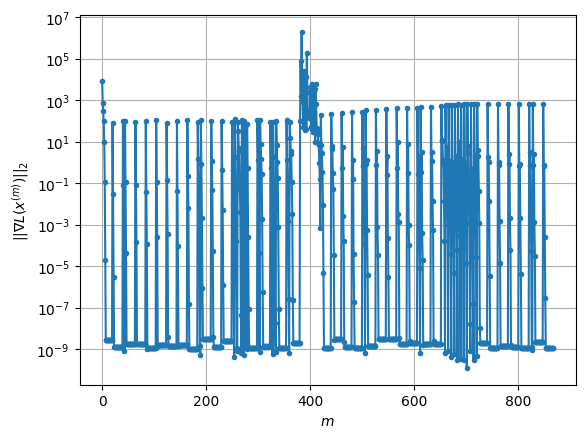

Windows:  15%|█▌        | 61/395 [00:35<03:42,  1.50it/s]

Before applying the algorithm
Cost function: -199020.29494945394
Gradient norm: 676.9041391100128
Global relative error: 172.31425983809316
Position relative errors: 1.2392887917829267 m, 11.28286580805979 m, 112.72208671598013 m, 129.80890263405462 m

Iteration 1
Cost function: -236362.09537608598 (-18.76%)
Gradient norm: 0.8396454628890138 (-99.88%)
Global relative error: 78.735708875738 (-54.31%)
Position relative errors: 0.15738315565617028 m, 6.763295618840078 m, 38.748310949709065 m, 68.15693731593845 m

Iteration 2
Cost function: -236363.12280806844 (-0.00%)
Gradient norm: 0.18180319829934535 (-78.35%)
Global relative error: 63.951066727650634 (-18.78%)
Position relative errors: 0.15738315565617028 m, 12.81419541878878 m, 28.292294204680562 m, 55.84184310368234 m

Iteration 3
Cost function: -236363.13068911096 (-0.00%)
Gradient norm: 0.0011339833671714411 (-99.38%)
Global relative error: 63.03618699249993 (-1.43%)
Position relative errors: 0.15738315565617028 m, 12.2702119856955

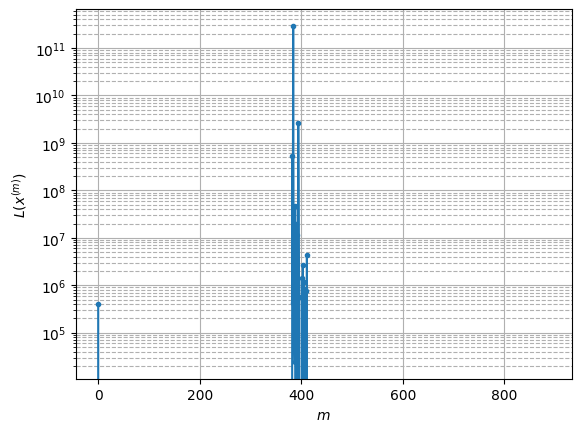

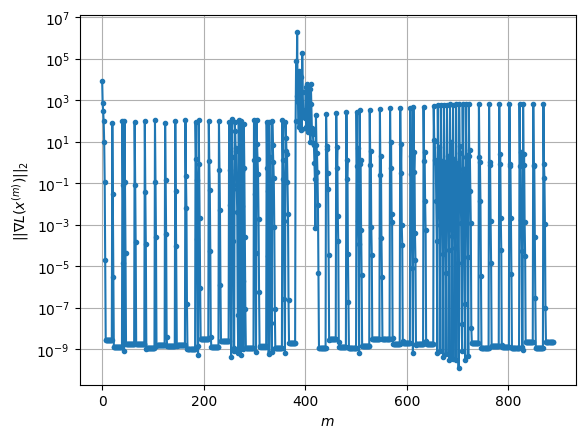

Windows:  16%|█▌        | 62/395 [00:36<03:45,  1.48it/s]

Before applying the algorithm
Cost function: -200266.18456368946
Gradient norm: 648.4379228055805
Global relative error: 183.5490887038212
Position relative errors: 1.0043763628697635 m, 11.575265294610508 m, 115.2982865612116 m, 142.31947570691057 m

Iteration 1
Cost function: -236360.25230525172 (-18.02%)
Gradient norm: 0.975778038522421 (-99.85%)
Global relative error: 92.01453669641768 (-49.87%)
Position relative errors: 0.1004718570308065 m, 4.864408442043391 m, 39.90241300870333 m, 82.72880670849199 m

Iteration 2
Cost function: -236361.9873523434 (-0.00%)
Gradient norm: 0.575846984061827 (-40.99%)
Global relative error: 37.57927812368084 (-59.16%)
Position relative errors: 0.1004718570308065 m, 8.133108689829038 m, 26.53907794350675 m, 25.19876105302911 m

Iteration 3
Cost function: -236362.01619455498 (-0.00%)
Gradient norm: 0.0011220351753234844 (-99.81%)
Global relative error: 36.48014584991823 (-2.92%)
Position relative errors: 0.1004718570308065 m, 7.662171819423414 m, 26.0

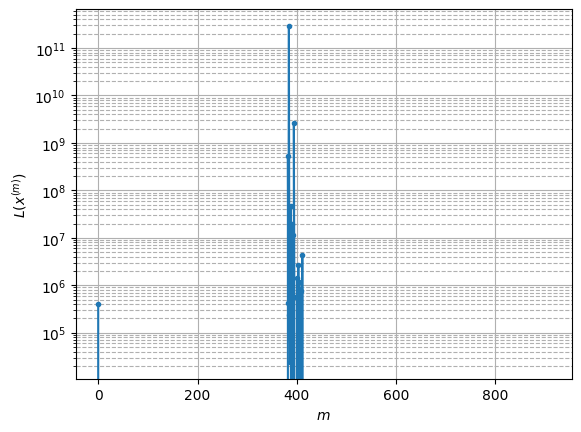

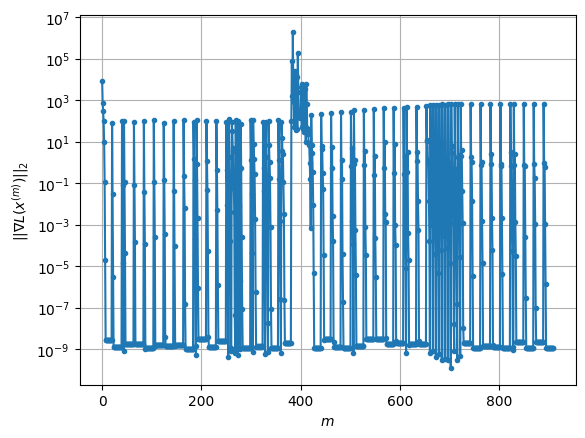

Windows:  16%|█▌        | 63/395 [00:37<03:48,  1.46it/s]

Before applying the algorithm
Cost function: -199837.707382224
Gradient norm: 651.352550134663
Global relative error: 165.63985602918927
Position relative errors: 1.0538641687717303 m, 12.208104017868699 m, 111.96630299228242 m, 121.42163437526801 m

Iteration 1
Cost function: -236354.056253501 (-18.27%)
Gradient norm: 1.0433020545718363 (-99.84%)
Global relative error: 68.20478635539622 (-58.82%)
Position relative errors: 0.19444408000045757 m, 9.354380110086934 m, 27.710549597307466 m, 61.56077416020529 m

Iteration 2
Cost function: -236358.2835283561 (-0.00%)
Gradient norm: 2.6558935958369205 (154.57%)
Global relative error: 116.761829457218 (71.19%)
Position relative errors: 0.19444408000045757 m, 10.00102292235226 m, 28.53689710253586 m, 112.74823671397131 m

Iteration 3
Cost function: -236358.84230687036 (-0.00%)
Gradient norm: 0.003784064876658765 (-99.86%)
Global relative error: 118.22115383986619 (1.25%)
Position relative errors: 0.19444408000045757 m, 9.05247440724094 m, 32.1

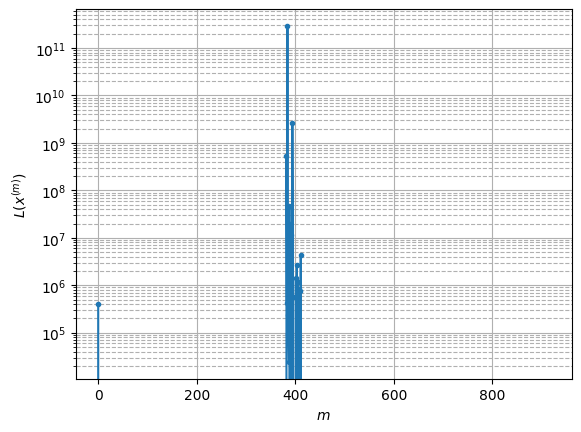

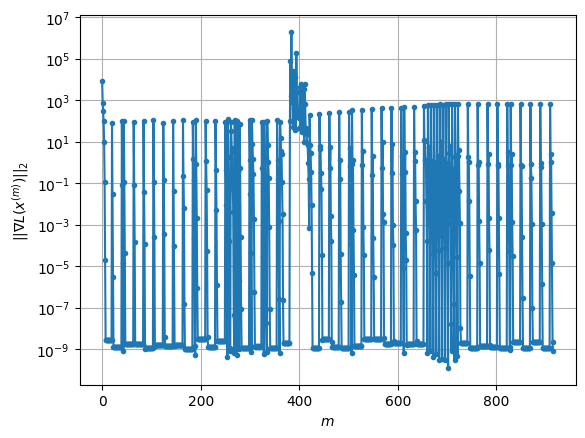

Windows:  16%|█▌        | 64/395 [00:37<03:37,  1.52it/s]

Before applying the algorithm
Cost function: -201865.08892180183
Gradient norm: 635.9414425735171
Global relative error: 182.75800520631654
Position relative errors: 0.9380983719052186 m, 15.377244532624877 m, 112.24251805610676 m, 143.38058522541053 m

Iteration 1
Cost function: -236352.8702453657 (-17.08%)
Gradient norm: 1.243830256645012 (-99.80%)
Global relative error: 112.76574027404752 (-38.30%)
Position relative errors: 0.07541044243137707 m, 16.475420677160724 m, 22.86341946797317 m, 109.15657262252859 m

Iteration 2
Cost function: -236357.05019239668 (-0.00%)
Gradient norm: 2.59507665082961 (108.64%)
Global relative error: 35.054693834682965 (-68.91%)
Position relative errors: 0.07541044243137707 m, 3.2026882132225887 m, 4.7018652405783845 m, 34.49184562636503 m

Iteration 3
Cost function: -236357.5874759694 (-0.00%)
Gradient norm: 0.005160641090471231 (-99.80%)
Global relative error: 35.68623695291524 (1.80%)
Position relative errors: 0.07541044243137707 m, 2.8967650721990523

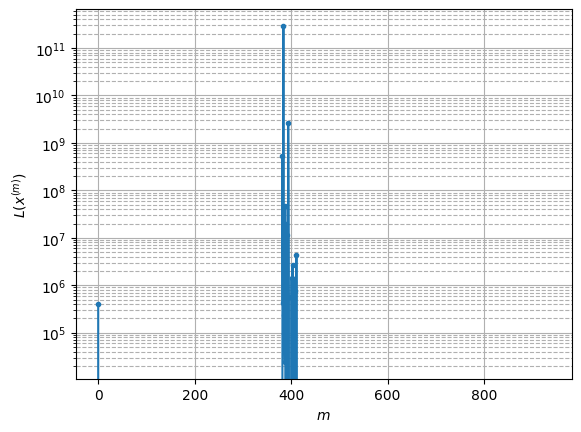

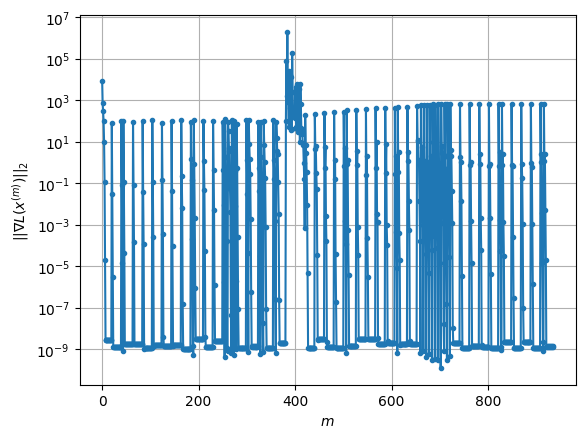

Windows:  16%|█▋        | 65/395 [00:38<03:47,  1.45it/s]

Before applying the algorithm
Cost function: -200627.94737575424
Gradient norm: 633.3786156261596
Global relative error: 156.21958914274097
Position relative errors: 1.0472510717719925 m, 17.258434301488823 m, 110.1868000019056 m, 109.35135053864701 m

Iteration 1
Cost function: -236354.41799174843 (-17.81%)
Gradient norm: 1.3525394810217286 (-99.79%)
Global relative error: 59.56633881088218 (-61.87%)
Position relative errors: 0.15707171554331512 m, 8.604504905518594 m, 25.267652165384476 m, 53.187134853217714 m

Iteration 2
Cost function: -236357.03366553402 (-0.00%)
Gradient norm: 0.5180207819373766 (-61.70%)
Global relative error: 85.12439446303726 (42.91%)
Position relative errors: 0.15707171554331512 m, 22.889916506500107 m, 29.728346889488687 m, 76.36526691778117 m

Iteration 3
Cost function: -236357.0841202199 (-0.00%)
Gradient norm: 0.00585681253461449 (-98.87%)
Global relative error: 80.13885059987281 (-5.86%)
Position relative errors: 0.15707171554331512 m, 21.509677602960345

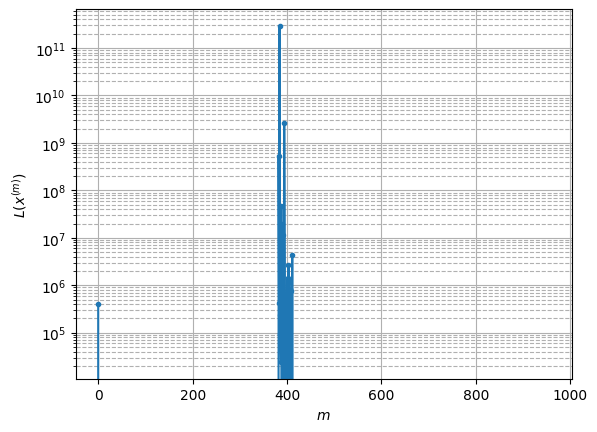

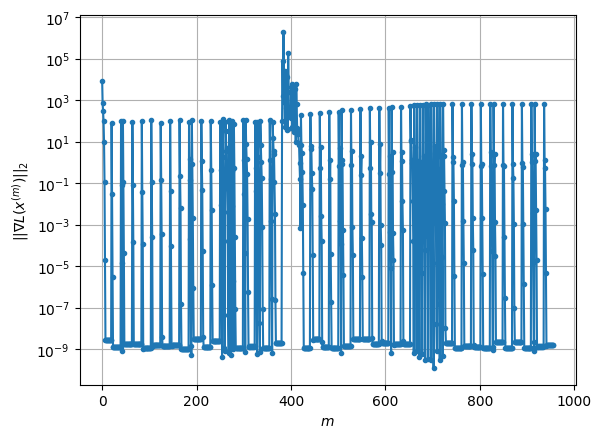

Windows:  17%|█▋        | 66/395 [00:39<03:37,  1.51it/s]

Before applying the algorithm
Cost function: -202749.44112613206
Gradient norm: 619.4346973178713
Global relative error: 193.6844403974006
Position relative errors: 1.0184243769549421 m, 20.183318059012855 m, 115.5071889176466 m, 154.1316766759182 m

Iteration 1
Cost function: -236349.9542263752 (-16.57%)
Gradient norm: 1.6973161661381089 (-99.73%)
Global relative error: 117.67060316492714 (-39.25%)
Position relative errors: 0.1989253959668487 m, 19.998086267006542 m, 41.35803337505532 m, 108.3011837862591 m

Iteration 2
Cost function: -236355.61760688416 (-0.00%)
Gradient norm: 2.9207002568598504 (72.08%)
Global relative error: 48.2970194328182 (-58.96%)
Position relative errors: 0.1989253959668487 m, 6.023829118750323 m, 12.58918925977219 m, 46.162905258723505 m

Iteration 3
Cost function: -236356.3208168883 (-0.00%)
Gradient norm: 0.0073345494181047445 (-99.75%)
Global relative error: 48.1286869631397 (-0.35%)
Position relative errors: 0.1989253959668487 m, 4.063174078161332 m, 15.3

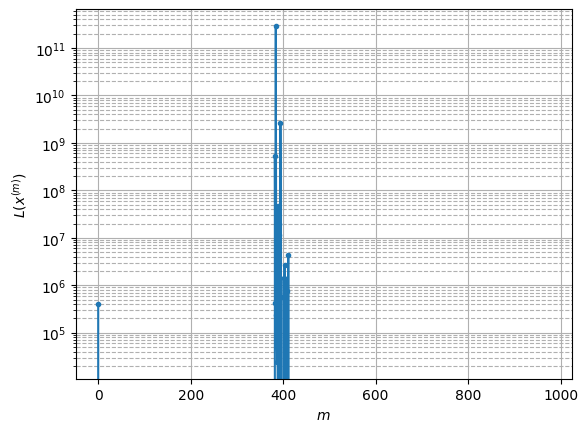

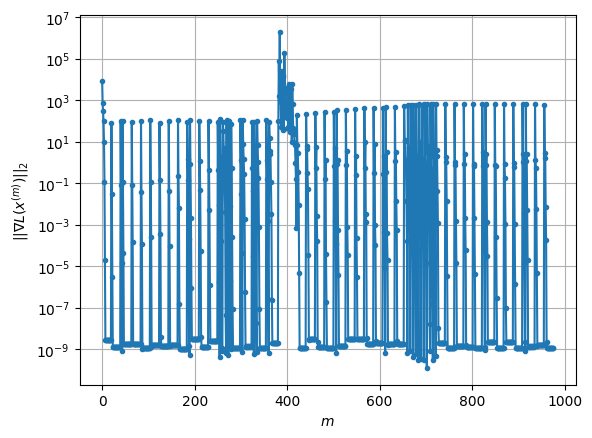

Windows:  17%|█▋        | 67/395 [00:39<03:48,  1.43it/s]

Before applying the algorithm
Cost function: -203983.5876932166
Gradient norm: 589.6319318634568
Global relative error: 148.48387766459345
Position relative errors: 1.0057936332245125 m, 16.8153215946523 m, 111.29046805735028 m, 96.80567092645575 m

Iteration 1
Cost function: -236353.20324257953 (-15.87%)
Gradient norm: 1.786780550279199 (-99.70%)
Global relative error: 27.896639309114576 (-81.21%)
Position relative errors: 0.19161920633171836 m, 3.7244993373142297 m, 3.6799106159775707 m, 27.276053016574057 m

Iteration 2
Cost function: -236354.6623592081 (-0.00%)
Gradient norm: 0.375397007250839 (-78.99%)
Global relative error: 76.4214116817316 (173.94%)
Position relative errors: 0.19161920633171836 m, 14.921990021107495 m, 10.599322846302549 m, 74.15116285881078 m

Iteration 3
Cost function: -236354.67893458664 (-0.00%)
Gradient norm: 0.0013686760659403915 (-99.64%)
Global relative error: 75.37411053718182 (-1.37%)
Position relative errors: 0.19161920633171836 m, 14.048696825750834 

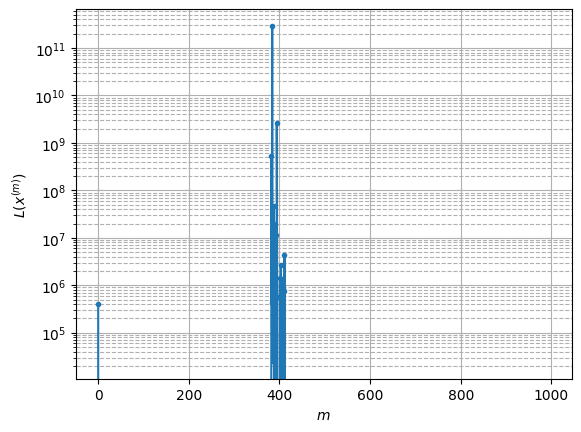

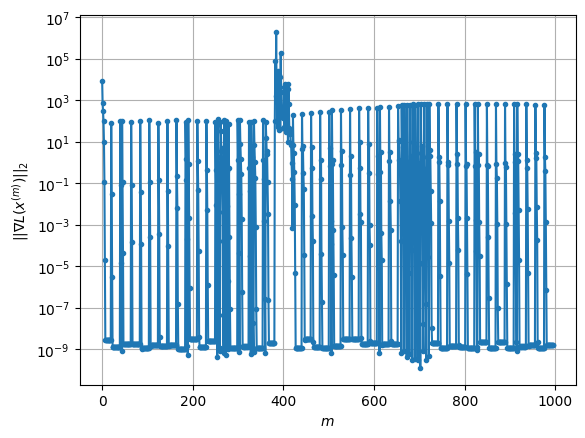

Windows:  17%|█▋        | 68/395 [00:40<03:55,  1.39it/s]

Before applying the algorithm
Cost function: -205011.25413305842
Gradient norm: 584.0563515155889
Global relative error: 166.88656672102888
Position relative errors: 0.9260764296352535 m, 22.020299625520696 m, 110.78885603788017 m, 122.81849358659045 m

Iteration 1
Cost function: -236354.13746490952 (-15.29%)
Gradient norm: 2.3555785687022857 (-99.60%)
Global relative error: 74.16162653434104 (-55.56%)
Position relative errors: 0.2099105085513198 m, 13.875553230211754 m, 9.32354663505135 m, 72.20541073061884 m

Iteration 2
Cost function: -236359.1388875785 (-0.00%)
Gradient norm: 1.9983086100406648 (-15.17%)
Global relative error: 50.73738831200562 (-31.59%)
Position relative errors: 0.2099105085513198 m, 14.530255319803736 m, 24.859453003513696 m, 41.69287513819774 m

Iteration 3
Cost function: -236359.54850452172 (-0.00%)
Gradient norm: 0.014013687337801199 (-99.30%)
Global relative error: 42.89183588222216 (-15.46%)
Position relative errors: 0.2099105085513198 m, 11.704345926191586 

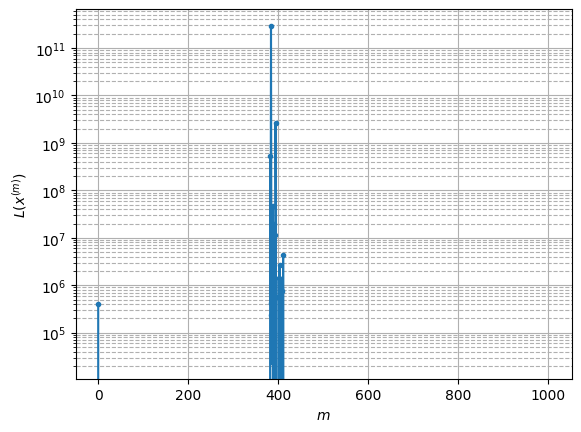

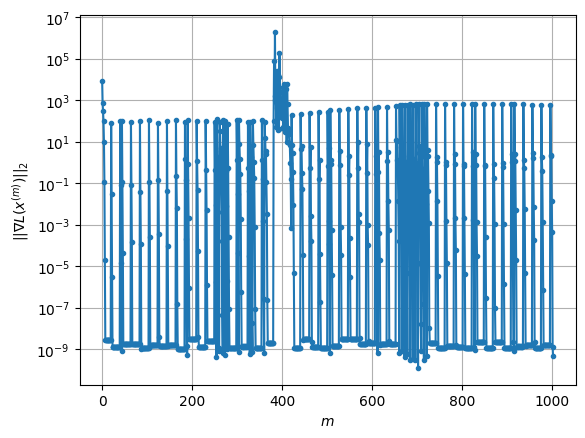

Windows:  17%|█▋        | 69/395 [00:41<03:51,  1.41it/s]

Before applying the algorithm
Cost function: -205468.41380951603
Gradient norm: 564.3347956131612
Global relative error: 174.8747151387154
Position relative errors: 1.2029344018268384 m, 13.540416477953425 m, 116.01697574231153 m, 130.11373030568157 m

Iteration 1
Cost function: -236351.42076111058 (-15.03%)
Gradient norm: 2.7630607598127344 (-99.51%)
Global relative error: 81.98349480043866 (-53.12%)
Position relative errors: 0.1043796922318451 m, 20.826897099556625 m, 30.188203936590245 m, 73.27578477257772 m

Iteration 2
Cost function: -236362.17515707 (-0.00%)
Gradient norm: 3.219032025577509 (16.50%)
Global relative error: 93.2998264841451 (13.80%)
Position relative errors: 0.1043796922318451 m, 21.408569104193234 m, 49.019330252122764 m, 76.39876024237665 m

Iteration 3
Cost function: -236363.1135787614 (-0.00%)
Gradient norm: 0.023980270278123057 (-99.26%)
Global relative error: 97.26987098695749 (4.26%)
Position relative errors: 0.1043796922318451 m, 20.650600182367164 m, 49.56

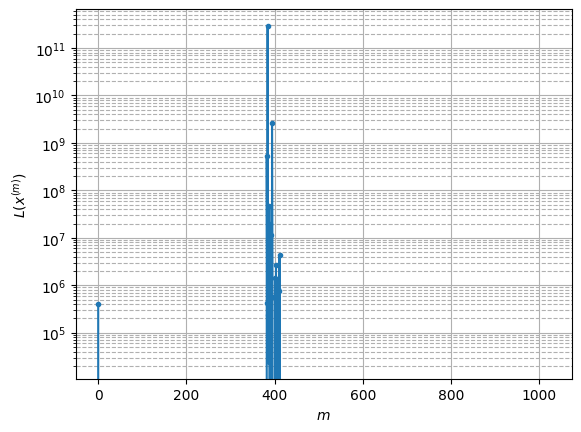

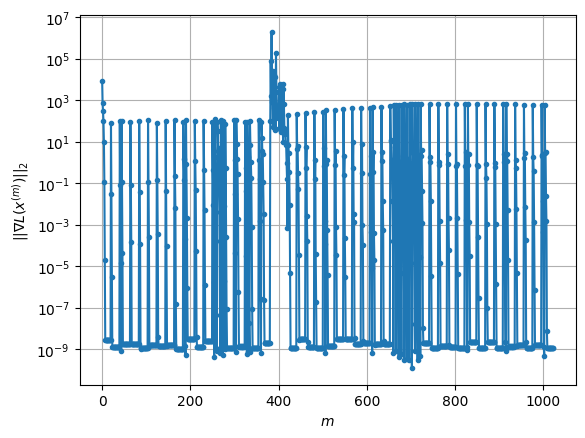

Windows:  18%|█▊        | 70/395 [00:42<03:58,  1.36it/s]

Before applying the algorithm
Cost function: -206781.47382297367
Gradient norm: 546.0841051954608
Global relative error: 142.47713075900643
Position relative errors: 0.9943638360711702 m, 34.61262111606244 m, 117.97334898758031 m, 71.94559803741981 m

Iteration 1
Cost function: -236348.63354653495 (-14.30%)
Gradient norm: 3.0111970517557034 (-99.45%)
Global relative error: 81.60786839466576 (-42.72%)
Position relative errors: 0.058431279967562276 m, 17.303203609134183 m, 53.37129364182917 m, 59.20400821326263 m

Iteration 2
Cost function: -236357.94476121714 (-0.00%)
Gradient norm: 2.3335899900414634 (-22.50%)
Global relative error: 75.68682637572847 (-7.26%)
Position relative errors: 0.058431279967562276 m, 11.19626188877115 m, 24.36587419337437 m, 70.72912996832964 m

Iteration 3
Cost function: -236358.42863711674 (-0.00%)
Gradient norm: 0.01908444337868519 (-99.18%)
Global relative error: 82.73001833441025 (9.31%)
Position relative errors: 0.058431279967562276 m, 12.820967967268121 

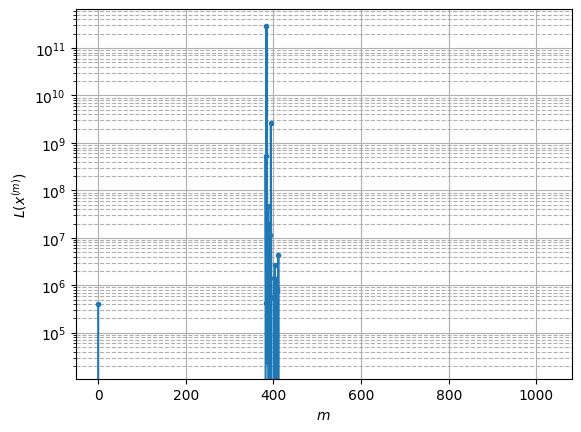

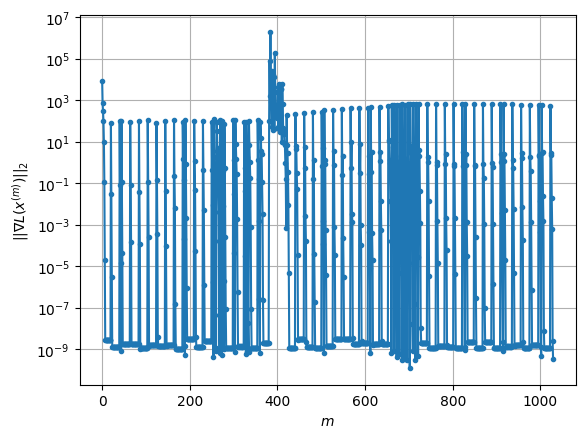

Windows:  18%|█▊        | 71/395 [00:42<03:51,  1.40it/s]

Before applying the algorithm
Cost function: -209613.2788350853
Gradient norm: 507.63071520617774
Global relative error: 211.17698065957586
Position relative errors: 1.0303186844391823 m, 4.809165958985127 m, 116.30059158904847 m, 176.17830416437846 m

Iteration 1
Cost function: -236338.54784504898 (-12.75%)
Gradient norm: 3.424285520940963 (-99.33%)
Global relative error: 116.66077791749431 (-44.76%)
Position relative errors: 0.1409310735805307 m, 18.792879703588678 m, 35.99286167340815 m, 109.33505274736632 m

Iteration 2
Cost function: -236354.07085753395 (-0.01%)
Gradient norm: 6.781052393140576 (98.03%)
Global relative error: 107.5755277757165 (-7.79%)
Position relative errors: 0.1409310735805307 m, 17.504405510601387 m, 34.403482282329335 m, 100.37711614079629 m

Iteration 3
Cost function: -236357.57417207575 (-0.00%)
Gradient norm: 0.012022944553459874 (-99.82%)
Global relative error: 114.25486713685895 (6.21%)
Position relative errors: 0.1409310735805307 m, 18.00199078099749 m,

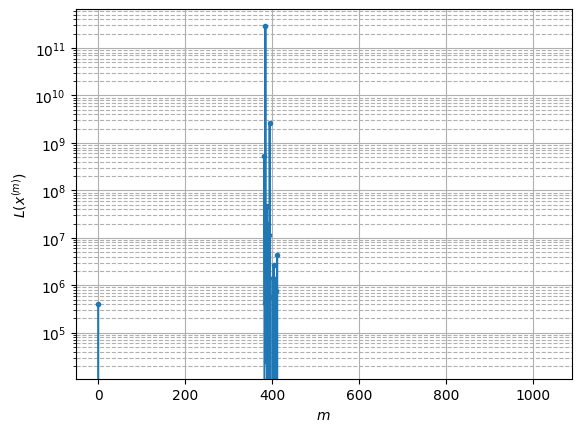

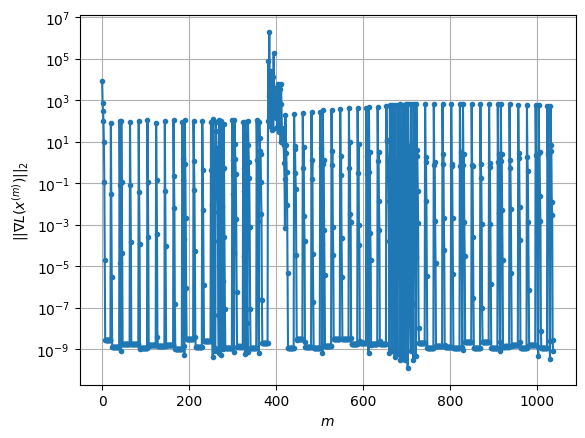

Windows:  18%|█▊        | 72/395 [00:43<03:43,  1.44it/s]

Before applying the algorithm
Cost function: -209419.95064424005
Gradient norm: 505.211788899278
Global relative error: 143.71407230564674
Position relative errors: 1.0806667541936084 m, 31.022791697956887 m, 119.68805983204484 m, 73.1985561838922 m

Iteration 1
Cost function: -236352.86292710973 (-12.86%)
Gradient norm: 4.0062404210078535 (-99.21%)
Global relative error: 99.49782620981107 (-30.77%)
Position relative errors: 0.03808619213743796 m, 22.960685774996932 m, 21.54569157266343 m, 94.34783099668267 m

Iteration 2
Cost function: -236359.869918167 (-0.00%)
Gradient norm: 0.8537947452767467 (-78.69%)
Global relative error: 54.16636788874039 (-45.56%)
Position relative errors: 0.03808619213743796 m, 15.20637321865177 m, 10.809770618350864 m, 50.78401513148984 m

Iteration 3
Cost function: -236359.9348313079 (-0.00%)
Gradient norm: 0.003910621162096043 (-99.54%)
Global relative error: 53.19317654678985 (-1.80%)
Position relative errors: 0.03808619213743796 m, 14.82925782233756 m, 1

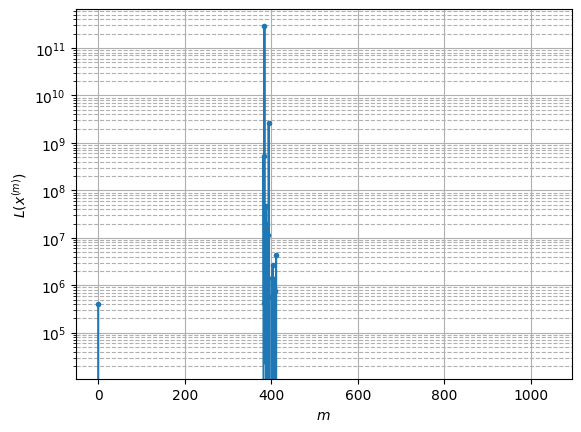

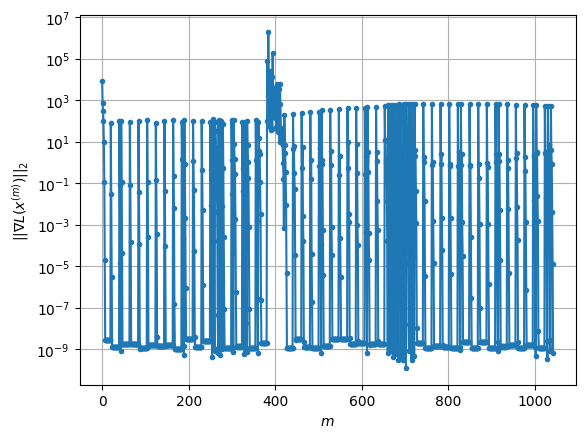

Windows:  18%|█▊        | 73/395 [00:44<03:51,  1.39it/s]

Before applying the algorithm
Cost function: -212233.1719548299
Gradient norm: 470.3227518167203
Global relative error: 165.2221719638151
Position relative errors: 1.0201365565948963 m, 19.531018691464777 m, 113.39136941557199 m, 118.53833569550018 m

Iteration 1
Cost function: -236350.59560421642 (-11.36%)
Gradient norm: 4.127881164436343 (-99.12%)
Global relative error: 65.87312937403675 (-60.13%)
Position relative errors: 0.13882619855821798 m, 14.211453558443752 m, 11.484960460465937 m, 63.23333867882258 m

Iteration 2
Cost function: -236358.57108175228 (-0.00%)
Gradient norm: 2.0925068622518106 (-49.31%)
Global relative error: 65.35437389075246 (-0.79%)
Position relative errors: 0.13882619855821798 m, 18.38061593699869 m, 11.127902931382257 m, 61.66500301421324 m

Iteration 3
Cost function: -236358.9637250615 (-0.00%)
Gradient norm: 0.013266498012549888 (-99.37%)
Global relative error: 69.56994293172592 (6.45%)
Position relative errors: 0.13882619855821798 m, 17.39301350685125 m, 

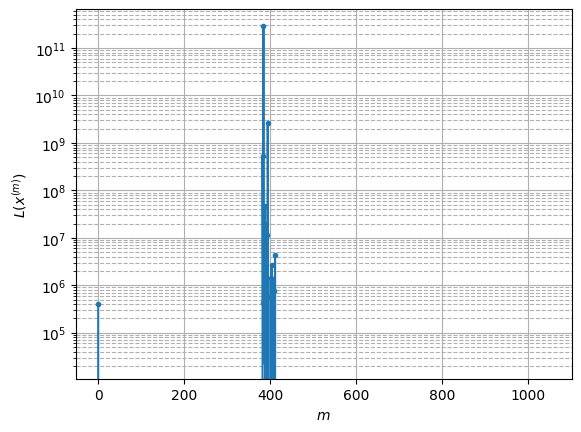

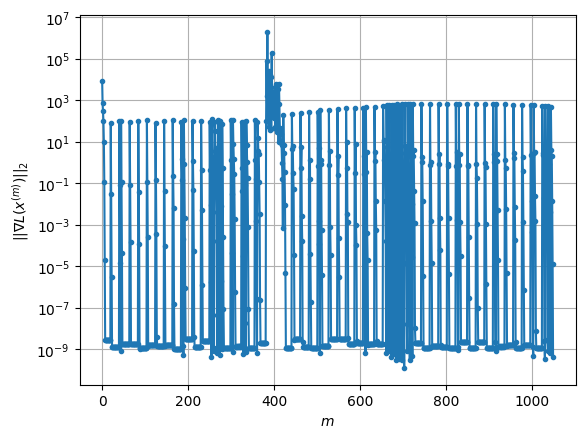

Windows:  19%|█▊        | 74/395 [00:44<03:41,  1.45it/s]

Before applying the algorithm
Cost function: -213456.32318163343
Gradient norm: 443.3559286392938
Global relative error: 181.5059334145627
Position relative errors: 1.0919664910683646 m, 18.721614916148027 m, 116.17108736220816 m, 138.16653699715454 m

Iteration 1
Cost function: -236346.7091789472 (-10.72%)
Gradient norm: 4.761492980005398 (-98.93%)
Global relative error: 51.069890091318854 (-71.86%)
Position relative errors: 0.16342275683446186 m, 7.905913369163768 m, 11.14636552050555 m, 49.136167049566055 m

Iteration 2
Cost function: -236356.55360923082 (-0.00%)
Gradient norm: 0.1449940326966598 (-96.95%)
Global relative error: 51.84730183241746 (1.52%)
Position relative errors: 0.16342275683446186 m, 10.619237092644157 m, 16.291855460406968 m, 47.98879166461819 m

Iteration 3
Cost function: -236356.58849683552 (-0.00%)
Gradient norm: 0.012418874802303368 (-91.43%)
Global relative error: 47.19528215096871 (-8.97%)
Position relative errors: 0.16342275683446186 m, 10.13091065576367 m

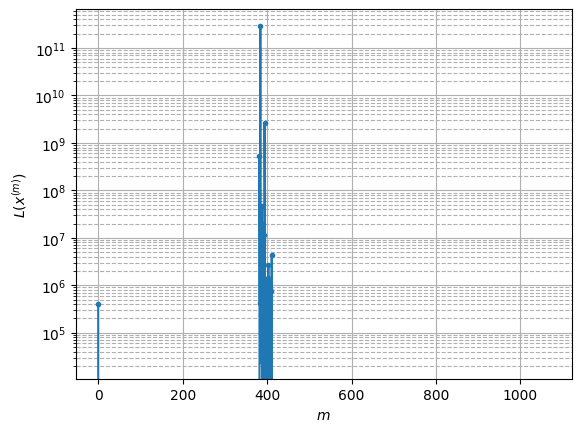

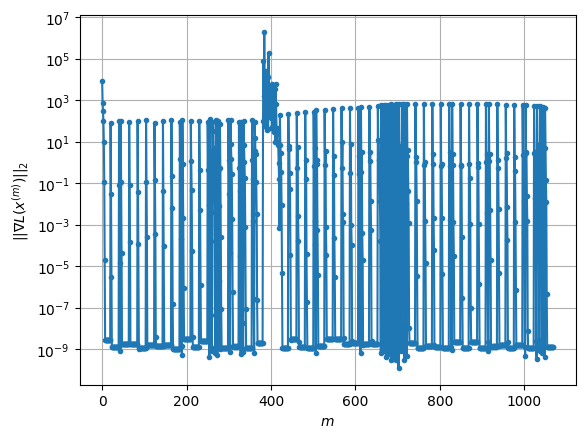

Windows:  19%|█▉        | 75/395 [00:45<03:42,  1.44it/s]

Before applying the algorithm
Cost function: -215393.07935627637
Gradient norm: 424.57422497667676
Global relative error: 176.6302374163558
Position relative errors: 1.0181958515342888 m, 18.479935534564508 m, 110.30580087856289 m, 136.6794213435389 m

Iteration 1
Cost function: -236340.25484487673 (-9.73%)
Gradient norm: 4.775673642351311 (-98.88%)
Global relative error: 46.78786346621024 (-73.51%)
Position relative errors: 0.2064632671480297 m, 9.38707209005205 m, 32.33119621887223 m, 32.38172425838873 m

Iteration 2
Cost function: -236354.44363346556 (-0.01%)
Gradient norm: 1.724008520689523 (-63.90%)
Global relative error: 32.34642492270368 (-30.87%)
Position relative errors: 0.2064632671480297 m, 10.527539192035942 m, 27.95733581653812 m, 12.113825467712962 m

Iteration 3
Cost function: -236354.87312723955 (-0.00%)
Gradient norm: 0.05964208712162207 (-96.54%)
Global relative error: 47.011545155194376 (45.34%)
Position relative errors: 0.2064632671480297 m, 10.137688506775904 m, 36

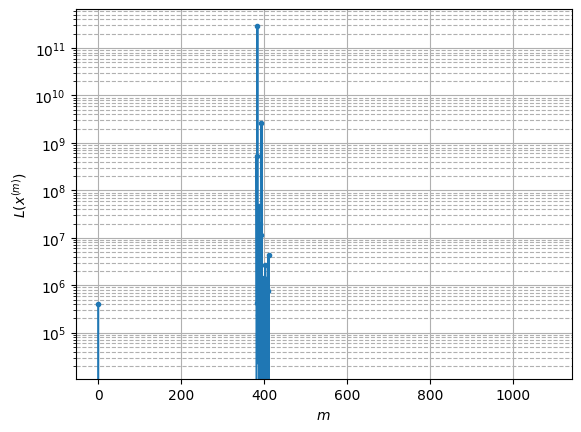

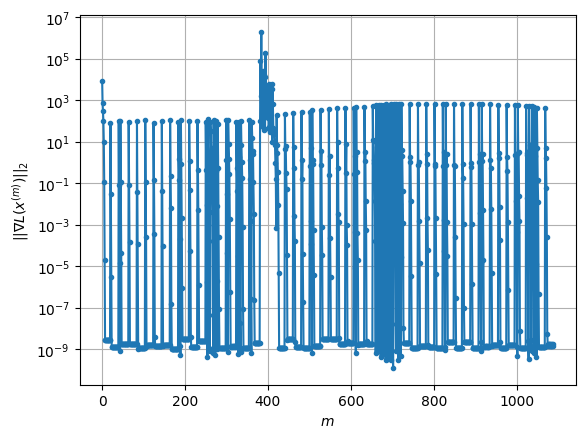

Windows:  19%|█▉        | 76/395 [00:46<03:42,  1.43it/s]

Before applying the algorithm
Cost function: -216113.78439294375
Gradient norm: 416.2937960446366
Global relative error: 157.66223511370265
Position relative errors: 1.040207025807977 m, 13.781429959225237 m, 123.93755234125743 m, 96.42992929568281 m

Iteration 1
Cost function: -236338.56763329828 (-9.36%)
Gradient norm: 5.0725435231423 (-98.78%)
Global relative error: 42.57889898799587 (-72.99%)
Position relative errors: 0.16591518326107504 m, 19.83548833173969 m, 24.22653977990575 m, 28.730487113124326 m

Iteration 2
Cost function: -236351.07226580544 (-0.01%)
Gradient norm: 0.4789181280391831 (-90.56%)
Global relative error: 26.880136389117666 (-36.87%)
Position relative errors: 0.16591518326107504 m, 5.369989226055882 m, 6.881157184365311 m, 25.282497930526038 m

Iteration 3
Cost function: -236351.16688019133 (-0.00%)
Gradient norm: 0.026175248343377953 (-94.53%)
Global relative error: 15.982372515673413 (-40.54%)
Position relative errors: 0.16591518326107504 m, 5.718793657525417 m

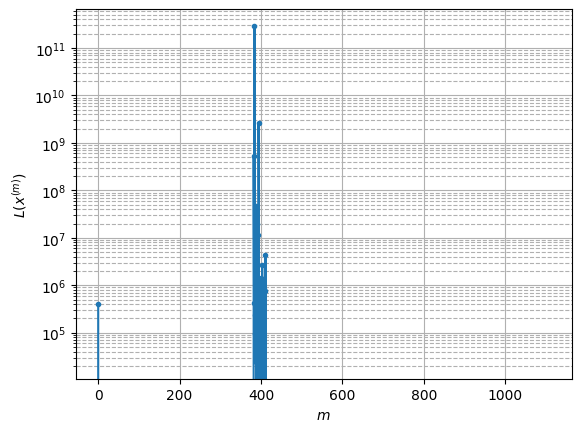

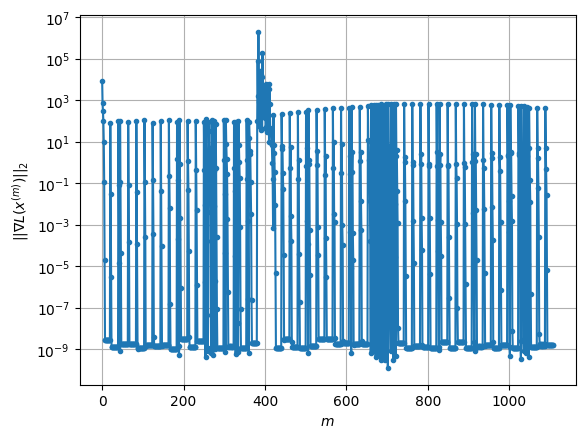

Windows:  19%|█▉        | 77/395 [00:47<03:47,  1.40it/s]

Before applying the algorithm
Cost function: -217741.34763827611
Gradient norm: 389.91808401847004
Global relative error: 154.93246800649396
Position relative errors: 0.879252894344157 m, 19.3829985547528 m, 114.26765985442387 m, 102.77803072241986 m

Iteration 1
Cost function: -236339.68481478133 (-8.54%)
Gradient norm: 5.4245448223908745 (-98.61%)
Global relative error: 41.34690220845017 (-73.31%)
Position relative errors: 0.2720235762076225 m, 12.413606133906566 m, 23.557439023723944 m, 31.516147268223932 m

Iteration 2
Cost function: -236354.31871878792 (-0.01%)
Gradient norm: 0.329946047177539 (-93.92%)
Global relative error: 77.57460392115136 (87.62%)
Position relative errors: 0.2720235762076225 m, 20.88595275947222 m, 26.12212926661115 m, 69.94270712828134 m

Iteration 3
Cost function: -236354.3471898038 (-0.00%)
Gradient norm: 0.007082970331310387 (-97.85%)
Global relative error: 84.43262164672134 (8.84%)
Position relative errors: 0.2720235762076225 m, 22.86298757132717 m, 28.3

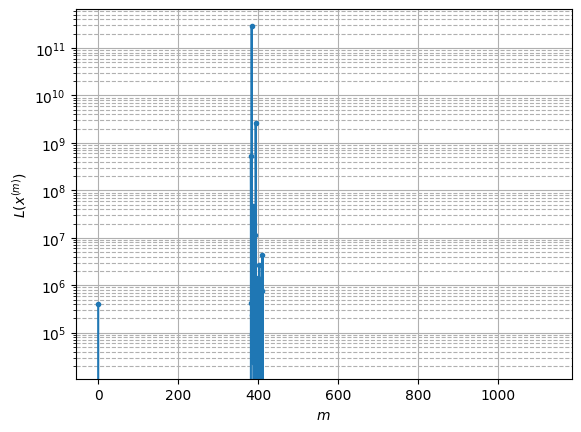

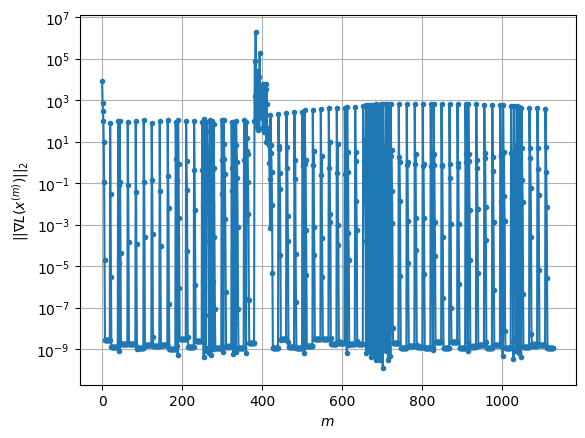

Windows:  20%|█▉        | 78/395 [00:47<03:34,  1.47it/s]

Before applying the algorithm
Cost function: -218773.70133420092
Gradient norm: 391.7399091699692
Global relative error: 137.0839897242106
Position relative errors: 0.9624484192853707 m, 37.46530248009818 m, 122.64818509340371 m, 48.34949746486502 m

Iteration 1
Cost function: -236343.71550847753 (-8.03%)
Gradient norm: 5.274344075064331 (-98.65%)
Global relative error: 124.58893795081559 (-9.11%)
Position relative errors: 0.15968930898556657 m, 34.6891843914463 m, 43.06076640007767 m, 111.61368649193214 m

Iteration 2
Cost function: -236359.64886051652 (-0.01%)
Gradient norm: 1.116565519533513 (-78.83%)
Global relative error: 45.29573506108516 (-63.64%)
Position relative errors: 0.15968930898556657 m, 9.601056648802933 m, 13.752567343830108 m, 41.9901284436816 m

Iteration 3
Cost function: -236359.85565049225 (-0.00%)
Gradient norm: 0.0342404232374262 (-96.93%)
Global relative error: 32.11820529498291 (-29.09%)
Position relative errors: 0.15968930898556657 m, 5.010123203721494 m, 14.3

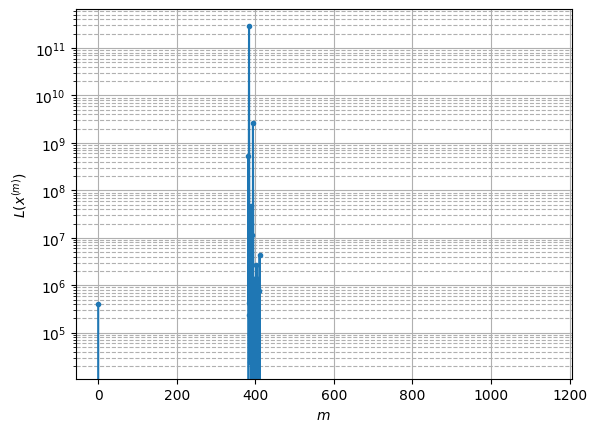

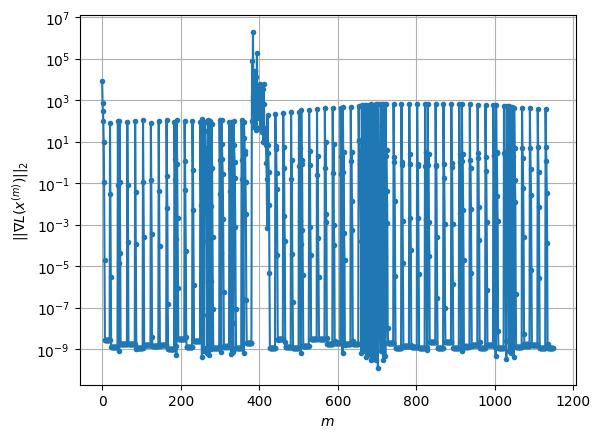

Windows:  20%|██        | 79/395 [00:48<03:43,  1.41it/s]

Before applying the algorithm
Cost function: -219422.17067074566
Gradient norm: 391.6916574055448
Global relative error: 150.9843825553442
Position relative errors: 0.9756163534930996 m, 19.559263557966386 m, 119.64320135795131 m, 89.9501496516872 m

Iteration 1
Cost function: -236331.66867613723 (-7.71%)
Gradient norm: 5.8126691453418 (-98.52%)
Global relative error: 94.7024074616996 (-37.28%)
Position relative errors: 0.1525033123333965 m, 35.37905215900597 m, 23.91381846872422 m, 84.4851026659589 m

Iteration 2
Cost function: -236350.7805768599 (-0.01%)
Gradient norm: 0.41387355256857583 (-92.88%)
Global relative error: 40.76559701364691 (-56.95%)
Position relative errors: 0.1525033123333965 m, 14.765938740280726 m, 13.211248197069791 m, 35.524618406583244 m

Iteration 3
Cost function: -236350.83528997508 (-0.00%)
Gradient norm: 0.014868646465896602 (-96.41%)
Global relative error: 31.86120893766409 (-21.84%)
Position relative errors: 0.1525033123333965 m, 12.03907472761636 m, 11.25

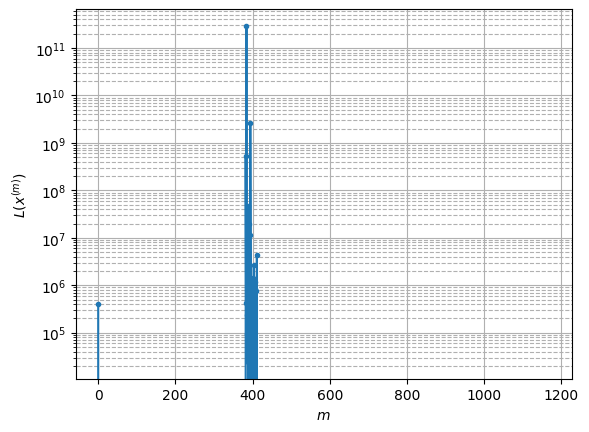

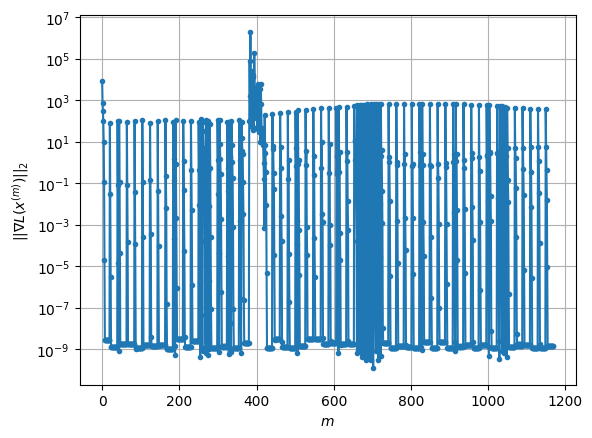

Windows:  20%|██        | 80/395 [00:49<03:32,  1.48it/s]

Before applying the algorithm
Cost function: -220304.1623523283
Gradient norm: 373.17494463418126
Global relative error: 147.9634752302822
Position relative errors: 0.8817079933770514 m, 26.88395790944544 m, 117.23483199194979 m, 86.12998099202876 m

Iteration 1
Cost function: -236328.7494151141 (-7.27%)
Gradient norm: 6.403164296167643 (-98.28%)
Global relative error: 117.46651551552942 (-20.61%)
Position relative errors: 0.19430668897045345 m, 40.48419923688018 m, 40.746018296661596 m, 102.4297328654891 m

Iteration 2
Cost function: -236353.64625424857 (-0.01%)
Gradient norm: 1.6322148932992324 (-74.51%)
Global relative error: 35.021424018221495 (-70.19%)
Position relative errors: 0.19430668897045345 m, 4.729290310248747 m, 18.557589552784137 m, 29.196337541453456 m

Iteration 3
Cost function: -236354.57287434043 (-0.00%)
Gradient norm: 0.2074157349764839 (-87.29%)
Global relative error: 62.741135493896664 (79.15%)
Position relative errors: 0.19430668897045345 m, 9.2256652566294 m, 3

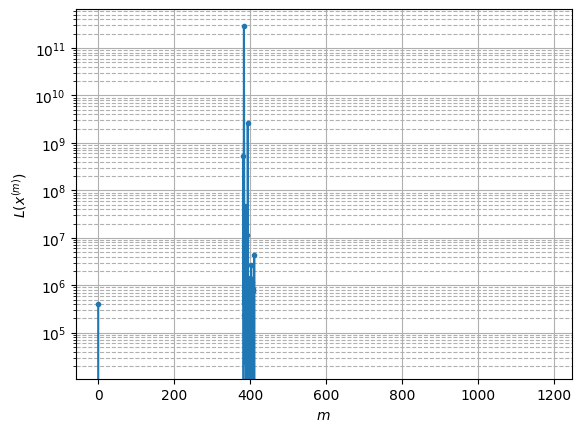

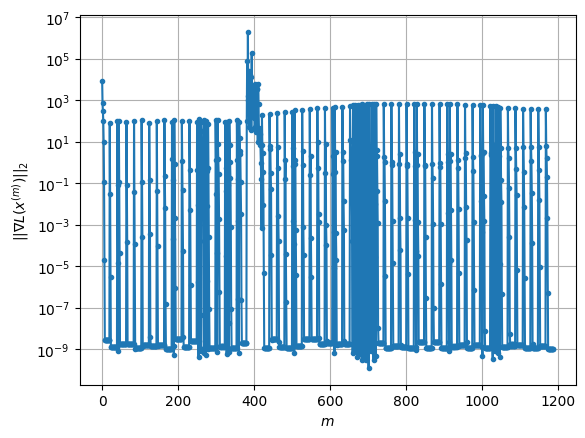

Windows:  21%|██        | 81/395 [00:49<03:38,  1.44it/s]

Before applying the algorithm
Cost function: -220830.16634682304
Gradient norm: 371.7564082369212
Global relative error: 170.52815502918787
Position relative errors: 1.0633645914238024 m, 8.61268644704381 m, 121.83813392655233 m, 118.96494895905141 m

Iteration 1
Cost function: -236336.47786929243 (-7.02%)
Gradient norm: 7.034005939215989 (-98.11%)
Global relative error: 100.1350373444882 (-41.28%)
Position relative errors: 0.17993305590313738 m, 22.479393084223016 m, 33.21228037283636 m, 91.71293289958292 m

Iteration 2
Cost function: -236356.78998990668 (-0.01%)
Gradient norm: 1.581517976873174 (-77.52%)
Global relative error: 13.89901999369332 (-86.12%)
Position relative errors: 0.17993305590313738 m, 3.0409870189353594 m, 6.690297495939114 m, 11.479987465665621 m

Iteration 3
Cost function: -236357.61604777427 (-0.00%)
Gradient norm: 0.21035806865753612 (-86.70%)
Global relative error: 23.225394572919193 (67.10%)
Position relative errors: 0.17993305590313738 m, 4.422798972921792 m,

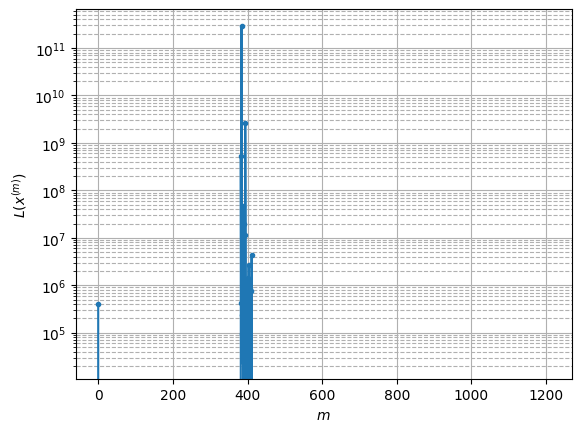

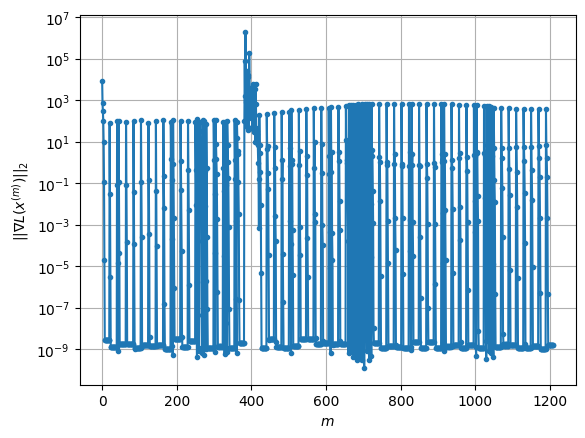

Windows:  21%|██        | 82/395 [00:50<03:41,  1.41it/s]

Before applying the algorithm
Cost function: -220947.46989611347
Gradient norm: 389.1265610425127
Global relative error: 173.8410222904915
Position relative errors: 1.1616940037127332 m, 14.541264378260314 m, 116.31549942962363 m, 128.3401765864397 m

Iteration 1
Cost function: -236344.02287661773 (-6.97%)
Gradient norm: 7.517028528550315 (-98.07%)
Global relative error: 108.96731701513842 (-37.32%)
Position relative errors: 0.21332353381213762 m, 40.34250298419449 m, 34.92608550519121 m, 94.96881003927966 m

Iteration 2
Cost function: -236357.29311985054 (-0.01%)
Gradient norm: 0.5607290916479211 (-92.54%)
Global relative error: 47.58976318340829 (-56.33%)
Position relative errors: 0.21332353381213762 m, 19.875122378101764 m, 13.030351479672115 m, 41.140280859145186 m

Iteration 3
Cost function: -236357.49950323493 (-0.00%)
Gradient norm: 0.06100943217037435 (-89.12%)
Global relative error: 29.288098343180025 (-38.46%)
Position relative errors: 0.21332353381213762 m, 14.35077749140352

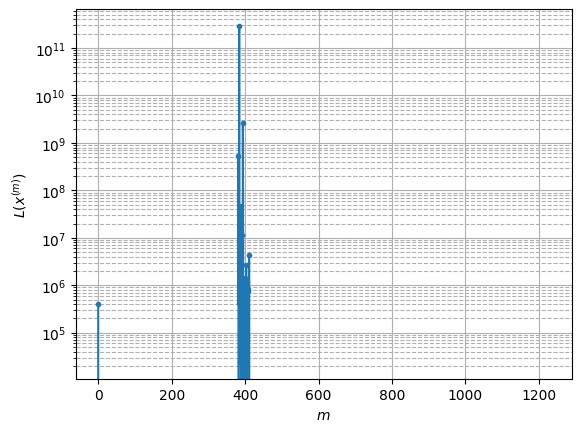

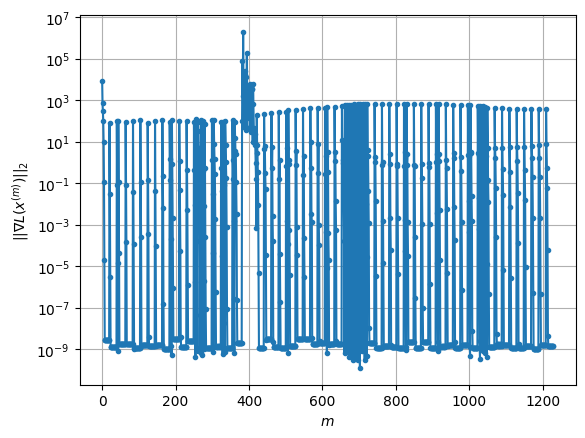

Windows:  21%|██        | 83/395 [00:51<03:42,  1.40it/s]

Before applying the algorithm
Cost function: -221399.0481414632
Gradient norm: 384.05496261869513
Global relative error: 155.48822619178776
Position relative errors: 0.8609840906809552 m, 28.039804710476304 m, 120.2653035538446 m, 94.43739860539401 m

Iteration 1
Cost function: -236325.13898752685 (-6.74%)
Gradient norm: 9.162231879309182 (-97.61%)
Global relative error: 155.1948959173771 (-0.19%)
Position relative errors: 0.25735913347200795 m, 57.519646801073876 m, 56.65406703589736 m, 132.5131893701289 m

Iteration 2
Cost function: -236348.1819925689 (-0.01%)
Gradient norm: 2.5190091813310604 (-72.51%)
Global relative error: 52.54753559986489 (-66.14%)
Position relative errors: 0.25735913347200795 m, 21.150047740619378 m, 16.145877501874644 m, 45.22955157802717 m

Iteration 3
Cost function: -236349.63492000834 (-0.00%)
Gradient norm: 0.2906901286961538 (-88.46%)
Global relative error: 47.595126129251994 (-9.42%)
Position relative errors: 0.25735913347200795 m, 11.413909887612776 m, 

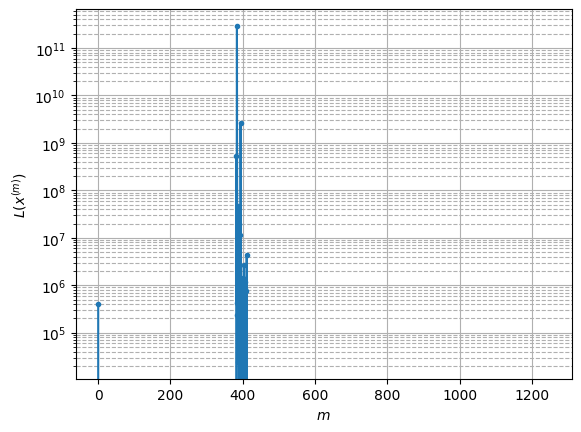

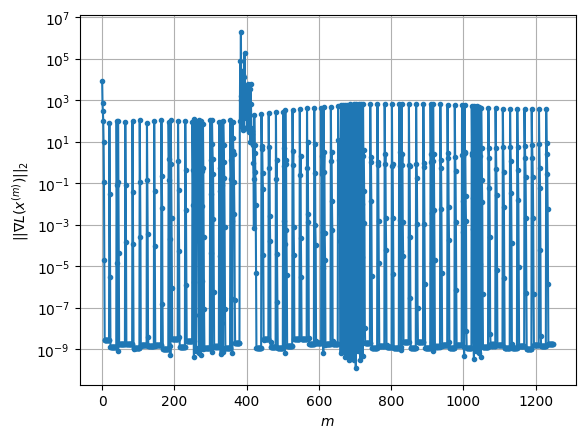

Windows:  21%|██▏       | 84/395 [00:51<03:36,  1.44it/s]

Before applying the algorithm
Cost function: -221128.03567590617
Gradient norm: 379.38328636205273
Global relative error: 176.48719215079626
Position relative errors: 0.9974042044153077 m, 24.047776851235135 m, 117.72129875912083 m, 129.23869548768243 m

Iteration 1
Cost function: -236322.26198492723 (-6.87%)
Gradient norm: 11.586955863086686 (-96.95%)
Global relative error: 187.4253202731304 (6.20%)
Position relative errors: 0.22917104805801203 m, 73.24582399220974 m, 67.74712397201857 m, 158.63820664515916 m

Iteration 2
Cost function: -236355.20699210887 (-0.01%)
Gradient norm: 3.9094652837721204 (-66.26%)
Global relative error: 54.0234111287014 (-71.18%)
Position relative errors: 0.22917104805801203 m, 21.021024711509067 m, 6.388450899288508 m, 49.277648402198814 m

Iteration 3
Cost function: -236358.38850303518 (-0.00%)
Gradient norm: 0.5214176024210287 (-86.66%)
Global relative error: 35.29934144231875 (-34.66%)
Position relative errors: 0.22917104805801203 m, 15.111115367274138 

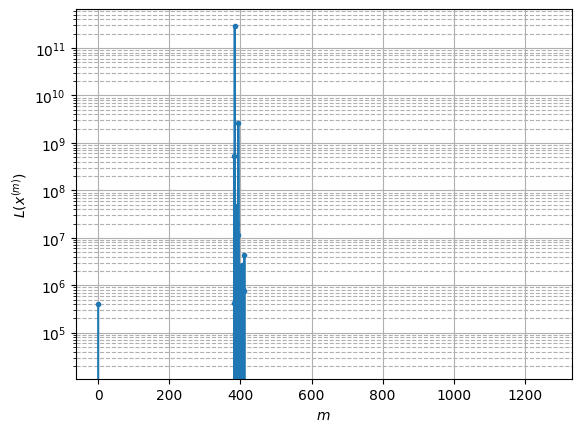

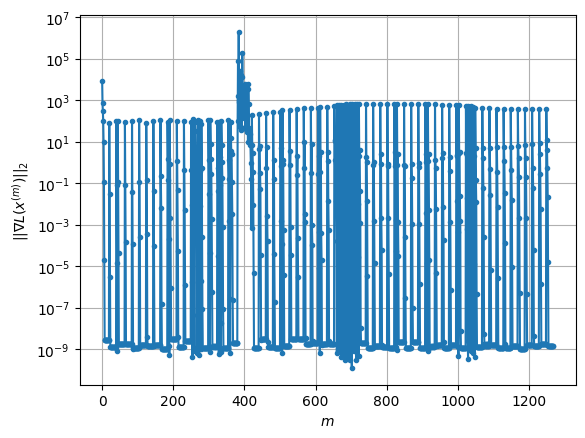

Windows:  22%|██▏       | 85/395 [00:52<03:41,  1.40it/s]

Before applying the algorithm
Cost function: -220611.19442727833
Gradient norm: 410.89927819580146
Global relative error: 181.47832894875498
Position relative errors: 1.1279046863984972 m, 13.115366125378518 m, 111.3045412957948 m, 142.7054915537429 m

Iteration 1
Cost function: -236334.77313115617 (-7.13%)
Gradient norm: 10.619031709640065 (-97.42%)
Global relative error: 132.09042258177658 (-27.21%)
Position relative errors: 0.16850186656029362 m, 51.42869840400078 m, 47.56503380137661 m, 111.95073575958303 m

Iteration 2
Cost function: -236354.32261215482 (-0.01%)
Gradient norm: 2.1011468285411197 (-80.21%)
Global relative error: 37.271971381161606 (-71.78%)
Position relative errors: 0.16850186656029362 m, 12.426969751492656 m, 16.108285237869925 m, 31.108268667099995 m

Iteration 3
Cost function: -236355.63279445053 (-0.00%)
Gradient norm: 0.2912068420240215 (-86.14%)
Global relative error: 23.034218966671567 (-38.20%)
Position relative errors: 0.16850186656029362 m, 3.022549424609

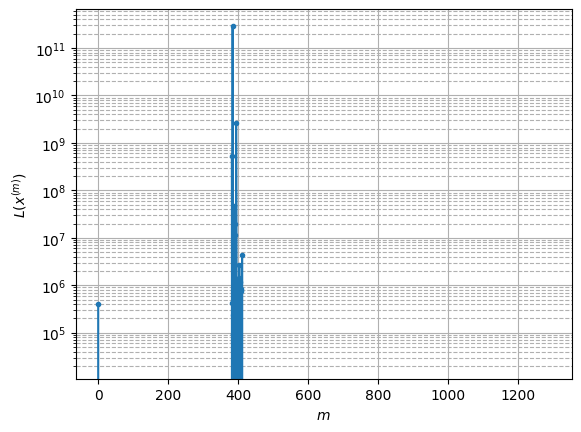

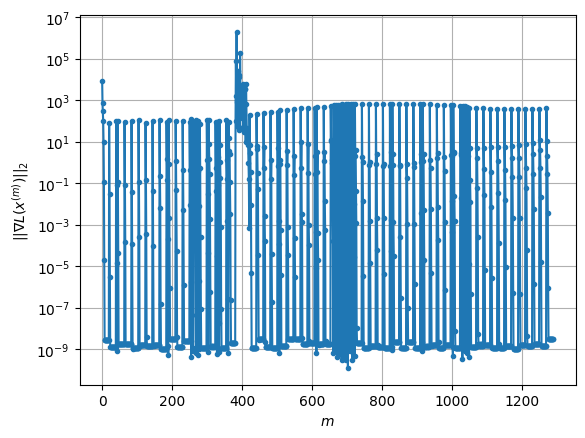

Windows:  22%|██▏       | 86/395 [00:53<03:34,  1.44it/s]

Before applying the algorithm
Cost function: -220167.761335438
Gradient norm: 411.6260967613309
Global relative error: 175.42353033334746
Position relative errors: 0.9773213411761691 m, 13.950487172527174 m, 117.04238210476969 m, 129.88973444428095 m

Iteration 1
Cost function: -236317.45207696606 (-7.34%)
Gradient norm: 12.73801516509073 (-96.91%)
Global relative error: 167.5878455763522 (-4.47%)
Position relative errors: 0.23596766282401502 m, 80.43973095479888 m, 64.19631925358348 m, 132.23589210158323 m

Iteration 2
Cost function: -236348.67306166812 (-0.01%)
Gradient norm: 2.2922372404684515 (-82.00%)
Global relative error: 79.25055670537232 (-52.71%)
Position relative errors: 0.23596766282401502 m, 40.41641562506676 m, 39.2091879119591 m, 55.69709656871447 m

Iteration 3
Cost function: -236350.50704990965 (-0.00%)
Gradient norm: 0.41867495017052825 (-81.74%)
Global relative error: 52.34338895261242 (-33.95%)
Position relative errors: 0.23596766282401502 m, 29.191584438767688 m, 3

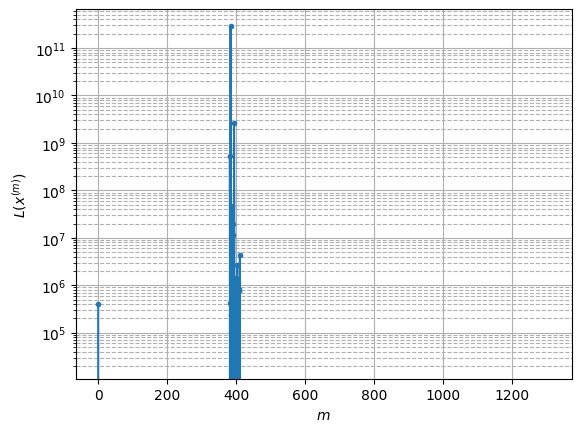

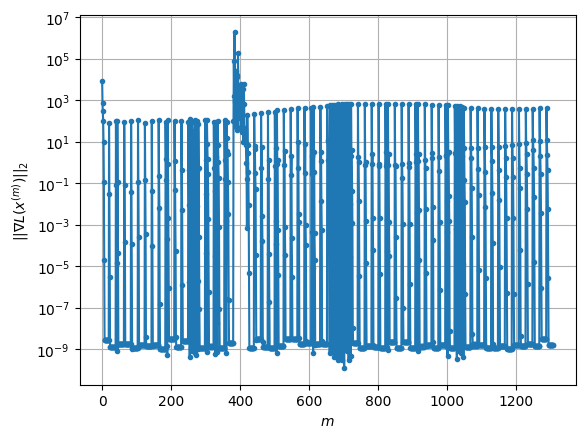

Windows:  22%|██▏       | 87/395 [00:54<03:44,  1.37it/s]

Before applying the algorithm
Cost function: -220069.69917792344
Gradient norm: 435.89484410910893
Global relative error: 165.3148093913095
Position relative errors: 1.1336819781186784 m, 40.513089275439604 m, 126.69588872581716 m, 98.11694079185858 m

Iteration 1
Cost function: -236303.8200308806 (-7.38%)
Gradient norm: 11.536593176601611 (-97.35%)
Global relative error: 191.83149765106194 (16.04%)
Position relative errors: 0.10343626951464621 m, 101.22295124677831 m, 93.02290155049529 m, 133.7623207176323 m

Iteration 2
Cost function: -236353.47884145073 (-0.02%)
Gradient norm: 6.700476227789929 (-41.92%)
Global relative error: 31.554625269809506 (-83.55%)
Position relative errors: 0.10343626951464621 m, 9.661876973447153 m, 18.4304061908412 m, 23.559364626551577 m

Iteration 3
Cost function: -236358.7744799693 (-0.00%)
Gradient norm: 0.3703129436454128 (-94.47%)
Global relative error: 10.630714771063753 (-66.31%)
Position relative errors: 0.10343626951464621 m, 4.962962463114242 m, 

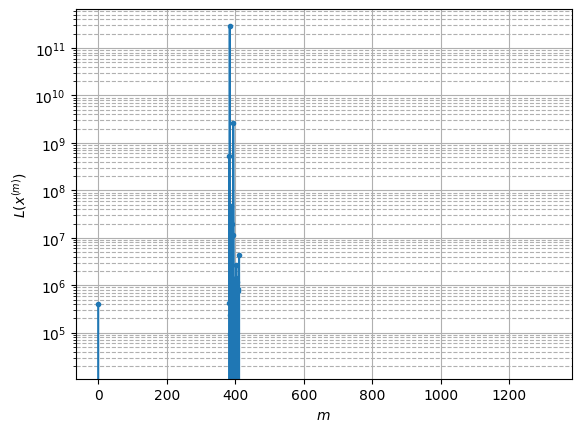

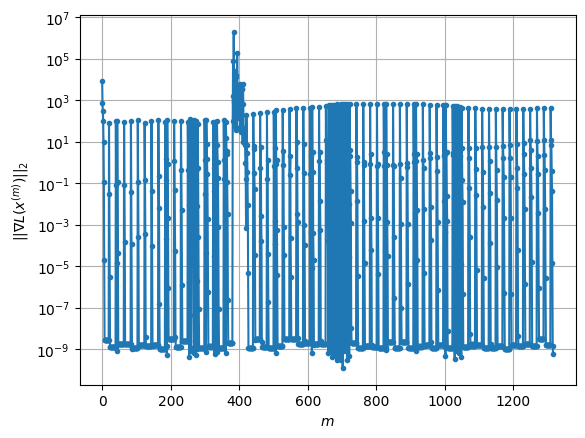

Windows:  22%|██▏       | 88/395 [00:54<03:28,  1.47it/s]

Before applying the algorithm
Cost function: -218239.61057612603
Gradient norm: 469.94783362478637
Global relative error: 175.1936083693817
Position relative errors: 1.032517885829244 m, 14.005501660960363 m, 115.42021003289423 m, 131.01951907545114 m

Iteration 1
Cost function: -236262.22136677528 (-8.26%)
Gradient norm: 11.704281292426785 (-97.51%)
Global relative error: 172.72905456347343 (-1.41%)
Position relative errors: 0.2318661037617832 m, 112.76137503434406 m, 91.12028193838644 m, 93.85945912698214 m

Iteration 2
Cost function: -236353.08729754083 (-0.04%)
Gradient norm: 6.028448633991131 (-48.49%)
Global relative error: 68.94909133264242 (-60.08%)
Position relative errors: 0.2318661037617832 m, 5.927159556643373 m, 65.0622680652792 m, 21.86441187807669 m

Iteration 3
Cost function: -236357.90636431723 (-0.00%)
Gradient norm: 0.2293024450172146 (-96.20%)
Global relative error: 52.37533267730384 (-24.04%)
Position relative errors: 0.2318661037617832 m, 13.917846586905139 m, 48.

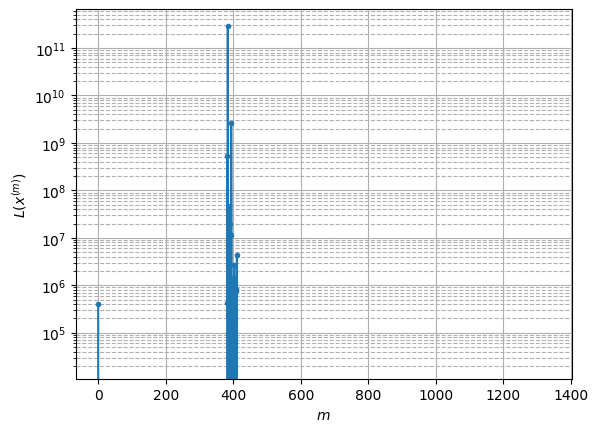

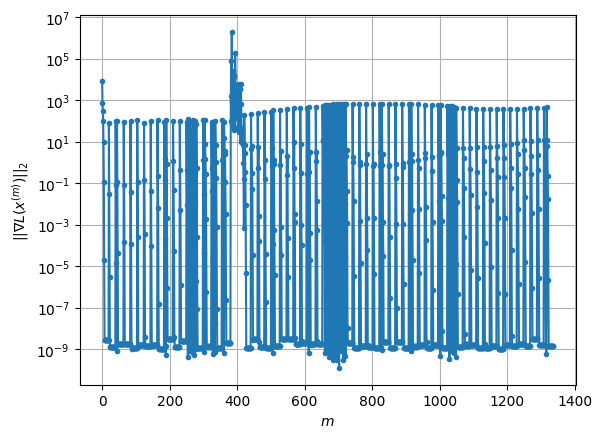

Windows:  23%|██▎       | 89/395 [00:55<03:47,  1.35it/s]

Before applying the algorithm
Cost function: -215431.26879412774
Gradient norm: 493.027784304033
Global relative error: 176.67887749263105
Position relative errors: 0.9779012654222373 m, 11.93415444577815 m, 121.77636356238642 m, 127.41621573022238 m

Iteration 1
Cost function: -236183.09887508472 (-9.63%)
Gradient norm: 11.701739936254086 (-97.63%)
Global relative error: 230.87934612693584 (30.68%)
Position relative errors: 0.14590951482065173 m, 143.08970577957086 m, 147.30693562900387 m, 105.46839966822697 m

Iteration 2
Cost function: -236354.87245657138 (-0.07%)
Gradient norm: 5.516994477834246 (-52.85%)
Global relative error: 47.93573394971814 (-79.24%)
Position relative errors: 0.14590951482065173 m, 34.279205572469124 m, 25.94681293890847 m, 21.020028496624363 m

Iteration 3
Cost function: -236360.39504760192 (-0.00%)
Gradient norm: 0.3191704394565297 (-94.21%)
Global relative error: 28.715871688638654 (-40.10%)
Position relative errors: 0.14590951482065173 m, 16.38748309569795

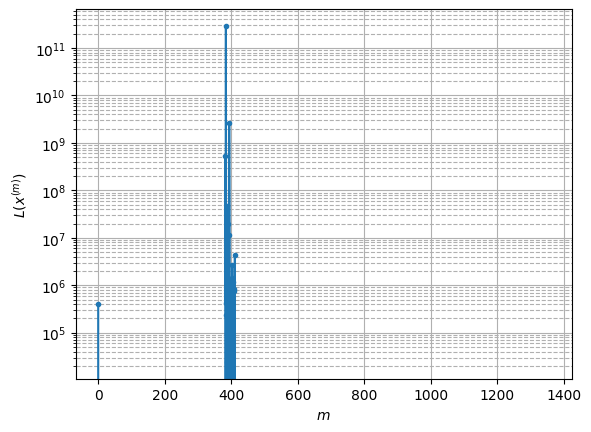

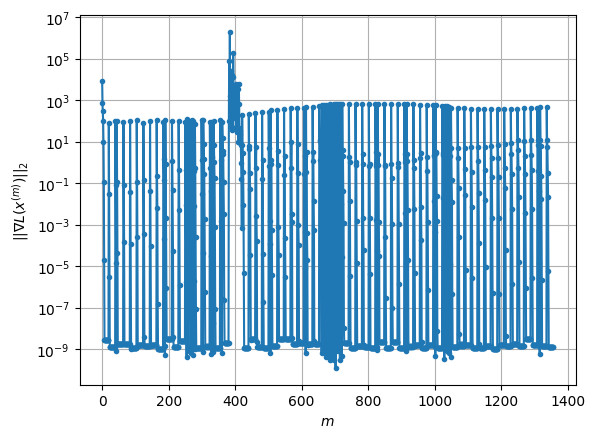

Windows:  23%|██▎       | 90/395 [00:56<03:42,  1.37it/s]

Before applying the algorithm
Cost function: -215010.64818193205
Gradient norm: 515.117265863923
Global relative error: 171.64748015954834
Position relative errors: 0.9199921927597428 m, 22.434091841934624 m, 108.20139831266329 m, 131.31447665440274 m

Iteration 1
Cost function: -236218.80778039098 (-9.86%)
Gradient norm: 10.117234205925415 (-98.04%)
Global relative error: 136.39857687662223 (-20.54%)
Position relative errors: 0.15811221768528091 m, 87.31966886703306 m, 95.67590318945257 m, 42.64100779119199 m

Iteration 2
Cost function: -236347.6178964984 (-0.05%)
Gradient norm: 4.969117112719054 (-50.88%)
Global relative error: 30.947712270894627 (-77.31%)
Position relative errors: 0.15811221768528091 m, 25.448722014179765 m, 5.556519532568341 m, 16.478329010483453 m

Iteration 3
Cost function: -236352.20589806125 (-0.00%)
Gradient norm: 0.28470736068341923 (-94.27%)
Global relative error: 49.122275869891105 (58.73%)
Position relative errors: 0.15811221768528091 m, 24.048793276139325

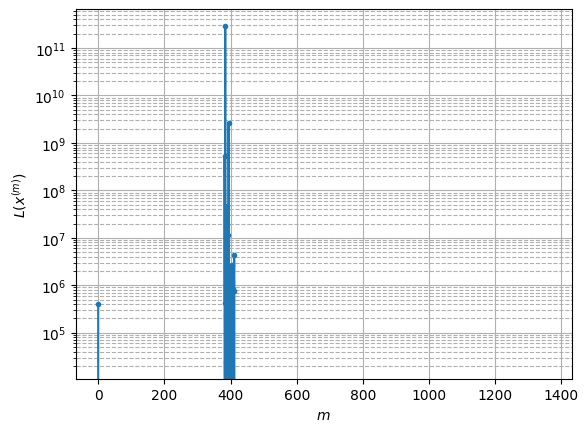

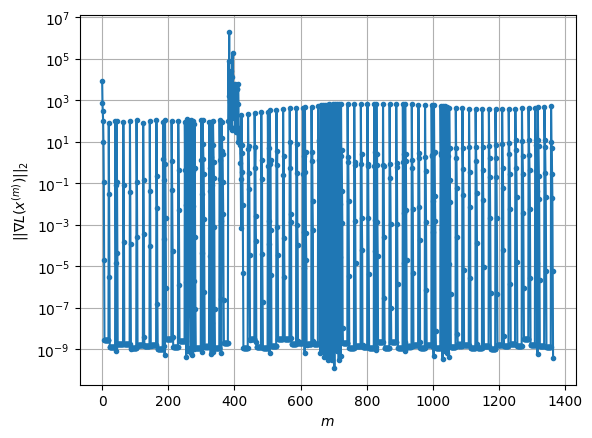

Windows:  23%|██▎       | 91/395 [00:56<03:35,  1.41it/s]

Before applying the algorithm
Cost function: -211593.86532469362
Gradient norm: 558.0694558478201
Global relative error: 186.37579161541748
Position relative errors: 1.0973611698460972 m, 22.17454535839496 m, 127.26724488746375 m, 134.30700146706084 m

Iteration 1
Cost function: -233478.12698729592 (-10.34%)
Gradient norm: 67.35558922753481 (-87.93%)
Global relative error: 878.5011270199072 (371.36%)
Position relative errors: 0.14309966526393358 m, 647.1061777243937 m, 325.78329399596464 m, 496.86552610261793 m

Iteration 2
Cost function: -235890.368349793 (-1.03%)
Gradient norm: 14.016606230500125 (-79.19%)
Global relative error: 595.5460244584165 (-32.21%)
Position relative errors: 0.14309966526393358 m, 412.7619424127356 m, 77.08285797482223 m, 422.3187894236336 m

Iteration 3
Cost function: -236278.75972373167 (-0.16%)
Gradient norm: 19.679838909392014 (40.40%)
Global relative error: 209.36396049142473 (-64.85%)
Position relative errors: 0.14309966526393358 m, 139.7884262477461 m, 

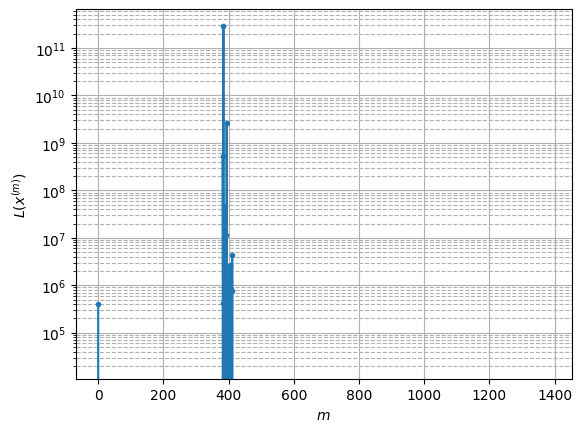

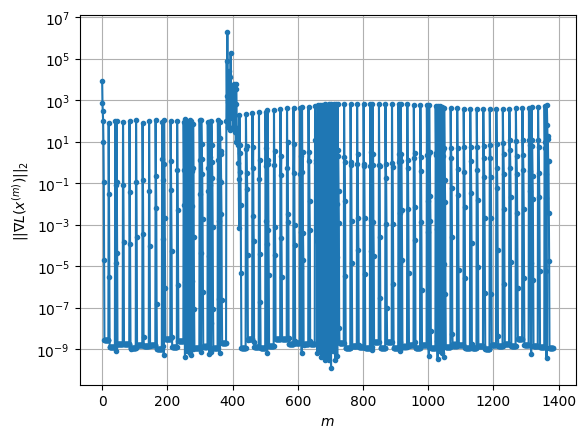

Windows:  23%|██▎       | 92/395 [00:57<03:37,  1.39it/s]

Before applying the algorithm
Cost function: -209468.7971835518
Gradient norm: 590.4453501340644
Global relative error: 163.21067434529496
Position relative errors: 0.9362002077966877 m, 19.113976162278014 m, 117.8611582854948 m, 111.2319390858376 m

Iteration 1
Cost function: -232340.23656001245 (-10.92%)
Gradient norm: 88.55920771443591 (-85.00%)
Global relative error: 1084.3686296240503 (564.40%)
Position relative errors: 0.12758875092412494 m, 766.508608534806 m, 435.63941007444186 m, 631.2926890962613 m

Iteration 2
Cost function: -235651.608935906 (-1.43%)
Gradient norm: 16.688453299737404 (-81.16%)
Global relative error: 768.3931186656382 (-29.14%)
Position relative errors: 0.12758875092412494 m, 529.1711910574635 m, 133.19594226024597 m, 540.9777752316227 m

Iteration 3
Cost function: -236210.64599685304 (-0.24%)
Gradient norm: 25.01299813287554 (49.88%)
Global relative error: 308.6079147423201 (-59.84%)
Position relative errors: 0.12758875092412494 m, 214.7467508624059 m, 68.5

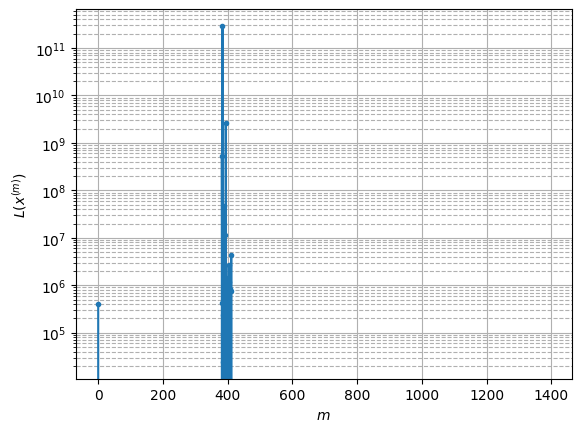

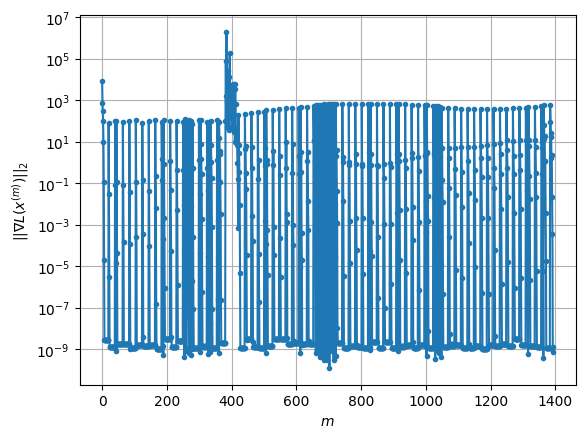

Windows:  24%|██▎       | 93/395 [00:58<03:31,  1.43it/s]

Before applying the algorithm
Cost function: -205834.8350597835
Gradient norm: 632.2366176003733
Global relative error: 174.02767514658086
Position relative errors: 1.0587312321022282 m, 30.39579043003086 m, 122.60373705397475 m, 119.67133200741476 m

Iteration 1
Cost function: -236190.20997995383 (-14.75%)
Gradient norm: 9.146310520355808 (-98.55%)
Global relative error: 323.0521452112388 (85.63%)
Position relative errors: 0.2240372167043186 m, 261.85955596692446 m, 83.50171893793275 m, 169.74089528136062 m

Iteration 2
Cost function: -236330.9122037356 (-0.06%)
Gradient norm: 7.294782155438814 (-20.24%)
Global relative error: 163.35731699163415 (-49.43%)
Position relative errors: 0.2240372167043186 m, 96.84758265432535 m, 45.28858171828618 m, 123.48016130854337 m

Iteration 3
Cost function: -236354.70085724676 (-0.01%)
Gradient norm: 0.8986399687169531 (-87.68%)
Global relative error: 55.929416558282504 (-65.76%)
Position relative errors: 0.2240372167043186 m, 26.431044420182197 m, 9

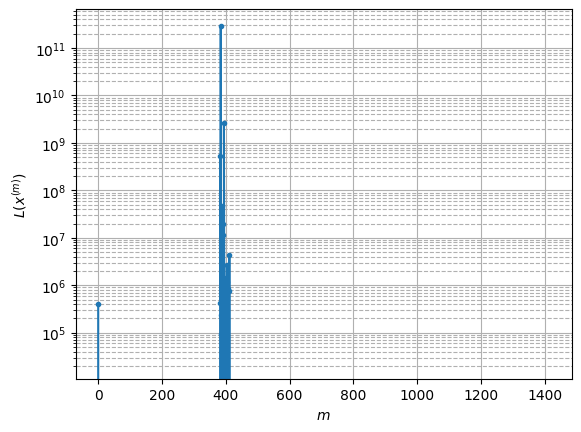

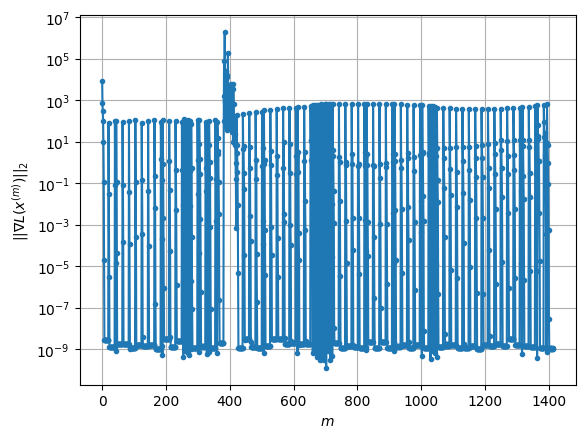

Windows:  24%|██▍       | 94/395 [00:59<03:30,  1.43it/s]

Before applying the algorithm
Cost function: -201642.3186221457
Gradient norm: 671.4109582578077
Global relative error: 165.91971865957765
Position relative errors: 1.241228433712702 m, 19.444611537401467 m, 119.64951837575843 m, 113.25201726818383 m

Iteration 1
Cost function: -233115.65600254523 (-15.61%)
Gradient norm: 103.09932511112198 (-84.64%)
Global relative error: 1128.9055015421004 (580.39%)
Position relative errors: 0.2278205180810996 m, 807.115445796069 m, 389.1336177894614 m, 686.7019523504983 m

Iteration 2
Cost function: -235769.3583692568 (-1.14%)
Gradient norm: 11.724160418462747 (-88.63%)
Global relative error: 863.5089191159844 (-23.51%)
Position relative errors: 0.2278205180810996 m, 596.7993218470152 m, 150.48426385352835 m, 605.6607668115273 m

Iteration 3
Cost function: -236155.03747532322 (-0.16%)
Gradient norm: 36.16175903583354 (208.44%)
Global relative error: 388.6995468046229 (-54.99%)
Position relative errors: 0.2278205180810996 m, 255.84825142304643 m, 143

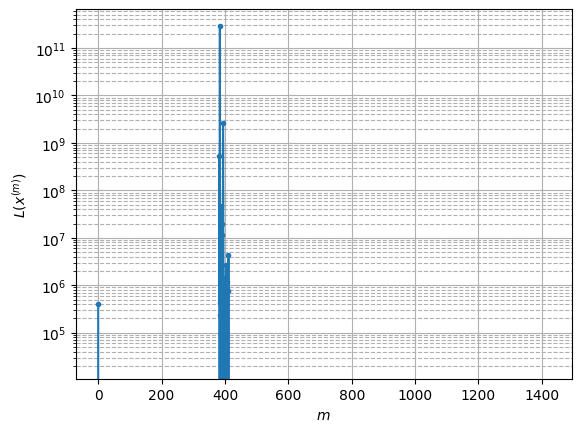

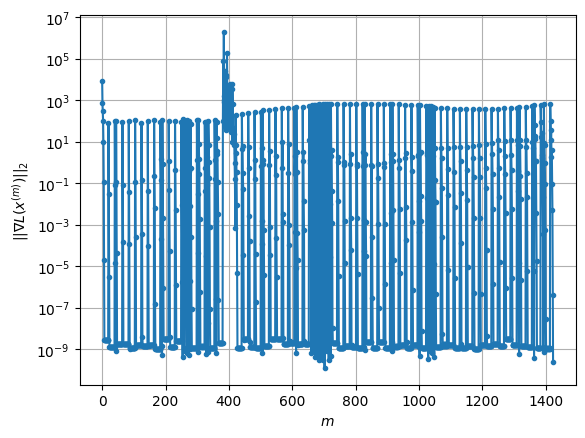

Windows:  24%|██▍       | 95/395 [00:59<03:29,  1.43it/s]

Before applying the algorithm
Cost function: -199391.17338988266
Gradient norm: 703.3883030831624
Global relative error: 160.2445506424938
Position relative errors: 1.1622841422608083 m, 15.613701391076082 m, 105.22194182614919 m, 119.80754968877741 m

Iteration 1
Cost function: -235999.75464555688 (-18.36%)
Gradient norm: 41.57472527322088 (-94.09%)
Global relative error: 775.5035882615579 (383.95%)
Position relative errors: 0.199329463640357 m, 508.45385274445766 m, 302.26011299213883 m, 501.5093298899337 m

Iteration 2
Cost function: -236262.9148679284 (-0.11%)
Gradient norm: 2.4397628015501307 (-94.13%)
Global relative error: 589.4457787191321 (-23.99%)
Position relative errors: 0.199329463640357 m, 384.44738539843434 m, 208.2707316976485 m, 395.3000443524381 m

Iteration 3
Cost function: -236319.5169276783 (-0.02%)
Gradient norm: 14.85443108221231 (508.85%)
Global relative error: 270.8851409870827 (-54.04%)
Position relative errors: 0.199329463640357 m, 138.68235642009577 m, 170.9

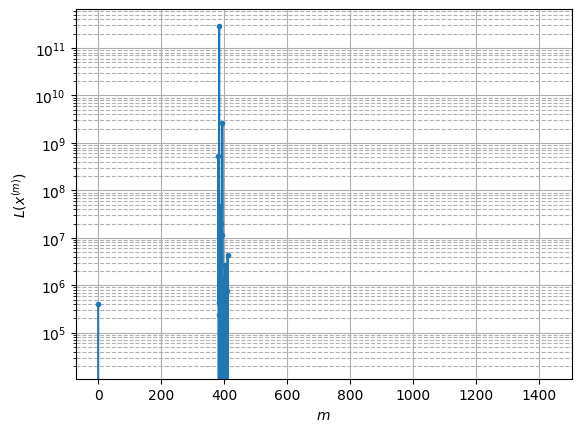

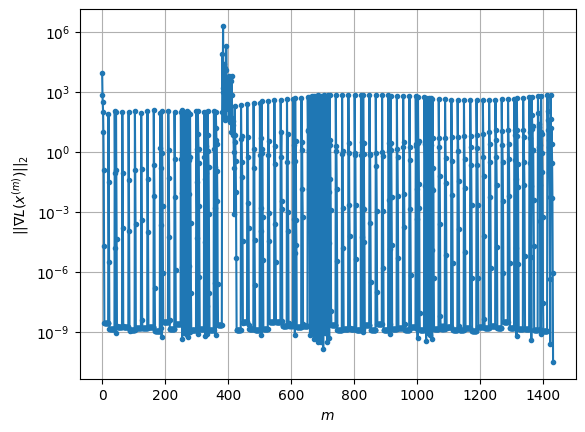

Windows:  24%|██▍       | 96/395 [01:00<03:21,  1.48it/s]

Before applying the algorithm
Cost function: -196230.18246223484
Gradient norm: 717.2704201055856
Global relative error: 192.27717121175746
Position relative errors: 1.0931395970697897 m, 47.0737599039216 m, 137.4943250755713 m, 125.86110004428708 m

Iteration 1
Cost function: -235892.59367652523 (-20.21%)
Gradient norm: 36.029474394704785 (-94.98%)
Global relative error: 713.2527508752249 (270.95%)
Position relative errors: 0.31583110278455007 m, 516.7535864208284 m, 309.1379248444903 m, 382.2580155008709 m

Iteration 2
Cost function: -236248.99453840023 (-0.15%)
Gradient norm: 5.134150371313037 (-85.75%)
Global relative error: 503.90000102422425 (-29.35%)
Position relative errors: 0.31583110278455007 m, 354.3995817473733 m, 154.47436223994856 m, 323.1811385888662 m

Iteration 3
Cost function: -236329.96282586985 (-0.03%)
Gradient norm: 11.865003219041814 (131.10%)
Global relative error: 204.73875017897302 (-59.37%)
Position relative errors: 0.31583110278455007 m, 119.74261395661644 m

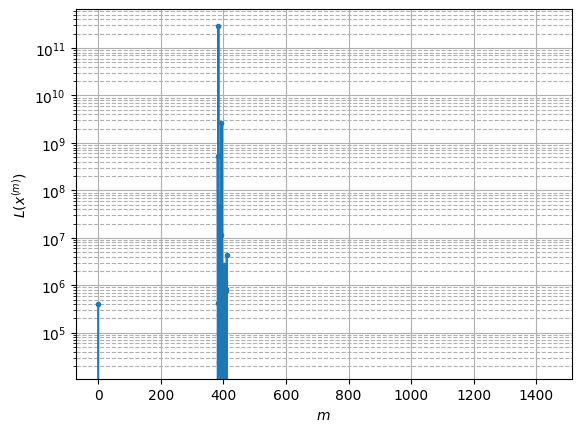

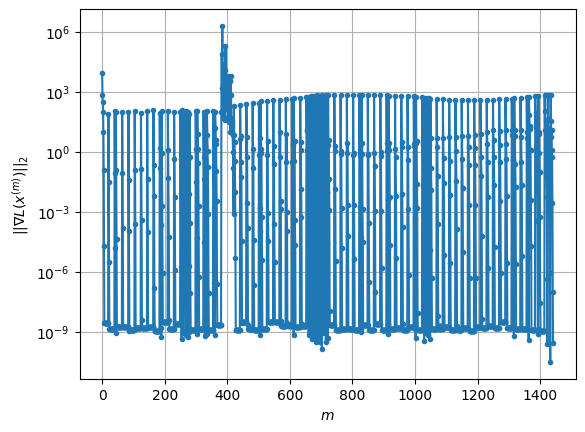

Windows:  25%|██▍       | 97/395 [01:01<03:34,  1.39it/s]

Before applying the algorithm
Cost function: -196510.77876820936
Gradient norm: 722.6799582730781
Global relative error: 196.34227237589178
Position relative errors: 1.247322309804111 m, 33.67648113197849 m, 145.35305660828578 m, 127.59096960522419 m

Iteration 1
Cost function: -236306.80804855848 (-20.25%)
Gradient norm: 6.188451398783328 (-99.14%)
Global relative error: 215.80123393015816 (9.91%)
Position relative errors: 0.13033222122178523 m, 169.1502439477812 m, 78.43841795311711 m, 108.61908213352805 m

Iteration 2
Cost function: -236357.310084205 (-0.02%)
Gradient norm: 4.966418030119614 (-19.75%)
Global relative error: 26.1622104131647 (-87.88%)
Position relative errors: 0.13033222122178523 m, 18.231912173006304 m, 12.787175149334908 m, 13.44877913610624 m

Iteration 3
Cost function: -236361.65609011374 (-0.00%)
Gradient norm: 0.3701934775946444 (-92.55%)
Global relative error: 35.51648705185047 (35.75%)
Position relative errors: 0.13033222122178523 m, 18.382336797373608 m, 15.

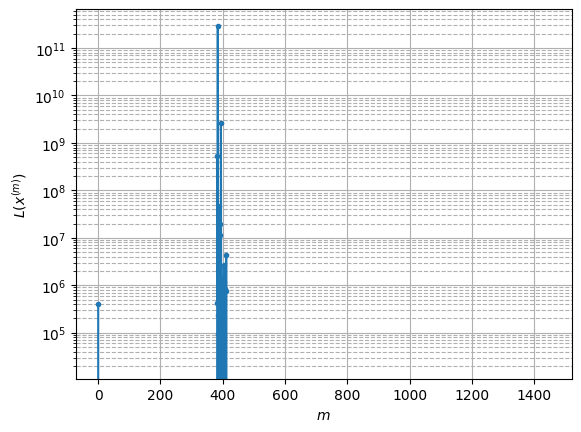

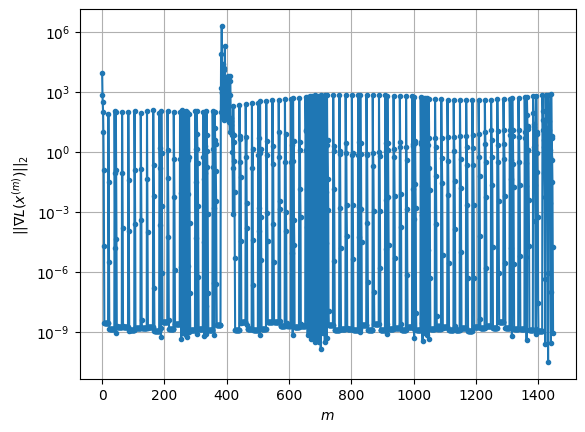

Windows:  25%|██▍       | 98/395 [01:01<03:17,  1.50it/s]

Before applying the algorithm
Cost function: -196210.19085420514
Gradient norm: 711.672639554852
Global relative error: 170.48867671853785
Position relative errors: 1.1239707369337968 m, 26.295056680652152 m, 111.4626637075595 m, 126.26218373566087 m

Iteration 1
Cost function: -236333.71144150328 (-20.45%)
Gradient norm: 2.1456572123460305 (-99.70%)
Global relative error: 101.34503772303351 (-40.56%)
Position relative errors: 0.09496510905942851 m, 90.98610375386319 m, 37.03410241159771 m, 24.762485825741845 m

Iteration 2
Cost function: -236351.03833203323 (-0.01%)
Gradient norm: 2.717463962615929 (26.65%)
Global relative error: 72.66340037445335 (-28.30%)
Position relative errors: 0.09496510905942851 m, 43.69402894171669 m, 45.15181140655281 m, 36.393342336944855 m

Iteration 3
Cost function: -236354.97396171233 (-0.00%)
Gradient norm: 0.1027281124897415 (-96.22%)
Global relative error: 45.37018641225447 (-37.56%)
Position relative errors: 0.09496510905942851 m, 18.950659416053345 m

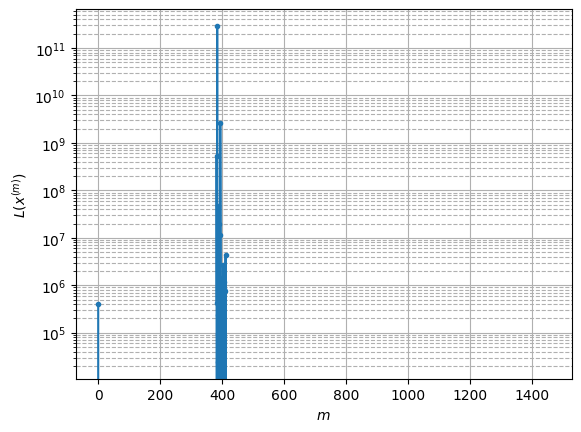

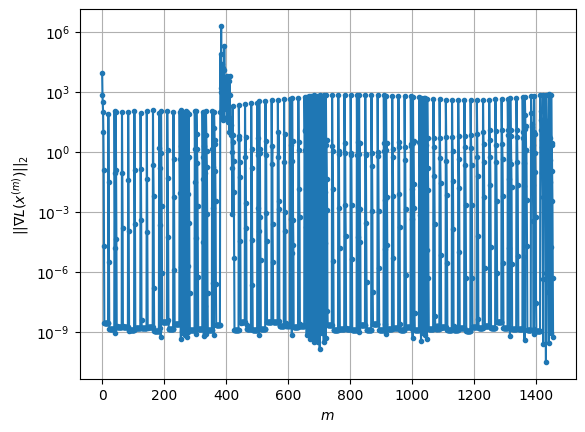

Windows:  25%|██▌       | 99/395 [01:02<03:22,  1.46it/s]

Before applying the algorithm
Cost function: -197597.7303196573
Gradient norm: 696.027794319119
Global relative error: 177.6048335001488
Position relative errors: 1.1115343611778055 m, 22.756949719503794 m, 131.61329804464165 m, 117.024358853846 m

Iteration 1
Cost function: -236322.99599377104 (-19.60%)
Gradient norm: 2.1029549788058977 (-99.70%)
Global relative error: 145.60799363578178 (-18.02%)
Position relative errors: 0.07987408182142035 m, 112.0898041967395 m, 41.96883429238156 m, 82.87685049482792 m

Iteration 2
Cost function: -236350.25020467286 (-0.01%)
Gradient norm: 5.234799557121028 (148.93%)
Global relative error: 21.169640652318446 (-85.46%)
Position relative errors: 0.07987408182142035 m, 13.961273797486975 m, 15.558625610823462 m, 1.8861289539938164 m

Iteration 3
Cost function: -236353.76859238697 (-0.00%)
Gradient norm: 0.04439184108680001 (-99.15%)
Global relative error: 26.053555370157348 (23.07%)
Position relative errors: 0.07987408182142035 m, 6.2081940218191605 

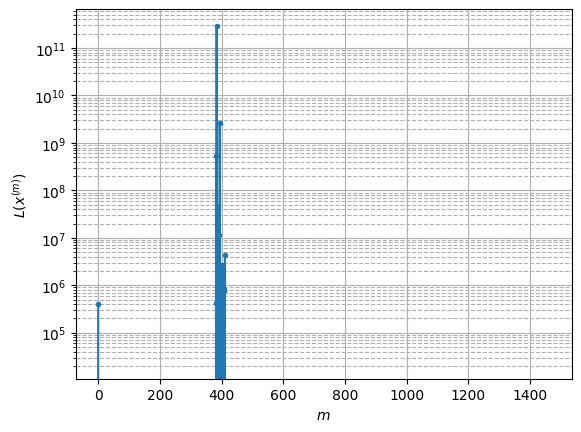

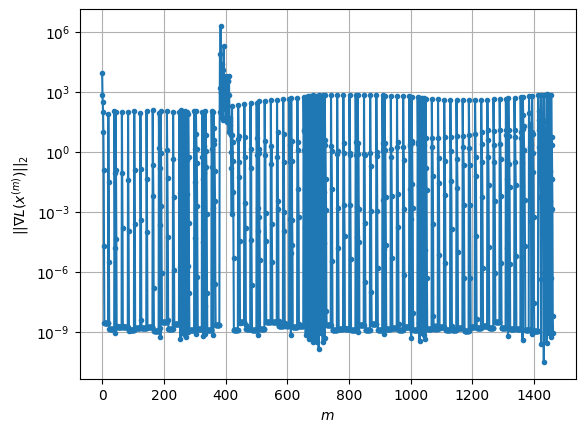

Windows:  25%|██▌       | 100/395 [01:03<03:20,  1.47it/s]

Before applying the algorithm
Cost function: -198426.78354851325
Gradient norm: 676.4467797993392
Global relative error: 158.41692489043982
Position relative errors: 1.1043416478320751 m, 15.308737659343542 m, 109.47536560877765 m, 113.43683516301978 m

Iteration 1
Cost function: -236344.4517455256 (-19.11%)
Gradient norm: 2.5672191720519995 (-99.62%)
Global relative error: 57.97765689073292 (-63.40%)
Position relative errors: 0.09866071957721276 m, 12.340244502767296 m, 35.60896516441492 m, 43.972094611986776 m

Iteration 2
Cost function: -236355.0595297977 (-0.00%)
Gradient norm: 0.8943101887453354 (-65.16%)
Global relative error: 28.877800016478584 (-50.19%)
Position relative errors: 0.09866071957721276 m, 13.285240377320095 m, 14.184427294526966 m, 21.181316879018492 m

Iteration 3
Cost function: -236355.34373238342 (-0.00%)
Gradient norm: 0.0353411594892625 (-96.05%)
Global relative error: 31.30302035089257 (8.40%)
Position relative errors: 0.09866071957721276 m, 10.75540082233879

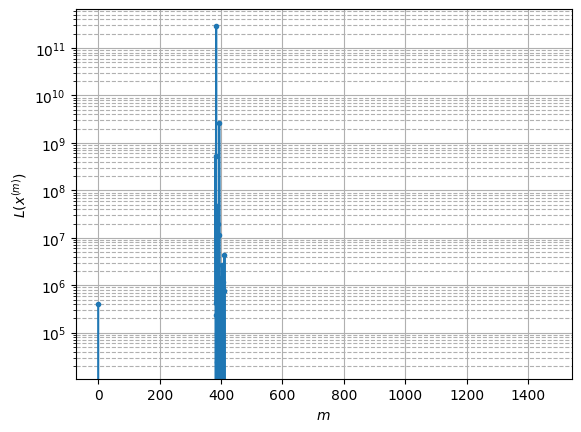

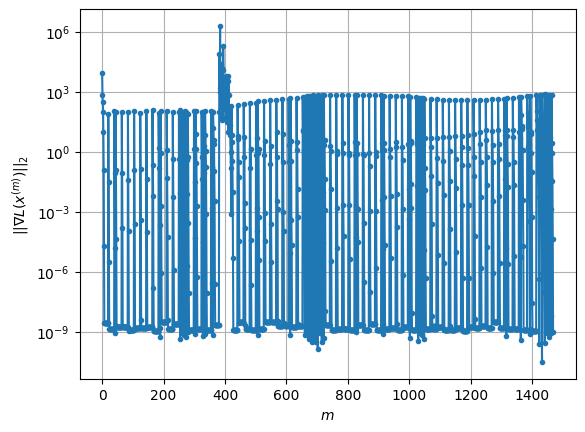

Windows:  26%|██▌       | 101/395 [01:03<03:13,  1.52it/s]

Before applying the algorithm
Cost function: -200084.00389076167
Gradient norm: 660.8033004565411
Global relative error: 169.97316215969144
Position relative errors: 0.9935943727210552 m, 18.21618023252654 m, 122.77214668603573 m, 116.09270716221603 m

Iteration 1
Cost function: -236334.34131397028 (-18.12%)
Gradient norm: 3.130333006484365 (-99.53%)
Global relative error: 78.01136567257714 (-54.10%)
Position relative errors: 0.1555467631141065 m, 42.966442257079514 m, 59.83587959441813 m, 25.5295630174613 m

Iteration 2
Cost function: -236351.88425445076 (-0.01%)
Gradient norm: 5.289975179396035 (68.99%)
Global relative error: 77.92358447702556 (-0.11%)
Position relative errors: 0.1555467631141065 m, 31.051483195997577 m, 65.26147903897412 m, 29.004531086590518 m

Iteration 3
Cost function: -236357.51337731953 (-0.00%)
Gradient norm: 0.26627285532414385 (-94.97%)
Global relative error: 51.97023748936428 (-33.31%)
Position relative errors: 0.1555467631141065 m, 17.787793807805578 m, 45

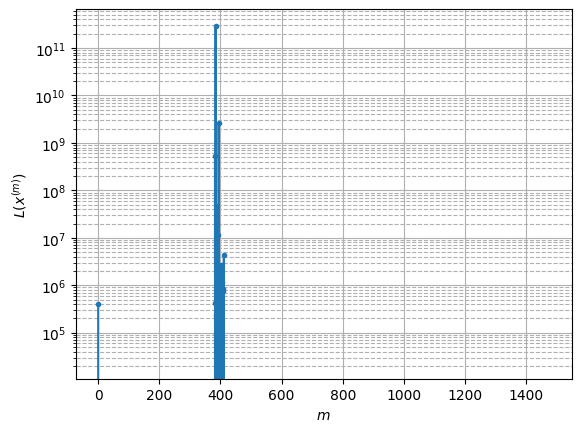

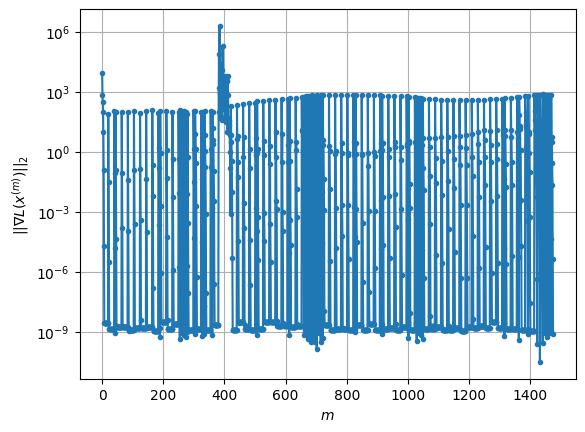

Windows:  26%|██▌       | 102/395 [01:04<03:10,  1.54it/s]

Before applying the algorithm
Cost function: -201014.33484559
Gradient norm: 642.4152330478724
Global relative error: 157.87564938903418
Position relative errors: 1.1280391980437463 m, 18.898234380871 m, 106.33805120477473 m, 115.11302338226686 m

Iteration 1
Cost function: -236327.6803223727 (-17.57%)
Gradient norm: 4.455373424388989 (-99.31%)
Global relative error: 79.05824067098214 (-49.92%)
Position relative errors: 0.19866609469642782 m, 16.376143537476633 m, 47.858901941344975 m, 60.695944913605715 m

Iteration 2
Cost function: -236353.48032318777 (-0.01%)
Gradient norm: 2.527267191436266 (-43.28%)
Global relative error: 79.91297053007821 (1.08%)
Position relative errors: 0.19866609469642782 m, 37.73174705325134 m, 55.279615553930526 m, 43.57759872475864 m

Iteration 3
Cost function: -236356.49349273925 (-0.00%)
Gradient norm: 0.3297193788485728 (-86.95%)
Global relative error: 47.179845682668095 (-40.96%)
Position relative errors: 0.19866609469642782 m, 21.980041633440923 m, 29.

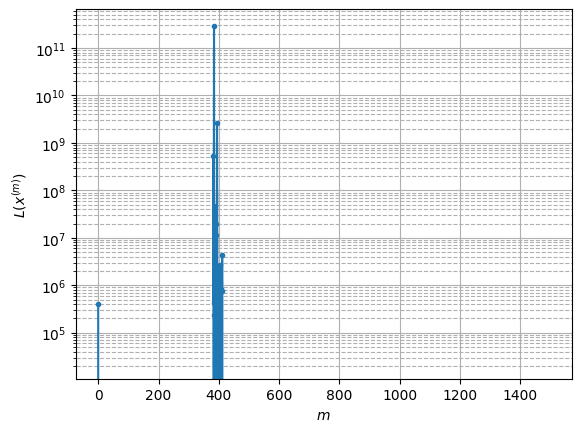

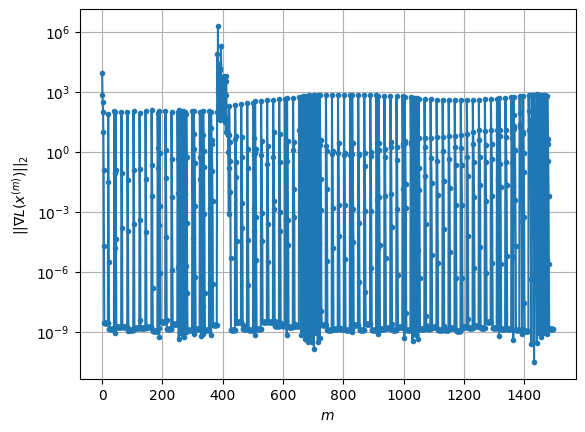

Windows:  26%|██▌       | 103/395 [01:05<03:28,  1.40it/s]

Before applying the algorithm
Cost function: -202359.9978908032
Gradient norm: 620.3159121327934
Global relative error: 155.69549764657825
Position relative errors: 1.0145051020487033 m, 25.688472267217705 m, 106.63936508858632 m, 110.45685807239431 m

Iteration 1
Cost function: -236316.27719334528 (-16.78%)
Gradient norm: 5.488504796008315 (-99.12%)
Global relative error: 102.10621030022261 (-34.42%)
Position relative errors: 0.1948538236485896 m, 27.015077380517287 m, 72.16307633649096 m, 66.93897776311677 m

Iteration 2
Cost function: -236354.21617899282 (-0.02%)
Gradient norm: 2.829396082047025 (-48.45%)
Global relative error: 65.60554331435996 (-35.75%)
Position relative errors: 0.1948538236485896 m, 23.617166941113737 m, 16.720838912028547 m, 58.814988222775554 m

Iteration 3
Cost function: -236356.71236467565 (-0.00%)
Gradient norm: 0.3085532465679657 (-89.09%)
Global relative error: 48.27976486776896 (-26.41%)
Position relative errors: 0.1948538236485896 m, 13.084395766100908 m

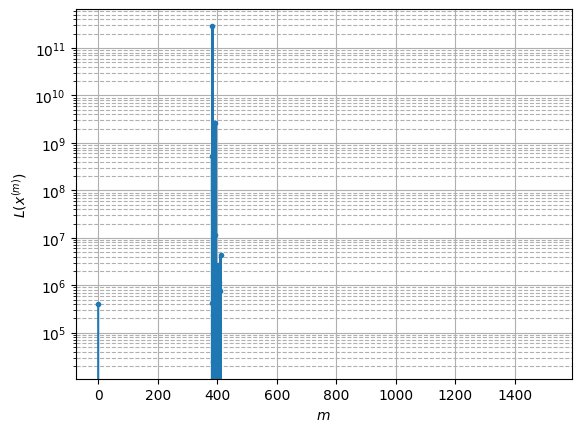

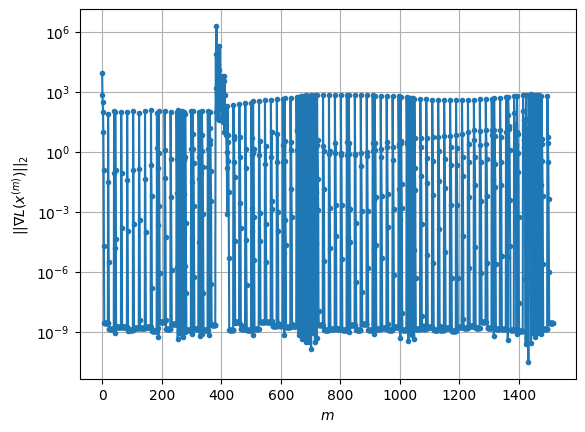

Windows:  26%|██▋       | 104/395 [01:05<03:14,  1.49it/s]

Before applying the algorithm
Cost function: -204311.28709117827
Gradient norm: 607.3850166233956
Global relative error: 159.8826264805659
Position relative errors: 0.9222842761020341 m, 22.326371057155644 m, 122.34240768856719 m, 100.43908719096669 m

Iteration 1
Cost function: -236291.47418893588 (-15.65%)
Gradient norm: 8.439736321265986 (-98.61%)
Global relative error: 140.83021559977703 (-11.92%)
Position relative errors: 0.17159653068418293 m, 29.28573116245839 m, 110.77103398856802 m, 81.83997994396037 m

Iteration 2
Cost function: -236358.1933216873 (-0.03%)
Gradient norm: 3.37258799523922 (-60.04%)
Global relative error: 47.13097603272918 (-66.53%)
Position relative errors: 0.17159653068418293 m, 18.457239792003193 m, 12.878993816883787 m, 41.31948004618748 m

Iteration 3
Cost function: -236360.89238483924 (-0.00%)
Gradient norm: 0.31889312699565153 (-90.54%)
Global relative error: 38.776290009754916 (-17.73%)
Position relative errors: 0.17159653068418293 m, 16.084474581719135

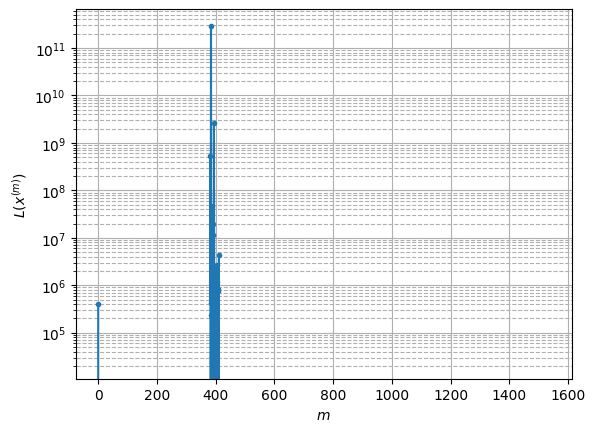

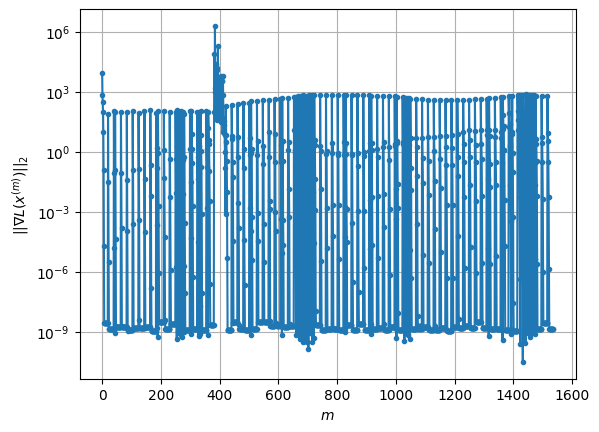

Windows:  27%|██▋       | 105/395 [01:06<03:23,  1.43it/s]

Before applying the algorithm
Cost function: -206239.967272137
Gradient norm: 579.612855063626
Global relative error: 178.27591466805092
Position relative errors: 1.1032412557057305 m, 25.71698895333433 m, 137.24844972851054 m, 110.79330977452621 m

Iteration 1
Cost function: -236289.02228472813 (-14.57%)
Gradient norm: 7.908261005513331 (-98.64%)
Global relative error: 152.66093652759363 (-14.37%)
Position relative errors: 0.08040925811246076 m, 6.760542912199759 m, 131.1785513970274 m, 77.7458111011814 m

Iteration 2
Cost function: -236333.76359131967 (-0.02%)
Gradient norm: 9.777801633878791 (23.64%)
Global relative error: 78.31171723169584 (-48.70%)
Position relative errors: 0.08040925811246076 m, 40.47080276542954 m, 48.43699445658471 m, 46.27378995392998 m

Iteration 3
Cost function: -236352.33225901084 (-0.01%)
Gradient norm: 0.9790507426002059 (-89.99%)
Global relative error: 26.349557814933927 (-66.35%)
Position relative errors: 0.08040925811246076 m, 21.05552678560757 m, 10.5

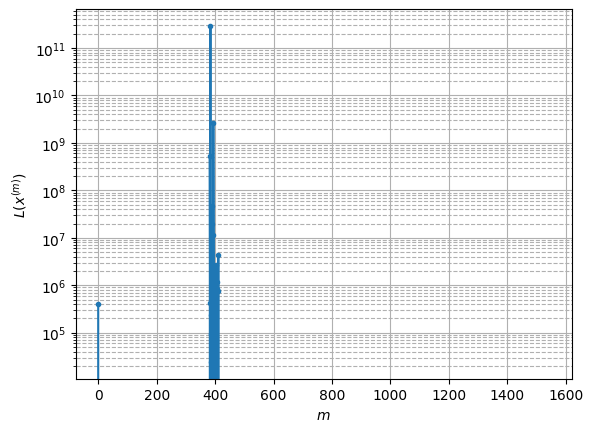

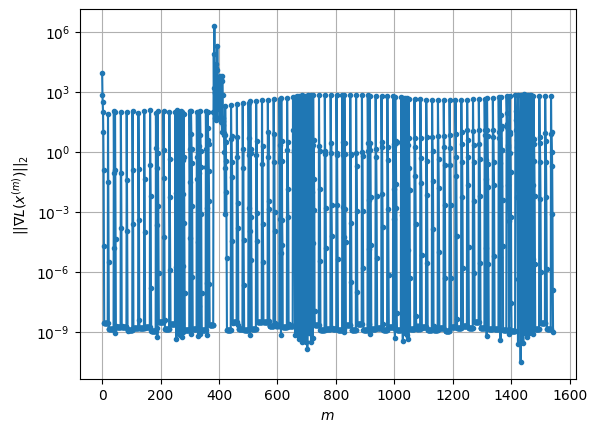

Windows:  27%|██▋       | 106/395 [01:07<03:17,  1.46it/s]

Before applying the algorithm
Cost function: -207982.3840100646
Gradient norm: 559.8927223694908
Global relative error: 181.7086886993884
Position relative errors: 1.074969336395565 m, 18.096427577666613 m, 122.16101417688316 m, 133.26178751920932 m

Iteration 1
Cost function: -236245.03093409757 (-13.59%)
Gradient norm: 14.917780917670862 (-97.34%)
Global relative error: 187.0021800101948 (2.91%)
Position relative errors: 0.14190073949246895 m, 36.116728850877884 m, 115.48221347052683 m, 142.55469673301366 m

Iteration 2
Cost function: -236310.956410746 (-0.03%)
Gradient norm: 15.331159863059073 (2.77%)
Global relative error: 195.2879152609518 (4.43%)
Position relative errors: 0.14190073949246895 m, 68.8942121312837 m, 117.44128416727307 m, 139.96816823098226 m

Iteration 3
Cost function: -236355.54820288278 (-0.02%)
Gradient norm: 1.598377121892793 (-89.57%)
Global relative error: 107.36216234175926 (-45.02%)
Position relative errors: 0.14190073949246895 m, 28.421144760899722 m, 64.4

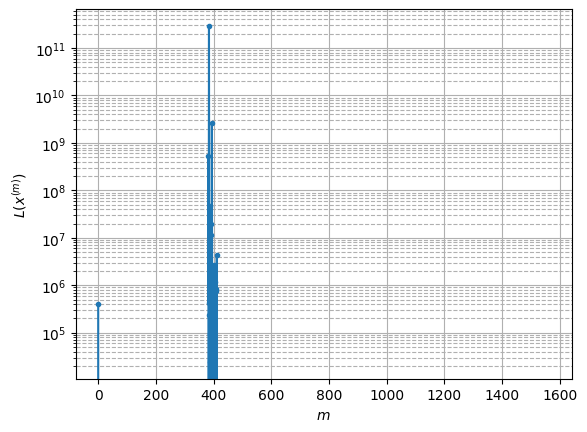

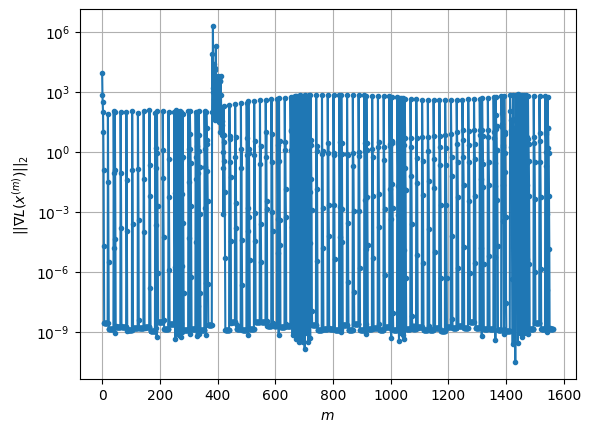

Windows:  27%|██▋       | 107/395 [01:07<03:20,  1.43it/s]

Before applying the algorithm
Cost function: -209229.62148580234
Gradient norm: 543.9489287997817
Global relative error: 154.49642302232107
Position relative errors: 1.1121998702817006 m, 22.006059379746322 m, 109.60586330257156 m, 106.59654225830673 m

Iteration 1
Cost function: -236240.6004735195 (-12.91%)
Gradient norm: 15.043323041806433 (-97.23%)
Global relative error: 190.41530749302416 (23.25%)
Position relative errors: 0.17362017594701437 m, 43.6846065183264 m, 114.53369614779646 m, 145.685530464676 m

Iteration 2
Cost function: -236340.78319459196 (-0.04%)
Gradient norm: 6.976531099221189 (-53.62%)
Global relative error: 120.4808219986127 (-36.73%)
Position relative errors: 0.17362017594701437 m, 47.87332989653379 m, 54.35855560941372 m, 96.23677594966068 m

Iteration 3
Cost function: -236351.83900200677 (-0.00%)
Gradient norm: 1.0808292281538343 (-84.51%)
Global relative error: 45.84056697412569 (-61.95%)
Position relative errors: 0.17362017594701437 m, 15.845227921209961 m, 

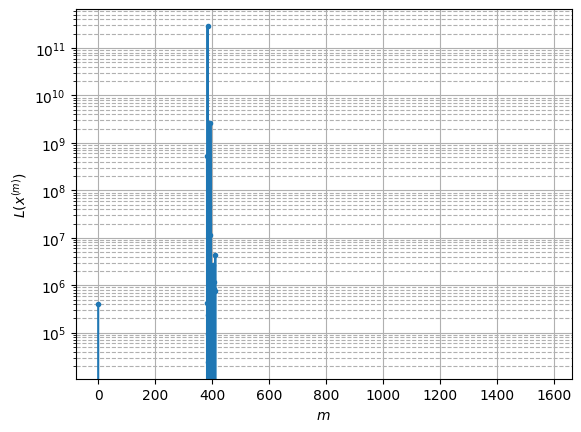

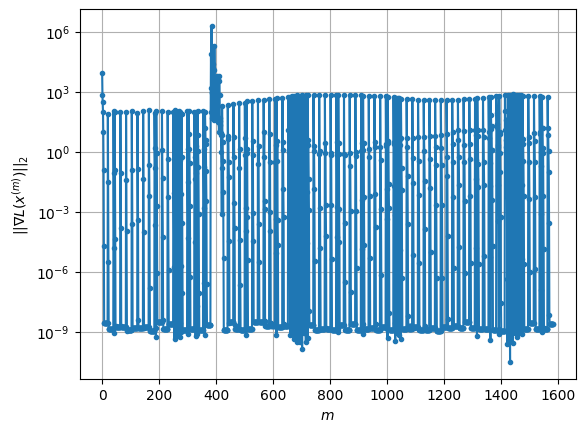

Windows:  27%|██▋       | 108/395 [01:08<03:17,  1.45it/s]

Before applying the algorithm
Cost function: -210673.4001746845
Gradient norm: 532.2939527320742
Global relative error: 155.41833066725985
Position relative errors: 0.9379410586000342 m, 14.907461130139813 m, 111.84346402165617 m, 106.84301564968683 m

Iteration 1
Cost function: -236140.27281142422 (-12.09%)
Gradient norm: 30.05060363558062 (-94.35%)
Global relative error: 316.41170495817477 (103.59%)
Position relative errors: 0.1716488019362708 m, 85.43354594545326 m, 146.70812632359767 m, 266.9959129460492 m

Iteration 2
Cost function: -236340.5899576733 (-0.08%)
Gradient norm: 3.315389945705856 (-88.97%)
Global relative error: 200.80041878790016 (-36.54%)
Position relative errors: 0.1716488019362708 m, 59.55395379573472 m, 72.23998804851225 m, 177.6179453123817 m

Iteration 3
Cost function: -236356.07734153335 (-0.01%)
Gradient norm: 4.459350633631199 (34.50%)
Global relative error: 66.32452403390691 (-66.97%)
Position relative errors: 0.1716488019362708 m, 24.69542751120244 m, 31.8

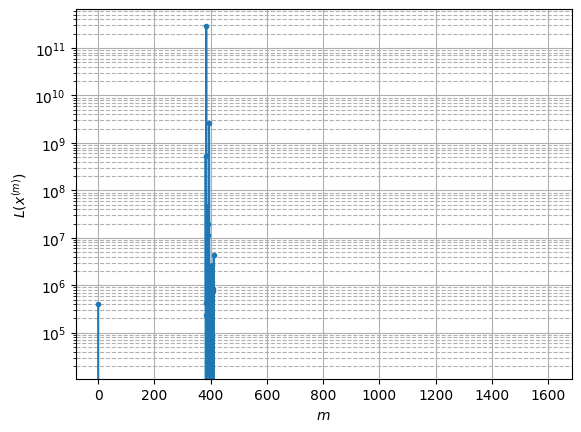

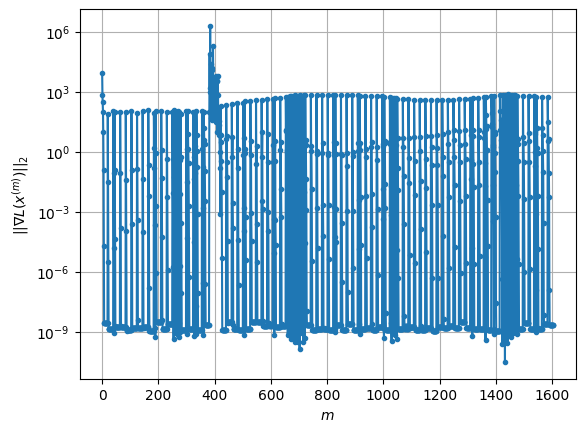

Windows:  28%|██▊       | 109/395 [01:09<03:19,  1.44it/s]

Before applying the algorithm
Cost function: -212446.53536201036
Gradient norm: 499.22576413467374
Global relative error: 164.2147050877506
Position relative errors: 1.1132431677758639 m, 30.626456692123654 m, 132.31561883186228 m, 92.26315931981544 m

Iteration 1
Cost function: -223498.09079427953 (-5.20%)
Gradient norm: 383.0476291309557 (-23.27%)
Global relative error: 1366.5722018425977 (732.19%)
Position relative errors: 0.1662132383425537 m, 368.61335848257977 m, 543.5658537066238 m, 1198.4041777304549 m

Iteration 2
Cost function: -235397.7527447161 (-5.32%)
Gradient norm: 3.695061384570534 (-99.04%)
Global relative error: 1310.17768747549 (-4.13%)
Position relative errors: 0.1662132383425537 m, 352.62275114043774 m, 441.5714368002195 m, 1182.0448680398986 m

Iteration 3
Cost function: -229990.79945293762 (2.30%)
Gradient norm: 294.6019720647556 (7872.86%)
Global relative error: 104.18587143405145 (-92.05%)
Position relative errors: 0.1662132383425537 m, 25.209600275421103 m, 39

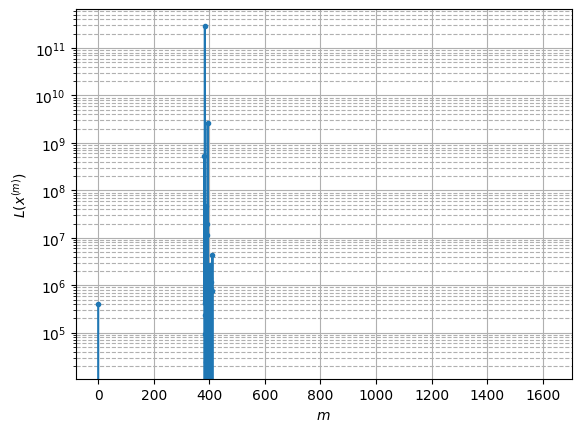

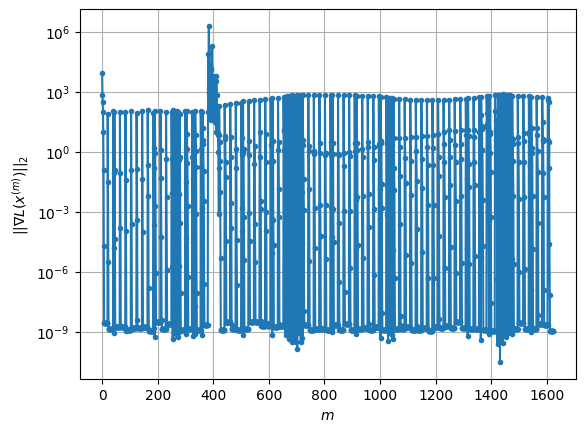

Windows:  28%|██▊       | 110/395 [01:09<03:13,  1.47it/s]

Before applying the algorithm
Cost function: -214800.95151338866
Gradient norm: 478.1916308595479
Global relative error: 185.62366972163468
Position relative errors: 0.975680932776381 m, 19.92400477700756 m, 118.61253842966286 m, 141.35759595966164 m

Iteration 1
Cost function: -236197.3785042602 (-9.96%)
Gradient norm: 30.74003123299947 (-93.57%)
Global relative error: 313.6296993430576 (68.96%)
Position relative errors: 0.14296297603988814 m, 56.88093080712617 m, 144.68736344847915 m, 272.3717492828144 m

Iteration 2
Cost function: -236350.92251514876 (-0.07%)
Gradient norm: 3.4892571974230444 (-88.65%)
Global relative error: 216.47076212774581 (-30.98%)
Position relative errors: 0.14296297603988814 m, 55.04053154362046 m, 67.52891220284188 m, 198.14800450366556 m

Iteration 3
Cost function: -236362.0715597105 (-0.00%)
Gradient norm: 3.0848466413634457 (-11.59%)
Global relative error: 88.67257321512963 (-59.04%)
Position relative errors: 0.14296297603988814 m, 21.53290753502175 m, 29

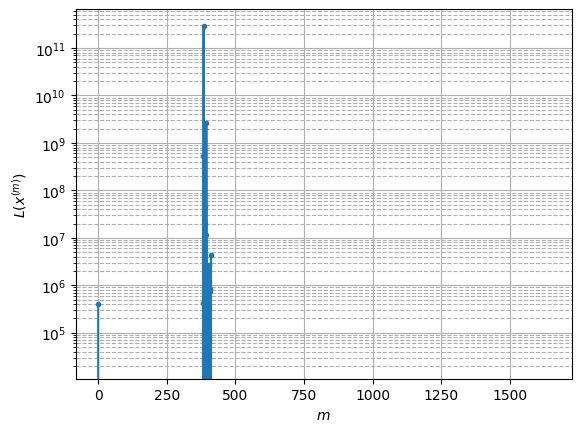

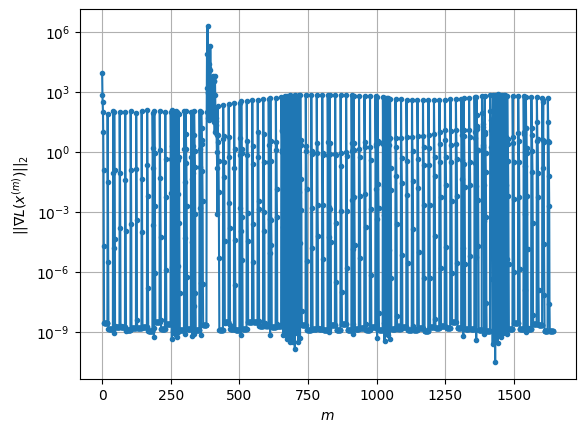

Windows:  28%|██▊       | 111/395 [01:10<03:19,  1.42it/s]

Before applying the algorithm
Cost function: -214354.23683280987
Gradient norm: 477.8002675913142
Global relative error: 153.54250340369347
Position relative errors: 1.1539797693190543 m, 25.416954810446335 m, 112.12430301071569 m, 101.72893016961156 m

Iteration 1
Cost function: -184103.42260867887 (14.11%)
Gradient norm: 810.2477396449807 (69.58%)
Global relative error: 2106.744237058129 (1272.09%)
Position relative errors: 0.2591977889832439 m, 559.8115964951199 m, 647.0841177977697 m, 1925.1641544518673 m

Iteration 2
Cost function: -234408.490733435 (-27.32%)
Gradient norm: 5.874622634592442 (-99.27%)
Global relative error: 2060.0477646321574 (-2.22%)
Position relative errors: 0.2591977889832439 m, 523.1646153501666 m, 575.2428252175972 m, 1907.6645119444897 m

Iteration 3
Cost function: -208216.88561151602 (11.17%)
Gradient norm: 617.054448416238 (10403.73%)
Global relative error: 234.40467492571594 (-88.62%)
Position relative errors: 0.2591977889832439 m, 71.2557166655386 m, 68.

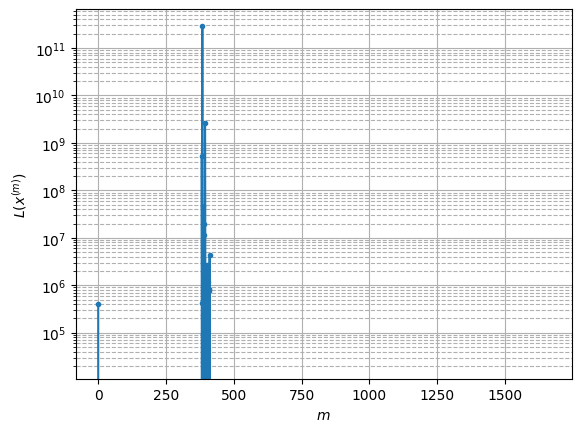

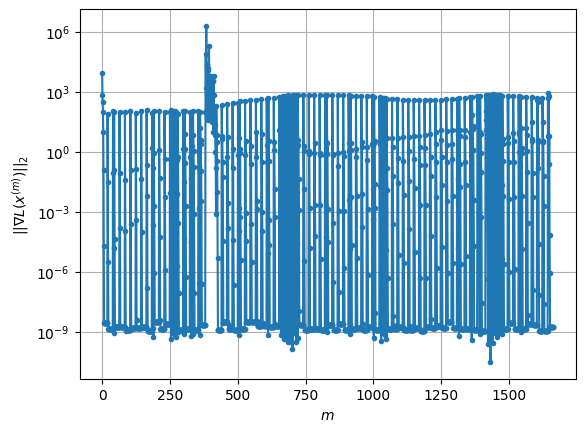

Windows:  28%|██▊       | 112/395 [01:11<03:09,  1.49it/s]

Before applying the algorithm
Cost function: -218272.01351794563
Gradient norm: 435.61973853872826
Global relative error: 182.05515123083524
Position relative errors: 1.2336990483812744 m, 31.431783785678917 m, 138.86041844410713 m, 113.42430244503332 m

Iteration 1
Cost function: 159367.83611030097 (173.01%)
Gradient norm: 2283.8482822820465 (424.28%)
Global relative error: 3746.692668494322 (1958.00%)
Position relative errors: 0.1059280854205385 m, 927.8362245552906 m, 1051.8235387554948 m, 3474.2604700572497 m

Iteration 2
Cost function: -230358.63070961073 (-244.55%)
Gradient norm: 12.69761460061628 (-99.44%)
Global relative error: 3658.1524895147813 (-2.36%)
Position relative errors: 0.1059280854205385 m, 872.1878049338078 m, 974.1227533335132 m, 3416.4961011007085 m

Iteration 3
Cost function: 31056.617489124234 (113.48%)
Gradient norm: 1899.7872687470879 (14861.77%)
Global relative error: 480.08149463332654 (-86.88%)
Position relative errors: 0.1059280854205385 m, 120.7784773375

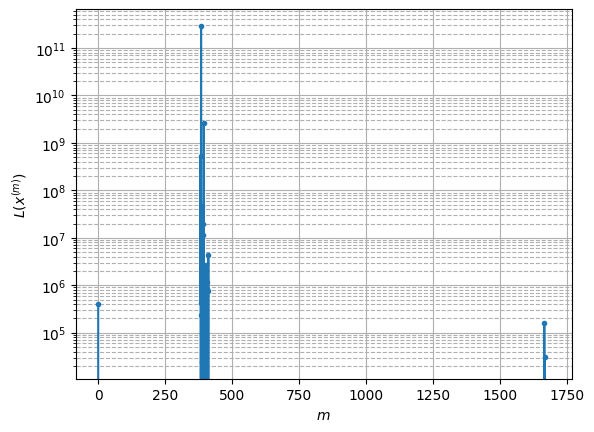

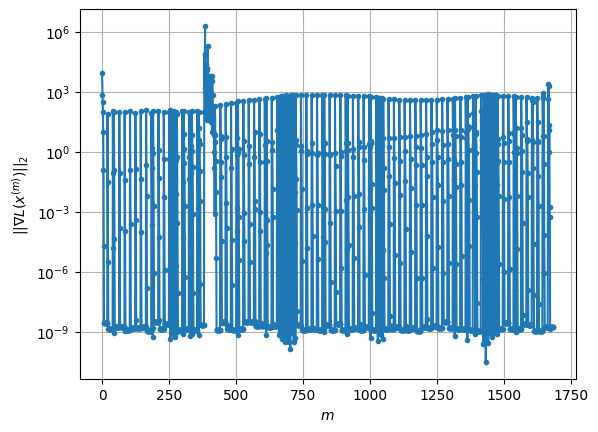

Windows:  29%|██▊       | 113/395 [01:12<03:19,  1.41it/s]

Before applying the algorithm
Cost function: -218341.7008656324
Gradient norm: 430.2828706934688
Global relative error: 142.02385642903178
Position relative errors: 1.0418158666067074 m, 21.6404693920515 m, 110.16237085782758 m, 86.93860018425876 m

Iteration 1
Cost function: -201422.49052615865 (7.75%)
Gradient norm: 660.8908094464114 (53.59%)
Global relative error: 2053.686551974456 (1346.02%)
Position relative errors: 0.08333804714358936 m, 472.44009284799046 m, 538.1799985518683 m, 1924.7814894942867 m

Iteration 2
Cost function: -234760.01871566102 (-16.55%)
Gradient norm: 3.2760313348476076 (-99.50%)
Global relative error: 1993.420171946083 (-2.93%)
Position relative errors: 0.08333804714358936 m, 439.4401811850244 m, 494.09777994483636 m, 1880.5521459523072 m

Iteration 3
Cost function: -211137.4500857818 (10.06%)
Gradient norm: 582.5515051850523 (17682.23%)
Global relative error: 143.12147201878088 (-92.82%)
Position relative errors: 0.08333804714358936 m, 29.670135335719156 m,

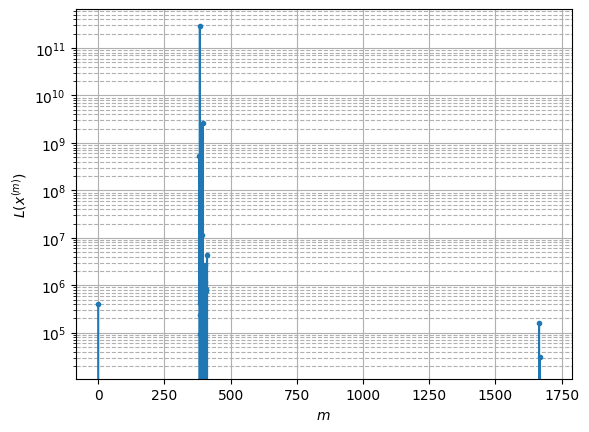

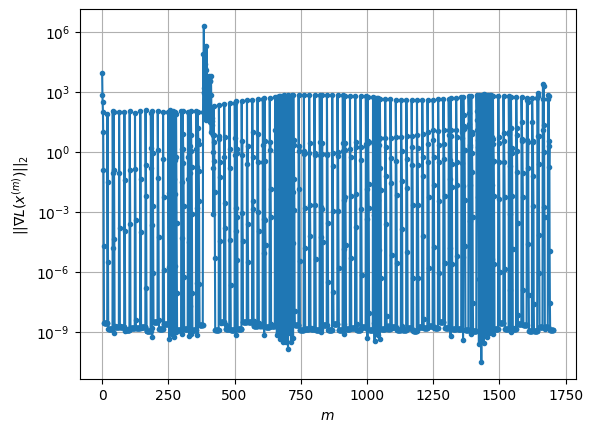

Windows:  29%|██▉       | 114/395 [01:12<03:16,  1.43it/s]

Before applying the algorithm
Cost function: -219820.31685487658
Gradient norm: 408.16550314748076
Global relative error: 146.9018967593605
Position relative errors: 0.9923756367135061 m, 20.05612473233517 m, 114.42580987517472 m, 89.86850320945506 m

Iteration 1
Cost function: -202137.9530529708 (8.04%)
Gradient norm: 655.6184083979514 (60.63%)
Global relative error: 2109.019453305455 (1335.67%)
Position relative errors: 0.23474916475130056 m, 453.27614312040737 m, 521.8007164906543 m, 1992.5411988647263 m

Iteration 2
Cost function: -234843.64840873392 (-16.18%)
Gradient norm: 2.734854697359734 (-99.58%)
Global relative error: 2044.8395647358502 (-3.04%)
Position relative errors: 0.23474916475130056 m, 419.87507182751995 m, 485.67746178609036 m, 1941.4385895733785 m

Iteration 3
Cost function: -211923.51974088608 (9.76%)
Gradient norm: 572.4419956724036 (20831.35%)
Global relative error: 159.18410701452044 (-92.22%)
Position relative errors: 0.23474916475130056 m, 27.555058596233234 

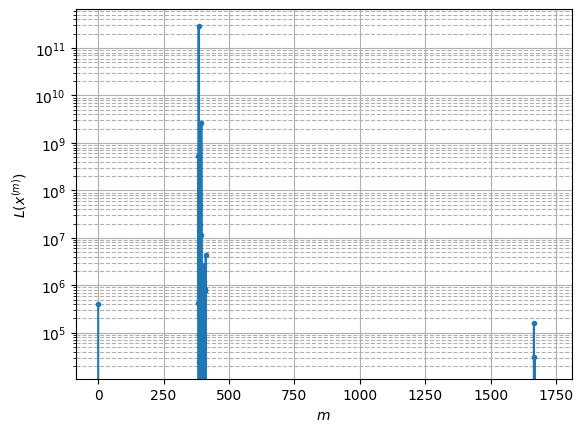

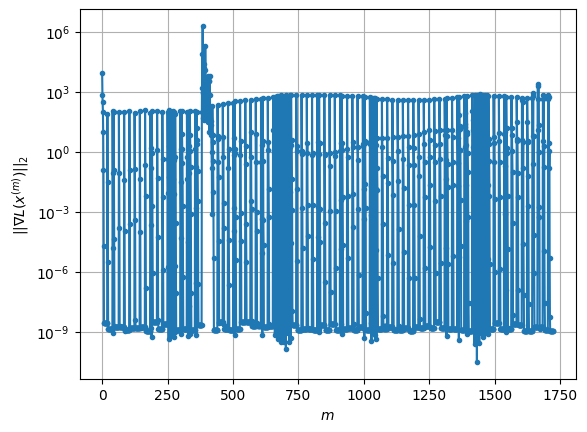

Windows:  29%|██▉       | 115/395 [01:13<03:10,  1.47it/s]

Before applying the algorithm
Cost function: -221100.90519051184
Gradient norm: 394.29959020835685
Global relative error: 160.96594507598084
Position relative errors: 1.2397807068300908 m, 17.801510799971172 m, 101.96123886172691 m, 123.24028984209302 m

Iteration 1
Cost function: -59400.87343378129 (73.13%)
Gradient norm: 1525.9689785827652 (287.01%)
Global relative error: 3129.7976576121246 (1844.38%)
Position relative errors: 0.17612174173930917 m, 581.9073938460589 m, 757.910750423296 m, 2980.3659313236853 m

Iteration 2
Cost function: -233211.97200204903 (-292.61%)
Gradient norm: 3.5640673929689997 (-99.77%)
Global relative error: 3053.2854619598693 (-2.44%)
Position relative errors: 0.17612174173930917 m, 547.5954695152483 m, 710.0248850640835 m, 2918.655273270907 m

Iteration 3
Cost function: -106100.7783711385 (54.50%)
Gradient norm: 1322.8101517102345 (37015.18%)
Global relative error: 268.1474156000634 (-91.22%)
Position relative errors: 0.17612174173930917 m, 48.099268323049

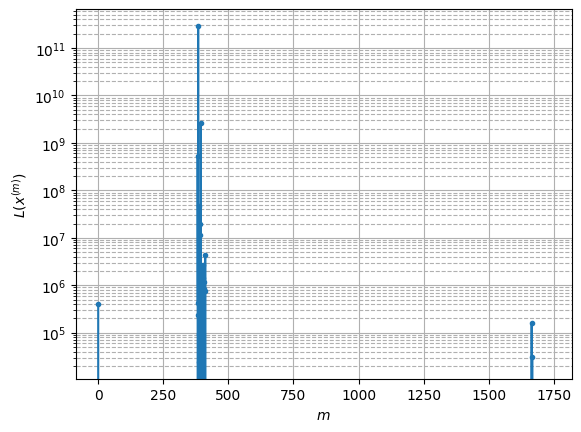

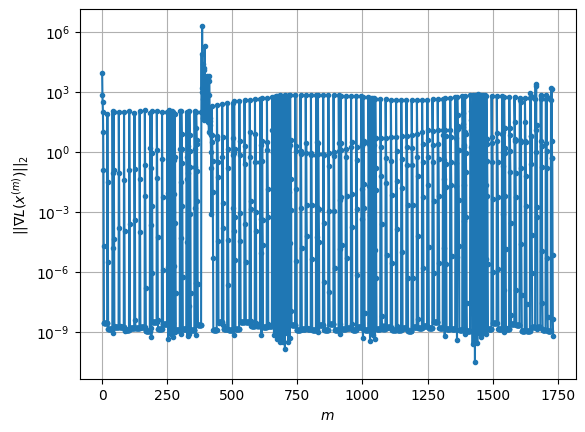

Windows:  29%|██▉       | 116/395 [01:14<03:09,  1.47it/s]

Before applying the algorithm
Cost function: -222089.02093743405
Gradient norm: 375.1551102385578
Global relative error: 125.51057370193216
Position relative errors: 0.9949054529772664 m, 28.016915972253862 m, 108.33455335282669 m, 56.77359960748597 m

Iteration 1
Cost function: -227789.91862511096 (-2.57%)
Gradient norm: 318.9967512567439 (-14.97%)
Global relative error: 1532.3088037147063 (1120.86%)
Position relative errors: 0.15654599988025109 m, 290.7601940188069 m, 355.0058627306971 m, 1461.9822990737403 m

Iteration 2
Cost function: -235645.02210108846 (-3.45%)
Gradient norm: 1.6357878581804648 (-99.49%)
Global relative error: 1447.516391806845 (-5.53%)
Position relative errors: 0.15654599988025109 m, 259.2481291993175 m, 324.986459746121 m, 1386.5318384011996 m

Iteration 3
Cost function: -230664.14641755098 (2.11%)
Gradient norm: 275.7230103236798 (16755.67%)
Global relative error: 139.00324985203747 (-90.40%)
Position relative errors: 0.15654599988025109 m, 30.786635628604472 

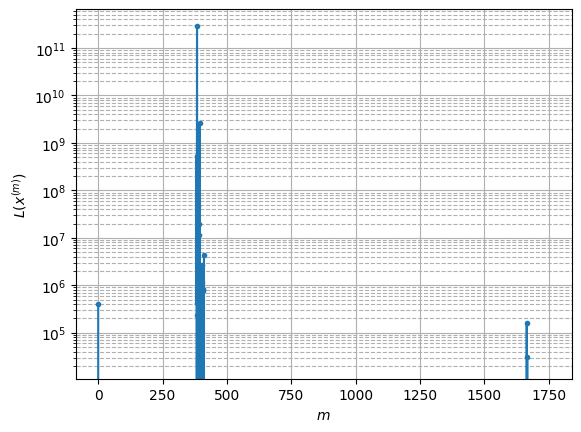

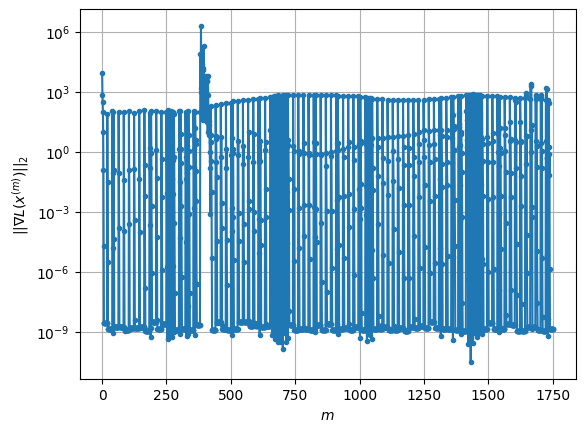

Windows:  30%|██▉       | 117/395 [01:14<03:16,  1.41it/s]

Before applying the algorithm
Cost function: -223404.601781224
Gradient norm: 358.39790901102526
Global relative error: 239.1201315606582
Position relative errors: 1.032184709565384 m, 34.39513776509882 m, 100.76266717142907 m, 214.08844076082397 m

Iteration 1
Cost function: -236161.47354124233 (-5.71%)
Gradient norm: 38.734969643464794 (-89.19%)
Global relative error: 525.9993094639084 (119.97%)
Position relative errors: 0.09414841144197975 m, 62.3976596798351 m, 133.1027020596781 m, 505.0327678635776 m

Iteration 2
Cost function: -236313.4244817759 (-0.06%)
Gradient norm: 2.591732725862284 (-93.31%)
Global relative error: 389.6554623114347 (-25.92%)
Position relative errors: 0.09414841144197975 m, 45.42473450957008 m, 94.03254479246942 m, 375.39109421011995 m

Iteration 3
Cost function: -236338.7854841423 (-0.01%)
Gradient norm: 12.932736440880046 (399.00%)
Global relative error: 83.6419254891366 (-78.53%)
Position relative errors: 0.09414841144197975 m, 6.628461422255893 m, 22.9904

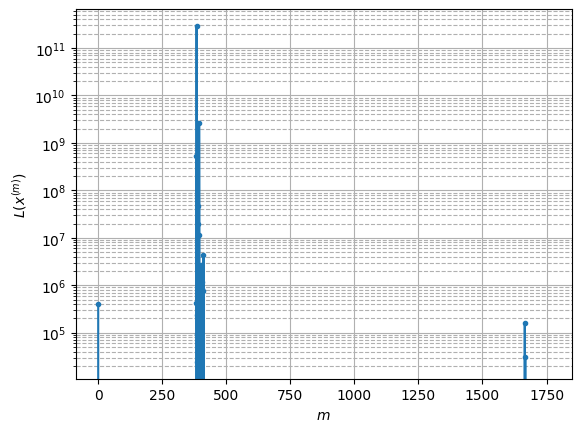

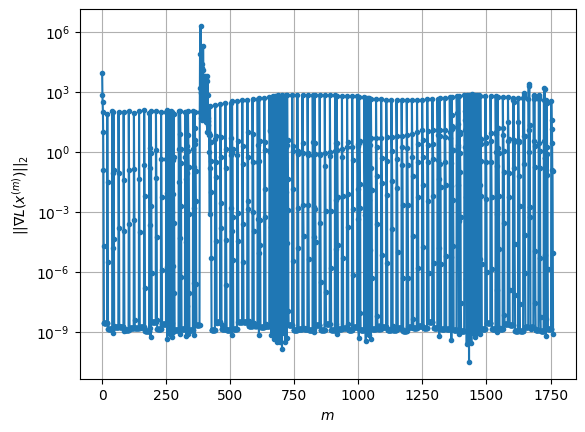

Windows:  30%|██▉       | 118/395 [01:15<03:02,  1.52it/s]

Before applying the algorithm
Cost function: -224440.2605246746
Gradient norm: 339.77242777804076
Global relative error: 162.16787071838706
Position relative errors: 0.995169244735831 m, 16.928015656904176 m, 123.33003871931098 m, 103.89019619171862 m

Iteration 1
Cost function: -235758.11435898612 (-5.04%)
Gradient norm: 75.08862009243396 (-77.90%)
Global relative error: 718.3058984078917 (342.94%)
Position relative errors: 0.10459581421714965 m, 81.97247318855052 m, 187.69840607634936 m, 688.4807737626852 m

Iteration 2
Cost function: -236243.79670978745 (-0.21%)
Gradient norm: 2.4171089133600443 (-96.78%)
Global relative error: 600.6544863021504 (-16.38%)
Position relative errors: 0.10459581421714965 m, 71.52725948942567 m, 143.09044310105654 m, 578.953692721208 m

Iteration 3
Cost function: -236239.92004100734 (0.00%)
Gradient norm: 39.49685551108989 (1534.05%)
Global relative error: 71.61166379681016 (-88.08%)
Position relative errors: 0.10459581421714965 m, 8.027851879647525 m, 1

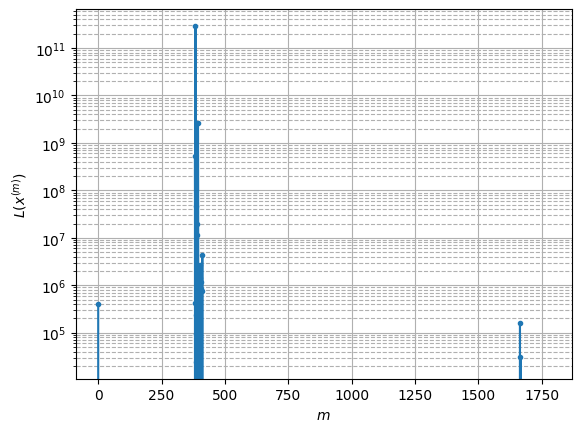

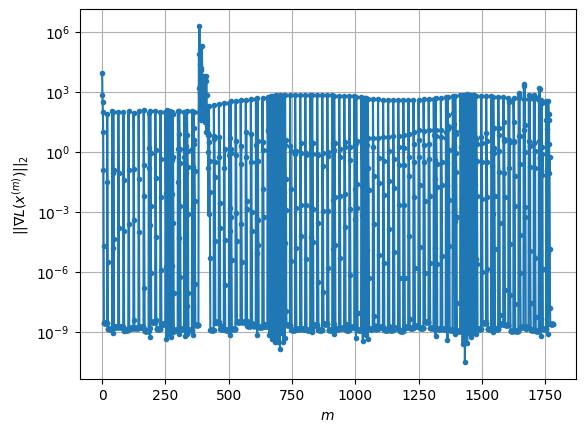

Windows:  30%|███       | 119/395 [01:16<03:15,  1.41it/s]

Before applying the algorithm
Cost function: -225560.5675938456
Gradient norm: 331.08950652853775
Global relative error: 190.42382389100104
Position relative errors: 1.0949731121919115 m, 12.817709125898798 m, 117.16647152654775 m, 149.53363198362382 m

Iteration 1
Cost function: -236338.5998707724 (-4.78%)
Gradient norm: 1.2430893351253682 (-99.62%)
Global relative error: 119.89915600871576 (-37.04%)
Position relative errors: 0.10433834283082812 m, 30.918249388896523 m, 85.25088610380674 m, 78.38809903697832 m

Iteration 2
Cost function: -236353.74774328136 (-0.01%)
Gradient norm: 3.566375685978523 (186.90%)
Global relative error: 109.12244627088829 (-8.99%)
Position relative errors: 0.10433834283082812 m, 15.42159217059445 m, 24.388270350578352 m, 105.2028194972019 m

Iteration 3
Cost function: -236355.04926124337 (-0.00%)
Gradient norm: 0.009853675645635638 (-99.72%)
Global relative error: 116.84838072021138 (7.08%)
Position relative errors: 0.10433834283082812 m, 15.58240681450301 

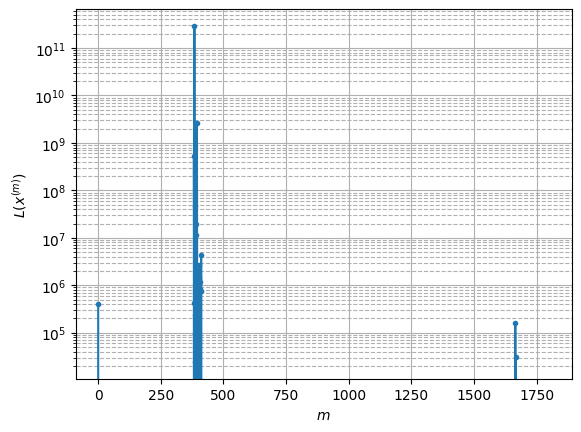

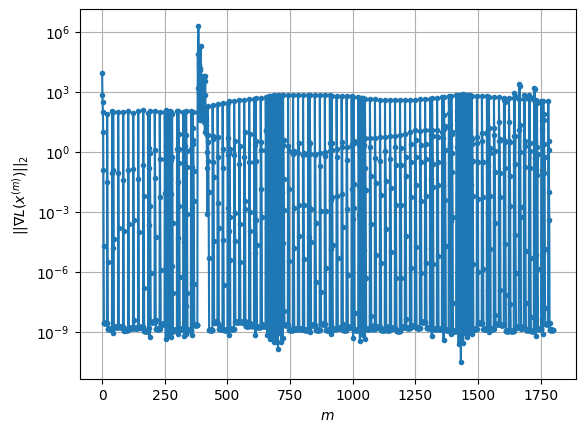

Windows:  30%|███       | 120/395 [01:16<03:10,  1.44it/s]

Before applying the algorithm
Cost function: -226247.22382141702
Gradient norm: 332.8210095695018
Global relative error: 235.1885203266882
Position relative errors: 1.154613293322685 m, 13.504273413069516 m, 129.68681114085805 m, 195.7133949742098 m

Iteration 1
Cost function: -236326.76308602694 (-4.46%)
Gradient norm: 0.7867502133737546 (-99.76%)
Global relative error: 246.1984043156742 (4.68%)
Position relative errors: 0.15480152954534626 m, 50.82521693154432 m, 107.82798258321552 m, 215.39734031551205 m

Iteration 2
Cost function: -236349.87428014918 (-0.01%)
Gradient norm: 5.358505964507098 (581.09%)
Global relative error: 44.013256000097805 (-82.12%)
Position relative errors: 0.15480152954534626 m, 6.537918050989801 m, 9.803927123845673 m, 42.317156990470906 m

Iteration 3
Cost function: -236352.58802991107 (-0.00%)
Gradient norm: 0.0027044967211451477 (-99.95%)
Global relative error: 40.4466556871766 (-8.10%)
Position relative errors: 0.15480152954534626 m, 5.7441136069288925 m,

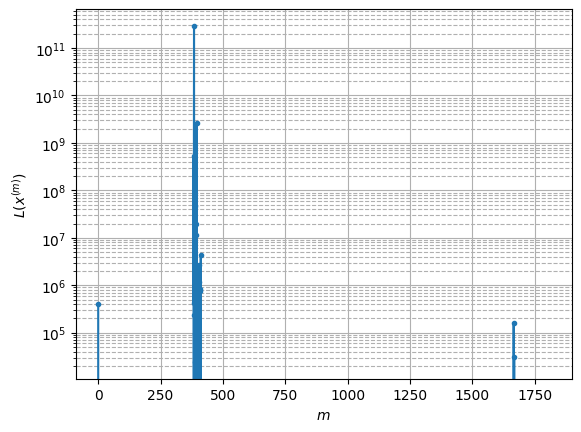

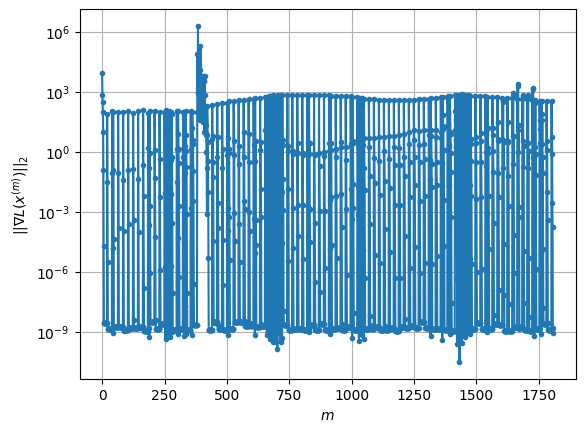

Windows:  31%|███       | 121/395 [01:17<03:05,  1.48it/s]

Before applying the algorithm
Cost function: -226590.65004775778
Gradient norm: 321.02136238316865
Global relative error: 190.0789127255704
Position relative errors: 1.0129869072268811 m, 11.085666501093474 m, 122.40529714612921 m, 144.96692975034776 m

Iteration 1
Cost function: -236330.47682230806 (-4.30%)
Gradient norm: 0.7238865617129217 (-99.77%)
Global relative error: 214.57655695360387 (12.89%)
Position relative errors: 0.1056825236436101 m, 43.55254914706417 m, 106.81670815912427 m, 180.91115642241513 m

Iteration 2
Cost function: -236349.7814409728 (-0.01%)
Gradient norm: 4.273200956807366 (490.31%)
Global relative error: 66.49752223689315 (-69.01%)
Position relative errors: 0.1056825236436101 m, 10.52507360884644 m, 12.338898782128075 m, 64.43039864233486 m

Iteration 3
Cost function: -236351.66769697564 (-0.00%)
Gradient norm: 0.002181860988308496 (-99.95%)
Global relative error: 63.25159944963381 (-4.88%)
Position relative errors: 0.1056825236436101 m, 9.746829341579078 m, 

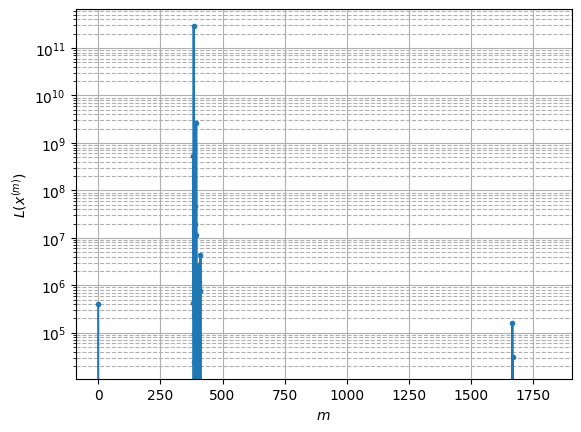

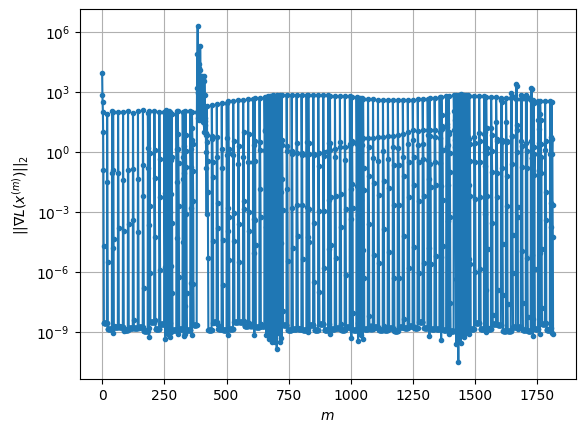

Windows:  31%|███       | 122/395 [01:18<03:03,  1.48it/s]

Before applying the algorithm
Cost function: -227196.95316122135
Gradient norm: 320.8005464982217
Global relative error: 213.28892637138674
Position relative errors: 1.0885881887895335 m, 9.28740136142732 m, 125.77486869186022 m, 171.98172418779012 m

Iteration 1
Cost function: -236325.41817575335 (-4.02%)
Gradient norm: 0.7371910275150252 (-99.77%)
Global relative error: 239.11419112545528 (12.11%)
Position relative errors: 0.10023545709755281 m, 45.30505569877499 m, 112.35402133192243 m, 206.13567850763897 m

Iteration 2
Cost function: -236352.20233047399 (-0.01%)
Gradient norm: 6.281364788850775 (752.07%)
Global relative error: 41.22657331189841 (-82.76%)
Position relative errors: 0.10023545709755281 m, 1.6123339588890981 m, 3.4943425832214365 m, 40.95260716614413 m

Iteration 3
Cost function: -236356.0292716649 (-0.00%)
Gradient norm: 0.0027341788363345687 (-99.96%)
Global relative error: 39.596072464211154 (-3.95%)
Position relative errors: 0.10023545709755281 m, 1.787058260649214

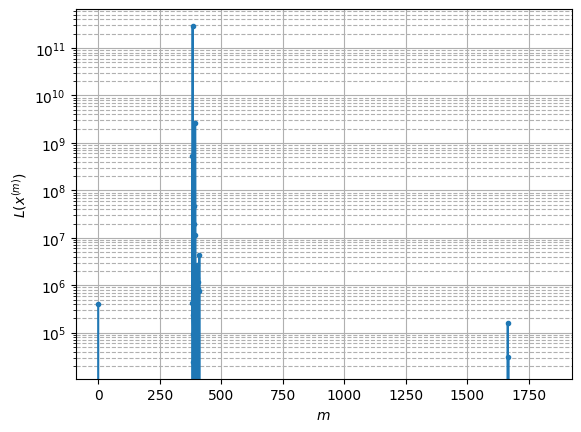

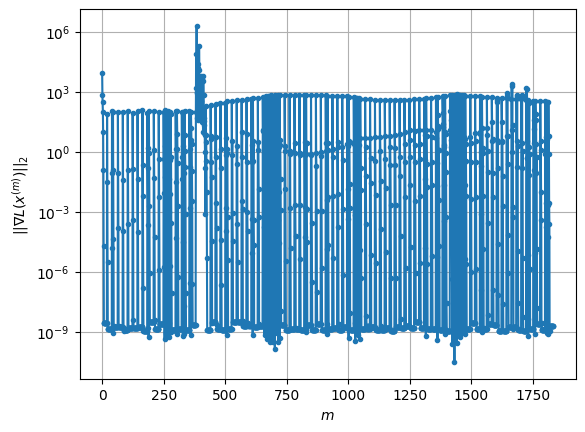

Windows:  31%|███       | 123/395 [01:18<03:07,  1.45it/s]

Before applying the algorithm
Cost function: -227419.91029722188
Gradient norm: 328.9501696660299
Global relative error: 186.5103853905401
Position relative errors: 1.1307508126363635 m, 16.110365225730224 m, 114.39076325701878 m, 146.39773700906355 m

Iteration 1
Cost function: -236344.354378458 (-3.92%)
Gradient norm: 0.6691732614656907 (-99.80%)
Global relative error: 208.72143913185653 (11.91%)
Position relative errors: 0.07172130579116694 m, 32.67717140978728 m, 110.39791556502664 m, 174.0729141577097 m

Iteration 2
Cost function: -236361.00726236778 (-0.01%)
Gradient norm: 3.8179184955810035 (470.54%)
Global relative error: 76.36350516060321 (-63.41%)
Position relative errors: 0.07172130579116694 m, 8.175259600153758 m, 15.585227869718445 m, 74.25556077267159 m

Iteration 3
Cost function: -236362.48960734895 (-0.00%)
Gradient norm: 0.0005884340026645899 (-99.98%)
Global relative error: 74.40151865459657 (-2.57%)
Position relative errors: 0.07172130579116694 m, 7.747845901043061 m

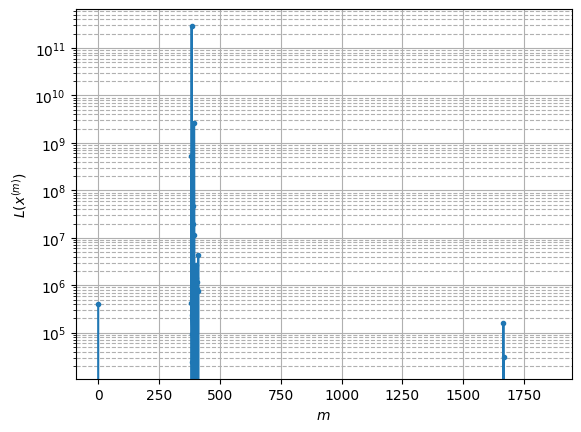

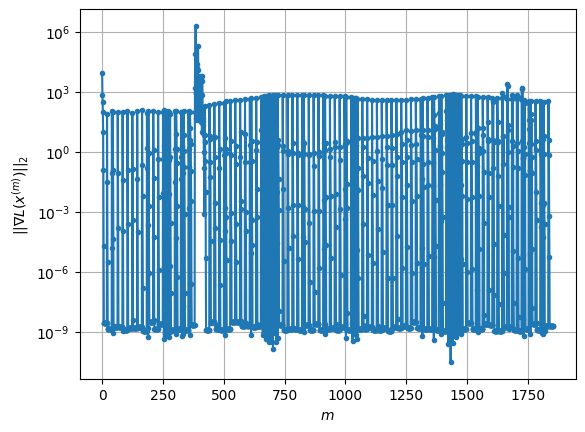

Windows:  31%|███▏      | 124/395 [01:19<02:59,  1.51it/s]

Before applying the algorithm
Cost function: -227174.3950233483
Gradient norm: 340.60801955115124
Global relative error: 230.6159502218528
Position relative errors: 1.0126385858744122 m, 9.141337756567959 m, 132.1470075257312 m, 188.75496046754836 m

Iteration 1
Cost function: -236319.3483878107 (-4.03%)
Gradient norm: 0.9310382500890709 (-99.73%)
Global relative error: 258.286392810166 (12.00%)
Position relative errors: 0.11731425670310411 m, 42.7738421708204 m, 131.39654660284748 m, 218.19562921908542 m

Iteration 2
Cost function: -236352.7448969446 (-0.01%)
Gradient norm: 8.083450534886778 (768.22%)
Global relative error: 85.98586016121249 (-66.71%)
Position relative errors: 0.11731425670310411 m, 10.263188358521298 m, 11.124937528328097 m, 84.59667138845137 m

Iteration 3
Cost function: -236359.58856406418 (-0.00%)
Gradient norm: 0.004016063877463986 (-99.95%)
Global relative error: 86.67674220385703 (0.80%)
Position relative errors: 0.11731425670310411 m, 10.413334458363957 m, 11.

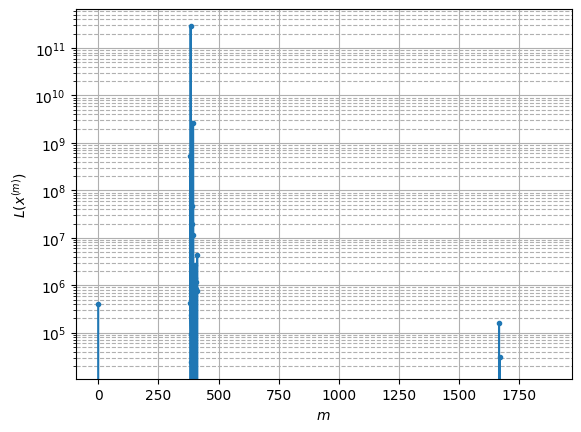

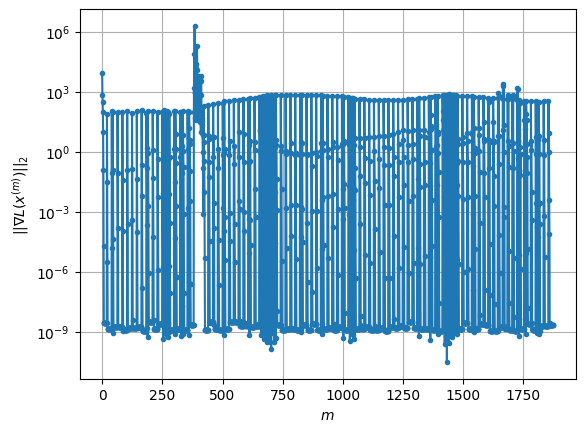

Windows:  32%|███▏      | 125/395 [01:20<03:04,  1.46it/s]

Before applying the algorithm
Cost function: -226916.2726006286
Gradient norm: 333.67159673049093
Global relative error: 230.391224041239
Position relative errors: 0.9473984181630528 m, 12.57243388001116 m, 110.20064870236945 m, 201.9133763589499 m

Iteration 1
Cost function: -236332.45333877485 (-4.15%)
Gradient norm: 0.775550384718896 (-99.77%)
Global relative error: 264.4422826446713 (14.78%)
Position relative errors: 0.33281364406467373 m, 33.662450308246065 m, 117.13957171599516 m, 234.6631891288964 m

Iteration 2
Cost function: -236353.71641247737 (-0.01%)
Gradient norm: 5.934193298108018 (665.16%)
Global relative error: 61.22192683170579 (-76.85%)
Position relative errors: 0.33281364406467373 m, 12.418267794318222 m, 9.011848640301194 m, 59.199905730004275 m

Iteration 3
Cost function: -236356.8846937799 (-0.00%)
Gradient norm: 0.0009839036647567828 (-99.98%)
Global relative error: 59.66472699343521 (-2.54%)
Position relative errors: 0.33281364406467373 m, 12.016698257679703 m, 

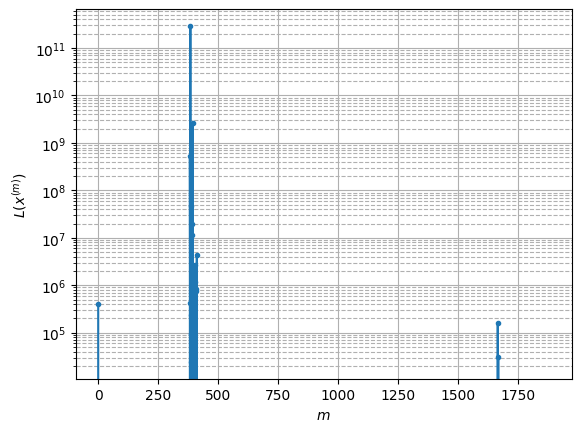

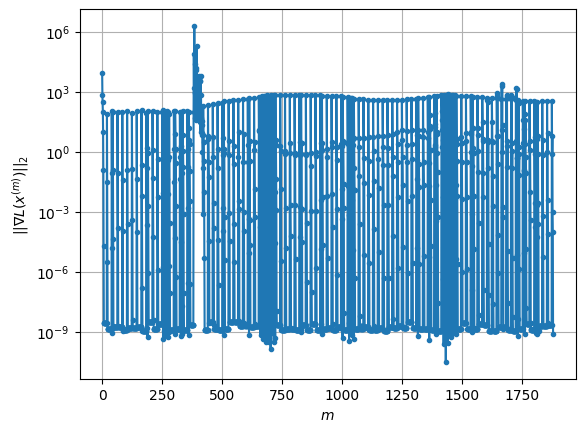

Windows:  32%|███▏      | 126/395 [01:20<02:59,  1.50it/s]

Before applying the algorithm
Cost function: -226458.76930354844
Gradient norm: 378.2894324980738
Global relative error: 201.15199157777053
Position relative errors: 1.3268667414504265 m, 10.381582470143716 m, 119.2167646501568 m, 161.6536377744293 m

Iteration 1
Cost function: -236337.15053798436 (-4.36%)
Gradient norm: 0.6975297820214762 (-99.82%)
Global relative error: 225.17447141266223 (11.94%)
Position relative errors: 0.15967788543519265 m, 31.929510526472917 m, 116.41112433758701 m, 190.06426087124117 m

Iteration 2
Cost function: -236356.51729084871 (-0.01%)
Gradient norm: 5.326298541426319 (663.59%)
Global relative error: 17.11068888216478 (-92.40%)
Position relative errors: 0.15967788543519265 m, 1.3757778516039485 m, 8.809574082345012 m, 14.32475166883245 m

Iteration 3
Cost function: -236359.04546388146 (-0.00%)
Gradient norm: 0.0013887734268293642 (-99.97%)
Global relative error: 19.728068228317497 (15.30%)
Position relative errors: 0.15967788543519265 m, 1.77485666755509

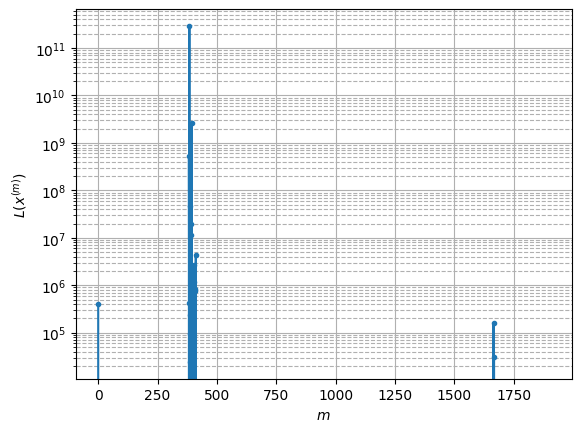

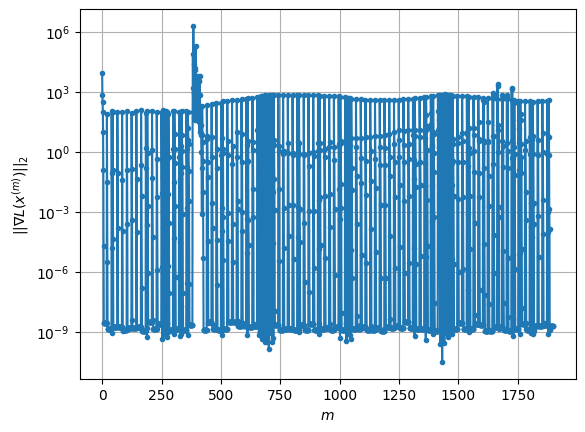

Windows:  32%|███▏      | 127/395 [01:21<02:57,  1.51it/s]

Before applying the algorithm
Cost function: -226447.77387474582
Gradient norm: 362.71045692284946
Global relative error: 164.5203233703901
Position relative errors: 1.026668577673759 m, 17.015916608821804 m, 126.59823455565605 m, 103.63938201349387 m

Iteration 1
Cost function: -236328.08848009125 (-4.36%)
Gradient norm: 0.8761575577963745 (-99.76%)
Global relative error: 184.29632343260144 (12.02%)
Position relative errors: 0.21134238806662078 m, 35.520499634045194 m, 131.64904600026628 m, 123.95082137442037 m

Iteration 2
Cost function: -236355.21076279637 (-0.01%)
Gradient norm: 7.352688308767113 (739.20%)
Global relative error: 52.014057671198415 (-71.78%)
Position relative errors: 0.21134238806662078 m, 6.068161140072632 m, 12.578867574265656 m, 50.02259691381141 m

Iteration 3
Cost function: -236360.44755033072 (-0.00%)
Gradient norm: 0.0025590516074111996 (-99.97%)
Global relative error: 55.62076495886278 (6.93%)
Position relative errors: 0.21134238806662078 m, 6.62480286693357

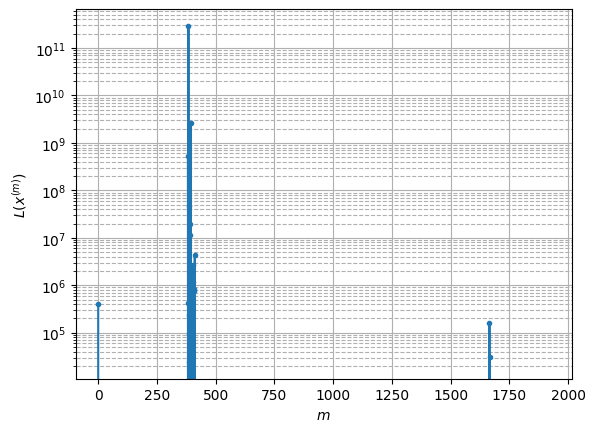

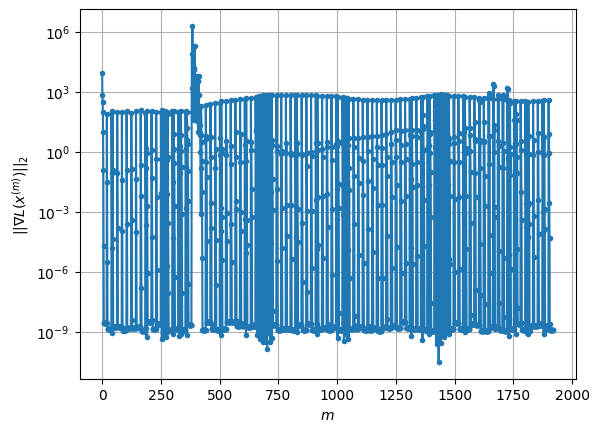

Windows:  32%|███▏      | 128/395 [01:22<02:58,  1.49it/s]

Before applying the algorithm
Cost function: -225534.25573940433
Gradient norm: 400.0714508938347
Global relative error: 136.46240009964617
Position relative errors: 1.22539259663108 m, 22.386964742789658 m, 111.4136811069477 m, 75.48620087725655 m

Iteration 1
Cost function: -236342.18107554322 (-4.79%)
Gradient norm: 0.9595421332662472 (-99.76%)
Global relative error: 165.60010462128943 (21.35%)
Position relative errors: 0.1617019882610875 m, 27.721489734188616 m, 130.35315947077567 m, 98.25887910560472 m

Iteration 2
Cost function: -236359.86762517266 (-0.01%)
Gradient norm: 5.320771806168738 (454.51%)
Global relative error: 118.58035813543427 (-28.39%)
Position relative errors: 0.1617019882610875 m, 2.830954601767834 m, 21.962938241908248 m, 116.45924705645626 m

Iteration 3
Cost function: -236362.31214342697 (-0.00%)
Gradient norm: 0.002061875184322893 (-99.96%)
Global relative error: 122.68698829590804 (3.46%)
Position relative errors: 0.1617019882610875 m, 2.2773669176082545 m, 

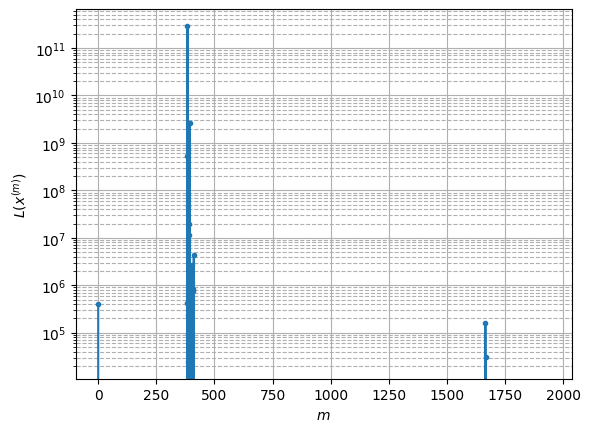

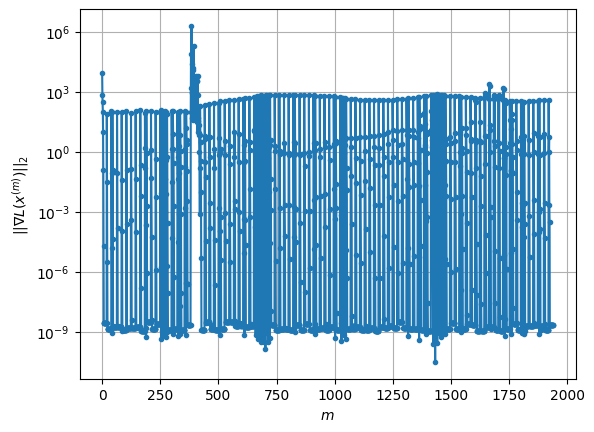

Windows:  33%|███▎      | 129/395 [01:22<03:01,  1.46it/s]

Before applying the algorithm
Cost function: -224948.14646908198
Gradient norm: 401.5487307971864
Global relative error: 144.0142273741611
Position relative errors: 1.0168050421968802 m, 14.894256418981358 m, 135.35317206568755 m, 46.782594203787255 m

Iteration 1
Cost function: -236329.10522149794 (-5.06%)
Gradient norm: 0.8419307949506692 (-99.79%)
Global relative error: 138.52376073395894 (-3.81%)
Position relative errors: 0.21523625080878148 m, 32.609031489655756 m, 133.83855624460602 m, 14.301932672649189 m

Iteration 2
Cost function: -236351.53060735966 (-0.01%)
Gradient norm: 5.755534157800686 (583.61%)
Global relative error: 53.70927111166579 (-61.23%)
Position relative errors: 0.21523625080878148 m, 0.7789848090528916 m, 12.718804842714997 m, 52.09733248463336 m

Iteration 3
Cost function: -236356.37379591295 (-0.00%)
Gradient norm: 0.02133316206466743 (-99.63%)
Global relative error: 54.174688522160636 (0.87%)
Position relative errors: 0.21523625080878148 m, 1.823526983471096

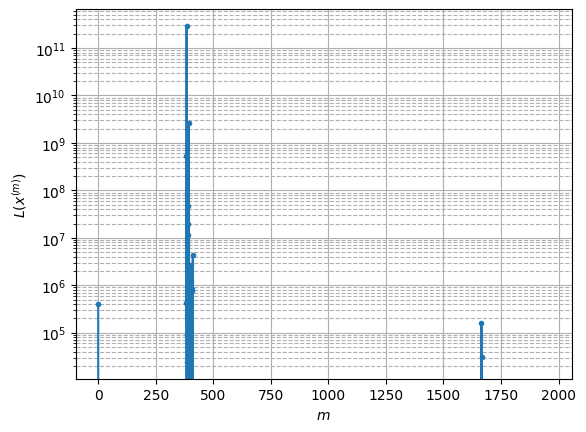

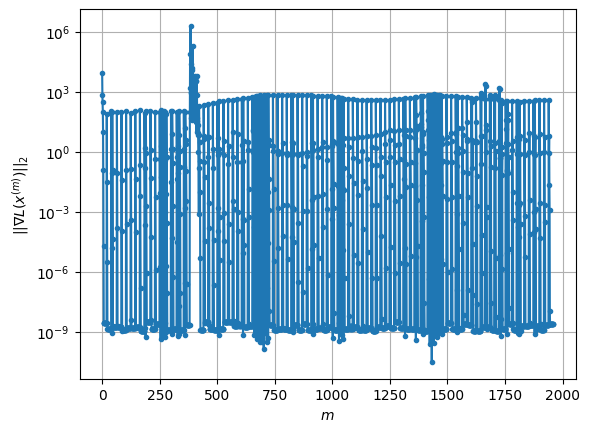

Windows:  33%|███▎      | 130/395 [01:23<03:01,  1.46it/s]

Before applying the algorithm
Cost function: -223578.0346875953
Gradient norm: 419.7446922822103
Global relative error: 183.83393045903426
Position relative errors: 1.006220291974164 m, 17.871780315825482 m, 127.1127899872256 m, 131.56236552342455 m

Iteration 1
Cost function: -236319.1223924883 (-5.70%)
Gradient norm: 0.8809287994603607 (-99.79%)
Global relative error: 197.7186005810942 (7.55%)
Position relative errors: 0.20935097272938274 m, 23.927664121498793 m, 141.1036602775092 m, 136.38783507800926 m

Iteration 2
Cost function: -236346.721467718 (-0.01%)
Gradient norm: 9.904834286371992 (1024.36%)
Global relative error: 70.65924748567294 (-64.26%)
Position relative errors: 0.20935097272938274 m, 4.198150842667607 m, 38.423812776899105 m, 59.08035199600263 m

Iteration 3
Cost function: -236357.56351484003 (-0.00%)
Gradient norm: 0.04525406191262742 (-99.54%)
Global relative error: 55.42343229608158 (-21.56%)
Position relative errors: 0.20935097272938274 m, 2.752028493112068 m, 35.

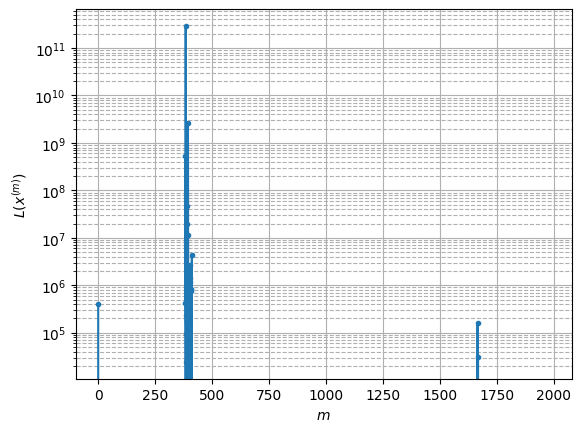

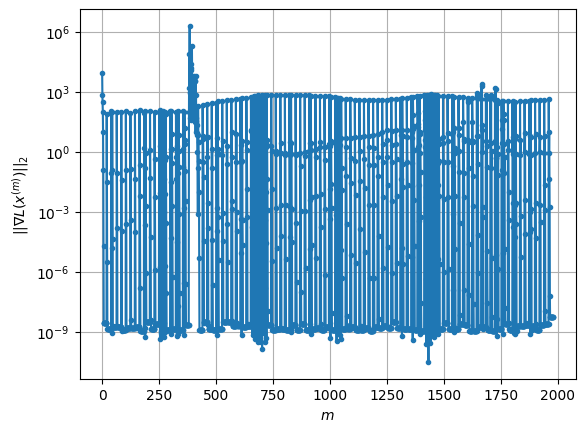

Windows:  33%|███▎      | 131/395 [01:24<03:03,  1.44it/s]

Before applying the algorithm
Cost function: -221689.2432053962
Gradient norm: 450.67046881959686
Global relative error: 182.72725132177854
Position relative errors: 1.1395293486231763 m, 16.779627146962408 m, 94.97834056876643 m, 155.16849262196004 m

Iteration 1
Cost function: -236346.85477802716 (-6.61%)
Gradient norm: 1.183496023500794 (-99.74%)
Global relative error: 213.18674526650346 (16.67%)
Position relative errors: 0.2883172684678051 m, 35.99977763507762 m, 110.41702381636279 m, 178.75221512116255 m

Iteration 2
Cost function: -236355.36753590027 (-0.00%)
Gradient norm: 3.0421097443715586 (157.04%)
Global relative error: 90.06863430568785 (-57.75%)
Position relative errors: 0.2883172684678051 m, 15.383386645653992 m, 48.58785412220283 m, 74.20646821158672 m

Iteration 3
Cost function: -236356.12233266732 (-0.00%)
Gradient norm: 0.0014021034946784775 (-99.95%)
Global relative error: 90.06986520872982 (0.00%)
Position relative errors: 0.2883172684678051 m, 14.797240456428696 m,

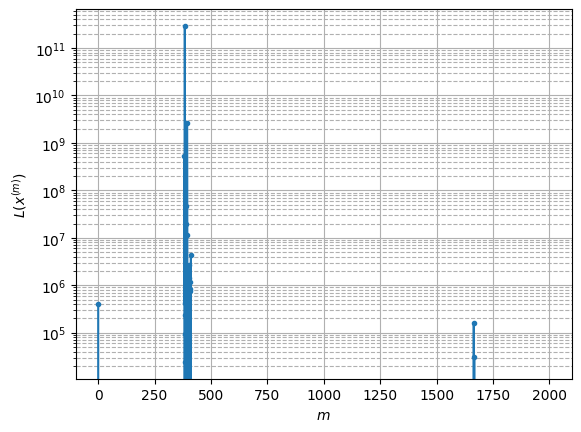

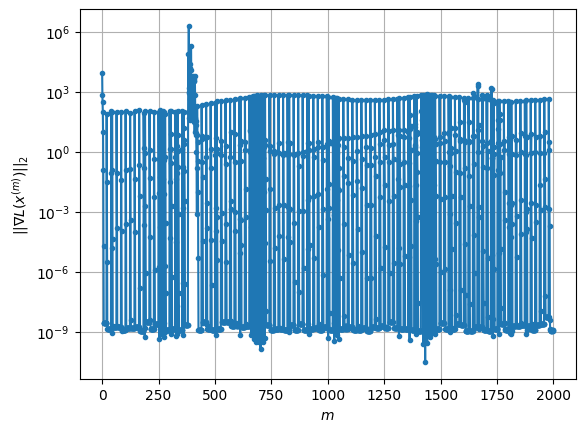

Windows:  33%|███▎      | 132/395 [01:24<02:58,  1.47it/s]

Before applying the algorithm
Cost function: -220562.54100608238
Gradient norm: 474.73840723682406
Global relative error: 219.17502198076477
Position relative errors: 1.0548736476876497 m, 9.565028546613982 m, 164.07950689139858 m, 144.9644690011185 m

Iteration 1
Cost function: -236328.22890133815 (-7.15%)
Gradient norm: 1.3522010658671344 (-99.72%)
Global relative error: 205.12488654033595 (-6.41%)
Position relative errors: 0.12343370329218877 m, 11.104711609120606 m, 145.26087994533117 m, 144.37402849416893 m

Iteration 2
Cost function: -236347.99117980944 (-0.01%)
Gradient norm: 9.057321190088343 (569.82%)
Global relative error: 93.23772795601961 (-54.55%)
Position relative errors: 0.12343370329218877 m, 12.553117274590084 m, 22.663679561040823 m, 89.51943742958093 m

Iteration 3
Cost function: -236357.17159036238 (-0.00%)
Gradient norm: 0.19469553315024124 (-97.85%)
Global relative error: 85.97866633995875 (-7.79%)
Position relative errors: 0.12343370329218877 m, 14.42243821259244

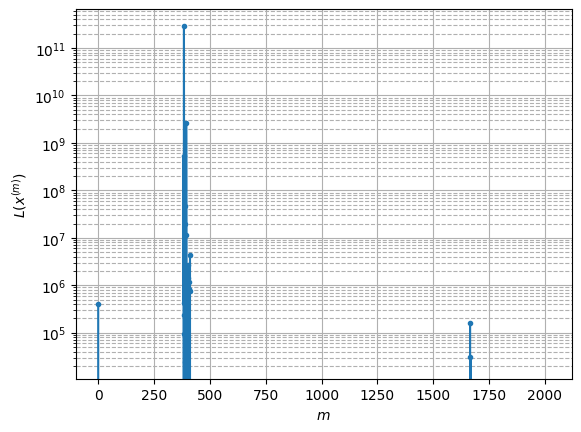

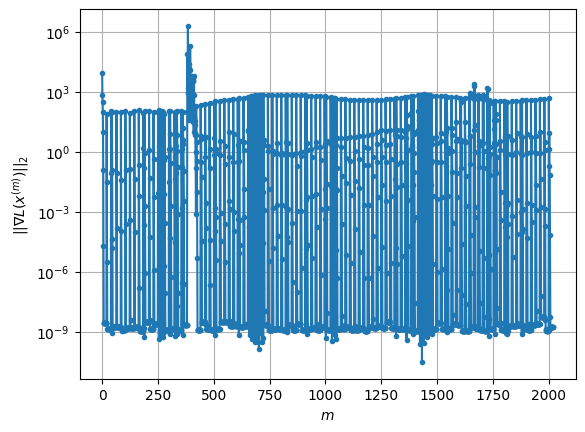

Windows:  34%|███▎      | 133/395 [01:25<02:56,  1.48it/s]

Before applying the algorithm
Cost function: -219189.26992855407
Gradient norm: 491.2144206573941
Global relative error: 184.87778578221318
Position relative errors: 1.119214792063828 m, 29.10128964782124 m, 126.44540877221036 m, 131.66188529355384 m

Iteration 1
Cost function: -236303.51137051426 (-7.81%)
Gradient norm: 5.216431838015349 (-98.94%)
Global relative error: 279.2530481180571 (51.05%)
Position relative errors: 0.2907042022326453 m, 88.5970227522936 m, 202.30462520617985 m, 170.87194625718098 m

Iteration 2
Cost function: -236346.73774044734 (-0.02%)
Gradient norm: 8.752541766940702 (67.79%)
Global relative error: 61.10608854860278 (-78.12%)
Position relative errors: 0.2907042022326453 m, 32.40616825456653 m, 8.063781486923384 m, 51.09129769121011 m

Iteration 3
Cost function: -236358.236182903 (-0.00%)
Gradient norm: 1.0229284688499352 (-88.31%)
Global relative error: 51.7427327110515 (-15.32%)
Position relative errors: 0.2907042022326453 m, 19.835306136400078 m, 4.3505367

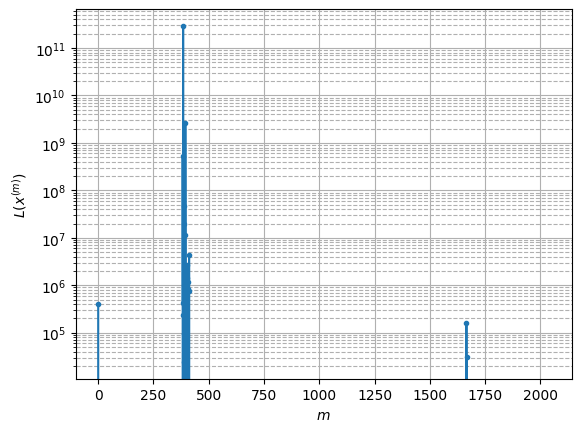

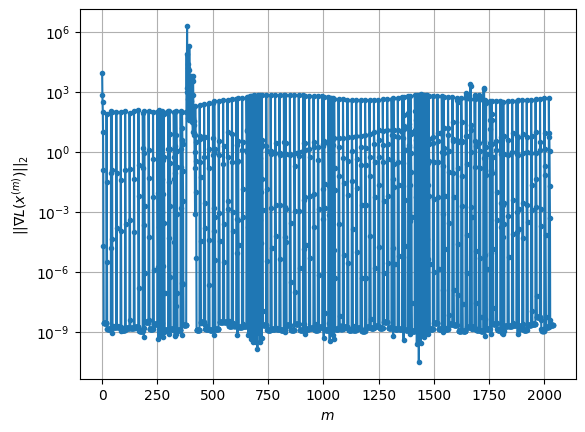

Windows:  34%|███▍      | 134/395 [01:26<02:57,  1.47it/s]

Before applying the algorithm
Cost function: -217870.43239519018
Gradient norm: 509.5690272323174
Global relative error: 150.18856563740906
Position relative errors: 0.9101406663335853 m, 13.181599542200548 m, 125.74759761446862 m, 81.00113740639033 m

Iteration 1
Cost function: -236327.2290435864 (-8.47%)
Gradient norm: 2.0960854484655367 (-99.59%)
Global relative error: 99.08392466406046 (-34.03%)
Position relative errors: 0.15179833631590356 m, 31.311761471966147 m, 74.44667596761184 m, 57.32789335249263 m

Iteration 2
Cost function: -236333.69716272812 (-0.00%)
Gradient norm: 9.26337432361195 (341.94%)
Global relative error: 139.21898944706814 (40.51%)
Position relative errors: 0.15179833631590356 m, 11.97380464021735 m, 90.05372083070293 m, 105.45368456413456 m

Iteration 3
Cost function: -236353.54494288113 (-0.01%)
Gradient norm: 0.9756519556623292 (-89.47%)
Global relative error: 64.49557941440068 (-53.67%)
Position relative errors: 0.15179833631590356 m, 11.074697455570302 m, 

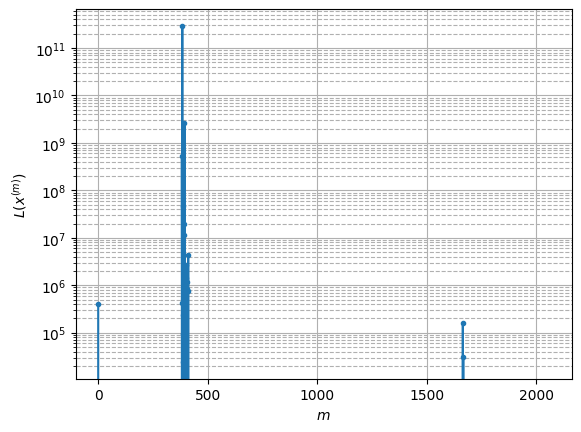

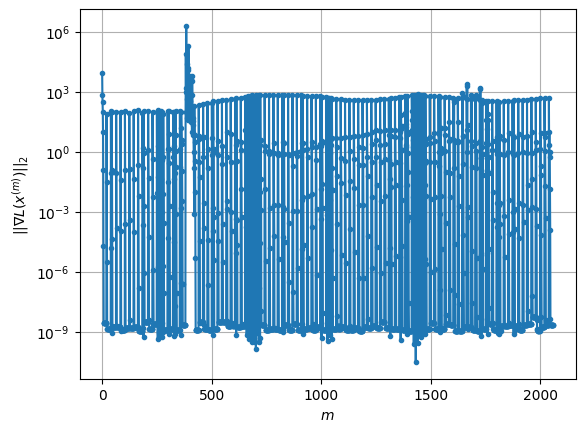

Windows:  34%|███▍      | 135/395 [01:26<02:55,  1.48it/s]

Before applying the algorithm
Cost function: -216616.88712157248
Gradient norm: 517.5494381293689
Global relative error: 143.4057855138315
Position relative errors: 0.9306530791027248 m, 25.35526690592981 m, 102.32033343878517 m, 97.17832882594682 m

Iteration 1
Cost function: -236333.3467058713 (-9.10%)
Gradient norm: 2.7514729282587584 (-99.47%)
Global relative error: 135.80325042715674 (-5.30%)
Position relative errors: 0.08309882248274277 m, 5.626303451960657 m, 68.53532222865837 m, 117.06999966797962 m

Iteration 2
Cost function: -236355.13806073985 (-0.01%)
Gradient norm: 3.222128367712536 (17.11%)
Global relative error: 90.15000050977355 (-33.62%)
Position relative errors: 0.08309882248274277 m, 15.204588555396379 m, 27.714246121306225 m, 84.37636706981537 m

Iteration 3
Cost function: -236359.63134318963 (-0.00%)
Gradient norm: 0.804709155698219 (-75.03%)
Global relative error: 53.76110928789567 (-40.36%)
Position relative errors: 0.08309882248274277 m, 13.384477116612764 m, 17

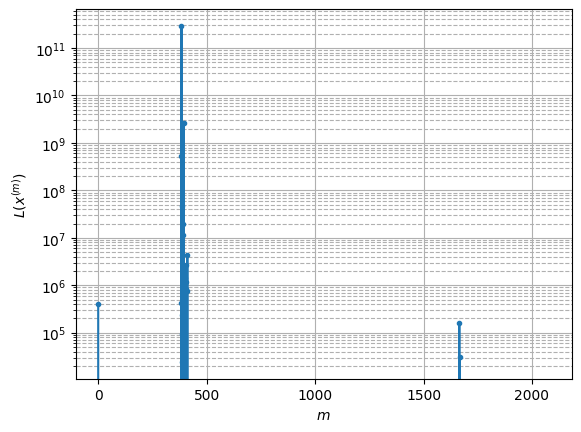

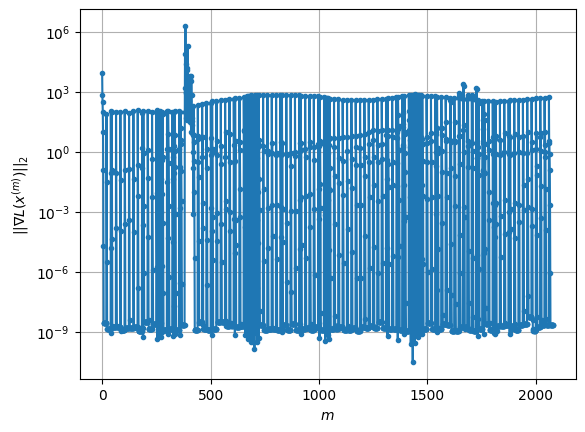

Windows:  34%|███▍      | 136/395 [01:27<02:51,  1.51it/s]

Before applying the algorithm
Cost function: -214776.09879236575
Gradient norm: 540.0476343524101
Global relative error: 166.83627302206054
Position relative errors: 1.0555980164079177 m, 26.89786797289154 m, 131.0271909875525 m, 99.66542023598241 m

Iteration 1
Cost function: -236276.81328516843 (-10.01%)
Gradient norm: 4.650356521975001 (-99.14%)
Global relative error: 175.4131229252561 (5.14%)
Position relative errors: 0.08783978032180499 m, 12.406626790810872 m, 113.55369909143529 m, 133.09010998027105 m

Iteration 2
Cost function: 534222.8577631358 (326.10%)
Gradient norm: 2560.7970631446174 (54966.68%)
Global relative error: 4146.505130858871 (2263.85%)
Position relative errors: 0.08783978032180499 m, 302.28393535838114 m, 2033.3037583965584 m, 3601.0827023826423 m

Iteration 3
Cost function: -171226.8109939677 (-132.05%)
Gradient norm: 245.120343735694 (-90.43%)
Global relative error: 3955.836010892146 (-4.60%)
Position relative errors: 0.08783978032180499 m, 244.87213723309577 

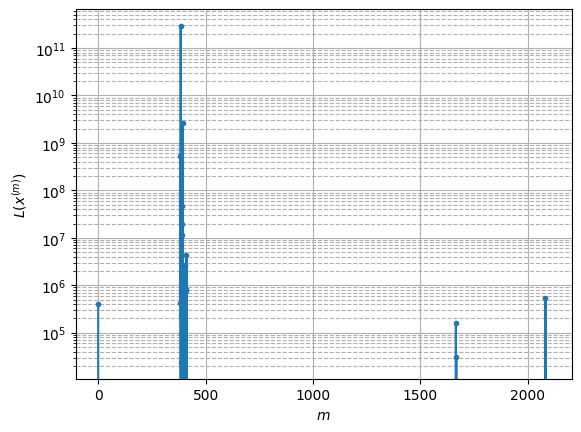

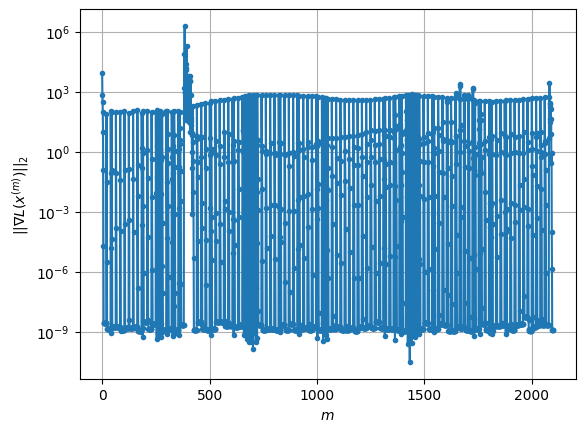

Windows:  35%|███▍      | 137/395 [01:28<03:00,  1.43it/s]

Before applying the algorithm
Cost function: -213492.99564832484
Gradient norm: 558.9807746039529
Global relative error: 134.47295424020473
Position relative errors: 1.1308631243162377 m, 21.936171263609136 m, 92.78532773966424 m, 94.77873818333407 m

Iteration 1
Cost function: -236289.97760359215 (-10.68%)
Gradient norm: 5.1779394776884535 (-99.07%)
Global relative error: 74.74271257823625 (-44.42%)
Position relative errors: 0.08857523834009279 m, 1.8123499567649466 m, 40.861256789696085 m, 62.491308304329344 m

Iteration 2
Cost function: 3165578765.0191298 (1339800.82%)
Gradient norm: 207768.68487543348 (4012474.61%)
Global relative error: 47254.19375072222 (63122.48%)
Position relative errors: 0.08857523834009279 m, 5053.014613734363 m, 22642.881212603937 m, 41167.047408741084 m

Iteration 3
Cost function: 31252368.513302486 (-99.01%)
Gradient norm: 10476.969465627848 (-94.96%)
Global relative error: 25957.787169608997 (-45.07%)
Position relative errors: 0.08857523834009279 m, 2105.

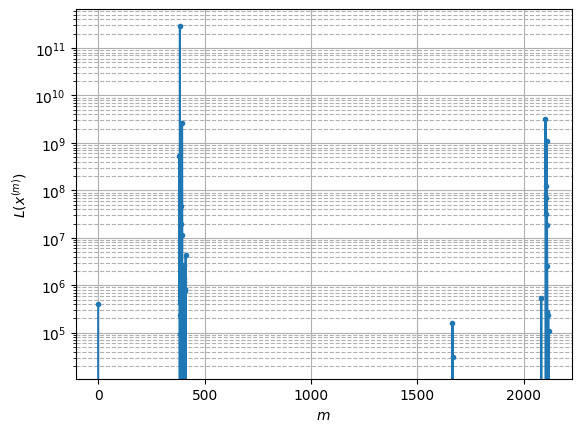

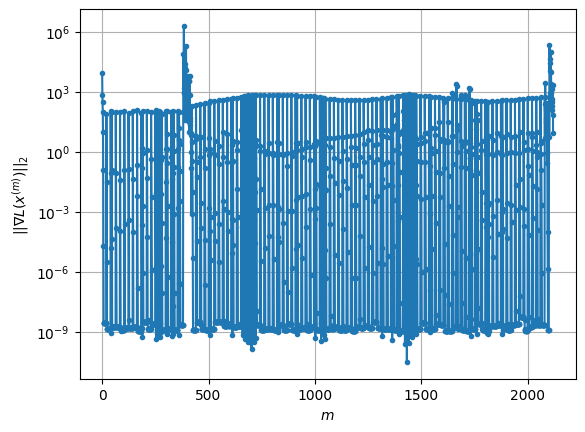

Windows:  35%|███▍      | 138/395 [01:29<02:52,  1.49it/s]

Before applying the algorithm
Cost function: -210514.16854688234
Gradient norm: 403.4695636009698
Global relative error: 3063.239785185066
Position relative errors: 1.1320285680884061 m, 443.54220436612957 m, 2265.908234303341 m, 2013.0473629779287 m

Iteration 1
Cost function: 46209333.05770175 (22050.70%)
Gradient norm: 16734.15255826323 (4047.56%)
Global relative error: 15740.88183404205 (413.86%)
Position relative errors: 0.22532984233787093 m, 10664.606986297229 m, 8959.911918688527 m, 7332.222712011899 m

Iteration 2
Cost function: 1629787.1325263456 (-96.47%)
Gradient norm: 2526.4167628317946 (-84.90%)
Global relative error: 8026.305713768453 (-49.01%)
Position relative errors: 0.22532984233787093 m, 3718.7416524450914 m, 5364.779532044771 m, 4670.297341058713 m

Iteration 3
Cost function: 10773.714257527616 (-99.34%)
Gradient norm: 643.9245151303508 (-74.51%)
Global relative error: 5951.120218220255 (-25.85%)
Position relative errors: 0.22532984233787093 m, 2292.5208707866045 m

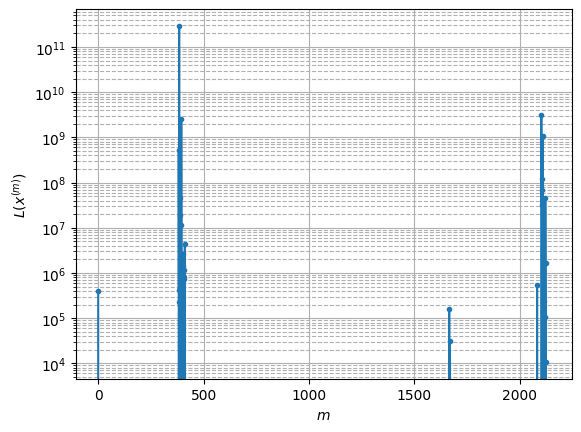

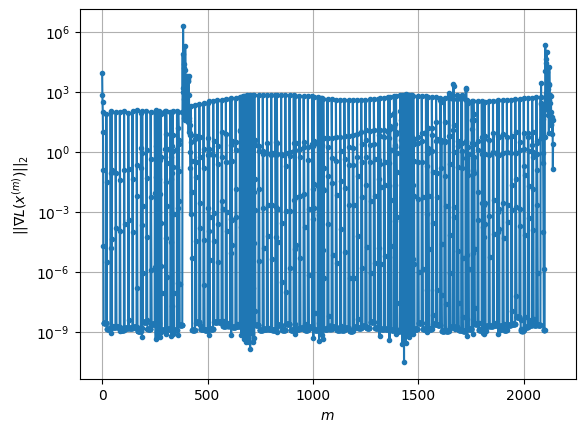

Windows:  35%|███▌      | 139/395 [01:29<02:54,  1.47it/s]

Before applying the algorithm
Cost function: -211815.1393948561
Gradient norm: 564.8549264680844
Global relative error: 157.61194608154509
Position relative errors: 0.9454455343437347 m, 13.72092104244961 m, 109.74193481730879 m, 112.25817718167181 m

Iteration 1
Cost function: -236290.40817362018 (-11.56%)
Gradient norm: 5.077611080328244 (-99.10%)
Global relative error: 137.02687080788152 (-13.06%)
Position relative errors: 0.14419021163629506 m, 40.133357553766224 m, 28.081111299656786 m, 127.94502697533152 m

Iteration 2
Cost function: -236353.88337895158 (-0.03%)
Gradient norm: 2.5043121501195924 (-50.68%)
Global relative error: 62.18682727726324 (-54.62%)
Position relative errors: 0.14419021163629506 m, 5.054657954559701 m, 18.10284889397563 m, 59.21773878135738 m

Iteration 3
Cost function: -236355.08387274132 (-0.00%)
Gradient norm: 0.133854674258752 (-94.66%)
Global relative error: 46.660302264207566 (-24.97%)
Position relative errors: 0.14419021163629506 m, 7.7244276141531465

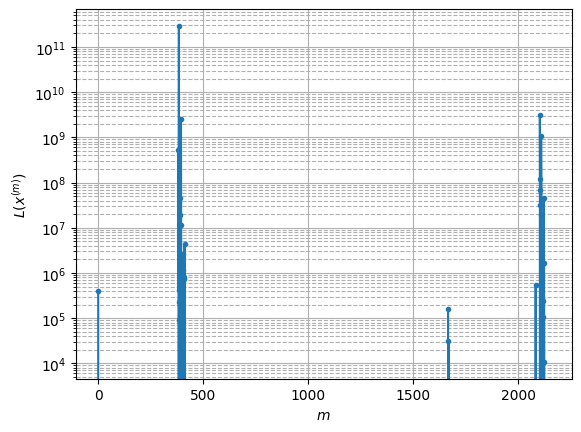

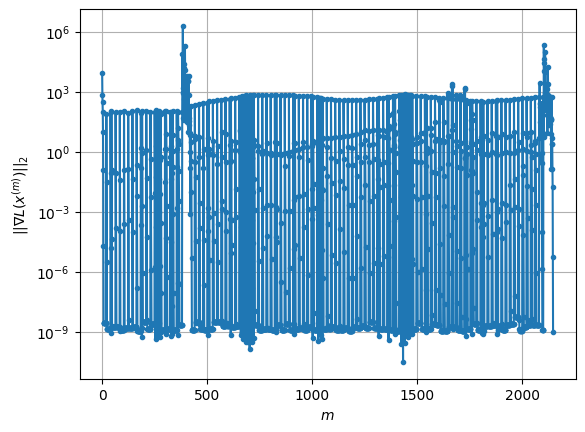

Windows:  35%|███▌      | 140/395 [01:30<02:52,  1.47it/s]

Before applying the algorithm
Cost function: -209111.50973783416
Gradient norm: 598.1395596598979
Global relative error: 144.28119808010277
Position relative errors: 1.1243252238632626 m, 17.41608391708361 m, 103.93022155831204 m, 98.50801706752254 m

Iteration 1
Cost function: -236259.68416465487 (-12.98%)
Gradient norm: 7.788872893455516 (-98.70%)
Global relative error: 250.48081590534204 (73.61%)
Position relative errors: 0.21571565945974955 m, 144.55471524863907 m, 116.85932335608621 m, 167.87276668365203 m

Iteration 2
Cost function: -236353.7174686681 (-0.04%)
Gradient norm: 2.514248232549552 (-67.72%)
Global relative error: 95.36877399597599 (-61.93%)
Position relative errors: 0.21571565945974955 m, 58.19282491052682 m, 72.63078217557262 m, 20.648522374937695 m

Iteration 3
Cost function: -236358.49628821897 (-0.00%)
Gradient norm: 0.2425996810738319 (-90.35%)
Global relative error: 51.676328527119665 (-45.81%)
Position relative errors: 0.21571565945974955 m, 32.804502813566174 

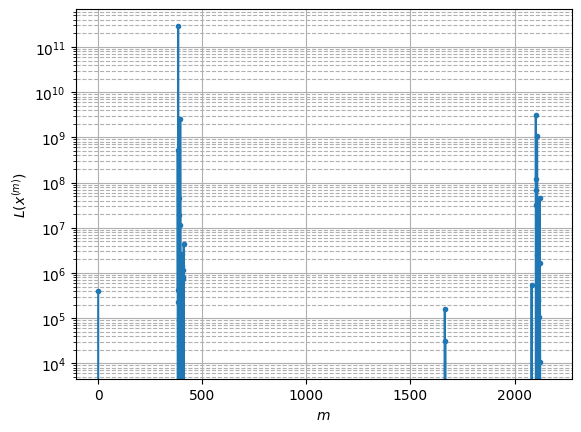

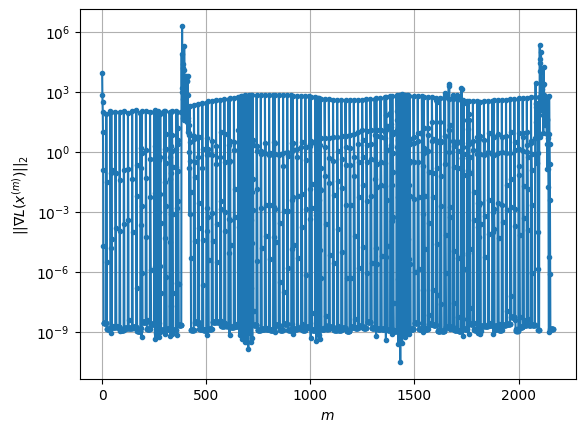

Windows:  36%|███▌      | 141/395 [01:31<02:56,  1.44it/s]

Before applying the algorithm
Cost function: -208434.20020179573
Gradient norm: 595.4326427839517
Global relative error: 171.17348385112126
Position relative errors: 0.8996837877559284 m, 30.273136126055437 m, 120.51815789231829 m, 117.69160501741227 m

Iteration 1
Cost function: 374402.98408472515 (279.63%)
Gradient norm: 1716.8575024255963 (188.34%)
Global relative error: 3682.8420850547427 (2051.53%)
Position relative errors: 0.23464180800041348 m, 2604.858366616247 m, 1877.4080453821434 m, 1803.7102151672664 m

Iteration 2
Cost function: -113370.64743775447 (-130.28%)
Gradient norm: 1153.7374351038673 (-32.80%)
Global relative error: 5147.238555808929 (39.76%)
Position relative errors: 0.23464180800041348 m, 1813.881162956766 m, 1781.815862534224 m, 4475.379861524903 m

Iteration 3
Cost function: -229337.75018989004 (-102.29%)
Gradient norm: 79.37948819906482 (-93.12%)
Global relative error: 4422.672759650881 (-14.08%)
Position relative errors: 0.23464180800041348 m, 1346.531931737

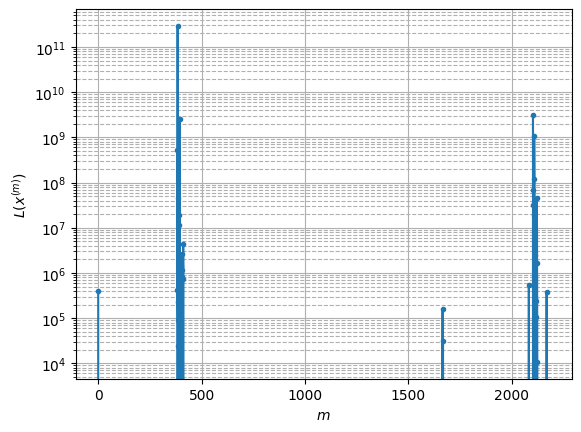

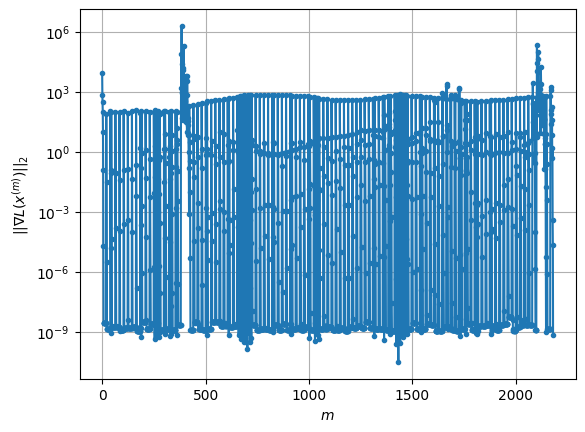

Windows:  36%|███▌      | 142/395 [01:31<02:49,  1.49it/s]

Before applying the algorithm
Cost function: -206277.8918538059
Gradient norm: 629.0555285486043
Global relative error: 210.48929020183846
Position relative errors: 1.301155120356738 m, 18.256696756307377 m, 129.865039820009 m, 164.6167090225185 m

Iteration 1
Cost function: -236329.3401661642 (-14.57%)
Gradient norm: 4.308345236333074 (-99.32%)
Global relative error: 202.0849709831183 (-3.99%)
Position relative errors: 0.14476762370825202 m, 24.200850130065945 m, 70.9065549991929 m, 187.66390702261765 m

Iteration 2
Cost function: -236346.93757023982 (-0.01%)
Gradient norm: 8.438245887875448 (95.86%)
Global relative error: 189.67023775015195 (-6.14%)
Position relative errors: 0.14476762370825202 m, 8.764640405755184 m, 69.83060770782782 m, 176.10932282116653 m

Iteration 3
Cost function: -236359.9014521157 (-0.01%)
Gradient norm: 0.7236315714117156 (-91.42%)
Global relative error: 125.71551641960903 (-33.72%)
Position relative errors: 0.14476762370825202 m, 5.456510734819273 m, 32.430

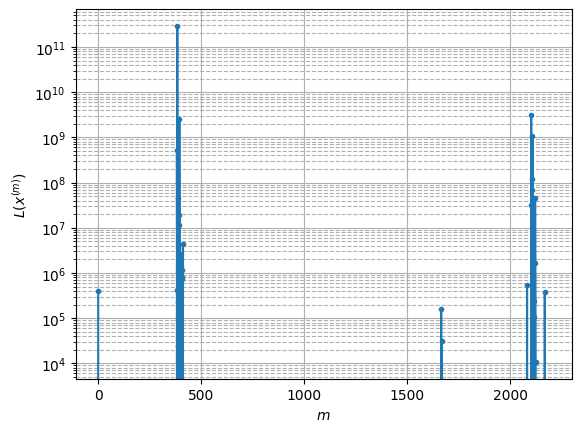

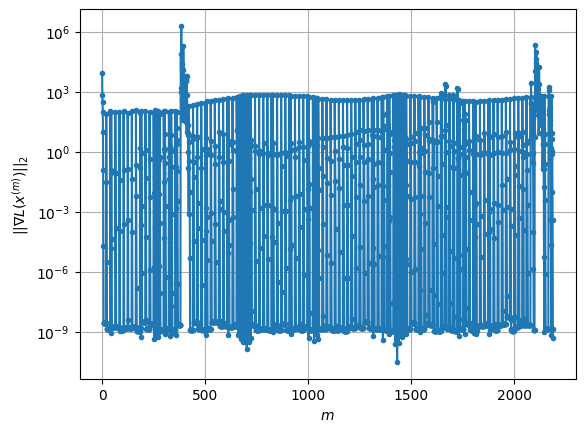

Windows:  36%|███▌      | 143/395 [01:32<02:53,  1.46it/s]

Before applying the algorithm
Cost function: -206991.71756523105
Gradient norm: 603.130168008639
Global relative error: 148.10212850236692
Position relative errors: 0.9783314045823889 m, 14.501166952075398 m, 103.03553668942635 m, 105.35441557750435 m

Iteration 1
Cost function: -236341.92757598593 (-14.18%)
Gradient norm: 4.2964361851893464 (-99.29%)
Global relative error: 64.13790326317448 (-56.69%)
Position relative errors: 0.0728736330553222 m, 14.730283370187246 m, 1.8671932184296598 m, 62.338374029823164 m

Iteration 2
Cost function: -236358.7498816279 (-0.01%)
Gradient norm: 0.4808773566409165 (-88.81%)
Global relative error: 88.43653600485092 (37.88%)
Position relative errors: 0.0728736330553222 m, 17.473576092401412 m, 49.48302435316831 m, 71.13364351915956 m

Iteration 3
Cost function: -236358.98912780144 (-0.00%)
Gradient norm: 0.09129431355103232 (-81.02%)
Global relative error: 88.00006025137665 (-0.49%)
Position relative errors: 0.0728736330553222 m, 18.508143220985794 m,

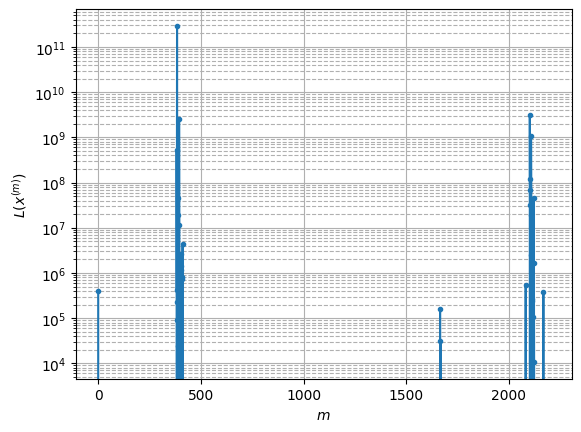

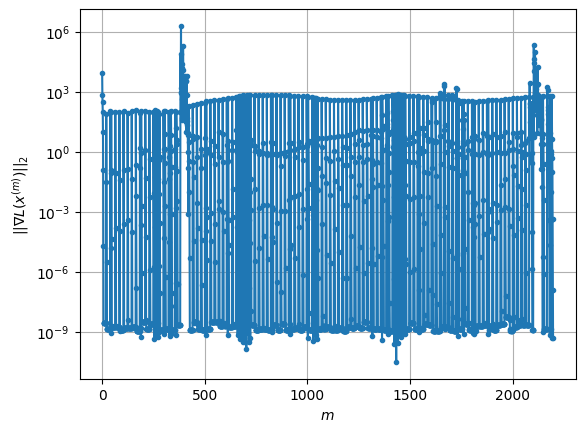

Windows:  36%|███▋      | 144/395 [01:33<02:45,  1.52it/s]

Before applying the algorithm
Cost function: -204647.79718188298
Gradient norm: 623.105375598244
Global relative error: 210.332981767915
Position relative errors: 1.0838451176043822 m, 22.90769892416623 m, 133.26306880730934 m, 161.08339863226198 m

Iteration 1
Cost function: -236329.91191298282 (-15.48%)
Gradient norm: 4.261208338160988 (-99.32%)
Global relative error: 192.83211417748794 (-8.32%)
Position relative errors: 0.07387567305050818 m, 25.149753529996403 m, 83.54910621245376 m, 171.9422476959757 m

Iteration 2
Cost function: -236350.01550667704 (-0.01%)
Gradient norm: 4.5254134301791895 (6.20%)
Global relative error: 55.70609160600405 (-71.11%)
Position relative errors: 0.07387567305050818 m, 8.20990212441883 m, 30.928079586432776 m, 45.52027656246381 m

Iteration 3
Cost function: -236353.07576647904 (-0.00%)
Gradient norm: 0.3634306189528941 (-91.97%)
Global relative error: 56.56046148151666 (1.53%)
Position relative errors: 0.07387567305050818 m, 7.979462127308942 m, 18.582

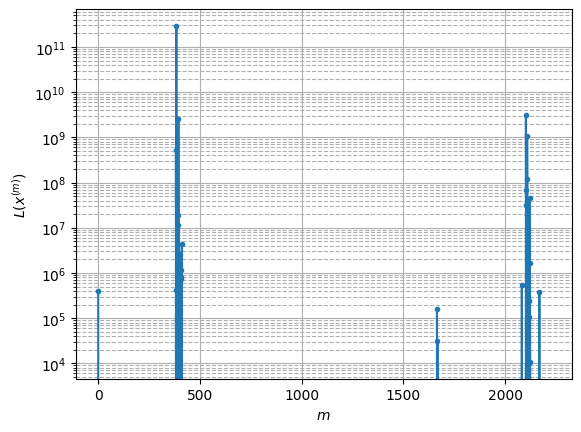

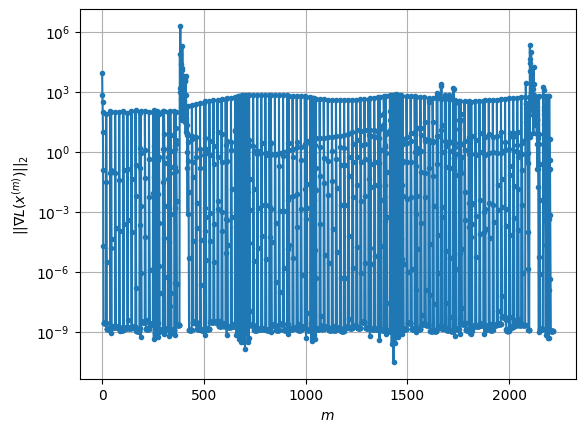

Windows:  37%|███▋      | 145/395 [01:33<02:50,  1.46it/s]

Before applying the algorithm
Cost function: -206773.80048664927
Gradient norm: 597.0366842252339
Global relative error: 154.97224531370017
Position relative errors: 1.1596749742389463 m, 15.511299570245813 m, 102.66520864156047 m, 115.0096480739912 m

Iteration 1
Cost function: -236345.2411517647 (-14.30%)
Gradient norm: 4.145026389936514 (-99.31%)
Global relative error: 78.27606523000414 (-49.49%)
Position relative errors: 0.07035056954110365 m, 30.254823922465192 m, 9.205309152480803 m, 71.55388186443606 m

Iteration 2
Cost function: -236356.74413804623 (-0.00%)
Gradient norm: 2.0004108047728857 (-51.74%)
Global relative error: 76.78243580180431 (-1.91%)
Position relative errors: 0.07035056954110365 m, 10.663943081387684 m, 12.483748755524054 m, 74.95923219840235 m

Iteration 3
Cost function: -236357.44037228756 (-0.00%)
Gradient norm: 0.11141204029495837 (-94.43%)
Global relative error: 57.149697261849 (-25.57%)
Position relative errors: 0.07035056954110365 m, 9.228159436332223 m, 

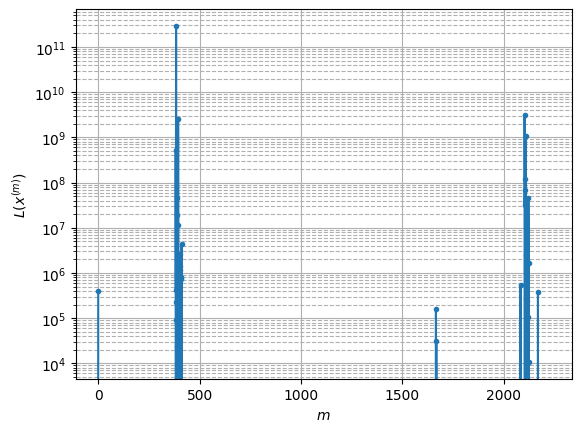

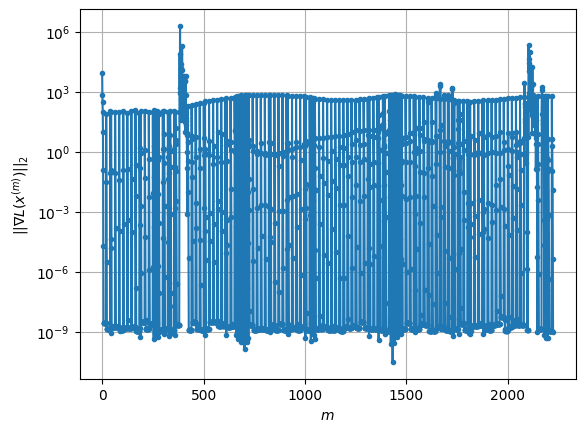

Windows:  37%|███▋      | 146/395 [01:34<02:52,  1.45it/s]

Before applying the algorithm
Cost function: -206616.8153933774
Gradient norm: 588.1639800459319
Global relative error: 161.61063042833052
Position relative errors: 1.1773290383320671 m, 12.933827195974597 m, 108.31712348191952 m, 119.2043376995747 m

Iteration 1
Cost function: -236348.34059975835 (-14.39%)
Gradient norm: 4.3247589612844735 (-99.26%)
Global relative error: 65.78824247657712 (-59.29%)
Position relative errors: 0.1508525723001522 m, 2.9906873189569794 m, 38.61921855065822 m, 53.109597320108755 m

Iteration 2
Cost function: -236356.23972691325 (-0.00%)
Gradient norm: 0.4309136519164371 (-90.04%)
Global relative error: 91.17116878941545 (38.58%)
Position relative errors: 0.1508525723001522 m, 11.142585464289152 m, 19.36906348734497 m, 88.35037588303044 m

Iteration 3
Cost function: -236356.27761277853 (-0.00%)
Gradient norm: 0.019019729305534097 (-95.59%)
Global relative error: 95.96576746589228 (5.26%)
Position relative errors: 0.1508525723001522 m, 11.599948263678861 m, 

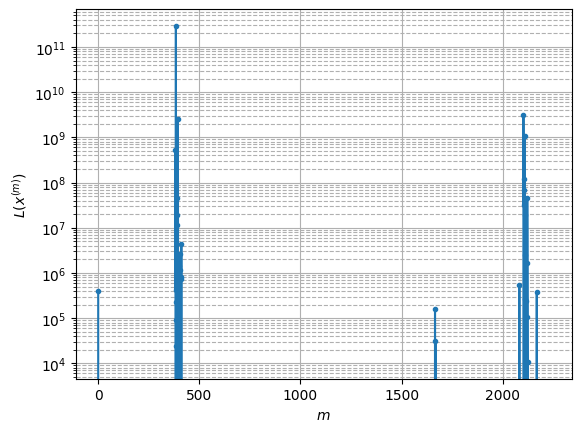

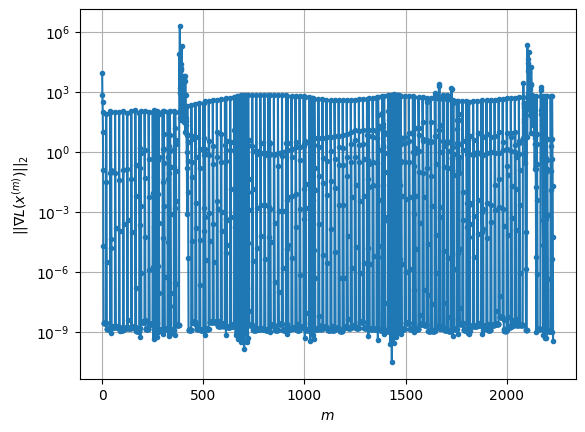

Windows:  37%|███▋      | 147/395 [01:35<02:45,  1.50it/s]

Before applying the algorithm
Cost function: -203422.9449119438
Gradient norm: 615.4956521237899
Global relative error: 203.63846368861303
Position relative errors: 1.126261333059571 m, 21.545810228700653 m, 123.50932570705841 m, 160.441723513009 m

Iteration 1
Cost function: -236298.35077208845 (-16.16%)
Gradient norm: 4.625004168495084 (-99.25%)
Global relative error: 197.88215485137877 (-2.83%)
Position relative errors: 0.18536599360671038 m, 96.19426483716897 m, 37.49405482626473 m, 168.79318352106267 m

Iteration 2
Cost function: -236348.1721487069 (-0.02%)
Gradient norm: 7.0287029392759885 (51.97%)
Global relative error: 173.85698534495464 (-12.14%)
Position relative errors: 0.18536599360671038 m, 28.88379715308762 m, 11.857189729587457 m, 171.0096985448487 m

Iteration 3
Cost function: -236356.0018199075 (-0.00%)
Gradient norm: 0.1779852464105329 (-97.47%)
Global relative error: 146.51679673602803 (-15.73%)
Position relative errors: 0.18536599360671038 m, 40.065250440516095 m, 1

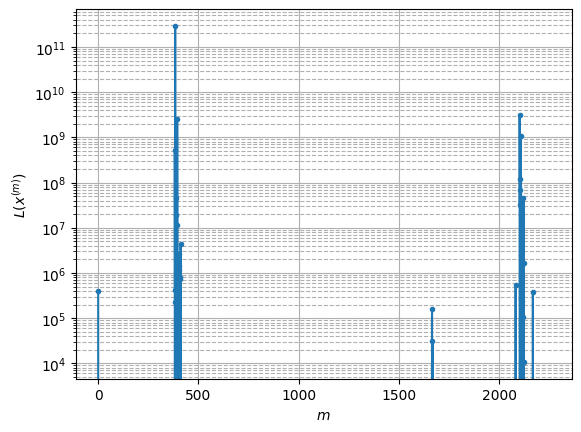

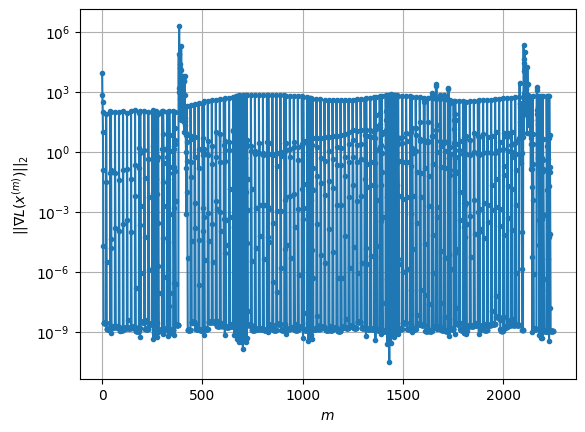

Windows:  37%|███▋      | 148/395 [01:35<02:40,  1.54it/s]

Before applying the algorithm
Cost function: -207481.89176411185
Gradient norm: 567.3815213228205
Global relative error: 205.39603088255453
Position relative errors: 1.1053866042386917 m, 38.936178965708145 m, 106.39305586011632 m, 171.30032159027712 m

Iteration 1
Cost function: -236305.6650339058 (-13.89%)
Gradient norm: 4.525348021125232 (-99.20%)
Global relative error: 232.61454532670416 (13.25%)
Position relative errors: 0.14735048251439387 m, 113.30556850940275 m, 85.1763852930839 m, 184.41620709802905 m

Iteration 2
Cost function: -236348.82144491485 (-0.02%)
Gradient norm: 5.377685482137349 (18.83%)
Global relative error: 50.2085507399245 (-78.42%)
Position relative errors: 0.14735048251439387 m, 38.827107309696416 m, 29.009235104566994 m, 12.837359297051641 m

Iteration 3
Cost function: -236356.29559797165 (-0.00%)
Gradient norm: 0.38076571076177973 (-92.92%)
Global relative error: 61.63735094408986 (22.76%)
Position relative errors: 0.14735048251439387 m, 23.82367354897233 m,

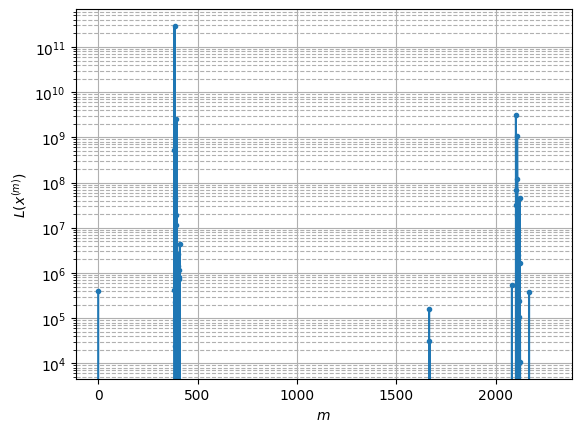

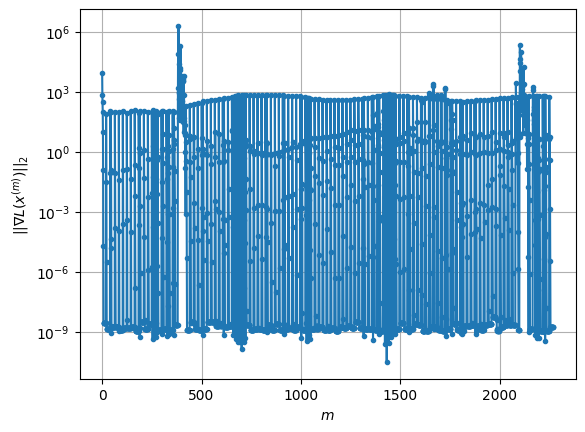

Windows:  38%|███▊      | 149/395 [01:36<02:47,  1.47it/s]

Before applying the algorithm
Cost function: -207201.3365357071
Gradient norm: 557.6966820676391
Global relative error: 161.38799155933353
Position relative errors: 1.1635709736679136 m, 27.179476583332505 m, 108.57884664684438 m, 116.23110345861491 m

Iteration 1
Cost function: 619503.8210767632 (398.99%)
Gradient norm: 1921.504179652748 (244.54%)
Global relative error: 4350.882223786895 (2595.91%)
Position relative errors: 0.057837991083606426 m, 3231.923826851776 m, 2067.803427930362 m, 2051.59121468248 m

Iteration 2
Cost function: -59394.81397172247 (-109.59%)
Gradient norm: 1250.5659043444828 (-34.92%)
Global relative error: 5543.732422220631 (27.42%)
Position relative errors: 0.057837991083606426 m, 2345.8357101942975 m, 1495.6548033969236 m, 4795.105183941586 m

Iteration 3
Cost function: -221091.84095544496 (-272.24%)
Gradient norm: 135.83194994086816 (-89.14%)
Global relative error: 4548.519479231528 (-17.95%)
Position relative errors: 0.057837991083606426 m, 1598.23080676217

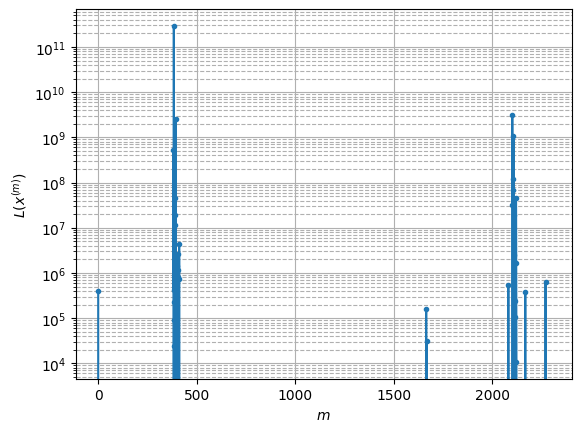

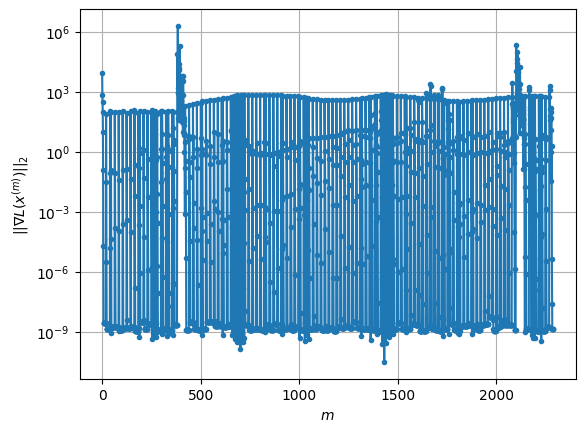

Windows:  38%|███▊      | 150/395 [01:37<02:43,  1.49it/s]

Before applying the algorithm
Cost function: -206126.26973963913
Gradient norm: 565.8970310239208
Global relative error: 208.36074083867254
Position relative errors: 1.0663498510083067 m, 24.825115337033328 m, 136.58011536442092 m, 155.35673174663472 m

Iteration 1
Cost function: -236229.3061799489 (-14.60%)
Gradient norm: 7.051560165538236 (-98.75%)
Global relative error: 198.03942820472338 (-4.95%)
Position relative errors: 0.06344865208508872 m, 151.20921708358742 m, 40.35942489080669 m, 121.32422565996372 m

Iteration 2
Cost function: -236342.53165985754 (-0.05%)
Gradient norm: 6.330239761629063 (-10.23%)
Global relative error: 228.86216793280684 (15.56%)
Position relative errors: 0.06344865208508872 m, 39.03958305140044 m, 52.68272995338543 m, 219.25190067048442 m

Iteration 3
Cost function: -236352.45205588968 (-0.00%)
Gradient norm: 0.33249991810693064 (-94.75%)
Global relative error: 238.77731698644493 (4.33%)
Position relative errors: 0.06344865208508872 m, 26.656641698500632 

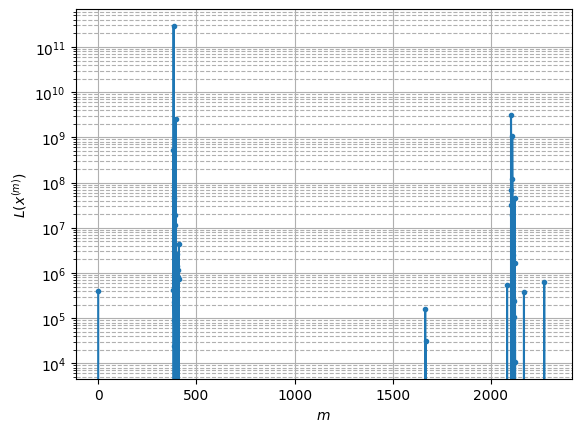

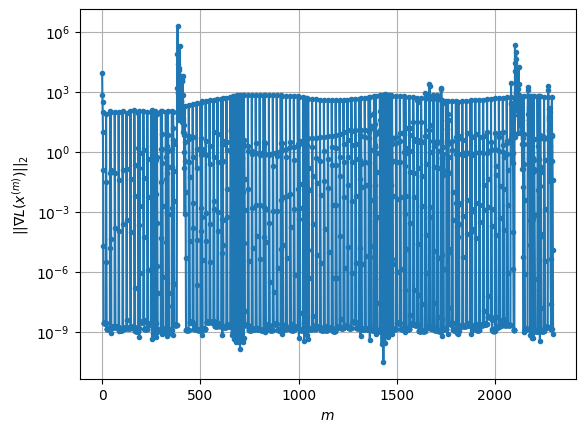

Windows:  38%|███▊      | 151/395 [01:37<02:44,  1.48it/s]

Before applying the algorithm
Cost function: -203909.16000083898
Gradient norm: 580.9188829560273
Global relative error: 291.7927507218605
Position relative errors: 1.1353841752474434 m, 37.0456437537821 m, 133.65924001996967 m, 256.7053795926922 m

Iteration 1
Cost function: -236310.8076299734 (-15.89%)
Gradient norm: 4.836597843982312 (-99.17%)
Global relative error: 283.5406321009245 (-2.83%)
Position relative errors: 0.13986787447912832 m, 86.86725312275998 m, 51.66700672334885 m, 264.9018215101532 m

Iteration 2
Cost function: -236350.5340075902 (-0.02%)
Gradient norm: 9.222272722054734 (90.68%)
Global relative error: 163.98034624967988 (-42.17%)
Position relative errors: 0.13986787447912832 m, 17.646069256835784 m, 7.339061067610897 m, 162.8416181897093 m

Iteration 3
Cost function: -236357.84124210628 (-0.00%)
Gradient norm: 0.062360708839027335 (-99.32%)
Global relative error: 168.63210385852605 (2.84%)
Position relative errors: 0.13986787447912832 m, 22.105611410213005 m, 19.8

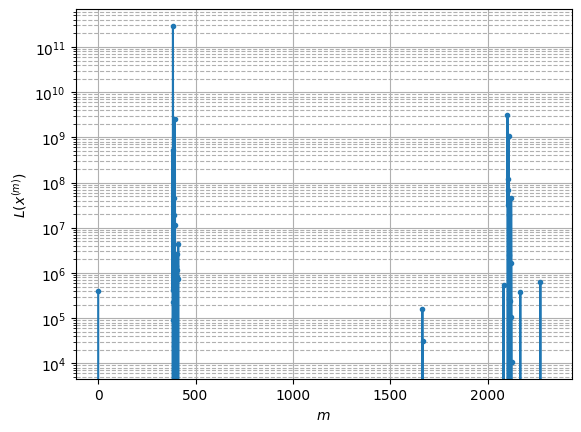

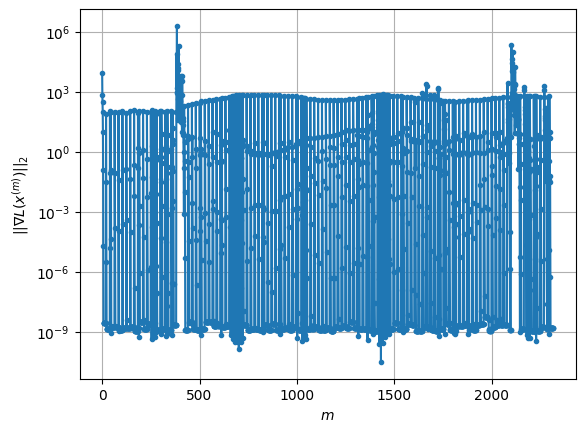

Windows:  38%|███▊      | 152/395 [01:38<02:41,  1.51it/s]

Before applying the algorithm
Cost function: -209063.1059357382
Gradient norm: 524.6574116005839
Global relative error: 241.82501875470035
Position relative errors: 1.1541236042061582 m, 22.015202182924522 m, 109.63786315725928 m, 214.39686645077467 m

Iteration 1
Cost function: -236333.7279572416 (-13.04%)
Gradient norm: 4.423696008378653 (-99.16%)
Global relative error: 230.45756570145733 (-4.70%)
Position relative errors: 0.3232928434259069 m, 66.12627060141439 m, 73.68443523685693 m, 208.09047125058788 m

Iteration 2
Cost function: -236353.93579315773 (-0.01%)
Gradient norm: 3.566446359405607 (-19.38%)
Global relative error: 96.83349606661609 (-57.98%)
Position relative errors: 0.3232928434259069 m, 13.814595294502192 m, 17.36117315390173 m, 94.22052260590034 m

Iteration 3
Cost function: -236355.13267458975 (-0.00%)
Gradient norm: 0.017673162544354904 (-99.50%)
Global relative error: 103.64668319192901 (7.04%)
Position relative errors: 0.3232928434259069 m, 14.877396651541739 m, 1

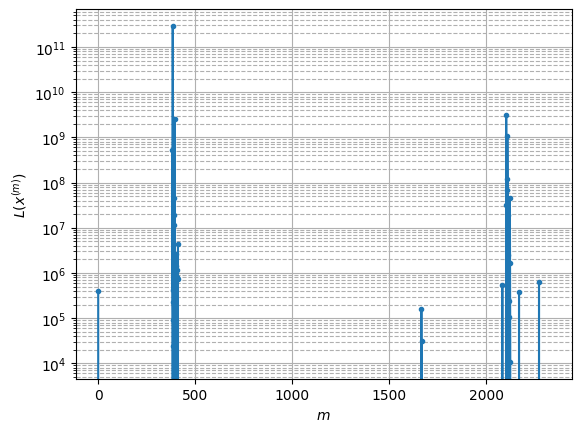

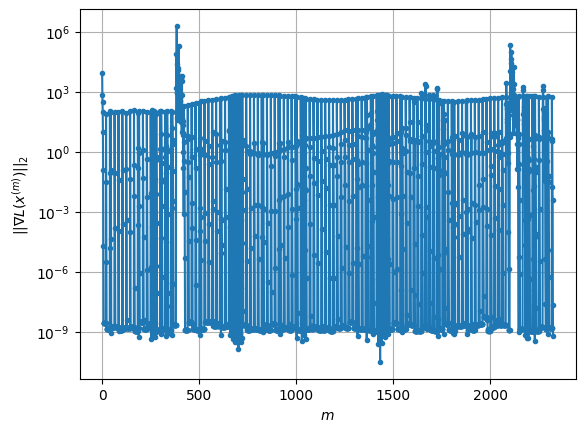

Windows:  39%|███▊      | 153/395 [01:39<02:41,  1.50it/s]

Before applying the algorithm
Cost function: -208967.0347038143
Gradient norm: 522.6506410699518
Global relative error: 185.97388355557325
Position relative errors: 0.836965259926011 m, 26.0615918899701 m, 118.46728886837317 m, 140.94344835776698 m

Iteration 1
Cost function: -236344.27029607457 (-13.10%)
Gradient norm: 3.5439558080922744 (-99.32%)
Global relative error: 131.92459345002337 (-29.06%)
Position relative errors: 0.12617015110269075 m, 24.810727412139123 m, 40.85178028719867 m, 122.9342026266033 m

Iteration 2
Cost function: -236355.40204746343 (-0.00%)
Gradient norm: 4.151269310159222 (17.14%)
Global relative error: 108.88846558810654 (-17.46%)
Position relative errors: 0.12617015110269075 m, 15.0377938826863 m, 17.509093937999932 m, 106.38211451452834 m

Iteration 3
Cost function: -236356.74970671 (-0.00%)
Gradient norm: 0.010099267008027943 (-99.76%)
Global relative error: 120.08692563740411 (10.28%)
Position relative errors: 0.12617015110269075 m, 16.40633237675954 m, 1

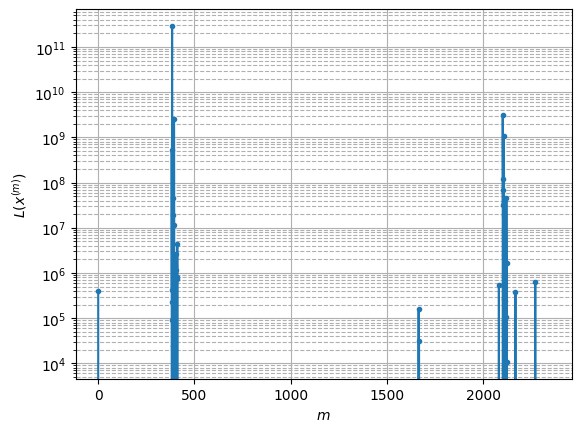

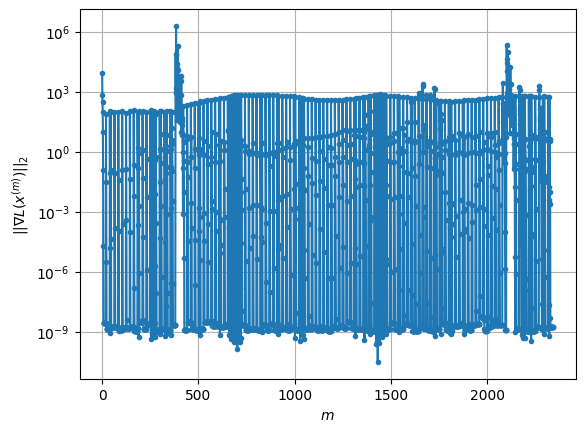

Windows:  39%|███▉      | 154/395 [01:39<02:39,  1.51it/s]

Before applying the algorithm
Cost function: -212847.60847018167
Gradient norm: 465.3640224116591
Global relative error: 202.03513822550624
Position relative errors: 1.158092909492312 m, 12.291458684782748 m, 102.15901794908112 m, 173.84615911377682 m

Iteration 1
Cost function: -236343.5407891641 (-11.04%)
Gradient norm: 3.92814779079718 (-99.16%)
Global relative error: 114.90690806016357 (-43.13%)
Position relative errors: 0.07619282766680566 m, 17.057817484850567 m, 41.59709104396351 m, 105.71414587865831 m

Iteration 2
Cost function: -236351.04388878224 (-0.00%)
Gradient norm: 0.12919486031881666 (-96.71%)
Global relative error: 115.18359991440411 (0.24%)
Position relative errors: 0.07619282766680566 m, 16.924482204519933 m, 24.696235832432013 m, 111.19392864105906 m

Iteration 3
Cost function: -236351.05041233829 (-0.00%)
Gradient norm: 0.0017213088873628177 (-98.67%)
Global relative error: 115.73918506974331 (0.48%)
Position relative errors: 0.07619282766680566 m, 17.036040201070

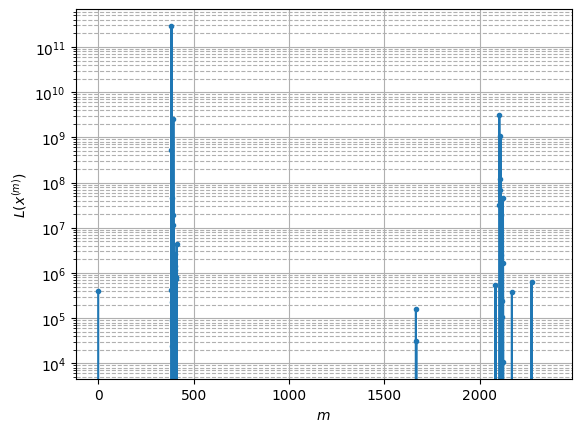

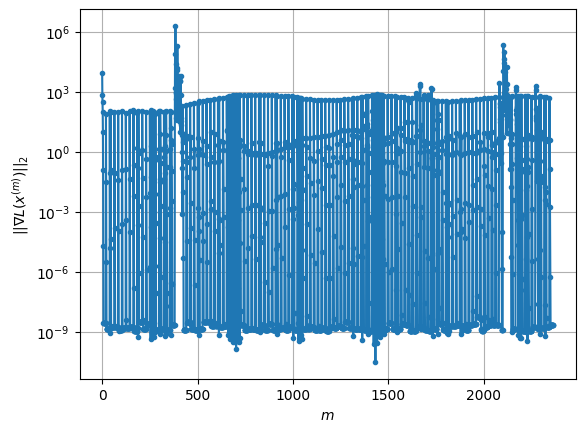

Windows:  39%|███▉      | 155/395 [01:40<02:46,  1.44it/s]

Before applying the algorithm
Cost function: -214166.1639233293
Gradient norm: 462.5492478791587
Global relative error: 205.91714040065455
Position relative errors: 1.1742984972957302 m, 10.119888688876463 m, 104.75075087967859 m, 176.97042768640654 m

Iteration 1
Cost function: -236348.58998820896 (-10.36%)
Gradient norm: 3.591353976108431 (-99.22%)
Global relative error: 129.97294844652225 (-36.88%)
Position relative errors: 0.24513834297474155 m, 16.932030900054215 m, 53.573099600149305 m, 117.17214286052149 m

Iteration 2
Cost function: -236358.10699226518 (-0.00%)
Gradient norm: 1.46275711484796 (-59.27%)
Global relative error: 25.59854533654447 (-80.30%)
Position relative errors: 0.24513834297474155 m, 9.806290488493504 m, 18.893828843322574 m, 13.973540269153213 m

Iteration 3
Cost function: -236358.29779775237 (-0.00%)
Gradient norm: 0.010944817392964247 (-99.25%)
Global relative error: 32.115882880577615 (25.46%)
Position relative errors: 0.24513834297474155 m, 10.459522891606

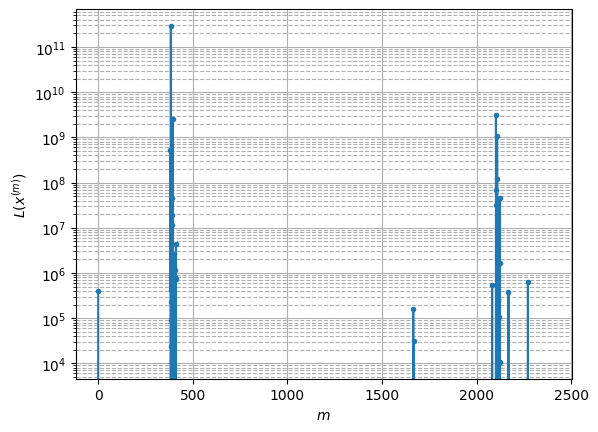

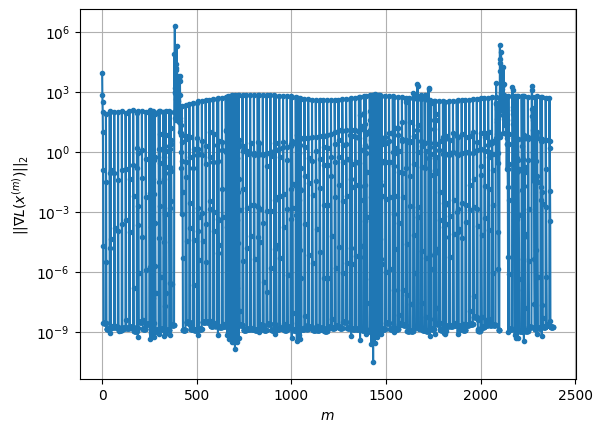

Windows:  39%|███▉      | 156/395 [01:41<02:41,  1.48it/s]

Before applying the algorithm
Cost function: -212524.02451908533
Gradient norm: 472.92315637764784
Global relative error: 156.98325963946587
Position relative errors: 0.9238189289071376 m, 23.150622784537198 m, 113.92198224493745 m, 105.46049663724017 m

Iteration 1
Cost function: -236347.307236345 (-11.21%)
Gradient norm: 3.708226185513388 (-99.22%)
Global relative error: 55.19101843196194 (-64.84%)
Position relative errors: 0.3002295476870441 m, 14.821447877731645 m, 48.72518649016939 m, 21.10295290627191 m

Iteration 2
Cost function: -236357.87241069486 (-0.00%)
Gradient norm: 1.0701159054723035 (-71.14%)
Global relative error: 94.54554790958443 (71.31%)
Position relative errors: 0.3002295476870441 m, 15.21477384499235 m, 16.45619335055973 m, 91.81323547441028 m

Iteration 3
Cost function: -236358.0459332998 (-0.00%)
Gradient norm: 0.023106603467681352 (-97.84%)
Global relative error: 105.59451667506148 (11.69%)
Position relative errors: 0.3002295476870441 m, 18.066539907602408 m, 1

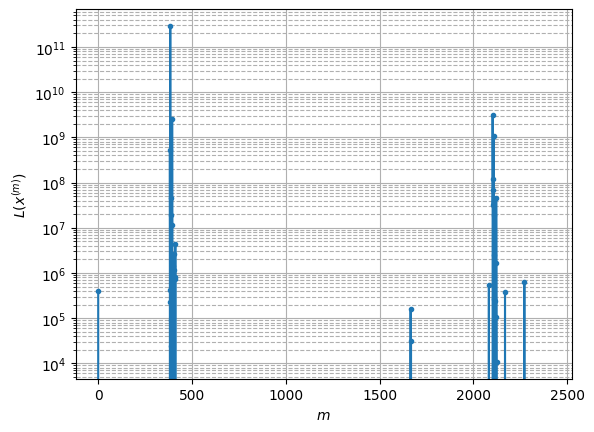

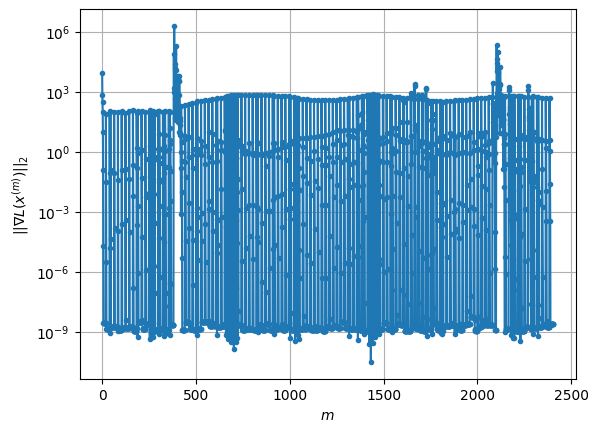

Windows:  40%|███▉      | 157/395 [01:41<02:47,  1.42it/s]

Before applying the algorithm
Cost function: -216315.73656745584
Gradient norm: 432.167089671589
Global relative error: 201.601032106027
Position relative errors: 1.0240694109368174 m, 8.75161774100476 m, 99.07707627225764 m, 175.33466169446584 m

Iteration 1
Cost function: -236348.50249705155 (-9.26%)
Gradient norm: 3.38769713986187 (-99.22%)
Global relative error: 124.74219079461487 (-38.12%)
Position relative errors: 0.09971949384101689 m, 21.469751941327182 m, 24.294107369696363 m, 120.42684226595617 m

Iteration 2
Cost function: -236353.22220997632 (-0.00%)
Gradient norm: 0.9768672171863738 (-71.16%)
Global relative error: 90.49719712165597 (-27.45%)
Position relative errors: 0.09971949384101689 m, 27.603474937320993 m, 4.041979943921643 m, 86.05008618017364 m

Iteration 3
Cost function: -236353.30379958844 (-0.00%)
Gradient norm: 0.005289802307901887 (-99.46%)
Global relative error: 91.00996925571961 (0.57%)
Position relative errors: 0.09971949384101689 m, 27.957141188944917 m, 3

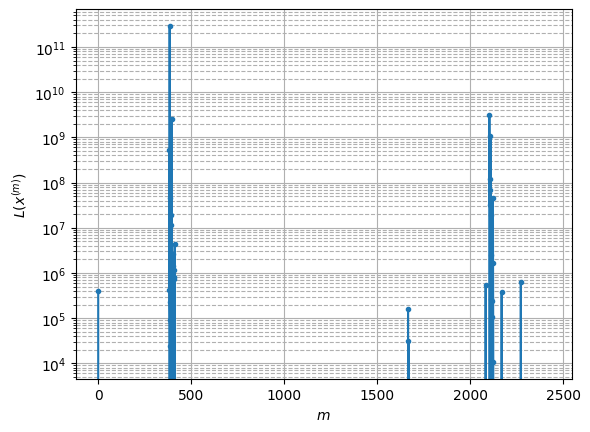

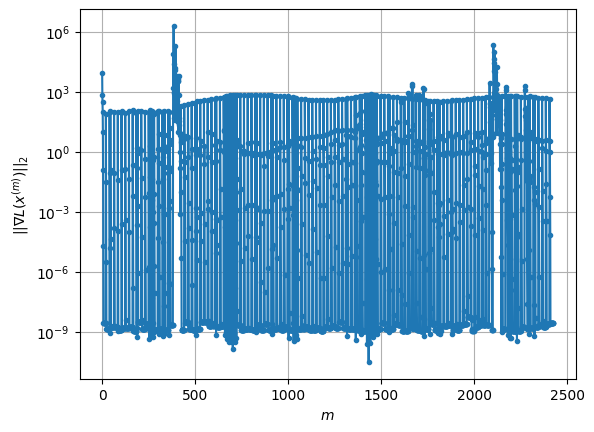

Windows:  40%|████      | 158/395 [01:42<02:52,  1.38it/s]

Before applying the algorithm
Cost function: -215602.98139500385
Gradient norm: 446.1361766557651
Global relative error: 181.97836813095066
Position relative errors: 1.1538899510054972 m, 30.946400452190606 m, 109.41986363433864 m, 142.04777691509958 m

Iteration 1
Cost function: -236342.53823112673 (-9.62%)
Gradient norm: 4.157463115603916 (-99.07%)
Global relative error: 77.1002514667539 (-57.63%)
Position relative errors: 0.07597212430537982 m, 19.016100205658535 m, 36.67304550600278 m, 65.04675895383075 m

Iteration 2
Cost function: -236353.76838141747 (-0.00%)
Gradient norm: 2.424894376899889 (-41.67%)
Global relative error: 106.63563628984667 (38.31%)
Position relative errors: 0.07597212430537982 m, 19.888970071979177 m, 36.45458145114991 m, 98.18252235258556 m

Iteration 3
Cost function: -236354.2555621804 (-0.00%)
Gradient norm: 0.012822355093324423 (-99.47%)
Global relative error: 117.0566103345986 (9.77%)
Position relative errors: 0.07597212430537982 m, 21.201438832582337 m, 

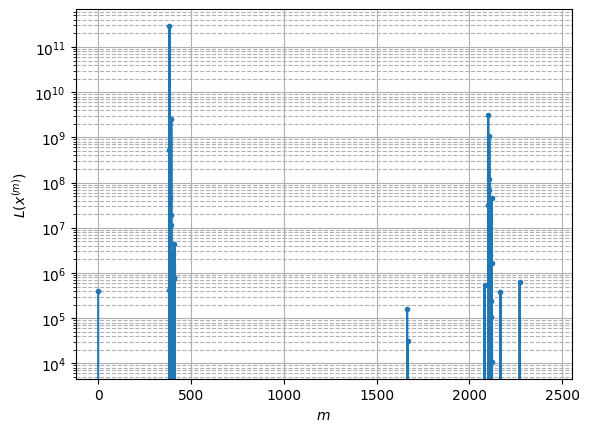

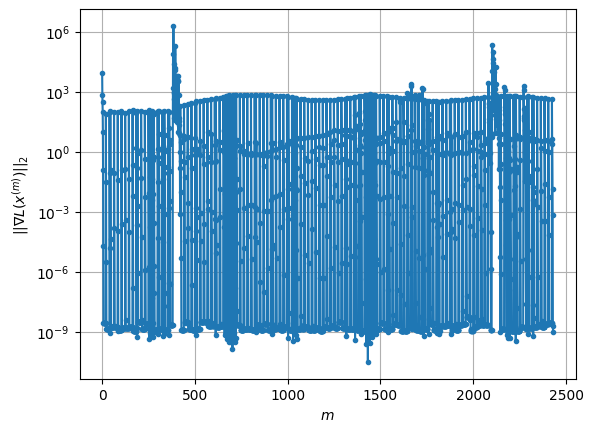

Windows:  40%|████      | 159/395 [01:43<02:47,  1.41it/s]

Before applying the algorithm
Cost function: -215914.79780984082
Gradient norm: 449.83402989869717
Global relative error: 199.34527110579364
Position relative errors: 1.0624100117683501 m, 31.998043297642955 m, 122.57516057806428 m, 153.88975488812895 m

Iteration 1
Cost function: -236350.00115774517 (-9.46%)
Gradient norm: 3.566028560765997 (-99.21%)
Global relative error: 118.79638296621518 (-40.41%)
Position relative errors: 0.26831819619179326 m, 18.93917280474423 m, 60.04715879739452 m, 100.70426055023195 m

Iteration 2
Cost function: -236358.61347152648 (-0.00%)
Gradient norm: 1.2441082430210306 (-65.11%)
Global relative error: 112.51254300782219 (-5.29%)
Position relative errors: 0.26831819619179326 m, 10.430499309034051 m, 2.649459869830633 m, 111.96596989233052 m

Iteration 3
Cost function: -236359.0063706875 (-0.00%)
Gradient norm: 0.0630860916549067 (-94.93%)
Global relative error: 95.1291017993553 (-15.45%)
Position relative errors: 0.26831819619179326 m, 10.30728019113409 

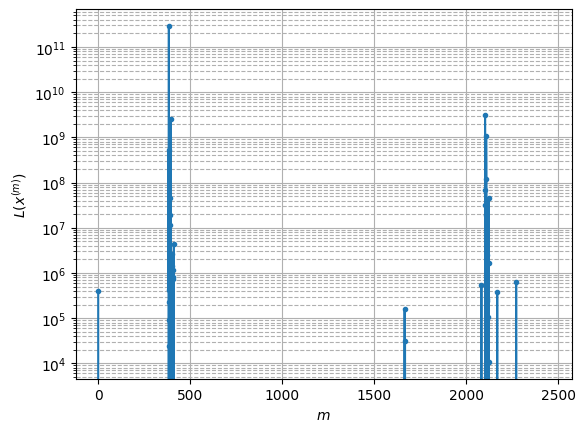

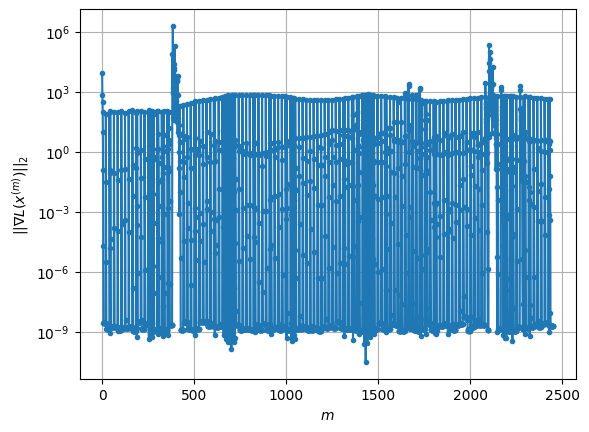

Windows:  41%|████      | 160/395 [01:44<02:44,  1.43it/s]

Before applying the algorithm
Cost function: -217222.8316497716
Gradient norm: 427.67183540921485
Global relative error: 180.83573314987453
Position relative errors: 0.8880265644935315 m, 21.47536612009922 m, 109.36845484413645 m, 142.37741405779002 m

Iteration 1
Cost function: -236344.25422712782 (-8.80%)
Gradient norm: 3.735143247281894 (-99.13%)
Global relative error: 124.40504646976073 (-31.21%)
Position relative errors: 0.16211760389997537 m, 34.31069146821726 m, 13.763354991500872 m, 118.75664327300927 m

Iteration 2
Cost function: -236352.81101331627 (-0.00%)
Gradient norm: 1.2272233819625158 (-67.14%)
Global relative error: 126.06708703195025 (1.34%)
Position relative errors: 0.16211760389997537 m, 24.64075608331854 m, 23.40716975899023 m, 121.37143898057812 m

Iteration 3
Cost function: -236352.95816253548 (-0.00%)
Gradient norm: 0.014811196721651005 (-98.79%)
Global relative error: 132.55908827914465 (5.15%)
Position relative errors: 0.16211760389997537 m, 27.280065197909018

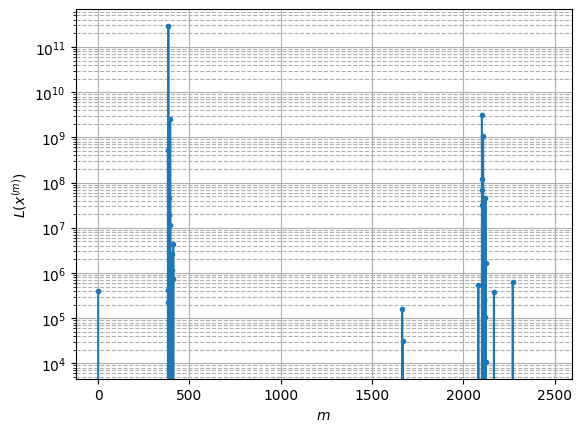

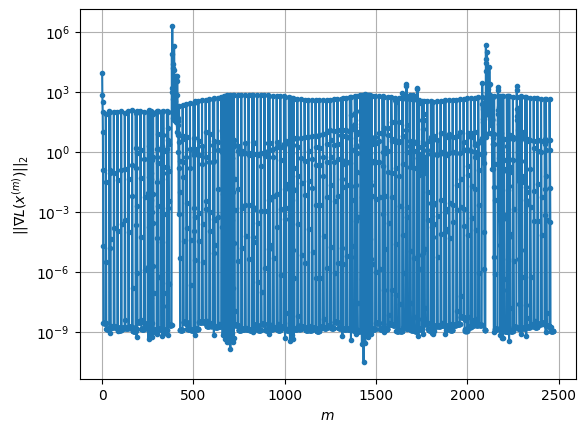

Windows:  41%|████      | 161/395 [01:44<02:46,  1.41it/s]

Before applying the algorithm
Cost function: -221541.47513315818
Gradient norm: 370.20311928843796
Global relative error: 231.89960937018932
Position relative errors: 1.1488249010623237 m, 16.133683607929036 m, 91.43585487129955 m, 212.48164851586353 m

Iteration 1
Cost function: -236352.46906639 (-6.69%)
Gradient norm: 3.746434685120873 (-98.99%)
Global relative error: 175.2866284549875 (-24.41%)
Position relative errors: 0.11343730661764256 m, 36.777540458603056 m, 37.2082561222612 m, 167.2767188603432 m

Iteration 2
Cost function: -236360.26177649954 (-0.00%)
Gradient norm: 1.2334938111787668 (-67.08%)
Global relative error: 66.6843453527946 (-61.96%)
Position relative errors: 0.11343730661764256 m, 10.53223170144138 m, 10.329596460866505 m, 64.97933372144583 m

Iteration 3
Cost function: -236360.4067205544 (-0.00%)
Gradient norm: 0.017519696583943763 (-98.58%)
Global relative error: 55.38846002055524 (-16.94%)
Position relative errors: 0.11343730661764256 m, 9.109070604099827 m, 8.

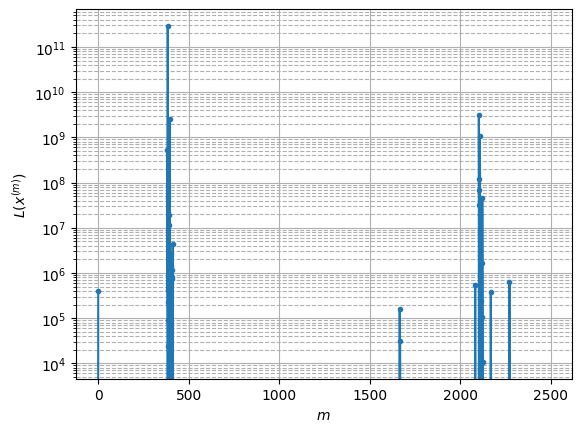

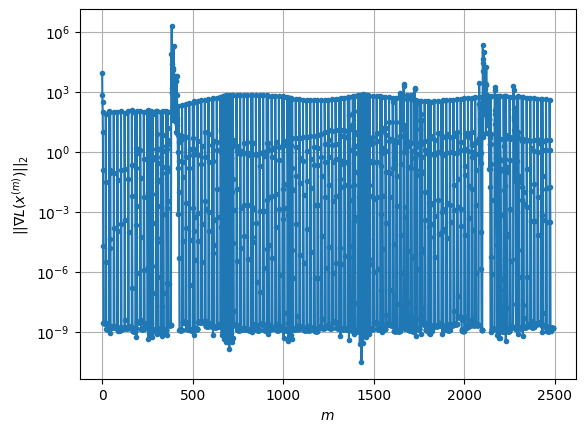

Windows:  41%|████      | 162/395 [01:45<02:43,  1.43it/s]

Before applying the algorithm
Cost function: -220802.1487150268
Gradient norm: 390.8446953674415
Global relative error: 176.79350099076154
Position relative errors: 1.1656228194255855 m, 12.28831083544171 m, 102.69208020381971 m, 143.35635819896723 m

Iteration 1
Cost function: -236352.86053358534 (-7.04%)
Gradient norm: 3.9586229403347897 (-98.99%)
Global relative error: 102.47875184551404 (-42.03%)
Position relative errors: 0.10065222982969364 m, 27.609650440527666 m, 27.279007927027305 m, 94.80809784952798 m

Iteration 2
Cost function: -236360.2851588319 (-0.00%)
Gradient norm: 0.4268022309155298 (-89.22%)
Global relative error: 48.682555844072276 (-52.49%)
Position relative errors: 0.10065222982969364 m, 11.837275406308287 m, 11.796608788094584 m, 45.64896586483907 m

Iteration 3
Cost function: -236360.30904583412 (-0.00%)
Gradient norm: 0.0067217589644216315 (-98.43%)
Global relative error: 46.10611173025312 (-5.29%)
Position relative errors: 0.10065222982969364 m, 11.751775002831

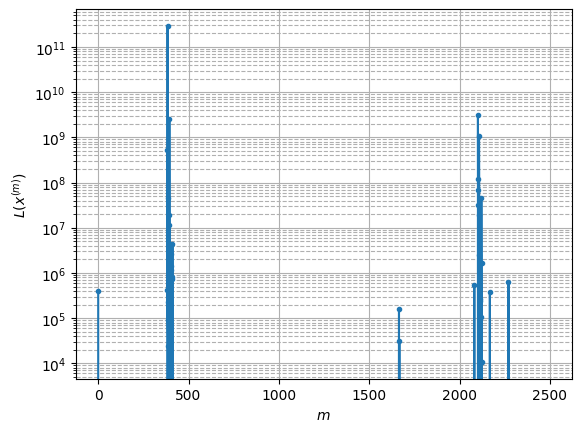

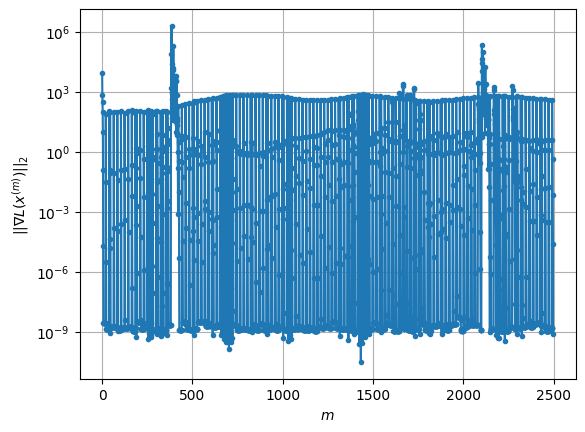

Windows:  41%|████▏     | 163/395 [01:46<02:47,  1.38it/s]

Before applying the algorithm
Cost function: -222676.2821797608
Gradient norm: 359.42580179484696
Global relative error: 177.62960757446663
Position relative errors: 1.1029086560211598 m, 5.509409763606472 m, 103.70105464781845 m, 144.08291116569637 m

Iteration 1
Cost function: -236352.0723727874 (-6.14%)
Gradient norm: 3.7204413751214838 (-98.96%)
Global relative error: 89.24318383882368 (-49.76%)
Position relative errors: 0.36397071958108707 m, 17.41776721892558 m, 35.40605313604579 m, 80.00207944097332 m

Iteration 2
Cost function: -236358.47653017723 (-0.00%)
Gradient norm: 0.24688801848172232 (-93.36%)
Global relative error: 70.87558729195132 (-20.58%)
Position relative errors: 0.36397071958108707 m, 11.972494276163845 m, 17.856036266102254 m, 67.48425216600381 m

Iteration 3
Cost function: -236358.48833200193 (-0.00%)
Gradient norm: 0.003144064146798167 (-98.73%)
Global relative error: 66.13449937650405 (-6.69%)
Position relative errors: 0.36397071958108707 m, 11.66134509319446 

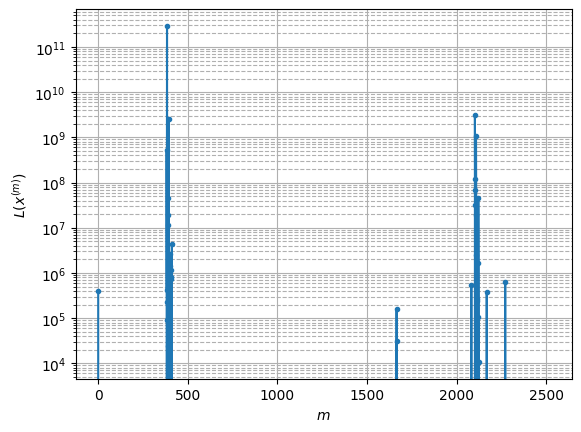

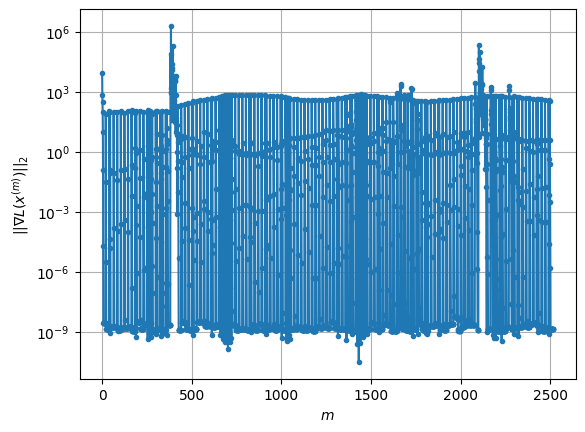

Windows:  42%|████▏     | 164/395 [01:46<02:41,  1.43it/s]

Before applying the algorithm
Cost function: -224152.55014964007
Gradient norm: 348.00794990840075
Global relative error: 191.41197270558436
Position relative errors: 1.3039264817291596 m, 2.634563300413027 m, 100.72371946905533 m, 162.7196198957794 m

Iteration 1
Cost function: -236350.4591064018 (-5.44%)
Gradient norm: 3.8426419435666004 (-98.90%)
Global relative error: 121.64129927971251 (-36.45%)
Position relative errors: 0.13628735596934735 m, 23.87433066515923 m, 44.29012133481512 m, 110.71598267354783 m

Iteration 2
Cost function: -236359.51077612647 (-0.00%)
Gradient norm: 1.7606396104516462 (-54.18%)
Global relative error: 84.09364698302417 (-30.87%)
Position relative errors: 0.13628735596934735 m, 24.449495137566572 m, 27.454543082238025 m, 75.585933585846 m

Iteration 3
Cost function: -236359.77916686866 (-0.00%)
Gradient norm: 0.01837325265226028 (-98.96%)
Global relative error: 89.34002286411395 (6.24%)
Position relative errors: 0.13628735596934735 m, 25.250213203460692 m,

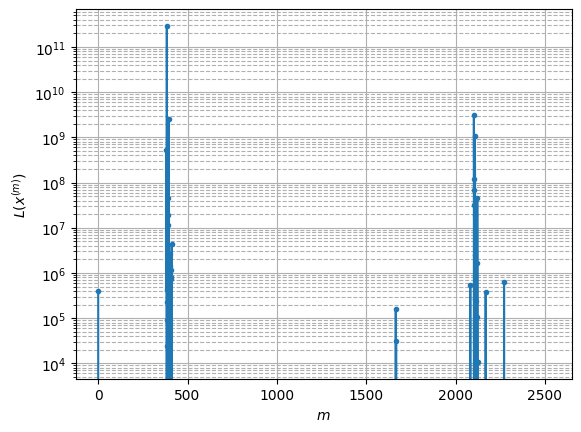

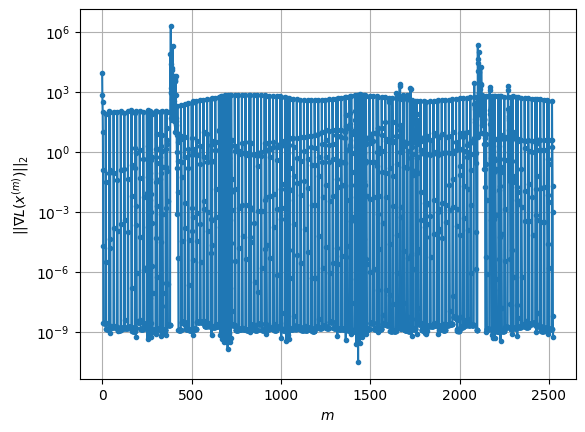

Windows:  42%|████▏     | 165/395 [01:47<02:46,  1.38it/s]

Before applying the algorithm
Cost function: -224783.768043202
Gradient norm: 334.6450140319522
Global relative error: 188.91202890944763
Position relative errors: 1.1360727002878668 m, 27.692315808825818 m, 113.0344938684621 m, 148.7810210836322 m

Iteration 1
Cost function: -236344.36118623172 (-5.14%)
Gradient norm: 3.7186407791360025 (-98.89%)
Global relative error: 107.97552831361678 (-42.84%)
Position relative errors: 0.20757679463611625 m, 27.662798403176225 m, 52.657247313196926 m, 90.07577312752163 m

Iteration 2
Cost function: -236352.46984074195 (-0.00%)
Gradient norm: 0.4617260651365265 (-87.58%)
Global relative error: 66.10513083842345 (-38.78%)
Position relative errors: 0.20757679463611625 m, 23.601743844959287 m, 17.249365042350068 m, 59.23049650553149 m

Iteration 3
Cost function: -236352.56526232028 (-0.00%)
Gradient norm: 0.030112904065540156 (-93.48%)
Global relative error: 71.55549967119553 (8.25%)
Position relative errors: 0.20757679463611625 m, 21.161069125851125 

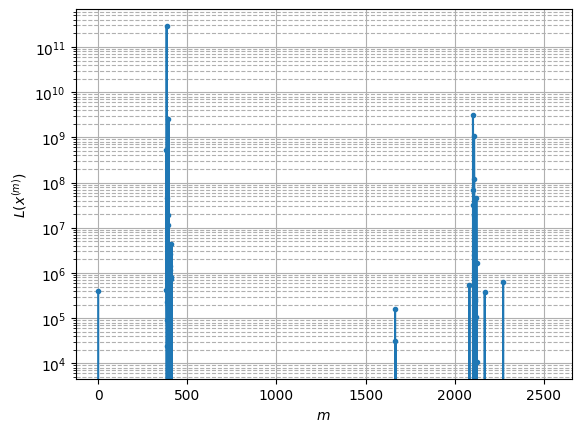

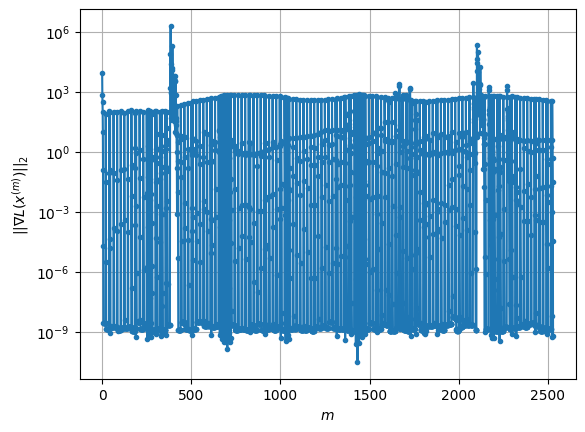

Windows:  42%|████▏     | 166/395 [01:48<02:44,  1.40it/s]

Before applying the algorithm
Cost function: -225647.3780963231
Gradient norm: 325.42741482256946
Global relative error: 175.15264601436093
Position relative errors: 1.129737925849244 m, 25.06561541307165 m, 110.00446420420509 m, 133.94343270381833 m

Iteration 1
Cost function: -236346.32363975653 (-4.74%)
Gradient norm: 3.7309473025544113 (-98.85%)
Global relative error: 74.79600244165344 (-57.30%)
Position relative errors: 0.25315480628105563 m, 12.387580394253478 m, 44.752566968893426 m, 58.57534278933534 m

Iteration 2
Cost function: -236356.0155929737 (-0.00%)
Gradient norm: 0.19394593553336703 (-94.80%)
Global relative error: 70.99953105200633 (-5.08%)
Position relative errors: 0.25315480628105563 m, 17.81233303098567 m, 9.013133554240452 m, 68.08297015478384 m

Iteration 3
Cost function: -236356.12475768212 (-0.00%)
Gradient norm: 0.03911277948522783 (-79.83%)
Global relative error: 82.82120798142589 (16.65%)
Position relative errors: 0.25315480628105563 m, 19.141555661579854 m,

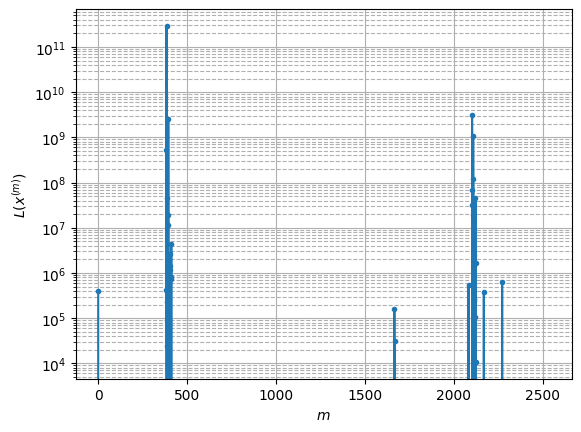

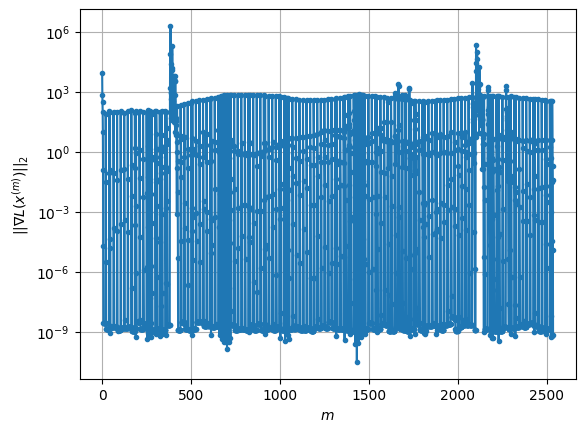

Windows:  42%|████▏     | 167/395 [01:49<02:38,  1.43it/s]

Before applying the algorithm
Cost function: -226814.75088512158
Gradient norm: 302.63710684603495
Global relative error: 192.01586044917087
Position relative errors: 1.016504306904594 m, 9.39780221154599 m, 107.07519079537809 m, 159.08647735148776 m

Iteration 1
Cost function: -236345.10330432752 (-4.20%)
Gradient norm: 3.7236738055764023 (-98.77%)
Global relative error: 93.9715170792807 (-51.06%)
Position relative errors: 0.18663681091115897 m, 21.71202943090178 m, 32.98465242758876 m, 85.22955317526342 m

Iteration 2
Cost function: -236355.2670284493 (-0.00%)
Gradient norm: 0.9618097597395495 (-74.17%)
Global relative error: 61.13773011596774 (-34.94%)
Position relative errors: 0.18663681091115897 m, 10.474612254776268 m, 21.0280613342888 m, 56.38045236087648 m

Iteration 3
Cost function: -236355.3812365417 (-0.00%)
Gradient norm: 0.02106736389060828 (-97.81%)
Global relative error: 67.3083962040236 (10.09%)
Position relative errors: 0.18663681091115897 m, 7.025843304980132 m, 25.09

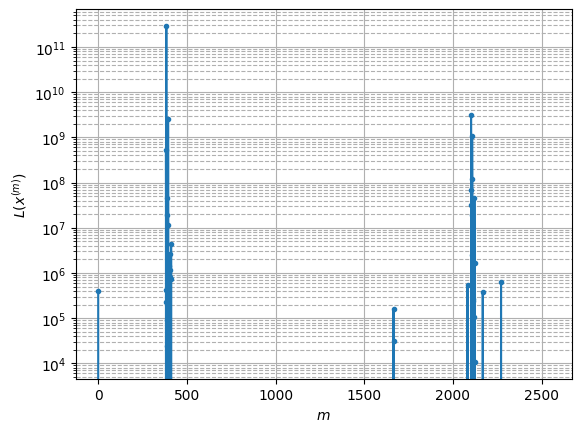

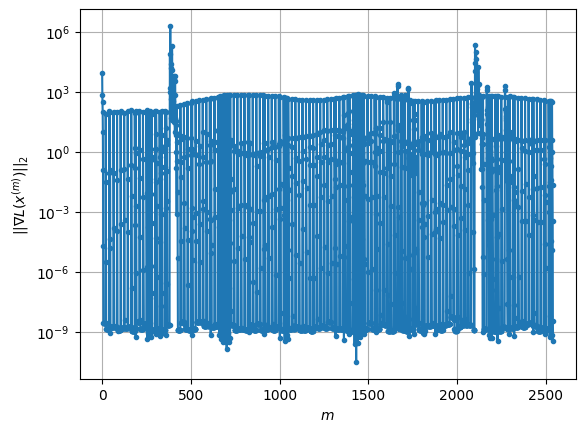

Windows:  43%|████▎     | 168/395 [01:49<02:37,  1.44it/s]

Before applying the algorithm
Cost function: -227760.74105523585
Gradient norm: 291.7509481826071
Global relative error: 192.2458786318153
Position relative errors: 1.009605277082183 m, 7.28463929799114 m, 100.43448412628864 m, 163.73794144639564 m

Iteration 1
Cost function: -236346.1214501052 (-3.77%)
Gradient norm: 3.5404247575692183 (-98.79%)
Global relative error: 120.23888920158969 (-37.46%)
Position relative errors: 0.0865021368133183 m, 20.28837175477485 m, 63.33093630124281 m, 100.13872360368977 m

Iteration 2
Cost function: -236357.23628512732 (-0.00%)
Gradient norm: 0.7716103311982725 (-78.21%)
Global relative error: 62.49353198398644 (-48.03%)
Position relative errors: 0.0865021368133183 m, 8.909337370576207 m, 39.776672092765196 m, 47.293557853807584 m

Iteration 3
Cost function: -236357.32083524522 (-0.00%)
Gradient norm: 0.023966056738012477 (-96.89%)
Global relative error: 58.83104428164804 (-5.86%)
Position relative errors: 0.0865021368133183 m, 11.503284449344532 m, 3

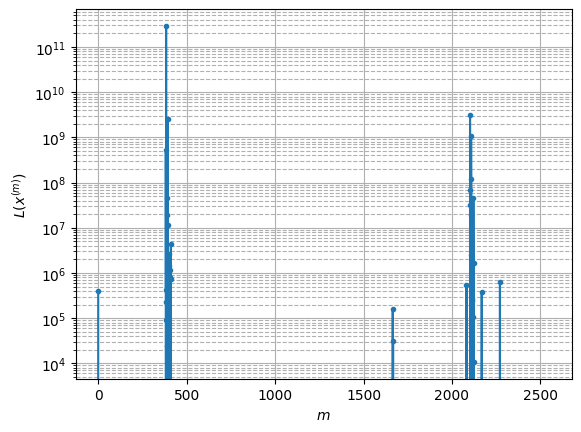

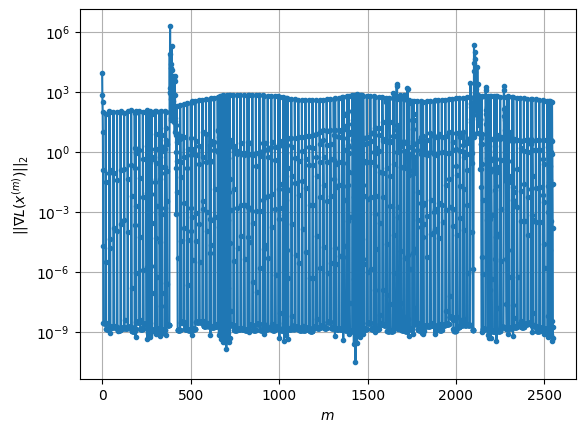

Windows:  43%|████▎     | 169/395 [01:50<02:37,  1.43it/s]

Before applying the algorithm
Cost function: -228166.44261699653
Gradient norm: 286.2470702096671
Global relative error: 169.31785267741753
Position relative errors: 1.0345420994069001 m, 25.616384732583086 m, 123.37698869776023 m, 113.05818639168623 m

Iteration 1
Cost function: -236347.4737281919 (-3.59%)
Gradient norm: 3.2872283596026133 (-98.85%)
Global relative error: 101.46293436313219 (-40.08%)
Position relative errors: 0.2543679020690567 m, 17.73358316579718 m, 74.22432555212438 m, 66.81093421078391 m

Iteration 2
Cost function: -236358.96987728632 (-0.00%)
Gradient norm: 0.5167667221818228 (-84.28%)
Global relative error: 71.54848614211488 (-29.48%)
Position relative errors: 0.2543679020690567 m, 20.709239652043614 m, 27.95297169498023 m, 62.463181089251954 m

Iteration 3
Cost function: -236359.22626594314 (-0.00%)
Gradient norm: 0.09200275288795298 (-82.20%)
Global relative error: 57.42587844176666 (-19.74%)
Position relative errors: 0.2543679020690567 m, 18.900895459201124 m

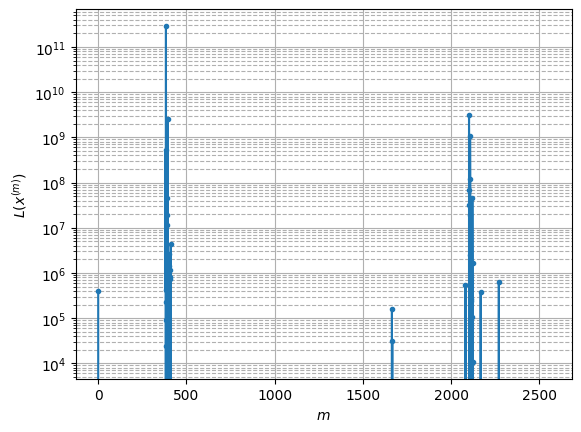

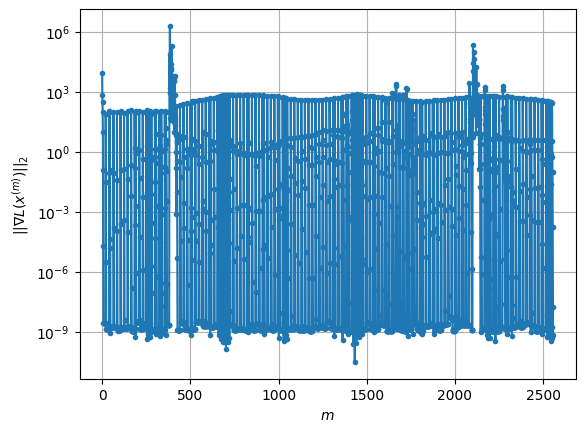

Windows:  43%|████▎     | 170/395 [01:51<02:32,  1.48it/s]

Before applying the algorithm
Cost function: -228075.5125455721
Gradient norm: 294.3283800730391
Global relative error: 155.27206984763583
Position relative errors: 1.0437300754170635 m, 30.90584716988874 m, 125.6038425807831 m, 85.8461470488442 m

Iteration 1
Cost function: -236345.70456837036 (-3.63%)
Gradient norm: 3.2503869055800387 (-98.90%)
Global relative error: 69.07953897779663 (-55.51%)
Position relative errors: 0.01994344406434355 m, 20.192139620567573 m, 32.57524759400713 m, 57.40944495948628 m

Iteration 2
Cost function: -236356.2612924263 (-0.00%)
Gradient norm: 0.370317472889595 (-88.61%)
Global relative error: 46.24617395074403 (-33.05%)
Position relative errors: 0.01994344406434355 m, 8.983596014199895 m, 14.637487574106101 m, 42.85415369241043 m

Iteration 3
Cost function: -236356.45379845484 (-0.00%)
Gradient norm: 0.06961675939698152 (-81.20%)
Global relative error: 41.464659944297786 (-10.34%)
Position relative errors: 0.01994344406434355 m, 9.984335852275018 m, 31

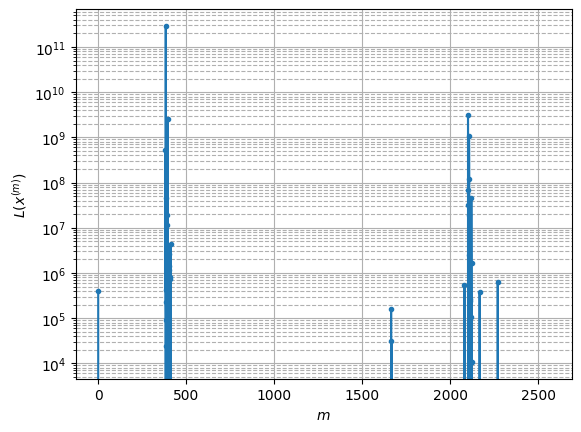

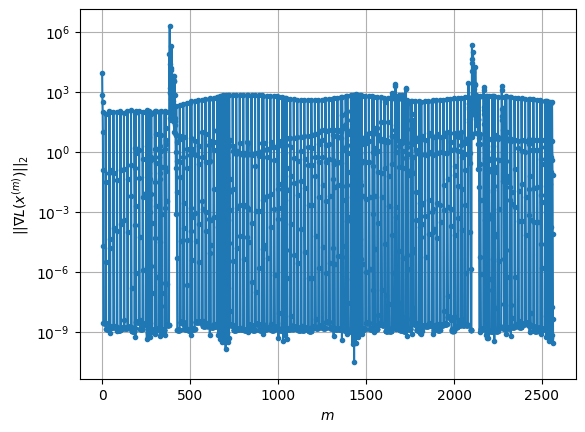

Windows:  43%|████▎     | 171/395 [01:51<02:35,  1.44it/s]

Before applying the algorithm
Cost function: -228401.12607306516
Gradient norm: 294.8242909762002
Global relative error: 162.11665780251366
Position relative errors: 1.100978393685501 m, 16.4601768436871 m, 121.10477553506844 m, 106.47050166203697 m

Iteration 1
Cost function: -236336.5760070986 (-3.47%)
Gradient norm: 3.6352069638824926 (-98.77%)
Global relative error: 95.87964864396244 (-40.86%)
Position relative errors: 0.19544187181426093 m, 46.73720208428079 m, 20.352224115727658 m, 81.16010695592604 m

Iteration 2
Cost function: -236354.8040109892 (-0.01%)
Gradient norm: 1.632829710618053 (-55.08%)
Global relative error: 57.51611333897614 (-40.01%)
Position relative errors: 0.19544187181426093 m, 14.661009483139074 m, 44.710125416582905 m, 32.96661647670335 m

Iteration 3
Cost function: -236355.0767583817 (-0.00%)
Gradient norm: 0.033652956192376744 (-97.94%)
Global relative error: 71.84972864208453 (24.92%)
Position relative errors: 0.19544187181426093 m, 19.79137990751416 m, 53

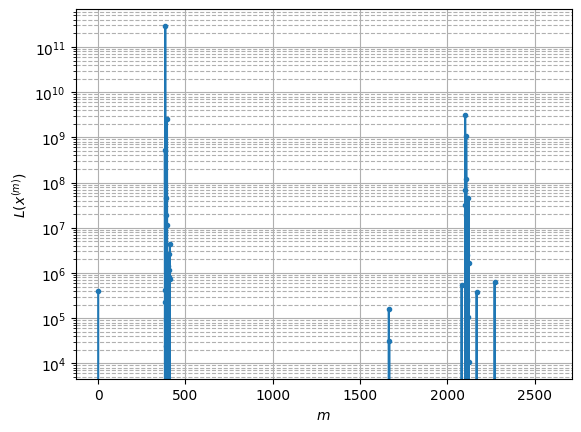

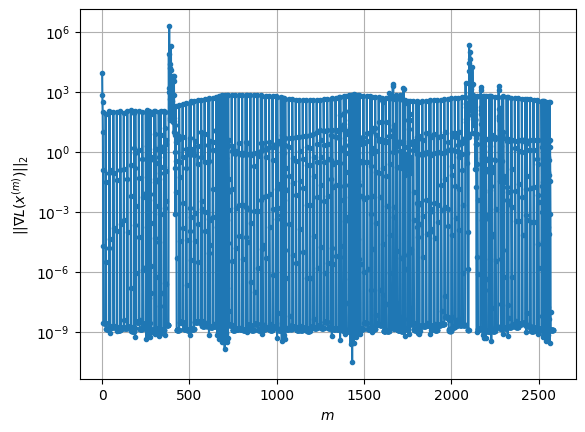

Windows:  44%|████▎     | 172/395 [01:52<02:32,  1.46it/s]

Before applying the algorithm
Cost function: -229975.76811885354
Gradient norm: 251.92499060672787
Global relative error: 192.10557851525905
Position relative errors: 0.9588979513781467 m, 22.004334813997907 m, 120.05447204360512 m, 148.32051006043508 m

Iteration 1
Cost function: -236335.3223892115 (-2.77%)
Gradient norm: 3.2628416715219895 (-98.70%)
Global relative error: 98.7326379479482 (-48.61%)
Position relative errors: 0.1342176499366812 m, 16.624135020253927 m, 97.15564948669352 m, 5.0140393787722495 m

Iteration 2
Cost function: -236352.42460401787 (-0.01%)
Gradient norm: 1.9056816298444839 (-41.59%)
Global relative error: 38.60497423928546 (-60.90%)
Position relative errors: 0.1342176499366812 m, 13.358631658335796 m, 10.942239525112564 m, 34.420158010851914 m

Iteration 3
Cost function: -236354.1138600365 (-0.00%)
Gradient norm: 0.4813671786941559 (-74.74%)
Global relative error: 109.80135062355292 (184.42%)
Position relative errors: 0.1342176499366812 m, 28.400984411301682 

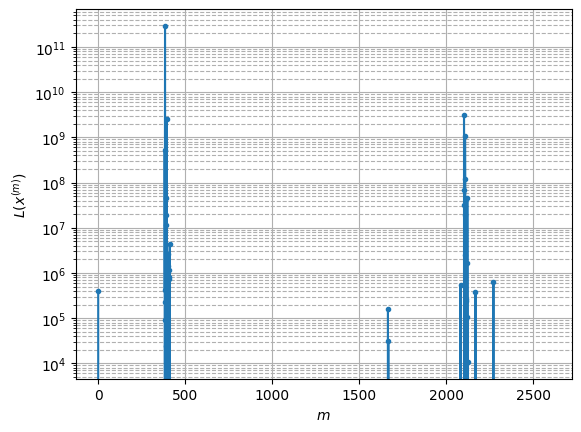

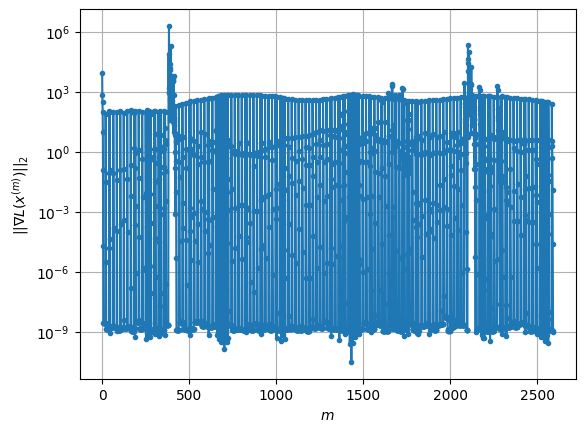

Windows:  44%|████▍     | 173/395 [01:53<02:32,  1.45it/s]

Before applying the algorithm
Cost function: -229217.7463065047
Gradient norm: 279.9527005975875
Global relative error: 192.20957758930328
Position relative errors: 1.1441024290894366 m, 22.963334371244805 m, 129.77876890237687 m, 139.87816762174478 m

Iteration 1
Cost function: -236343.58130789056 (-3.11%)
Gradient norm: 3.6104200738801158 (-98.71%)
Global relative error: 99.10524133592149 (-48.44%)
Position relative errors: 0.1760290876740002 m, 25.73541542836888 m, 35.89693744524691 m, 88.6760890126631 m

Iteration 2
Cost function: -236358.89436068444 (-0.01%)
Gradient norm: 2.5917538298211915 (-28.21%)
Global relative error: 135.25793697436188 (36.48%)
Position relative errors: 0.1760290876740002 m, 37.28536790495584 m, 37.23786504772546 m, 124.54057125687652 m

Iteration 3
Cost function: -236359.78955707804 (-0.00%)
Gradient norm: 0.1398690907082931 (-94.60%)
Global relative error: 133.17822738857922 (-1.54%)
Position relative errors: 0.1760290876740002 m, 43.500125257306905 m, 62

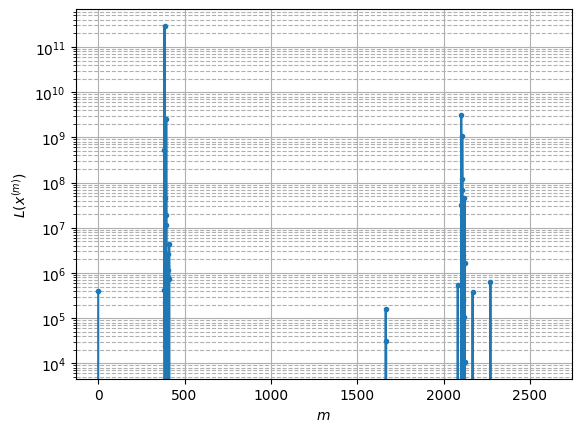

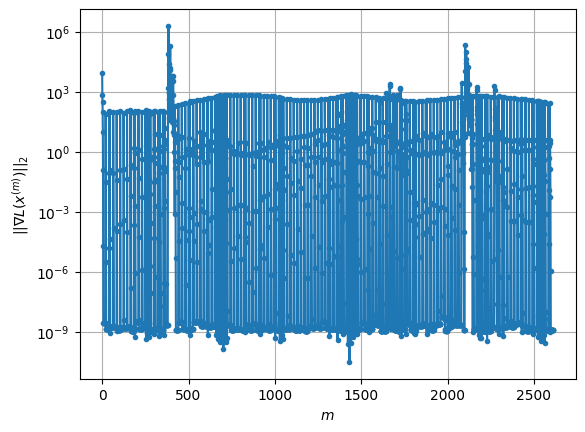

Windows:  44%|████▍     | 174/395 [01:53<02:33,  1.44it/s]

Before applying the algorithm
Cost function: -229579.5934498855
Gradient norm: 280.1341330528171
Global relative error: 223.15666585222388
Position relative errors: 1.1489269168555294 m, 47.0434813143082 m, 122.52544240351618 m, 180.45627584392992 m

Iteration 1
Cost function: -236334.58329059358 (-2.94%)
Gradient norm: 3.99807387120794 (-98.57%)
Global relative error: 147.52271649651595 (-33.89%)
Position relative errors: 0.1335981983752254 m, 74.34298679739547 m, 84.10242784719964 m, 95.68332748639331 m

Iteration 2
Cost function: -236348.974113585 (-0.01%)
Gradient norm: 5.044488134749199 (26.17%)
Global relative error: 89.10667244318603 (-39.60%)
Position relative errors: 0.1335981983752254 m, 31.471827671636348 m, 47.398697087792385 m, 68.5224925363337 m

Iteration 3
Cost function: -236351.23496570124 (-0.00%)
Gradient norm: 0.09814755198015104 (-98.05%)
Global relative error: 117.98056424053173 (32.40%)
Position relative errors: 0.1335981983752254 m, 41.79826324869641 m, 66.04401

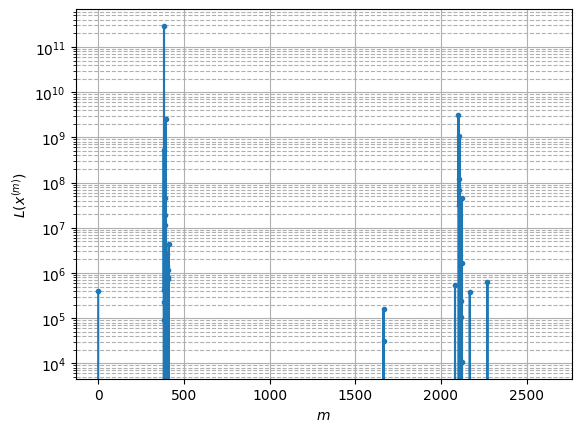

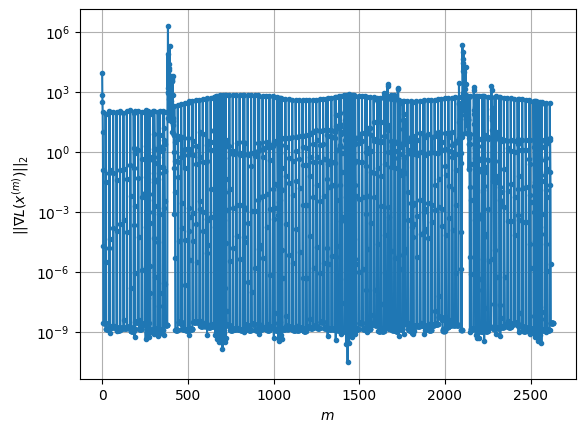

Windows:  44%|████▍     | 175/395 [01:54<02:33,  1.43it/s]

Before applying the algorithm
Cost function: -229575.72696708635
Gradient norm: 278.6971408834181
Global relative error: 227.7461093682851
Position relative errors: 1.085674726682953 m, 34.71381910608336 m, 96.74126721277618 m, 203.21309499393024 m

Iteration 1
Cost function: -236347.1054371724 (-2.95%)
Gradient norm: 5.191184297997722 (-98.14%)
Global relative error: 37.6103425746758 (-83.49%)
Position relative errors: 0.19689416038852356 m, 24.7319513856954 m, 22.7231847407433 m, 16.69906914366113 m

Iteration 2
Cost function: -236353.78945977998 (-0.00%)
Gradient norm: 0.18055115560645063 (-96.52%)
Global relative error: 64.09382597999874 (70.42%)
Position relative errors: 0.19689416038852356 m, 19.163993204099064 m, 50.83248026676637 m, 33.899150858732014 m

Iteration 3
Cost function: -236353.80714288243 (-0.00%)
Gradient norm: 0.010237085809429045 (-94.33%)
Global relative error: 71.39235285107611 (11.39%)
Position relative errors: 0.19689416038852356 m, 21.49555480435596 m, 53.88

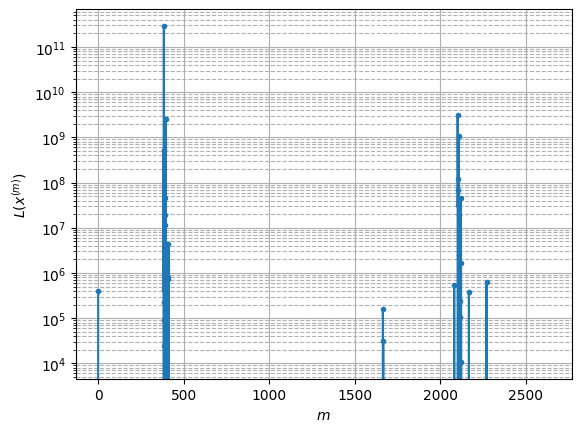

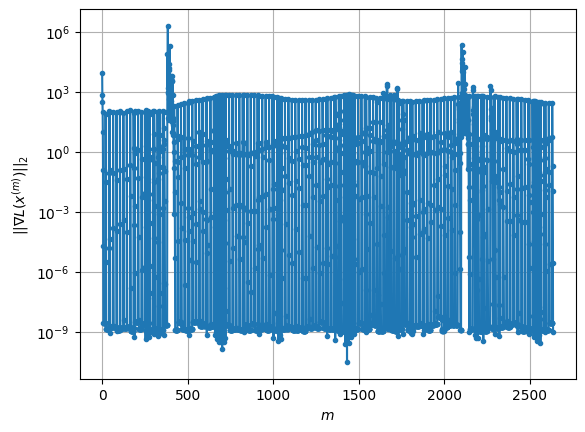

Windows:  45%|████▍     | 176/395 [01:55<02:26,  1.49it/s]

Before applying the algorithm
Cost function: -228042.62577135625
Gradient norm: 316.2765572911675
Global relative error: 162.20555276544977
Position relative errors: 1.1874479163728933 m, 27.313895987477515 m, 135.02722559698861 m, 85.57540822501728 m

Iteration 1
Cost function: -236346.46685701175 (-3.64%)
Gradient norm: 4.574303134565944 (-98.55%)
Global relative error: 155.5080350869926 (-4.13%)
Position relative errors: 0.2102144708537396 m, 58.648625113578724 m, 58.723820643913434 m, 131.47956568107494 m

Iteration 2
Cost function: -236356.88128619752 (-0.00%)
Gradient norm: 2.408685766602054 (-47.34%)
Global relative error: 31.1397719330309 (-79.98%)
Position relative errors: 0.2102144708537396 m, 16.45368294293458 m, 12.500122627982778 m, 23.129725500712787 m

Iteration 3
Cost function: -236357.6903733321 (-0.00%)
Gradient norm: 0.16329480635272067 (-93.22%)
Global relative error: 51.93060150462234 (66.77%)
Position relative errors: 0.2102144708537396 m, 20.12153451085482 m, 14.

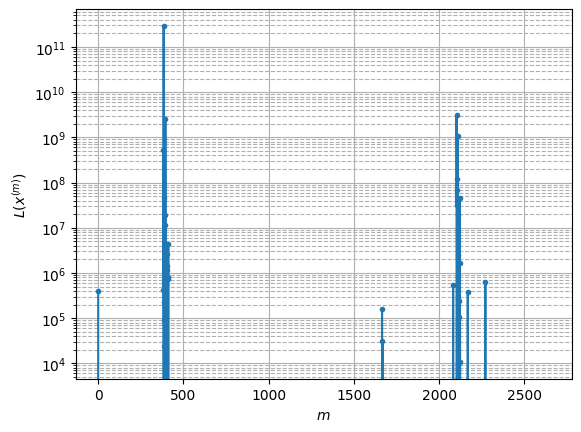

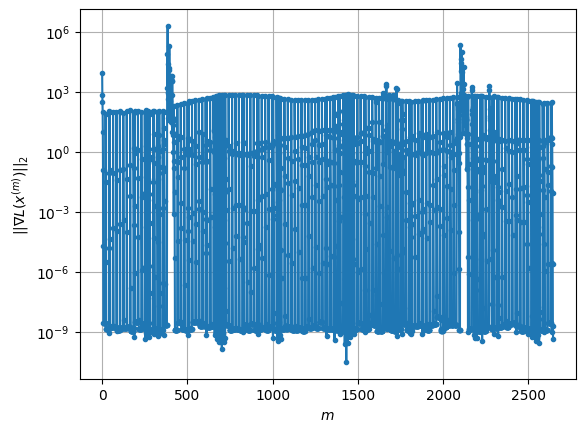

Windows:  45%|████▍     | 177/395 [01:55<02:31,  1.43it/s]

Before applying the algorithm
Cost function: -227655.72522536138
Gradient norm: 339.84735941076764
Global relative error: 178.47537178785396
Position relative errors: 1.2622299733662241 m, 23.853478005503945 m, 106.20061737307898 m, 141.4092065217533 m

Iteration 1
Cost function: -236343.53920796158 (-3.82%)
Gradient norm: 6.846950991000105 (-97.99%)
Global relative error: 135.62532777901043 (-24.01%)
Position relative errors: 0.14066979554552927 m, 50.019057000747424 m, 63.14454855539261 m, 109.07487242188871 m

Iteration 2
Cost function: -236355.53525710007 (-0.01%)
Gradient norm: 3.203034308813932 (-53.22%)
Global relative error: 59.99936890669896 (-55.76%)
Position relative errors: 0.14066979554552927 m, 24.118503007386007 m, 18.38504758262291 m, 51.69574877555437 m

Iteration 3
Cost function: -236357.09538134557 (-0.00%)
Gradient norm: 0.3447011785221509 (-89.24%)
Global relative error: 99.88669719372906 (66.48%)
Position relative errors: 0.14066979554552927 m, 40.784950802812006 

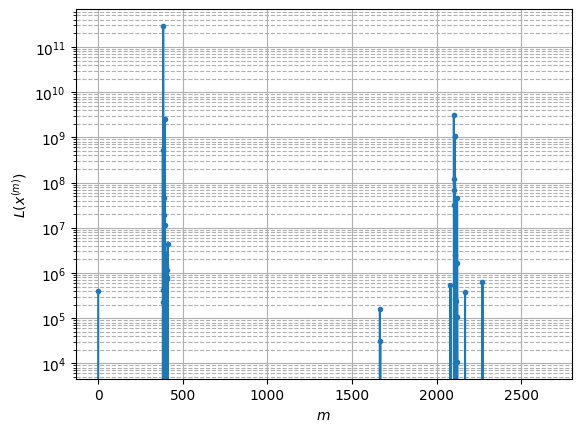

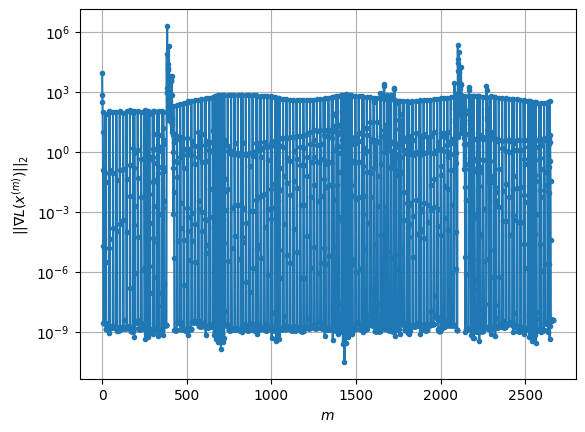

Windows:  45%|████▌     | 178/395 [01:56<02:25,  1.49it/s]

Before applying the algorithm
Cost function: -227310.65863878565
Gradient norm: 330.5555294206489
Global relative error: 233.7305261822723
Position relative errors: 0.9717878582397742 m, 37.254126879074974 m, 85.02435756786289 m, 214.48586404816754 m

Iteration 1
Cost function: -236334.86682977132 (-3.97%)
Gradient norm: 9.170802240851215 (-97.23%)
Global relative error: 110.09383142645028 (-52.90%)
Position relative errors: 0.18854388445860612 m, 48.40899930383166 m, 42.35243262797089 m, 89.30643389080468 m

Iteration 2
Cost function: -236351.3689151602 (-0.01%)
Gradient norm: 1.754277480111843 (-80.87%)
Global relative error: 22.559182045649504 (-79.51%)
Position relative errors: 0.18854388445860612 m, 5.103761032396219 m, 12.176028057327045 m, 18.076499602587273 m

Iteration 3
Cost function: -236352.97849434149 (-0.00%)
Gradient norm: 0.6621508916152171 (-62.26%)
Global relative error: 89.27816903981578 (295.75%)
Position relative errors: 0.18854388445860612 m, 26.87519588833174 m, 

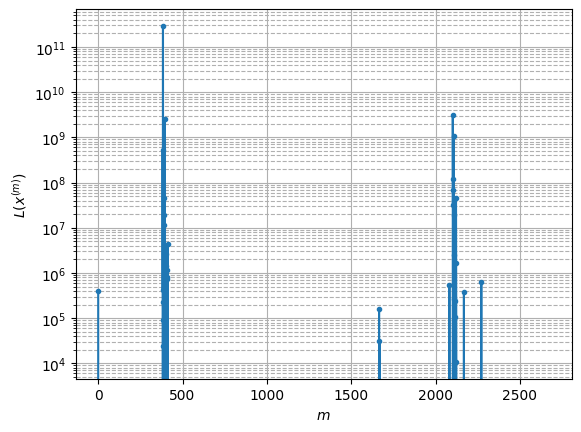

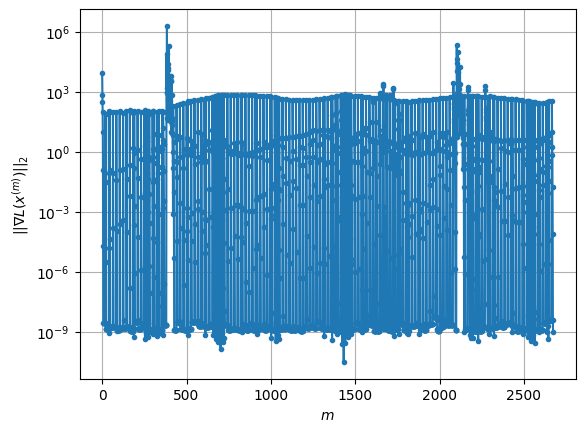

Windows:  45%|████▌     | 179/395 [01:57<02:31,  1.43it/s]

Before applying the algorithm
Cost function: -225852.89278131042
Gradient norm: 370.70154682663343
Global relative error: 201.57576337706809
Position relative errors: 1.1401511384416878 m, 26.42525446314774 m, 94.94522846656153 m, 175.8144676150404 m

Iteration 1
Cost function: -236342.7415464453 (-4.64%)
Gradient norm: 7.774101651835108 (-97.90%)
Global relative error: 128.13243180391595 (-36.43%)
Position relative errors: 0.07535066221258037 m, 56.12407339913347 m, 66.63203038588544 m, 93.91647556390998 m

Iteration 2
Cost function: -236358.29433628978 (-0.01%)
Gradient norm: 1.5877530367332258 (-79.58%)
Global relative error: 24.71706890004681 (-80.71%)
Position relative errors: 0.07535066221258037 m, 7.109493257717856 m, 21.451292219676453 m, 9.610101630700209 m

Iteration 3
Cost function: -236359.06702999445 (-0.00%)
Gradient norm: 0.3102221596317912 (-80.46%)
Global relative error: 43.6558126460289 (76.62%)
Position relative errors: 0.07535066221258037 m, 10.858772788143146 m, 28

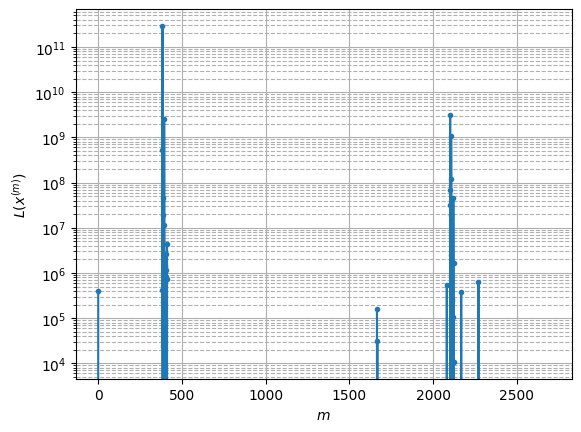

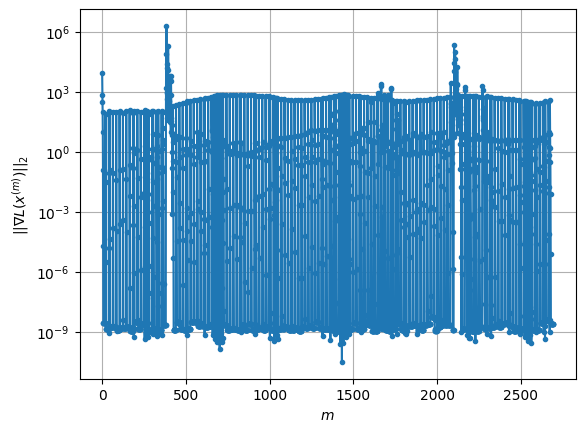

Windows:  46%|████▌     | 180/395 [01:58<02:31,  1.42it/s]

Before applying the algorithm
Cost function: -224340.6150285266
Gradient norm: 388.64747299339996
Global relative error: 190.60003744681936
Position relative errors: 1.0464314765494693 m, 11.95100872961648 m, 104.11767153424496 m, 159.1729979429281 m

Iteration 1
Cost function: -236318.93205139803 (-5.34%)
Gradient norm: 7.250997566238656 (-98.13%)
Global relative error: 148.5863893550149 (-22.04%)
Position relative errors: 0.07983373541299933 m, 102.27721914463592 m, 79.43552033618535 m, 72.79668560249321 m

Iteration 2
Cost function: -236350.5657489253 (-0.01%)
Gradient norm: 1.0321328238472391 (-85.77%)
Global relative error: 140.60620465623134 (-5.37%)
Position relative errors: 0.07983373541299933 m, 72.83033935623484 m, 84.4961021127157 m, 85.54723236336612 m

Iteration 3
Cost function: -236351.1633475633 (-0.00%)
Gradient norm: 0.2298860244954543 (-77.73%)
Global relative error: 159.8566343649464 (13.69%)
Position relative errors: 0.07983373541299933 m, 74.78908856834505 m, 93.56

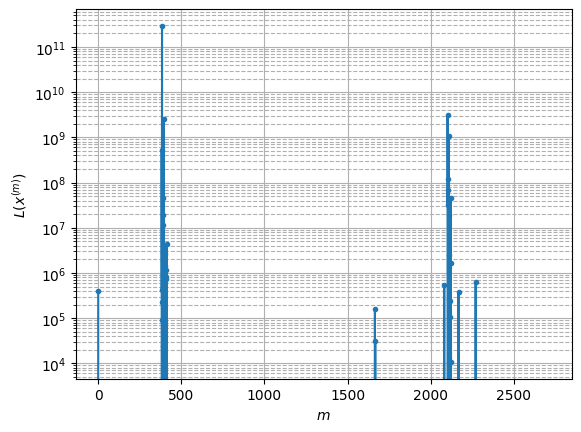

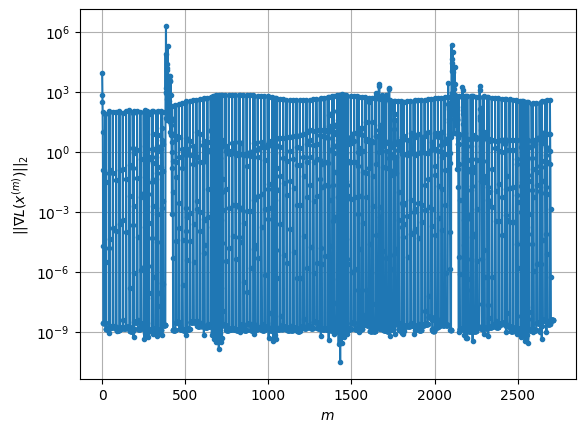

Windows:  46%|████▌     | 181/395 [01:58<02:28,  1.44it/s]

Before applying the algorithm
Cost function: -221061.06042794423
Gradient norm: 450.74114899827117
Global relative error: 217.46933218680314
Position relative errors: 1.1405200790842966 m, 83.6500458637235 m, 186.18996858316993 m, 74.96417680027514 m

Iteration 1
Cost function: -236304.3117033594 (-6.90%)
Gradient norm: 6.286047348516289 (-98.61%)
Global relative error: 313.188869146852 (44.02%)
Position relative errors: 0.07910507958007942 m, 192.576424286335 m, 143.17166717346566 m, 201.23495906366432 m

Iteration 2
Cost function: -236338.05591630444 (-0.01%)
Gradient norm: 14.056957208294026 (123.62%)
Global relative error: 124.94777180128375 (-60.10%)
Position relative errors: 0.07910507958007942 m, 20.105278740630908 m, 108.80269314258067 m, 57.980547374093305 m

Iteration 3
Cost function: -236356.89114833513 (-0.01%)
Gradient norm: 0.48211914055222227 (-96.57%)
Global relative error: 83.1013713659837 (-33.49%)
Position relative errors: 0.07910507958007942 m, 26.31728608755115 m, 

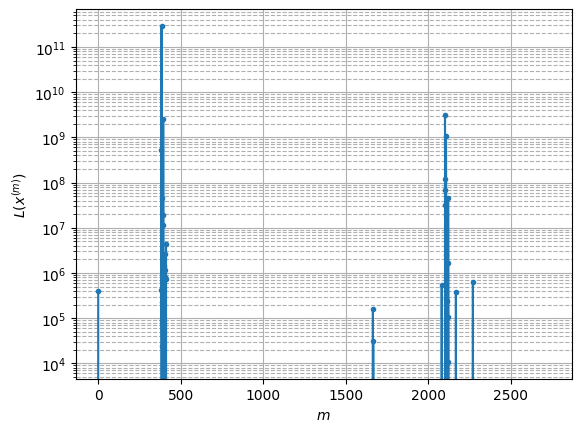

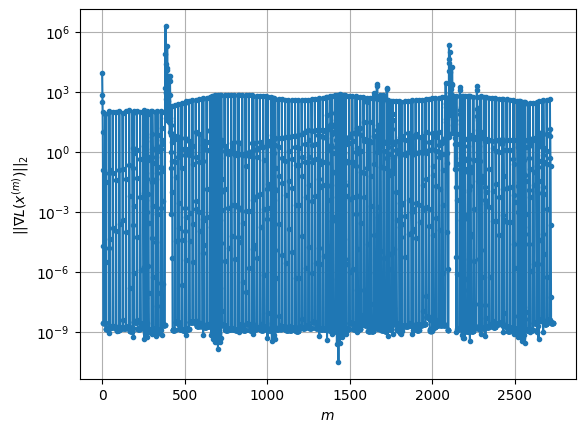

Windows:  46%|████▌     | 182/395 [01:59<02:28,  1.44it/s]

Before applying the algorithm
Cost function: -220538.75277133114
Gradient norm: 453.97570163481555
Global relative error: 173.0982839394989
Position relative errors: 1.1092397567367827 m, 20.000075931612436 m, 111.25697610992482 m, 131.056049107999 m

Iteration 1
Cost function: -236298.66127101256 (-7.15%)
Gradient norm: 5.9953124011110415 (-98.68%)
Global relative error: 184.29025157888427 (6.47%)
Position relative errors: 0.35495634482023897 m, 93.62446478040422 m, 142.5338461133918 m, 69.80940787558616 m

Iteration 2
Cost function: -236351.15170942317 (-0.02%)
Gradient norm: 2.170111971771656 (-63.80%)
Global relative error: 66.25850946737164 (-64.05%)
Position relative errors: 0.35495634482023897 m, 35.74489176566558 m, 30.589431227242102 m, 46.56902168735298 m

Iteration 3
Cost function: -236352.10903923062 (-0.00%)
Gradient norm: 0.13173137310325042 (-93.93%)
Global relative error: 36.195985873956815 (-45.37%)
Position relative errors: 0.35495634482023897 m, 17.203684293948285 m,

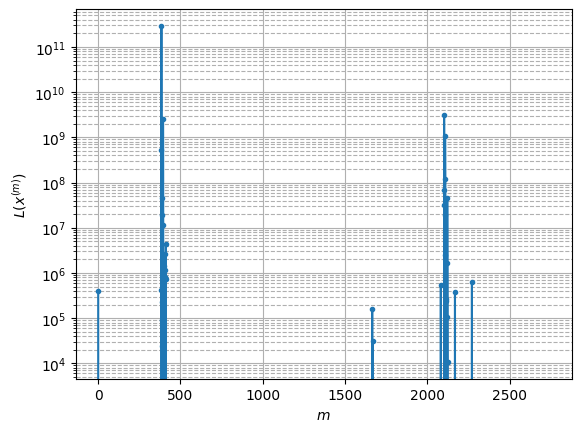

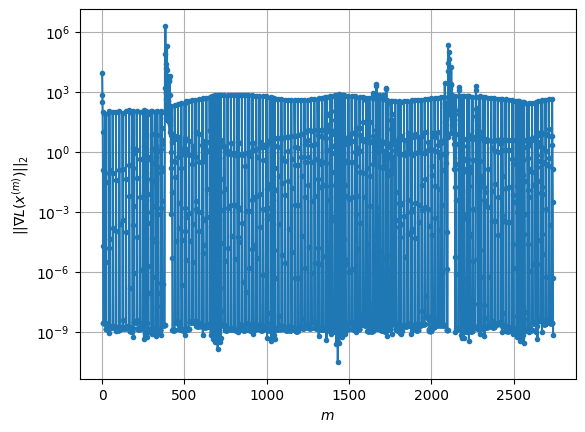

Windows:  46%|████▋     | 183/395 [02:00<02:30,  1.41it/s]

Before applying the algorithm
Cost function: -217424.11671580773
Gradient norm: 500.0532127394661
Global relative error: 175.15739715564567
Position relative errors: 1.4467363079090878 m, 25.646475476498136 m, 126.56730888888413 m, 118.29196014456623 m

Iteration 1
Cost function: -236256.15878717927 (-8.66%)
Gradient norm: 6.371530655312029 (-98.73%)
Global relative error: 231.7835368052219 (32.33%)
Position relative errors: 0.20061279370550372 m, 160.6993915474886 m, 139.95828085899785 m, 91.12049906521585 m

Iteration 2
Cost function: -236337.78137000138 (-0.03%)
Gradient norm: 7.38547204080289 (15.91%)
Global relative error: 138.19874142241363 (-40.38%)
Position relative errors: 0.20061279370550372 m, 32.1687282247971 m, 98.86083091212858 m, 91.00853480414513 m

Iteration 3
Cost function: -236356.2148560485 (-0.01%)
Gradient norm: 1.2273026019518634 (-83.38%)
Global relative error: 47.47602778688898 (-65.65%)
Position relative errors: 0.20061279370550372 m, 16.48559320169557 m, 20.5

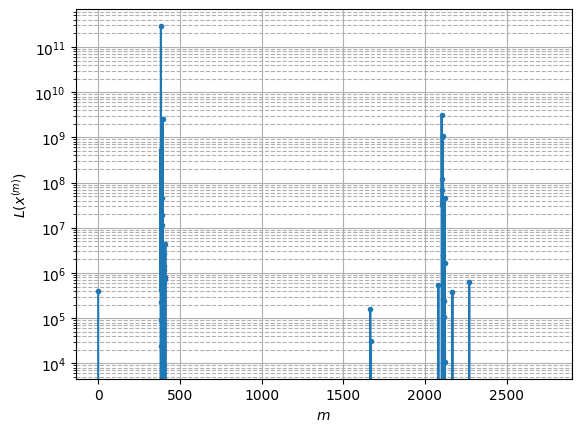

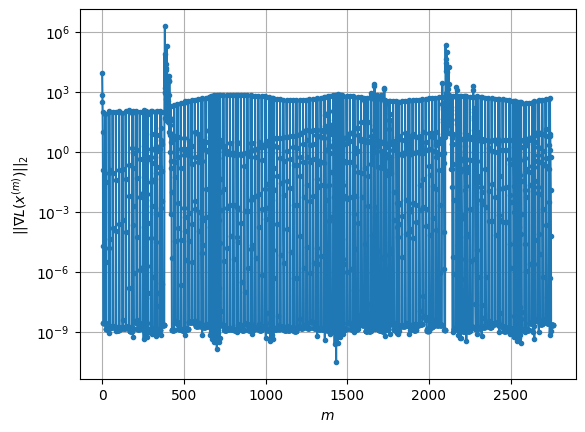

Windows:  47%|████▋     | 184/395 [02:00<02:25,  1.45it/s]

Before applying the algorithm
Cost function: -214970.63459917143
Gradient norm: 547.0380949954995
Global relative error: 195.183857383301
Position relative errors: 1.2947322707621312 m, 22.077372398451875 m, 158.00521020624424 m, 112.40096794391596 m

Iteration 1
Cost function: -236015.64489537475 (-9.79%)
Gradient norm: 14.009474238001314 (-97.44%)
Global relative error: 553.4706339933143 (183.56%)
Position relative errors: 0.2677290942545902 m, 423.6943268185657 m, 169.86505916094188 m, 312.97064188163455 m

Iteration 2
Cost function: -236307.84391942123 (-0.12%)
Gradient norm: 5.814761592984299 (-58.49%)
Global relative error: 263.0413354532952 (-52.47%)
Position relative errors: 0.2677290942545902 m, 169.846037574744 m, 57.42504162210488 m, 192.45085908028577 m

Iteration 3
Cost function: -236348.02668787315 (-0.02%)
Gradient norm: 3.800858612435389 (-34.63%)
Global relative error: 69.84277896600297 (-73.45%)
Position relative errors: 0.2677290942545902 m, 32.58903065098269 m, 46.1

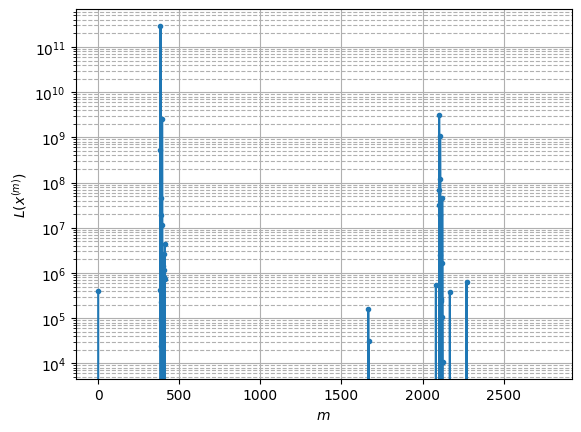

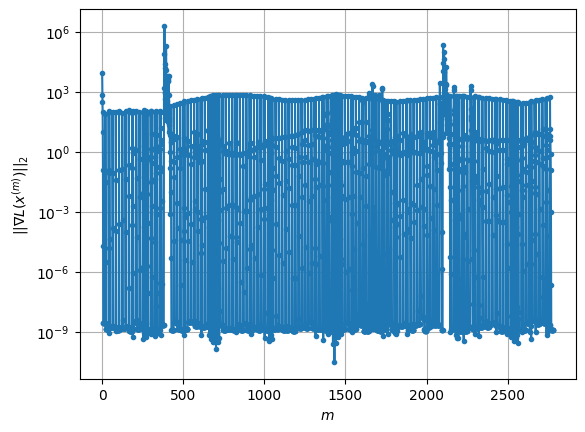

Windows:  47%|████▋     | 185/395 [02:01<02:25,  1.44it/s]

Before applying the algorithm
Cost function: -211080.73292786969
Gradient norm: 579.0043708423631
Global relative error: 226.04016223193196
Position relative errors: 1.1117040195581986 m, 52.898425453885245 m, 114.96422706461041 m, 187.26945401999248 m

Iteration 1
Cost function: -236258.99983051236 (-11.93%)
Gradient norm: 4.230652440216003 (-99.27%)
Global relative error: 213.273705363643 (-5.65%)
Position relative errors: 0.1338585352544911 m, 100.30227313960303 m, 173.22972219569812 m, 73.54263461053644 m

Iteration 2
Cost function: -236279.08672637312 (-0.01%)
Gradient norm: 13.091404274367749 (209.44%)
Global relative error: 316.83992620911823 (48.56%)
Position relative errors: 0.1338585352544911 m, 139.283547562442 m, 260.16570633714673 m, 115.29685953921351 m

Iteration 3
Cost function: -236344.87988921275 (-0.03%)
Gradient norm: 2.9595462877670853 (-77.39%)
Global relative error: 144.95474093464682 (-54.25%)
Position relative errors: 0.1338585352544911 m, 95.20408301632824 m, 

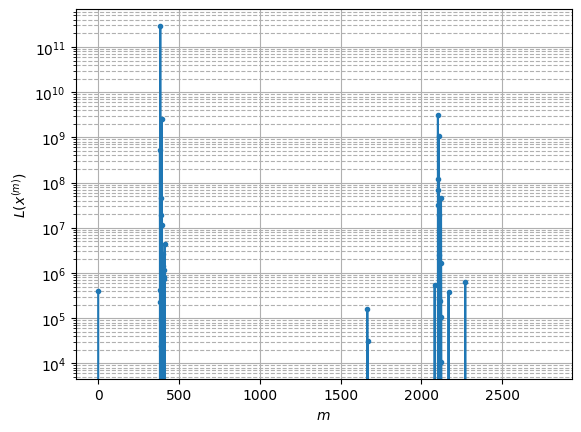

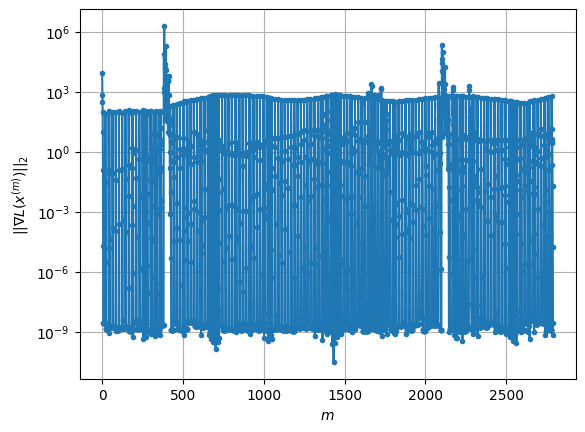

Windows:  47%|████▋     | 186/395 [02:02<02:24,  1.44it/s]

Before applying the algorithm
Cost function: -208729.22748376397
Gradient norm: 606.5428926609164
Global relative error: 222.18314388074236
Position relative errors: 1.0925137285586908 m, 24.773126234565936 m, 144.25283434797888 m, 167.1331741354744 m

Iteration 1
Cost function: -236023.01511707262 (-13.08%)
Gradient norm: 20.3350146563522 (-96.65%)
Global relative error: 594.0598507757493 (167.37%)
Position relative errors: 0.3876180337320394 m, 469.4147522820788 m, 188.39278015289804 m, 311.53946273491 m

Iteration 2
Cost function: -236306.08809376686 (-0.12%)
Gradient norm: 7.057301533026685 (-65.29%)
Global relative error: 379.82784547602927 (-36.06%)
Position relative errors: 0.3876180337320394 m, 257.1476225316281 m, 12.253902831465583 m, 279.259581933951 m

Iteration 3
Cost function: -236351.44392582495 (-0.02%)
Gradient norm: 3.782949223470372 (-46.40%)
Global relative error: 138.60483020639717 (-63.51%)
Position relative errors: 0.3876180337320394 m, 90.08459367116076 m, 46.18

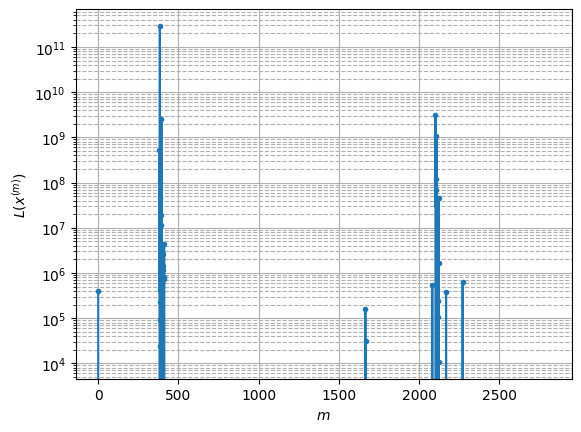

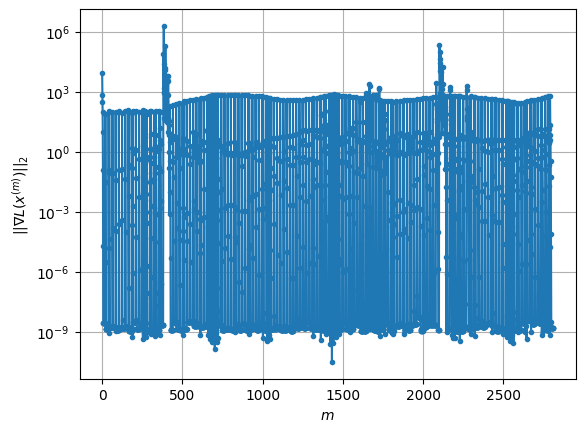

Windows:  47%|████▋     | 187/395 [02:02<02:25,  1.43it/s]

Before applying the algorithm
Cost function: -204616.58408325416
Gradient norm: 653.5677009820372
Global relative error: 190.0634344576963
Position relative errors: 1.284112271647592 m, 26.996710877168205 m, 130.67509215669003 m, 135.31295412808808 m

Iteration 1
Cost function: -236319.37844112486 (-15.49%)
Gradient norm: 1.6670642548609493 (-99.74%)
Global relative error: 177.21770249255968 (-6.76%)
Position relative errors: 0.15199489317943246 m, 113.7649382520114 m, 63.814933760070986 m, 119.93006928078428 m

Iteration 2
Cost function: -236109.17583693325 (0.09%)
Gradient norm: 34.774186604270504 (1985.95%)
Global relative error: 443.35523181178326 (150.18%)
Position relative errors: 0.15199489317943246 m, 186.7764277688314 m, 373.01147596640527 m, 150.10922952769076 m

Iteration 3
Cost function: -236323.23481489043 (-0.09%)
Gradient norm: 1.8830003954253018 (-94.59%)
Global relative error: 338.0855691321087 (-23.74%)
Position relative errors: 0.15199489317943246 m, 157.760427163344

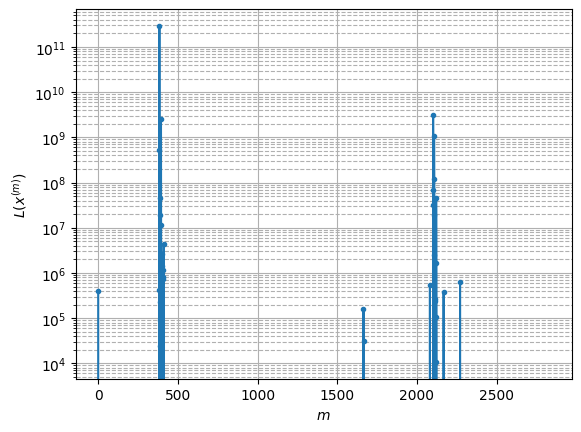

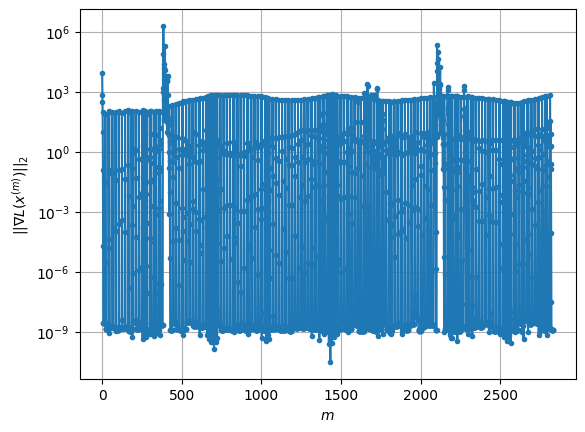

Windows:  48%|████▊     | 188/395 [02:03<02:22,  1.45it/s]

Before applying the algorithm
Cost function: -201776.79228688878
Gradient norm: 672.0247950891657
Global relative error: 192.31276721473947
Position relative errors: 1.0647859037371519 m, 36.353723784357435 m, 128.4290856305923 m, 138.41739899869037 m

Iteration 1
Cost function: -236316.707169134 (-17.12%)
Gradient norm: 6.749493786072738 (-99.00%)
Global relative error: 335.3574081570328 (74.38%)
Position relative errors: 0.06356139921459365 m, 246.67131091679562 m, 142.32412413520728 m, 177.06955744898434 m

Iteration 2
Cost function: -236354.77611410094 (-0.02%)
Gradient norm: 2.1187034192332836 (-68.61%)
Global relative error: 181.74169232567772 (-45.81%)
Position relative errors: 0.06356139921459365 m, 126.4136740615834 m, 12.900193972007838 m, 129.90434805955672 m

Iteration 3
Cost function: -236358.50961991693 (-0.00%)
Gradient norm: 0.37494509524357855 (-82.30%)
Global relative error: 96.93779619799477 (-46.66%)
Position relative errors: 0.06356139921459365 m, 65.48961749202908

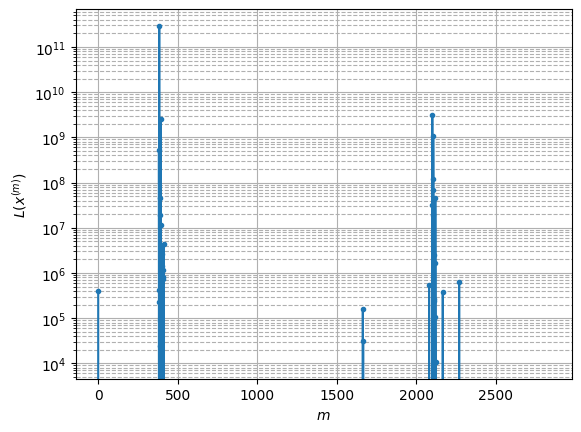

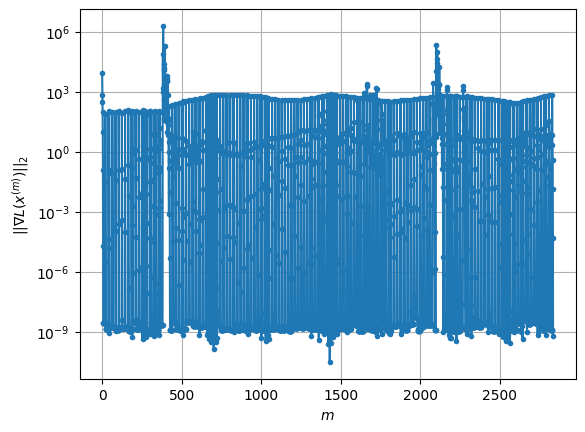

Windows:  48%|████▊     | 189/395 [02:04<02:22,  1.44it/s]

Before applying the algorithm
Cost function: -198209.0080816751
Gradient norm: 713.5414747072679
Global relative error: 200.47049212241046
Position relative errors: 1.1999086481976426 m, 57.133731752405666 m, 142.7872622602377 m, 128.55525087117292 m

Iteration 1
Cost function: -236348.04152439235 (-19.24%)
Gradient norm: 0.48087557528028213 (-99.93%)
Global relative error: 152.05236731376837 (-24.15%)
Position relative errors: 0.06382857734299675 m, 15.104735175874866 m, 133.5518590648963 m, 71.04650526558754 m

Iteration 2
Cost function: -236355.79436053077 (-0.00%)
Gradient norm: 5.064614351074129 (953.21%)
Global relative error: 87.38626406893437 (-42.53%)
Position relative errors: 0.06382857734299675 m, 11.06037415751093 m, 70.30781676197721 m, 50.62384579169066 m

Iteration 3
Cost function: -236360.0518880177 (-0.00%)
Gradient norm: 0.1978939785075775 (-96.09%)
Global relative error: 53.79954928785378 (-38.43%)
Position relative errors: 0.06382857734299675 m, 8.03075492688679 m, 

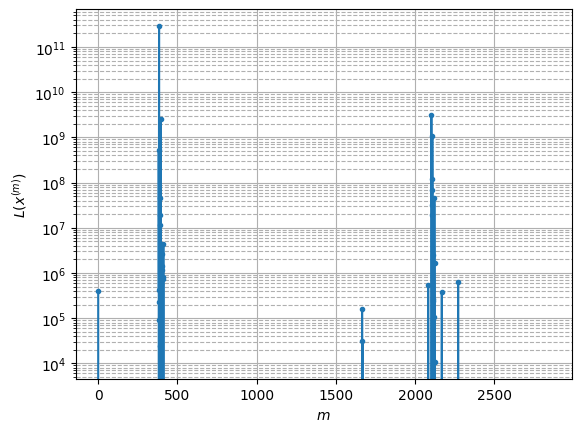

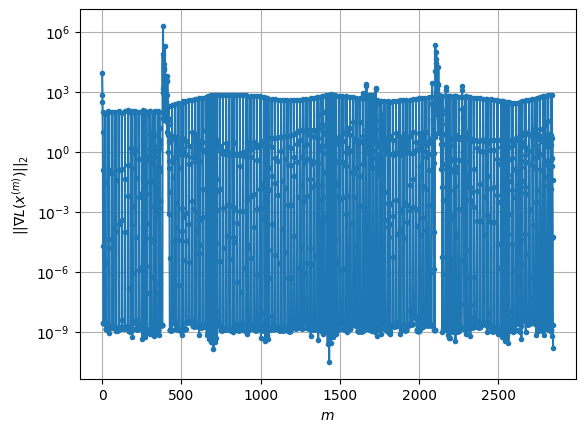

Windows:  48%|████▊     | 190/395 [02:04<02:20,  1.45it/s]

Before applying the algorithm
Cost function: -195955.91031347914
Gradient norm: 731.4605602303387
Global relative error: 174.7216967779786
Position relative errors: 1.1352402239957604 m, 16.2607761982073 m, 131.47142103051954 m, 113.88233736999113 m

Iteration 1
Cost function: -236350.52740798492 (-20.61%)
Gradient norm: 0.12743402111331342 (-99.98%)
Global relative error: 85.85282455808584 (-50.86%)
Position relative errors: 0.25582315677683004 m, 7.354958612391213 m, 79.10965857033689 m, 32.406174479622564 m

Iteration 2
Cost function: -236354.21567597313 (-0.00%)
Gradient norm: 1.5199861816201103 (1092.76%)
Global relative error: 151.57007882034975 (76.55%)
Position relative errors: 0.25582315677683004 m, 86.9807222755875 m, 70.90503008067243 m, 101.84402589445608 m

Iteration 3
Cost function: -236355.03838560396 (-0.00%)
Gradient norm: 0.07121487563871816 (-95.31%)
Global relative error: 103.41752713202368 (-31.77%)
Position relative errors: 0.25582315677683004 m, 59.95513672823729

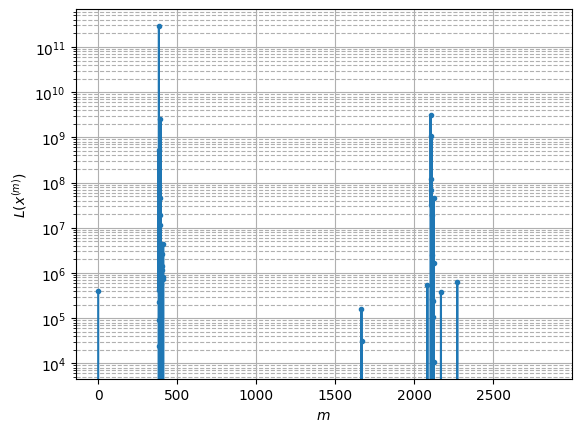

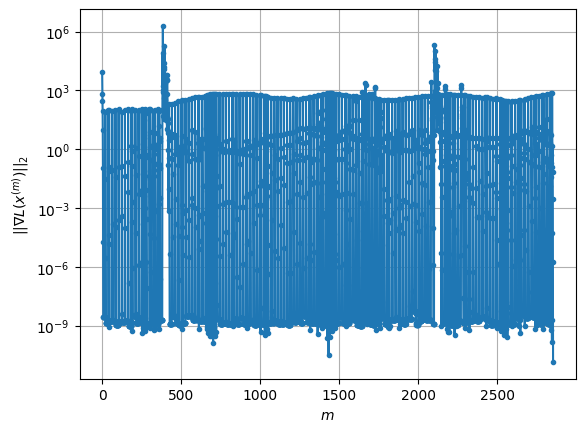

Windows:  48%|████▊     | 191/395 [02:05<02:19,  1.46it/s]

Before applying the algorithm
Cost function: -193795.66838039027
Gradient norm: 743.2452669768609
Global relative error: 167.20933422131037
Position relative errors: 1.3422967855027446 m, 60.34800258178705 m, 108.05462395974276 m, 112.38979635624092 m

Iteration 1
Cost function: -236312.69307355589 (-21.94%)
Gradient norm: 10.290676643292882 (-98.62%)
Global relative error: 502.16793585773866 (200.32%)
Position relative errors: 0.190934185569192 m, 355.0022939465364 m, 174.7182947587662 m, 309.21105725161476 m

Iteration 2
Cost function: -236345.18105950233 (-0.01%)
Gradient norm: 2.7501706993161954 (-73.28%)
Global relative error: 296.6318787604641 (-40.93%)
Position relative errors: 0.190934185569192 m, 213.37753584332376 m, 133.643030507321 m, 156.8183421828154 m

Iteration 3
Cost function: -236354.9146200001 (-0.00%)
Gradient norm: 2.785823093572138 (1.30%)
Global relative error: 107.28259747827398 (-63.83%)
Position relative errors: 0.190934185569192 m, 58.62904553547217 m, 88.341

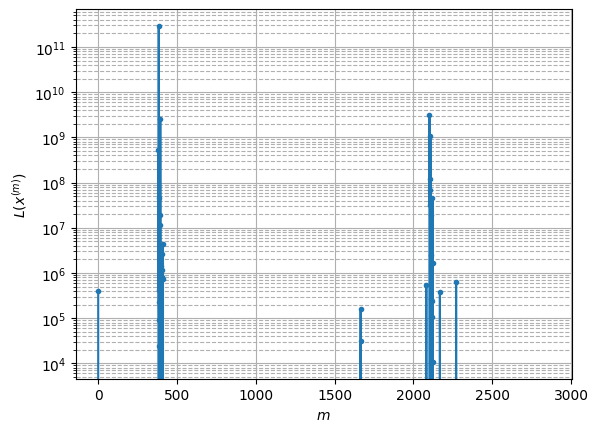

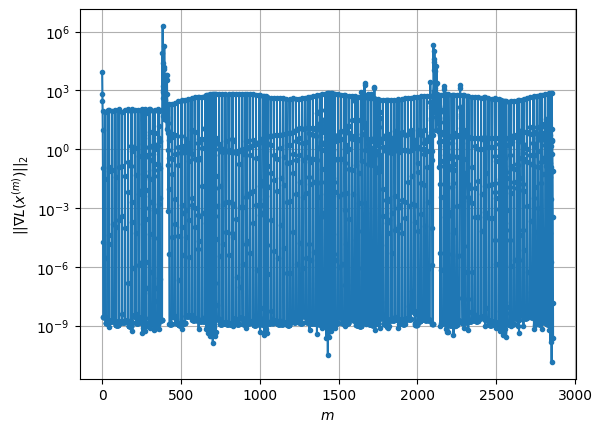

Windows:  49%|████▊     | 192/395 [02:06<02:15,  1.49it/s]

Before applying the algorithm
Cost function: -191498.99554109378
Gradient norm: 773.6868065335968
Global relative error: 226.05709958885944
Position relative errors: 1.2831139892268009 m, 56.212944606644605 m, 120.8176716284481 m, 182.57977783603684 m

Iteration 1
Cost function: -236353.77824993432 (-23.42%)
Gradient norm: 0.5146101528929643 (-99.93%)
Global relative error: 107.07343102810012 (-52.63%)
Position relative errors: 0.25863358292774274 m, 32.97580445756847 m, 53.13025108705079 m, 86.87024681276004 m

Iteration 2
Cost function: -236358.13095600094 (-0.00%)
Gradient norm: 1.034634407252995 (101.05%)
Global relative error: 74.06492826196646 (-30.83%)
Position relative errors: 0.25863358292774274 m, 32.860212054548725 m, 54.054945560221334 m, 38.41653722082752 m

Iteration 3
Cost function: -236358.22739399457 (-0.00%)
Gradient norm: 0.0020455216186093285 (-99.80%)
Global relative error: 73.64949925460111 (-0.56%)
Position relative errors: 0.25863358292774274 m, 37.3937739802242

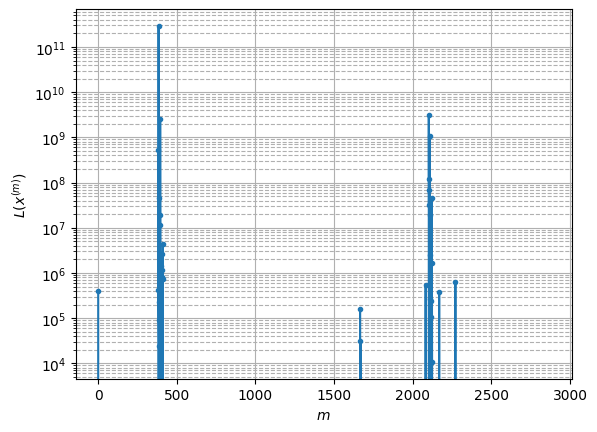

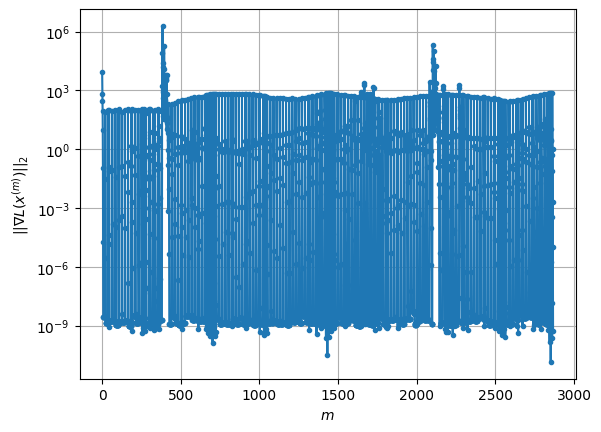

Windows:  49%|████▉     | 193/395 [02:07<02:21,  1.43it/s]

Before applying the algorithm
Cost function: -190676.4607769889
Gradient norm: 768.9381776418563
Global relative error: 193.2724264322534
Position relative errors: 0.9528301004499287 m, 41.84375138964552 m, 140.62173121777408 m, 125.77757744491373 m

Iteration 1
Cost function: -236351.07771243062 (-23.95%)
Gradient norm: 0.398949516917105 (-99.95%)
Global relative error: 113.85945206799722 (-41.09%)
Position relative errors: 0.2797933394290375 m, 62.12810259408087 m, 83.02091967618738 m, 46.94218976820669 m

Iteration 2
Cost function: -236360.93012134347 (-0.00%)
Gradient norm: 2.6911126007650705 (574.55%)
Global relative error: 127.9053634789183 (12.34%)
Position relative errors: 0.2797933394290375 m, 65.36410727208269 m, 41.16246907952315 m, 101.9065023308402 m

Iteration 3
Cost function: -236361.71391712807 (-0.00%)
Gradient norm: 0.029267375168770964 (-98.91%)
Global relative error: 126.63116691294638 (-1.00%)
Position relative errors: 0.2797933394290375 m, 61.41225248023951 m, 56.

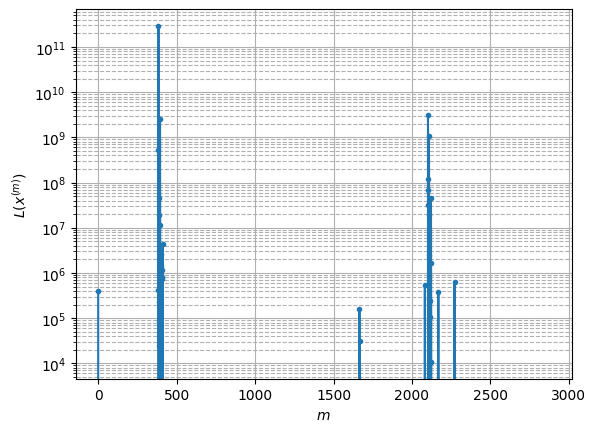

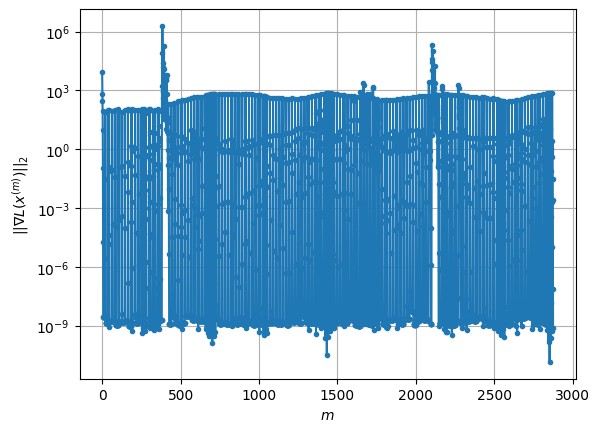

Windows:  49%|████▉     | 194/395 [02:07<02:14,  1.50it/s]

Before applying the algorithm
Cost function: -191160.96898343862
Gradient norm: 757.2671220808325
Global relative error: 201.5784975348872
Position relative errors: 1.1745926594044618 m, 61.63675519492011 m, 119.22256187622284 m, 150.37116844568266 m

Iteration 1
Cost function: -236348.9135323539 (-23.64%)
Gradient norm: 1.3861567763963214 (-99.82%)
Global relative error: 158.2446800911936 (-21.50%)
Position relative errors: 0.2974385642722765 m, 100.14632258344461 m, 105.78176512808815 m, 61.76008984258774 m

Iteration 2
Cost function: -236356.58364323014 (-0.00%)
Gradient norm: 3.06713207078965 (121.27%)
Global relative error: 76.21772103959758 (-51.84%)
Position relative errors: 0.2974385642722765 m, 17.798525803659228 m, 57.17115429539144 m, 47.07239400137397 m

Iteration 3
Cost function: -236358.080962305 (-0.00%)
Gradient norm: 0.05046753021509709 (-98.35%)
Global relative error: 89.27489286933697 (17.13%)
Position relative errors: 0.2974385642722765 m, 32.13145004807837 m, 64.42

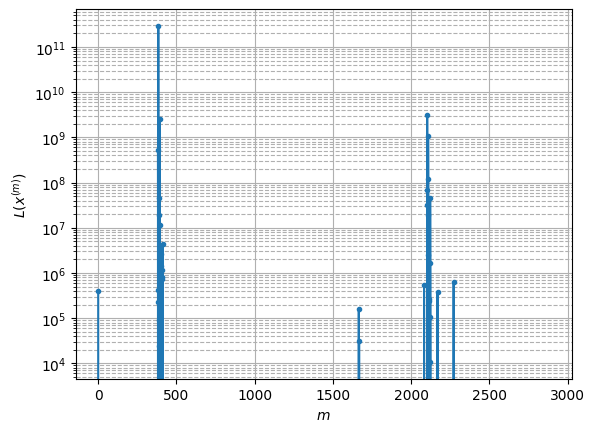

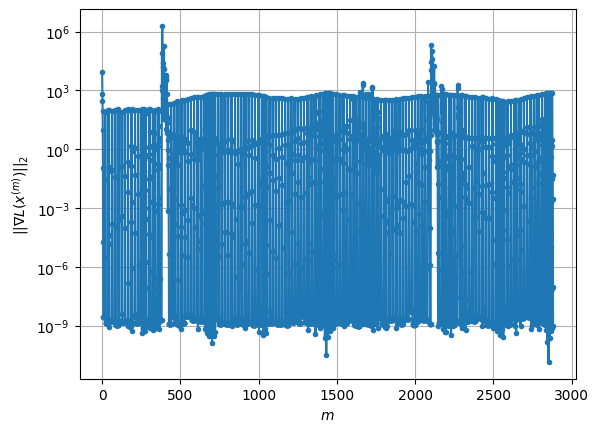

Windows:  49%|████▉     | 195/395 [02:08<02:19,  1.43it/s]

Before applying the algorithm
Cost function: -191408.7243024454
Gradient norm: 746.4441907522378
Global relative error: 174.66300375832785
Position relative errors: 0.9797569310878688 m, 39.43463543448824 m, 111.79528688716557 m, 128.23821294090132 m

Iteration 1
Cost function: -236355.9973517569 (-23.48%)
Gradient norm: 1.110215899357294 (-99.85%)
Global relative error: 35.700413205398576 (-79.56%)
Position relative errors: 0.21224720207181696 m, 17.446569574573775 m, 24.683816451604127 m, 18.78594718659265 m

Iteration 2
Cost function: -236360.6121055894 (-0.00%)
Gradient norm: 0.131188746050059 (-88.18%)
Global relative error: 14.373332634946626 (-59.74%)
Position relative errors: 0.21224720207181696 m, 8.467815544243418 m, 6.217798666626908 m, 9.39647082063055 m

Iteration 3
Cost function: -236360.61386291476 (-0.00%)
Gradient norm: 3.068218360695521e-05 (-99.98%)
Global relative error: 14.195419256098818 (-1.24%)
Position relative errors: 0.21224720207181696 m, 8.609120761975545 m

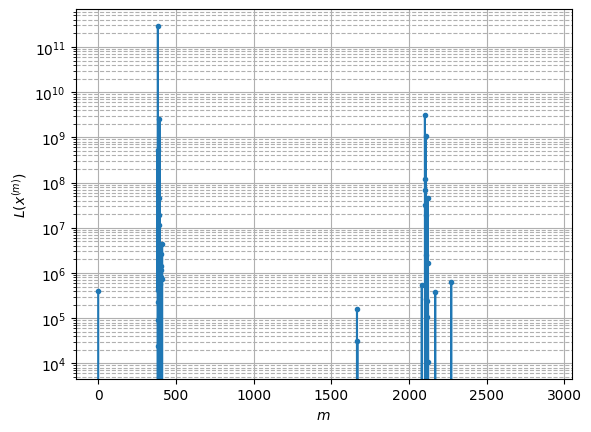

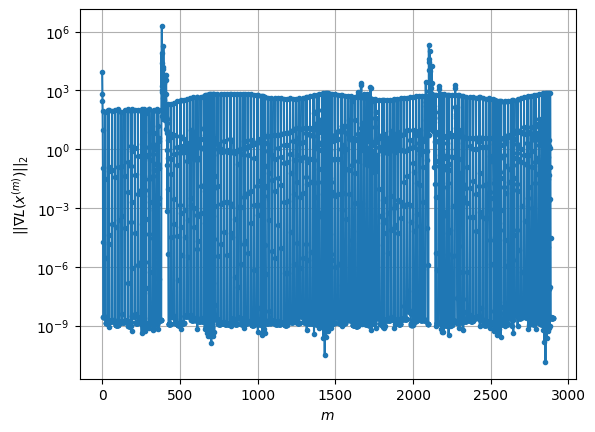

Windows:  50%|████▉     | 196/395 [02:09<02:19,  1.42it/s]

Before applying the algorithm
Cost function: -191173.07236700034
Gradient norm: 751.3521945014654
Global relative error: 169.01740318775146
Position relative errors: 1.3341151094231023 m, 15.14189882332003 m, 112.5111222087088 m, 125.17674187199044 m

Iteration 1
Cost function: -236348.77579191007 (-23.63%)
Gradient norm: 1.4704994789104808 (-99.80%)
Global relative error: 53.4818362951374 (-68.36%)
Position relative errors: 0.14208409158313717 m, 12.25656431778034 m, 35.54951373918615 m, 37.92675887499708 m

Iteration 2
Cost function: -236357.0113005073 (-0.00%)
Gradient norm: 1.1580337673167982 (-21.25%)
Global relative error: 94.8814328626951 (77.41%)
Position relative errors: 0.14208409158313717 m, 31.661884512463132 m, 73.63904495944658 m, 50.68950532298536 m

Iteration 3
Cost function: -236357.21541552746 (-0.00%)
Gradient norm: 0.02910614823916797 (-97.49%)
Global relative error: 84.62643417534642 (-10.81%)
Position relative errors: 0.14208409158313717 m, 26.251978787767747 m, 6

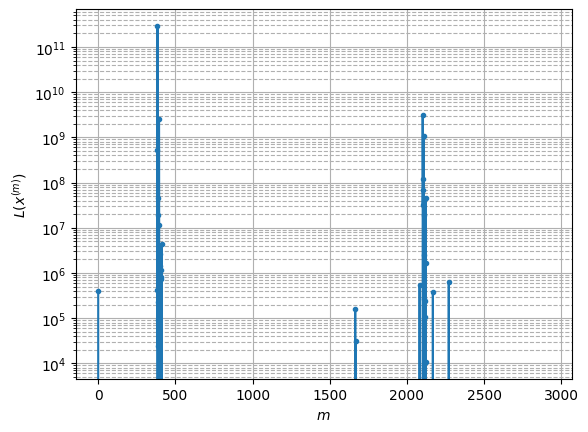

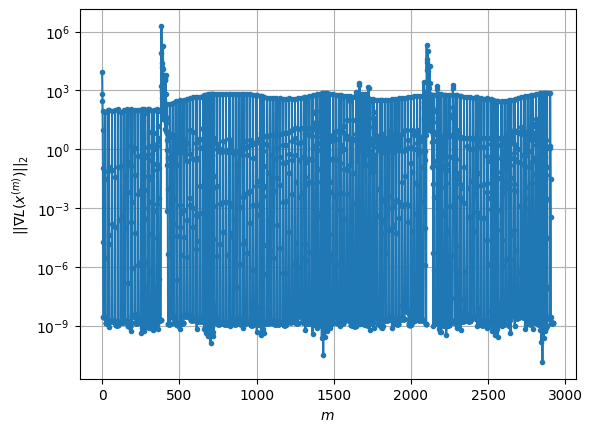

Windows:  50%|████▉     | 197/395 [02:09<02:17,  1.44it/s]

Before applying the algorithm
Cost function: -193594.33944821678
Gradient norm: 725.7238652451834
Global relative error: 200.22707051753193
Position relative errors: 1.221330643385536 m, 28.227271284820578 m, 142.9025848885551 m, 137.3449968691888 m

Iteration 1
Cost function: -236331.35224061672 (-22.08%)
Gradient norm: 2.325573506608579 (-99.68%)
Global relative error: 112.15680721255771 (-43.99%)
Position relative errors: 0.07870374709198732 m, 79.9457129600261 m, 54.349869670579075 m, 56.79881612729293 m

Iteration 2
Cost function: -235896.46682150767 (0.18%)
Gradient norm: 51.24420578239733 (2103.51%)
Global relative error: 579.6882562017988 (416.86%)
Position relative errors: 0.07870374709198732 m, 183.87929326450313 m, 490.5376522958214 m, 248.17710013249817 m

Iteration 3
Cost function: -236313.272336437 (-0.18%)
Gradient norm: 1.241908679665371 (-97.58%)
Global relative error: 503.2739737383883 (-13.18%)
Position relative errors: 0.07870374709198732 m, 160.6513672114692 m, 437

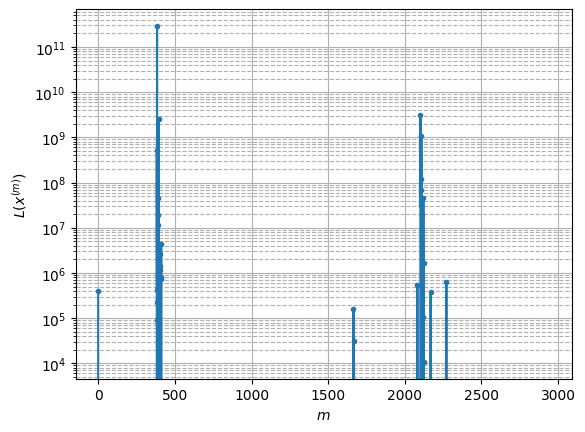

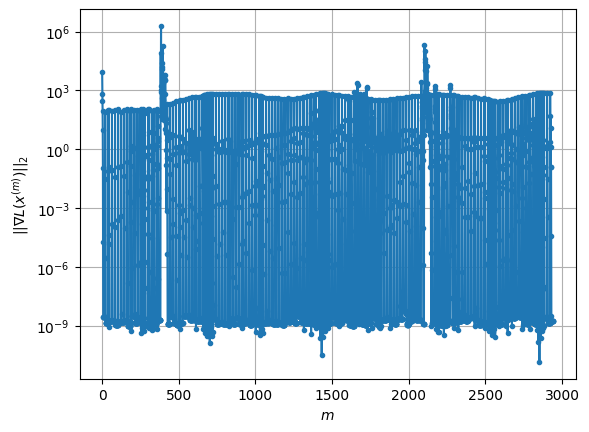

Windows:  50%|█████     | 198/395 [02:10<02:16,  1.44it/s]

Before applying the algorithm
Cost function: -195659.578997618
Gradient norm: 698.7938192653656
Global relative error: 200.94262462418178
Position relative errors: 1.2432481658673145 m, 22.4406077332878 m, 156.0561071357816 m, 124.5452119848282 m

Iteration 1
Cost function: -236314.8739013262 (-20.78%)
Gradient norm: 3.9096339473468076 (-99.44%)
Global relative error: 231.75440490629498 (15.33%)
Position relative errors: 0.17382832582971974 m, 190.91690824782788 m, 37.721408391687824 m, 125.81776513882593 m

Iteration 2
Cost function: -236334.94519235447 (-0.01%)
Gradient norm: 9.598567941474467 (145.51%)
Global relative error: 215.92572464302742 (-6.83%)
Position relative errors: 0.17382832582971974 m, 17.433572778267813 m, 158.9807412905752 m, 145.04237083873255 m

Iteration 3
Cost function: -236358.2440999683 (-0.01%)
Gradient norm: 1.10328462598421 (-88.51%)
Global relative error: 124.79921160203382 (-42.20%)
Position relative errors: 0.17382832582971974 m, 6.681178373057056 m, 101

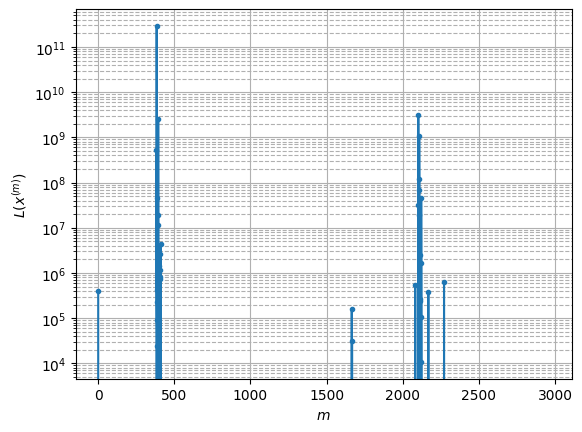

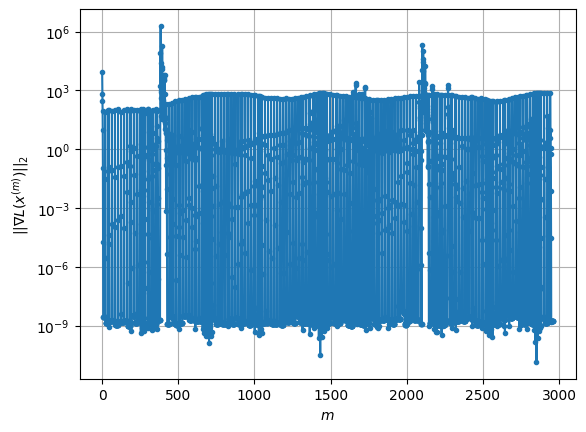

Windows:  50%|█████     | 199/395 [02:11<02:19,  1.41it/s]

Before applying the algorithm
Cost function: -196035.67041783672
Gradient norm: 689.8660348997776
Global relative error: 188.8090778352798
Position relative errors: 1.2113936960060594 m, 38.25609962912137 m, 133.834510953061 m, 127.53209686353809 m

Iteration 1
Cost function: -236269.27651687563 (-20.52%)
Gradient norm: 5.550490419278088 (-99.20%)
Global relative error: 202.71491878646324 (7.37%)
Position relative errors: 0.12914503932467936 m, 52.048245132040876 m, 169.83237527749506 m, 97.6396790214275 m

Iteration 2
Cost function: -236342.4719201303 (-0.03%)
Gradient norm: 7.4046832677279735 (33.41%)
Global relative error: 182.46209798161004 (-9.99%)
Position relative errors: 0.12914503932467936 m, 80.3846116373578 m, 157.30478103731073 m, 45.586855661379694 m

Iteration 3
Cost function: -236354.4932079619 (-0.01%)
Gradient norm: 1.8247075342614396 (-75.36%)
Global relative error: 115.55230764228719 (-36.67%)
Position relative errors: 0.12914503932467936 m, 52.70840668539066 m, 89.8

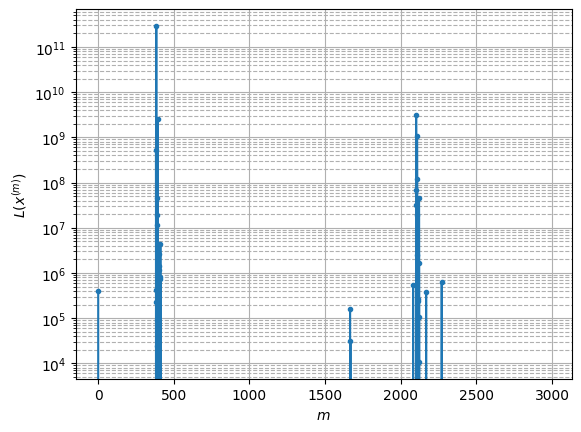

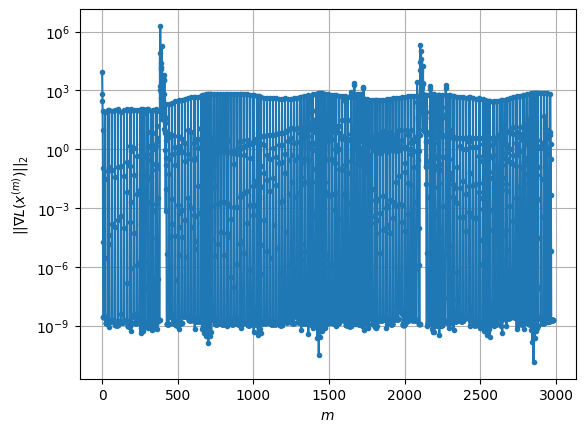

Windows:  51%|█████     | 200/395 [02:11<02:12,  1.47it/s]

Before applying the algorithm
Cost function: -199454.9963493024
Gradient norm: 664.903205006889
Global relative error: 192.6960736516377
Position relative errors: 1.2210120584471487 m, 33.07718927025211 m, 133.30354612510416 m, 135.12447908361594 m

Iteration 1
Cost function: -236287.38896648257 (-18.47%)
Gradient norm: 5.310311106120351 (-99.20%)
Global relative error: 149.75754033600694 (-22.28%)
Position relative errors: 0.049527550334632256 m, 34.833620597240895 m, 142.08268683675416 m, 31.917427664282915 m

Iteration 2
Cost function: -236353.22738313375 (-0.03%)
Gradient norm: 1.961770856085855 (-63.06%)
Global relative error: 113.89816534793901 (-23.94%)
Position relative errors: 0.049527550334632256 m, 17.565101550104686 m, 75.46696514903921 m, 83.43421823348218 m

Iteration 3
Cost function: -236355.48577846467 (-0.00%)
Gradient norm: 0.7687385875187644 (-60.81%)
Global relative error: 76.11554726495548 (-33.17%)
Position relative errors: 0.049527550334632256 m, 16.0916327854760

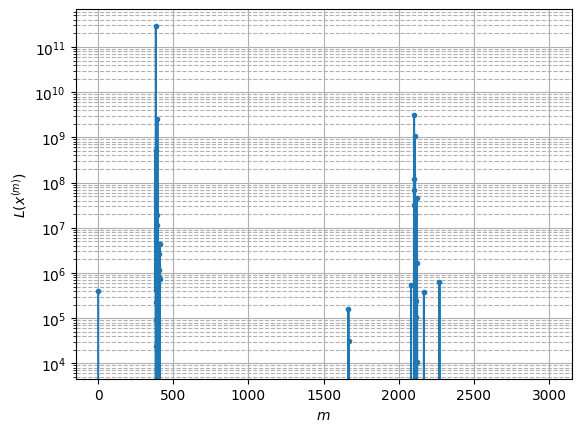

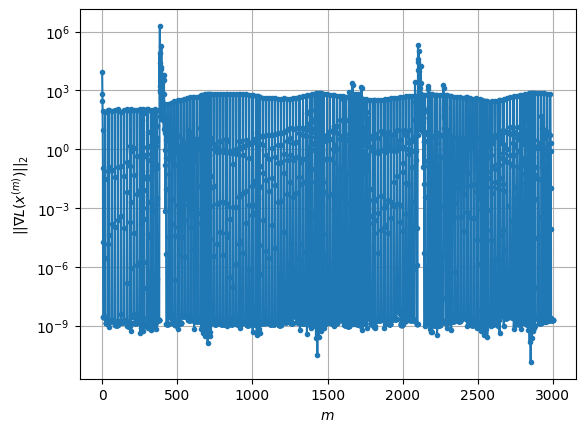

Windows:  51%|█████     | 201/395 [02:12<02:19,  1.39it/s]

Before applying the algorithm
Cost function: -200379.96700496553
Gradient norm: 645.4870262187364
Global relative error: 181.86473337667974
Position relative errors: 1.1987869994850116 m, 25.584058800413526 m, 114.37959958332127 m, 139.02665983884535 m

Iteration 1
Cost function: -236201.88098235033 (-17.88%)
Gradient norm: 9.826903698964378 (-98.48%)
Global relative error: 312.27743832035134 (71.71%)
Position relative errors: 0.10132900306089744 m, 116.54853837597331 m, 206.2804156963128 m, 203.40678792637155 m

Iteration 2
Cost function: -236342.78040770584 (-0.06%)
Gradient norm: 4.471513636233809 (-54.50%)
Global relative error: 220.68081560402172 (-29.33%)
Position relative errors: 0.10132900306089744 m, 11.316728842131377 m, 109.12906047373565 m, 191.4552082658293 m

Iteration 3
Cost function: -236353.71703714688 (-0.00%)
Gradient norm: 2.2550323604099014 (-49.57%)
Global relative error: 124.4980078964249 (-43.58%)
Position relative errors: 0.10132900306089744 m, 35.8533046885365

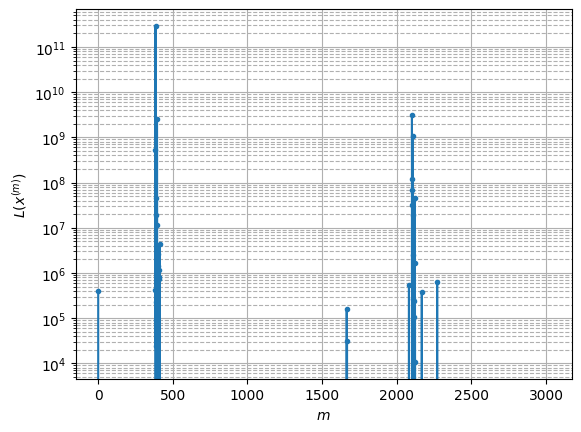

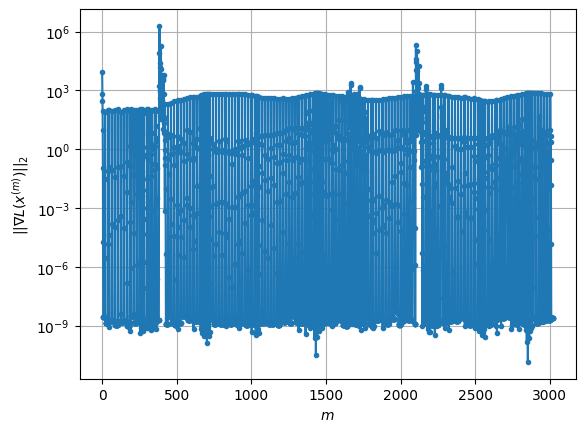

Windows:  51%|█████     | 202/395 [02:13<02:15,  1.42it/s]

Before applying the algorithm
Cost function: -203465.15672209545
Gradient norm: 618.9264629328628
Global relative error: 205.19333916618322
Position relative errors: 1.1128891610631262 m, 56.14763635891135 m, 107.46147488740019 m, 165.51396182604574 m

Iteration 1
Cost function: -236156.47366980987 (-16.07%)
Gradient norm: 14.457742900577886 (-97.66%)
Global relative error: 343.51368217777815 (67.41%)
Position relative errors: 0.3531878375894313 m, 132.17210412473423 m, 209.13247757361793 m, 238.30232083214315 m

Iteration 2
Cost function: -236353.51288555397 (-0.08%)
Gradient norm: 3.5020354417097592 (-75.78%)
Global relative error: 178.2858892519501 (-48.10%)
Position relative errors: 0.3531878375894313 m, 56.18848730895469 m, 85.52138551512598 m, 145.9692069422615 m

Iteration 3
Cost function: -236358.72767926013 (-0.00%)
Gradient norm: 1.8580281122149127 (-46.94%)
Global relative error: 61.77367925983237 (-65.35%)
Position relative errors: 0.3531878375894313 m, 12.075073442774343 m

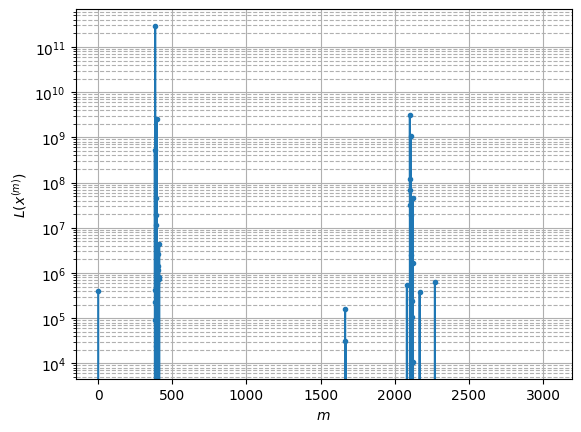

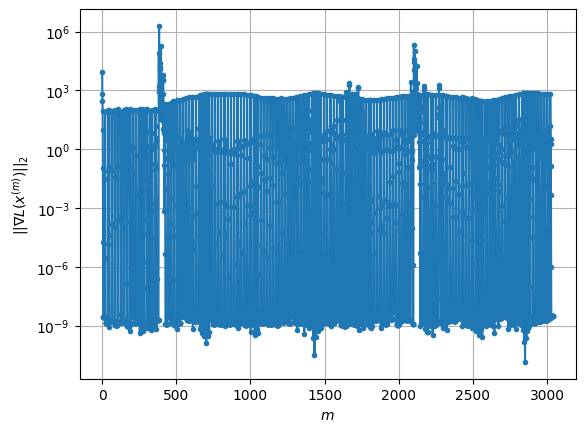

Windows:  51%|█████▏    | 203/395 [02:13<02:14,  1.43it/s]

Before applying the algorithm
Cost function: -205722.7493654257
Gradient norm: 588.2537505665127
Global relative error: 173.60887127844012
Position relative errors: 1.2033040684371246 m, 17.180227499763937 m, 116.67887273850486 m, 127.36491784992157 m

Iteration 1
Cost function: -236082.75744321133 (-14.76%)
Gradient norm: 20.027360495527407 (-96.60%)
Global relative error: 397.66995381353325 (129.06%)
Position relative errors: 0.27474486799213194 m, 127.83689815861025 m, 271.96341921159626 m, 260.43673391964904 m

Iteration 2
Cost function: -236343.1045900987 (-0.11%)
Gradient norm: 3.760688075344743 (-81.22%)
Global relative error: 260.21411547339574 (-34.57%)
Position relative errors: 0.27474486799213194 m, 60.13598618577804 m, 157.93167239712045 m, 197.85072665943886 m

Iteration 3
Cost function: -236354.77228937848 (-0.00%)
Gradient norm: 4.427215130057458 (17.72%)
Global relative error: 76.95577964076371 (-70.43%)
Position relative errors: 0.27474486799213194 m, 24.61817954671807

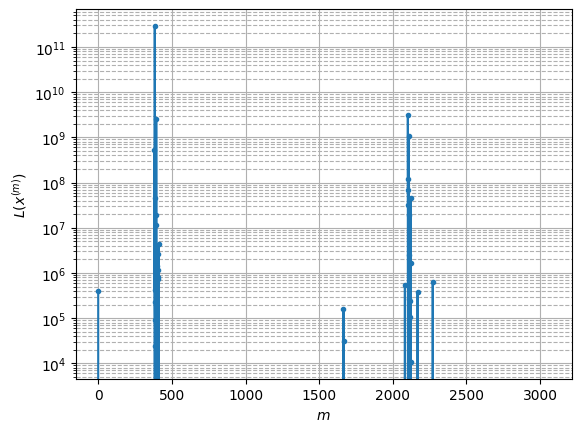

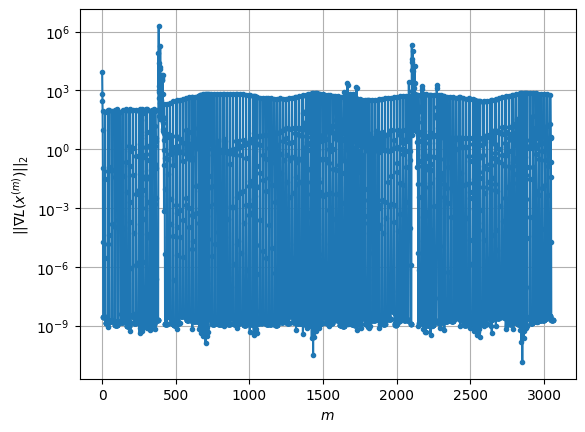

Windows:  52%|█████▏    | 204/395 [02:14<02:18,  1.38it/s]

Before applying the algorithm
Cost function: -207644.05228039742
Gradient norm: 565.6187553281786
Global relative error: 174.1792697973176
Position relative errors: 1.1221587495929755 m, 20.232734284961502 m, 125.63321060188903 m, 118.89681572452423 m

Iteration 1
Cost function: -235765.4759698572 (-13.54%)
Gradient norm: 40.410247013195395 (-92.86%)
Global relative error: 567.8916959332842 (226.04%)
Position relative errors: 0.2670734618995395 m, 192.56633201566237 m, 363.7674835604758 m, 391.26039130636354 m

Iteration 2
Cost function: -236305.88747998414 (-0.23%)
Gradient norm: 3.9421330485766153 (-90.24%)
Global relative error: 428.79866425221013 (-24.49%)
Position relative errors: 0.2670734618995395 m, 124.6230431919501 m, 219.3428205450792 m, 346.7252636634669 m

Iteration 3
Cost function: -236330.0493851599 (-0.01%)
Gradient norm: 16.37568501536406 (315.40%)
Global relative error: 94.39510269093584 (-77.99%)
Position relative errors: 0.2670734618995395 m, 10.868900151055353 m, 4

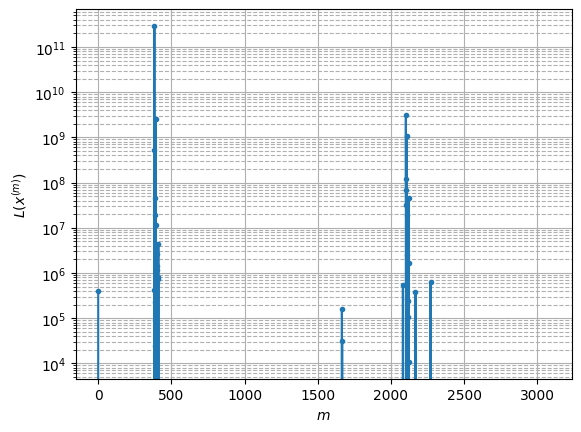

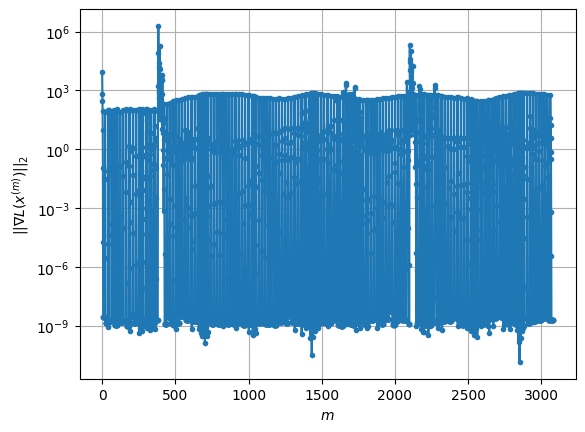

Windows:  52%|█████▏    | 205/395 [02:15<02:13,  1.43it/s]

Before applying the algorithm
Cost function: -210284.64553993632
Gradient norm: 537.2626091057052
Global relative error: 217.43009609459125
Position relative errors: 1.1768248204514888 m, 25.66754726955389 m, 109.19796423002663 m, 186.2359153479297 m

Iteration 1
Cost function: -236119.5418218731 (-12.29%)
Gradient norm: 22.19021027776816 (-95.87%)
Global relative error: 368.5258936332753 (69.49%)
Position relative errors: 0.2073168419600071 m, 121.90009302906613 m, 224.8501071160415 m, 265.3044679544502 m

Iteration 2
Cost function: -236315.53076915815 (-0.08%)
Gradient norm: 7.4903245730787065 (-66.24%)
Global relative error: 368.8703144700761 (0.09%)
Position relative errors: 0.2073168419600071 m, 37.38201578397769 m, 227.60030371892688 m, 287.8512208228612 m

Iteration 3
Cost function: -236346.4502833212 (-0.01%)
Gradient norm: 4.942261045135878 (-34.02%)
Global relative error: 203.4416433886212 (-44.85%)
Position relative errors: 0.2073168419600071 m, 13.661986866877934 m, 80.5876

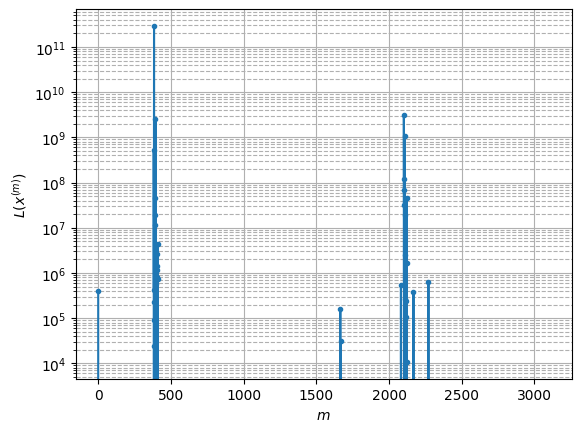

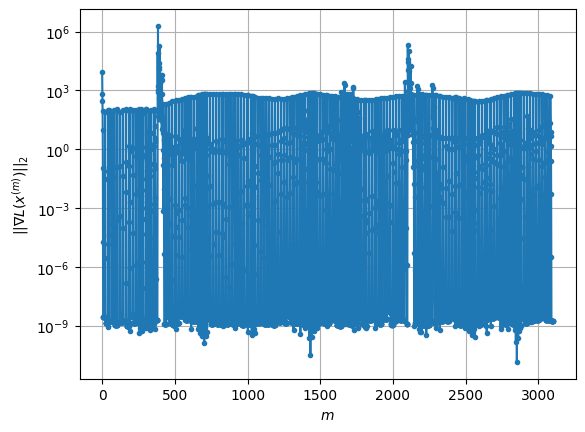

Windows:  52%|█████▏    | 206/395 [02:16<02:09,  1.46it/s]

Before applying the algorithm
Cost function: -213629.2138414523
Gradient norm: 491.49763919673154
Global relative error: 228.44099937668344
Position relative errors: 1.2253935305350407 m, 47.7429581606035 m, 98.99591100996467 m, 200.24131425841748 m

Iteration 1
Cost function: -235630.57115461584 (-10.30%)
Gradient norm: 61.701344113426124 (-87.45%)
Global relative error: 658.5205515002687 (188.27%)
Position relative errors: 0.10438195991609299 m, 217.7656004824072 m, 349.9709853823927 m, 513.5563593893869 m

Iteration 2
Cost function: -236303.2924377612 (-0.29%)
Gradient norm: 2.742743154604523 (-95.55%)
Global relative error: 564.7202558554164 (-14.24%)
Position relative errors: 0.10438195991609299 m, 188.25510579514824 m, 230.04970621115663 m, 480.1442284060849 m

Iteration 3
Cost function: -236314.1396009943 (-0.00%)
Gradient norm: 23.05138803354609 (740.45%)
Global relative error: 123.3047564326242 (-78.17%)
Position relative errors: 0.10438195991609299 m, 33.34509448795115 m, 52.

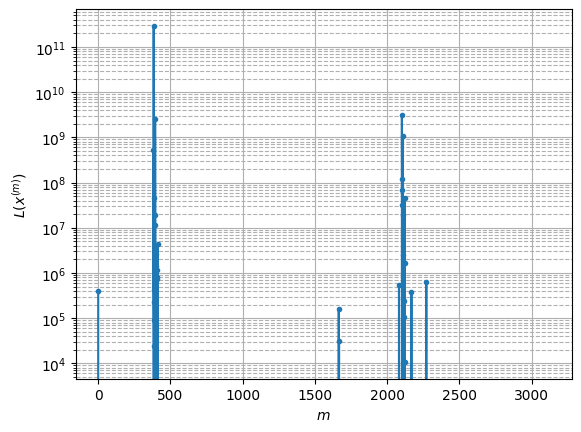

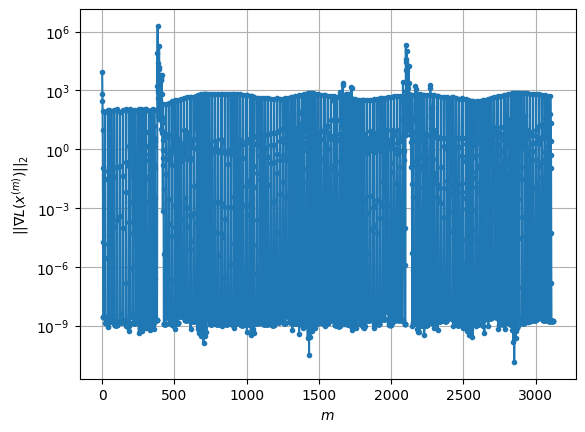

Windows:  52%|█████▏    | 207/395 [02:16<02:10,  1.44it/s]

Before applying the algorithm
Cost function: -214823.13714325317
Gradient norm: 477.19154905423005
Global relative error: 169.70555041497548
Position relative errors: 1.1401248563476538 m, 13.555935050942681 m, 121.14992095682459 m, 118.02534079388997 m

Iteration 1
Cost function: -231081.1596106522 (-7.57%)
Gradient norm: 223.27976232236523 (-53.21%)
Global relative error: 1367.2263690810378 (705.65%)
Position relative errors: 0.21653177728211961 m, 446.05832367198906 m, 696.4301495434631 m, 1088.7227792003869 m

Iteration 2
Cost function: -236038.76502340162 (-2.15%)
Gradient norm: 3.956719512861051 (-98.23%)
Global relative error: 1320.3843928165174 (-3.43%)
Position relative errors: 0.21653177728211961 m, 416.3014693066511 m, 524.0861891339146 m, 1138.171351227551 m

Iteration 3
Cost function: -235158.79288687752 (0.37%)
Gradient norm: 127.77125947278942 (3129.22%)
Global relative error: 276.1594799855675 (-79.08%)
Position relative errors: 0.21653177728211961 m, 86.87167614623874 

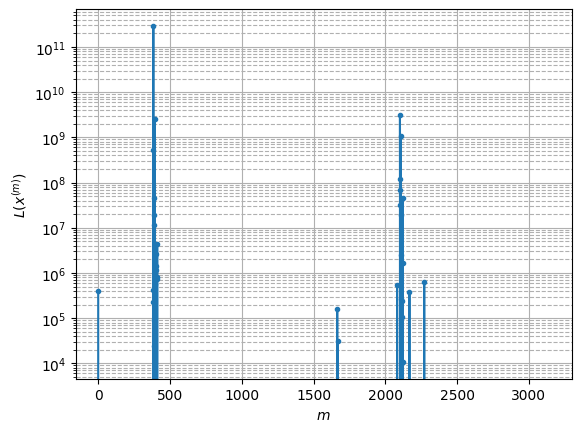

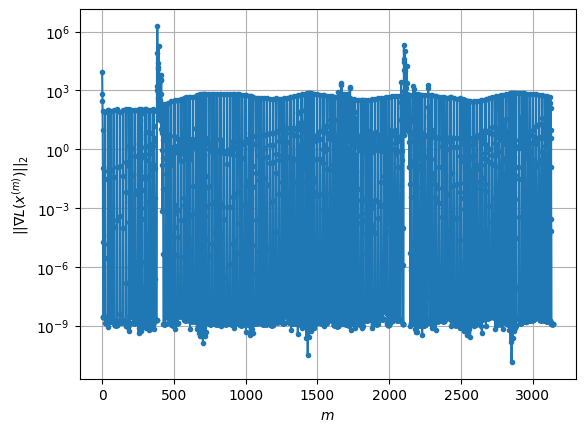

Windows:  53%|█████▎    | 208/395 [02:17<02:04,  1.51it/s]

Before applying the algorithm
Cost function: -217492.62078724534
Gradient norm: 448.10203190607416
Global relative error: 187.12717284552744
Position relative errors: 1.277217967954773 m, 13.93412255659117 m, 121.9839781183123 m, 141.1844884703838 m

Iteration 1
Cost function: -233854.8138292785 (-7.52%)
Gradient norm: 147.50001896070853 (-67.08%)
Global relative error: 1063.3554549576472 (468.25%)
Position relative errors: 0.12830703194861512 m, 323.29078699861424 m, 522.4239518231303 m, 867.9132742797653 m

Iteration 2
Cost function: -236152.00476460595 (-0.98%)
Gradient norm: 2.889243766124924 (-98.04%)
Global relative error: 997.2632192376166 (-6.22%)
Position relative errors: 0.12830703194861512 m, 298.49415708464096 m, 380.76495887234296 m, 872.0352969948897 m

Iteration 3
Cost function: -235634.95513520425 (0.22%)
Gradient norm: 99.5032512984736 (3343.92%)
Global relative error: 75.73136814811498 (-92.41%)
Position relative errors: 0.12830703194861512 m, 16.047267312250852 m, 40

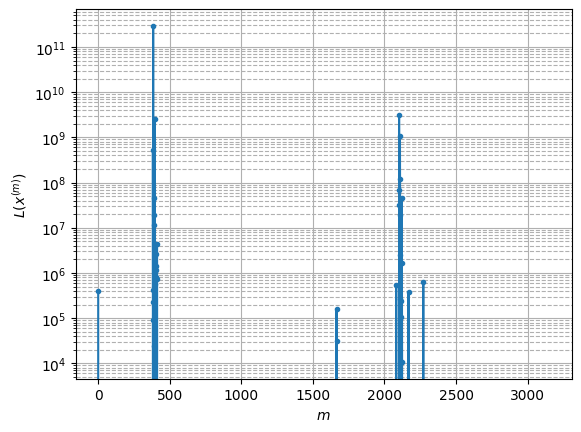

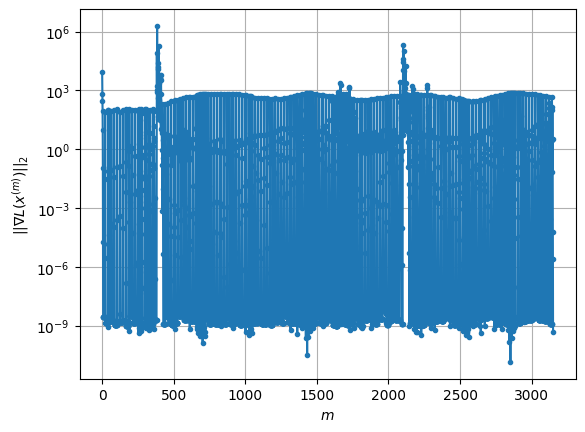

Windows:  53%|█████▎    | 209/395 [02:18<02:07,  1.46it/s]

Before applying the algorithm
Cost function: -219124.2510609348
Gradient norm: 425.8365596793702
Global relative error: 251.28657113876721
Position relative errors: 1.1734329181470577 m, 32.85076099844827 m, 111.60908181993797 m, 222.71087560070225 m

Iteration 1
Cost function: -235988.20470304575 (-7.70%)
Gradient norm: 47.79580476262224 (-88.78%)
Global relative error: 485.0143636768548 (93.01%)
Position relative errors: 0.28215302538470266 m, 130.93762341141928 m, 234.28800369361178 m, 403.9748176891712 m

Iteration 2
Cost function: -236320.79686589813 (-0.14%)
Gradient norm: 3.6487816732890557 (-92.37%)
Global relative error: 406.7219633233022 (-16.14%)
Position relative errors: 0.28215302538470266 m, 133.34641302881107 m, 130.61460088193576 m, 361.3496449034745 m

Iteration 3
Cost function: -236339.6337421188 (-0.01%)
Gradient norm: 14.856301822435892 (307.16%)
Global relative error: 100.55908894920228 (-75.28%)
Position relative errors: 0.28215302538470266 m, 22.841765546169615 m

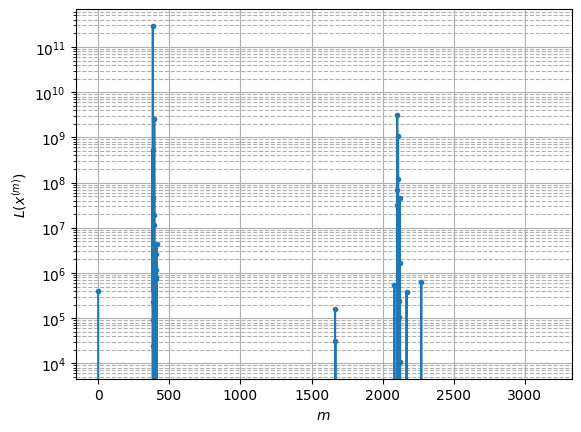

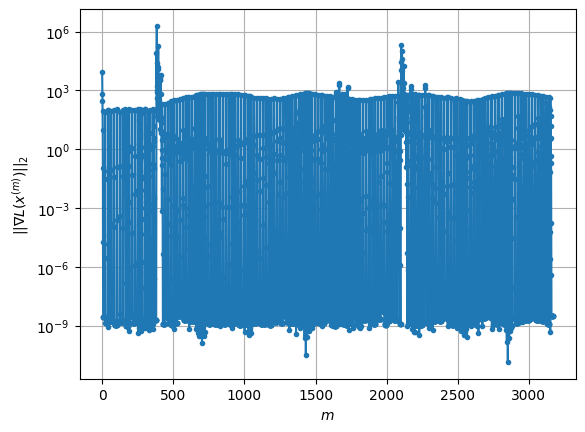

Windows:  53%|█████▎    | 210/395 [02:18<02:01,  1.52it/s]

Before applying the algorithm
Cost function: -222016.3296665001
Gradient norm: 379.9210703125488
Global relative error: 213.22798419525185
Position relative errors: 1.2941063815105407 m, 13.893238105681165 m, 91.87570833814881 m, 191.89221156611896 m

Iteration 1
Cost function: -235681.00886167114 (-6.15%)
Gradient norm: 75.85079931981419 (-80.04%)
Global relative error: 704.015854407743 (230.17%)
Position relative errors: 0.10314645436059136 m, 206.6156198763979 m, 285.0515258020612 m, 609.6607384882776 m

Iteration 2
Cost function: -236311.25873174772 (-0.27%)
Gradient norm: 1.3846059198085623 (-98.17%)
Global relative error: 648.5268563913315 (-7.88%)
Position relative errors: 0.10314645436059136 m, 189.73232196515863 m, 206.26745229833887 m, 584.8373680951685 m

Iteration 3
Cost function: -236302.783273565 (0.00%)
Gradient norm: 27.616443739952253 (1894.53%)
Global relative error: 161.45401101127368 (-75.10%)
Position relative errors: 0.10314645436059136 m, 46.175530379622806 m, 41

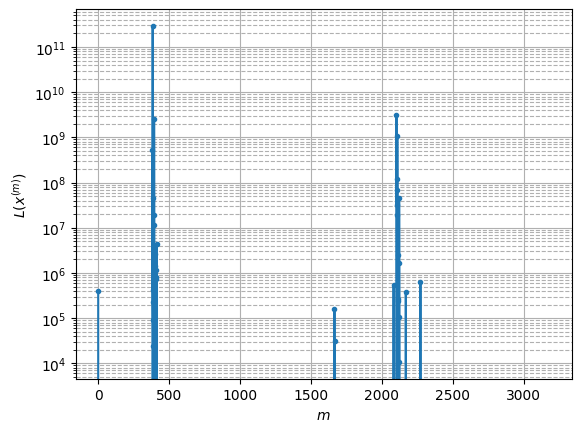

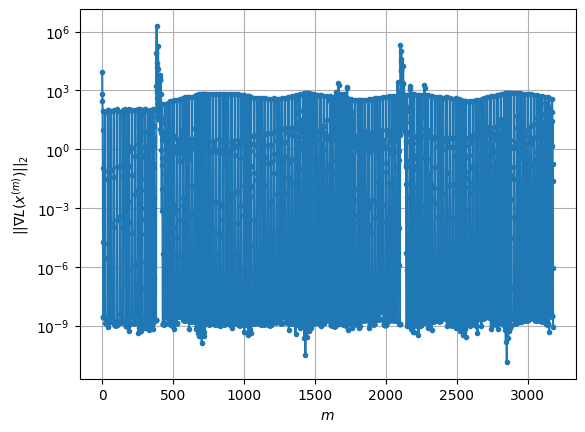

Windows:  53%|█████▎    | 211/395 [02:19<02:02,  1.50it/s]

Before applying the algorithm
Cost function: -223405.99442337203
Gradient norm: 346.33282893212623
Global relative error: 156.29458418611634
Position relative errors: 1.09268665221707 m, 42.922352426728736 m, 125.30670630391393 m, 82.9154873215261 m

Iteration 1
Cost function: -212779.756853182 (4.76%)
Gradient norm: 539.0684968054173 (55.65%)
Global relative error: 2130.6226512883572 (1263.21%)
Position relative errors: 0.1515213483392753 m, 620.1773937526438 m, 793.0250471825766 m, 1877.7743229637888 m

Iteration 2
Cost function: -235609.7803574582 (-10.73%)
Gradient norm: 4.53316634468718 (-99.16%)
Global relative error: 2131.1477633397158 (0.02%)
Position relative errors: 0.1515213483392753 m, 593.0306857544651 m, 670.7812464339304 m, 1933.9467845196361 m

Iteration 3
Cost function: -228347.7899566266 (3.08%)
Gradient norm: 330.7316275768415 (7195.82%)
Global relative error: 384.261793440727 (-81.97%)
Position relative errors: 0.1515213483392753 m, 110.15674927192511 m, 115.5918366

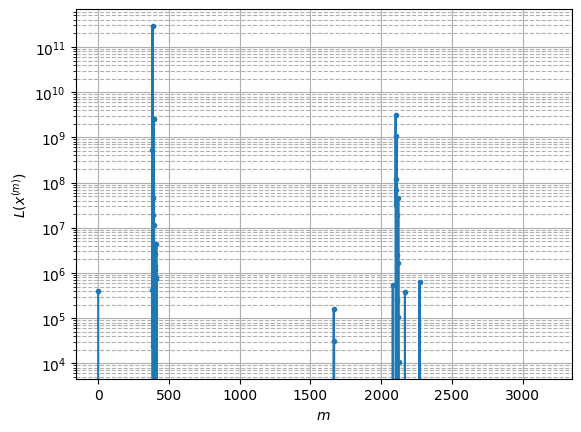

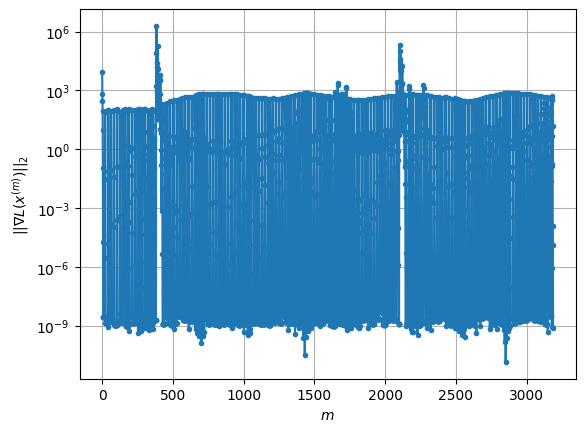

Windows:  54%|█████▎    | 212/395 [02:20<01:59,  1.53it/s]

Before applying the algorithm
Cost function: -225754.5316744313
Gradient norm: 305.34398967988795
Global relative error: 174.7148368600909
Position relative errors: 1.2992981646703226 m, 21.09489847738963 m, 136.53247008488648 m, 106.90983658553357 m

Iteration 1
Cost function: 31855901.427018136 (14210.86%)
Gradient norm: 20963.11579711961 (6765.41%)
Global relative error: 14379.240462527683 (8130.12%)
Position relative errors: 0.4123014877799389 m, 4015.4975524575716 m, 4887.516415320564 m, 12913.191357779253 m

Iteration 2
Cost function: -195856.70358615043 (-100.61%)
Gradient norm: 90.0591521971021 (-99.57%)
Global relative error: 13319.469674053444 (-7.37%)
Position relative errors: 0.4123014877799389 m, 3728.85285236802 m, 4250.17023236633 m, 12059.8496618563 m

Iteration 3
Cost function: 15819224.04439819 (8176.94%)
Gradient norm: 14613.712759696911 (16126.79%)
Global relative error: 8260.666075644633 (-37.98%)
Position relative errors: 0.4123014877799389 m, 5029.565004054207 m,

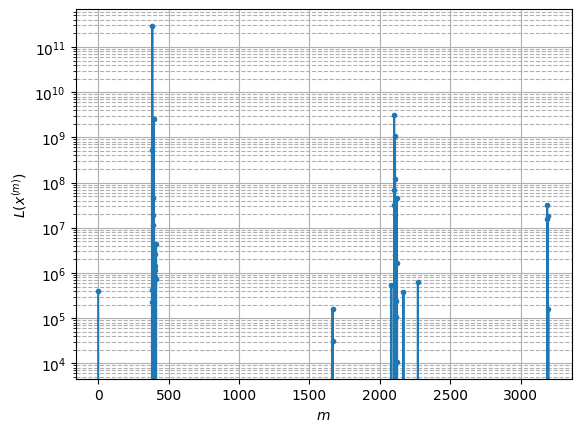

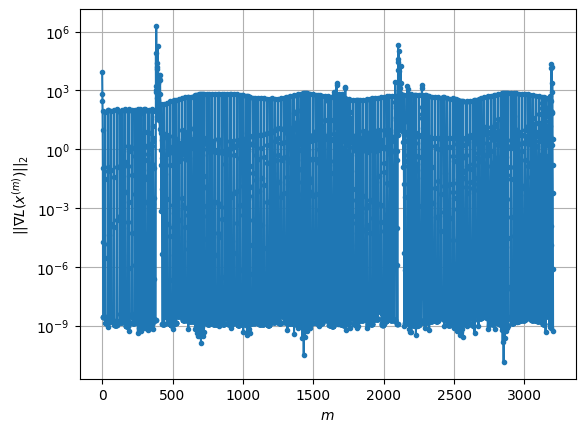

Windows:  54%|█████▍    | 213/395 [02:20<02:02,  1.48it/s]

Before applying the algorithm
Cost function: -222161.34359037678
Gradient norm: 291.0912639218181
Global relative error: 3361.0193407839265
Position relative errors: 1.4792919739207526 m, 2576.9423402420866 m, 1935.5038763697585 m, 953.7472254421143 m

Iteration 1
Cost function: -175746.6092862996 (20.89%)
Gradient norm: 865.5264372303649 (197.34%)
Global relative error: 4732.808505440302 (40.81%)
Position relative errors: 0.03482774884607993 m, 2990.0487618363386 m, 2237.6899190050867 m, 2907.201507596861 m

Iteration 2
Cost function: -232333.66947730092 (-32.20%)
Gradient norm: 4.635980336198054 (-99.46%)
Global relative error: 4576.3663177696335 (-3.31%)
Position relative errors: 0.03482774884607993 m, 2854.794843672965 m, 2074.273733137324 m, 2913.872952507128 m

Iteration 3
Cost function: -205483.44723245047 (11.56%)
Gradient norm: 619.4971110160084 (13262.81%)
Global relative error: 3359.905827289266 (-26.58%)
Position relative errors: 0.03482774884607993 m, 2604.9638560007197 m,

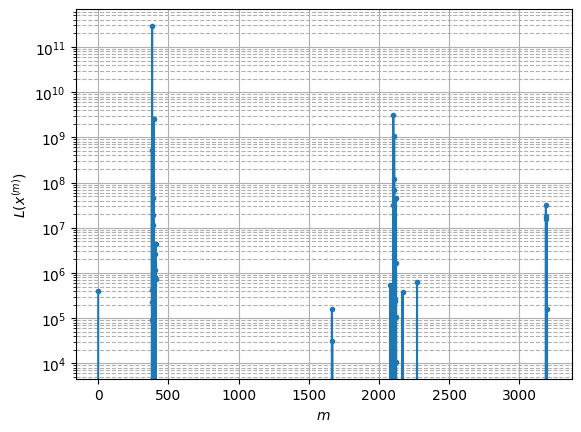

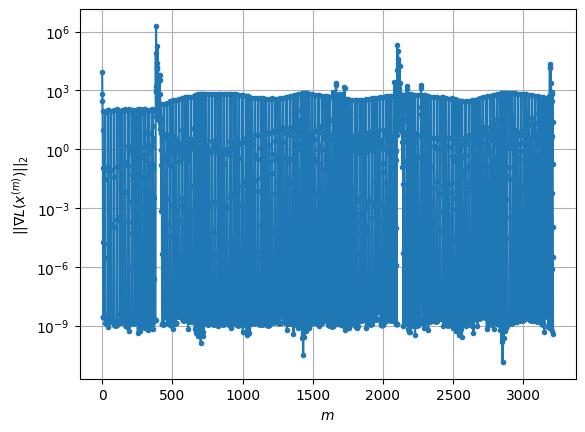

Windows:  54%|█████▍    | 214/395 [02:21<02:00,  1.50it/s]

Before applying the algorithm
Cost function: -223129.94026634385
Gradient norm: 269.5530244682683
Global relative error: 3255.8393447601807
Position relative errors: 1.2004123306663814 m, 2561.851512805685 m, 1872.03242649344 m, 729.9942172732123 m

Iteration 1
Cost function: -233423.4255318542 (-4.61%)
Gradient norm: 26.35226762936289 (-90.22%)
Global relative error: 3375.166758885735 (3.67%)
Position relative errors: 0.15205898012851057 m, 2645.4637710574243 m, 1913.843526886066 m, 854.6734795497213 m

Iteration 2
Cost function: -233508.87027509895 (-0.04%)
Gradient norm: 2.4243875689173615 (-90.80%)
Global relative error: 3295.34073758722 (-2.37%)
Position relative errors: 0.15205898012851057 m, 2631.0242280923108 m, 1835.3293547344265 m, 754.0158906698921 m

Iteration 3
Cost function: -233521.0103177748 (-0.01%)
Gradient norm: 8.938688407846328 (268.70%)
Global relative error: 3252.3822332930104 (-1.30%)
Position relative errors: 0.15205898012851057 m, 2619.407146926069 m, 1826.203

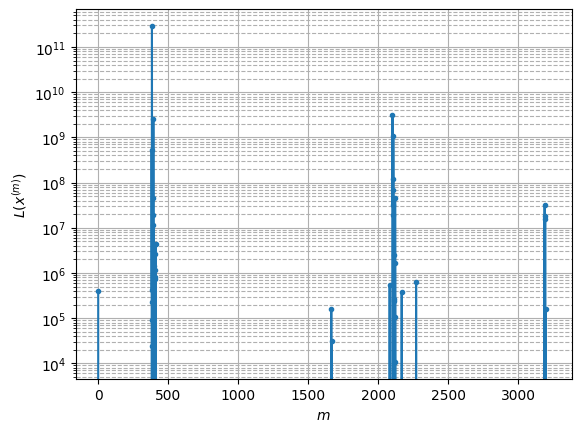

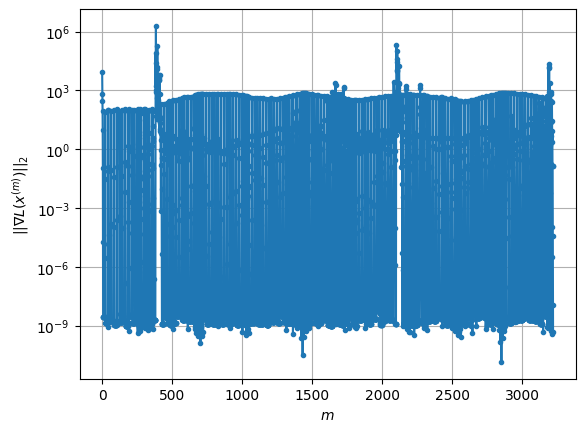

Windows:  54%|█████▍    | 215/395 [02:22<02:03,  1.45it/s]

Before applying the algorithm
Cost function: -224800.7807217418
Gradient norm: 232.652971023764
Global relative error: 3186.720967767877
Position relative errors: 1.2179105884663661 m, 2593.778278585998 m, 1760.683590287303 m, 572.2656390029819 m

Iteration 1
Cost function: -231241.49961065565 (-2.87%)
Gradient norm: 161.51078325216145 (-30.58%)
Global relative error: 3090.552541265048 (-3.02%)
Position relative errors: 0.2302048567628056 m, 2448.3891419037304 m, 1716.0892048431185 m, 782.2626094887682 m

Iteration 2
Cost function: -233251.15424922018 (-0.87%)
Gradient norm: 0.3753446354390031 (-99.77%)
Global relative error: 3062.709917821434 (-0.90%)
Position relative errors: 0.2302048567628056 m, 2434.89710587882 m, 1703.178690643465 m, 742.0524248988316 m

Iteration 3
Cost function: -232444.93528289962 (0.35%)
Gradient norm: 110.32440223961203 (29292.83%)
Global relative error: 3153.6145416821323 (2.97%)
Position relative errors: 0.2302048567628056 m, 2581.0230294503563 m, 1770.916

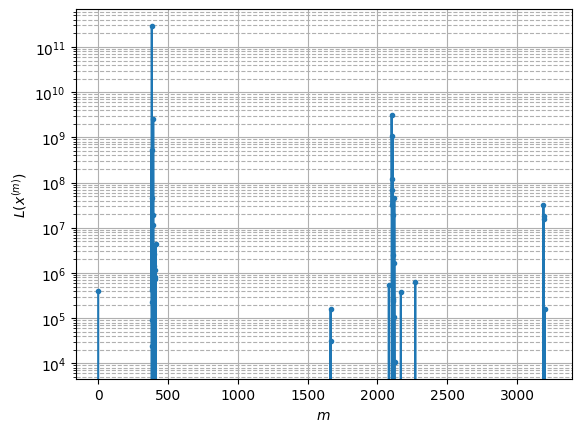

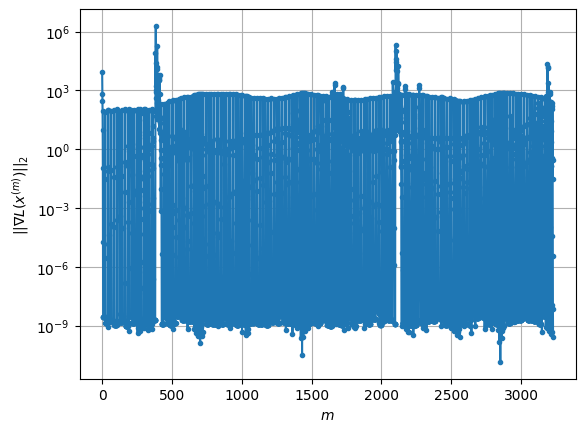

Windows:  55%|█████▍    | 216/395 [02:22<01:58,  1.52it/s]

Before applying the algorithm
Cost function: -225516.1924472156
Gradient norm: 212.56862759154475
Global relative error: 3102.565237221623
Position relative errors: 1.1369932289311877 m, 2548.9974517086625 m, 1713.4425121325753 m, 438.89343436061773 m

Iteration 1
Cost function: -233410.55215760003 (-3.50%)
Gradient norm: 5.639980340910762 (-97.35%)
Global relative error: 3100.1167872842225 (-0.08%)
Position relative errors: 0.03980408366325342 m, 2546.601316150444 m, 1717.156148050291 m, 420.6085263922253 m

Iteration 2
Cost function: -233425.45520498542 (-0.01%)
Gradient norm: 1.5413365124397664 (-72.67%)
Global relative error: 3077.5489014269288 (-0.73%)
Position relative errors: 0.03980408366325342 m, 2562.381409249098 m, 1676.784528755037 m, 306.42019550761785 m

Iteration 3
Cost function: -233427.58521221933 (-0.00%)
Gradient norm: 1.2929026834709147 (-16.12%)
Global relative error: 3045.131782355589 (-1.05%)
Position relative errors: 0.03980408366325342 m, 2553.564653650846 m, 1

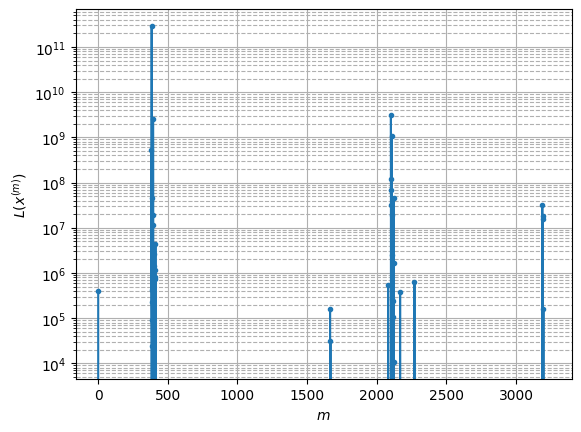

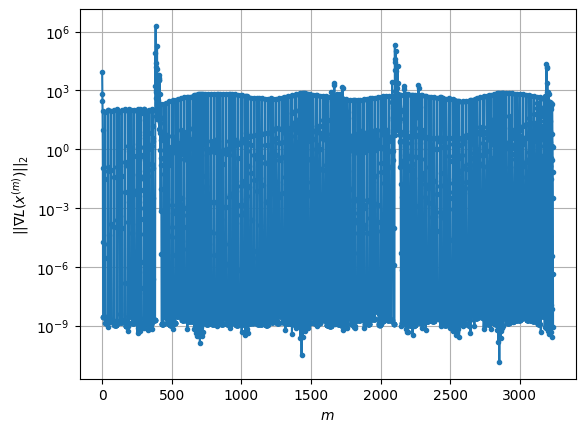

Windows:  55%|█████▍    | 217/395 [02:23<02:02,  1.46it/s]

Before applying the algorithm
Cost function: -225584.55388228805
Gradient norm: 197.5311578261962
Global relative error: 2959.358644859586
Position relative errors: 1.1571271291263079 m, 2507.8222358617513 m, 1563.8685813735483 m, 151.444443871891 m

Iteration 1
Cost function: -233183.0602445647 (-3.37%)
Gradient norm: 3.7645724836901397 (-98.09%)
Global relative error: 2940.9562003436226 (-0.62%)
Position relative errors: 0.08183875393943303 m, 2486.9779139549496 m, 1563.2225059518712 m, 143.1436136734602 m

Iteration 2
Cost function: -233203.35489116708 (-0.01%)
Gradient norm: 2.4229935927223134 (-35.64%)
Global relative error: 2923.7620218043457 (-0.58%)
Position relative errors: 0.08183875393943303 m, 2508.587267056665 m, 1499.5884832332636 m, 81.23505444588423 m

Iteration 3
Cost function: -233206.31577454292 (-0.00%)
Gradient norm: 1.012728239001019 (-58.20%)
Global relative error: 2904.358890223654 (-0.66%)
Position relative errors: 0.08183875393943303 m, 2504.601768781721 m, 14

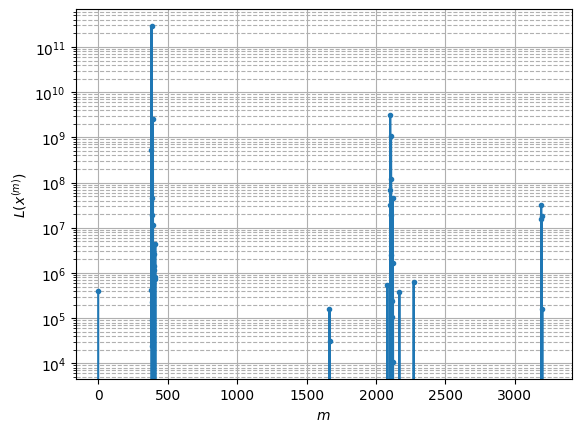

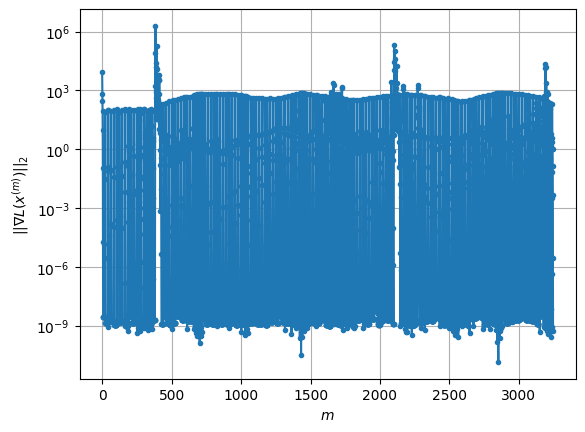

Windows:  55%|█████▌    | 218/395 [02:24<01:59,  1.49it/s]

Before applying the algorithm
Cost function: -225351.67781173755
Gradient norm: 221.0681317095826
Global relative error: 2816.720221688556
Position relative errors: 1.1857534483571968 m, 2450.098290681733 m, 1363.9378751233166 m, 265.6938128677422 m

Iteration 1
Cost function: -233414.82690464662 (-3.58%)
Gradient norm: 3.0080149330058337 (-98.64%)
Global relative error: 2798.426668806208 (-0.65%)
Position relative errors: 0.17356221440052538 m, 2428.7858505519534 m, 1361.5543927220208 m, 279.91191563709754 m

Iteration 2
Cost function: -233427.0487958386 (-0.01%)
Gradient norm: 1.8290954134536794 (-39.19%)
Global relative error: 2813.5021740940856 (0.54%)
Position relative errors: 0.17356221440052538 m, 2426.465541861787 m, 1363.4932445555103 m, 411.01771476767726 m

Iteration 3
Cost function: -233427.48649873587 (-0.00%)
Gradient norm: 0.08437952221133359 (-95.39%)
Global relative error: 2811.2541511651316 (-0.08%)
Position relative errors: 0.17356221440052538 m, 2425.035624872769 m,

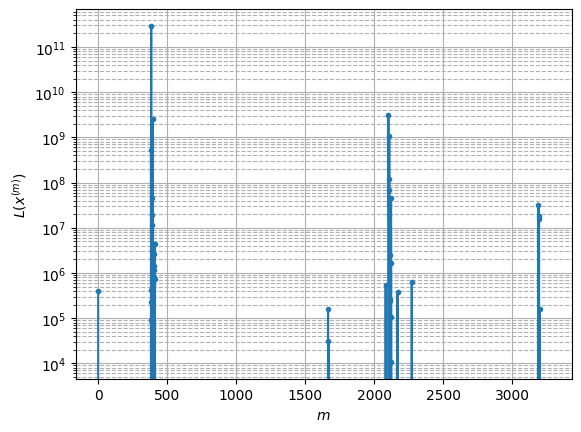

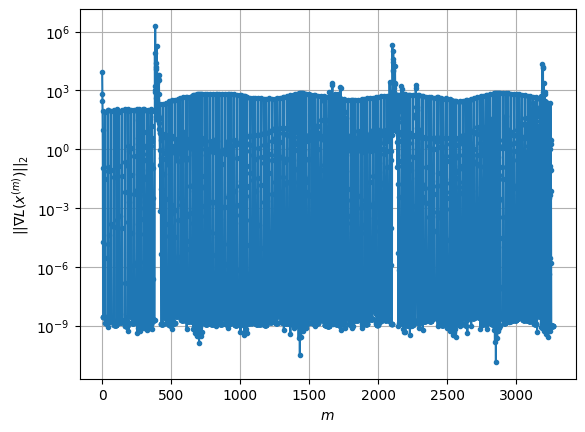

Windows:  55%|█████▌    | 219/395 [02:24<01:57,  1.50it/s]

Before applying the algorithm
Cost function: -224351.31919228373
Gradient norm: 262.9733042902581
Global relative error: 2726.6157214924992
Position relative errors: 1.1269058460397963 m, 2366.8062415978934 m, 1255.1001740247289 m, 507.3195878519796 m

Iteration 1
Cost function: -233315.00748652953 (-4.00%)
Gradient norm: 3.3321747150654395 (-98.73%)
Global relative error: 2703.2267262263613 (-0.86%)
Position relative errors: 0.20770010387017204 m, 2327.7144790917177 m, 1265.5444912272894 m, 536.2522805031845 m

Iteration 2
Cost function: -233328.5658269184 (-0.01%)
Gradient norm: 2.095967193793118 (-37.10%)
Global relative error: 2706.546873031505 (0.12%)
Position relative errors: 0.20770010387017204 m, 2332.0912277610105 m, 1193.9669195752372 m, 679.1014700956836 m

Iteration 3
Cost function: -233330.11036479275 (-0.00%)
Gradient norm: 0.2667548663739437 (-87.27%)
Global relative error: 2707.2003178209848 (0.02%)
Position relative errors: 0.20770010387017204 m, 2334.072962532062 m, 1

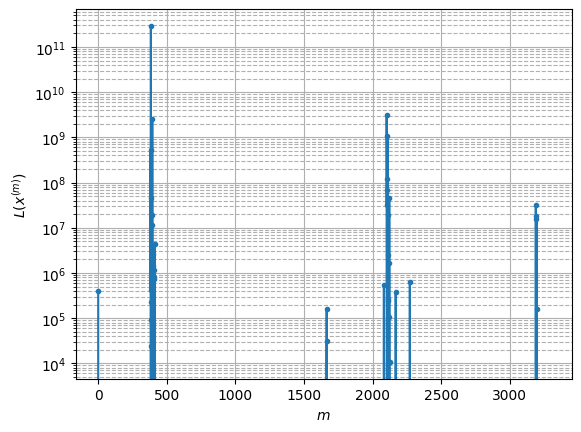

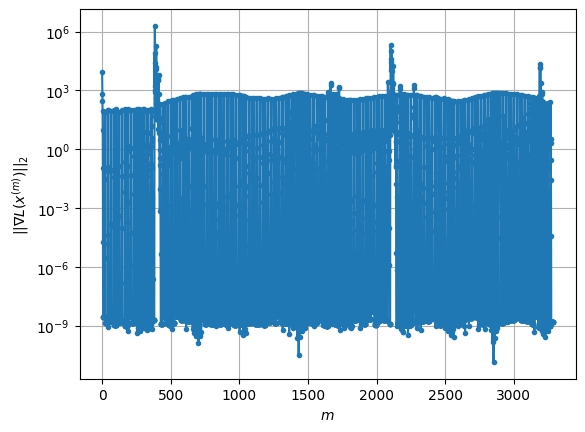

Windows:  56%|█████▌    | 220/395 [02:25<01:56,  1.51it/s]

Before applying the algorithm
Cost function: -219873.02022063913
Gradient norm: 373.5013690408415
Global relative error: 2632.361247049212
Position relative errors: 1.1494963809766796 m, 2270.0070302779413 m, 1055.4160365919486 m, 813.9275978295348 m

Iteration 1
Cost function: -233252.879211614 (-6.09%)
Gradient norm: 2.9188377839906887 (-99.22%)
Global relative error: 2624.4757419223833 (-0.30%)
Position relative errors: 0.19370268352563605 m, 2258.268173780963 m, 1058.042959275399 m, 817.6988949025199 m

Iteration 2
Cost function: -233259.83075422584 (-0.00%)
Gradient norm: 1.2593276364065018 (-56.86%)
Global relative error: 2652.744567396031 (1.08%)
Position relative errors: 0.19370268352563605 m, 2255.996238528381 m, 1088.2572131880079 m, 873.6243819338106 m

Iteration 3
Cost function: -233260.0122529145 (-0.00%)
Gradient norm: 0.019406796441983884 (-98.46%)
Global relative error: 2652.7359579758827 (-0.00%)
Position relative errors: 0.19370268352563605 m, 2254.8581933443193 m, 10

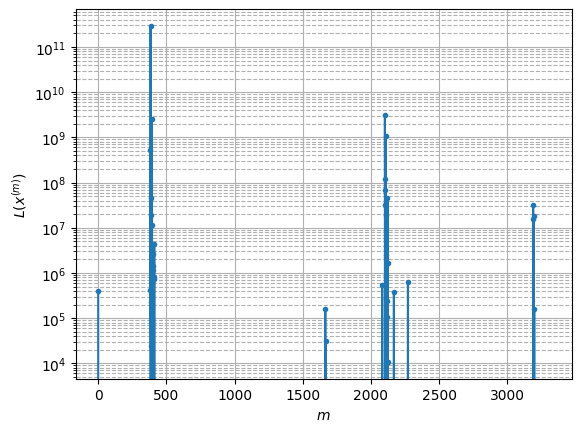

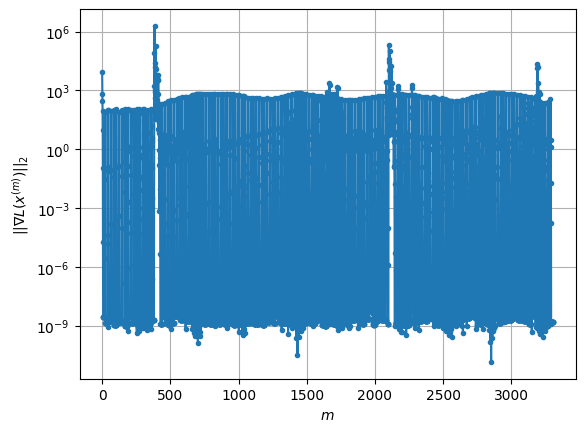

Windows:  56%|█████▌    | 221/395 [02:26<01:59,  1.46it/s]

Before applying the algorithm
Cost function: -213867.72522116802
Gradient norm: 485.54407332229096
Global relative error: 2581.4975098552936
Position relative errors: 1.2654883891393347 m, 2186.278947945434 m, 987.7217341708254 m, 953.2605474344382 m

Iteration 1
Cost function: -233520.16828247497 (-9.19%)
Gradient norm: 4.331603680003034 (-99.11%)
Global relative error: 2572.3917450673493 (-0.35%)
Position relative errors: 0.0642799360607921 m, 2151.5284029213212 m, 1024.0868252925404 m, 969.2052070606152 m

Iteration 2
Cost function: -233541.52033632027 (-0.01%)
Gradient norm: 10.300720239942198 (137.80%)
Global relative error: 2635.0124451001616 (2.43%)
Position relative errors: 0.0642799360607921 m, 2102.7185377554874 m, 917.9987735013829 m, 1295.8129981906363 m

Iteration 3
Cost function: -233551.5915133085 (-0.00%)
Gradient norm: 0.152461103583067 (-98.52%)
Global relative error: 2638.623947526924 (0.14%)
Position relative errors: 0.0642799360607921 m, 2102.5173223224815 m, 894.6

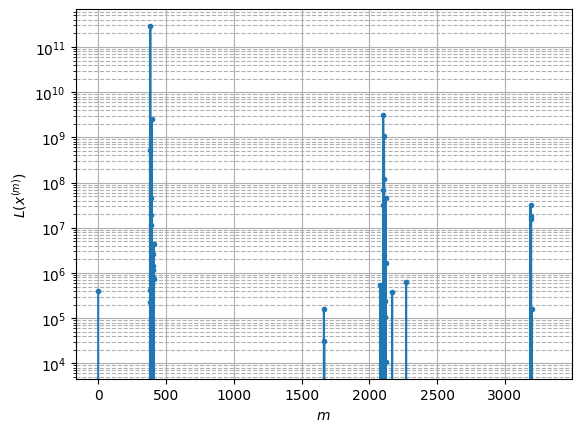

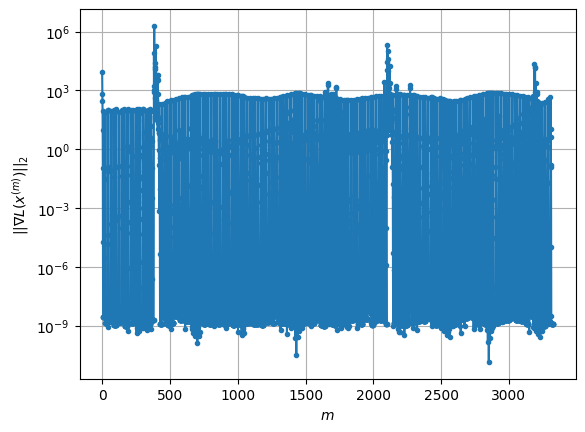

Windows:  56%|█████▌    | 222/395 [02:26<01:57,  1.48it/s]

Before applying the algorithm
Cost function: -206790.72392709187
Gradient norm: 589.8725222229275
Global relative error: 2600.270795970907
Position relative errors: 1.0962318974537044 m, 2028.1448632764148 m, 774.5421200775486 m, 1431.1207665356376 m

Iteration 1
Cost function: -233734.21556017417 (-13.03%)
Gradient norm: 7.342025064177155 (-98.76%)
Global relative error: 2617.255321882356 (0.65%)
Position relative errors: 0.07754077853708793 m, 1999.317271723615 m, 879.5234415482012 m, 1441.9365785731602 m

Iteration 2
Cost function: -233809.74100190232 (-0.03%)
Gradient norm: 2.893441384725194 (-60.59%)
Global relative error: 2534.143227473386 (-3.18%)
Position relative errors: 0.07754077853708793 m, 1937.6101476171823 m, 780.3471966767788 m, 1434.78004578742 m

Iteration 3
Cost function: -233813.114571116 (-0.00%)
Gradient norm: 0.2727146792053307 (-90.57%)
Global relative error: 2529.5959939646386 (-0.18%)
Position relative errors: 0.07754077853708793 m, 1929.5869051730976 m, 747.0

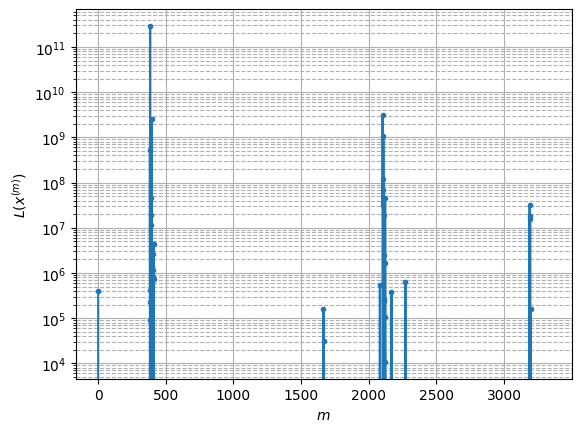

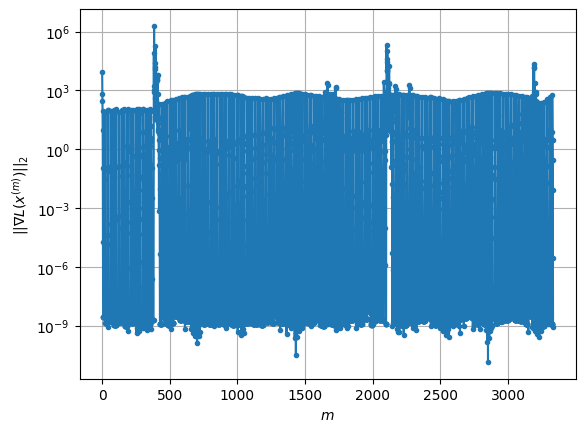

Windows:  56%|█████▋    | 223/395 [02:27<01:57,  1.47it/s]

Before applying the algorithm
Cost function: -200995.91826196888
Gradient norm: 657.6137011011687
Global relative error: 2487.2224285943266
Position relative errors: 1.132777902953953 m, 1858.9714851939377 m, 627.1512196574046 m, 1528.7792940464126 m

Iteration 1
Cost function: -233775.5829719228 (-16.31%)
Gradient norm: 7.580089620998144 (-98.85%)
Global relative error: 2517.507024961226 (1.22%)
Position relative errors: 0.12891547608431506 m, 1878.933230985969 m, 754.7955871109024 m, 1495.9013263429342 m

Iteration 2
Cost function: -233851.7749156074 (-0.03%)
Gradient norm: 3.4735455425061272 (-54.18%)
Global relative error: 2516.4170949909544 (-0.04%)
Position relative errors: 0.12891547608431506 m, 1794.4986672964767 m, 658.1516304369723 m, 1636.7503116352013 m

Iteration 3
Cost function: -233855.8630641158 (-0.00%)
Gradient norm: 0.23270000039515432 (-93.30%)
Global relative error: 2523.272722740751 (0.27%)
Position relative errors: 0.12891547608431506 m, 1780.6991440236518 m, 626

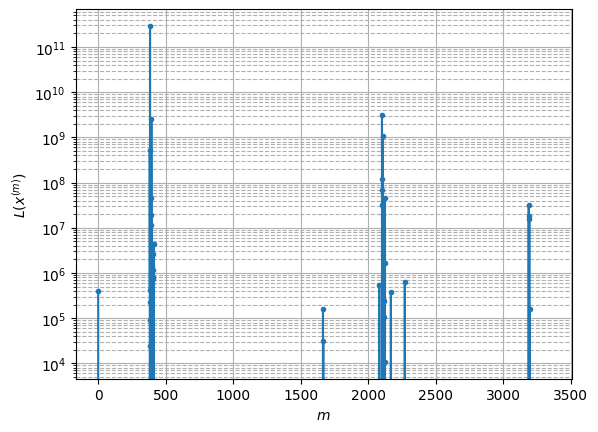

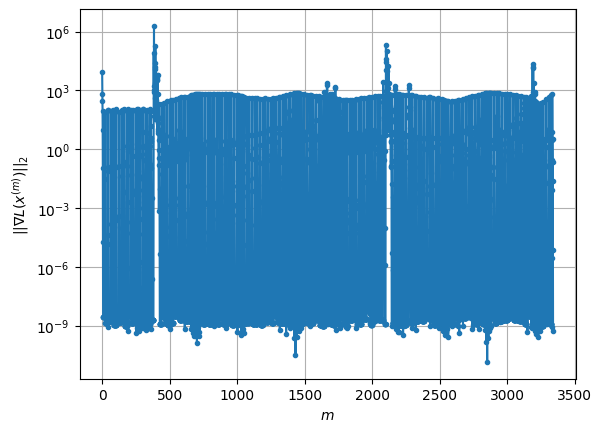

Windows:  57%|█████▋    | 224/395 [02:28<01:54,  1.49it/s]

Before applying the algorithm
Cost function: -191986.0962488881
Gradient norm: 755.1272087192206
Global relative error: 2500.6452052790128
Position relative errors: 1.259723608462431 m, 1710.0404419556514 m, 505.86086830641574 m, 1753.0190493675495 m

Iteration 1
Cost function: -218520.89109784522 (-13.82%)
Gradient norm: 265.459569884363 (-64.85%)
Global relative error: 2651.797857213629 (6.04%)
Position relative errors: 0.18321007206011708 m, 1285.383811974916 m, 563.4288814010381 m, 2249.9672567272246 m

Iteration 2
Cost function: -232542.52670531077 (-6.42%)
Gradient norm: 53.67471416280382 (-79.78%)
Global relative error: 3062.4072066822387 (15.48%)
Position relative errors: 0.18321007206011708 m, 1524.7497237088553 m, 437.66246825156503 m, 2619.5251807873233 m

Iteration 3
Cost function: -231674.88462384 (0.37%)
Gradient norm: 116.87358333854228 (117.74%)
Global relative error: 2904.639221557928 (-5.15%)
Position relative errors: 0.18321007206011708 m, 1664.6813554884732 m, 226.6

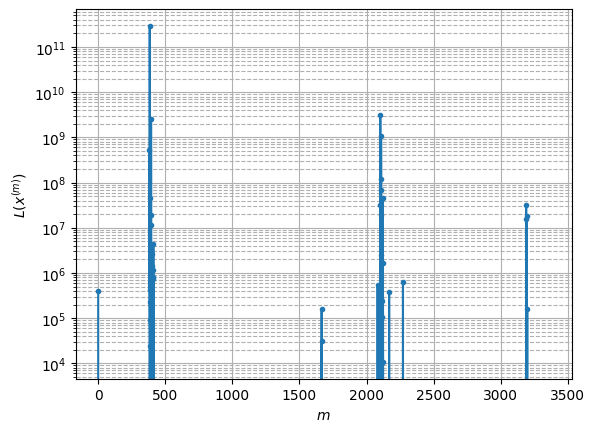

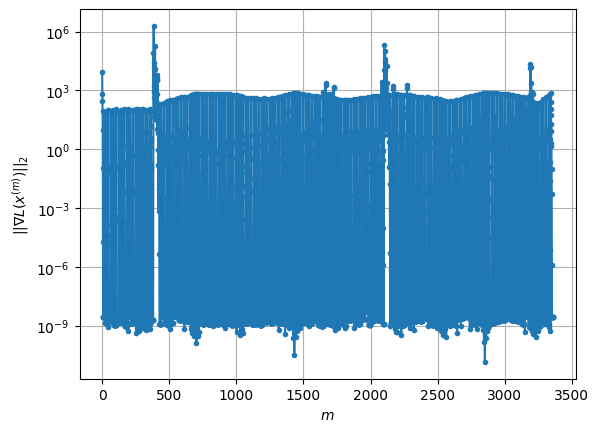

Windows:  57%|█████▋    | 225/395 [02:28<01:57,  1.44it/s]

Before applying the algorithm
Cost function: -179904.69113012773
Gradient norm: 866.2392919862991
Global relative error: 2317.5305340190093
Position relative errors: 1.2632146053428448 m, 1572.7452550395892 m, 388.8575779877 m, 1657.1636922120533 m

Iteration 1
Cost function: -234210.9354909157 (-30.19%)
Gradient norm: 13.704614396043885 (-98.42%)
Global relative error: 2301.7092598087843 (-0.68%)
Position relative errors: 0.12608184548822204 m, 1441.0895194507173 m, 161.96087672704098 m, 1787.4222634079981 m

Iteration 2
Cost function: -234340.06108009236 (-0.06%)
Gradient norm: 8.974723550279087 (-34.51%)
Global relative error: 2294.524256129317 (-0.31%)
Position relative errors: 0.12608184548822204 m, 1391.9712999117417 m, 295.75021477668423 m, 1799.9367856525732 m

Iteration 3
Cost function: -234367.9336946191 (-0.01%)
Gradient norm: 1.84576795695344 (-79.43%)
Global relative error: 2291.02860644231 (-0.15%)
Position relative errors: 0.12608184548822204 m, 1406.7269969143845 m, 374

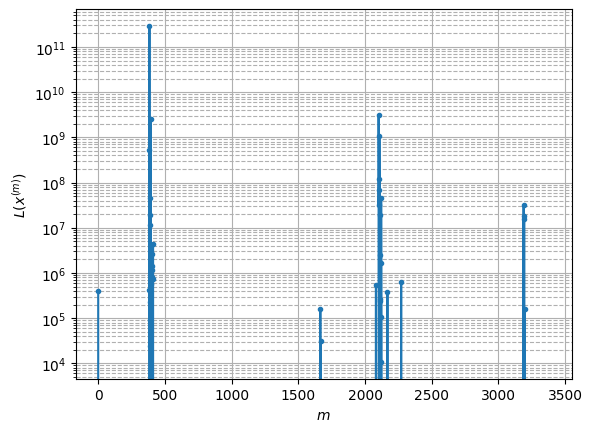

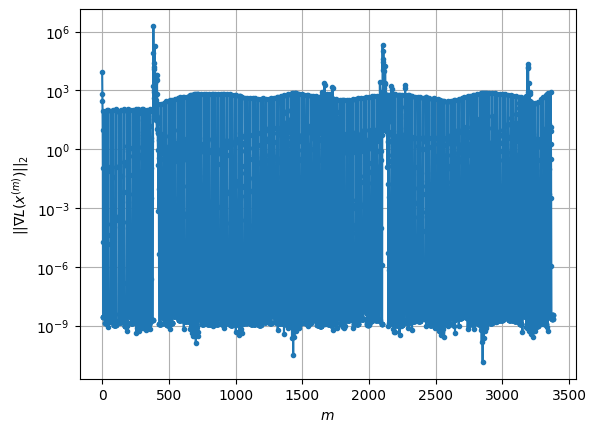

Windows:  57%|█████▋    | 226/395 [02:29<01:59,  1.42it/s]

Before applying the algorithm
Cost function: -168600.48630432284
Gradient norm: 962.322315596596
Global relative error: 2288.6858059141587
Position relative errors: 1.1288000490821373 m, 1333.9168441785155 m, 286.36857318388286 m, 1837.585950801956 m

Iteration 1
Cost function: -234735.40359747026 (-39.23%)
Gradient norm: 3.468893919334311 (-99.64%)
Global relative error: 2292.6872530383325 (0.17%)
Position relative errors: 0.18382065937289077 m, 1263.2291562920236 m, 192.80665755421296 m, 1903.5425625456378 m

Iteration 2
Cost function: -234780.92835496934 (-0.02%)
Gradient norm: 8.35117008550209 (140.74%)
Global relative error: 2076.323256235821 (-9.44%)
Position relative errors: 0.18382065937289077 m, 1163.360766255072 m, 264.36479781404313 m, 1699.3537010530565 m

Iteration 3
Cost function: -234792.0342785602 (-0.00%)
Gradient norm: 0.1703153354144001 (-97.96%)
Global relative error: 2082.404259708657 (0.29%)
Position relative errors: 0.18382065937289077 m, 1131.5121596252018 m, 24

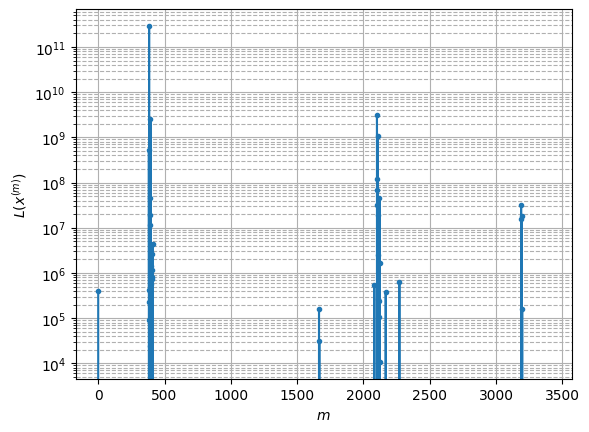

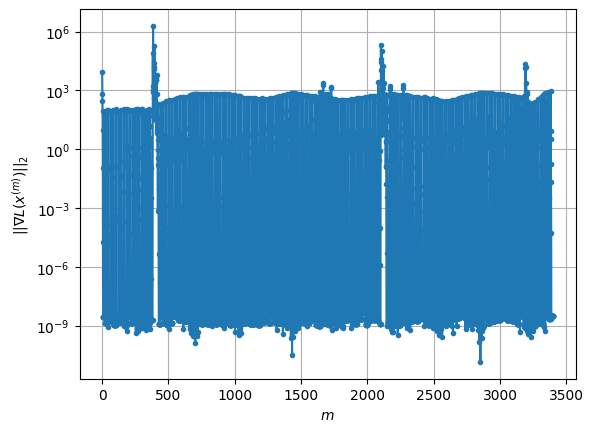

Windows:  57%|█████▋    | 227/395 [02:30<02:05,  1.34it/s]

Before applying the algorithm
Cost function: -159987.9595732299
Gradient norm: 1024.7103431595756
Global relative error: 2109.726236529169
Position relative errors: 1.0364277226223026 m, 1062.8036096433707 m, 124.74383692672983 m, 1818.1891002117895 m

Iteration 1
Cost function: -235046.07488816234 (-46.91%)
Gradient norm: 2.671615258036371 (-99.74%)
Global relative error: 2110.9256991316824 (0.06%)
Position relative errors: 0.14529655824369853 m, 1041.0766143868889 m, 110.00338663565732 m, 1833.0429473372799 m

Iteration 2
Cost function: -234828.80057401778 (0.09%)
Gradient norm: 58.6576606966553 (2095.59%)
Global relative error: 1482.1831511001883 (-29.79%)
Position relative errors: 0.14529655824369853 m, 813.7406386584769 m, 228.1817731193907 m, 1217.623318781309 m

Iteration 3
Cost function: -230093.14746632328 (2.02%)
Gradient norm: 210.28999590318102 (258.50%)
Global relative error: 1716.1080992965383 (15.78%)
Position relative errors: 0.14529655824369853 m, 390.60449551938416 m,

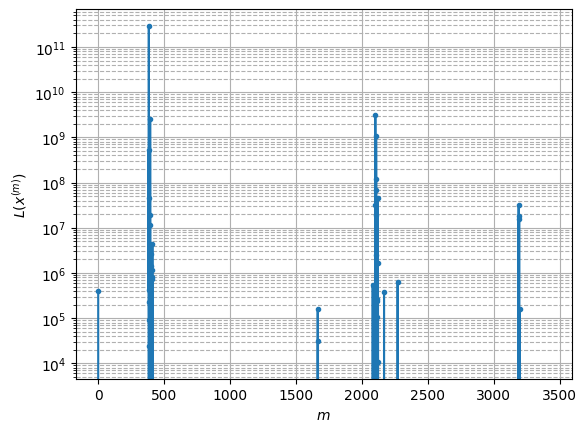

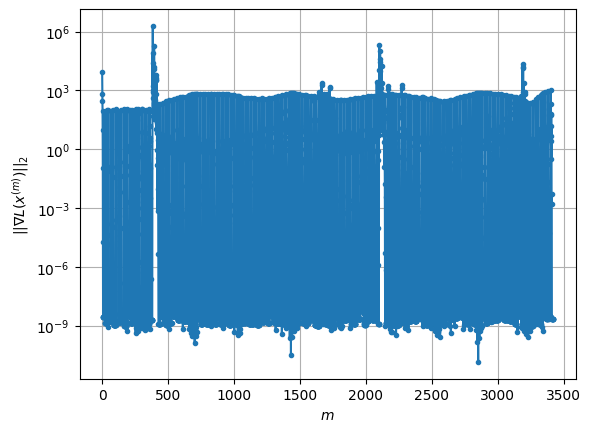

Windows:  58%|█████▊    | 228/395 [02:31<01:57,  1.42it/s]

Before applying the algorithm
Cost function: -199917.1841155462
Gradient norm: 715.1969476034999
Global relative error: 293.5933597757293
Position relative errors: 1.2682696871845014 m, 162.97225437310624 m, 123.47945803095327 m, 210.638739437713 m

Iteration 1
Cost function: -236207.04582126313 (-18.15%)
Gradient norm: 8.30800916590318 (-98.84%)
Global relative error: 296.2056219364875 (0.89%)
Position relative errors: 0.1545231104910393 m, 58.72642698340428 m, 61.25585433593561 m, 283.7552326906148 m

Iteration 2
Cost function: -236353.19547792143 (-0.06%)
Gradient norm: 6.508842167841826 (-21.66%)
Global relative error: 67.50313191292368 (-77.21%)
Position relative errors: 0.1545231104910393 m, 22.395810200918174 m, 13.96518481590773 m, 61.97103069775339 m

Iteration 3
Cost function: -236358.4758578221 (-0.00%)
Gradient norm: 0.07408796689660589 (-98.86%)
Global relative error: 43.67759744571987 (-35.30%)
Position relative errors: 0.1545231104910393 m, 9.967031674035479 m, 10.234613

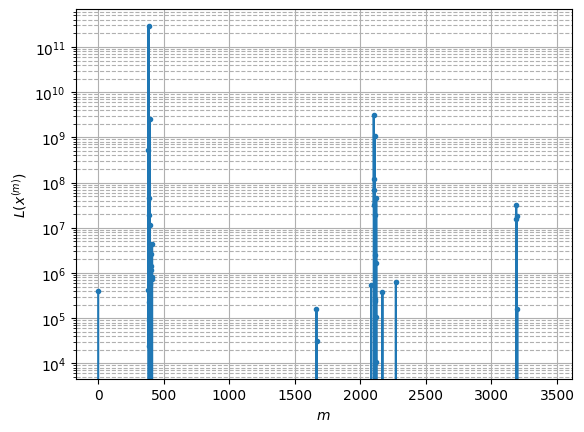

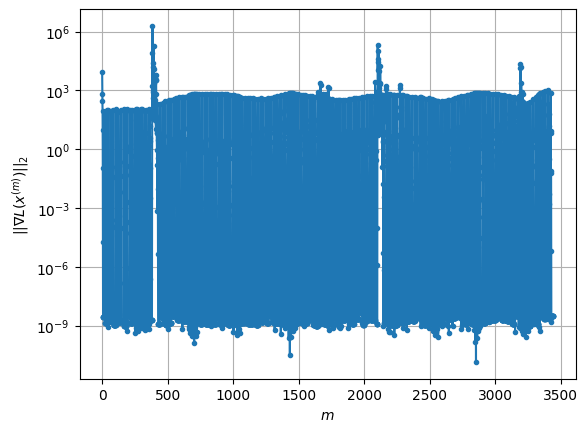

Windows:  58%|█████▊    | 229/395 [02:31<01:59,  1.39it/s]

Before applying the algorithm
Cost function: -192033.67564807518
Gradient norm: 784.9322499187485
Global relative error: 267.6364877992372
Position relative errors: 1.1088699200870886 m, 162.6500868205304 m, 117.39110335775953 m, 177.1233209630624 m

Iteration 1
Cost function: -236152.85388300812 (-22.97%)
Gradient norm: 6.63086357279106 (-99.16%)
Global relative error: 267.89289264101143 (0.10%)
Position relative errors: 0.16348457489792984 m, 55.229407065730946 m, 58.93422783168422 m, 255.38867887137025 m

Iteration 2
Cost function: -236350.73684866936 (-0.08%)
Gradient norm: 7.440991747741852 (12.22%)
Global relative error: 82.88645506547142 (-69.06%)
Position relative errors: 0.16348457489792984 m, 10.077211208884327 m, 2.366552592375695 m, 82.11771830393167 m

Iteration 3
Cost function: -236356.8539025069 (-0.00%)
Gradient norm: 0.039353081414850194 (-99.47%)
Global relative error: 71.97972272096503 (-13.16%)
Position relative errors: 0.16348457489792984 m, 3.279308912550638 m, 1.

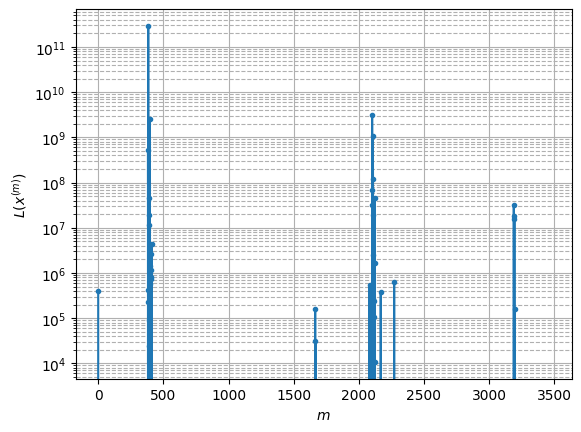

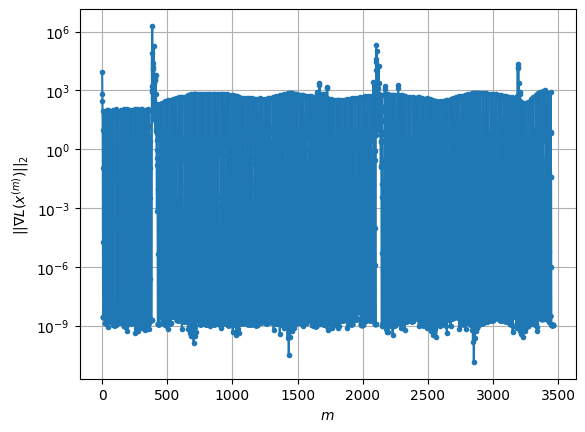

Windows:  58%|█████▊    | 230/395 [02:32<01:59,  1.39it/s]

Before applying the algorithm
Cost function: -183744.0088599833
Gradient norm: 855.630162451821
Global relative error: 252.9275211820953
Position relative errors: 1.1578582904337213 m, 155.6622438781979 m, 125.56360466445474 m, 154.77201484373668 m

Iteration 1
Cost function: -236151.02846554274 (-28.52%)
Gradient norm: 5.0625939806099245 (-99.41%)
Global relative error: 220.2607443794026 (-12.92%)
Position relative errors: 0.17577661450931373 m, 54.47393244057438 m, 70.95249939628391 m, 201.22981230386503 m

Iteration 2
Cost function: -236338.3751571869 (-0.08%)
Gradient norm: 5.632490353855328 (11.26%)
Global relative error: 181.52396170188823 (-17.59%)
Position relative errors: 0.17577661450931373 m, 50.89529470518559 m, 7.502386889464171 m, 174.02482630700092 m

Iteration 3
Cost function: -236355.2834142843 (-0.01%)
Gradient norm: 0.9303432073319384 (-83.48%)
Global relative error: 132.8302042424277 (-26.82%)
Position relative errors: 0.17577661450931373 m, 27.04782020567797 m, 5.6

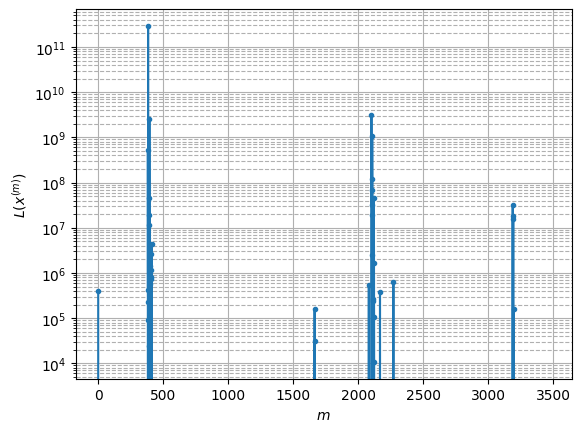

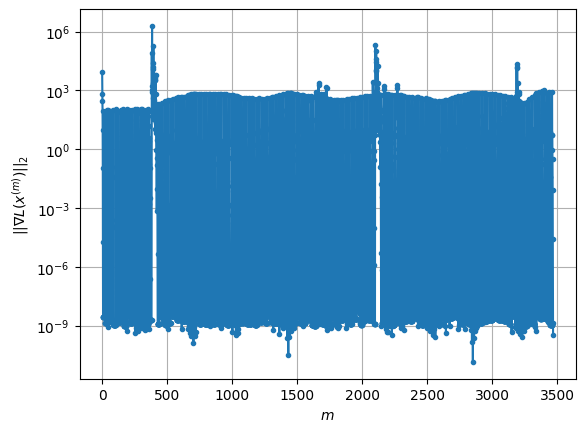

Windows:  58%|█████▊    | 231/395 [02:33<01:55,  1.42it/s]

Before applying the algorithm
Cost function: -170860.5788614398
Gradient norm: 949.0821794443358
Global relative error: 333.00046486816774
Position relative errors: 1.1056926968971414 m, 136.88293486352651 m, 125.60499896290946 m, 276.3237199684731 m

Iteration 1
Cost function: -236185.2537218108 (-38.23%)
Gradient norm: 4.462655945676704 (-99.53%)
Global relative error: 315.2986212554019 (-5.32%)
Position relative errors: 0.15936445018052903 m, 45.05080552238441 m, 66.10598386186025 m, 304.948985537636 m

Iteration 2
Cost function: -236222.16251195405 (-0.02%)
Gradient norm: 28.039779753691718 (528.32%)
Global relative error: 357.7997828996652 (13.48%)
Position relative errors: 0.15936445018052903 m, 108.57545748459421 m, 17.84652668576235 m, 340.4317781226498 m

Iteration 3
Cost function: -236342.18339805093 (-0.05%)
Gradient norm: 2.1709104014297838 (-92.26%)
Global relative error: 319.7511657372893 (-10.63%)
Position relative errors: 0.15936445018052903 m, 20.418705870687088 m, 11.

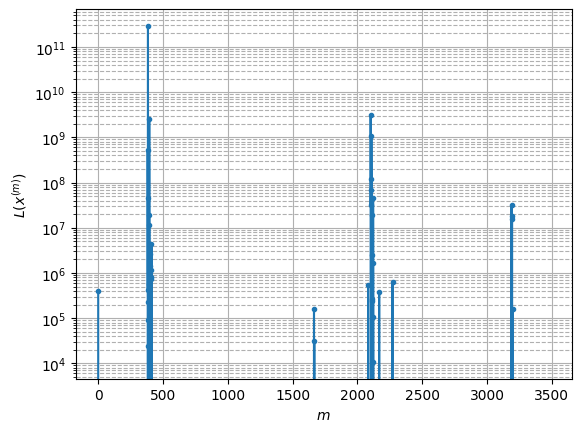

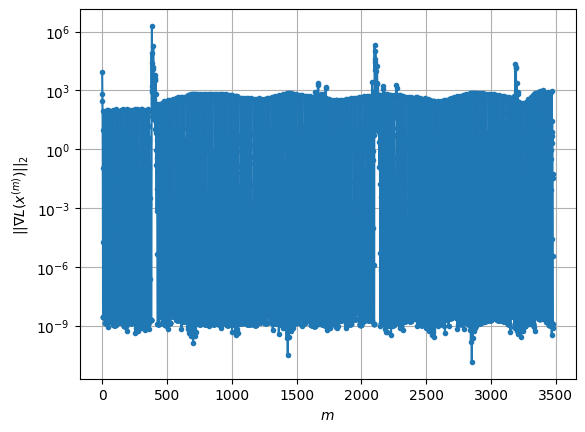

Windows:  59%|█████▊    | 232/395 [02:33<01:56,  1.40it/s]

Before applying the algorithm
Cost function: -163083.56666911242
Gradient norm: 1004.2756950360423
Global relative error: 271.7193651919984
Position relative errors: 1.18003744012095 m, 146.20478539725264 m, 117.8463810125109 m, 196.33302746801607 m

Iteration 1
Cost function: -236263.59675020786 (-44.87%)
Gradient norm: 5.086009245819772 (-99.49%)
Global relative error: 195.53045227874912 (-28.04%)
Position relative errors: 0.1186862714119962 m, 69.74021302421606 m, 45.07598883006434 m, 176.96566653960554 m

Iteration 2
Cost function: -236251.0387478425 (0.01%)
Gradient norm: 31.258062236034796 (514.59%)
Global relative error: 398.8575004963598 (103.99%)
Position relative errors: 0.1186862714119962 m, 111.71386246549577 m, 9.469347910305645 m, 382.7504167633834 m

Iteration 3
Cost function: -236352.10064475698 (-0.04%)
Gradient norm: 1.586618311246498 (-94.92%)
Global relative error: 371.4732082998333 (-6.87%)
Position relative errors: 0.1186862714119962 m, 41.829185827474184 m, 6.736

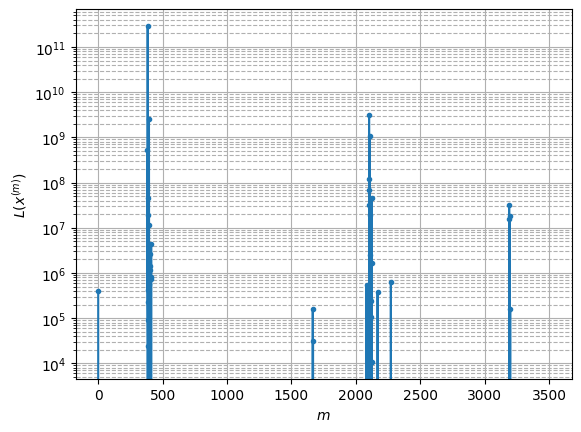

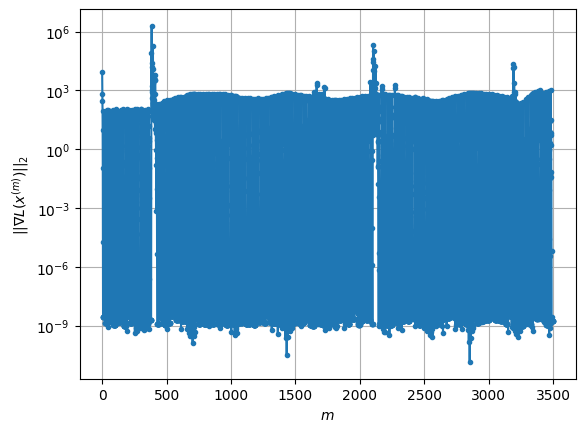

Windows:  59%|█████▉    | 233/395 [02:34<01:57,  1.37it/s]

Before applying the algorithm
Cost function: -152377.6617847933
Gradient norm: 1059.0248263935935
Global relative error: 283.3421121348565
Position relative errors: 1.0830523852830936 m, 160.1611733973025 m, 125.03185562389268 m, 197.4266344594266 m

Iteration 1
Cost function: -236325.76325767013 (-55.09%)
Gradient norm: 6.737032131114197 (-99.36%)
Global relative error: 126.61332258291773 (-55.31%)
Position relative errors: 0.10481195967941066 m, 82.3556256498066 m, 24.02467523947943 m, 93.01371536264958 m

Iteration 2
Cost function: -236355.6705644957 (-0.01%)
Gradient norm: 2.246689412692272 (-66.65%)
Global relative error: 72.16899642916565 (-43.00%)
Position relative errors: 0.10481195967941066 m, 28.348495577049576 m, 1.492383594825719 m, 66.20235284284368 m

Iteration 3
Cost function: -236356.15612906715 (-0.00%)
Gradient norm: 0.01719246909498006 (-99.23%)
Global relative error: 84.0494046067666 (16.46%)
Position relative errors: 0.10481195967941066 m, 23.768559835341826 m, 1.5

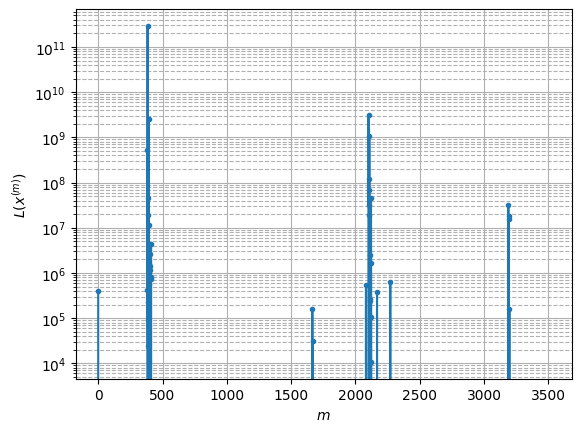

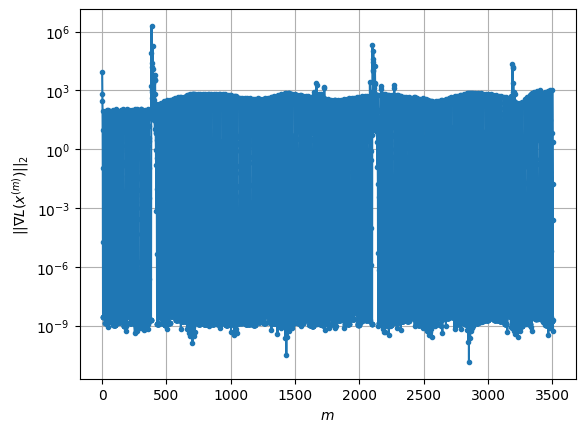

Windows:  59%|█████▉    | 234/395 [02:35<01:49,  1.47it/s]

Before applying the algorithm
Cost function: -138451.92676859302
Gradient norm: 1140.5954385695388
Global relative error: 308.34434063606943
Position relative errors: 1.1193485002695533 m, 154.3005198526818 m, 123.42762679146149 m, 236.66892944919724 m

Iteration 1
Cost function: -236308.45665542356 (-70.68%)
Gradient norm: 6.951316669841799 (-99.39%)
Global relative error: 228.72820166589443 (-25.82%)
Position relative errors: 0.09869108082011993 m, 91.85903035579072 m, 6.0923764786654315 m, 209.33612725925414 m

Iteration 2
Cost function: -236350.28918889276 (-0.02%)
Gradient norm: 5.405898361957118 (-22.23%)
Global relative error: 304.7533855046242 (33.24%)
Position relative errors: 0.09869108082011993 m, 43.289321883064346 m, 5.469728187523686 m, 301.5807770874024 m

Iteration 3
Cost function: -236354.3450928137 (-0.00%)
Gradient norm: 0.18155640254518496 (-96.64%)
Global relative error: 289.8577373170011 (-4.89%)
Position relative errors: 0.09869108082011993 m, 48.85459907046185 m

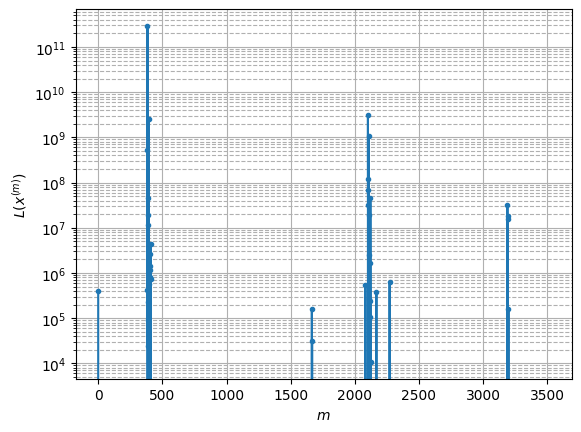

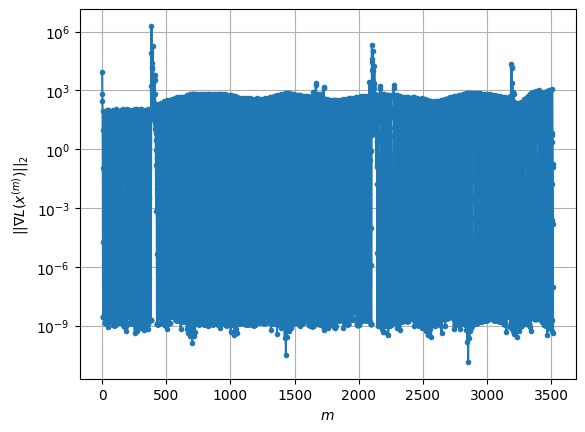

Windows:  59%|█████▉    | 235/395 [02:36<01:55,  1.39it/s]

Before applying the algorithm
Cost function: -137902.2300435357
Gradient norm: 1145.342145869882
Global relative error: 355.0877444610142
Position relative errors: 1.1552946522677343 m, 125.4150297847034 m, 122.484299036395 m, 308.7635622964811 m

Iteration 1
Cost function: -236304.60940892436 (-71.36%)
Gradient norm: 6.083232604450497 (-99.47%)
Global relative error: 327.544287199864 (-7.76%)
Position relative errors: 0.04834003448091458 m, 71.40406086731758 m, 36.73294621470173 m, 317.51804286091107 m

Iteration 2
Cost function: -236355.0385689139 (-0.02%)
Gradient norm: 2.3701852180701843 (-61.04%)
Global relative error: 193.209423755559 (-41.01%)
Position relative errors: 0.04834003448091458 m, 9.370153797243388 m, 5.4063746551861716 m, 192.85525522985128 m

Iteration 3
Cost function: -236356.8156660523 (-0.00%)
Gradient norm: 0.33552830420811786 (-85.84%)
Global relative error: 149.47918043877777 (-22.63%)
Position relative errors: 0.04834003448091458 m, 24.097391200756906 m, 5.32

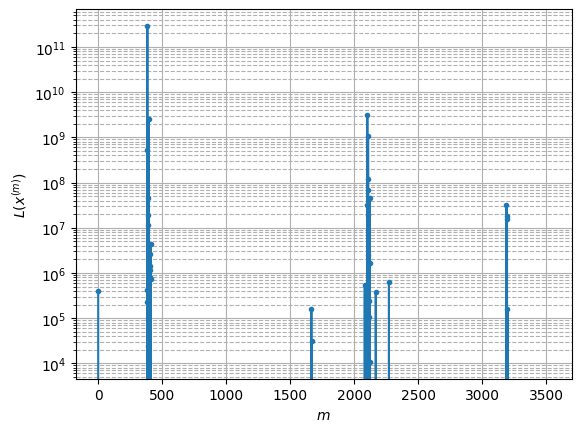

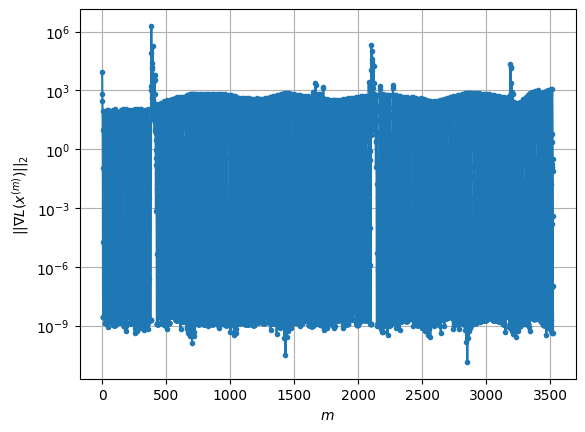

Windows:  60%|█████▉    | 236/395 [02:36<01:53,  1.40it/s]

Before applying the algorithm
Cost function: -131338.2454361868
Gradient norm: 1189.7621357114538
Global relative error: 273.4767139335733
Position relative errors: 1.2205951077729456 m, 135.4260273052571 m, 125.80923691254917 m, 201.49493886590804 m

Iteration 1
Cost function: -236298.86267683705 (-79.92%)
Gradient norm: 5.091080257268138 (-99.57%)
Global relative error: 191.27647280541026 (-30.06%)
Position relative errors: 0.2237800860859969 m, 77.93487551983664 m, 57.80203304504144 m, 164.7788799155075 m

Iteration 2
Cost function: -236354.85464436284 (-0.02%)
Gradient norm: 2.990076021530109 (-41.27%)
Global relative error: 69.18804256230261 (-63.83%)
Position relative errors: 0.2237800860859969 m, 28.153457022417214 m, 1.8823076868842739 m, 63.016942744191375 m

Iteration 3
Cost function: -236356.69834194196 (-0.00%)
Gradient norm: 0.22397577301241695 (-92.51%)
Global relative error: 35.952918767691955 (-48.04%)
Position relative errors: 0.2237800860859969 m, 19.219638680060743 m

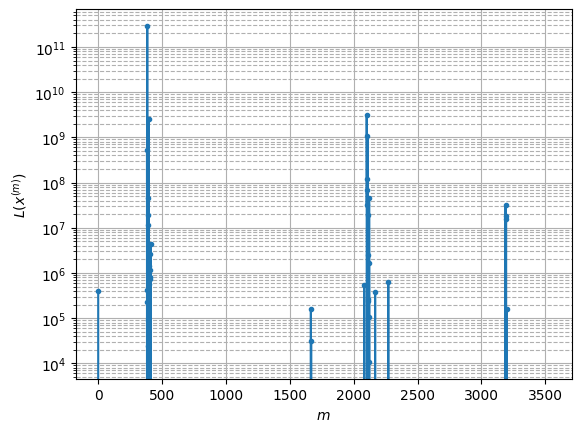

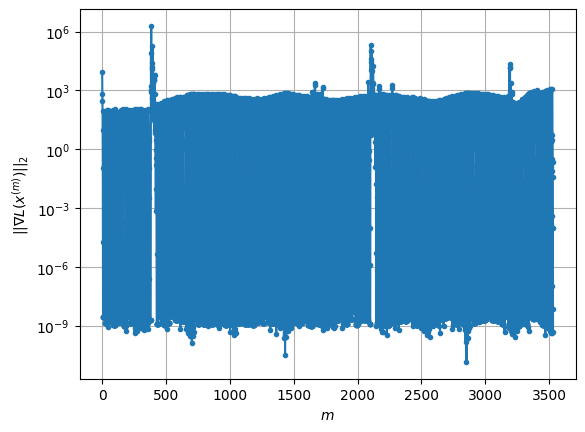

Windows:  60%|██████    | 237/395 [02:37<01:52,  1.41it/s]

Before applying the algorithm
Cost function: -124358.62652480263
Gradient norm: 1232.642201082676
Global relative error: 283.468509008074
Position relative errors: 1.2080815866969898 m, 168.47359252741174 m, 123.6620211382404 m, 191.46196953396253 m

Iteration 1
Cost function: -236307.96133773404 (-90.02%)
Gradient norm: 4.093550810020165 (-99.67%)
Global relative error: 183.991384683741 (-35.09%)
Position relative errors: 0.16778476394484015 m, 120.59140141154587 m, 65.26553999915147 m, 122.60228860466857 m

Iteration 2
Cost function: -236356.2127738474 (-0.02%)
Gradient norm: 2.4472957570098215 (-40.22%)
Global relative error: 96.84619196614982 (-47.36%)
Position relative errors: 0.16778476394484015 m, 23.46927311857094 m, 1.0016153452748697 m, 93.84957764089246 m

Iteration 3
Cost function: -236358.48974616884 (-0.00%)
Gradient norm: 0.7144202436325929 (-70.81%)
Global relative error: 42.129698216499634 (-56.50%)
Position relative errors: 0.16778476394484015 m, 13.32264140905434 m, 

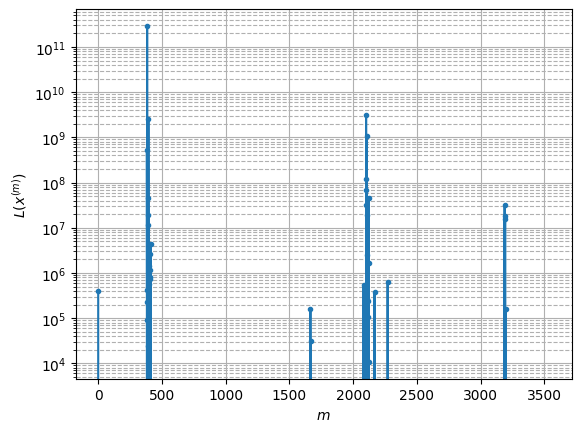

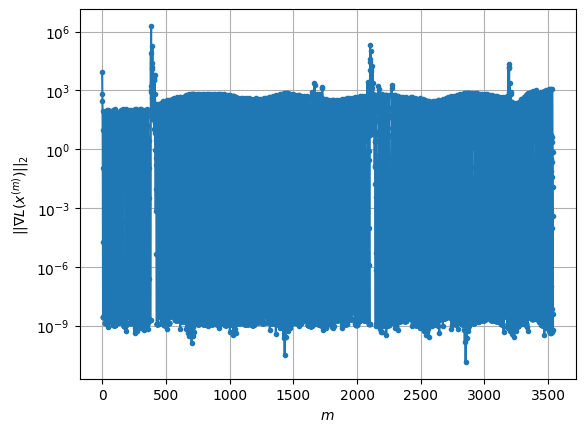

Windows:  60%|██████    | 238/395 [02:38<01:49,  1.43it/s]

Before applying the algorithm
Cost function: -120492.7260860755
Gradient norm: 1256.3699313389393
Global relative error: 275.8336032076092
Position relative errors: 1.1195165374411955 m, 149.76055641904318 m, 122.34248951730193 m, 196.6403971211621 m

Iteration 1
Cost function: -236326.59745876584 (-96.13%)
Gradient norm: 2.8792216532626314 (-99.77%)
Global relative error: 176.39243761154736 (-36.05%)
Position relative errors: 0.041740648156358966 m, 103.54177099375181 m, 70.88992997182532 m, 123.88882609547477 m

Iteration 2
Cost function: -236357.07808576457 (-0.01%)
Gradient norm: 2.4081227998543335 (-16.36%)
Global relative error: 159.893030726175 (-9.35%)
Position relative errors: 0.041740648156350015 m, 33.401348931792825 m, 7.354210149189785 m, 156.129678325819 m

Iteration 3
Cost function: -236358.6220968514 (-0.00%)
Gradient norm: 0.11010581878817767 (-95.43%)
Global relative error: 155.39622880948687 (-2.81%)
Position relative errors: 0.041740648156350015 m, 31.72637909579575

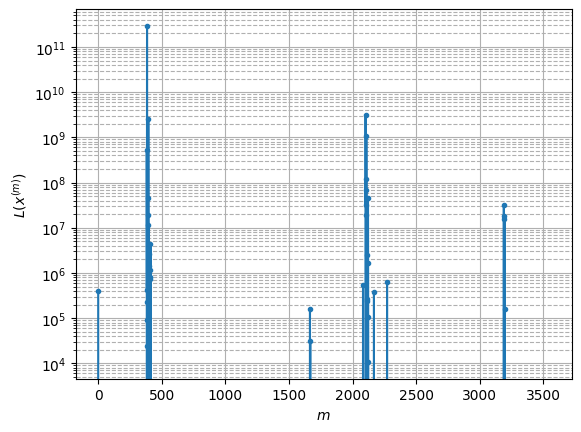

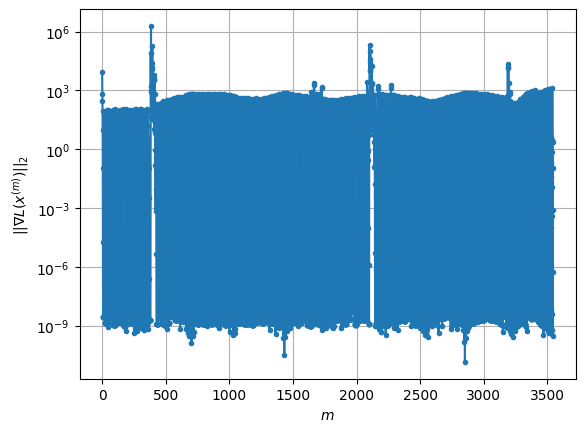

Windows:  61%|██████    | 239/395 [02:38<01:49,  1.43it/s]

Before applying the algorithm
Cost function: -111794.92468417846
Gradient norm: 1301.5168577770098
Global relative error: 348.15815693775403
Position relative errors: 1.2480142087245099 m, 169.69908396774804 m, 121.84554073123074 m, 278.47597792493207 m

Iteration 1
Cost function: -236333.2741807786 (-111.40%)
Gradient norm: 2.2455204868201104 (-99.83%)
Global relative error: 289.4675643137646 (-16.86%)
Position relative errors: 0.15910453084278464 m, 136.51796001720714 m, 72.90998416580844 m, 244.5789581120399 m

Iteration 2
Cost function: -236355.15515312707 (-0.01%)
Gradient norm: 6.580161998219579 (193.04%)
Global relative error: 91.3824956434033 (-68.43%)
Position relative errors: 0.15910453084278464 m, 38.30333410760514 m, 5.376439402783719 m, 82.67480973882995 m

Iteration 3
Cost function: -236358.98275518973 (-0.00%)
Gradient norm: 0.009082292902189214 (-99.86%)
Global relative error: 89.37530069509715 (-2.20%)
Position relative errors: 0.15910453084278464 m, 42.00476234940903 

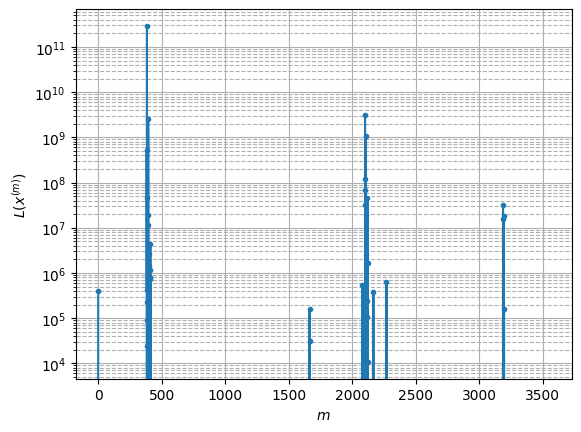

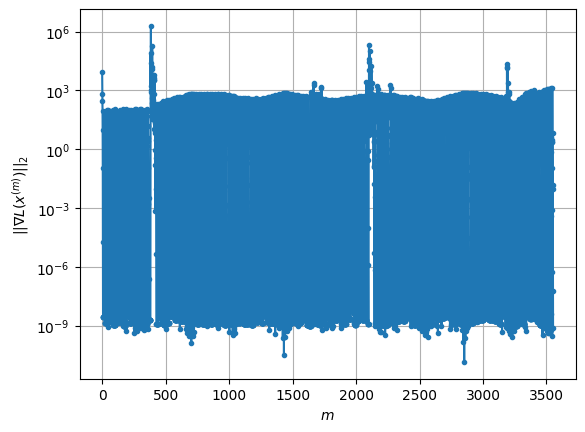

Windows:  61%|██████    | 240/395 [02:39<01:45,  1.47it/s]

Before applying the algorithm
Cost function: -115954.91741419224
Gradient norm: 1281.4769452291234
Global relative error: 283.39133143900426
Position relative errors: 1.1394264252998894 m, 188.30365213963938 m, 124.15703915031357 m, 171.51283667672664 m

Iteration 1
Cost function: -236330.8602345773 (-103.81%)
Gradient norm: 2.055459386841199 (-99.84%)
Global relative error: 181.90523804031173 (-35.81%)
Position relative errors: 0.11175718410851193 m, 147.63100849426024 m, 81.45929957374638 m, 68.11395938542998 m

Iteration 2
Cost function: -236349.17303940398 (-0.01%)
Gradient norm: 5.927603531553949 (188.38%)
Global relative error: 131.77110420732737 (-27.56%)
Position relative errors: 0.11175718410851193 m, 68.6744211307178 m, 10.641585977642713 m, 111.86926488984726 m

Iteration 3
Cost function: -236357.07206846657 (-0.00%)
Gradient norm: 0.40057784773773253 (-93.24%)
Global relative error: 149.31878628298543 (13.32%)
Position relative errors: 0.11175718410851193 m, 29.456767100850

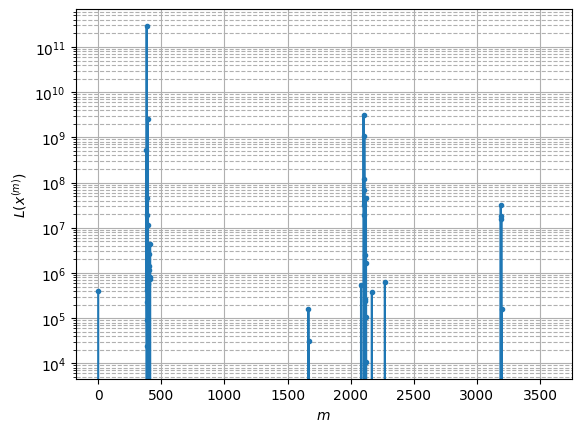

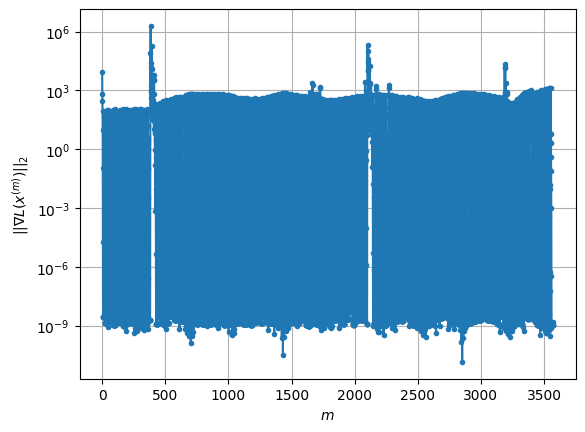

Windows:  61%|██████    | 241/395 [02:40<01:50,  1.39it/s]

Before applying the algorithm
Cost function: -118704.18400421175
Gradient norm: 1265.1426937557696
Global relative error: 296.1562648770054
Position relative errors: 1.2057858112579127 m, 147.99388165254334 m, 120.18605146956953 m, 226.58518131926255 m

Iteration 1
Cost function: -236332.12212000525 (-99.09%)
Gradient norm: 2.27297922011425 (-99.82%)
Global relative error: 209.15975836867577 (-29.38%)
Position relative errors: 0.32593168902132313 m, 100.07767720343563 m, 77.04275888461595 m, 166.66496686415093 m

Iteration 2
Cost function: -236154.595071884 (0.08%)
Gradient norm: 38.06406168318463 (1574.63%)
Global relative error: 404.05974188803765 (93.18%)
Position relative errors: 0.32593168902132313 m, 215.587861023338 m, 18.667538934000458 m, 341.20112399306487 m

Iteration 3
Cost function: -236339.9583908099 (-0.08%)
Gradient norm: 2.4219583348386893 (-93.64%)
Global relative error: 383.6164552358631 (-5.06%)
Position relative errors: 0.32593168902132313 m, 86.43698461197866 m, 1

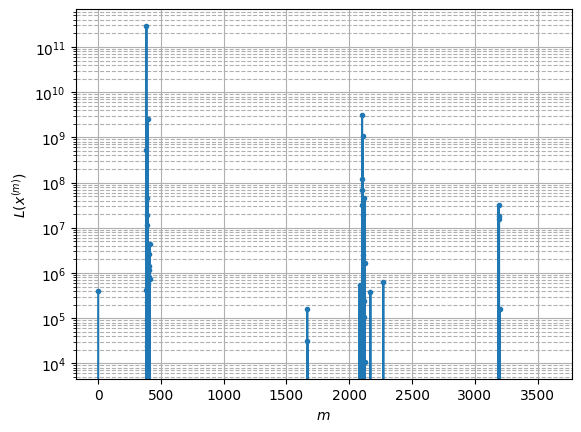

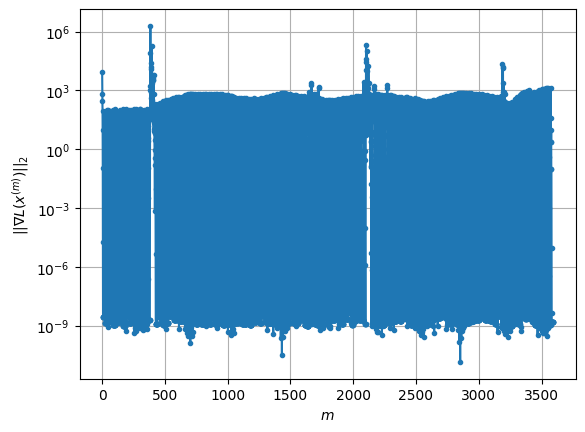

Windows:  61%|██████▏   | 242/395 [02:40<01:48,  1.42it/s]

Before applying the algorithm
Cost function: -112467.50981907416
Gradient norm: 1295.1497242624696
Global relative error: 257.04002409060257
Position relative errors: 1.3480769278485976 m, 144.84672918132262 m, 120.59167288474109 m, 174.71561959740242 m

Iteration 1
Cost function: -236322.76850560756 (-110.13%)
Gradient norm: 2.2330744311825277 (-99.83%)
Global relative error: 124.38215626314002 (-51.61%)
Position relative errors: 0.07104798291883199 m, 93.59456917739877 m, 71.05777474175233 m, 40.52755358984436 m

Iteration 2
Cost function: -236137.40326613848 (0.08%)
Gradient norm: 34.751997625789784 (1456.24%)
Global relative error: 512.2847758098915 (311.86%)
Position relative errors: 0.07104798291883199 m, 246.76661508631145 m, 10.555982680392685 m, 448.78860610442007 m

Iteration 3
Cost function: -236333.9368269772 (-0.08%)
Gradient norm: 2.34368970878002 (-93.26%)
Global relative error: 489.52417957751584 (-4.44%)
Position relative errors: 0.07104798291883199 m, 110.894715563711

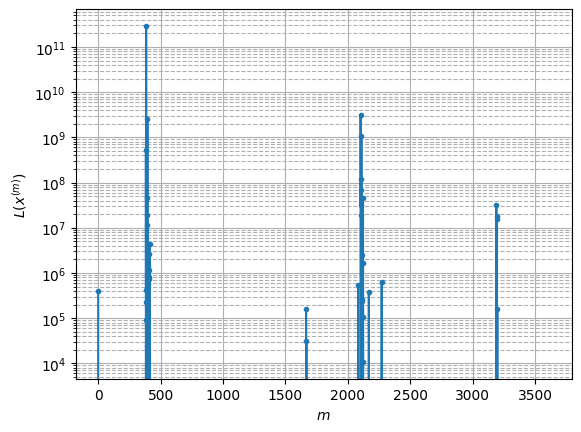

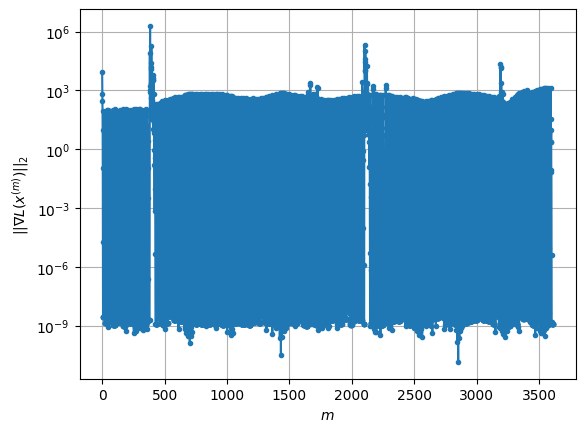

Windows:  62%|██████▏   | 243/395 [02:41<01:49,  1.39it/s]

Before applying the algorithm
Cost function: -116510.45050263099
Gradient norm: 1273.5005259148747
Global relative error: 266.26621303383797
Position relative errors: 1.1883564143027308 m, 119.73957212458852 m, 120.67011215182191 m, 204.88591213538035 m

Iteration 1
Cost function: -236329.85582680092 (-102.84%)
Gradient norm: 3.0023038811853984 (-99.76%)
Global relative error: 141.2757968266018 (-46.94%)
Position relative errors: 0.15495250519634243 m, 59.54577500041927 m, 76.19716364564216 m, 102.89758874296767 m

Iteration 2
Cost function: -236351.07762469503 (-0.01%)
Gradient norm: 7.414229550116032 (146.95%)
Global relative error: 292.16100202827715 (106.80%)
Position relative errors: 0.15495250519634243 m, 17.475528881110478 m, 35.88403012648248 m, 289.38860282765296 m

Iteration 3
Cost function: -236357.6109732482 (-0.00%)
Gradient norm: 0.1573730310236762 (-97.88%)
Global relative error: 253.98133337797003 (-13.07%)
Position relative errors: 0.15495250519634243 m, 24.61176242483

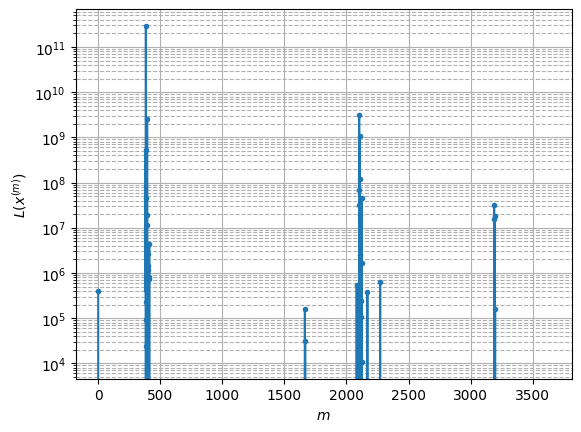

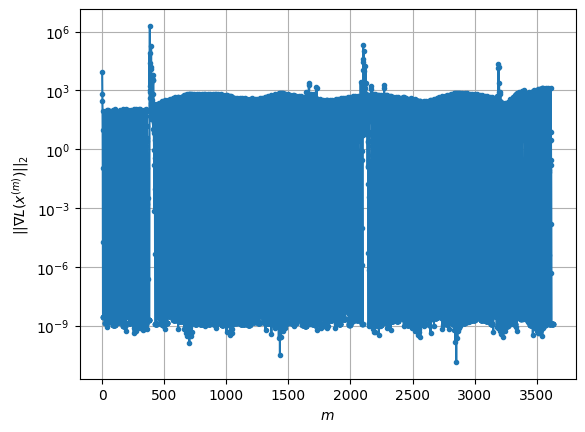

Windows:  62%|██████▏   | 244/395 [02:42<01:47,  1.40it/s]

Before applying the algorithm
Cost function: -113751.2205760281
Gradient norm: 1286.3397059674373
Global relative error: 316.35867896565316
Position relative errors: 1.1111788158679103 m, 137.7228944932754 m, 112.6283169223516 m, 261.55252672886405 m

Iteration 1
Cost function: -236316.95920273004 (-107.75%)
Gradient norm: 3.0184310620220085 (-99.77%)
Global relative error: 238.602891662124 (-24.58%)
Position relative errors: 0.12942509714722214 m, 84.021339214216 m, 61.249055425319966 m, 214.71182912200143 m

Iteration 2
Cost function: -236011.79171142212 (0.13%)
Gradient norm: 55.978029047813564 (1754.54%)
Global relative error: 576.1545069434469 (141.47%)
Position relative errors: 0.12942509714722214 m, 125.70515750461846 m, 126.46958004464382 m, 547.8490088158866 m

Iteration 3
Cost function: -236331.62138885315 (-0.14%)
Gradient norm: 2.334209209850884 (-95.83%)
Global relative error: 585.4546148327908 (1.61%)
Position relative errors: 0.12942509714722214 m, 38.062442542847194 m, 

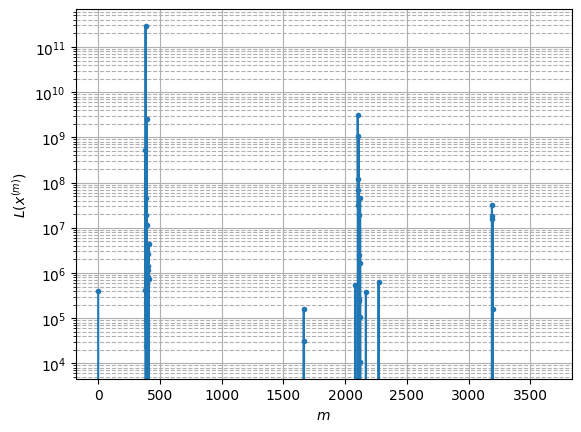

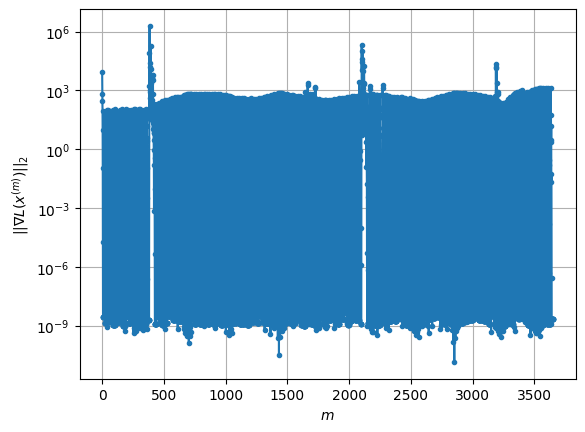

Windows:  62%|██████▏   | 245/395 [02:43<01:47,  1.39it/s]

Before applying the algorithm
Cost function: -112571.38631352346
Gradient norm: 1291.9323088699236
Global relative error: 301.44219080797825
Position relative errors: 1.3673329146610793 m, 155.81727598383966 m, 165.33964788873388 m, 198.06632708605 m

Iteration 1
Cost function: -236321.12435703707 (-109.93%)
Gradient norm: 3.6229265159329778 (-99.72%)
Global relative error: 156.71807877971492 (-48.01%)
Position relative errors: 0.09836822818944838 m, 93.51142633480848 m, 111.43156952015589 m, 58.138909378656244 m

Iteration 2
Cost function: -236357.43679334054 (-0.02%)
Gradient norm: 2.0659161012556155 (-42.98%)
Global relative error: 121.8920428247011 (-22.22%)
Position relative errors: 0.09836822818944838 m, 14.950179867500157 m, 20.872558507150732 m, 119.0775236369318 m

Iteration 3
Cost function: -236360.7637322766 (-0.00%)
Gradient norm: 0.2749508388725333 (-86.69%)
Global relative error: 90.91552111556605 (-25.41%)
Position relative errors: 0.09836822818944838 m, 25.3400176771550

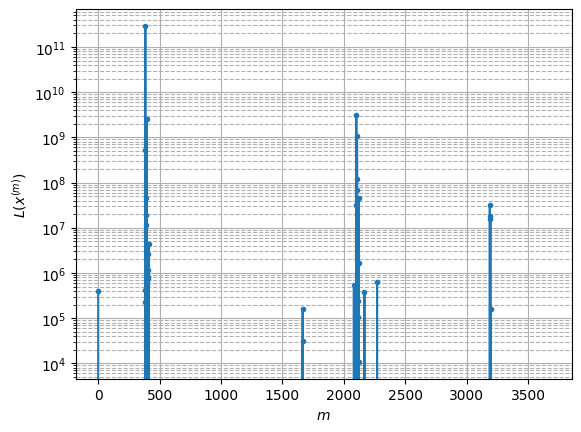

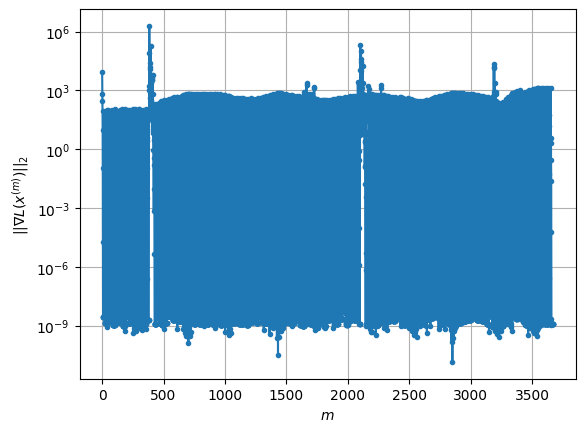

Windows:  62%|██████▏   | 246/395 [02:43<01:44,  1.42it/s]

Before applying the algorithm
Cost function: -115677.43217032585
Gradient norm: 1272.4668539075342
Global relative error: 286.5990785599678
Position relative errors: 1.3202809604579056 m, 171.6607289805327 m, 132.09259217390616 m, 187.62325804126112 m

Iteration 1
Cost function: -236313.62685279734 (-104.29%)
Gradient norm: 3.664540730188852 (-99.71%)
Global relative error: 109.66050595905585 (-61.74%)
Position relative errors: 0.17721181228951138 m, 93.11258342849563 m, 53.021096269746685 m, 22.91860315452957 m

Iteration 2
Cost function: -236343.24315299993 (-0.01%)
Gradient norm: 4.980472357997201 (35.91%)
Global relative error: 187.49894992915767 (70.98%)
Position relative errors: 0.17721181228951138 m, 83.273221396476 m, 41.06300883603081 m, 162.83820735274426 m

Iteration 3
Cost function: -236358.49807530362 (-0.01%)
Gradient norm: 1.3512708628348675 (-72.87%)
Global relative error: 110.11607018515416 (-41.27%)
Position relative errors: 0.17721181228951138 m, 39.11784653175384 m,

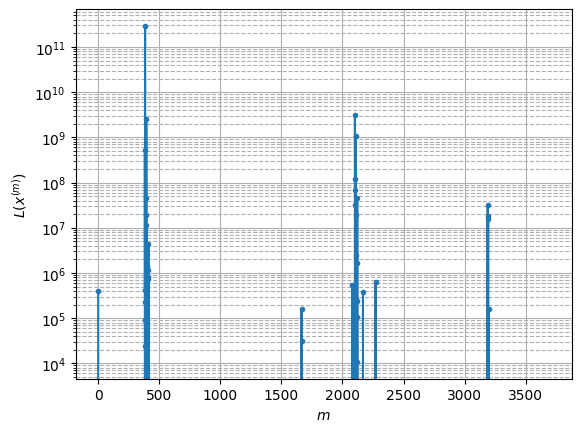

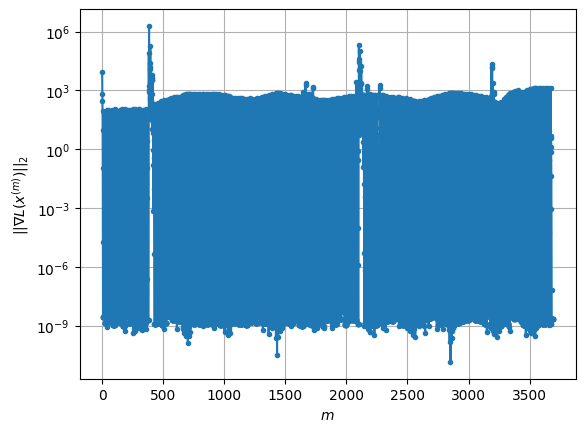

Windows:  63%|██████▎   | 247/395 [02:44<01:46,  1.39it/s]

Before applying the algorithm
Cost function: -115030.08625047535
Gradient norm: 1275.660158027735
Global relative error: 293.451709332136
Position relative errors: 1.4029173002967443 m, 132.92151540562799 m, 122.81623402491316 m, 230.95695281446763 m

Iteration 1
Cost function: -236325.3198131147 (-105.45%)
Gradient norm: 4.128364755855064 (-99.68%)
Global relative error: 175.77378124997733 (-40.10%)
Position relative errors: 0.04472405263197284 m, 50.87737154226365 m, 41.09570617381494 m, 163.09564461331888 m

Iteration 2
Cost function: -236317.67265478754 (0.00%)
Gradient norm: 17.37937054467773 (320.97%)
Global relative error: 324.7472204819963 (84.75%)
Position relative errors: 0.04472405263197284 m, 48.415178738012145 m, 109.47075862556335 m, 301.850976149466 m

Iteration 3
Cost function: -236355.73571292922 (-0.02%)
Gradient norm: 1.6481682725235214 (-90.52%)
Global relative error: 255.2131747507425 (-21.41%)
Position relative errors: 0.04472405263197284 m, 26.591693769539845 m, 

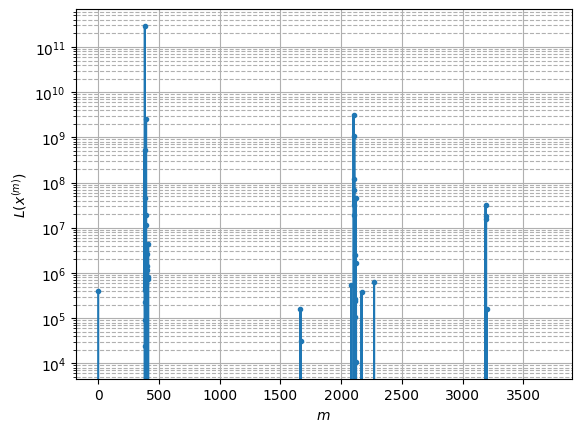

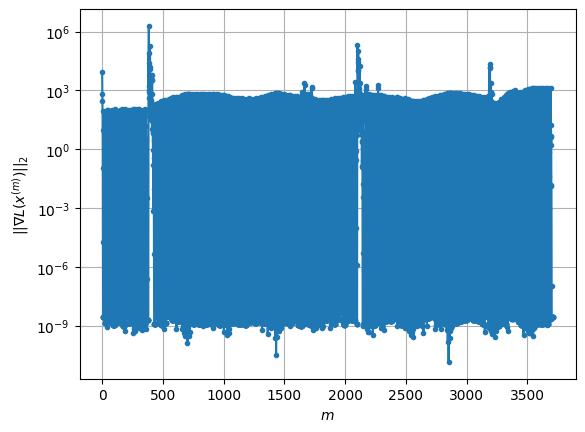

Windows:  63%|██████▎   | 248/395 [02:45<01:43,  1.42it/s]

Before applying the algorithm
Cost function: -120338.96888566573
Gradient norm: 1245.5871266148222
Global relative error: 269.86747443180894
Position relative errors: 1.2385479959370806 m, 147.31523522734 m, 128.27139394521825 m, 186.1526374432852 m

Iteration 1
Cost function: -236324.4484986462 (-96.38%)
Gradient norm: 3.988085907102282 (-99.68%)
Global relative error: 124.0869587882832 (-54.02%)
Position relative errors: 0.21294889911936066 m, 55.483338372263574 m, 36.6552277438835 m, 104.67442449312375 m

Iteration 2
Cost function: -236358.25108036713 (-0.01%)
Gradient norm: 1.44058322536932 (-63.88%)
Global relative error: 264.956310146993 (113.52%)
Position relative errors: 0.21294889911936066 m, 26.99559726687092 m, 69.17221085930052 m, 254.30190250817938 m

Iteration 3
Cost function: -236359.14163116654 (-0.00%)
Gradient norm: 0.1559396778635429 (-89.18%)
Global relative error: 211.5642790563498 (-20.15%)
Position relative errors: 0.21294889911936066 m, 22.237705213566603 m, 51.

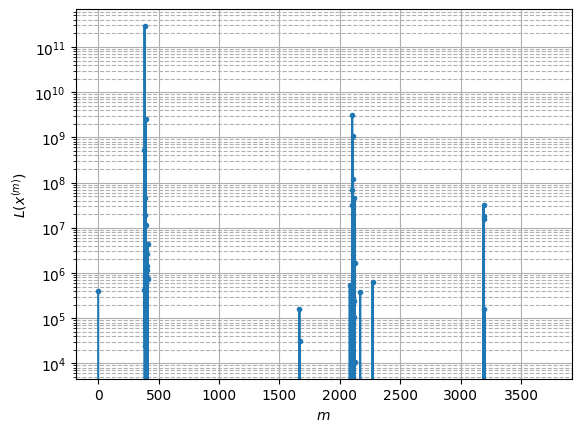

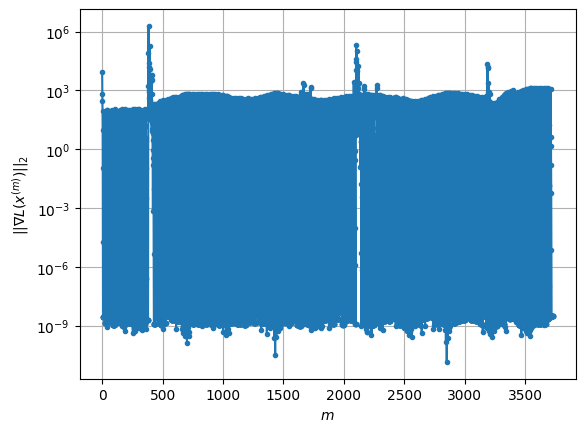

Windows:  63%|██████▎   | 249/395 [02:45<01:43,  1.41it/s]

Before applying the algorithm
Cost function: -128343.15805934856
Gradient norm: 1200.9670306133203
Global relative error: 319.6212911543075
Position relative errors: 1.1765051192898655 m, 142.01586191721427 m, 88.88344228770252 m, 272.1559756574598 m

Iteration 1
Cost function: -236309.48285416284 (-84.12%)
Gradient norm: 4.804727864109026 (-99.60%)
Global relative error: 291.0161326569387 (-8.95%)
Position relative errors: 0.24412037250475954 m, 58.99506607014065 m, 20.473765098946796 m, 284.20414816485544 m

Iteration 2
Cost function: -228690.03371219337 (3.22%)
Gradient norm: 276.7887579344816 (5660.76%)
Global relative error: 1818.0824257972681 (524.74%)
Position relative errors: 0.24412037250475954 m, 184.35925573000114 m, 612.1161302770796 m, 1701.9783829765959 m

Iteration 3
Cost function: -236082.21563095404 (-3.23%)
Gradient norm: 3.3738674031784193 (-98.78%)
Global relative error: 1822.1370749209223 (0.22%)
Position relative errors: 0.24412037250475954 m, 210.7947119811455 m,

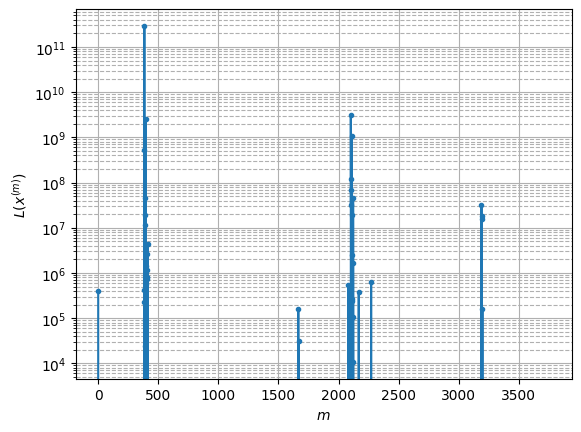

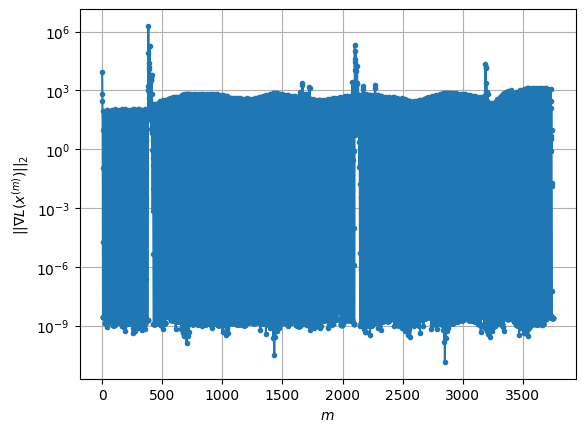

Windows:  63%|██████▎   | 250/395 [02:46<01:42,  1.41it/s]

Before applying the algorithm
Cost function: -125201.84270130788
Gradient norm: 1214.8595701691747
Global relative error: 287.913566323067
Position relative errors: 1.32716353560783 m, 159.314598169441 m, 141.64795478754976 m, 193.46453365863772 m

Iteration 1
Cost function: -236334.0772206391 (-88.76%)
Gradient norm: 4.738955435568387 (-99.61%)
Global relative error: 120.20894561876628 (-58.25%)
Position relative errors: 0.2512446249704046 m, 43.7856814573357 m, 31.27486562776458 m, 107.4065832317527 m

Iteration 2
Cost function: -236356.93193951226 (-0.01%)
Gradient norm: 3.881135831134457 (-18.10%)
Global relative error: 113.96080699263666 (-5.20%)
Position relative errors: 0.2512446249704046 m, 14.94208138054027 m, 63.1780294352247 m, 93.56079823608754 m

Iteration 3
Cost function: -236361.80157199496 (-0.00%)
Gradient norm: 0.8925562803417261 (-77.00%)
Global relative error: 28.206841459291823 (-75.25%)
Position relative errors: 0.2512446249704046 m, 9.41235746138812 m, 8.20766615

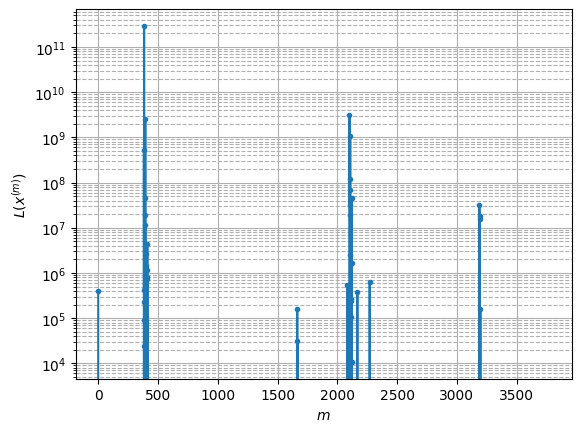

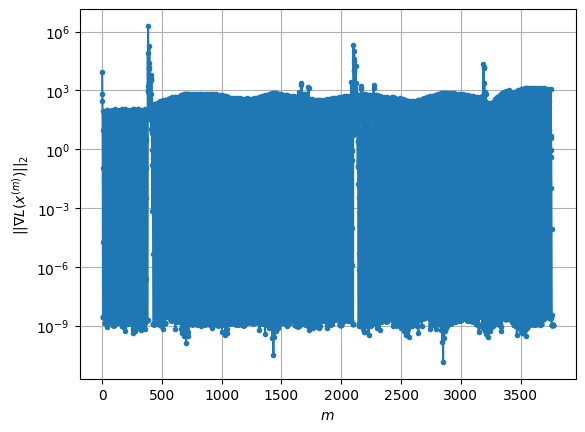

Windows:  64%|██████▎   | 251/395 [02:47<01:41,  1.42it/s]

Before applying the algorithm
Cost function: -136731.7976450324
Gradient norm: 1147.4962721771528
Global relative error: 280.91220529233044
Position relative errors: 1.0529452445824226 m, 144.42503637561265 m, 115.61180246563526 m, 211.34633381573866 m

Iteration 1
Cost function: -236316.40959587367 (-72.83%)
Gradient norm: 5.6990718768255615 (-99.50%)
Global relative error: 242.7966011427241 (-13.57%)
Position relative errors: 0.1642275191072732 m, 40.820499775211324 m, 24.6642649366974 m, 238.02713672879156 m

Iteration 2
Cost function: -220843.83468343277 (6.55%)
Gradient norm: 400.6571699275048 (6930.22%)
Global relative error: 2343.354816032697 (865.15%)
Position relative errors: 0.1642275191072732 m, 223.11281240012588 m, 787.0058269784969 m, 2195.9361699576 m

Iteration 3
Cost function: -236017.05062554276 (-6.87%)
Gradient norm: 5.120505080467028 (-98.72%)
Global relative error: 2349.5808292515926 (0.27%)
Position relative errors: 0.1642275191072732 m, 272.5269337923655 m, 739.

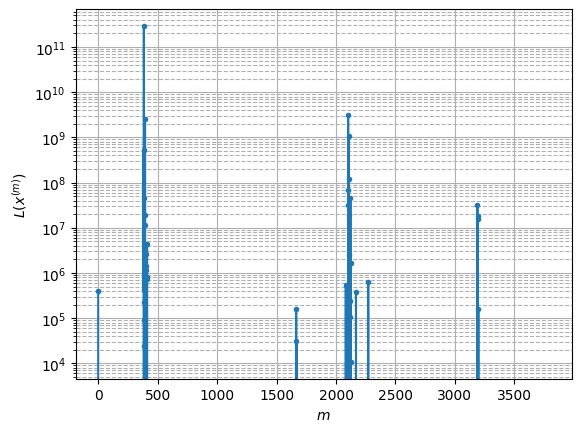

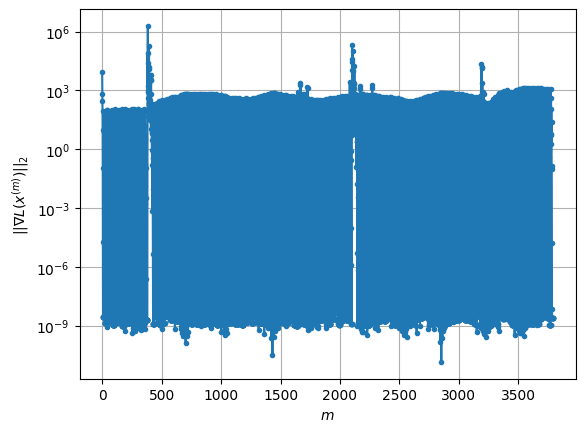

Windows:  64%|██████▍   | 252/395 [02:48<01:40,  1.42it/s]

Before applying the algorithm
Cost function: -138107.18081724917
Gradient norm: 1136.351555346057
Global relative error: 368.9589813966552
Position relative errors: 1.3750624343619864 m, 176.1189618232503 m, 159.7332507995294 m, 282.0952306635412 m

Iteration 1
Cost function: -236335.67460266224 (-71.12%)
Gradient norm: 5.533252824797957 (-99.51%)
Global relative error: 179.4797041800716 (-51.36%)
Position relative errors: 0.140793360330818 m, 39.03906974650281 m, 61.219722215980646 m, 164.0808372911473 m

Iteration 2
Cost function: -236316.47830686125 (0.01%)
Gradient norm: 19.188254043574062 (246.78%)
Global relative error: 421.32906206937497 (134.75%)
Position relative errors: 0.140793360330818 m, 48.6264733456294 m, 111.05869630334021 m, 403.4861471204438 m

Iteration 3
Cost function: -236354.84603515407 (-0.02%)
Gradient norm: 1.1550025384463323 (-93.98%)
Global relative error: 361.6550621496443 (-14.16%)
Position relative errors: 0.140793360330818 m, 52.23272032048798 m, 37.45180

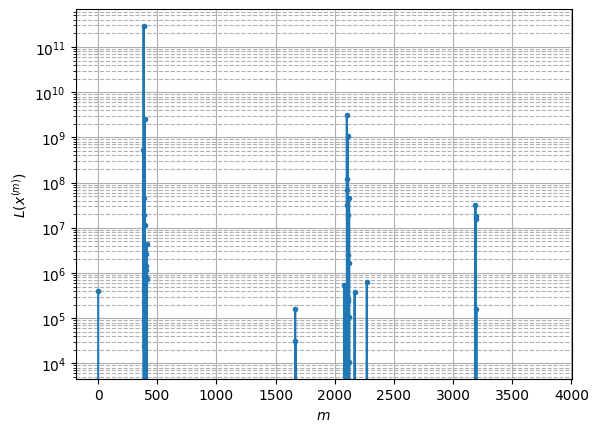

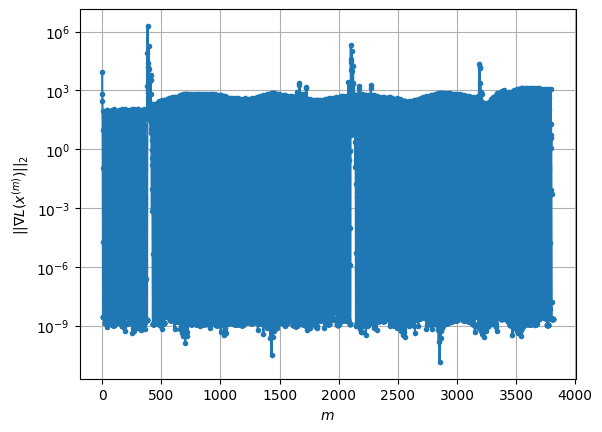

Windows:  64%|██████▍   | 253/395 [02:48<01:41,  1.41it/s]

Before applying the algorithm
Cost function: -147298.65311229278
Gradient norm: 1079.5886650245827
Global relative error: 282.9009648731767
Position relative errors: 1.3878024550486763 m, 122.94847930483841 m, 135.4144621903666 m, 215.77564664229274 m

Iteration 1
Cost function: -236327.96251193288 (-60.44%)
Gradient norm: 6.114183138876171 (-99.43%)
Global relative error: 274.35617645531056 (-3.02%)
Position relative errors: 0.2480021194244162 m, 46.84930967863069 m, 37.58523290167721 m, 267.6662985725821 m

Iteration 2
Cost function: -236322.09098886928 (0.00%)
Gradient norm: 13.749913029061096 (124.89%)
Global relative error: 621.6635007979147 (126.59%)
Position relative errors: 0.2480021194244162 m, 66.13327052849237 m, 208.74112059912457 m, 581.8079465825067 m

Iteration 3
Cost function: -236348.8556136839 (-0.01%)
Gradient norm: 0.7405538819895491 (-94.61%)
Global relative error: 515.0832816516144 (-17.14%)
Position relative errors: 0.2480021194244162 m, 48.78359679442672 m, 161.

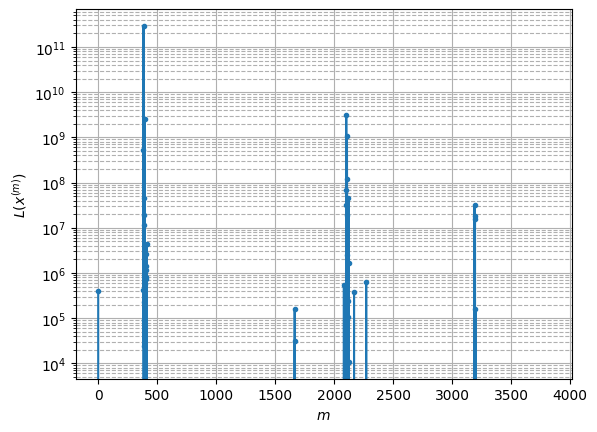

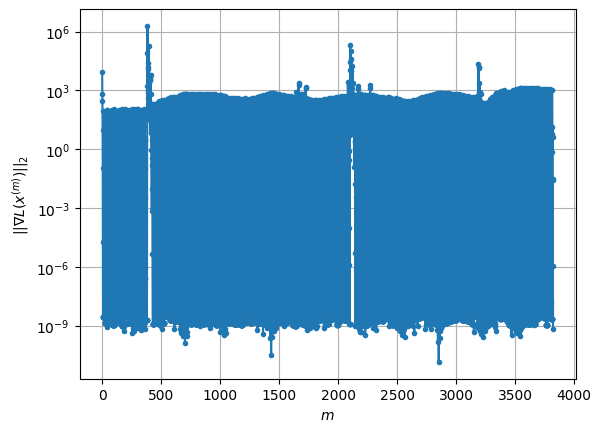

Windows:  64%|██████▍   | 254/395 [02:49<01:36,  1.45it/s]

Before applying the algorithm
Cost function: -150013.63362649552
Gradient norm: 1061.8246016164564
Global relative error: 313.961590818664
Position relative errors: 1.321910476991212 m, 145.5009521914727 m, 104.0774781548915 m, 257.9709427068136 m

Iteration 1
Cost function: -236338.80964173126 (-57.54%)
Gradient norm: 6.391125141827076 (-99.40%)
Global relative error: 344.1885287766523 (9.63%)
Position relative errors: 0.23028395234018842 m, 54.901965850798106 m, 101.86132624827222 m, 324.1253730241907 m

Iteration 2
Cost function: -236345.40782458897 (-0.00%)
Gradient norm: 7.659222834757441 (19.84%)
Global relative error: 77.47762063808547 (-77.49%)
Position relative errors: 0.23028395234018842 m, 46.03357810093113 m, 51.739178923993435 m, 34.4705452119467 m

Iteration 3
Cost function: -236355.71824986418 (-0.00%)
Gradient norm: 0.8377396115027965 (-89.06%)
Global relative error: 142.85409917811148 (84.38%)
Position relative errors: 0.23028395234018842 m, 43.03308623215881 m, 23.821

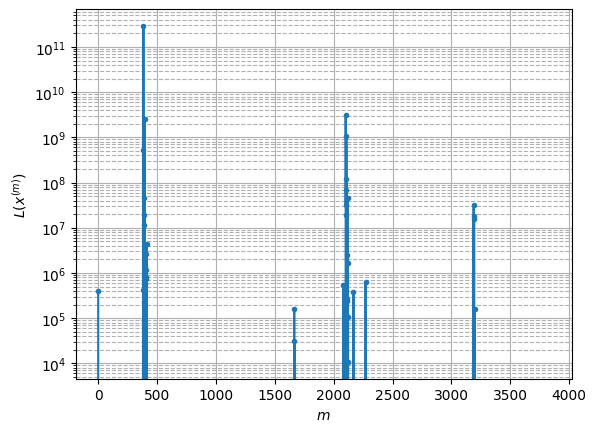

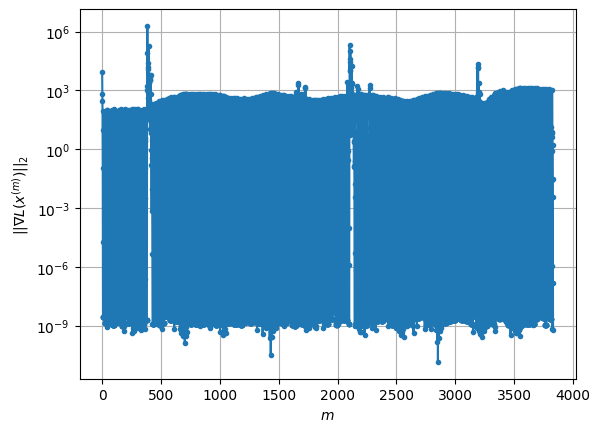

Windows:  65%|██████▍   | 255/395 [02:50<01:38,  1.42it/s]

Before applying the algorithm
Cost function: -156251.53619698988
Gradient norm: 1019.8490049424696
Global relative error: 390.98927219335354
Position relative errors: 1.134642448044013 m, 108.73104177100804 m, 132.83443357754328 m, 351.26263233979375 m

Iteration 1
Cost function: -236334.60803858782 (-51.25%)
Gradient norm: 6.379615345722599 (-99.37%)
Global relative error: 420.73594734743233 (7.61%)
Position relative errors: 0.08888305030226078 m, 59.09933314604642 m, 22.478296125094207 m, 415.9354084772094 m

Iteration 2
Cost function: -236137.21202593803 (0.08%)
Gradient norm: 48.483703019662585 (659.98%)
Global relative error: 476.9115198045149 (13.35%)
Position relative errors: 0.08888305030226078 m, 57.919217164999836 m, 208.50639810759324 m, 424.966558170404 m

Iteration 3
Cost function: -236347.14655988055 (-0.09%)
Gradient norm: 0.6797891704814917 (-98.60%)
Global relative error: 438.3738946074489 (-8.08%)
Position relative errors: 0.08888305030226078 m, 51.14418479017228 m, 1

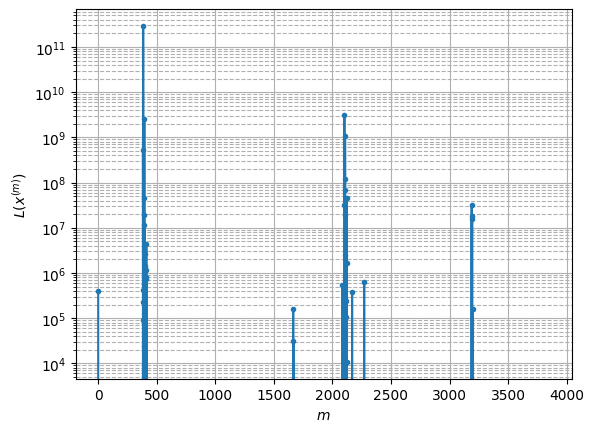

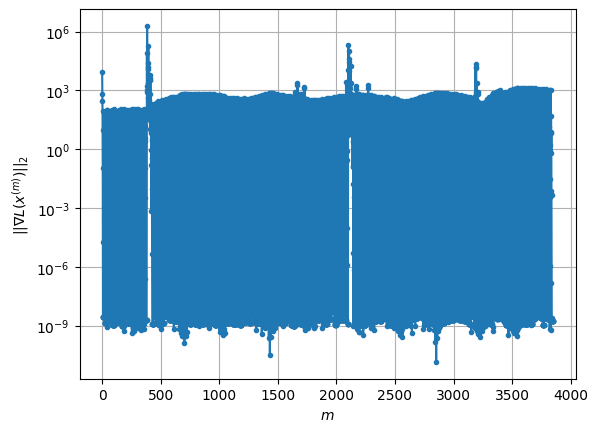

Windows:  65%|██████▍   | 256/395 [02:50<01:33,  1.48it/s]

Before applying the algorithm
Cost function: -163047.28324756533
Gradient norm: 970.4162531423334
Global relative error: 280.26334232694234
Position relative errors: 1.3010615898707225 m, 161.75867450743922 m, 149.6519751676273 m, 173.10641201769525 m

Iteration 1
Cost function: -236348.0049899993 (-44.96%)
Gradient norm: 8.320819848147222 (-99.14%)
Global relative error: 209.52450790234693 (-25.24%)
Position relative errors: 0.20705470459294092 m, 59.12517238817458 m, 48.94350166190469 m, 194.91225773618592 m

Iteration 2
Cost function: -236360.13800170735 (-0.01%)
Gradient norm: 0.9043915939581371 (-89.13%)
Global relative error: 108.03476445513701 (-48.44%)
Position relative errors: 0.20705470459294092 m, 33.11413544650793 m, 20.35914825510383 m, 100.70745064686551 m

Iteration 3
Cost function: -236360.50142403733 (-0.00%)
Gradient norm: 0.24092793780047492 (-73.36%)
Global relative error: 65.50320295654078 (-39.37%)
Position relative errors: 0.20705470459294092 m, 22.19228167127077

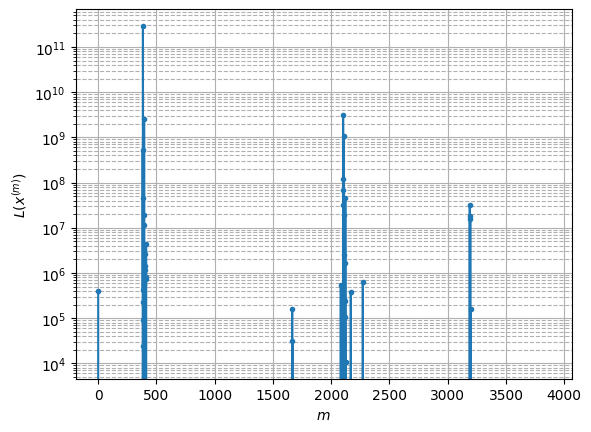

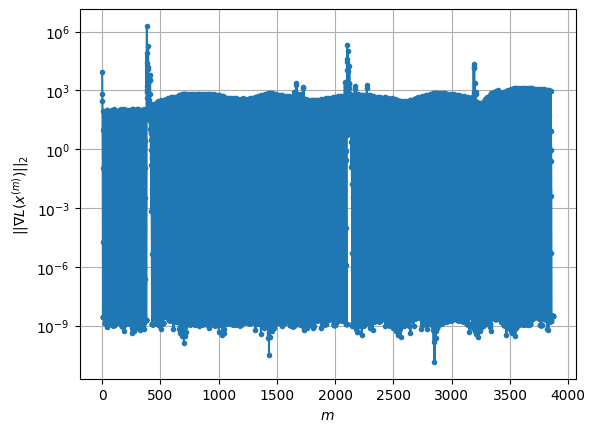

Windows:  65%|██████▌   | 257/395 [02:51<01:36,  1.42it/s]

Before applying the algorithm
Cost function: -171872.57293723262
Gradient norm: 905.6021654666379
Global relative error: 258.28853328937487
Position relative errors: 1.1237641869303898 m, 129.0010374231579 m, 113.23762032778822 m, 192.94875454217333 m

Iteration 1
Cost function: -236347.45029930177 (-37.51%)
Gradient norm: 7.98785260043076 (-99.12%)
Global relative error: 289.90259656093406 (12.24%)
Position relative errors: 0.16238452981503376 m, 76.33739383074901 m, 61.34715722011341 m, 272.82624935748845 m

Iteration 2
Cost function: -236357.64771520087 (-0.00%)
Gradient norm: 5.916858216622736 (-25.93%)
Global relative error: 146.61247688352339 (-49.43%)
Position relative errors: 0.16238452981503376 m, 18.597068446566787 m, 39.67353922762968 m, 139.84597223313997 m

Iteration 3
Cost function: -236361.42419646643 (-0.00%)
Gradient norm: 0.3685978401590151 (-93.77%)
Global relative error: 112.60839051320724 (-23.19%)
Position relative errors: 0.16238452981503376 m, 28.066917062316204

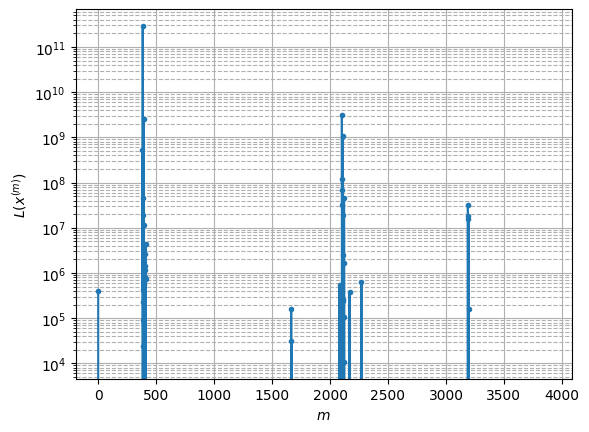

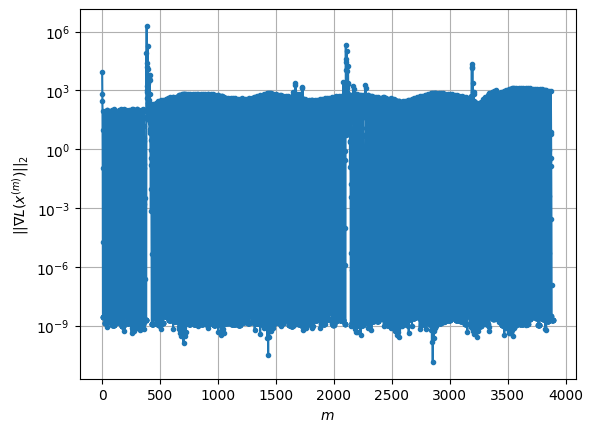

Windows:  65%|██████▌   | 258/395 [02:52<01:33,  1.46it/s]

Before applying the algorithm
Cost function: -177137.01899212375
Gradient norm: 862.2973997559103
Global relative error: 276.67485084707454
Position relative errors: 1.2901645359777711 m, 169.67330409488667 m, 99.49799834812427 m, 194.5249401752877 m

Iteration 1
Cost function: -236337.29640121243 (-33.42%)
Gradient norm: 9.586393706090067 (-98.89%)
Global relative error: 282.23145470918496 (2.01%)
Position relative errors: 0.07385968253378934 m, 89.09804690151151 m, 104.1518772202827 m, 246.67800603838737 m

Iteration 2
Cost function: -236354.5583912245 (-0.01%)
Gradient norm: 2.149000057194151 (-77.58%)
Global relative error: 96.64140480125937 (-65.76%)
Position relative errors: 0.07385968253378934 m, 32.69292978307465 m, 34.0437545742856 m, 84.22159084599573 m

Iteration 3
Cost function: -236356.30479100713 (-0.00%)
Gradient norm: 0.8400029647348891 (-60.91%)
Global relative error: 34.91742276758179 (-63.87%)
Position relative errors: 0.07385968253378934 m, 24.056113321771143 m, 9.2

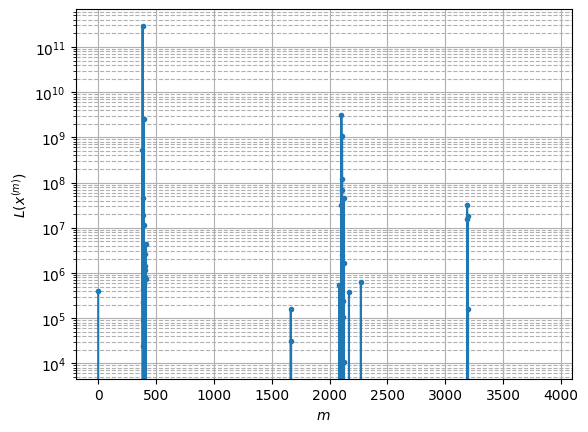

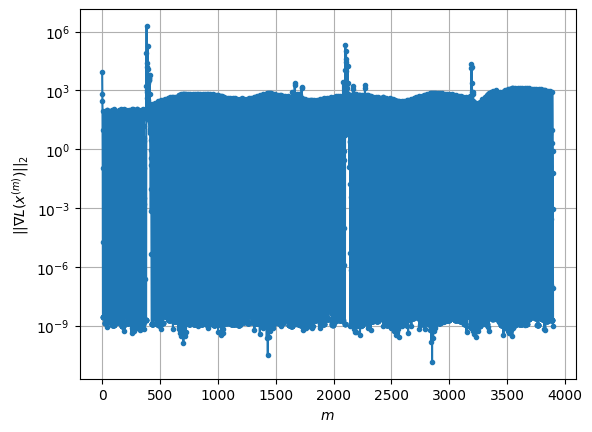

Windows:  66%|██████▌   | 259/395 [02:52<01:35,  1.43it/s]

Before applying the algorithm
Cost function: -181042.13535511086
Gradient norm: 829.9731658285347
Global relative error: 244.93842169606827
Position relative errors: 1.2993054867389386 m, 136.6769794879763 m, 132.10338972437873 m, 154.4109790949537 m

Iteration 1
Cost function: -236342.29943906987 (-30.55%)
Gradient norm: 11.387649078857617 (-98.63%)
Global relative error: 260.1062815287444 (6.19%)
Position relative errors: 0.25055026199618724 m, 85.6780841881792 m, 112.92751451473421 m, 218.0444170487319 m

Iteration 2
Cost function: -236359.03449036463 (-0.01%)
Gradient norm: 0.9525461455058761 (-91.64%)
Global relative error: 180.97496939874605 (-30.42%)
Position relative errors: 0.25055026199618724 m, 54.815914409568954 m, 56.234752408133154 m, 162.9915809419583 m

Iteration 3
Cost function: -236360.49598333196 (-0.00%)
Gradient norm: 1.0006813554866576 (5.05%)
Global relative error: 146.0689202075359 (-19.29%)
Position relative errors: 0.25055026199618724 m, 22.984070467526745 m, 

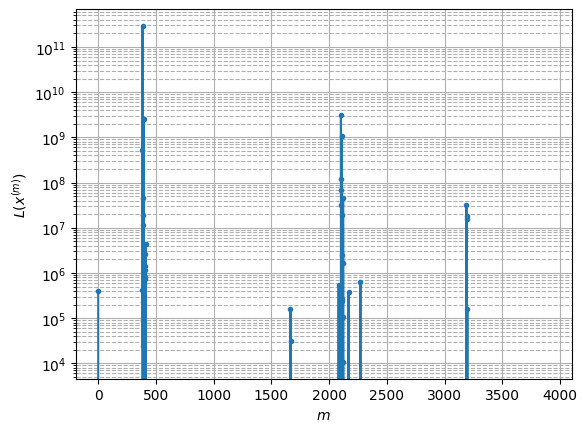

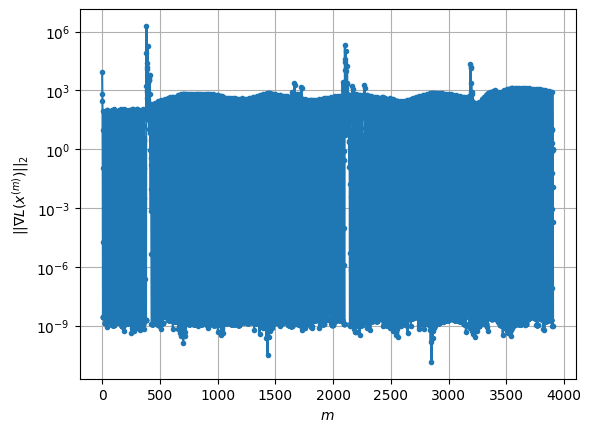

Windows:  66%|██████▌   | 260/395 [02:53<01:32,  1.46it/s]

Before applying the algorithm
Cost function: -189592.1806063511
Gradient norm: 757.9556299281408
Global relative error: 297.0545650245811
Position relative errors: 1.2119305741945083 m, 126.89485515226923 m, 124.17573868781373 m, 238.1165589014892 m

Iteration 1
Cost function: -236213.0804617904 (-24.59%)
Gradient norm: 34.29815945921686 (-95.47%)
Global relative error: 597.4289264926409 (101.12%)
Position relative errors: 0.16186067757354336 m, 253.78855790993708 m, 341.4922048378631 m, 419.37716444732587 m

Iteration 2
Cost function: -236328.85094550697 (-0.05%)
Gradient norm: 1.4087521160517524 (-95.89%)
Global relative error: 504.2512244725664 (-15.60%)
Position relative errors: 0.16186067757354336 m, 193.97208260856968 m, 272.0547342262858 m, 377.6397649565024 m

Iteration 3
Cost function: -236327.0369613298 (0.00%)
Gradient norm: 21.529515566493654 (1428.27%)
Global relative error: 182.9133999786005 (-63.73%)
Position relative errors: 0.16186067757354336 m, 31.25484095518908 m, 3

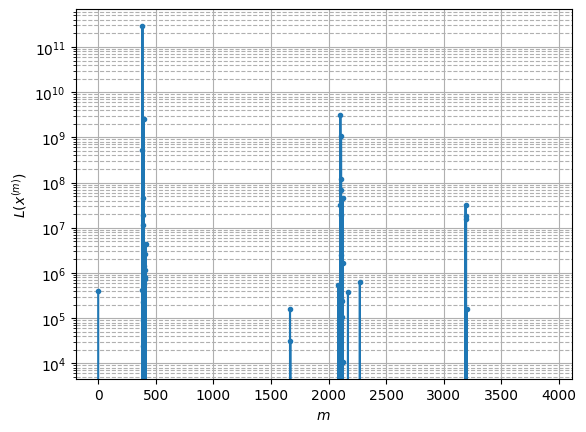

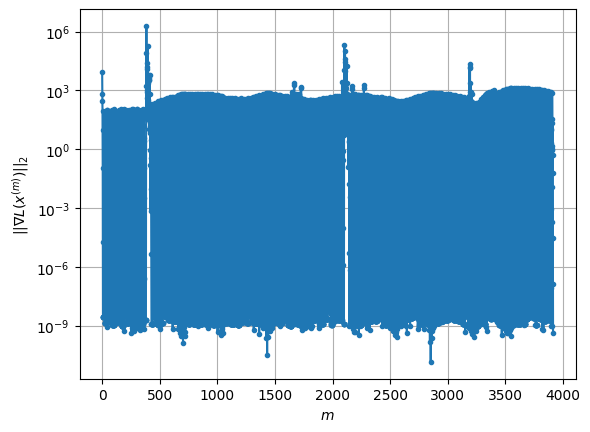

Windows:  66%|██████▌   | 261/395 [02:54<01:31,  1.46it/s]

Before applying the algorithm
Cost function: -195216.0286905254
Gradient norm: 702.3342598004037
Global relative error: 292.9895071412794
Position relative errors: 1.2308545354056664 m, 147.90740989440002 m, 100.38425303376465 m, 232.09726516166822 m

Iteration 1
Cost function: -236326.7075836992 (-21.06%)
Gradient norm: 10.863979705122796 (-98.45%)
Global relative error: 410.18300197105407 (40.00%)
Position relative errors: 0.22963135352408665 m, 125.39029428645563 m, 129.8359964485939 m, 368.30874937031325 m

Iteration 2
Cost function: -236355.01606290299 (-0.01%)
Gradient norm: 2.5599562579778254 (-76.44%)
Global relative error: 192.85046764660572 (-52.98%)
Position relative errors: 0.22963135352408665 m, 52.971804096335916 m, 72.16425429931431 m, 170.7599568853877 m

Iteration 3
Cost function: -236357.5555680829 (-0.00%)
Gradient norm: 1.15683842090809 (-54.81%)
Global relative error: 108.13239655773454 (-43.93%)
Position relative errors: 0.22963135352408665 m, 14.68583143900834 m,

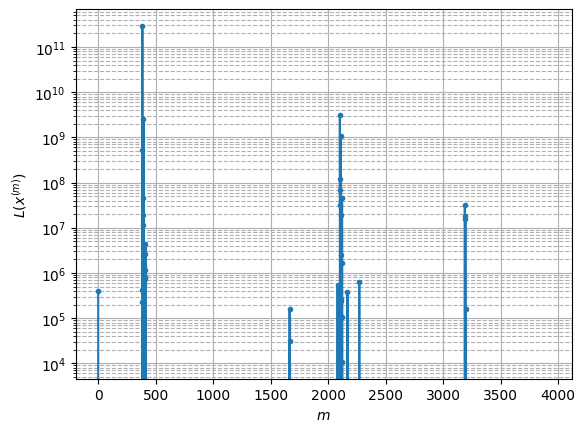

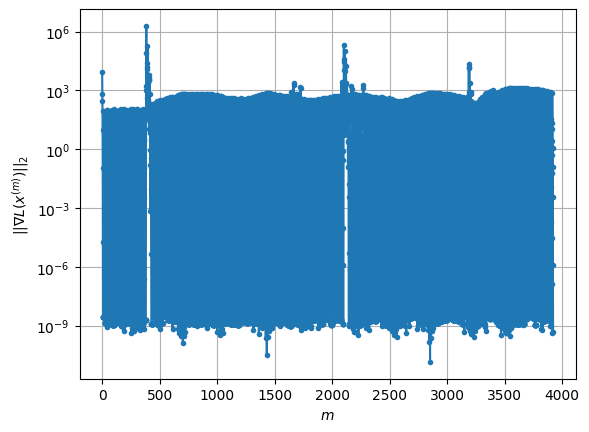

Windows:  66%|██████▋   | 262/395 [02:54<01:30,  1.47it/s]

Before applying the algorithm
Cost function: -198789.58532692905
Gradient norm: 669.8544116824495
Global relative error: 251.23864734501606
Position relative errors: 1.3807821133680158 m, 160.71240630219282 m, 112.54739220323657 m, 156.8595707914858 m

Iteration 1
Cost function: -236320.72919206615 (-18.88%)
Gradient norm: 10.818414623449874 (-98.38%)
Global relative error: 307.55294008896993 (22.41%)
Position relative errors: 0.14024473728666437 m, 102.44279150014793 m, 101.60363244738836 m, 271.5738099513778 m

Iteration 2
Cost function: -236356.90837427793 (-0.02%)
Gradient norm: 2.269485175291699 (-79.02%)
Global relative error: 101.70223839360199 (-66.93%)
Position relative errors: 0.14024473728666437 m, 33.41609705660746 m, 48.90847002363263 m, 82.55918036599063 m

Iteration 3
Cost function: -236359.0402508297 (-0.00%)
Gradient norm: 0.9768272941777113 (-56.96%)
Global relative error: 50.1312333168971 (-50.71%)
Position relative errors: 0.14024473728666437 m, 20.749902928402072 m

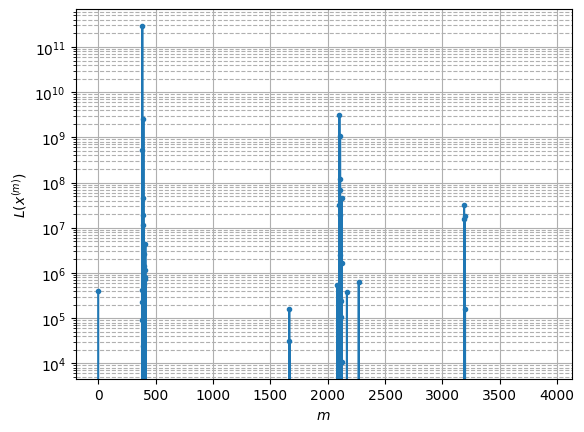

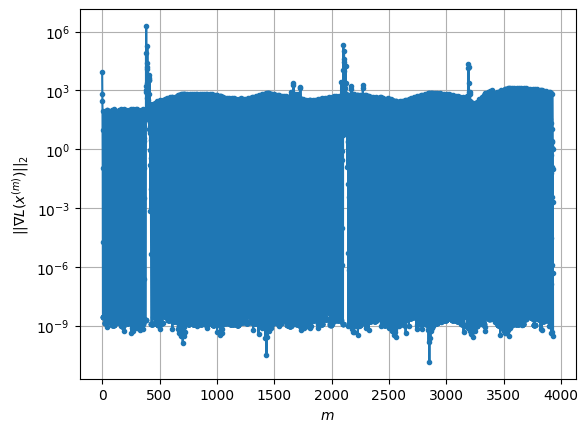

Windows:  67%|██████▋   | 263/395 [02:55<01:30,  1.47it/s]

Before applying the algorithm
Cost function: -204967.18234772043
Gradient norm: 599.9038555598054
Global relative error: 263.22911852788206
Position relative errors: 1.1004969511286724 m, 178.36615050738087 m, 110.07583282502324 m, 159.18074264217043 m

Iteration 1
Cost function: -236306.06299024733 (-15.29%)
Gradient norm: 11.443329317072825 (-98.09%)
Global relative error: 263.7986316121127 (0.22%)
Position relative errors: 0.06239893569608604 m, 112.86784735131413 m, 111.58641007541367 m, 210.66646616675538 m

Iteration 2
Cost function: -236359.24200498208 (-0.02%)
Gradient norm: 0.5915769530432233 (-94.83%)
Global relative error: 150.41785897171516 (-42.98%)
Position relative errors: 0.06239893569608604 m, 51.50100787741659 m, 51.73033659233694 m, 131.4475962781066 m

Iteration 3
Cost function: -236360.30907671002 (-0.00%)
Gradient norm: 0.6219871689496627 (5.14%)
Global relative error: 72.75145221713724 (-51.63%)
Position relative errors: 0.06239893569608604 m, 24.56861920161964 m

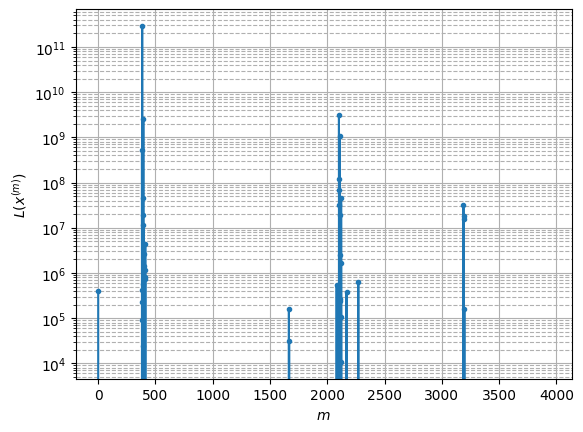

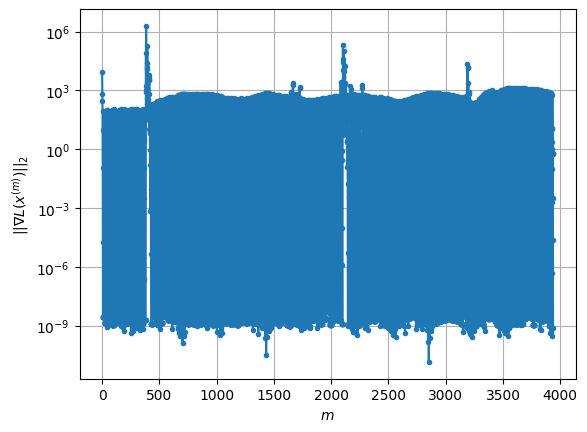

Windows:  67%|██████▋   | 264/395 [02:56<01:27,  1.49it/s]

Before applying the algorithm
Cost function: -212373.47795140758
Gradient norm: 507.5157446349062
Global relative error: 286.8565093401092
Position relative errors: 1.241707201143733 m, 125.22548811947509 m, 129.78833632149653 m, 223.02444771570126 m

Iteration 1
Cost function: -236308.37825523873 (-11.27%)
Gradient norm: 11.906717994497784 (-97.65%)
Global relative error: 349.9939122690072 (22.01%)
Position relative errors: 0.18673550976255002 m, 138.1462752624645 m, 129.13506822121937 m, 294.4769410778385 m

Iteration 2
Cost function: -236357.59331921264 (-0.02%)
Gradient norm: 1.608212241604638 (-86.49%)
Global relative error: 207.54600166878515 (-40.70%)
Position relative errors: 0.18673550976255002 m, 68.14574833741793 m, 85.56231390420876 m, 176.32861267014258 m

Iteration 3
Cost function: -236360.01285494491 (-0.00%)
Gradient norm: 1.636178023296304 (1.74%)
Global relative error: 85.24327848672918 (-58.93%)
Position relative errors: 0.18673550976255002 m, 22.70061085099422 m, 35

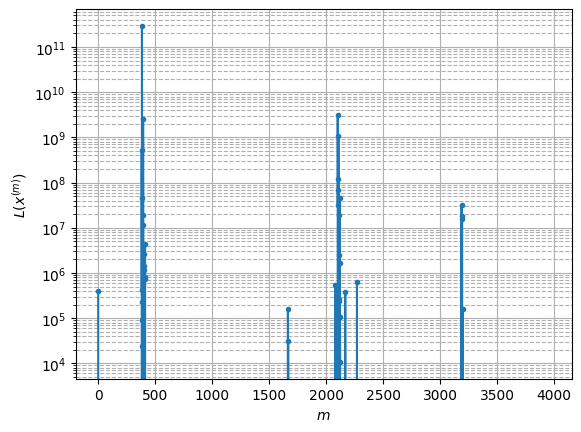

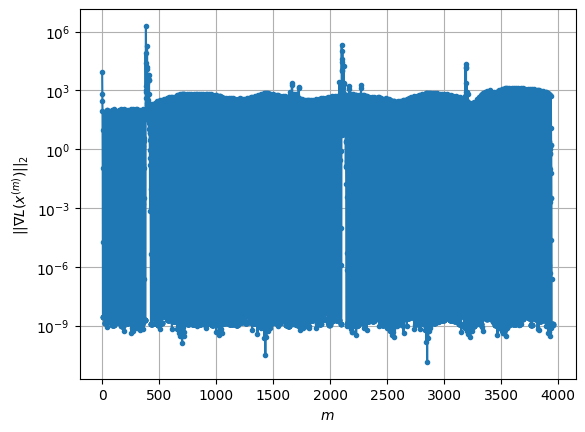

Windows:  67%|██████▋   | 265/395 [02:56<01:27,  1.49it/s]

Before applying the algorithm
Cost function: -215457.19809887366
Gradient norm: 465.7678792123771
Global relative error: 276.9142274443974
Position relative errors: 1.070579327932584 m, 134.89762455778214 m, 141.6383340022179 m, 195.9660822008055 m

Iteration 1
Cost function: -236241.7879543304 (-9.65%)
Gradient norm: 12.296573364318368 (-97.36%)
Global relative error: 397.82042990134545 (43.66%)
Position relative errors: 0.12314715391725412 m, 185.10809932255813 m, 113.8603386989491 m, 333.1861987546593 m

Iteration 2
Cost function: -236348.27027554676 (-0.05%)
Gradient norm: 2.8236313063709337 (-77.04%)
Global relative error: 154.9937183031 (-61.04%)
Position relative errors: 0.12314715391725412 m, 54.76560617693044 m, 57.984191655760114 m, 132.82600787744707 m

Iteration 3
Cost function: -236353.1679965196 (-0.00%)
Gradient norm: 2.043574939562205 (-27.63%)
Global relative error: 78.3444996160463 (-49.45%)
Position relative errors: 0.12314715391725412 m, 27.143248584647917 m, 47.082

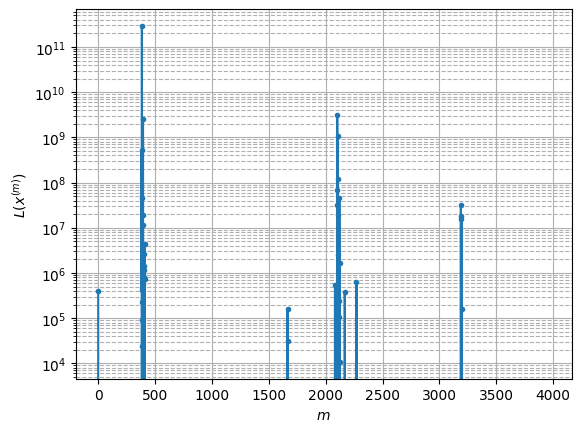

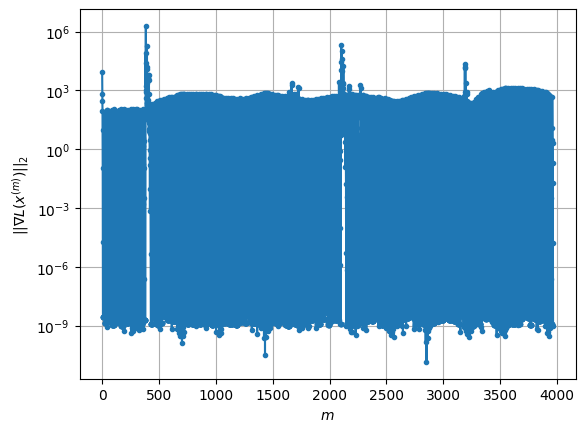

Windows:  67%|██████▋   | 266/395 [02:57<01:28,  1.46it/s]

Before applying the algorithm
Cost function: -218335.01492144394
Gradient norm: 421.6199788098784
Global relative error: 280.69743785761693
Position relative errors: 1.1510520944069764 m, 183.95712898993415 m, 87.7676745109664 m, 192.94404517362088 m

Iteration 1
Cost function: -236256.69443304383 (-8.21%)
Gradient norm: 11.243967279881169 (-97.33%)
Global relative error: 260.1849396985674 (-7.31%)
Position relative errors: 0.03430237101979531 m, 118.46908132082866 m, 146.4361109329719 m, 179.44027340442696 m

Iteration 2
Cost function: -236356.80635446787 (-0.04%)
Gradient norm: 0.8374725465131199 (-92.55%)
Global relative error: 152.00487941016183 (-41.58%)
Position relative errors: 0.03430237101979531 m, 62.25664113614138 m, 82.95142856072616 m, 111.0392776739899 m

Iteration 3
Cost function: -236358.84068736862 (-0.00%)
Gradient norm: 1.1399486898032198 (36.12%)
Global relative error: 154.7226176453128 (1.79%)
Position relative errors: 0.03430237101979531 m, 75.91776046839968 m, 12

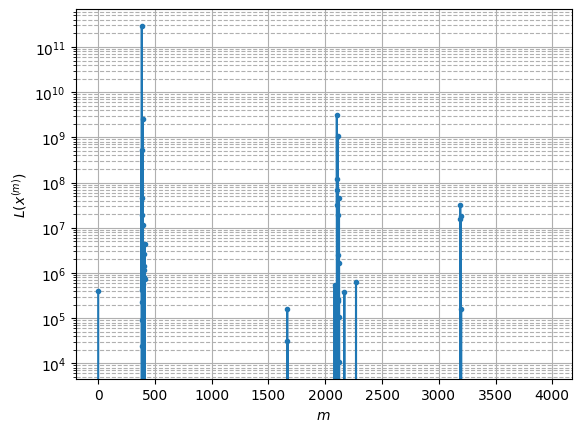

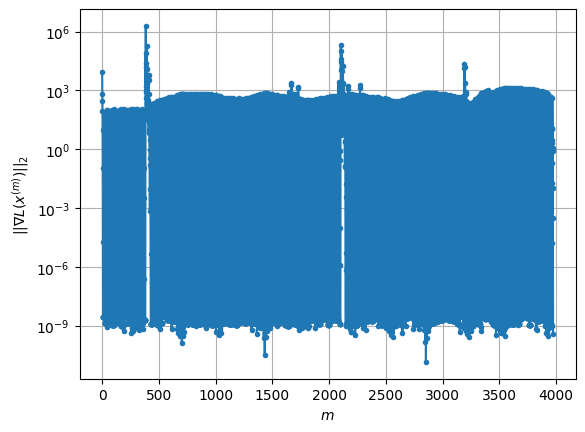

Windows:  68%|██████▊   | 267/395 [02:58<01:25,  1.50it/s]

Before applying the algorithm
Cost function: -222352.0426855133
Gradient norm: 356.2180751610102
Global relative error: 299.7999169315433
Position relative errors: 1.2300674915969956 m, 185.9280898729148 m, 90.34280318879401 m, 217.0906745976038 m

Iteration 1
Cost function: -236229.81318622874 (-6.24%)
Gradient norm: 10.956692578031603 (-96.92%)
Global relative error: 383.2567284619321 (27.84%)
Position relative errors: 0.12116214346855468 m, 142.46783396279474 m, 241.5517815416356 m, 261.1940254178986 m

Iteration 2
Cost function: -236352.75540809592 (-0.05%)
Gradient norm: 1.1945106895582736 (-89.10%)
Global relative error: 223.1525225827588 (-41.77%)
Position relative errors: 0.12116214346855468 m, 88.72942494642292 m, 138.87484505583794 m, 150.39568071289148 m

Iteration 3
Cost function: -236357.27915986237 (-0.00%)
Gradient norm: 1.9782142170584929 (65.61%)
Global relative error: 177.04739708708942 (-20.66%)
Position relative errors: 0.12116214346855468 m, 46.90305908293879 m, 70

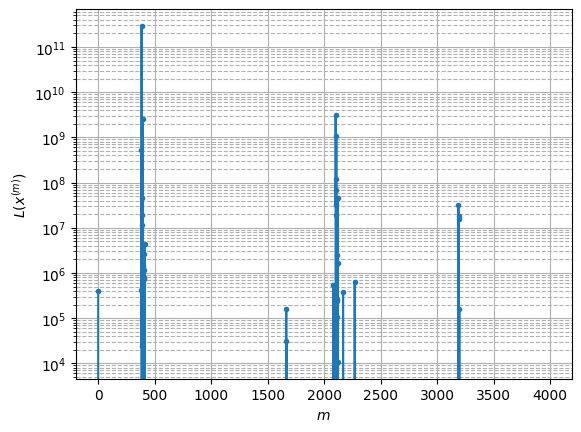

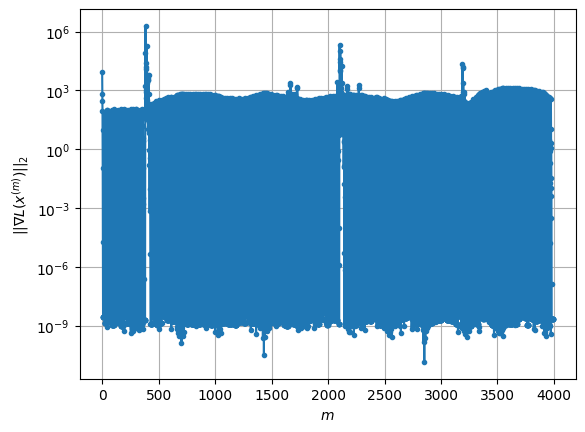

Windows:  68%|██████▊   | 268/395 [02:59<01:27,  1.45it/s]

Before applying the algorithm
Cost function: -226349.0049748071
Gradient norm: 274.18557075639256
Global relative error: 352.25588038401474
Position relative errors: 1.2165270242039607 m, 165.03651345220027 m, 83.29702475617688 m, 299.81346589479136 m

Iteration 1
Cost function: -236053.3218656916 (-4.29%)
Gradient norm: 12.962707836328612 (-95.27%)
Global relative error: 430.0164906039291 (22.08%)
Position relative errors: 0.2767072302371589 m, 242.29603576614366 m, 250.74919177774785 m, 251.61958113323692 m

Iteration 2
Cost function: -236342.91156240756 (-0.12%)
Gradient norm: 3.396425011322397 (-73.80%)
Global relative error: 129.66807234997069 (-69.85%)
Position relative errors: 0.2767072302371589 m, 66.25895184854483 m, 70.343030032694 m, 86.34915145059416 m

Iteration 3
Cost function: -236355.8195321437 (-0.01%)
Gradient norm: 2.2718342910363076 (-33.11%)
Global relative error: 82.29502323217042 (-36.53%)
Position relative errors: 0.2767072302371589 m, 18.093386673906856 m, 59.3

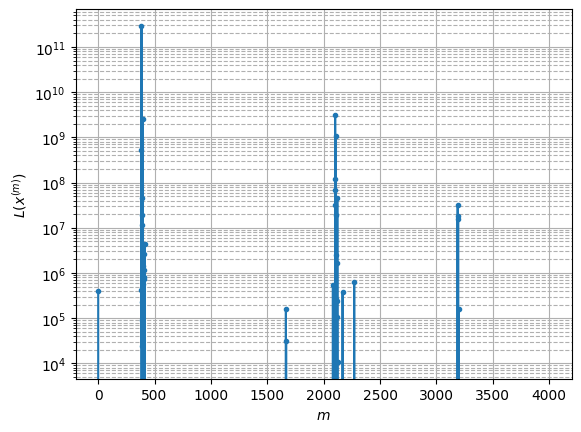

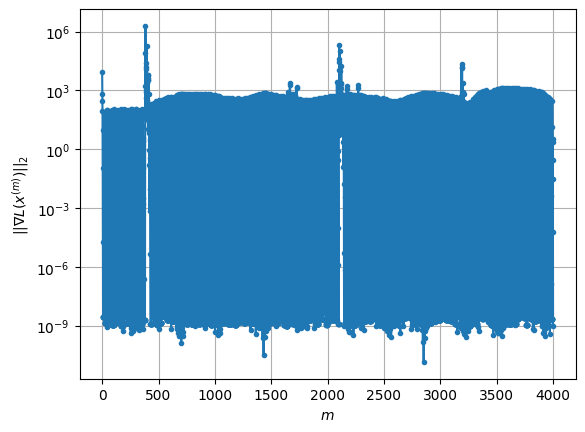

Windows:  68%|██████▊   | 269/395 [02:59<01:26,  1.46it/s]

Before applying the algorithm
Cost function: -224501.67038103778
Gradient norm: 317.8992350620743
Global relative error: 255.65672249033977
Position relative errors: 1.1644476829444064 m, 189.7255002493728 m, 139.0439312377426 m, 100.0539948283406 m

Iteration 1
Cost function: -235577.46598707204 (-4.93%)
Gradient norm: 17.006703142534608 (-94.65%)
Global relative error: 638.2964480159419 (149.67%)
Position relative errors: 0.17826807812076587 m, 364.75658832978684 m, 406.6092804595387 m, 330.1887738981827 m

Iteration 2
Cost function: -236307.7159573409 (-0.31%)
Gradient norm: 4.776986173012014 (-71.91%)
Global relative error: 249.97758758271135 (-60.84%)
Position relative errors: 0.17826807812076587 m, 145.27133647426402 m, 82.54032843116873 m, 185.88403325609906 m

Iteration 3
Cost function: -236357.39494928755 (-0.02%)
Gradient norm: 1.0734330538816808 (-77.53%)
Global relative error: 55.52632736776996 (-77.79%)
Position relative errors: 0.17826807812076587 m, 45.171925794489894 m,

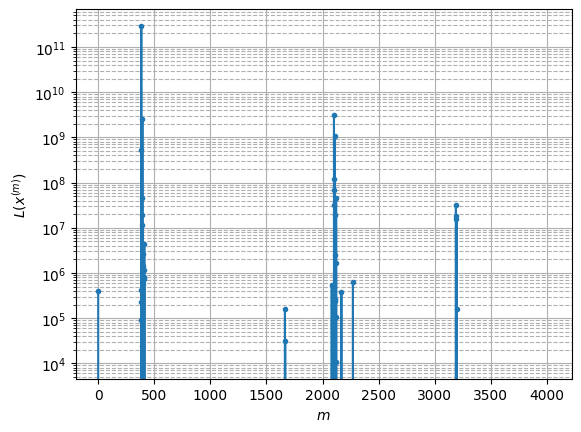

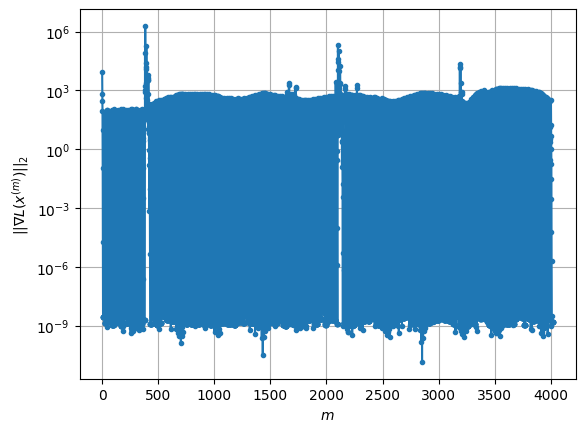

Windows:  68%|██████▊   | 270/395 [03:00<01:26,  1.44it/s]

Before applying the algorithm
Cost function: -227011.746494254
Gradient norm: 258.49919986858595
Global relative error: 292.5892531410222
Position relative errors: 1.3396165922416634 m, 135.72538458839986 m, 181.67940263132834 m, 184.82038166296184 m

Iteration 1
Cost function: -209996.83036962448 (7.50%)
Gradient norm: 157.5702852419225 (-39.04%)
Global relative error: 2603.7546958711396 (789.90%)
Position relative errors: 0.1353459375791816 m, 1639.883783761932 m, 1448.9683298068412 m, 1410.9539805688526 m

Iteration 2
Cost function: -232106.5365543598 (-10.53%)
Gradient norm: 48.508812471698946 (-69.21%)
Global relative error: 1795.3850758149174 (-31.05%)
Position relative errors: 0.1353459375791816 m, 1014.4376813931448 m, 638.0254145979397 m, 1336.8724678878023 m

Iteration 3
Cost function: -235789.29272042634 (-1.59%)
Gradient norm: 20.346077550820088 (-58.06%)
Global relative error: 1011.8779754828187 (-43.64%)
Position relative errors: 0.1353459375791816 m, 446.49017524073014 m

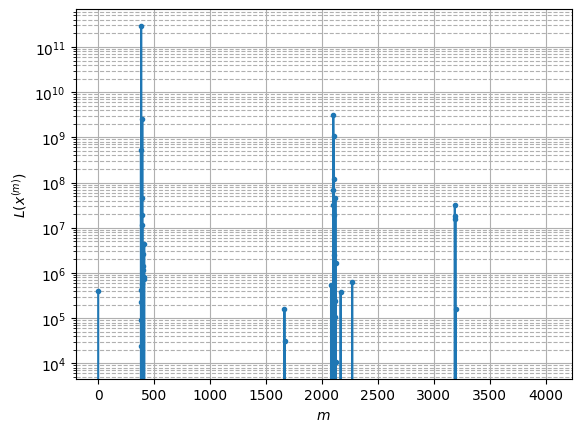

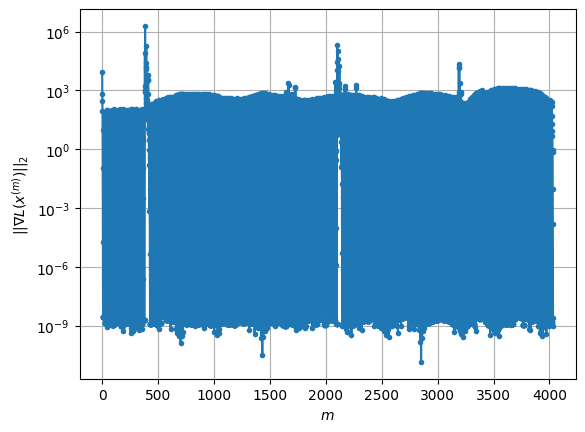

Windows:  69%|██████▊   | 271/395 [03:01<01:25,  1.45it/s]

Before applying the algorithm
Cost function: -226875.32292440537
Gradient norm: 287.64415816748334
Global relative error: 269.26338000935095
Position relative errors: 1.3127974334031371 m, 161.50754943477935 m, 143.79244548703446 m, 160.37672789091246 m

Iteration 1
Cost function: -208754.68892243132 (7.99%)
Gradient norm: 369.62416776929064 (28.50%)
Global relative error: 4559.427199501755 (1593.30%)
Position relative errors: 0.16474490859826374 m, 2723.380816346311 m, 2634.556060435148 m, 2535.8762312803183 m

Iteration 2
Cost function: -234942.1111706869 (-12.54%)
Gradient norm: 22.42655359946982 (-93.93%)
Global relative error: 4095.5903336951615 (-10.17%)
Position relative errors: 0.16474490859826374 m, 2498.27012784614 m, 2268.885791489581 m, 2320.483655227999 m

Iteration 3
Cost function: -235822.32157656737 (-0.37%)
Gradient norm: 10.719493052427657 (-52.20%)
Global relative error: 3731.508956682509 (-8.89%)
Position relative errors: 0.16474490859826374 m, 2181.998325224857 m, 

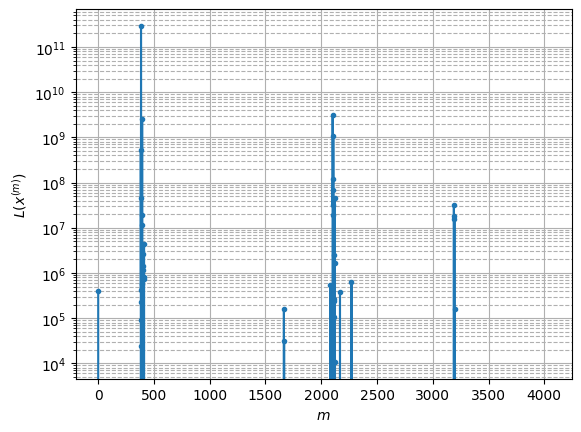

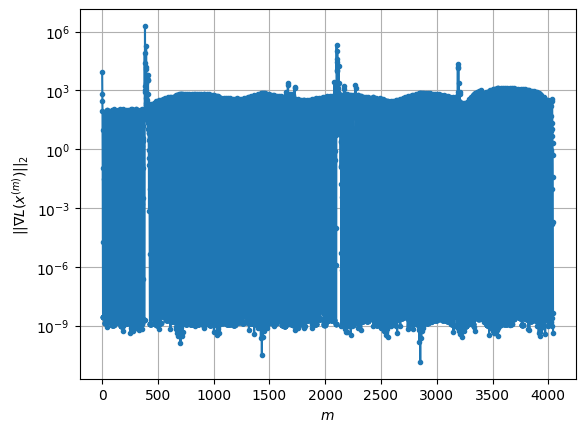

Windows:  69%|██████▉   | 272/395 [03:01<01:26,  1.42it/s]

Before applying the algorithm
Cost function: -225845.73093196948
Gradient norm: 308.7761430276329
Global relative error: 3506.665511856434
Position relative errors: 1.1200795805434127 m, 2093.817425138682 m, 2277.8237861247717 m, 1650.4939126188265 m

Iteration 1
Cost function: -234813.34529535237 (-3.97%)
Gradient norm: 94.94676726176401 (-69.25%)
Global relative error: 3257.440818257559 (-7.11%)
Position relative errors: 0.17475829011981206 m, 2064.3279673283077 m, 2369.6466789219658 m, 856.8700735042515 m

Iteration 2
Cost function: -235807.31578501107 (-0.42%)
Gradient norm: 2.3329872563700715 (-97.54%)
Global relative error: 2951.8879539350373 (-9.38%)
Position relative errors: 0.17475829011981206 m, 1885.615852830812 m, 2140.977475984313 m, 757.8204097965316 m

Iteration 3
Cost function: -235612.04786604433 (0.08%)
Gradient norm: 60.01202575426141 (2472.33%)
Global relative error: 3183.8948588404537 (7.86%)
Position relative errors: 0.17475829011981206 m, 1886.4697244854224 m, 21

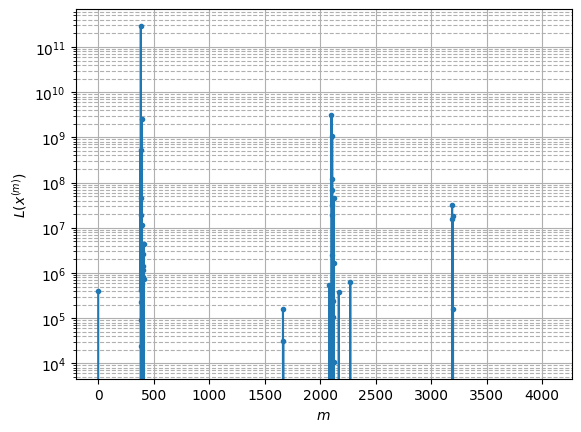

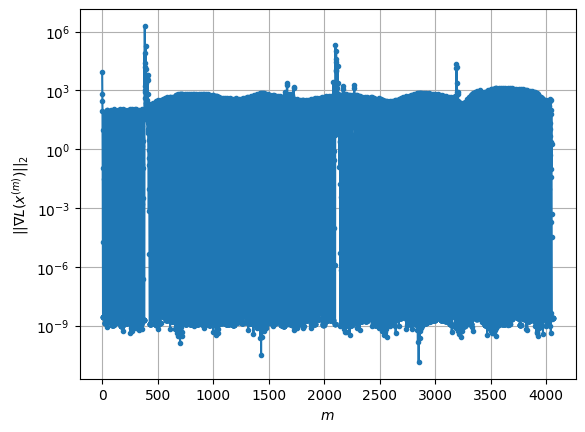

Windows:  69%|██████▉   | 273/395 [03:02<01:22,  1.47it/s]

Before applying the algorithm
Cost function: -222932.05674582816
Gradient norm: 377.8504170193182
Global relative error: 3376.6444225230352
Position relative errors: 1.3008528118543414 m, 1962.7205300729158 m, 2239.852443945902 m, 1591.3818616943934 m

Iteration 1
Cost function: -235797.01005092092 (-5.77%)
Gradient norm: 35.408947103542786 (-90.63%)
Global relative error: 3025.7309922564646 (-10.39%)
Position relative errors: 0.02262814304582874 m, 1635.6208688565316 m, 1961.8102020893202 m, 1622.0586786367155 m

Iteration 2
Cost function: -235957.59721571233 (-0.07%)
Gradient norm: 2.5230969326759 (-92.87%)
Global relative error: 3324.794284441499 (9.88%)
Position relative errors: 0.02262814304582874 m, 1808.4562188532284 m, 2177.135813047887 m, 1744.6501096180837 m

Iteration 3
Cost function: -235976.97638910855 (-0.01%)
Gradient norm: 11.267361977915751 (346.57%)
Global relative error: 3082.6830548403386 (-7.28%)
Position relative errors: 0.02262814304582874 m, 1761.6068424411715 m

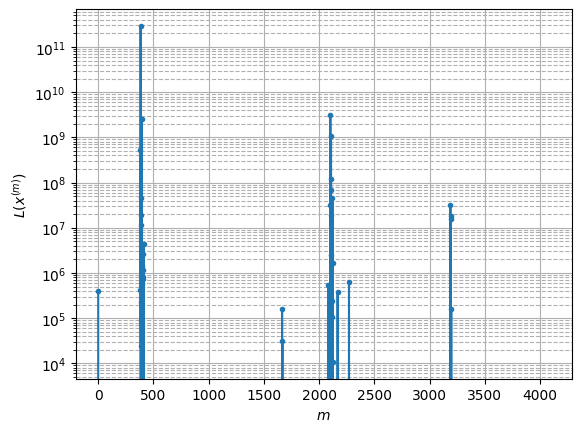

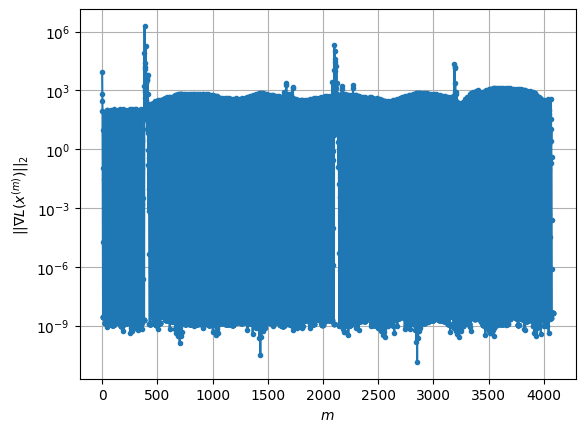

Windows:  69%|██████▉   | 274/395 [03:03<01:25,  1.41it/s]

Before applying the algorithm
Cost function: -219773.50395880084
Gradient norm: 435.2540525095121
Global relative error: 3152.983947074673
Position relative errors: 1.2364591974155295 m, 1838.4471494855195 m, 2098.1563791479425 m, 1469.401022868859 m

Iteration 1
Cost function: -235669.69551927192 (-7.23%)
Gradient norm: 38.480070696883104 (-91.16%)
Global relative error: 3075.3588087153316 (-2.46%)
Position relative errors: 0.19877958766491424 m, 1777.8021544463584 m, 2045.1068480546774 m, 1454.2250443637863 m

Iteration 2
Cost function: -235992.5816433116 (-0.14%)
Gradient norm: 2.41798249217432 (-93.72%)
Global relative error: 2836.595722795191 (-7.76%)
Position relative errors: 0.19877958766491424 m, 1669.2329202702026 m, 1861.0172699884529 m, 1340.3479663494227 m

Iteration 3
Cost function: -236001.90707221057 (-0.00%)
Gradient norm: 5.761331257430494 (138.27%)
Global relative error: 2894.176749094825 (2.03%)
Position relative errors: 0.19877958766491424 m, 1647.5401937871736 m, 1

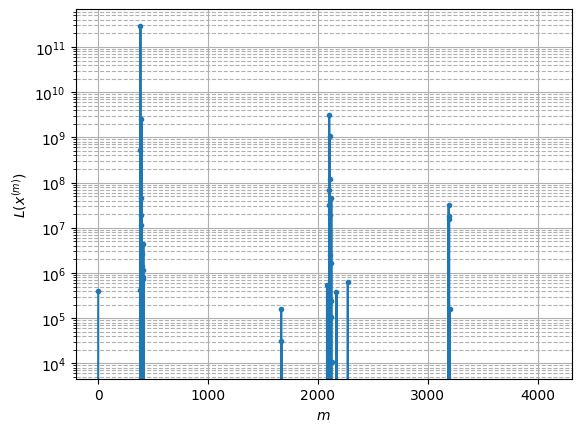

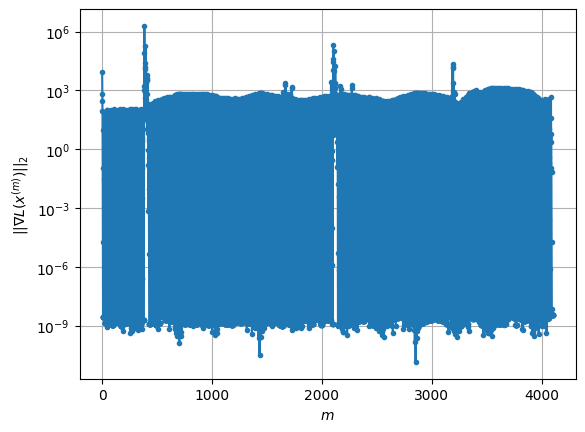

Windows:  70%|██████▉   | 275/395 [03:03<01:23,  1.44it/s]

Before applying the algorithm
Cost function: -215223.5367943309
Gradient norm: 502.8714524251787
Global relative error: 3012.111646382941
Position relative errors: 1.2961254229300403 m, 1716.136459962123 m, 1969.47545431895 m, 1499.6126330066022 m

Iteration 1
Cost function: -235648.61064976465 (-9.49%)
Gradient norm: 25.274484364516006 (-94.97%)
Global relative error: 3163.8855098733084 (5.04%)
Position relative errors: 0.08209677053042883 m, 1811.5359494376837 m, 2049.5154716746692 m, 1589.961138274135 m

Iteration 2
Cost function: -235763.61457611973 (-0.05%)
Gradient norm: 30.57511729035147 (20.97%)
Global relative error: 3249.3753102503274 (2.70%)
Position relative errors: 0.08209677053042883 m, 1426.3239364812546 m, 2386.5928230139466 m, 1681.7240256944606 m

Iteration 3
Cost function: -235960.3164364451 (-0.08%)
Gradient norm: 1.6487621341799166 (-94.61%)
Global relative error: 3072.6039849512185 (-5.44%)
Position relative errors: 0.08209677053042883 m, 1397.014338082125 m, 2249

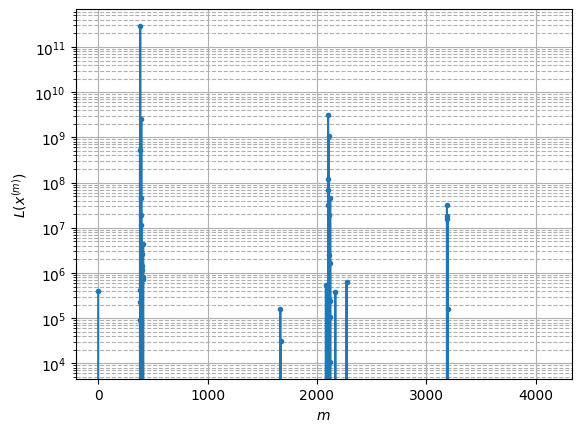

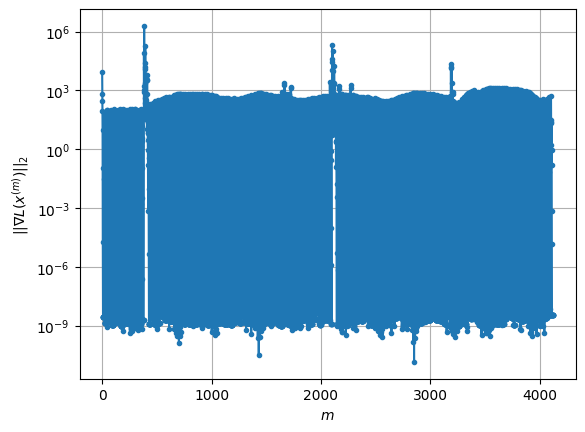

Windows:  70%|██████▉   | 276/395 [03:04<01:22,  1.44it/s]

Before applying the algorithm
Cost function: -208796.02578731687
Gradient norm: 583.2652447402702
Global relative error: 2796.527232193378
Position relative errors: 1.2797462010421825 m, 1654.5700589107716 m, 1819.5887496179785 m, 1331.1793540025656 m

Iteration 1
Cost function: -235397.03701976102 (-12.74%)
Gradient norm: 32.665718446778804 (-94.40%)
Global relative error: 2875.4153574880793 (2.82%)
Position relative errors: 0.18676813816010207 m, 1692.3055259902435 m, 1879.821904280071 m, 1367.6132148900424 m

Iteration 2
Cost function: -236090.82043049426 (-0.29%)
Gradient norm: 6.926300465810574 (-78.80%)
Global relative error: 2522.2551374282543 (-12.28%)
Position relative errors: 0.18676813816010207 m, 1408.4487206282029 m, 1710.0576819895975 m, 1205.7058996638486 m

Iteration 3
Cost function: -236114.45285708545 (-0.01%)
Gradient norm: 3.3390279755370185 (-51.79%)
Global relative error: 2374.780922581749 (-5.85%)
Position relative errors: 0.18676813816010207 m, 1334.245297516849

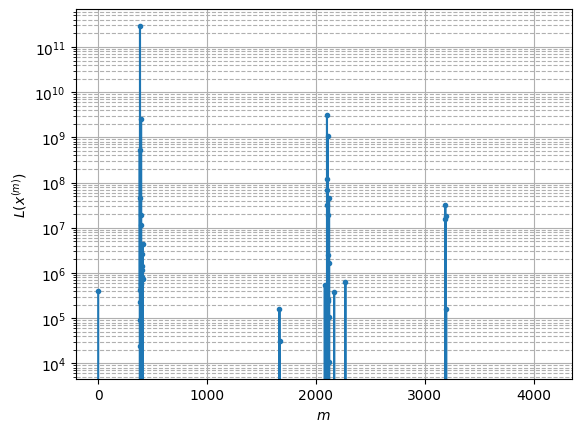

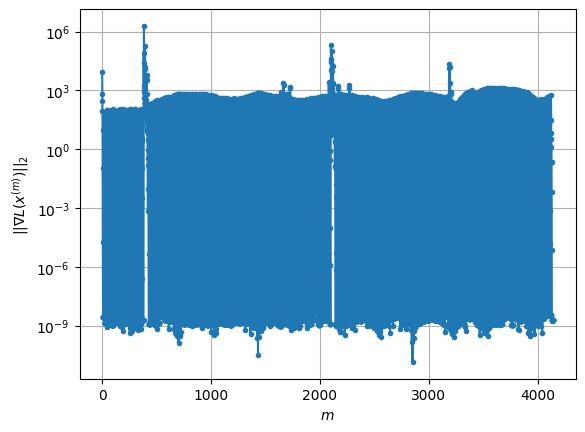

Windows:  70%|███████   | 277/395 [03:05<01:22,  1.43it/s]

Before applying the algorithm
Cost function: -203641.17295714506
Gradient norm: 652.3910468373728
Global relative error: 2409.403293329854
Position relative errors: 1.4103273336808462 m, 1369.4921242631576 m, 1658.8136422285693 m, 1085.3715754787522 m

Iteration 1
Cost function: -234179.69342781254 (-15.00%)
Gradient norm: 36.08925730977938 (-94.47%)
Global relative error: 3533.649579739294 (46.66%)
Position relative errors: 0.18386296426725754 m, 2154.893878545894 m, 2221.1337149983533 m, 1705.7717622598998 m

Iteration 2
Cost function: -235847.7443275923 (-0.71%)
Gradient norm: 14.114969762748439 (-60.89%)
Global relative error: 2984.662354137677 (-15.54%)
Position relative errors: 0.18386296426725754 m, 1789.0668780597202 m, 1766.4695180616652 m, 1608.4200558385867 m

Iteration 3
Cost function: -236119.47551210283 (-0.12%)
Gradient norm: 5.790074283877922 (-58.98%)
Global relative error: 2549.0939024534864 (-14.59%)
Position relative errors: 0.18386296426725754 m, 1492.1733816377953

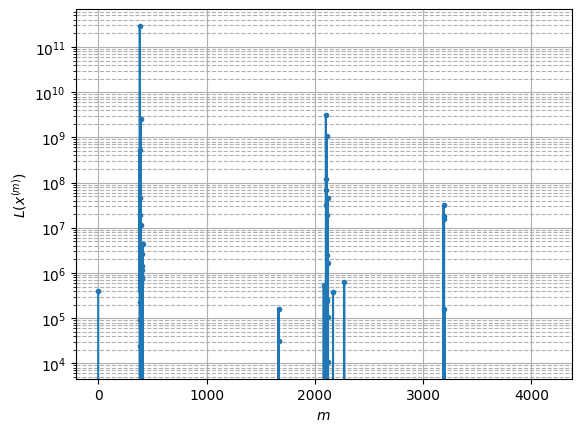

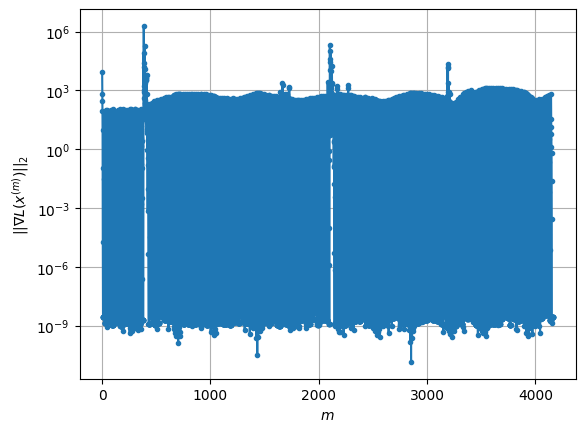

Windows:  70%|███████   | 278/395 [03:06<01:22,  1.42it/s]

Before applying the algorithm
Cost function: -192613.59610971072
Gradient norm: 768.6746764669995
Global relative error: 2267.2676360943306
Position relative errors: 1.3621683655522472 m, 1313.0462816667973 m, 1500.2960437054808 m, 1079.584258587735 m

Iteration 1
Cost function: -235038.59018478094 (-22.03%)
Gradient norm: 20.153511800547783 (-97.38%)
Global relative error: 3045.129075657299 (34.31%)
Position relative errors: 0.11858486961729042 m, 1850.5017987985523 m, 1886.6210909019453 m, 1512.9756359994742 m

Iteration 2
Cost function: -236013.52746788034 (-0.41%)
Gradient norm: 16.27808610250105 (-19.23%)
Global relative error: 2430.688553761019 (-20.18%)
Position relative errors: 0.11858486961729042 m, 1568.4204044081196 m, 1386.2919909741584 m, 1235.5076009030745 m

Iteration 3
Cost function: -236160.35877126225 (-0.06%)
Gradient norm: 3.23122182154044 (-80.15%)
Global relative error: 2164.429804272936 (-10.95%)
Position relative errors: 0.11858486961729042 m, 1322.6756786748836

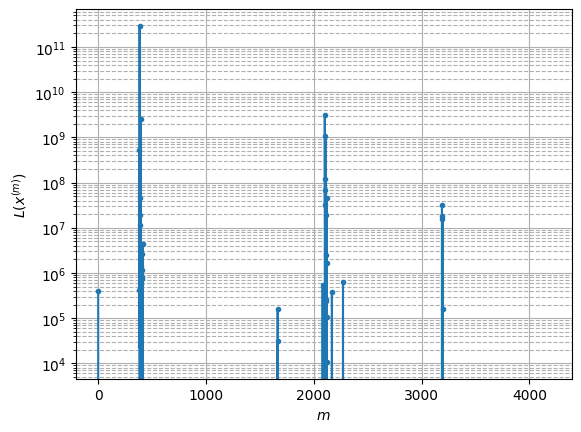

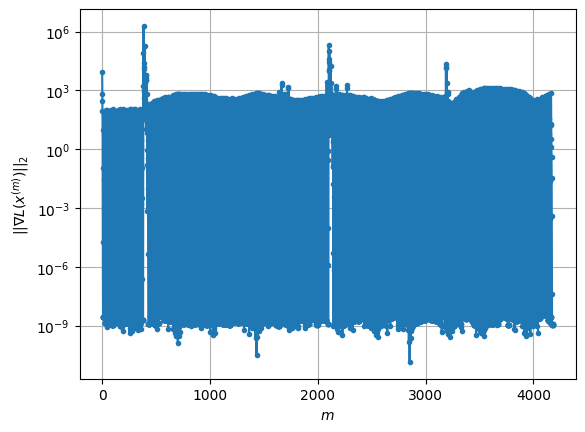

Windows:  71%|███████   | 279/395 [03:06<01:17,  1.49it/s]

Before applying the algorithm
Cost function: -183886.2650582481
Gradient norm: 836.0996008311632
Global relative error: 1963.648681689439
Position relative errors: 1.1925842834035458 m, 1129.9882307982405 m, 1251.434047115364 m, 1006.4462317951558 m

Iteration 1
Cost function: -232791.7165643399 (-26.60%)
Gradient norm: 73.96304122572043 (-91.15%)
Global relative error: 3571.589037847896 (81.89%)
Position relative errors: 0.17831966812259373 m, 2265.554628078527 m, 1976.348717045132 m, 1928.0913022926927 m

Iteration 2
Cost function: -235579.91405292286 (-1.20%)
Gradient norm: 24.81485909269505 (-66.45%)
Global relative error: 3004.2354611569194 (-15.89%)
Position relative errors: 0.17831966812259373 m, 1896.047906524828 m, 1393.2074411023436 m, 1867.9898038180102 m

Iteration 3
Cost function: -236102.10466676255 (-0.22%)
Gradient norm: 15.078895840821225 (-39.23%)
Global relative error: 2398.501252290677 (-20.16%)
Position relative errors: 0.17831966812259373 m, 1467.9939543405314 m, 

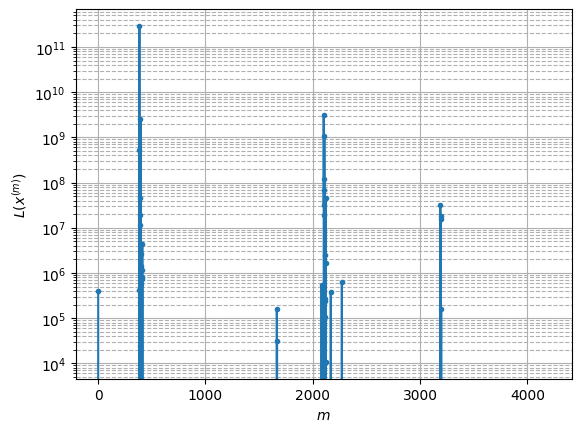

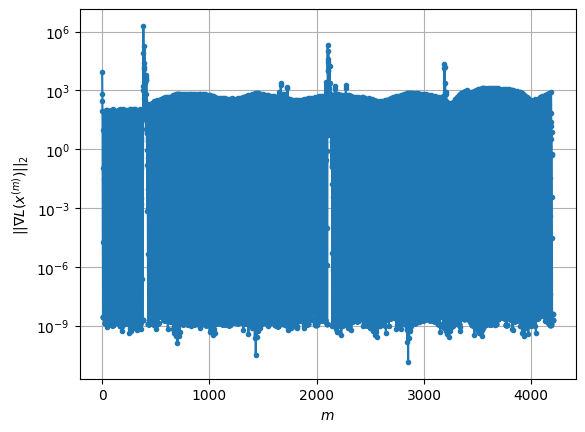

Windows:  71%|███████   | 280/395 [03:07<01:20,  1.42it/s]

Before applying the algorithm
Cost function: -172443.7511378973
Gradient norm: 924.6071988009974
Global relative error: 1735.87407730073
Position relative errors: 1.3387799313275093 m, 946.996448641459 m, 1228.6072462887132 m, 779.0754097333731 m

Iteration 1
Cost function: -235210.5195670085 (-36.40%)
Gradient norm: 28.481005344734037 (-96.92%)
Global relative error: 2691.601946773883 (55.06%)
Position relative errors: 0.2696360347452585 m, 1637.524481887566 m, 1657.2484249397196 m, 1347.8656127144056 m

Iteration 2
Cost function: -56515.79424077255 (75.97%)
Gradient norm: 1111.1536327758058 (3801.38%)
Global relative error: 3167.6990518870375 (17.69%)
Position relative errors: 0.2696360347452585 m, 2372.4060219251264 m, 1881.7520481744095 m, 930.0514074276775 m

Iteration 3
Cost function: -218916.517522672 (-287.35%)
Gradient norm: 92.59124352625653 (-91.67%)
Global relative error: 2296.7632126298963 (-27.49%)
Position relative errors: 0.2696360347452585 m, 1572.1725753382839 m, 1204

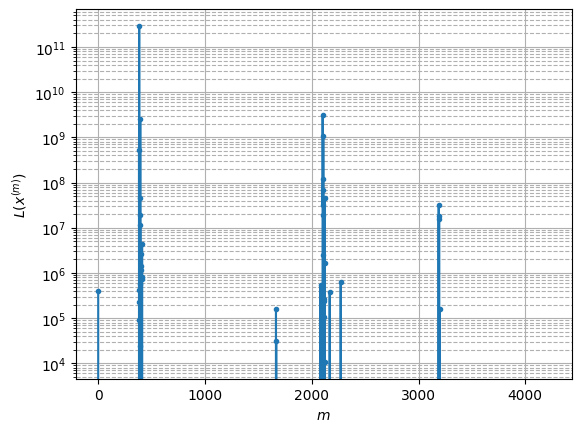

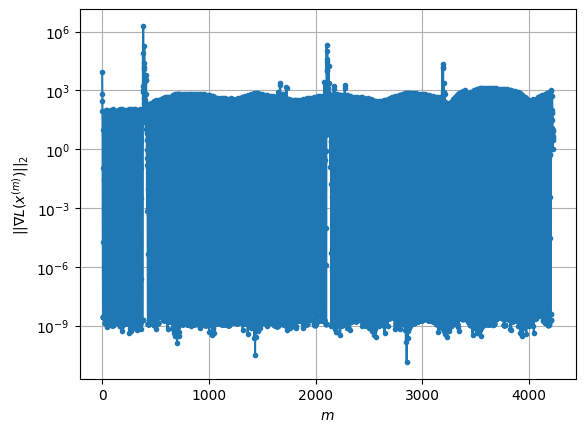

Windows:  71%|███████   | 281/395 [03:07<01:15,  1.51it/s]

Before applying the algorithm
Cost function: -163143.26392942734
Gradient norm: 999.7664465975886
Global relative error: 1639.0841920333162
Position relative errors: 1.4969401768255368 m, 914.4337165136873 m, 1163.4765349771606 m, 704.7746504581157 m

Iteration 1
Cost function: -236009.04788881427 (-44.66%)
Gradient norm: 4.361740629869734 (-99.56%)
Global relative error: 1673.86276793728 (2.12%)
Position relative errors: 0.07711471615544799 m, 930.7377527844789 m, 1171.109760239679 m, 751.0159482176607 m

Iteration 2
Cost function: -236258.74509390994 (-0.11%)
Gradient norm: 12.134921095951547 (178.21%)
Global relative error: 1226.6445718909122 (-26.72%)
Position relative errors: 0.07711471615544799 m, 704.1396229074927 m, 814.7290126309089 m, 587.4011889298115 m

Iteration 3
Cost function: -236304.68465661138 (-0.02%)
Gradient norm: 0.9968686945742701 (-91.79%)
Global relative error: 1011.1412376783992 (-17.57%)
Position relative errors: 0.07711471615544799 m, 562.7828677745724 m, 68

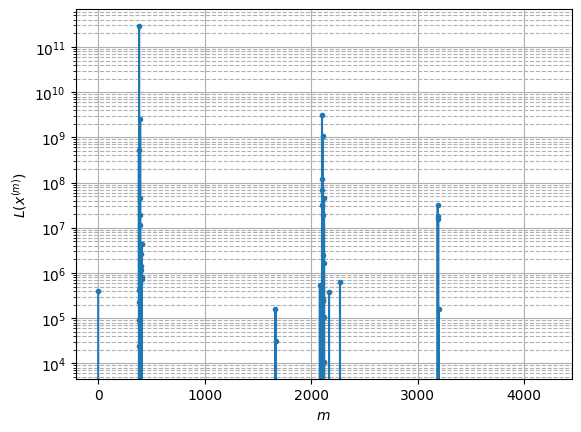

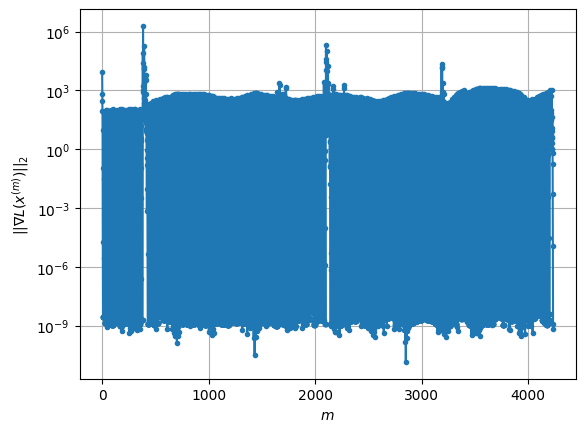

Windows:  71%|███████▏  | 282/395 [03:08<01:14,  1.51it/s]

Before applying the algorithm
Cost function: -150342.6297990933
Gradient norm: 1089.4037083737799
Global relative error: 283.3562951935211
Position relative errors: 1.2822481018273255 m, 99.19998863177564 m, 97.96704149777078 m, 246.6377303448103 m

Iteration 1
Cost function: -236037.67135029292 (-57.00%)
Gradient norm: 11.763976736832616 (-98.92%)
Global relative error: 883.6554390998832 (211.85%)
Position relative errors: 0.11160004132175463 m, 508.07816656646116 m, 430.6508597330686 m, 580.7086527633948 m

Iteration 2
Cost function: -228962.21024775103 (3.00%)
Gradient norm: 182.01504851392306 (1447.22%)
Global relative error: 1626.5737264558038 (84.07%)
Position relative errors: 0.11160004132175463 m, 774.3242521511913 m, 1381.2193416917225 m, 371.9897323009612 m

Iteration 3
Cost function: -235439.92757946457 (-2.83%)
Gradient norm: 13.76034217816327 (-92.44%)
Global relative error: 1067.5955007783637 (-34.37%)
Position relative errors: 0.11160004132175463 m, 383.7114382373672 m, 

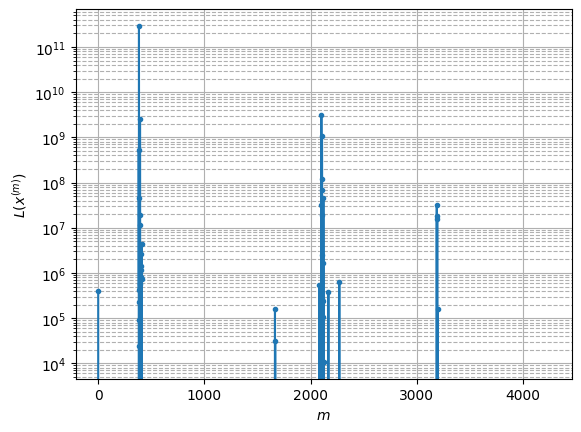

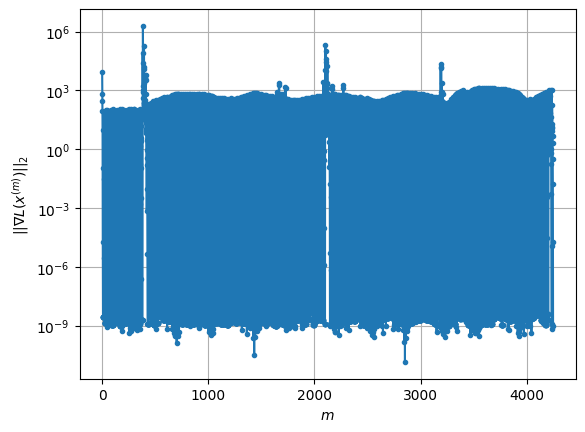

Windows:  72%|███████▏  | 283/395 [03:09<01:13,  1.52it/s]

Before applying the algorithm
Cost function: -138796.1718247559
Gradient norm: 1159.1892374033494
Global relative error: 335.8574227633484
Position relative errors: 1.2573222127956767 m, 101.06231380664363 m, 93.96478306636347 m, 306.16146222048275 m

Iteration 1
Cost function: -236250.81068787686 (-70.21%)
Gradient norm: 5.251193944516432 (-99.55%)
Global relative error: 639.3544040365286 (90.36%)
Position relative errors: 0.2975058965065516 m, 389.85103865591793 m, 214.5419789075142 m, 459.0654174603544 m

Iteration 2
Cost function: -186178.74178073063 (21.19%)
Gradient norm: 442.21804730990465 (8321.29%)
Global relative error: 3146.4943297559666 (392.14%)
Position relative errors: 0.2975058965065516 m, 2596.829107751814 m, 1675.1894764543663 m, 592.1355139642535 m

Iteration 3
Cost function: -228329.8333818466 (-22.64%)
Gradient norm: 47.69688993823303 (-89.21%)
Global relative error: 2176.1948262164633 (-30.84%)
Position relative errors: 0.2975058965065516 m, 1816.2989869653559 m, 

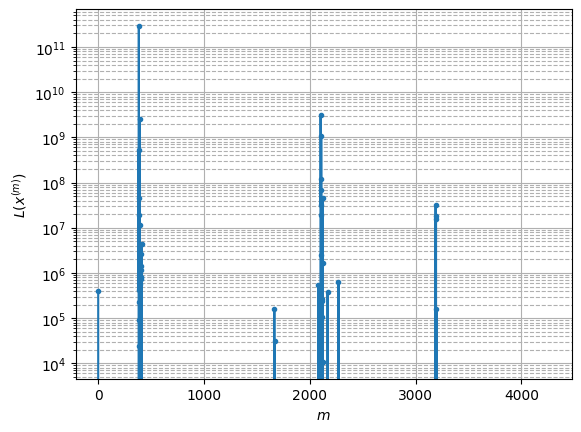

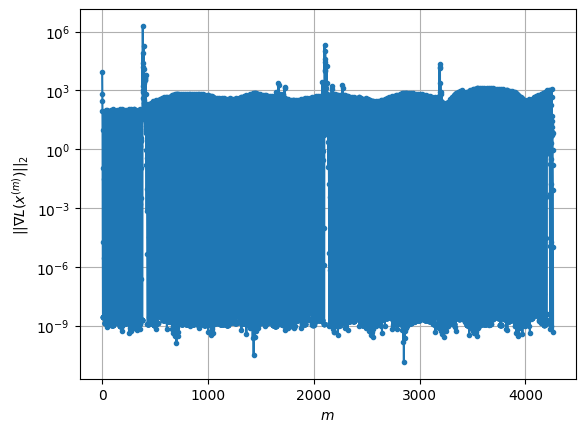

Windows:  72%|███████▏  | 284/395 [03:09<01:15,  1.48it/s]

Before applying the algorithm
Cost function: -126460.65339244917
Gradient norm: 1225.036954885082
Global relative error: 308.94208162864703
Position relative errors: 1.3773154616497174 m, 79.8165566558711 m, 119.07658985088572 m, 273.62855063372103 m

Iteration 1
Cost function: -236339.58024861672 (-86.89%)
Gradient norm: 0.3260076160765752 (-99.97%)
Global relative error: 218.8174433135575 (-29.17%)
Position relative errors: 0.1407622230234498 m, 39.39497928810254 m, 57.02217464696634 m, 207.50120186486973 m

Iteration 2
Cost function: -236264.54556486852 (0.03%)
Gradient norm: 21.508223056820523 (6497.46%)
Global relative error: 563.171453908652 (157.37%)
Position relative errors: 0.1407622230234498 m, 2.4061119588167172 m, 551.2935898645962 m, 114.93843120860565 m

Iteration 3
Cost function: -236349.04301878304 (-0.04%)
Gradient norm: 1.9197301219384872 (-91.07%)
Global relative error: 475.9363119617462 (-15.49%)
Position relative errors: 0.1407622230234498 m, 43.160060117949456 m, 

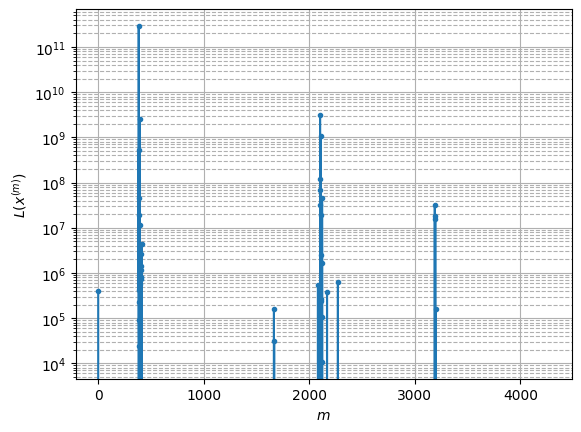

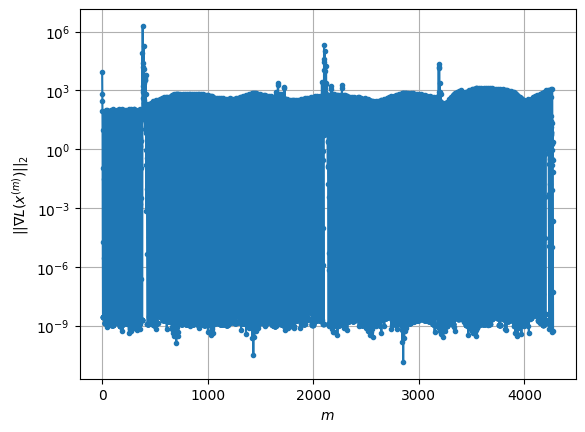

Windows:  72%|███████▏  | 285/395 [03:10<01:10,  1.56it/s]

Before applying the algorithm
Cost function: -113435.8455904326
Gradient norm: 1295.0773639441288
Global relative error: 403.4186591522866
Position relative errors: 1.136828788093425 m, 131.49768452490127 m, 278.67094720216414 m, 260.3370301460276 m

Iteration 1
Cost function: -236336.88240984574 (-108.34%)
Gradient norm: 0.6643731111093738 (-99.95%)
Global relative error: 357.2790317654557 (-11.44%)
Position relative errors: 0.14417910929971026 m, 188.45580494778295 m, 287.84896159970435 m, 96.20215996421936 m

Iteration 2
Cost function: -236355.10924562495 (-0.01%)
Gradient norm: 5.891496226067178 (786.78%)
Global relative error: 132.3117113352254 (-62.97%)
Position relative errors: 0.14417910929971026 m, 83.17480659479207 m, 99.79150814307334 m, 24.681158035443573 m

Iteration 3
Cost function: -236360.5465380355 (-0.00%)
Gradient norm: 1.0536466077078186 (-82.12%)
Global relative error: 96.87728579311747 (-26.78%)
Position relative errors: 0.14417910929971026 m, 58.35785142146385 m,

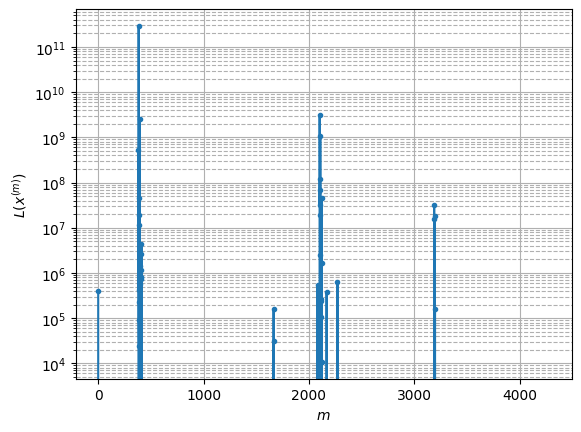

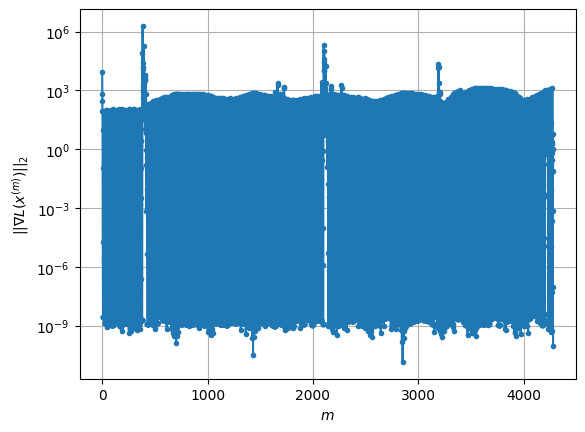

Windows:  72%|███████▏  | 286/395 [03:11<01:12,  1.51it/s]

Before applying the algorithm
Cost function: -105716.24448183604
Gradient norm: 1329.0963584135204
Global relative error: 324.61331058108635
Position relative errors: 1.3226493627663813 m, 86.17605599893368 m, 158.1952245175423 m, 269.9985078075482 m

Iteration 1
Cost function: -236201.96550230257 (-123.43%)
Gradient norm: 16.356011283029773 (-98.77%)
Global relative error: 941.9624083709381 (190.18%)
Position relative errors: 0.15520038237492467 m, 587.2230593568145 m, 430.02709475702096 m, 597.928185430485 m

Iteration 2
Cost function: -236310.14400119748 (-0.05%)
Gradient norm: 8.039409329988912 (-50.85%)
Global relative error: 603.1015335304953 (-35.97%)
Position relative errors: 0.15520038237492467 m, 375.0449885447169 m, 184.34733742516173 m, 434.8194283979696 m

Iteration 3
Cost function: -236347.89174209078 (-0.02%)
Gradient norm: 4.657045570837761 (-42.07%)
Global relative error: 234.16500719061105 (-61.17%)
Position relative errors: 0.15520038237492467 m, 157.2342358451249 m,

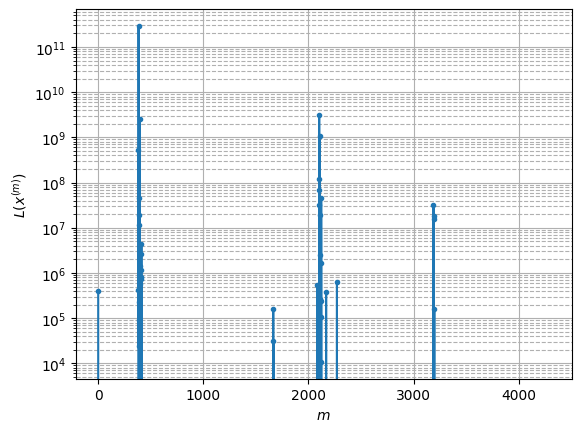

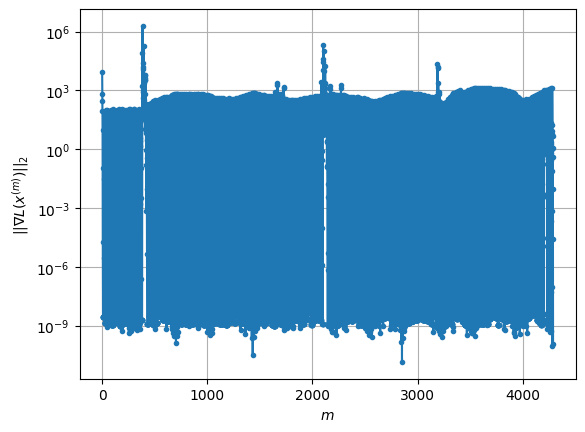

Windows:  73%|███████▎  | 287/395 [03:11<01:10,  1.54it/s]

Before applying the algorithm
Cost function: -100594.81495034571
Gradient norm: 1357.9419488957462
Global relative error: 260.1469845272054
Position relative errors: 1.428434323098437 m, 86.21024961801233 m, 126.95423738207116 m, 210.00978098673906 m

Iteration 1
Cost function: -236162.7465872064 (-134.77%)
Gradient norm: 17.288628991246615 (-98.73%)
Global relative error: 767.7761558630086 (195.13%)
Position relative errors: 0.17445363721769722 m, 489.00897997988335 m, 342.7979525160294 m, 482.51347839427075 m

Iteration 2
Cost function: -236311.1744120055 (-0.06%)
Gradient norm: 6.419207872690356 (-62.87%)
Global relative error: 454.8926251425248 (-40.75%)
Position relative errors: 0.17445363721769722 m, 278.40302066579267 m, 19.740779249418487 m, 359.17768610863465 m

Iteration 3
Cost function: -236353.97352095103 (-0.02%)
Gradient norm: 5.701525171762593 (-11.18%)
Global relative error: 167.96999924348705 (-63.07%)
Position relative errors: 0.17445363721769722 m, 96.30949507091168 

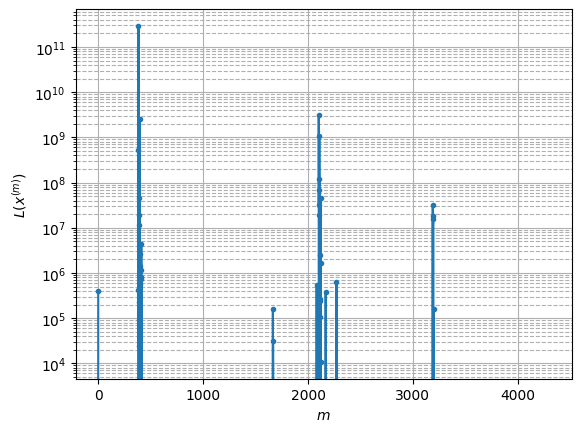

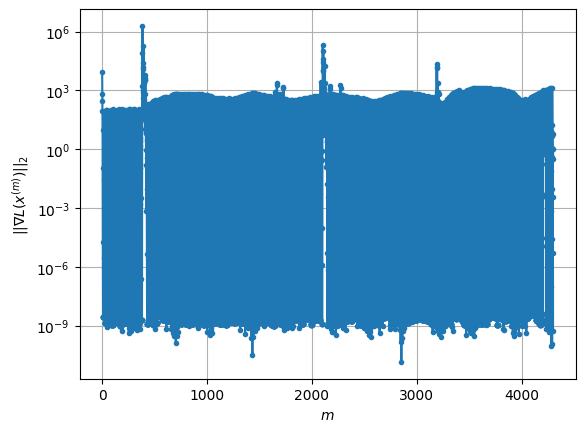

Windows:  73%|███████▎  | 288/395 [03:12<01:10,  1.51it/s]

Before applying the algorithm
Cost function: -92329.7363766077
Gradient norm: 1394.739747742549
Global relative error: 277.03718793920825
Position relative errors: 1.1741419053647624 m, 100.39972736280139 m, 140.4314757720303 m, 216.6251669251495 m

Iteration 1
Cost function: -236313.27039577105 (-155.94%)
Gradient norm: 4.038428942831096 (-99.71%)
Global relative error: 435.00865715549463 (57.02%)
Position relative errors: 0.14084855583544464 m, 295.88652884630244 m, 163.17016745239022 m, 273.9315848128688 m

Iteration 2
Cost function: -236351.05381658959 (-0.02%)
Gradient norm: 3.86225263272731 (-4.36%)
Global relative error: 170.68868689149718 (-60.76%)
Position relative errors: 0.14084855583544464 m, 94.56427103887239 m, 105.90880352155587 m, 94.63019956272299 m

Iteration 3
Cost function: -236354.68031028722 (-0.00%)
Gradient norm: 0.4376181451669034 (-88.67%)
Global relative error: 135.65817989277545 (-20.52%)
Position relative errors: 0.14084855583544464 m, 51.65779460037389 m, 

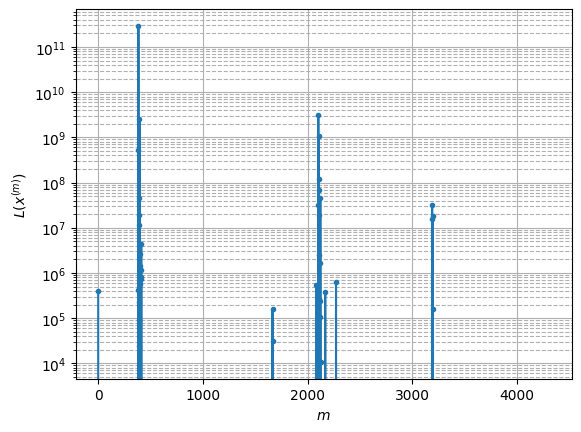

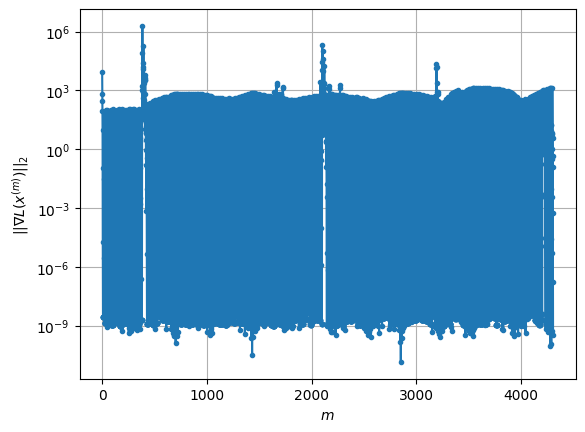

Windows:  73%|███████▎  | 289/395 [03:13<01:06,  1.59it/s]

Before applying the algorithm
Cost function: -89222.82665767171
Gradient norm: 1402.0669548802348
Global relative error: 320.41660291016416
Position relative errors: 1.4279978932387145 m, 105.01559719842571 m, 214.3780247959161 m, 213.6771859720595 m

Iteration 1
Cost function: 126006.44484084622 (241.23%)
Gradient norm: 1402.5815285234114 (0.04%)
Global relative error: 7050.393688348268 (2100.38%)
Position relative errors: 0.10393000970442626 m, 4841.409663164522 m, 2962.0615398317855 m, 4182.699421462047 m

Iteration 2
Cost function: -201849.21263291332 (-260.19%)
Gradient norm: 254.05001998345384 (-81.89%)
Global relative error: 5733.443464250296 (-18.68%)
Position relative errors: 0.10393000970442626 m, 3984.6873463556744 m, 974.8443561890406 m, 4005.533494140959 m

Iteration 3
Cost function: -229642.14420620634 (-13.77%)
Gradient norm: 76.20535170929196 (-70.00%)
Global relative error: 4218.940281062828 (-26.42%)
Position relative errors: 0.10393000970442626 m, 2929.5255368391354 

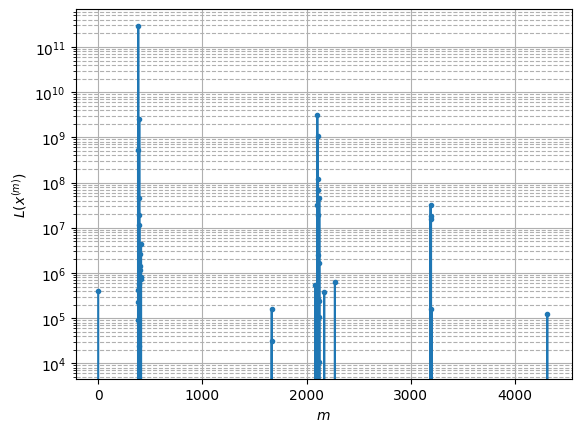

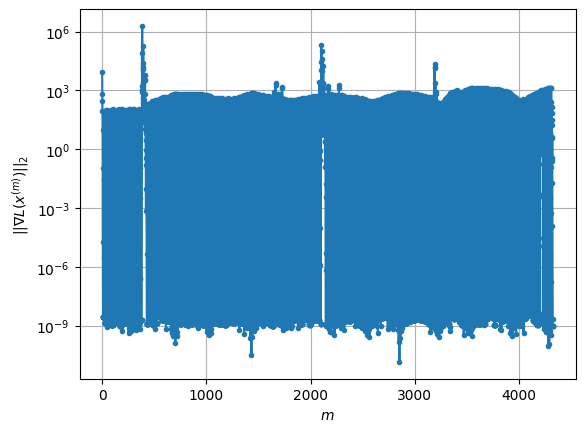

Windows:  73%|███████▎  | 290/395 [03:13<01:09,  1.51it/s]

Before applying the algorithm
Cost function: -84427.96372796778
Gradient norm: 1418.109696808126
Global relative error: 311.31864450962837
Position relative errors: 1.3658720507347388 m, 103.2731980643119 m, 172.33606345769905 m, 237.76416094698283 m

Iteration 1
Cost function: -236317.06398911032 (-179.90%)
Gradient norm: 2.0018381764936906 (-99.86%)
Global relative error: 311.082294128589 (-0.08%)
Position relative errors: 0.25804725588059735 m, 124.26320183624681 m, 252.46053519687493 m, 132.56657796717622 m

Iteration 2
Cost function: -236347.73382025943 (-0.01%)
Gradient norm: 8.657351625731758 (332.47%)
Global relative error: 177.7918544967006 (-42.85%)
Position relative errors: 0.25804725588059735 m, 66.95856944502617 m, 136.14472235007102 m, 92.57687138580262 m

Iteration 3
Cost function: -236357.4028769961 (-0.00%)
Gradient norm: 0.5187294762681821 (-94.01%)
Global relative error: 170.7085256732781 (-3.98%)
Position relative errors: 0.25804725588059735 m, 35.13205128132228 m, 

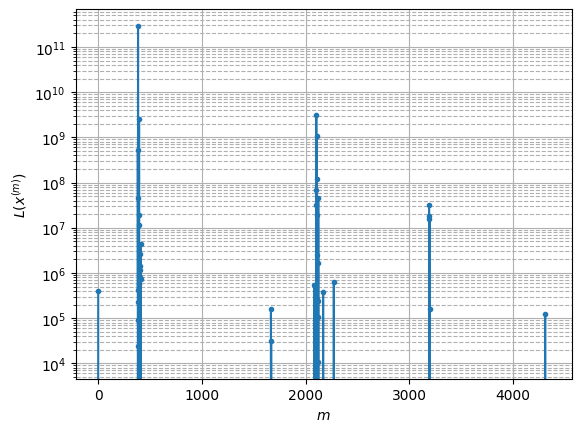

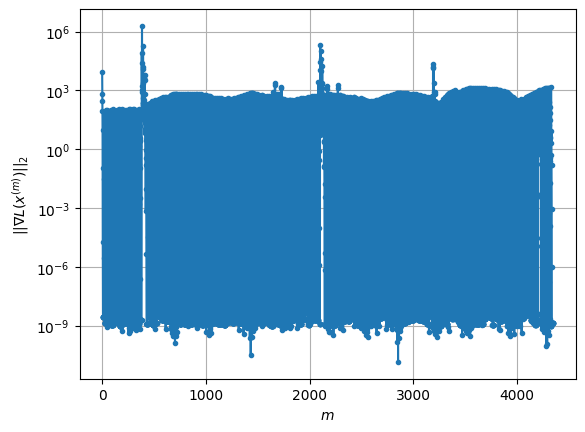

Windows:  74%|███████▎  | 291/395 [03:14<01:09,  1.50it/s]

Before applying the algorithm
Cost function: -85502.20609008281
Gradient norm: 1413.0400514542303
Global relative error: 360.2465714812296
Position relative errors: 1.1055645272052368 m, 68.52558139626613 m, 234.54656604624432 m, 264.6659034109747 m

Iteration 1
Cost function: -236339.16381252697 (-176.41%)
Gradient norm: 1.7843387632964183 (-99.87%)
Global relative error: 326.4028349130615 (-9.39%)
Position relative errors: 0.2063632078137561 m, 160.1032462332073 m, 112.19581009752709 m, 261.337590450992 m

Iteration 2
Cost function: -236355.44002510747 (-0.01%)
Gradient norm: 6.845875981478528 (283.66%)
Global relative error: 44.03821649325979 (-86.51%)
Position relative errors: 0.2063632078137561 m, 14.434101465773022 m, 39.44574866815299 m, 12.430966981310494 m

Iteration 3
Cost function: -236359.33550718345 (-0.00%)
Gradient norm: 0.0796719179688275 (-98.84%)
Global relative error: 44.449616233589744 (0.93%)
Position relative errors: 0.2063632078137561 m, 7.6893828150235555 m, 29.

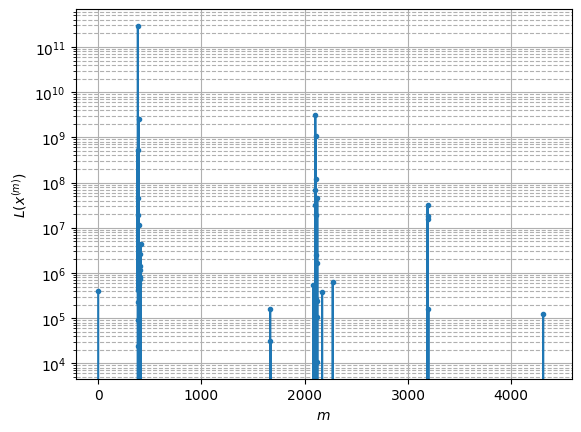

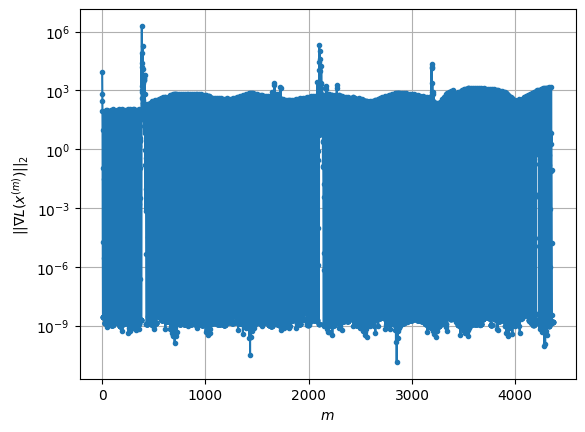

Windows:  74%|███████▍  | 292/395 [03:15<01:07,  1.52it/s]

Before applying the algorithm
Cost function: -86675.70612809123
Gradient norm: 1392.9179033241178
Global relative error: 273.33961435313483
Position relative errors: 1.3296713962785198 m, 96.92916368168845 m, 125.76650397345652 m, 222.4407630298107 m

Iteration 1
Cost function: -236342.6260650284 (-172.67%)
Gradient norm: 1.4739181327575837 (-99.89%)
Global relative error: 96.0003148672574 (-64.88%)
Position relative errors: 0.17563850719303487 m, 40.90852267199746 m, 38.117182869347 m, 77.90504060039895 m

Iteration 2
Cost function: -236346.37529354324 (-0.00%)
Gradient norm: 4.334130152670015 (194.06%)
Global relative error: 173.8404462505078 (81.08%)
Position relative errors: 0.17563850719303487 m, 82.60322769780538 m, 120.41089443226072 m, 94.2230639596326 m

Iteration 3
Cost function: -236352.1594797273 (-0.00%)
Gradient norm: 0.6190645429869078 (-85.72%)
Global relative error: 111.89658736408018 (-35.63%)
Position relative errors: 0.17563850719303487 m, 42.61265686632722 m, 65.78

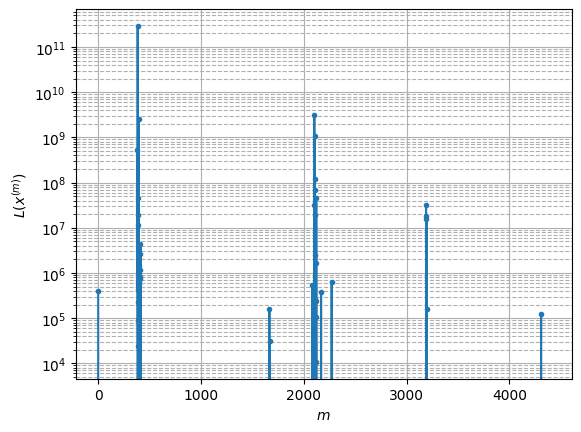

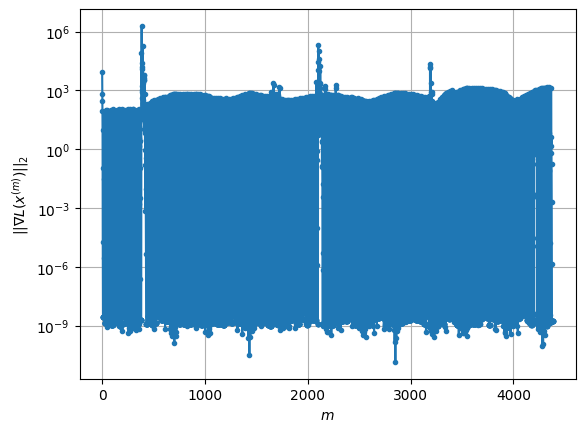

Windows:  74%|███████▍  | 293/395 [03:15<01:07,  1.52it/s]

Before applying the algorithm
Cost function: -93413.77499456536
Gradient norm: 1363.3355898280029
Global relative error: 277.03417189024026
Position relative errors: 1.252145497551856 m, 83.37237429097569 m, 144.02504365002113 m, 221.43143232727135 m

Iteration 1
Cost function: -236327.82446691743 (-152.99%)
Gradient norm: 2.9199783449521646 (-99.79%)
Global relative error: 112.57035181442481 (-59.37%)
Position relative errors: 0.16979407095801533 m, 37.34312989540244 m, 3.967077382058292 m, 106.02588794018445 m

Iteration 2
Cost function: -236361.63371550286 (-0.01%)
Gradient norm: 1.324325392743884 (-54.65%)
Global relative error: 85.78005335808342 (-23.80%)
Position relative errors: 0.16979407095801533 m, 20.738812716158357 m, 77.34323750741086 m, 30.426874179469333 m

Iteration 3
Cost function: -236361.7782846185 (-0.00%)
Gradient norm: 0.007397612790563491 (-99.44%)
Global relative error: 88.61438006600503 (3.30%)
Position relative errors: 0.16979407095801533 m, 23.445818245783453

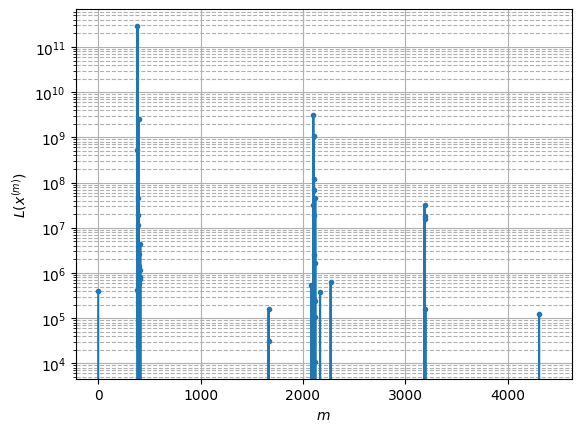

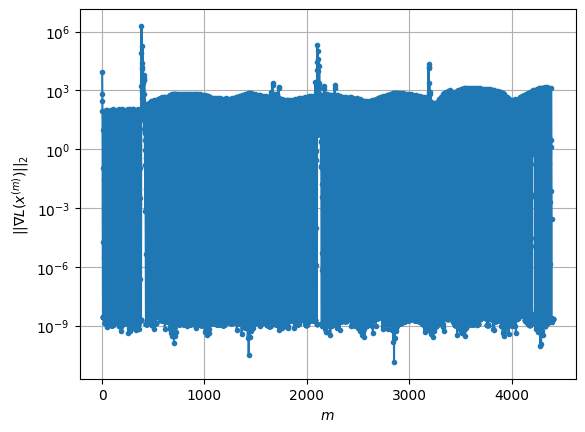

Windows:  74%|███████▍  | 294/395 [03:16<01:08,  1.47it/s]

Before applying the algorithm
Cost function: -97498.52842043302
Gradient norm: 1342.3186644171947
Global relative error: 280.68815344431937
Position relative errors: 1.2230449766721423 m, 97.04869426253792 m, 139.19641933875022 m, 223.5397386864965 m

Iteration 1
Cost function: -236289.70940736632 (-142.35%)
Gradient norm: 4.060052851154554 (-99.70%)
Global relative error: 127.19779189433375 (-54.68%)
Position relative errors: 0.18537922126071602 m, 80.78815943330231 m, 73.29614179823596 m, 65.26833943087455 m

Iteration 2
Cost function: -236344.6440940392 (-0.02%)
Gradient norm: 1.8991774370398218 (-53.22%)
Global relative error: 258.0794694376538 (102.90%)
Position relative errors: 0.18537922126071602 m, 90.34401930188308 m, 198.78105081968357 m, 137.50924889992558 m

Iteration 3
Cost function: -236356.04112098092 (-0.00%)
Gradient norm: 4.075343580262801 (114.58%)
Global relative error: 47.181324823039326 (-81.72%)
Position relative errors: 0.18537922126071602 m, 3.7533412916745763 

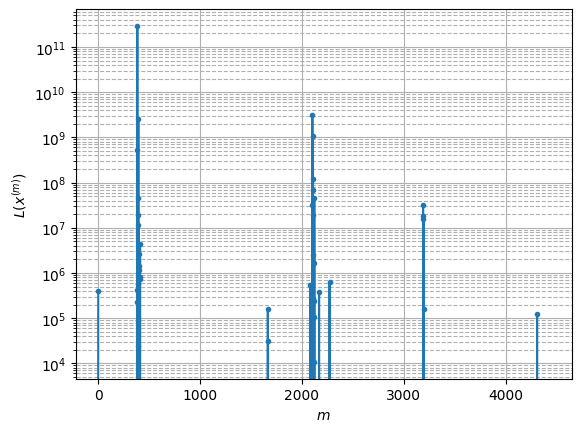

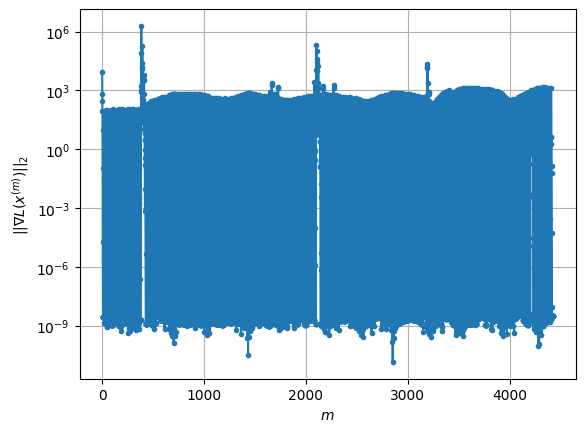

Windows:  75%|███████▍  | 295/395 [03:17<01:04,  1.54it/s]

Before applying the algorithm
Cost function: -103355.8334314705
Gradient norm: 1301.3707269712477
Global relative error: 269.3733958550577
Position relative errors: 1.2540921101817948 m, 62.40585906356282 m, 136.8660274113723 m, 223.41328837834612 m

Iteration 1
Cost function: -235996.21871320027 (-128.33%)
Gradient norm: 9.806936506032358 (-99.25%)
Global relative error: 386.69958911151144 (43.56%)
Position relative errors: 0.06030627704705429 m, 213.17811556743453 m, 306.5872608575403 m, 100.37806327353525 m

Iteration 2
Cost function: -236351.28817152028 (-0.15%)
Gradient norm: 4.778508037140551 (-51.27%)
Global relative error: 113.09442527528432 (-70.75%)
Position relative errors: 0.06030627704705429 m, 62.167644181055024 m, 29.81470857043448 m, 89.53466950143198 m

Iteration 3
Cost function: -236358.5095224947 (-0.00%)
Gradient norm: 1.2618812193348763 (-73.59%)
Global relative error: 47.09494268177386 (-58.36%)
Position relative errors: 0.06030627704705429 m, 10.956139057237134 m

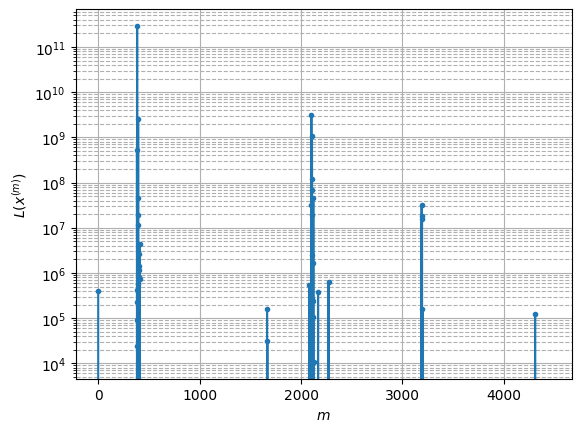

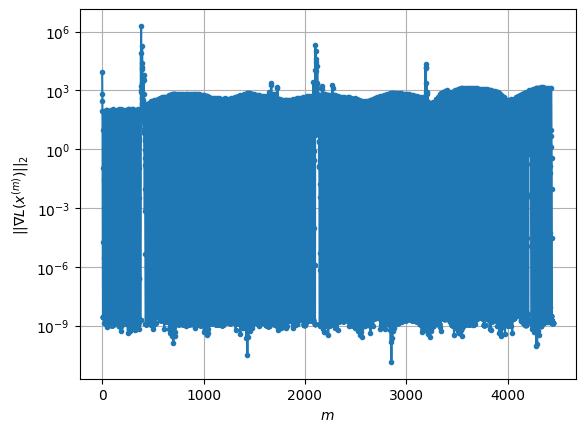

Windows:  75%|███████▍  | 296/395 [03:17<01:06,  1.48it/s]

Before applying the algorithm
Cost function: -111895.47371436935
Gradient norm: 1254.4762319757033
Global relative error: 300.0565569251572
Position relative errors: 1.2944644294399283 m, 58.1995878151132 m, 161.5078342393778 m, 246.04922833651244 m

Iteration 1
Cost function: -235676.8572420437 (-110.62%)
Gradient norm: 15.81854601898104 (-98.74%)
Global relative error: 435.51882292655455 (45.15%)
Position relative errors: 0.12512238761033692 m, 224.30129860423716 m, 364.8858577864889 m, 78.76421326659971 m

Iteration 2
Cost function: -236341.85109123672 (-0.28%)
Gradient norm: 4.867954649605989 (-69.23%)
Global relative error: 175.59626973920354 (-59.68%)
Position relative errors: 0.12512238761033692 m, 69.45038879782676 m, 56.08206347845408 m, 151.14699313733038 m

Iteration 3
Cost function: -236353.66442648412 (-0.00%)
Gradient norm: 1.9167130340380811 (-60.63%)
Global relative error: 98.8671817078597 (-43.70%)
Position relative errors: 0.12512238761033692 m, 34.26514714340157 m, 1

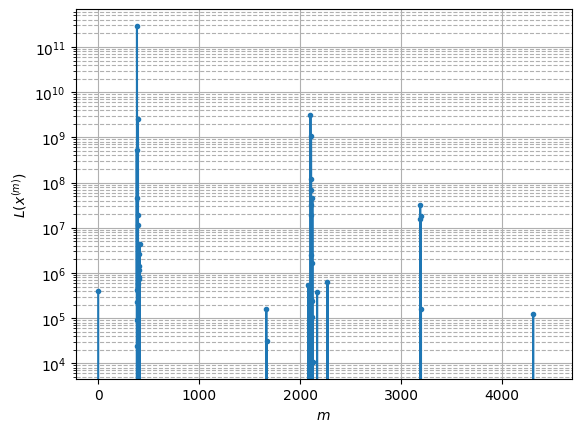

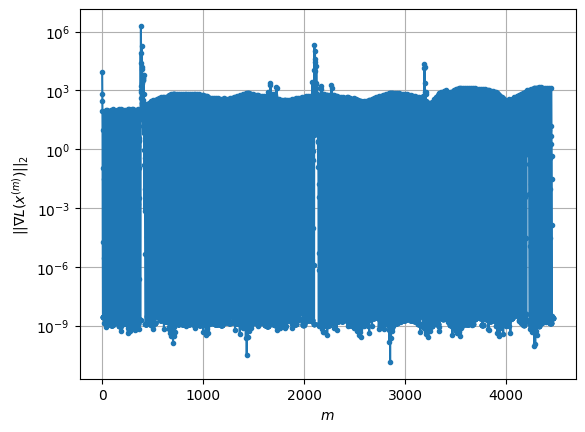

Windows:  75%|███████▌  | 297/395 [03:18<01:03,  1.54it/s]

Before applying the algorithm
Cost function: -119547.28277300051
Gradient norm: 1210.2143857732435
Global relative error: 314.35590095162723
Position relative errors: 1.2181826095944914 m, 51.69574113348656 m, 140.16349974740774 m, 276.5500056022238 m

Iteration 1
Cost function: -235474.67599580405 (-96.97%)
Gradient norm: 20.936650539815798 (-98.27%)
Global relative error: 470.05267063285004 (49.53%)
Position relative errors: 0.1489687348716051 m, 292.26585377679123 m, 358.722203219531 m, 82.63507746697182 m

Iteration 2
Cost function: -236323.65603472613 (-0.36%)
Gradient norm: 4.499845224665349 (-78.51%)
Global relative error: 285.4576192785822 (-39.27%)
Position relative errors: 0.1489687348716051 m, 133.34230970141692 m, 96.42197510343958 m, 233.21379631207103 m

Iteration 3
Cost function: -236343.20658158496 (-0.01%)
Gradient norm: 2.5001991498283718 (-44.44%)
Global relative error: 143.06500117888456 (-49.88%)
Position relative errors: 0.1489687348716051 m, 56.018375313855586 m,

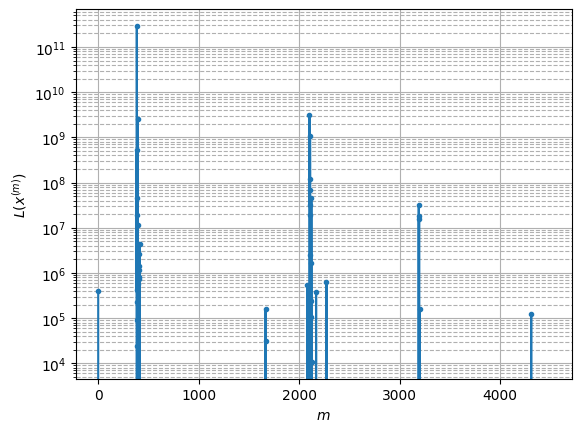

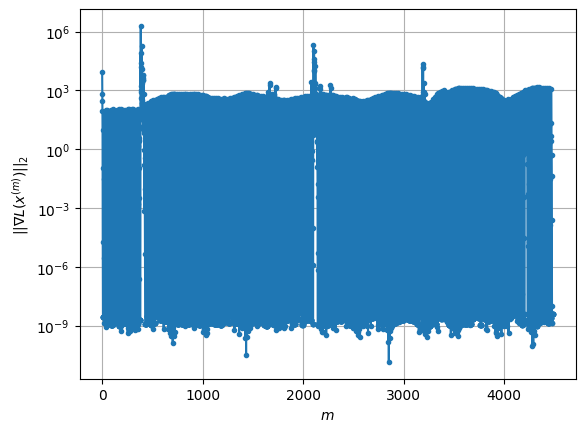

Windows:  75%|███████▌  | 298/395 [03:19<01:05,  1.48it/s]

Before applying the algorithm
Cost function: -125660.07848517473
Gradient norm: 1175.8164938711989
Global relative error: 271.3793500889432
Position relative errors: 1.2566260150028163 m, 66.1591542188809 m, 134.80545682003688 m, 225.99934563239347 m

Iteration 1
Cost function: -224372.360040141 (-78.56%)
Gradient norm: 225.1031398603456 (-80.86%)
Global relative error: 1972.934349499903 (627.00%)
Position relative errors: 0.12611076049048195 m, 1037.822073584259 m, 1433.7350761912153 m, 871.6530748920987 m

Iteration 2
Cost function: -235298.97860780507 (-4.87%)
Gradient norm: 32.084962872495346 (-85.75%)
Global relative error: 1607.5997755820733 (-18.52%)
Position relative errors: 0.12611076049048195 m, 867.8181025655274 m, 705.2825116203231 m, 1154.9135979655084 m

Iteration 3
Cost function: -236114.3002141914 (-0.35%)
Gradient norm: 10.02111657453634 (-68.77%)
Global relative error: 1255.3435080886304 (-21.91%)
Position relative errors: 0.12611076049048195 m, 594.7938048996027 m, 5

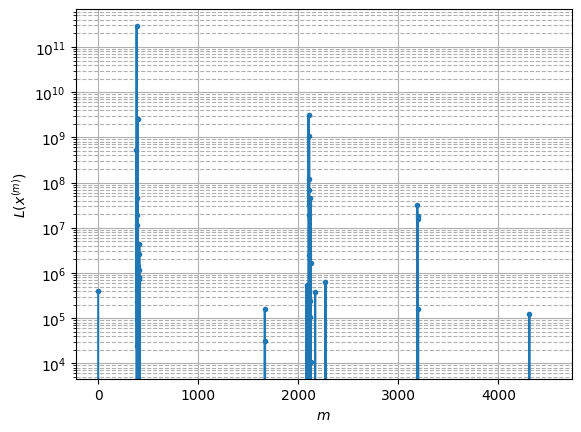

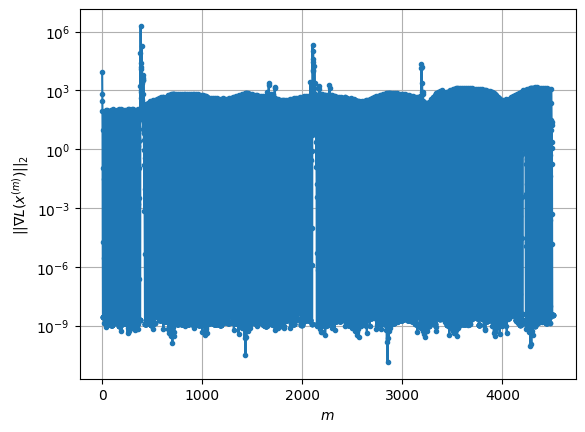

Windows:  76%|███████▌  | 299/395 [03:19<01:03,  1.52it/s]

Before applying the algorithm
Cost function: -137685.79973879328
Gradient norm: 1101.8150783209821
Global relative error: 286.8612313701477
Position relative errors: 1.2853127489799197 m, 94.01962521314519 m, 122.11531850575976 m, 241.9008066289174 m

Iteration 1
Cost function: -217009.32191566168 (-57.61%)
Gradient norm: 336.11317512442986 (-69.49%)
Global relative error: 2186.779254867527 (662.31%)
Position relative errors: 0.2612164864746955 m, 1123.4100255165386 m, 1564.840655236923 m, 1034.99140417875 m

Iteration 2
Cost function: -234557.21536495254 (-8.09%)
Gradient norm: 61.237031161042964 (-81.78%)
Global relative error: 1989.5455381813272 (-9.02%)
Position relative errors: 0.2612164864746955 m, 1096.381975054503 m, 756.6887191295432 m, 1477.7145375657715 m

Iteration 3
Cost function: -235941.29163462127 (-0.59%)
Gradient norm: 7.720176975518677 (-87.39%)
Global relative error: 1738.325308719479 (-12.63%)
Position relative errors: 0.2612164864746955 m, 829.5595981053012 m, 770

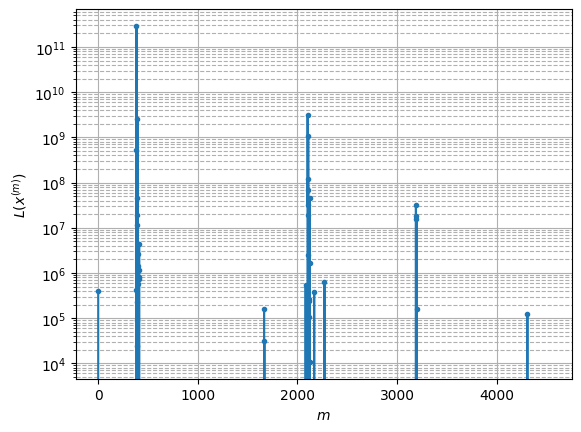

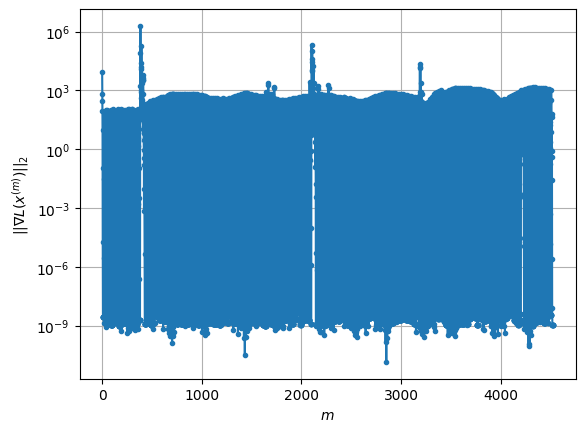

Windows:  76%|███████▌  | 300/395 [03:20<01:05,  1.45it/s]

Before applying the algorithm
Cost function: -145644.90664728582
Gradient norm: 1049.7334295800315
Global relative error: 285.16152430298894
Position relative errors: 1.4203778927916924 m, 87.3190877409379 m, 125.38724930552372 m, 240.7252849773839 m

Iteration 1
Cost function: -209874.054646036 (-44.10%)
Gradient norm: 420.99731143958604 (-59.89%)
Global relative error: 2416.1563905513876 (747.29%)
Position relative errors: 0.04014583950878822 m, 1252.4674848827838 m, 1703.2588553929636 m, 1169.6265829561926 m

Iteration 2
Cost function: 98059029179134.94 (46722797419.81%)
Gradient norm: 36056832.35552911 (8564522.95%)
Global relative error: 7021996.858705951 (290526.75%)
Position relative errors: 0.040145839619786704 m, 2502067.378579309 m, 3159388.40272875 m, 5750335.958655698 m

Iteration 3
Cost function: 1341407386.02845 (-100.00%)
Gradient norm: 10070.315156951263 (-99.97%)
Global relative error: 52670.32741445094 (-99.25%)
Position relative errors: 0.040145839286791274 m, 18470.

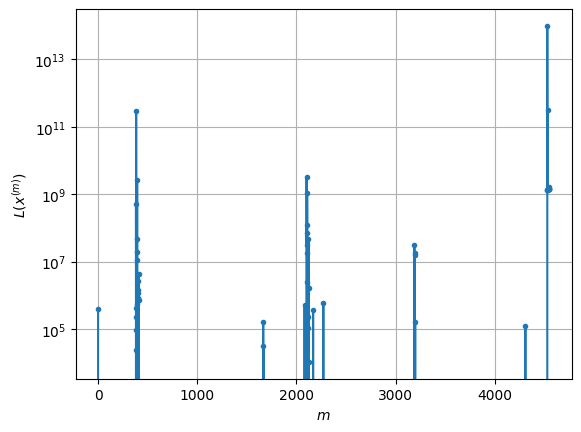

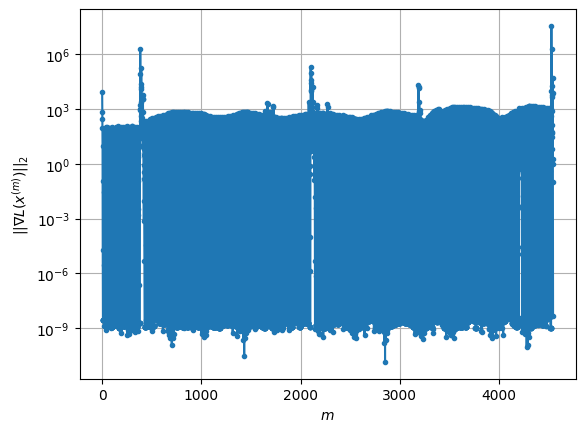

Windows:  76%|███████▌  | 301/395 [03:20<00:55,  1.71it/s]

Before applying the algorithm
Cost function: 1351485758.725106
Gradient norm: 21390.258926742572
Global relative error: 57510.18915415809
Position relative errors: 5.549080433024253 m, 7405.732841616398 m, 25926.152328508768 m, 50797.75101808112 m

Iteration 1
Cost function: 1364258463.5613203 (0.95%)
Gradient norm: 4639.969460519441 (-78.31%)
Global relative error: 58543.90254937873 (1.80%)
Position relative errors: 0.2177015160861876 m, 6035.960050670419 m, 25181.22134398482 m, 52505.82576989301 m

Iteration 2
Cost function: 1362731297.9261796 (-0.11%)
Gradient norm: 76.14551813814667 (-98.36%)
Global relative error: 58711.14120583794 (0.29%)
Position relative errors: 0.2177015160861876 m, 5567.741661795437 m, 25599.623002656637 m, 52541.96030580185 m

Iteration 3
Cost function: 1362837196.999056 (0.01%)
Gradient norm: 1226.755491289881 (1511.07%)
Global relative error: 58831.28339850278 (0.20%)
Position relative errors: 0.2177015160861876 m, 4611.19324240407 m, 25831.60465373195 m, 

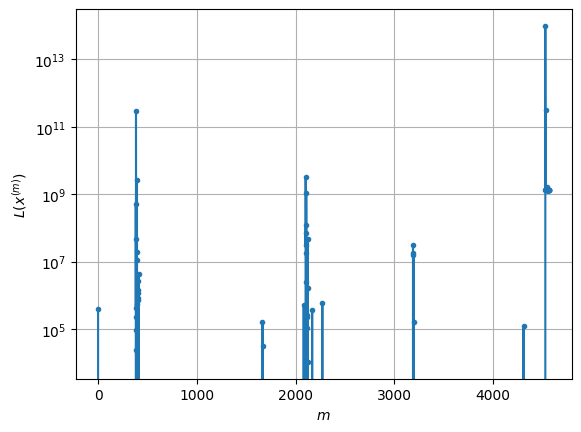

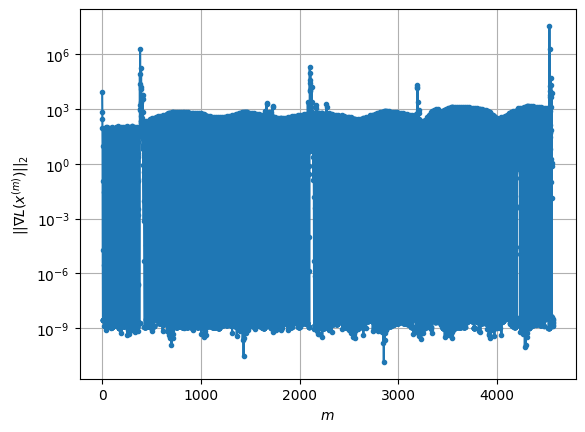

Windows:  76%|███████▋  | 302/395 [03:21<00:48,  1.92it/s]

Before applying the algorithm
Cost function: 1300066027.991844
Gradient norm: 21573.19506443722
Global relative error: 58119.166803199274
Position relative errors: 5.7272926610357295 m, 7409.37861162791 m, 25179.370474057076 m, 51854.96870250706 m

Iteration 1
Cost function: 1310072201.5934815 (0.77%)
Gradient norm: 4863.348737926398 (-77.46%)
Global relative error: 59411.19272072671 (2.22%)
Position relative errors: 0.19201219016633944 m, 5979.58114337593 m, 24530.179381450846 m, 53779.220710680835 m

Iteration 2
Cost function: 1308425779.114032 (-0.13%)
Gradient norm: 159.8652151994885 (-96.71%)
Global relative error: 59584.85646575761 (0.29%)
Position relative errors: 0.19201219016633944 m, 5457.50067701179 m, 24973.186165991236 m, 53822.9563477264 m

Iteration 3
Cost function: 1308426525.0632887 (0.00%)
Gradient norm: 20.255508670218486 (-87.33%)
Global relative error: 59582.32430618688 (-0.00%)
Position relative errors: 0.19201219016633944 m, 5345.995972893572 m, 24998.79462534828

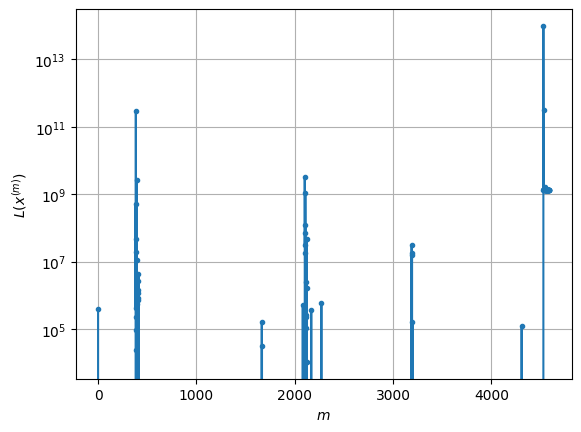

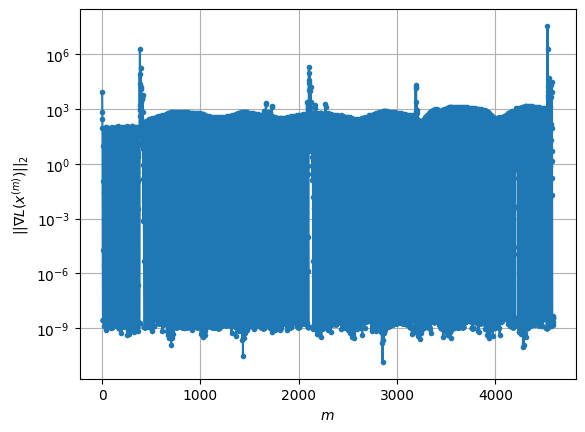

Windows:  77%|███████▋  | 303/395 [03:21<00:45,  2.02it/s]

Before applying the algorithm
Cost function: 1249521275.757051
Gradient norm: 21773.265193893865
Global relative error: 58805.08535464828
Position relative errors: 5.613529280320781 m, 7281.403783134878 m, 24418.920437831755 m, 52997.502189745705 m

Iteration 1
Cost function: 1256204437.749392 (0.53%)
Gradient norm: 5025.968536257343 (-76.92%)
Global relative error: 60356.096337596166 (2.64%)
Position relative errors: 0.11524574201856407 m, 5721.642600721323 m, 23871.814252907625 m, 55138.52897949624 m

Iteration 2
Cost function: 1254524252.98631 (-0.13%)
Gradient norm: 271.17719233563884 (-94.60%)
Global relative error: 60536.89285845155 (0.30%)
Position relative errors: 0.11524574201856407 m, 5133.725149952869 m, 24333.88105187205 m, 55192.59206341912 m

Iteration 3
Cost function: 1254525981.2826555 (0.00%)
Gradient norm: 2.589584616476617 (-99.05%)
Global relative error: 60522.70693434293 (-0.02%)
Position relative errors: 0.11524574201856407 m, 5102.556885124067 m, 24339.6982640704

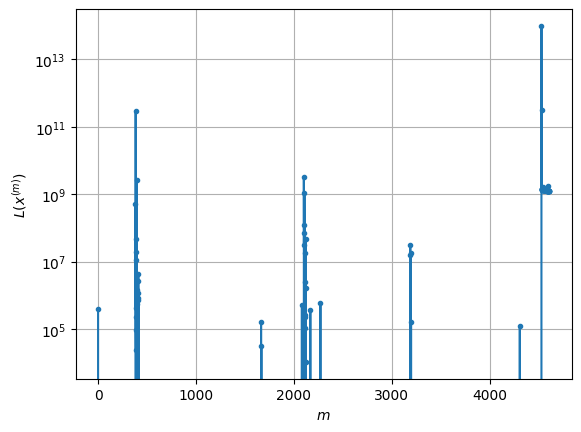

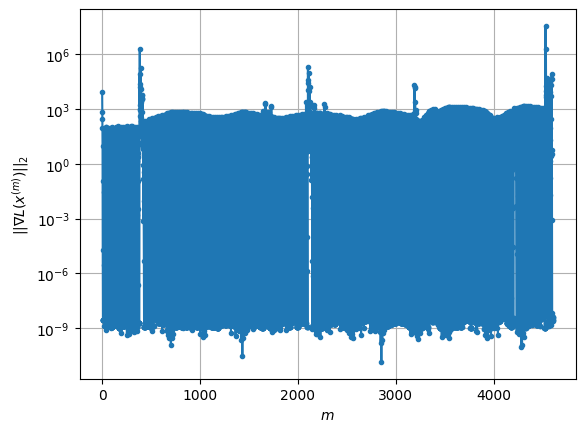

Windows:  77%|███████▋  | 304/395 [03:22<00:44,  2.03it/s]

Before applying the algorithm
Cost function: 1199849770.2155132
Gradient norm: 21993.22112782398
Global relative error: 59534.49683748334
Position relative errors: 5.444215856392905 m, 7256.044455033432 m, 23629.354478395748 m, 54160.49537836437 m

Iteration 1
Cost function: 1202713427.3698552 (0.24%)
Gradient norm: 5135.426314978147 (-76.65%)
Global relative error: 61340.187309969384 (3.03%)
Position relative errors: 0.20646647649468117 m, 5596.020437236584 m, 23193.73604554167 m, 56509.762806716644 m

Iteration 2
Cost function: 1201098915.726896 (-0.13%)
Gradient norm: 411.39078086271667 (-91.99%)
Global relative error: 61532.365404267446 (0.31%)
Position relative errors: 0.20646647649468117 m, 4957.1993785432815 m, 23667.590659402787 m, 56581.8245435589 m

Iteration 3
Cost function: 1201100119.7429314 (0.00%)
Gradient norm: 0.7703998253377999 (-99.81%)
Global relative error: 61499.727803974834 (-0.05%)
Position relative errors: 0.20646647649468117 m, 4958.584325938592 m, 23664.83925

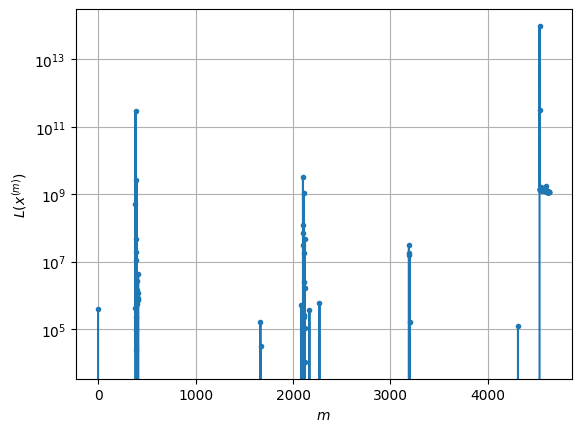

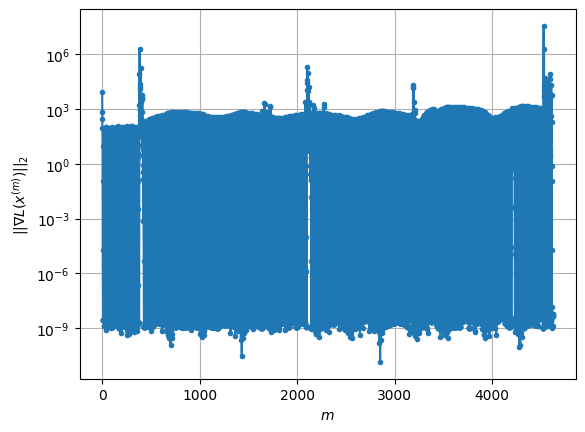

Windows:  77%|███████▋  | 305/395 [03:22<00:42,  2.12it/s]

Before applying the algorithm
Cost function: 1151059391.7199817
Gradient norm: 22208.78659542323
Global relative error: 60337.02493958745
Position relative errors: 5.707609431144976 m, 7119.958517117051 m, 22846.139394634705 m, 55388.77126564765 m

Iteration 1
Cost function: 1149996795.630284 (-0.09%)
Gradient norm: 5205.815653473612 (-76.56%)
Global relative error: 62379.70926702868 (3.39%)
Position relative errors: 0.13552240315271447 m, 5360.294437719391 m, 22520.45520435621 m, 57925.15688377016 m

Iteration 2
Cost function: 1148531244.748868 (-0.13%)
Gradient norm: 574.1163063640603 (-88.97%)
Global relative error: 62587.16111880896 (0.33%)
Position relative errors: 0.13552240315271447 m, 4678.427250392036 m, 22999.18560124183 m, 58019.84012296995 m

Iteration 3
Cost function: 1148527758.3781567 (-0.00%)
Gradient norm: 1.7380122531402893 (-99.70%)
Global relative error: 62529.43236120446 (-0.09%)
Position relative errors: 0.13552240315271447 m, 4694.47180850026 m, 22990.22523944421

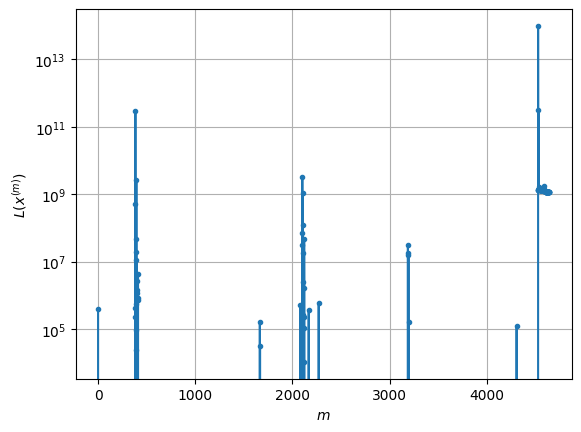

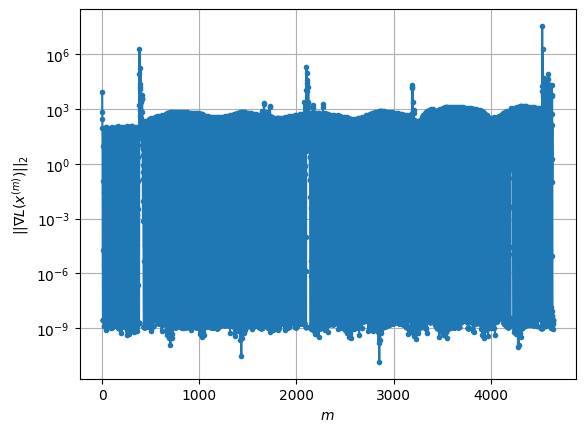

Windows:  77%|███████▋  | 306/395 [03:22<00:38,  2.31it/s]

Before applying the algorithm
Cost function: 1103054179.8508115
Gradient norm: 22461.109239783706
Global relative error: 61198.035804015846
Position relative errors: 5.479588592383144 m, 6921.5529222879695 m, 22085.106909387112 m, 56652.791458634594 m

Iteration 1
Cost function: 1098406948.2301683 (-0.42%)
Gradient norm: 5209.88313419467 (-76.80%)
Global relative error: 63447.48666848924 (3.68%)
Position relative errors: 0.0493967842331214 m, 5178.63845705926 m, 21854.347461171976 m, 59339.29415817171 m

Iteration 2
Cost function: 1097132861.0207698 (-0.12%)
Gradient norm: 723.5338537800764 (-86.11%)
Global relative error: 63659.36916993815 (0.33%)
Position relative errors: 0.0493967842331214 m, 4500.956925957123 m, 22327.64649111751 m, 59445.20113429945 m

Iteration 3
Cost function: 1097120304.7315264 (-0.00%)
Gradient norm: 2.691217943577003 (-99.63%)
Global relative error: 63575.91112450346 (-0.13%)
Position relative errors: 0.0493967842331214 m, 4523.758517654517 m, 22313.988304588

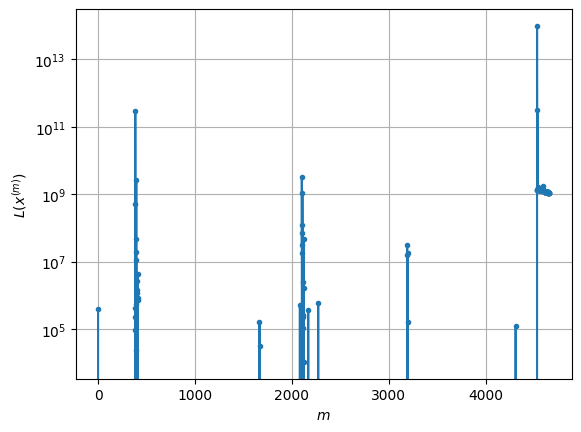

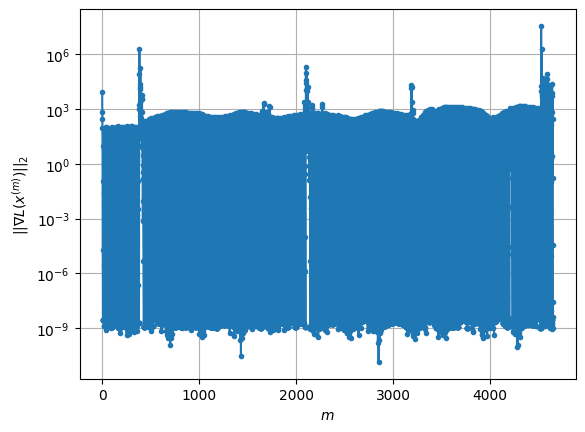

Windows:  78%|███████▊  | 307/395 [03:23<00:36,  2.43it/s]

Before applying the algorithm
Cost function: 1056807948.4867327
Gradient norm: 22675.28767508786
Global relative error: 62112.50372293784
Position relative errors: 5.457645338530508 m, 6739.669957116569 m, 21295.048710317602 m, 57957.39461865884 m

Iteration 1
Cost function: 1048066664.049123 (-0.83%)
Gradient norm: 5228.301906916007 (-76.94%)
Global relative error: 64569.91747918769 (3.96%)
Position relative errors: 0.12236474308754654 m, 4904.97306315144 m, 21173.867788222706 m, 60801.986465355614 m

Iteration 2
Cost function: 1047065024.1420653 (-0.10%)
Gradient norm: 931.6073017768075 (-82.18%)
Global relative error: 64806.959577897454 (0.37%)
Position relative errors: 0.12236474308754654 m, 4206.130996852046 m, 21640.71756557018 m, 60942.00987613826 m

Iteration 3
Cost function: 1047032576.5983247 (-0.00%)
Gradient norm: 3.96359881171313 (-99.57%)
Global relative error: 64687.152621353176 (-0.18%)
Position relative errors: 0.12236474308754654 m, 4236.098585227952 m, 21621.47439949

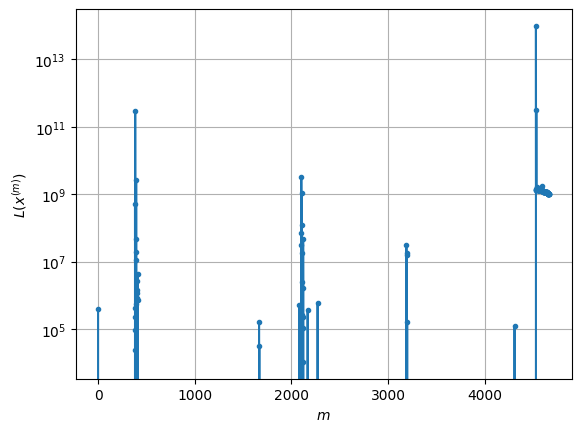

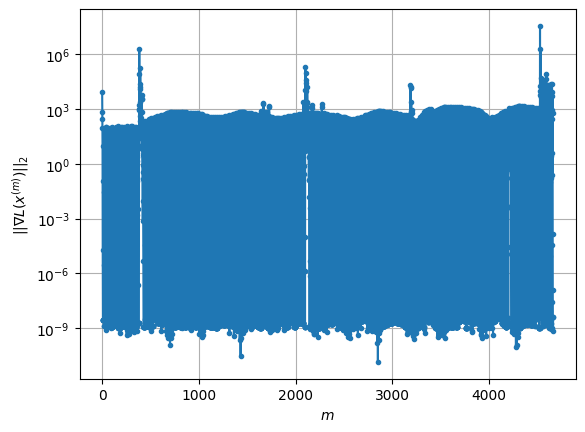

Windows:  78%|███████▊  | 308/395 [03:23<00:35,  2.46it/s]

Before applying the algorithm
Cost function: 1011738360.8389022
Gradient norm: 22908.7422237779
Global relative error: 63076.828168338136
Position relative errors: 5.485723179132827 m, 6509.437050554304 m, 20523.193349465448 m, 59288.36629148346 m

Iteration 1
Cost function: 999275146.3974712 (-1.23%)
Gradient norm: 5211.241344249524 (-77.25%)
Global relative error: 65714.62330038726 (4.18%)
Position relative errors: 0.05949762425952376 m, 4668.778550816238 m, 20504.4174867545 m, 62258.987123815816 m

Iteration 2
Cost function: 998552521.6980052 (-0.07%)
Gradient norm: 1128.7043294310186 (-78.34%)
Global relative error: 65967.22387105582 (0.38%)
Position relative errors: 0.05949762425952376 m, 3985.238600368126 m, 20958.013970496242 m, 62422.37211740647 m

Iteration 3
Cost function: 998493214.3346739 (-0.01%)
Gradient norm: 4.900751804727334 (-99.57%)
Global relative error: 65811.84948405263 (-0.24%)
Position relative errors: 0.05949762425952376 m, 4017.7094752119865 m, 20934.085671502

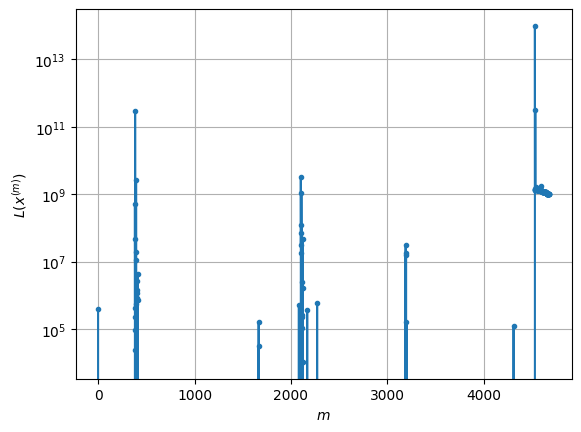

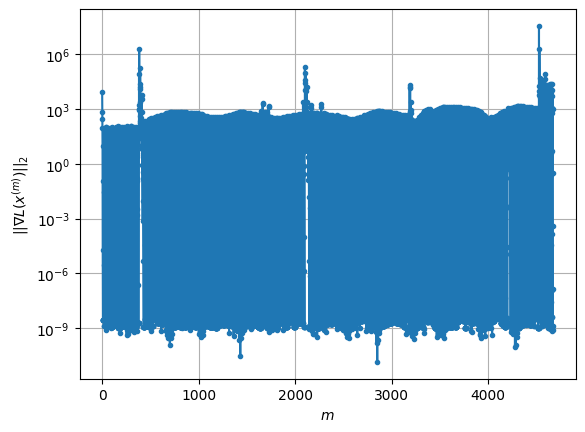

Windows:  78%|███████▊  | 309/395 [03:24<00:35,  2.40it/s]

Before applying the algorithm
Cost function: 968574217.1072229
Gradient norm: 23058.715364675856
Global relative error: 64057.652019201756
Position relative errors: 5.47485041136588 m, 6467.631424456142 m, 19720.28434378656 m, 60602.48230452515 m

Iteration 1
Cost function: 952076708.2079403 (-1.70%)
Gradient norm: 5192.637652804875 (-77.48%)
Global relative error: 66867.61616280732 (4.39%)
Position relative errors: 0.2573629413233084 m, 4613.516372516024 m, 19813.802747791535 m, 63697.76101760535 m

Iteration 2
Cost function: 951713812.4374121 (-0.04%)
Gradient norm: 1371.7671113699146 (-73.58%)
Global relative error: 67161.53370824062 (0.44%)
Position relative errors: 0.2573629413233084 m, 3957.6085923689247 m, 20250.70162874668 m, 63913.34764995122 m

Iteration 3
Cost function: 951610986.6701736 (-0.01%)
Gradient norm: 5.929045694671066 (-99.57%)
Global relative error: 66961.9125234174 (-0.30%)
Position relative errors: 0.2573629413233084 m, 3993.4759698854978 m, 20221.69476460911 m

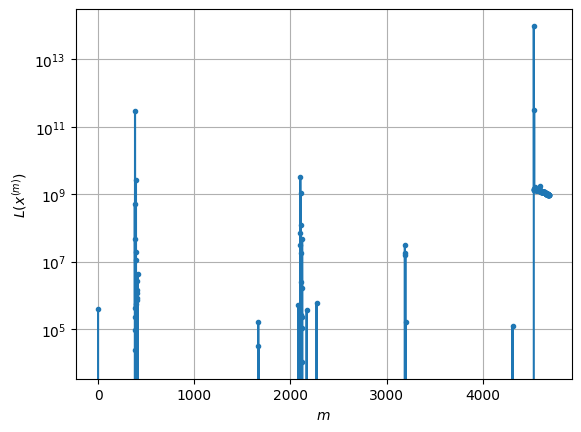

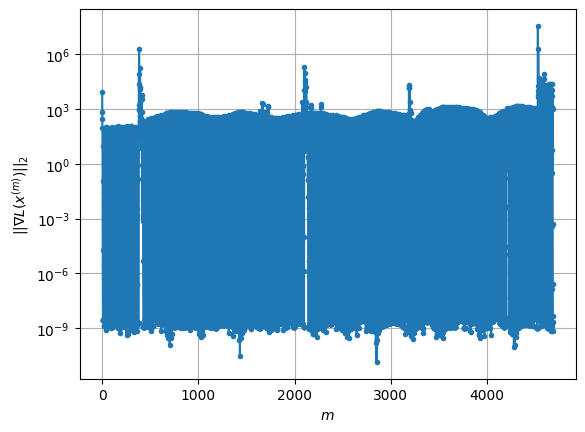

Windows:  78%|███████▊  | 310/395 [03:24<00:35,  2.41it/s]

Before applying the algorithm
Cost function: 926676986.6586473
Gradient norm: 23266.875087853372
Global relative error: 65136.54643217062
Position relative errors: 5.502909938024445 m, 6044.8577820469245 m, 18979.713679888093 m, 62016.10545179993 m

Iteration 1
Cost function: 906988037.5332918 (-2.12%)
Gradient norm: 5140.274664040053 (-77.91%)
Global relative error: 68090.0270340545 (4.53%)
Position relative errors: 0.13503681115600408 m, 4152.67285686819 m, 19163.396707700264 m, 65205.58900741056 m

Iteration 2
Cost function: 906896503.6757478 (-0.01%)
Gradient norm: 1556.6320383825075 (-69.72%)
Global relative error: 68393.97072534691 (0.45%)
Position relative errors: 0.13503681115600408 m, 3510.9273029488504 m, 19579.812090099833 m, 65437.276082576485 m

Iteration 3
Cost function: 906753141.2783072 (-0.02%)
Gradient norm: 6.455147341241637 (-99.59%)
Global relative error: 68159.80016119592 (-0.34%)
Position relative errors: 0.13503681115600408 m, 3547.596278557411 m, 19547.45819491

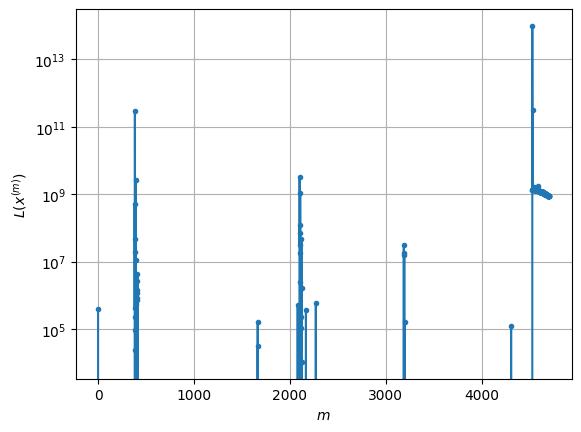

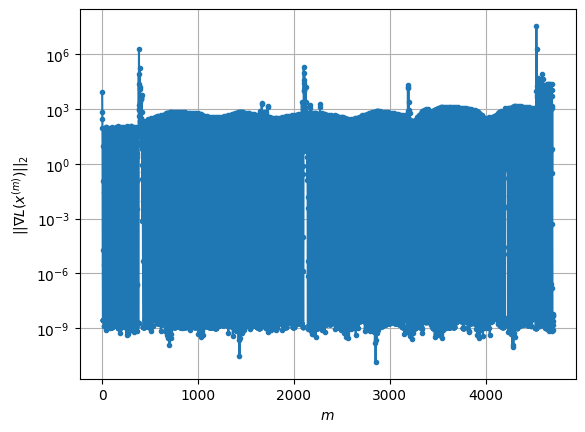

Windows:  79%|███████▊  | 311/395 [03:24<00:33,  2.54it/s]

Before applying the algorithm
Cost function: 886738642.5016179
Gradient norm: 23455.690065515537
Global relative error: 66208.92616708911
Position relative errors: 5.582552046594724 m, 5815.654151212295 m, 18227.750435380793 m, 63384.11606507917 m

Iteration 1
Cost function: 863853628.1393251 (-2.58%)
Gradient norm: 5070.241871291476 (-78.38%)
Global relative error: 69293.34682921063 (4.66%)
Position relative errors: 0.2364296818165585 m, 3994.3824862786532 m, 18505.5845694826 m, 66656.98146849067 m

Iteration 2
Cost function: 864043194.1827383 (0.02%)
Gradient norm: 1742.653525355242 (-65.63%)
Global relative error: 69610.35845437318 (0.46%)
Position relative errors: 0.2364296818165585 m, 3420.7824396633837 m, 18897.39629147564 m, 66908.78627244807 m

Iteration 3
Cost function: 863852453.9845909 (-0.02%)
Gradient norm: 6.775702122052375 (-99.61%)
Global relative error: 69341.25017689327 (-0.39%)
Position relative errors: 0.2364296818165585 m, 3454.7983578138246 m, 18862.180083890806 m

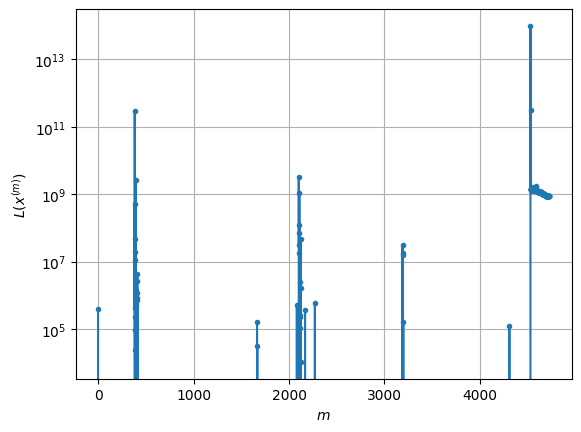

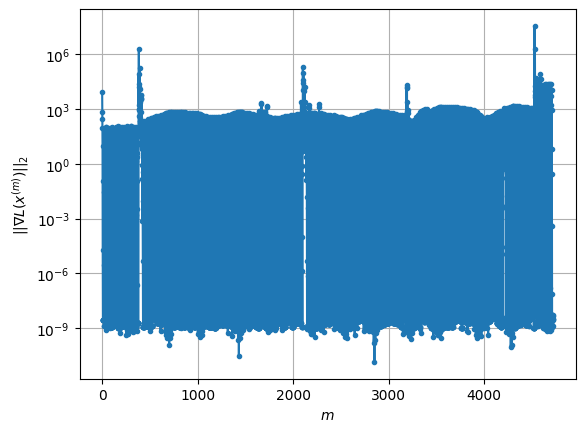

Windows:  79%|███████▉  | 312/395 [03:25<00:32,  2.59it/s]

Before applying the algorithm
Cost function: 848825393.9355576
Gradient norm: 23558.161697571566
Global relative error: 67322.95857518668
Position relative errors: 5.517810624216437 m, 5571.27914509839 m, 17479.318864596273 m, 64775.0835036258 m

Iteration 1
Cost function: 822963519.4019809 (-3.05%)
Gradient norm: 4984.757364544367 (-78.84%)
Global relative error: 70519.1084415165 (4.75%)
Position relative errors: 0.0863854858327808 m, 3766.085974250435 m, 17853.306417496893 m, 68117.67144501406 m

Iteration 2
Cost function: 823432501.5909111 (0.06%)
Gradient norm: 1920.1619623166084 (-61.48%)
Global relative error: 70861.39190398055 (0.49%)
Position relative errors: 0.0863854858327808 m, 3241.334320961875 m, 18218.67224425299 m, 68402.53692190636 m

Iteration 3
Cost function: 823190246.7065192 (-0.03%)
Gradient norm: 6.823475951107405 (-99.64%)
Global relative error: 70558.29403799945 (-0.43%)
Position relative errors: 0.0863854858327808 m, 3273.779789880326 m, 18181.335778931407 m, 6

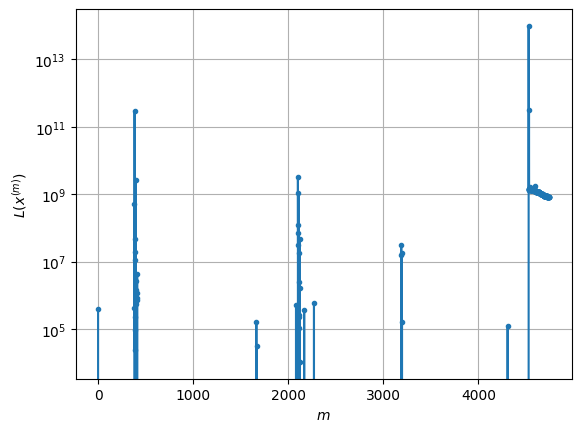

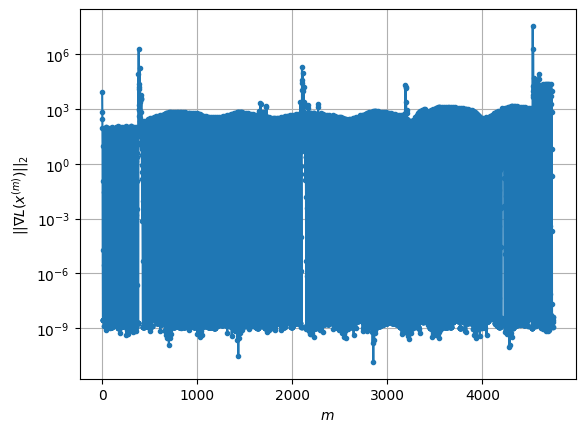

Windows:  79%|███████▉  | 313/395 [03:25<00:34,  2.40it/s]

Before applying the algorithm
Cost function: 812946559.7223827
Gradient norm: 23566.65594810858
Global relative error: 68474.1118410814
Position relative errors: 5.377708317472385 m, 5327.717499824525 m, 16733.447130509074 m, 66183.88772761723 m

Iteration 1
Cost function: 784354331.9838474 (-3.52%)
Gradient norm: 4855.33538860062 (-79.40%)
Global relative error: 71760.71224963594 (4.80%)
Position relative errors: 0.08962339563684665 m, 3468.994568049786 m, 17208.725638345684 m, 69580.32422331866 m

Iteration 2
Cost function: 785080469.678492 (0.09%)
Gradient norm: 2053.627705546563 (-57.70%)
Global relative error: 72146.85310621279 (0.54%)
Position relative errors: 0.08962339563684665 m, 2959.070388879969 m, 17544.57248301174 m, 69918.49647845382 m

Iteration 3
Cost function: 784793582.0061393 (-0.04%)
Gradient norm: 6.429469090706234 (-99.69%)
Global relative error: 71816.58032700157 (-0.46%)
Position relative errors: 0.08962339563684665 m, 2991.3988063799507 m, 17506.491386885667 m,

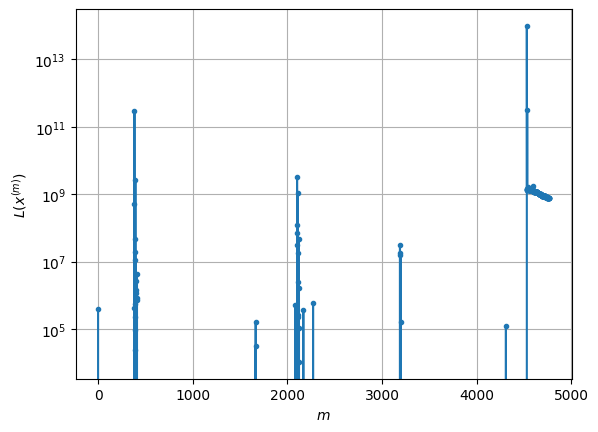

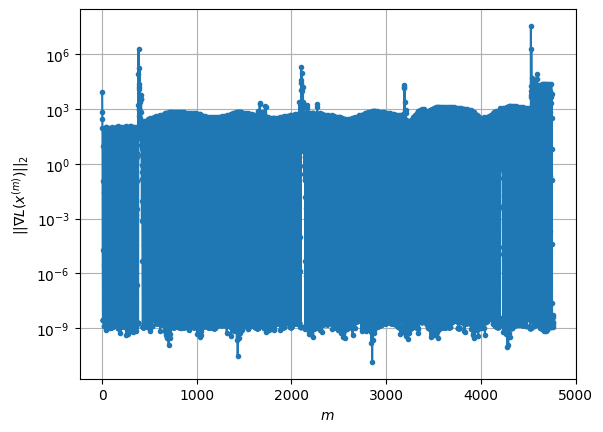

Windows:  79%|███████▉  | 314/395 [03:26<00:33,  2.44it/s]

Before applying the algorithm
Cost function: 778820984.0669187
Gradient norm: 23736.4300122295
Global relative error: 69612.54645711732
Position relative errors: 5.504205042425077 m, 5007.574186393256 m, 16050.235603142031 m, 67551.57989120916 m

Iteration 1
Cost function: 748089745.5929563 (-3.95%)
Gradient norm: 4732.01863649358 (-80.06%)
Global relative error: 72982.62249789885 (4.84%)
Position relative errors: 0.17996950294584338 m, 3348.3309596001795 m, 16598.123141345175 m, 70991.19233121189 m

Iteration 2
Cost function: 748947199.3065681 (0.11%)
Gradient norm: 2143.634183424075 (-54.70%)
Global relative error: 73340.02851397976 (0.49%)
Position relative errors: 0.17996950294584338 m, 2966.5445733518623 m, 16904.364081277152 m, 71303.55590501703 m

Iteration 3
Cost function: 748629296.3635712 (-0.04%)
Gradient norm: 6.060057364966138 (-99.72%)
Global relative error: 72991.67760631899 (-0.47%)
Position relative errors: 0.17996950294584338 m, 2990.009927978264 m, 16866.047508795687

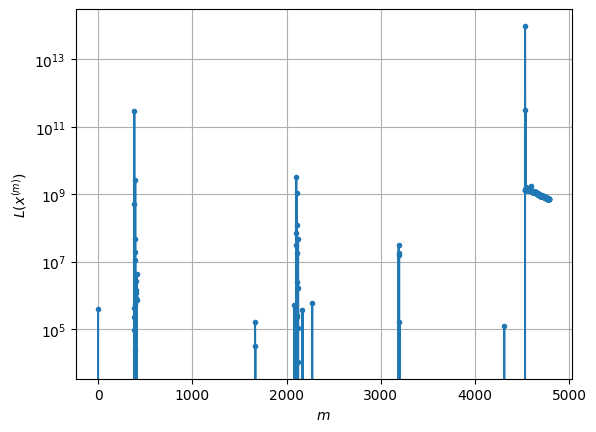

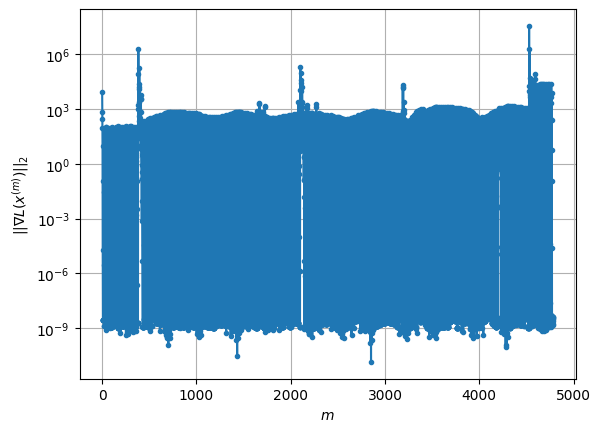

Windows:  80%|███████▉  | 315/395 [03:26<00:33,  2.39it/s]

Before applying the algorithm
Cost function: 747200976.9135116
Gradient norm: 23654.944921689483
Global relative error: 70788.72256934507
Position relative errors: 5.45060906841523 m, 4787.841163274411 m, 15345.365544576985 m, 68939.35066666045 m

Iteration 1
Cost function: 714549618.6705412 (-4.37%)
Gradient norm: 4542.472531406992 (-80.80%)
Global relative error: 74211.74381971292 (4.84%)
Position relative errors: 0.2214558496676793 m, 3159.7442691366996 m, 15982.798850940639 m, 72401.26795512169 m

Iteration 2
Cost function: 715536243.6360704 (0.14%)
Gradient norm: 2168.098132013131 (-52.27%)
Global relative error: 74596.21807129757 (0.52%)
Position relative errors: 0.2214558496676793 m, 2820.5994098654523 m, 16256.822645910694 m, 72748.54095218446 m

Iteration 3
Cost function: 715204976.3759394 (-0.05%)
Gradient norm: 5.119496520356667 (-99.76%)
Global relative error: 74239.69129510653 (-0.48%)
Position relative errors: 0.2214558496676793 m, 2840.651573239656 m, 16219.900193416934 

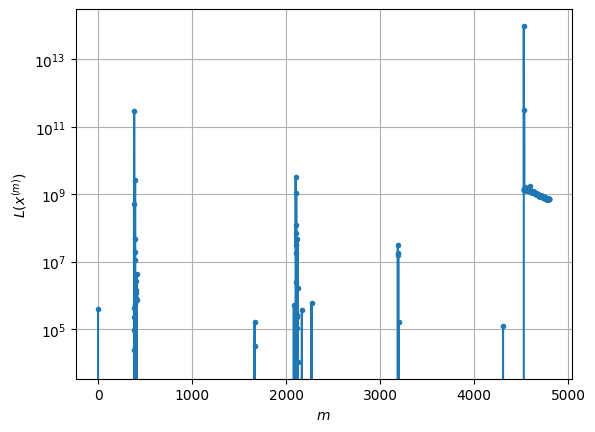

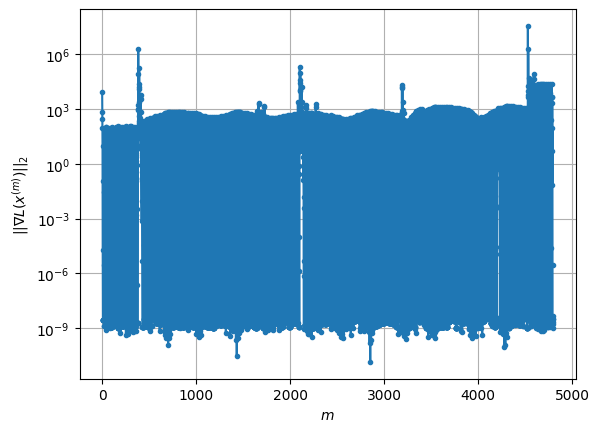

Windows:  80%|████████  | 316/395 [03:26<00:31,  2.52it/s]

Before applying the algorithm
Cost function: 717683121.5346861
Gradient norm: 23706.896628817256
Global relative error: 71959.18467999356
Position relative errors: 5.553439469468359 m, 4452.107954037644 m, 14695.066042533817 m, 70301.86195641899 m

Iteration 1
Cost function: 683446285.5278772 (-4.77%)
Gradient norm: 4349.263054232123 (-81.65%)
Global relative error: 75433.90957500992 (4.83%)
Position relative errors: 0.15392649349114937 m, 2981.8773014648805 m, 15406.179091792263 m, 73783.64699645313 m

Iteration 2
Cost function: 684470241.5173486 (0.15%)
Gradient norm: 2156.3625561826084 (-50.42%)
Global relative error: 75793.25549717774 (0.48%)
Position relative errors: 0.15392649349114937 m, 2736.0927417942853 m, 15649.36582454288 m, 74109.5305708665 m

Iteration 3
Cost function: 684139232.660908 (-0.05%)
Gradient norm: 4.326004877367067 (-99.80%)
Global relative error: 75435.95817202763 (-0.47%)
Position relative errors: 0.15392649349114937 m, 2749.068618980617 m, 15614.07754036273

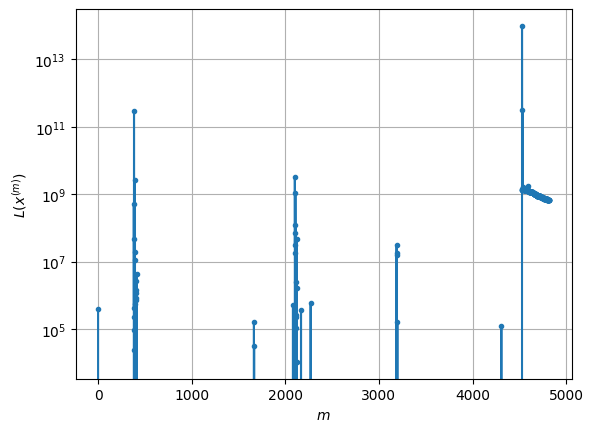

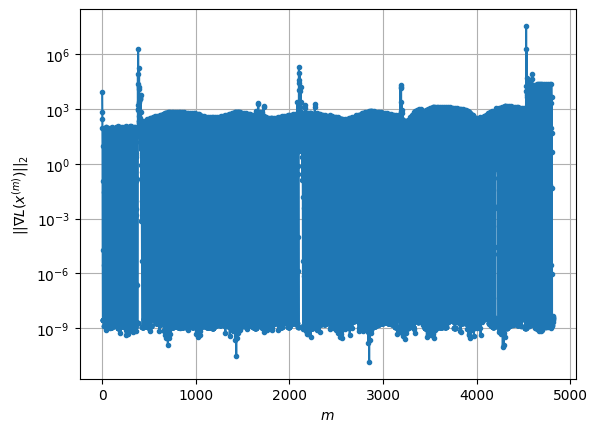

Windows:  80%|████████  | 317/395 [03:27<00:32,  2.41it/s]

Before applying the algorithm
Cost function: 690354504.8108096
Gradient norm: 23546.237187645227
Global relative error: 73135.09865992285
Position relative errors: 5.466314738919278 m, 4239.223504159776 m, 14050.264335160857 m, 71647.43338946912 m

Iteration 1
Cost function: 655063937.1708301 (-5.11%)
Gradient norm: 4094.3397829082774 (-82.61%)
Global relative error: 76627.0485927886 (4.77%)
Position relative errors: 0.10864444522401463 m, 2899.1444959936357 m, 14836.67094271784 m, 75121.00745828108 m

Iteration 2
Cost function: 656072255.2899095 (0.15%)
Gradient norm: 2049.1645134522023 (-49.95%)
Global relative error: 76984.06386649175 (0.47%)
Position relative errors: 0.10864444522401463 m, 2711.522000754153 m, 15047.917702017743 m, 75450.29449677105 m

Iteration 3
Cost function: 655770448.3114104 (-0.05%)
Gradient norm: 3.226819701319042 (-99.84%)
Global relative error: 76642.17377719632 (-0.44%)
Position relative errors: 0.10864444522401463 m, 2719.689441504893 m, 15015.6043315241

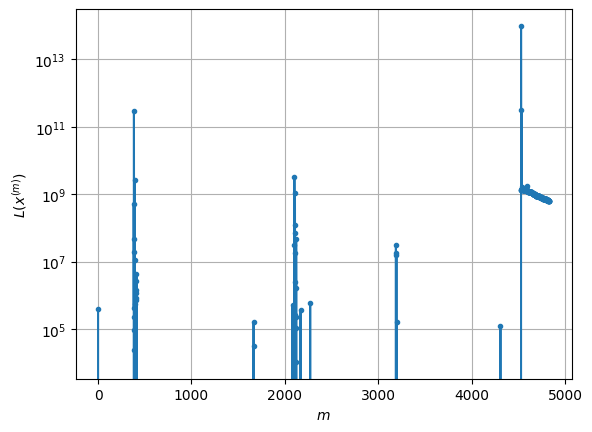

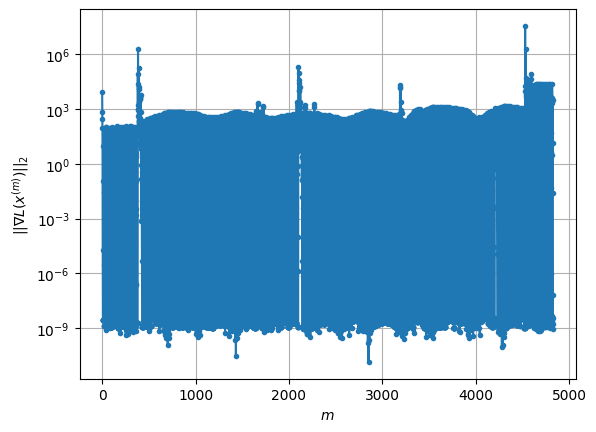

Windows:  81%|████████  | 318/395 [03:27<00:31,  2.42it/s]

Before applying the algorithm
Cost function: 665621993.7264438
Gradient norm: 23514.078564163723
Global relative error: 74306.48657039089
Position relative errors: 5.417802911601019 m, 3886.522049072101 m, 13457.349154694402 m, 72974.24784579706 m

Iteration 1
Cost function: 629376031.2169636 (-5.45%)
Gradient norm: 3836.3215690413167 (-83.69%)
Global relative error: 77823.4040557602 (4.73%)
Position relative errors: 0.22833749256320618 m, 2707.927338030993 m, 14308.127142603624 m, 76448.80036640869 m

Iteration 2
Cost function: 630319013.4312007 (0.15%)
Gradient norm: 1926.6858779988402 (-49.78%)
Global relative error: 78147.22656413983 (0.42%)
Position relative errors: 0.22833749256320618 m, 2588.3727977920275 m, 14490.690819768295 m, 76748.2993748161 m

Iteration 3
Cost function: 630050719.5367433 (-0.04%)
Gradient norm: 2.394119426807277 (-99.88%)
Global relative error: 77824.21004189279 (-0.41%)
Position relative errors: 0.22833749256320618 m, 2591.191197962368 m, 14461.1400432256

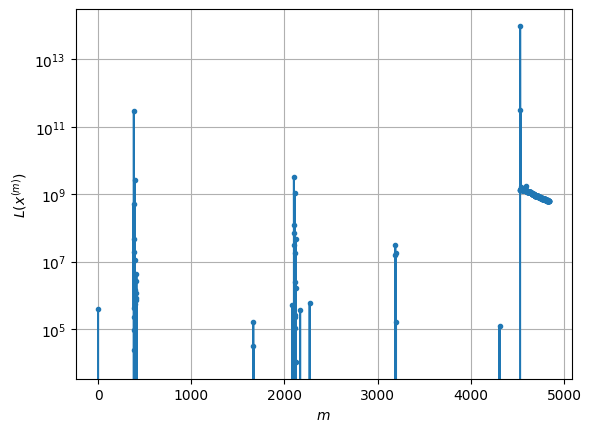

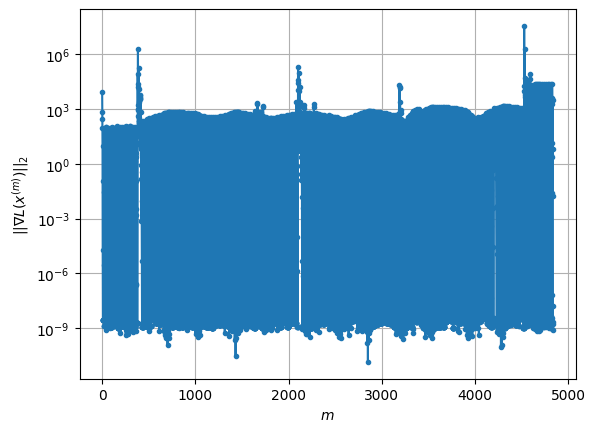

Windows:  81%|████████  | 319/395 [03:28<00:31,  2.41it/s]

Before applying the algorithm
Cost function: 642861573.389727
Gradient norm: 23185.24582870951
Global relative error: 75491.968567977
Position relative errors: 5.565509131610737 m, 3632.439183511388 m, 12877.62044384843 m, 74296.70896744725 m

Iteration 1
Cost function: 606435918.0942663 (-5.67%)
Gradient norm: 3464.420744073468 (-85.06%)
Global relative error: 78989.89621176575 (4.63%)
Position relative errors: 0.15052459082964087 m, 2539.9182658720506 m, 13790.60511254904 m, 77735.2116365103 m

Iteration 2
Cost function: 607232901.4357557 (0.13%)
Gradient norm: 1644.4531795053315 (-52.53%)
Global relative error: 79307.86716585346 (0.40%)
Position relative errors: 0.15052459082964087 m, 2424.05403415377 m, 13943.203497885717 m, 78034.86548619022 m

Iteration 3
Cost function: 607036340.0766854 (-0.03%)
Gradient norm: 1.396411335666004 (-99.92%)
Global relative error: 79031.02857021712 (-0.35%)
Position relative errors: 0.15052459082964087 m, 2424.3097050854544 m, 13918.337781916924 m, 

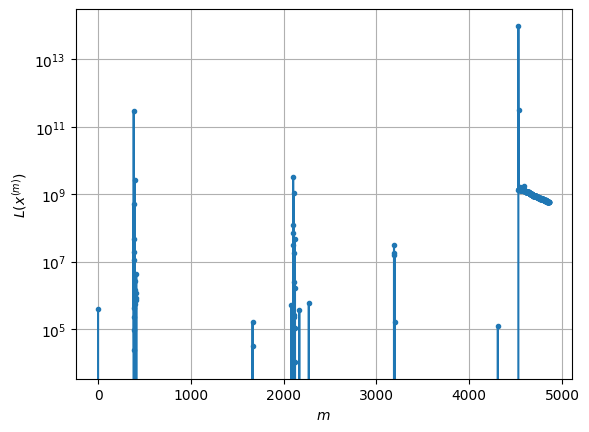

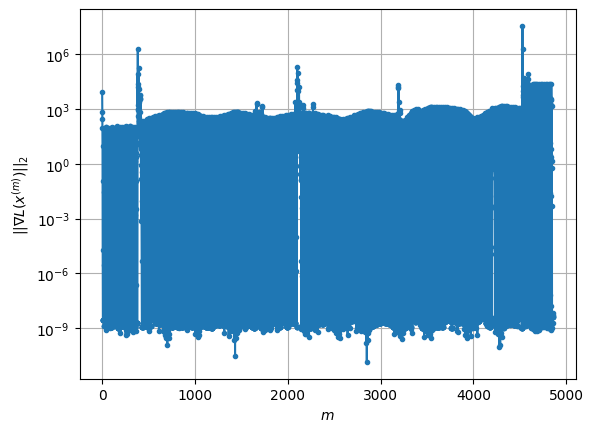

Windows:  81%|████████  | 320/395 [03:28<00:30,  2.48it/s]

Before applying the algorithm
Cost function: 623456042.8213071
Gradient norm: 23291.96182240233
Global relative error: 76608.59879323101
Position relative errors: 5.415261477826486 m, 3198.172098127781 m, 12372.184139332241 m, 75535.21490038054 m

Iteration 1
Cost function: 586201208.2666855 (-5.98%)
Gradient norm: 3227.5835269496233 (-86.14%)
Global relative error: 80137.14182938273 (4.61%)
Position relative errors: 0.10177021955906174 m, 2381.9944582408084 m, 13336.459372649757 m, 78983.65026909746 m

Iteration 2
Cost function: 586908298.6647259 (0.12%)
Gradient norm: 1525.8340215263117 (-52.73%)
Global relative error: 80385.46896201343 (0.31%)
Position relative errors: 0.10177021955906174 m, 2358.2050412887265 m, 13466.798021075927 m, 79214.25626572236 m

Iteration 3
Cost function: 586738802.8045566 (-0.03%)
Gradient norm: 1.0337376619199032 (-99.93%)
Global relative error: 80128.38649073268 (-0.32%)
Position relative errors: 0.10177021955906174 m, 2353.8648867147276 m, 13443.664185

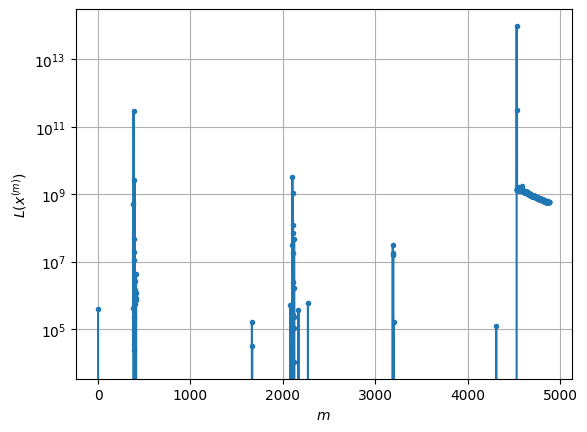

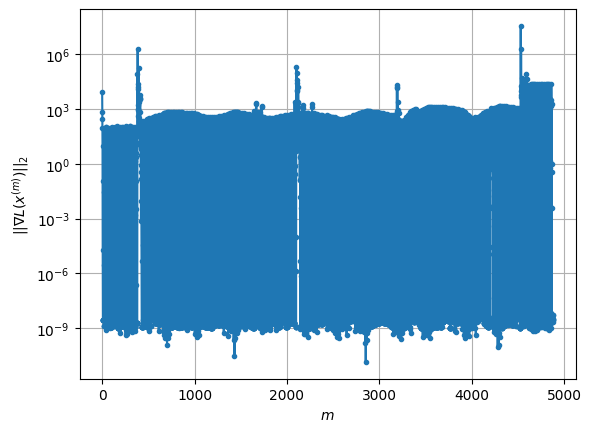

Windows:  81%|████████▏ | 321/395 [03:29<00:30,  2.42it/s]

Before applying the algorithm
Cost function: 605662844.69475
Gradient norm: 22969.598884573974
Global relative error: 77732.91010106131
Position relative errors: 5.442066925570728 m, 2962.072310821565 m, 11880.699679875675 m, 76762.42619214547 m

Iteration 1
Cost function: 568705866.750968 (-6.10%)
Gradient norm: 2821.637630281102 (-87.72%)
Global relative error: 81225.04430075365 (4.49%)
Position relative errors: 0.24549563274078814 m, 2356.082125725005 m, 12894.620246831535 m, 80160.30910809223 m

Iteration 2
Cost function: 569240516.5510447 (0.09%)
Gradient norm: 1210.3256889333343 (-57.11%)
Global relative error: 81437.85017546211 (0.26%)
Position relative errors: 0.24549563274078814 m, 2344.071881784718 m, 13000.592058432761 m, 80359.21268456354 m

Iteration 3
Cost function: 569133644.4760782 (-0.02%)
Gradient norm: 0.508223009732955 (-99.96%)
Global relative error: 81234.24231032704 (-0.25%)
Position relative errors: 0.24549563274078814 m, 2339.4220550188047 m, 12981.390557343964

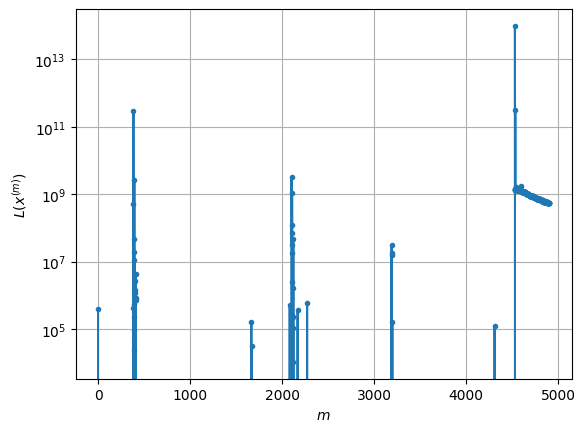

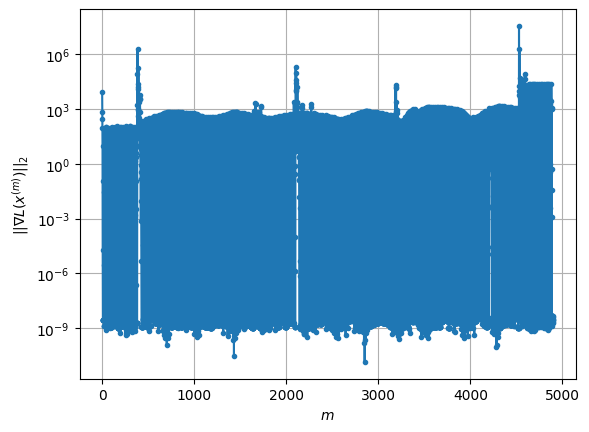

Windows:  82%|████████▏ | 322/395 [03:29<00:30,  2.37it/s]

Before applying the algorithm
Cost function: 590605914.3206856
Gradient norm: 22682.002678166267
Global relative error: 78817.03032210571
Position relative errors: 5.577525451877991 m, 2694.371361772397 m, 11444.825294711667 m, 77935.03309642657 m

Iteration 1
Cost function: 554061028.677672 (-6.19%)
Gradient norm: 2433.482080773538 (-89.27%)
Global relative error: 82271.92155248443 (4.38%)
Position relative errors: 0.17660521799987988 m, 2344.301396733158 m, 12499.966935699382 m, 81282.91925484982 m

Iteration 2
Cost function: 554448366.2470379 (0.07%)
Gradient norm: 935.4094517159417 (-61.56%)
Global relative error: 82435.68123248601 (0.20%)
Position relative errors: 0.17660521799987988 m, 2353.966428026796 m, 12585.465537162192 m, 81435.22117988787 m

Iteration 3
Cost function: 554384512.1682328 (-0.01%)
Gradient norm: 0.2495796938601064 (-99.97%)
Global relative error: 82279.17768092848 (-0.19%)
Position relative errors: 0.17660521799987988 m, 2349.9141234655763 m, 12569.2161119989

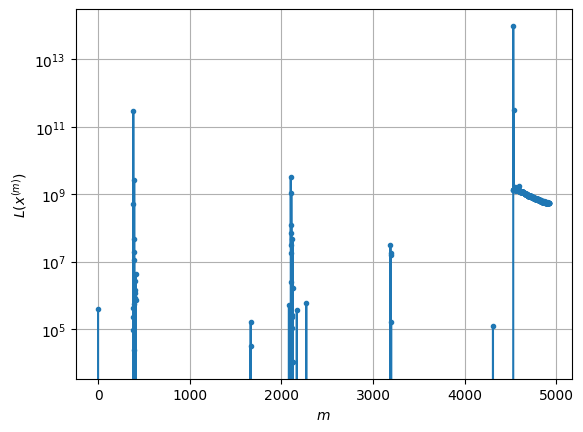

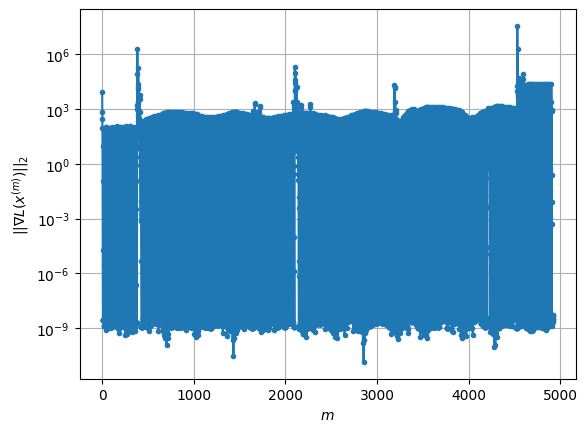

Windows:  82%|████████▏ | 323/395 [03:29<00:29,  2.46it/s]

Before applying the algorithm
Cost function: 577764973.2866865
Gradient norm: 22235.527054413444
Global relative error: 79887.2488018357
Position relative errors: 5.472380734228645 m, 2463.827997698332 m, 11056.265360933148 m, 79080.01615063056 m

Iteration 1
Cost function: 542211752.1434222 (-6.15%)
Gradient norm: 1950.9100959828622 (-91.23%)
Global relative error: 83274.90130331914 (4.24%)
Position relative errors: 0.28105552425840286 m, 2338.4746448063615 m, 12143.696263048136 m, 82351.43763009323 m

Iteration 2
Cost function: 542445740.7630078 (0.04%)
Gradient norm: 602.0852426559194 (-69.14%)
Global relative error: 83396.25080630762 (0.15%)
Position relative errors: 0.28105552425840286 m, 2339.6486946307305 m, 12209.073441843462 m, 82464.45982048941 m

Iteration 3
Cost function: 542419320.6122203 (-0.00%)
Gradient norm: 0.11473201658254908 (-99.98%)
Global relative error: 83296.80743080493 (-0.12%)
Position relative errors: 0.28105552425840286 m, 2338.062899658752 m, 12196.4959212

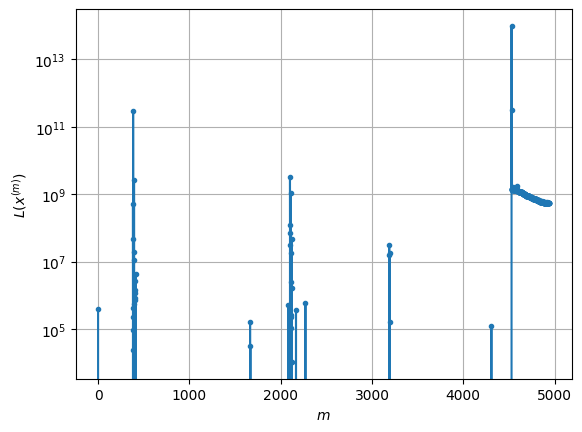

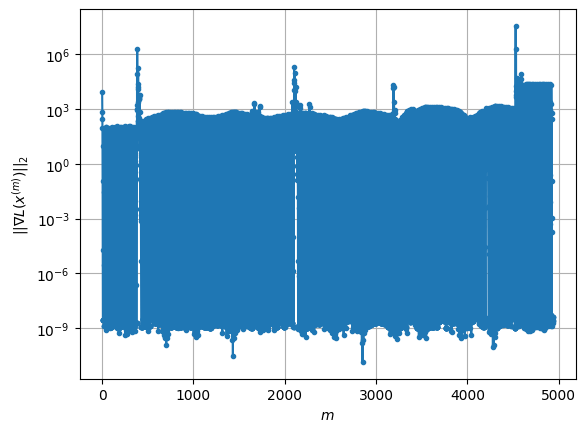

Windows:  82%|████████▏ | 324/395 [03:30<00:28,  2.50it/s]

Before applying the algorithm
Cost function: 568233450.5563862
Gradient norm: 22036.972272056333
Global relative error: 80895.50773433386
Position relative errors: 5.173597430987877 m, 2080.9302276833723 m, 10734.010734299518 m, 80153.10922853238 m

Iteration 1
Cost function: 533100106.9005182 (-6.18%)
Gradient norm: 1548.8357894753585 (-92.97%)
Global relative error: 84250.22680184881 (4.15%)
Position relative errors: 0.09663427096530562 m, 2191.0162306077764 m, 11855.145842706544 m, 83383.10807535914 m

Iteration 2
Cost function: 533237969.22629786 (0.03%)
Gradient norm: 368.50672444200933 (-76.21%)
Global relative error: 84328.438092613 (0.09%)
Position relative errors: 0.09663427096530562 m, 2193.0011559747104 m, 11904.081612591714 m, 83455.11421865648 m

Iteration 3
Cost function: 533228105.75765306 (-0.00%)
Gradient norm: 0.06925553125665625 (-99.98%)
Global relative error: 84268.94410480408 (-0.07%)
Position relative errors: 0.09663427096530562 m, 2193.353603375442 m, 11894.1891

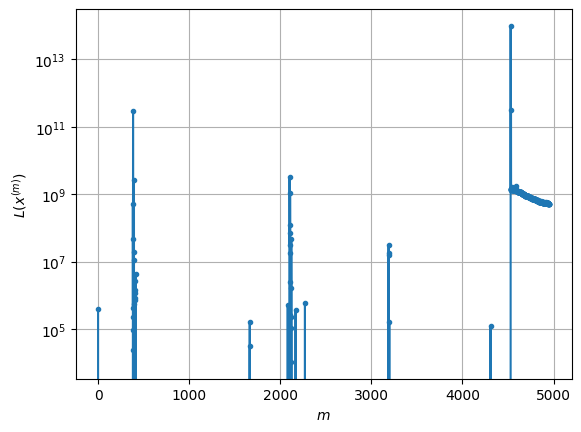

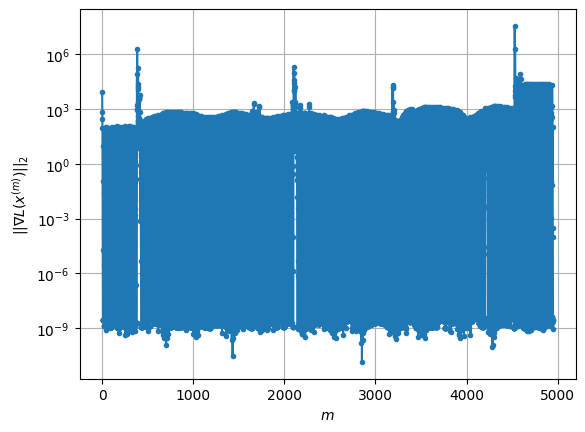

Windows:  82%|████████▏ | 325/395 [03:30<00:29,  2.36it/s]

Before applying the algorithm
Cost function: 561723411.8118285
Gradient norm: 21928.921289719416
Global relative error: 81825.96870863052
Position relative errors: 5.38950410130133 m, 1723.0064573121474 m, 10475.025514490677 m, 81134.33541384322 m

Iteration 1
Cost function: 526802586.58346367 (-6.22%)
Gradient norm: 1205.6782144199278 (-94.50%)
Global relative error: 85161.03873848214 (4.08%)
Position relative errors: 0.19540530939577516 m, 2105.186276928382 m, 11624.557000419063 m, 84337.57497124677 m

Iteration 2
Cost function: 526880026.3608798 (0.01%)
Gradient norm: 196.78941354966312 (-83.68%)
Global relative error: 85198.92314076009 (0.04%)
Position relative errors: 0.19540530939577516 m, 2117.7554082931483 m, 11658.428259034163 m, 84370.84113978429 m

Iteration 3
Cost function: 526877231.2745472 (-0.00%)
Gradient norm: 0.040774388219015655 (-99.98%)
Global relative error: 85168.64401475599 (-0.04%)
Position relative errors: 0.19540530939577516 m, 2119.5968398326822 m, 11650.818

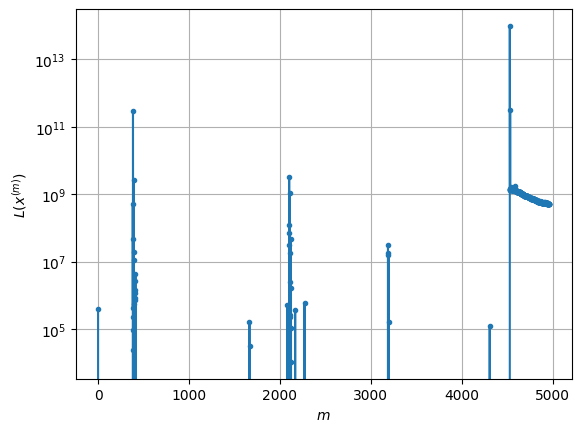

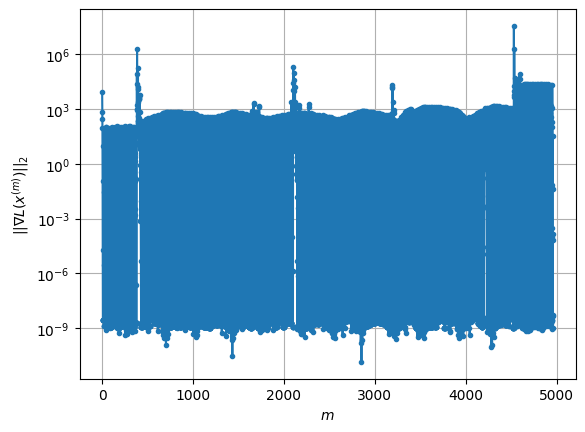

Windows:  83%|████████▎ | 326/395 [03:31<00:27,  2.50it/s]

Before applying the algorithm
Cost function: 557099272.0530628
Gradient norm: 21483.831730829337
Global relative error: 82730.99628488689
Position relative errors: 5.608189975438039 m, 1546.461614679751 m, 10278.595398186126 m, 82075.3432034326 m

Iteration 1
Cost function: 523504060.7039657 (-6.03%)
Gradient norm: 841.0014094530584 (-96.09%)
Global relative error: 85982.67159134697 (3.93%)
Position relative errors: 0.15163459337794666 m, 2175.027006340756 m, 11442.701511011574 m, 85190.01683074361 m

Iteration 2
Cost function: 523540384.53439105 (0.01%)
Gradient norm: 43.58374571886875 (-94.82%)
Global relative error: 85973.1838786048 (-0.01%)
Position relative errors: 0.15163459337794666 m, 2235.428097867221 m, 11453.184335332313 m, 85177.46820615139 m

Iteration 3
Cost function: 523540236.5994279 (-0.00%)
Gradient norm: 1.051932743374442 (-97.59%)
Global relative error: 85963.06189997817 (-0.01%)
Position relative errors: 0.15163459337794666 m, 2252.7955531522075 m, 11449.7756529587

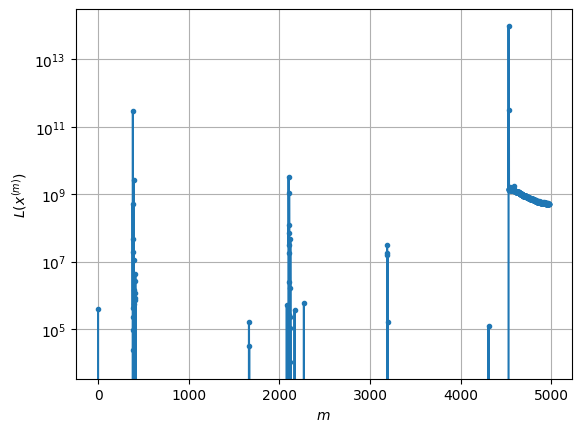

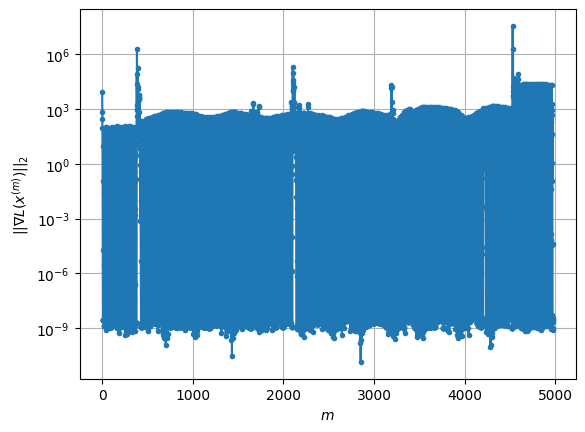

Windows:  83%|████████▎ | 327/395 [03:31<00:26,  2.56it/s]

Before applying the algorithm
Cost function: 554794923.2331779
Gradient norm: 20918.394331646603
Global relative error: 83606.74504543381
Position relative errors: 5.546358654809817 m, 1337.6985726209089 m, 10150.461857705654 m, 82977.4122806004 m

Iteration 1
Cost function: 522944253.06152683 (-5.74%)
Gradient norm: 534.0976403353067 (-97.45%)
Global relative error: 86748.04462709477 (3.76%)
Position relative errors: 0.18160484480801317 m, 2156.146554770333 m, 11323.063760949946 m, 85978.75889742679 m

Iteration 2
Cost function: 523000503.13731587 (0.01%)
Gradient norm: 673.1896271813097 (26.04%)
Global relative error: 86743.69903379136 (-0.01%)
Position relative errors: 0.18160484480801317 m, 2374.6939174013132 m, 11290.097837591617 m, 85972.9510805512 m

Iteration 3
Cost function: 522967397.3008954 (-0.01%)
Gradient norm: 0.2555594654510177 (-99.96%)
Global relative error: 86634.30054145893 (-0.13%)
Position relative errors: 0.18160484480801317 m, 2385.4242378316944 m, 11294.5121689

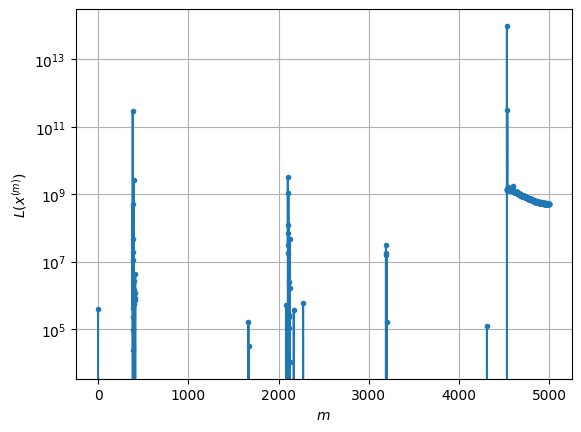

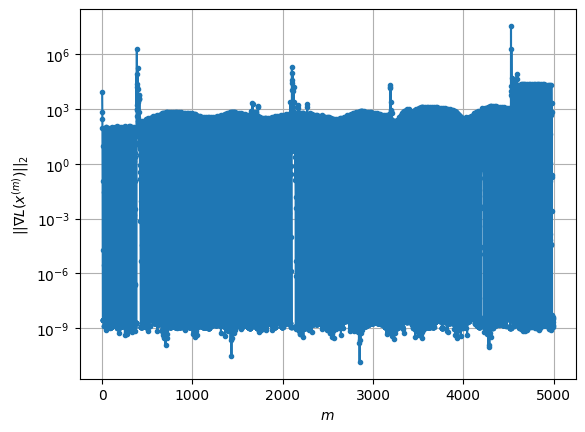

Windows:  83%|████████▎ | 328/395 [03:31<00:26,  2.53it/s]

Before applying the algorithm
Cost function: 555253017.3615522
Gradient norm: 20325.019479362887
Global relative error: 84412.52293635768
Position relative errors: 5.609714837780386 m, 1240.501043751239 m, 10100.257887516795 m, 83796.79944757256 m

Iteration 1
Cost function: 525339851.51790303 (-5.39%)
Gradient norm: 820.1967224532718 (-95.96%)
Global relative error: 87428.00785371443 (3.57%)
Position relative errors: 0.2791456738153517 m, 2231.424703107617 m, 11272.730494878448 m, 86669.40925755641 m

Iteration 2
Cost function: 525406838.047106 (0.01%)
Gradient norm: 232.95595868332086 (-71.60%)
Global relative error: 87396.4867226329 (-0.04%)
Position relative errors: 0.2791456738153517 m, 2316.8894305827553 m, 11260.833039526873 m, 86636.91595897304 m

Iteration 3
Cost function: 525402801.7088874 (-0.00%)
Gradient norm: 0.25792336844199926 (-99.89%)
Global relative error: 87353.0664580204 (-0.05%)
Position relative errors: 0.2791456738153517 m, 2317.911929204172 m, 11261.35937741296

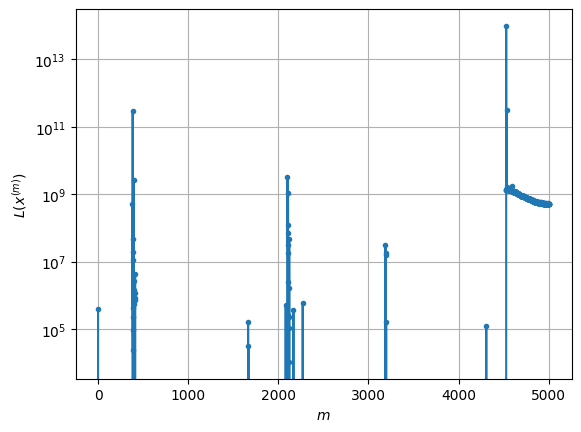

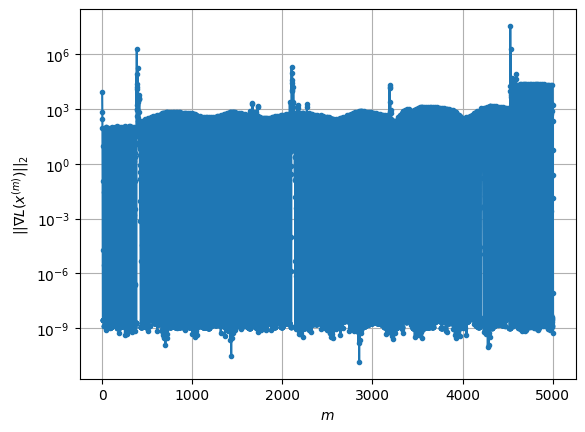

Windows:  83%|████████▎ | 329/395 [03:32<00:28,  2.35it/s]

Before applying the algorithm
Cost function: 558595345.3612839
Gradient norm: 19729.23533548302
Global relative error: 85156.39278331723
Position relative errors: 5.331079128800738 m, 1137.3189747885497 m, 10127.07133015377 m, 84544.32559646294 m

Iteration 1
Cost function: 530706222.2330303 (-4.99%)
Gradient norm: 1248.268564150352 (-93.67%)
Global relative error: 88038.80793062886 (3.38%)
Position relative errors: 0.06435302990996371 m, 2237.6277599088367 m, 11291.333015615106 m, 87282.95009835289 m

Iteration 2
Cost function: 530845837.335218 (0.03%)
Gradient norm: 287.42546047706725 (-76.97%)
Global relative error: 88003.86138916359 (-0.04%)
Position relative errors: 0.06435302990996371 m, 2306.974489542011 m, 11279.29952664765 m, 87247.4512268566 m

Iteration 3
Cost function: 530839680.80395085 (-0.00%)
Gradient norm: 0.29706251714520504 (-99.90%)
Global relative error: 87950.07870330701 (-0.06%)
Position relative errors: 0.06435302990996371 m, 2304.6237674106087 m, 11279.01147774

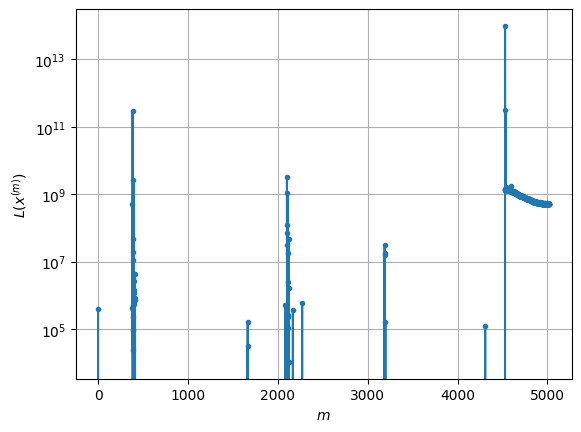

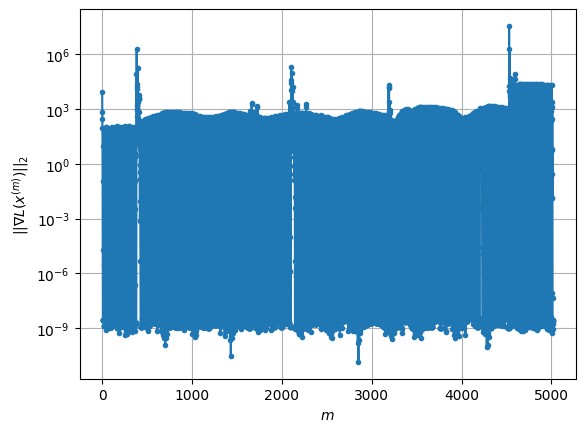

Windows:  84%|████████▎ | 330/395 [03:32<00:26,  2.48it/s]

Before applying the algorithm
Cost function: 565103136.2403023
Gradient norm: 19221.6569377197
Global relative error: 85826.41812727269
Position relative errors: 5.514804276410235 m, 1043.0198439774774 m, 10228.917194297794 m, 85208.20076558985 m

Iteration 1
Cost function: 539007974.2040625 (-4.62%)
Gradient norm: 1665.3672080859844 (-91.34%)
Global relative error: 88590.08244871379 (3.22%)
Position relative errors: 0.28546553194040547 m, 2167.497951724311 m, 11378.290899066598 m, 87829.50104584068 m

Iteration 2
Cost function: 539239616.7050577 (0.04%)
Gradient norm: 388.7062400111149 (-76.66%)
Global relative error: 88562.06255164286 (-0.03%)
Position relative errors: 0.28546553194040547 m, 2243.002477517382 m, 11365.286046555486 m, 87801.02637903987 m

Iteration 3
Cost function: 539228343.9438134 (-0.00%)
Gradient norm: 0.29646566648742434 (-99.92%)
Global relative error: 88490.02304590949 (-0.08%)
Position relative errors: 0.28546553194040547 m, 2235.664482150299 m, 11365.17056430

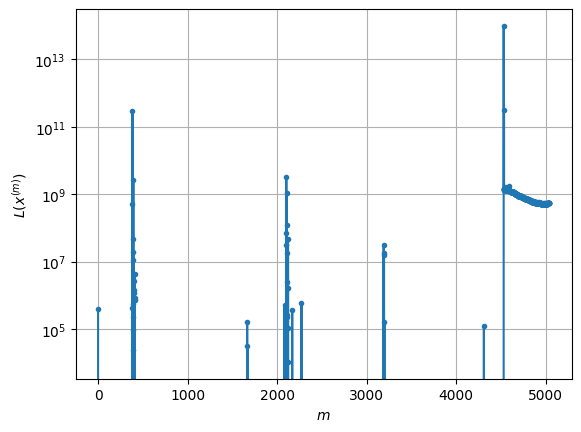

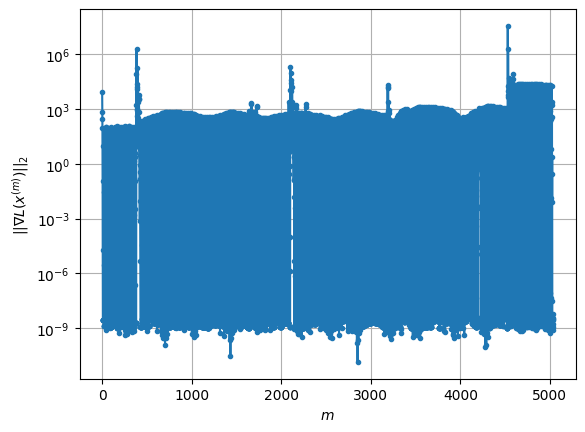

Windows:  84%|████████▍ | 331/395 [03:33<00:25,  2.56it/s]

Before applying the algorithm
Cost function: 573984347.7656057
Gradient norm: 18489.262404251036
Global relative error: 86460.01863231875
Position relative errors: 5.650210948244953 m, 1032.4626905829446 m, 10411.40807771339 m, 85824.54638977181 m

Iteration 1
Cost function: 550442064.5193112 (-4.10%)
Gradient norm: 2202.2015429430126 (-88.09%)
Global relative error: 89049.66416567676 (3.00%)
Position relative errors: 0.16893365699309068 m, 2145.286422210793 m, 11529.348541479241 m, 88273.98216218207 m

Iteration 2
Cost function: 550812133.9309766 (0.07%)
Gradient norm: 547.5174273256638 (-75.14%)
Global relative error: 89015.11963554437 (-0.04%)
Position relative errors: 0.16893365699309068 m, 2247.609352470748 m, 11520.293556492867 m, 88237.76959258913 m

Iteration 3
Cost function: 550789758.3929241 (-0.00%)
Gradient norm: 0.35113544915501615 (-99.94%)
Global relative error: 88914.1914767544 (-0.11%)
Position relative errors: 0.16893365699309068 m, 2235.0802626824952 m, 11520.1525223

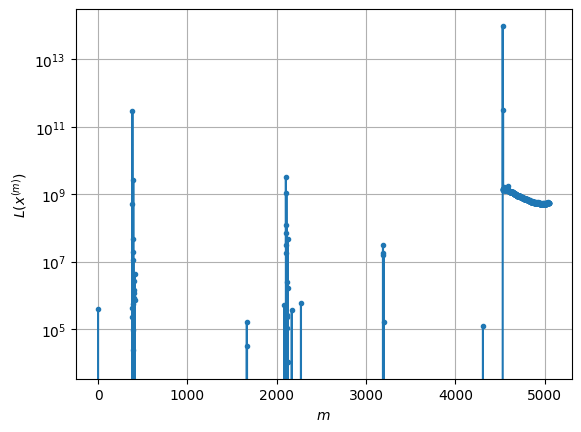

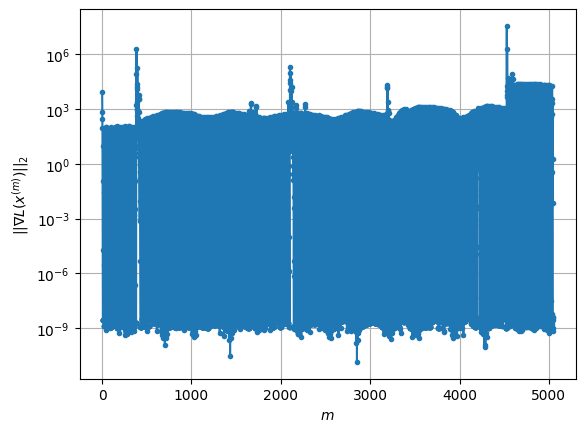

Windows:  84%|████████▍ | 332/395 [03:33<00:24,  2.54it/s]

Before applying the algorithm
Cost function: 586664306.3537954
Gradient norm: 18015.164939280465
Global relative error: 86983.91822484571
Position relative errors: 5.457494716489189 m, 1109.447581220542 m, 10662.144507614745 m, 86320.74198104638 m

Iteration 1
Cost function: 565030308.2167647 (-3.69%)
Gradient norm: 2619.022419522192 (-85.46%)
Global relative error: 89444.40533083362 (2.83%)
Position relative errors: 0.22342014157270404 m, 2042.1474718876746 m, 11748.760521055521 m, 88645.80418999655 m

Iteration 2
Cost function: 565516670.7310852 (0.09%)
Gradient norm: 677.4764098647206 (-74.13%)
Global relative error: 89420.95320954769 (-0.03%)
Position relative errors: 0.22342014157270404 m, 2178.8542696029344 m, 11747.654791669107 m, 88619.03164362904 m

Iteration 3
Cost function: 565482417.2665541 (-0.01%)
Gradient norm: 0.34810881407505345 (-99.95%)
Global relative error: 89296.79842991229 (-0.14%)
Position relative errors: 0.22342014157270404 m, 2161.466310477979 m, 11747.259456

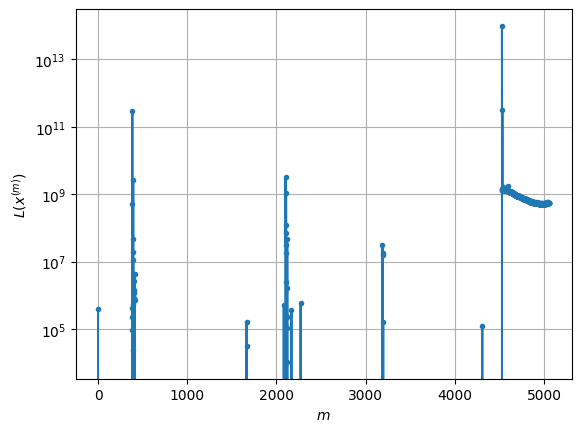

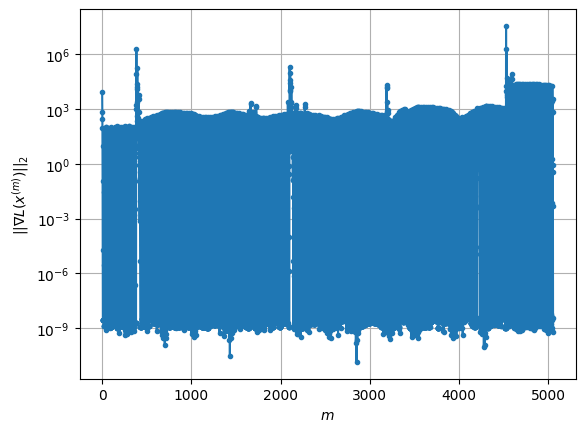

Windows:  84%|████████▍ | 333/395 [03:33<00:26,  2.37it/s]

Before applying the algorithm
Cost function: 601541964.7202715
Gradient norm: 17265.119529488424
Global relative error: 87485.53391248055
Position relative errors: 5.409369424066893 m, 1220.9458723888038 m, 10993.766328688987 m, 86783.32254175542 m

Iteration 1
Cost function: 582758406.0144863 (-3.12%)
Gradient norm: 3155.495956055904 (-81.72%)
Global relative error: 89745.34067037905 (2.58%)
Position relative errors: 0.040324289591770375 m, 2002.2292418955572 m, 12023.340660327409 m, 88913.64683263392 m

Iteration 2
Cost function: 583388955.612383 (0.11%)
Gradient norm: 817.1004732636753 (-74.11%)
Global relative error: 89708.39827422773 (-0.04%)
Position relative errors: 0.040324289591770375 m, 2173.1092049159674 m, 12040.784275946598 m, 88869.98309293432 m

Iteration 3
Cost function: 583339127.4839509 (-0.01%)
Gradient norm: 0.39465829606187025 (-99.95%)
Global relative error: 89559.20008506291 (-0.17%)
Position relative errors: 0.040324289591770375 m, 2152.3963751899173 m, 12039.78

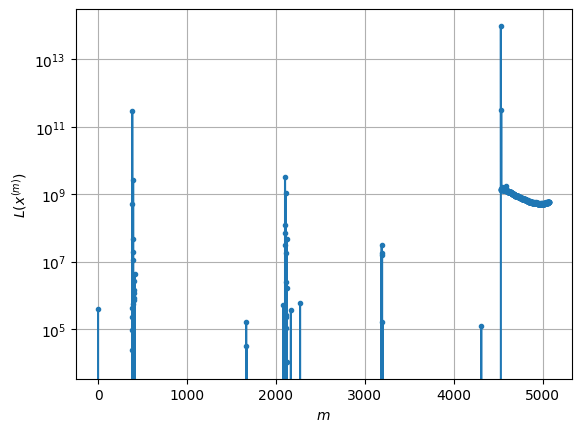

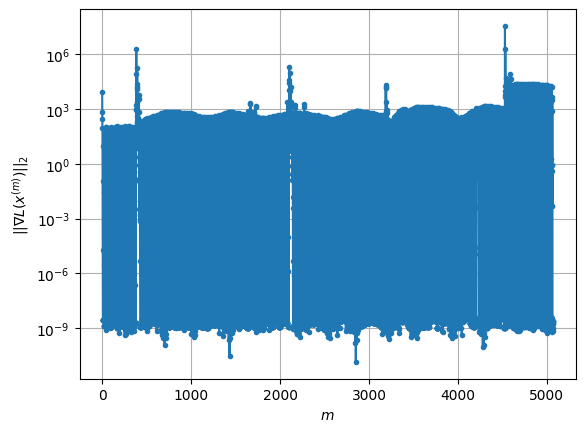

Windows:  85%|████████▍ | 334/395 [03:34<00:24,  2.48it/s]

Before applying the algorithm
Cost function: 620089717.3220061
Gradient norm: 16667.37795343062
Global relative error: 87898.60775126128
Position relative errors: 5.640757131426805 m, 1373.92377804615 m, 11389.701607550063 m, 87146.61051795223 m

Iteration 1
Cost function: 603887622.4469775 (-2.61%)
Gradient norm: 3632.222505984266 (-78.21%)
Global relative error: 89975.27344977761 (2.36%)
Position relative errors: 0.19220268043610708 m, 1912.7618249238235 m, 12359.495319697422 m, 89101.70330134788 m

Iteration 2
Cost function: 604617018.8393021 (0.12%)
Gradient norm: 915.0018044249407 (-74.81%)
Global relative error: 89929.63510412053 (-0.05%)
Position relative errors: 0.19220268043610708 m, 2124.418047064989 m, 12402.149938309265 m, 89044.88910670251 m

Iteration 3
Cost function: 604554564.3590932 (-0.01%)
Gradient norm: 0.46545230692849493 (-99.95%)
Global relative error: 89763.26422163611 (-0.19%)
Position relative errors: 0.19220268043610708 m, 2102.3346746809502 m, 12400.15491380

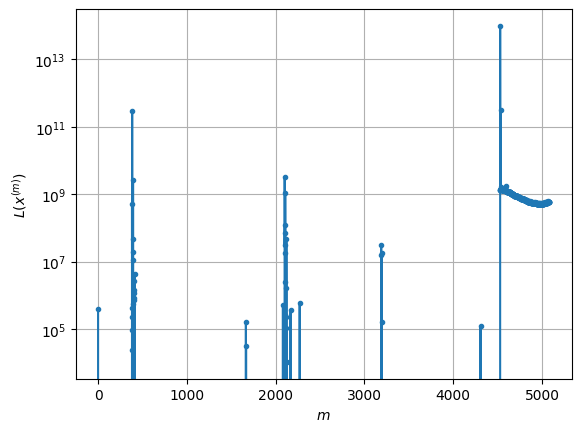

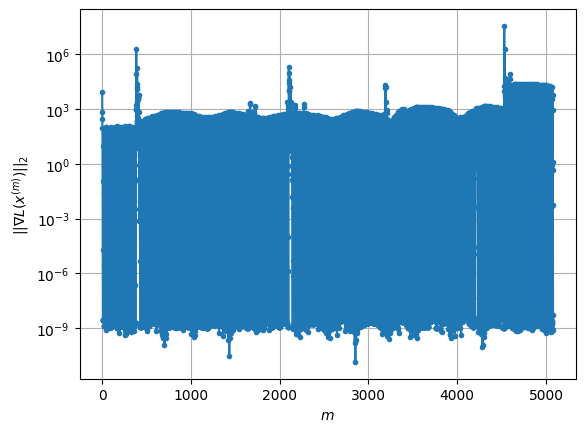

Windows:  85%|████████▍ | 335/395 [03:34<00:23,  2.60it/s]

Before applying the algorithm
Cost function: 642541823.0639671
Gradient norm: 16306.525537764488
Global relative error: 88201.71326659743
Position relative errors: 5.587121061401989 m, 1603.5326155619096 m, 11839.8392115128 m, 87388.60364206208 m

Iteration 1
Cost function: 628366511.5602287 (-2.21%)
Gradient norm: 3971.781235217483 (-75.64%)
Global relative error: 90149.01896773544 (2.21%)
Position relative errors: 0.1529689180275453 m, 1718.0245673627849 m, 12751.70121410377 m, 89225.93284757415 m

Iteration 2
Cost function: 629119189.6643145 (0.12%)
Gradient norm: 967.6555790577768 (-75.64%)
Global relative error: 90115.60866811755 (-0.04%)
Position relative errors: 0.1529689180275453 m, 1982.25935096461 m, 12822.04194797356 m, 89176.61003714903 m

Iteration 3
Cost function: 629049406.1890166 (-0.01%)
Gradient norm: 0.48806189694448116 (-99.95%)
Global relative error: 89940.61622143151 (-0.19%)
Position relative errors: 0.1529689180275453 m, 1958.6883477503875 m, 12818.838196308383 

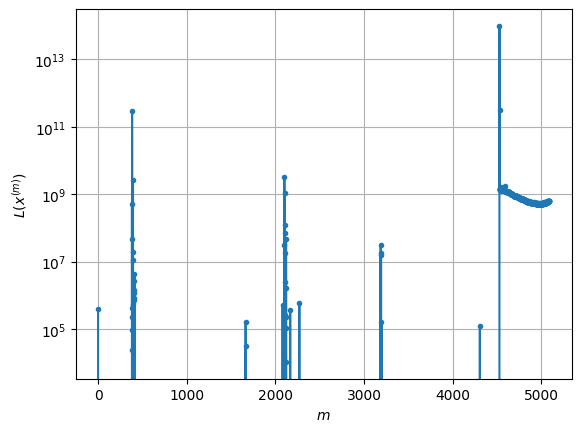

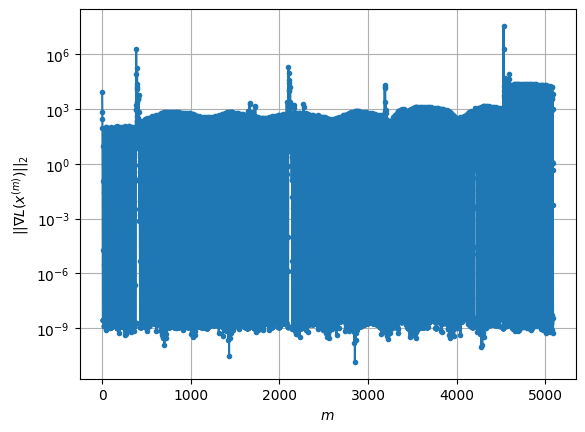

Windows:  85%|████████▌ | 336/395 [03:35<00:22,  2.59it/s]

Before applying the algorithm
Cost function: 668038233.6714263
Gradient norm: 15871.777299959625
Global relative error: 88460.7617469997
Position relative errors: 5.604582687127609 m, 1868.777798841732 m, 12351.948257145863 m, 87574.09372996027 m

Iteration 1
Cost function: 656370071.6469804 (-1.75%)
Gradient norm: 4376.2841494991035 (-72.43%)
Global relative error: 90238.33093953875 (2.01%)
Position relative errors: 0.18390578813801278 m, 1587.8878541379206 m, 13192.316801374414 m, 89254.55882855042 m

Iteration 2
Cost function: 657097282.3905319 (0.11%)
Gradient norm: 981.9551142440542 (-77.56%)
Global relative error: 90199.02574660466 (-0.04%)
Position relative errors: 0.18390578813801278 m, 1889.5308242598583 m, 13299.928740905558 m, 89192.96118942488 m

Iteration 3
Cost function: 657025504.0747731 (-0.01%)
Gradient norm: 0.6106888734817936 (-99.94%)
Global relative error: 90022.24776380237 (-0.20%)
Position relative errors: 0.18390578813801278 m, 1867.856296252848 m, 13295.6968755

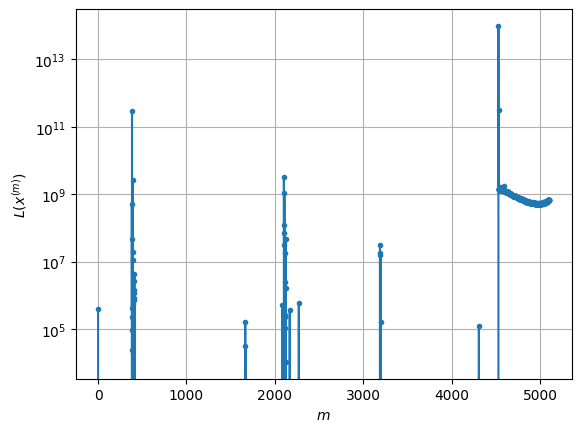

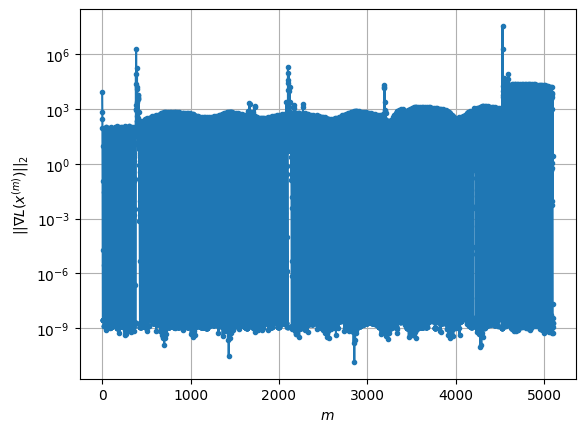

Windows:  85%|████████▌ | 337/395 [03:35<00:24,  2.39it/s]

Before applying the algorithm
Cost function: 697798365.9905853
Gradient norm: 15694.006149164114
Global relative error: 88589.62630136484
Position relative errors: 5.845527507180225 m, 2310.5129576874306 m, 12901.06287777345 m, 87614.63410354832 m

Iteration 1
Cost function: 687974238.0753232 (-1.41%)
Gradient norm: 4623.323701468492 (-70.54%)
Global relative error: 90264.30311125865 (1.89%)
Position relative errors: 0.08615724208896365 m, 1480.804716552258 m, 13683.404052569811 m, 89208.71165775563 m

Iteration 2
Cost function: 688607156.8587347 (0.09%)
Gradient norm: 969.899570177789 (-79.02%)
Global relative error: 90248.91191423716 (-0.02%)
Position relative errors: 0.08615724208896365 m, 1800.3177885658604 m, 13825.880679466045 m, 89165.28545095863 m

Iteration 3
Cost function: 688537224.6435972 (-0.01%)
Gradient norm: 0.5786876125114282 (-99.94%)
Global relative error: 90075.45525798041 (-0.19%)
Position relative errors: 0.08615724208896365 m, 1779.2163121313458 m, 13820.65873146

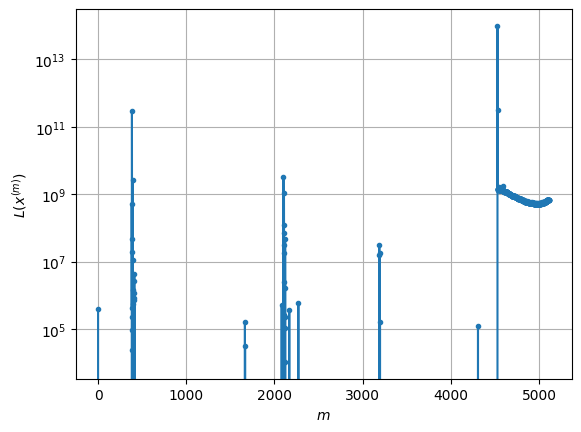

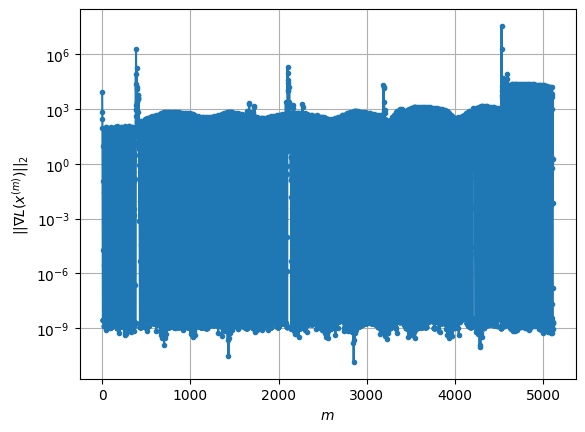

Windows:  86%|████████▌ | 338/395 [03:35<00:23,  2.39it/s]

Before applying the algorithm
Cost function: 729308804.5524715
Gradient norm: 15124.342986640873
Global relative error: 88784.59406437572
Position relative errors: 5.639810519993992 m, 2484.6428267779884 m, 13539.4804181681 m, 87710.8371989111 m

Iteration 1
Cost function: 723196516.8525372 (-0.84%)
Gradient norm: 5227.994523787894 (-65.43%)
Global relative error: 90189.44180216255 (1.58%)
Position relative errors: 0.07741772214781611 m, 1478.9162284416977 m, 14210.53104538013 m, 89050.47365125689 m

Iteration 2
Cost function: 723569132.257081 (0.05%)
Gradient norm: 869.8071575764229 (-83.36%)
Global relative error: 90111.55051532263 (-0.09%)
Position relative errors: 0.07741772214781611 m, 1794.7527160543154 m, 14412.36327230768 m, 88933.3009316577 m

Iteration 3
Cost function: 723513451.258404 (-0.01%)
Gradient norm: 0.9853592309747422 (-99.89%)
Global relative error: 89956.83745480649 (-0.17%)
Position relative errors: 0.07741772214781611 m, 1784.801070726333 m, 14407.604355254998 m

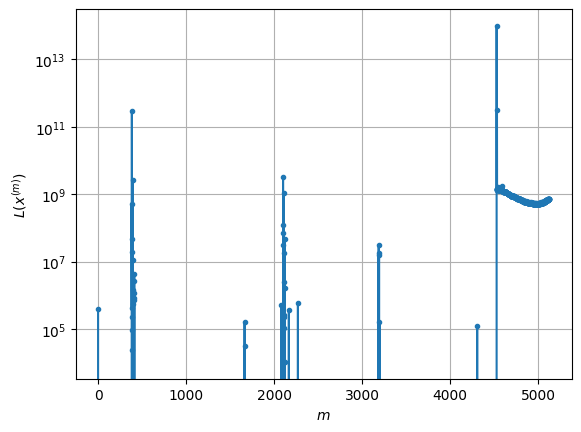

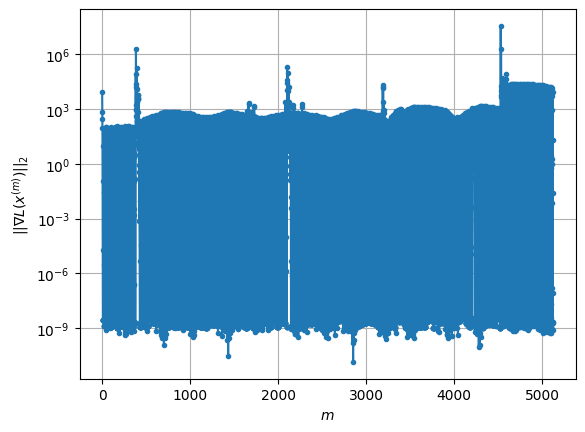

Windows:  86%|████████▌ | 339/395 [03:36<00:22,  2.53it/s]

Before applying the algorithm
Cost function: 765621097.1202447
Gradient norm: 14955.267710472715
Global relative error: 88836.76580080832
Position relative errors: 5.712459215674757 m, 2801.0021881961593 m, 14197.620883967977 m, 87650.04539545135 m

Iteration 1
Cost function: 762188088.4722625 (-0.45%)
Gradient norm: 5625.131336281593 (-62.39%)
Global relative error: 90077.54099514885 (1.40%)
Position relative errors: 0.1146490694116944 m, 1360.273290820267 m, 14786.381610075721 m, 88845.10989192055 m

Iteration 2
Cost function: 762210689.277548 (0.00%)
Gradient norm: 775.4738280706108 (-86.21%)
Global relative error: 89984.96788570828 (-0.10%)
Position relative errors: 0.1146490694116944 m, 1678.209858137445 m, 15038.63015957744 m, 88703.41168470732 m

Iteration 3
Cost function: 762167171.2528908 (-0.01%)
Gradient norm: 1.1958344847916296 (-99.85%)
Global relative error: 89848.06592221069 (-0.15%)
Position relative errors: 0.1146490694116944 m, 1672.5643417180625 m, 15034.368273356135

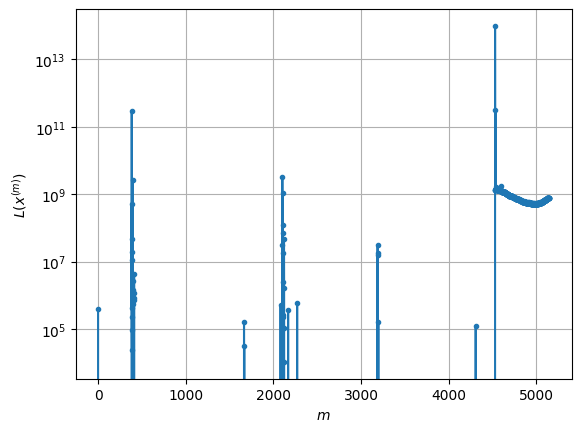

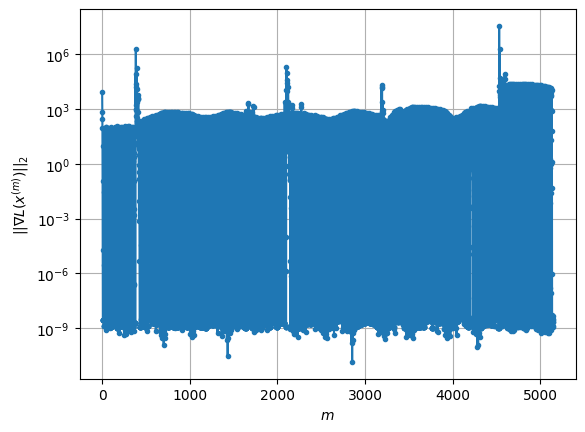

Windows:  86%|████████▌ | 340/395 [03:36<00:21,  2.58it/s]

Before applying the algorithm
Cost function: 806066751.638467
Gradient norm: 14982.915480309282
Global relative error: 88770.38387095745
Position relative errors: 5.6731988760930525 m, 3272.2565136304943 m, 14879.8953524613 m, 87453.07027728234 m

Iteration 1
Cost function: 804807780.4081122 (-0.16%)
Gradient norm: 5900.945552345725 (-60.62%)
Global relative error: 89906.97349365753 (1.28%)
Position relative errors: 0.06728676655929496 m, 1384.49055615426 m, 15403.195096376161 m, 88566.73234578618 m

Iteration 2
Cost function: 804462291.2713368 (-0.04%)
Gradient norm: 695.0000757664203 (-88.22%)
Global relative error: 89826.5893123794 (-0.09%)
Position relative errors: 0.06728676655929496 m, 1656.2480120418509 m, 15699.25485011617 m, 88428.41068382142 m

Iteration 3
Cost function: 804427760.4465988 (-0.00%)
Gradient norm: 1.1843515957081783 (-99.83%)
Global relative error: 89704.94091086624 (-0.14%)
Position relative errors: 0.06728676655929496 m, 1648.2080395052058 m, 15695.3673134927

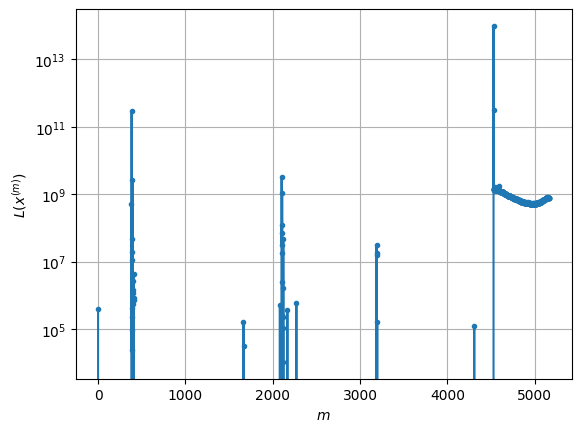

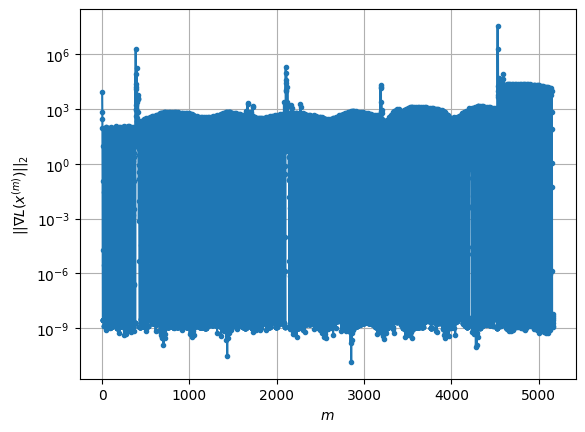

Windows:  86%|████████▋ | 341/395 [03:37<00:22,  2.36it/s]

Before applying the algorithm
Cost function: 849307755.9003422
Gradient norm: 14903.591783476411
Global relative error: 88728.65858657019
Position relative errors: 5.821642290773594 m, 3601.091064642691 m, 15628.719284214143 m, 87266.98937727796 m

Iteration 1
Cost function: 851517823.5855994 (0.26%)
Gradient norm: 6551.440458209188 (-56.04%)
Global relative error: 89653.62560952893 (1.04%)
Position relative errors: 0.25421951726468855 m, 1564.5626906130874 m, 16047.591145116277 m, 88191.70530446287 m

Iteration 2
Cost function: 850397990.1866565 (-0.13%)
Gradient norm: 543.4208135927532 (-91.71%)
Global relative error: 89515.069735036 (-0.15%)
Position relative errors: 0.25421951726468855 m, 1741.8631778939034 m, 16409.141495540214 m, 87980.85607259406 m

Iteration 3
Cost function: 850379567.1504328 (-0.00%)
Gradient norm: 1.5874368265684957 (-99.71%)
Global relative error: 89422.51525620124 (-0.10%)
Position relative errors: 0.25421951726468855 m, 1740.3441610295415 m, 16407.93009524

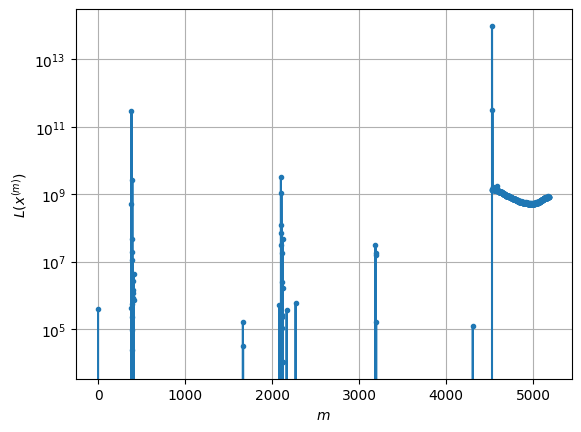

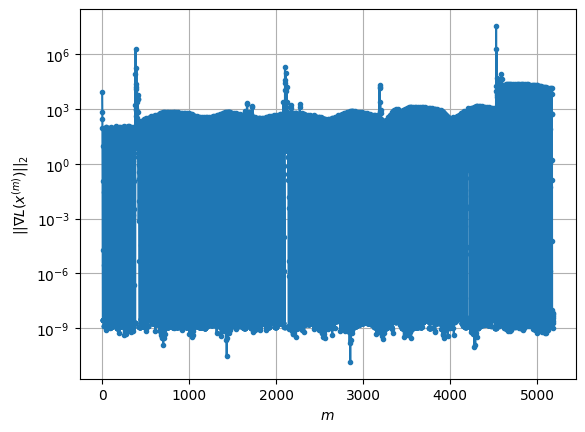

Windows:  87%|████████▋ | 342/395 [03:37<00:22,  2.30it/s]

Before applying the algorithm
Cost function: 896387111.6627399
Gradient norm: 14981.564532082642
Global relative error: 88622.75521258889
Position relative errors: 5.880498045392665 m, 3941.1061628316165 m, 16411.02704615253 m, 87000.66603972993 m

Iteration 1
Cost function: 902270706.6351612 (0.66%)
Gradient norm: 7412.174667516 (-50.52%)
Global relative error: 89354.11734038965 (0.83%)
Position relative errors: 0.05527004629916085 m, 1795.778641932913 m, 16722.34923264458 m, 87756.90179040279 m

Iteration 2
Cost function: 899981474.5231769 (-0.25%)
Gradient norm: 420.2576552798634 (-94.33%)
Global relative error: 89139.64379638394 (-0.24%)
Position relative errors: 0.05527004629916085 m, 1852.392319948756 m, 17156.798863107153 m, 87453.22351159915 m

Iteration 3
Cost function: 899975923.2747601 (-0.00%)
Gradient norm: 2.3804976504781954 (-99.43%)
Global relative error: 89074.92681335106 (-0.07%)
Position relative errors: 0.05527004629916085 m, 1858.1253936155704 m, 17158.871266577393

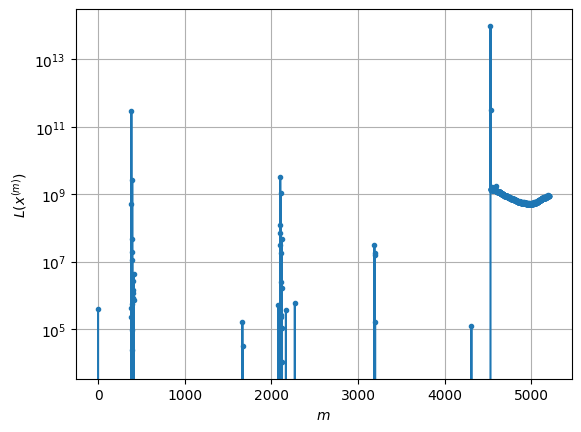

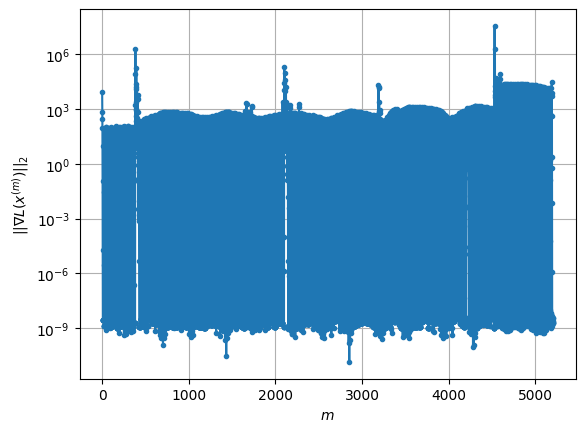

Windows:  87%|████████▋ | 343/395 [03:37<00:21,  2.42it/s]

Before applying the algorithm
Cost function: 947602052.9327053
Gradient norm: 15226.71014673367
Global relative error: 88474.9340835266
Position relative errors: 5.76824314090033 m, 4197.058167991516 m, 17223.401704153825 m, 86680.62303053483 m

Iteration 1
Cost function: 957569269.5384328 (1.05%)
Gradient norm: 8603.357921668121 (-43.50%)
Global relative error: 89045.9937519729 (0.65%)
Position relative errors: 0.27308837576915856 m, 1820.1301660027648 m, 17427.04589693535 m, 87304.93425554378 m

Iteration 2
Cost function: 953490692.5055361 (-0.43%)
Gradient norm: 363.6327069530215 (-95.77%)
Global relative error: 88729.19760297656 (-0.36%)
Position relative errors: 0.27308837576915856 m, 1734.0117829419905 m, 17943.41174876727 m, 86878.50729508646 m

Iteration 3
Cost function: 953493901.5542446 (0.00%)
Gradient norm: 4.271314303206633 (-98.83%)
Global relative error: 88686.45714741656 (-0.05%)
Position relative errors: 0.27308837576915856 m, 1746.087202975443 m, 17948.952108587557 m,

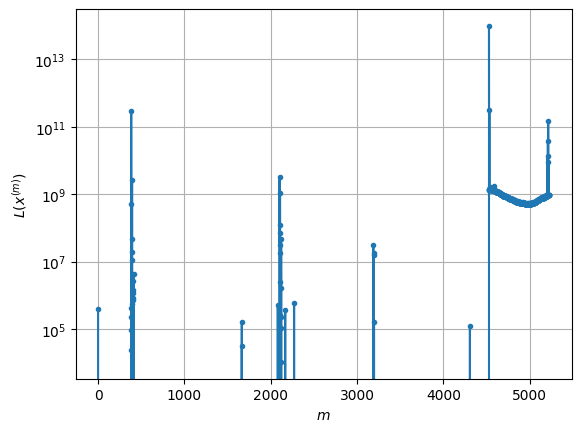

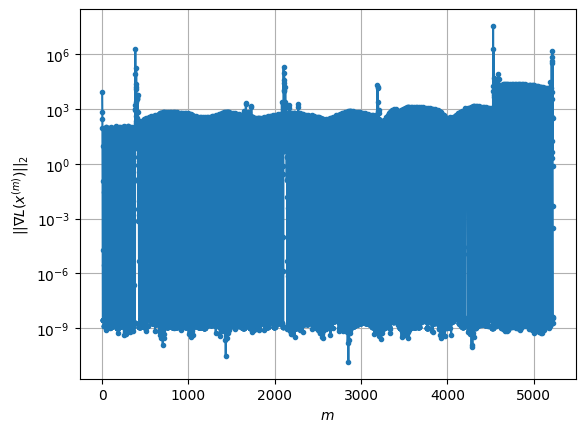

Windows:  87%|████████▋ | 344/395 [03:38<00:20,  2.48it/s]

Before applying the algorithm
Cost function: 1010223375.9247813
Gradient norm: 20181.737149389155
Global relative error: 31189.971077727234
Position relative errors: 6.032283044039677 m, 25618.817263384626 m, 9873.333703895909 m, 14798.129190232652 m

Iteration 1
Cost function: 1008364664.9340465 (-0.18%)
Gradient norm: 10521.496531305742 (-47.87%)
Global relative error: 36007.041224457695 (15.44%)
Position relative errors: 0.06461082313256263 m, 27195.65905204395 m, 10295.3641090141 m, 21234.064820858002 m

Iteration 2
Cost function: 1010462353.4844007 (0.21%)
Gradient norm: 1572.6793717824185 (-85.05%)
Global relative error: 32916.18505891429 (-8.58%)
Position relative errors: 0.06461082313256263 m, 26381.92656275302 m, 9965.535065302818 m, 16974.515752186235 m

Iteration 3
Cost function: 1010404526.6332613 (-0.01%)
Gradient norm: 18.04588450269122 (-98.85%)
Global relative error: 33031.31418868663 (0.35%)
Position relative errors: 0.06461082313256263 m, 26471.68434390516 m, 9886.018

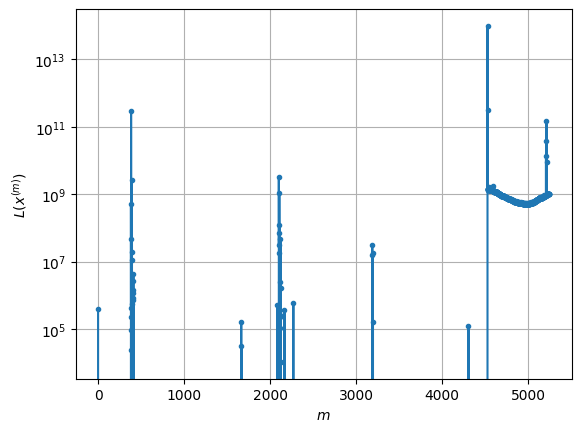

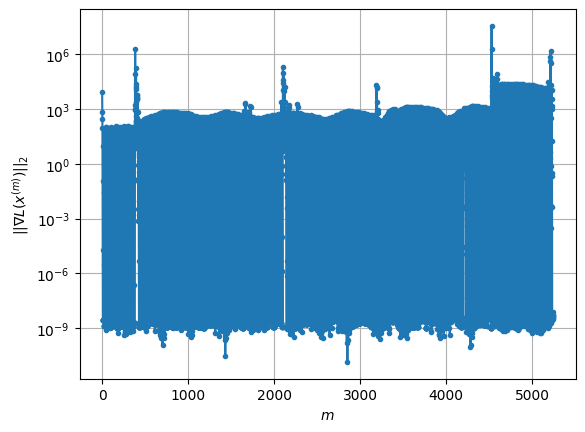

Windows:  87%|████████▋ | 345/395 [03:38<00:21,  2.32it/s]

Before applying the algorithm
Cost function: 1066638508.830405
Gradient norm: 20163.660684142644
Global relative error: 32025.182732406476
Position relative errors: 5.851541143539493 m, 26190.697640459435 m, 10415.969196115664 m, 15203.409639921254 m

Iteration 1
Cost function: 1078644555.953595 (1.13%)
Gradient norm: 21899.43537962149 (8.61%)
Global relative error: 41753.17948057111 (30.38%)
Position relative errors: 0.250691016012399 m, 28003.12137273246 m, 11745.480673594378 m, 28656.121525222676 m

Iteration 2
Cost function: 1070119234.8754584 (-0.79%)
Gradient norm: 5677.080779605996 (-74.08%)
Global relative error: 37662.59807393341 (-9.80%)
Position relative errors: 0.250691016012399 m, 26099.043231407355 m, 11769.609532696142 m, 24469.65374771292 m

Iteration 3
Cost function: 1071304605.2274902 (0.11%)
Gradient norm: 785.9902546839451 (-86.16%)
Global relative error: 39739.15707475134 (5.51%)
Position relative errors: 0.250691016012399 m, 25809.370048154735 m, 11890.73400305078

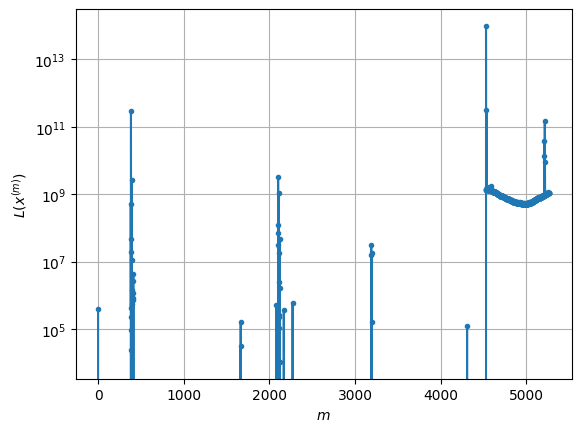

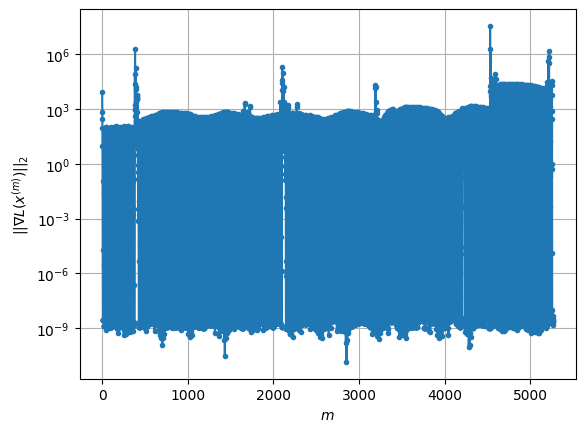

Windows:  88%|████████▊ | 346/395 [03:39<00:20,  2.38it/s]

Before applying the algorithm
Cost function: 1127750185.3098092
Gradient norm: 20628.011763668008
Global relative error: 32885.75308920875
Position relative errors: 5.848933003884606 m, 26766.729006684942 m, 10954.370335241332 m, 15652.24221885132 m

Iteration 1
Cost function: 15293781071.631802 (1256.13%)
Gradient norm: 445172.43431772746 (2058.10%)
Global relative error: 92028.23430749662 (179.84%)
Position relative errors: 0.09974689031804522 m, 36217.01723446534 m, 2512.142312938644 m, 84564.70119964749 m

Iteration 2
Cost function: 1230550905.8525734 (-91.95%)
Gradient norm: 39915.09270179816 (-91.03%)
Global relative error: 53311.84789294456 (-42.07%)
Position relative errors: 0.09974689031804522 m, 32839.150858592264 m, 12113.813029204728 m, 40211.625261020316 m

Iteration 3
Cost function: 1120036470.5679178 (-8.98%)
Gradient norm: 11021.851585142149 (-72.39%)
Global relative error: 48231.44317195021 (-9.53%)
Position relative errors: 0.09974689031804522 m, 30467.190173182556 m,

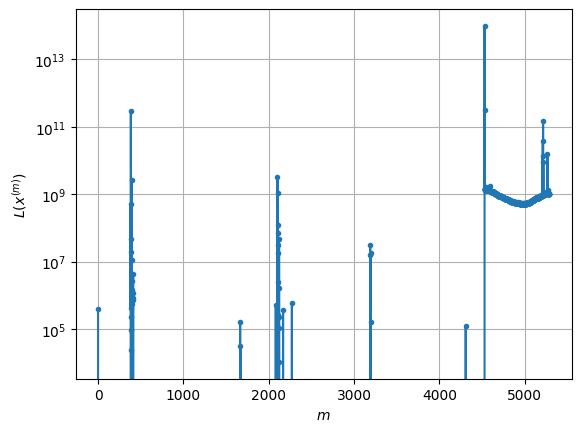

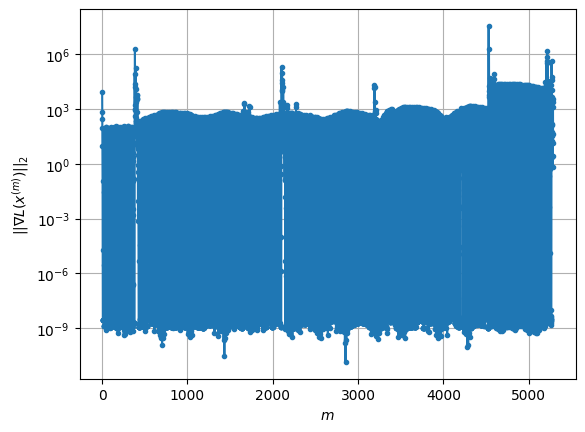

Windows:  88%|████████▊ | 347/395 [03:39<00:20,  2.37it/s]

Before applying the algorithm
Cost function: 1112753386.1391337
Gradient norm: 18400.362481969412
Global relative error: 41271.22334827331
Position relative errors: 5.877056818861697 m, 24969.573699004788 m, 17968.290296632105 m, 27512.720811533436 m

Iteration 1
Cost function: 5630146160.872433 (405.97%)
Gradient norm: 248575.00630765362 (1250.92%)
Global relative error: 116351.97422595361 (181.92%)
Position relative errors: 0.1458315989017248 m, 46121.24682252936 m, 9340.069915263422 m, 106411.23353759799 m

Iteration 2
Cost function: 8192003118.020729 (45.50%)
Gradient norm: 319343.2094334805 (28.47%)
Global relative error: 126742.47508723912 (8.93%)
Position relative errors: 0.1458315989017248 m, 77869.72938719111 m, 54718.878774099794 m, 83700.53508379355 m

Iteration 3
Cost function: 99966199.4409829 (-98.78%)
Gradient norm: 23918.00816348712 (-92.51%)
Global relative error: 81978.0532374226 (-35.32%)
Position relative errors: 0.1458315989017248 m, 31602.201877776082 m, 32168.281

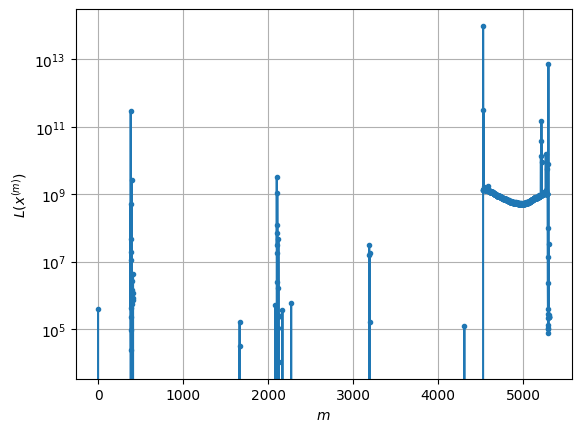

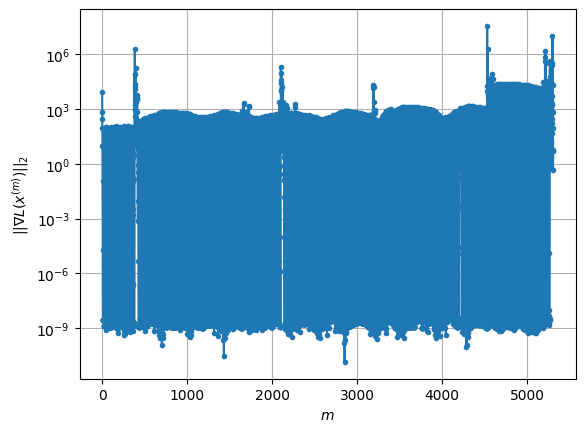

Windows:  88%|████████▊ | 348/395 [03:40<00:19,  2.47it/s]

Before applying the algorithm
Cost function: 49410832.46293205
Gradient norm: 25710.609773198048
Global relative error: 103109.78070796681
Position relative errors: 6.050126672931267 m, 28068.386920467812 m, 29696.296082515542 m, 94667.29910245568 m

Iteration 1
Cost function: 2481691.1334354244 (-94.98%)
Gradient norm: 2165.4355622146354 (-91.58%)
Global relative error: 100519.47231124771 (-2.51%)
Position relative errors: 0.08770796236284428 m, 29766.13792632568 m, 30448.335663991606 m, 91055.0120840045 m

Iteration 2
Cost function: 548984.3467640816 (-77.88%)
Gradient norm: 636.9071215489213 (-70.59%)
Global relative error: 100675.57382772377 (0.16%)
Position relative errors: 0.08770796236284428 m, 29312.780816121238 m, 30381.338580309384 m, 91396.28732108738 m

Iteration 3
Cost function: 258096.63237826896 (-52.99%)
Gradient norm: 293.34807878596115 (-53.94%)
Global relative error: 100828.11909102519 (0.15%)
Position relative errors: 0.08770796236284428 m, 29454.132208839135 m, 302

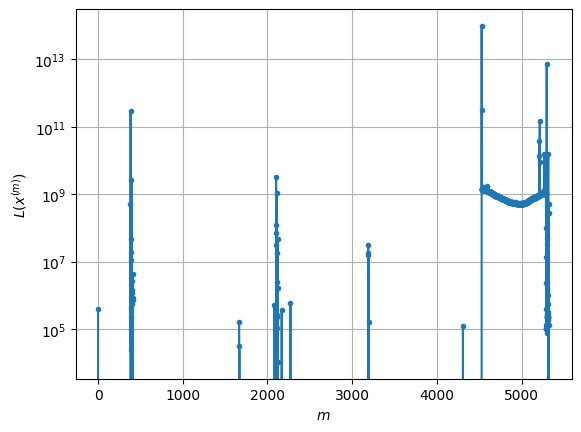

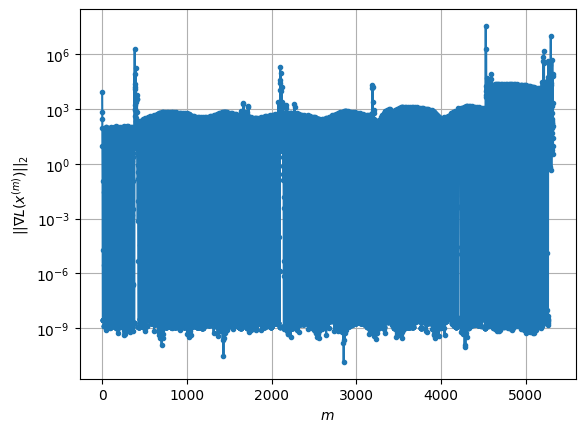

Windows:  88%|████████▊ | 349/395 [03:40<00:20,  2.28it/s]

Before applying the algorithm
Cost function: 16370714.898139682
Gradient norm: 15174.154574688775
Global relative error: 11700.720766053395
Position relative errors: 5.9569635328810095 m, 3236.9630067888475 m, 8938.38431259312 m, 6819.76440561422 m

Iteration 1
Cost function: -214150.5256280495 (-101.31%)
Gradient norm: 69.00661048532781 (-99.55%)
Global relative error: 12267.650557205285 (4.85%)
Position relative errors: 0.19678419598529628 m, 3732.700402204509 m, 9103.501041891821 m, 7325.53519259216 m

Iteration 2
Cost function: -223456.7811160259 (-4.35%)
Gradient norm: 189.4899777438023 (174.60%)
Global relative error: 11088.063746626602 (-9.62%)
Position relative errors: 0.19678419598529628 m, 3396.788759778613 m, 8356.476530853624 m, 6446.028462281224 m

Iteration 3
Cost function: -226961.10821189976 (-1.57%)
Gradient norm: 24.105784389025228 (-87.28%)
Global relative error: 10750.575077600648 (-3.04%)
Position relative errors: 0.19678419598529628 m, 3685.606957184816 m, 7772.30

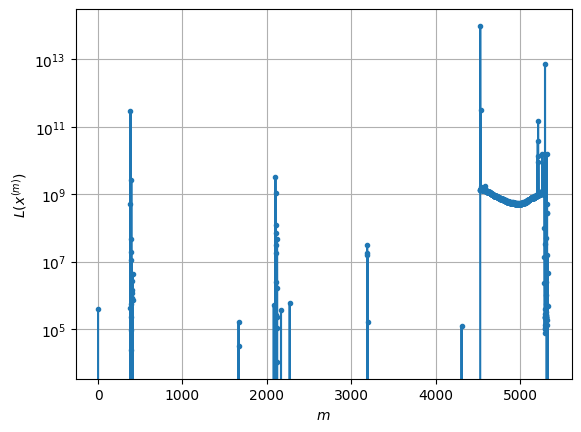

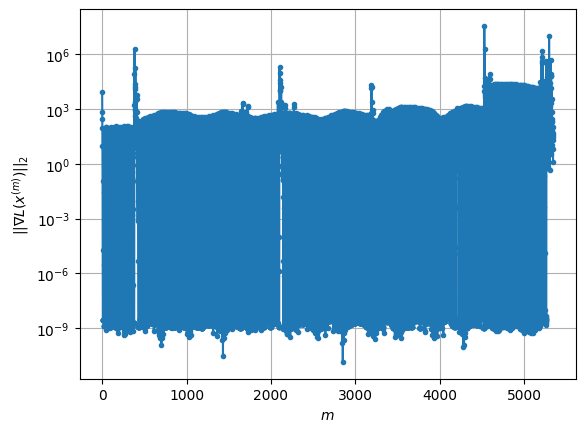

Windows:  89%|████████▊ | 350/395 [03:40<00:18,  2.37it/s]

Before applying the algorithm
Cost function: 13604282.655375062
Gradient norm: 13699.691137501692
Global relative error: 10226.131414141379
Position relative errors: 5.793741852097197 m, 1987.5385524755873 m, 2919.0993064554013 m, 9595.67949436474 m

Iteration 1
Cost function: 49655882.81492736 (265.00%)
Gradient norm: 14358.151480784221 (4.81%)
Global relative error: 29272.589998872718 (186.25%)
Position relative errors: 0.29210747443124596 m, 15972.980517404802 m, 9975.533876559348 m, 22410.08539721017 m

Iteration 2
Cost function: 5438123.865224087 (-89.05%)
Gradient norm: 3019.7833371137813 (-78.97%)
Global relative error: 20235.615138207897 (-30.87%)
Position relative errors: 0.29210747443124596 m, 10455.770389890802 m, 3242.451530185708 m, 17018.174950618926 m

Iteration 3
Cost function: 559697.0708861869 (-89.71%)
Gradient norm: 996.6732247713197 (-67.00%)
Global relative error: 16259.353253545602 (-19.65%)
Position relative errors: 0.29210747443124596 m, 7841.287907597993 m, 17

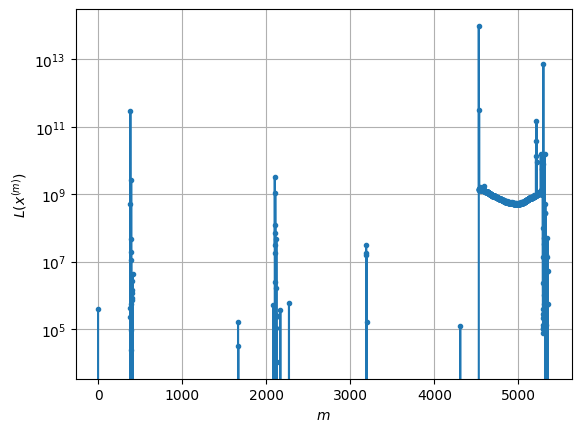

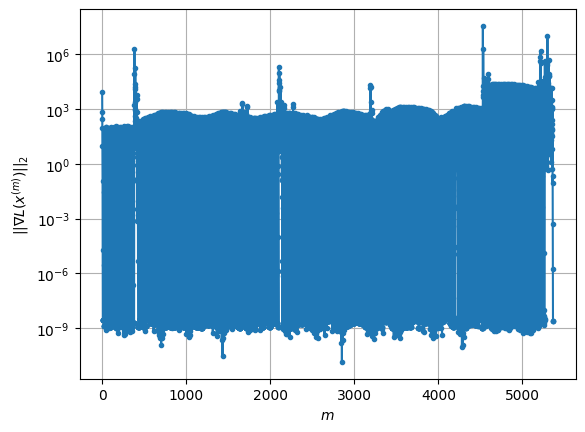

Windows:  89%|████████▉ | 351/395 [03:41<00:18,  2.35it/s]

Before applying the algorithm
Cost function: 22276588.63071476
Gradient norm: 17515.746564187964
Global relative error: 9509.87374469728
Position relative errors: 6.066551575799257 m, 1630.583133131943 m, 2590.991433372061 m, 9002.235171162894 m

Iteration 1
Cost function: 3805638.5013420074 (-82.92%)
Gradient norm: 2515.424112981776 (-85.64%)
Global relative error: 16831.429582079985 (76.99%)
Position relative errors: 0.29476923612786815 m, 7066.450535790699 m, 3519.0226870989686 m, 14864.501069470303 m

Iteration 2
Cost function: 331914.5495048152 (-91.28%)
Gradient norm: 667.2567346517992 (-73.47%)
Global relative error: 13060.3525547416 (-22.40%)
Position relative errors: 0.29476923612786815 m, 5443.3425931307 m, 909.5819861706276 m, 11835.96658466257 m

Iteration 3
Cost function: -164266.37187965753 (-149.49%)
Gradient norm: 206.2191804989624 (-69.09%)
Global relative error: 10399.800168605401 (-20.37%)
Position relative errors: 0.29476923612786815 m, 3979.723781256544 m, 1961.694

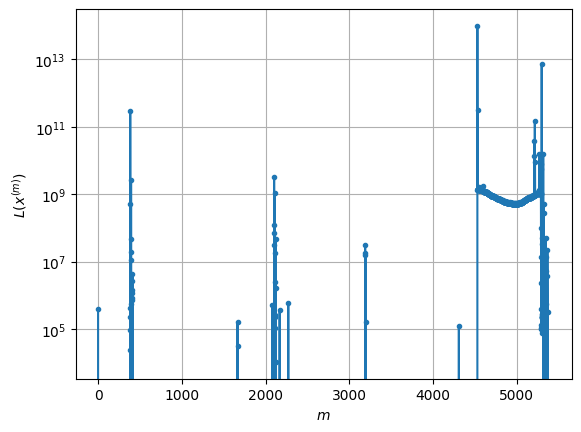

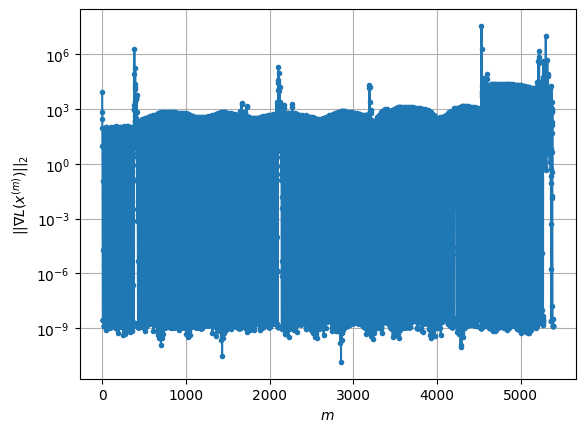

Windows:  89%|████████▉ | 352/395 [03:41<00:17,  2.45it/s]

Before applying the algorithm
Cost function: 31689772.961874146
Gradient norm: 20879.500409528788
Global relative error: 9602.103483480154
Position relative errors: 6.158035044682972 m, 1670.1981246951968 m, 2604.351750214311 m, 9088.597059091351 m

Iteration 1
Cost function: 3719151.405704614 (-88.26%)
Gradient norm: 2738.192173575582 (-86.89%)
Global relative error: 17168.68877558701 (78.80%)
Position relative errors: 0.11687796306412604 m, 8203.15226776791 m, 3264.3095702061223 m, 14723.82094063967 m

Iteration 2
Cost function: 343202.7872951483 (-90.77%)
Gradient norm: 741.8497781106117 (-72.91%)
Global relative error: 14352.2167892324 (-16.40%)
Position relative errors: 0.11687796306412604 m, 6416.450157777312 m, 1319.4518546790762 m, 12769.056106793678 m

Iteration 3
Cost function: -61139.33461193404 (-117.81%)
Gradient norm: 987.9182455736778 (33.17%)
Global relative error: 11344.554091180105 (-20.96%)
Position relative errors: 0.11687796306412604 m, 4756.998942908908 m, 2308.11

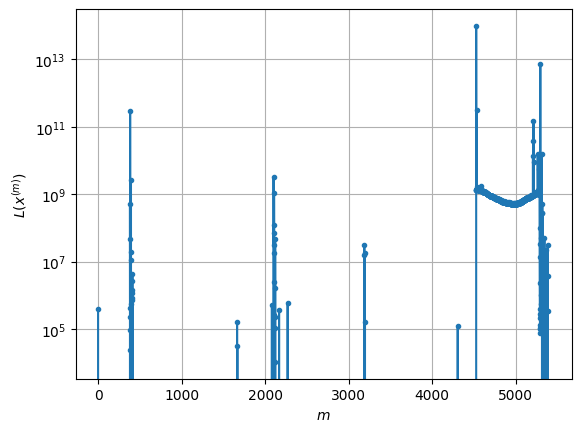

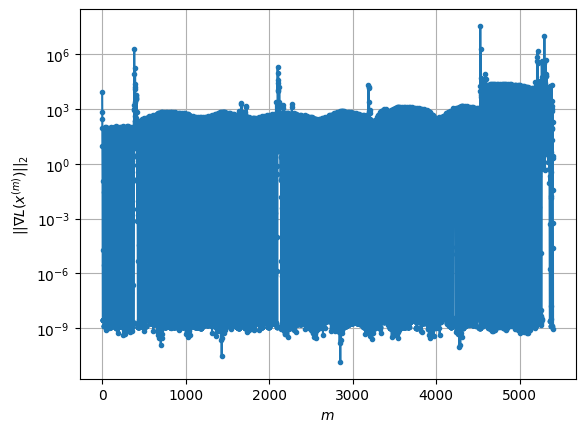

Windows:  89%|████████▉ | 353/395 [03:42<00:17,  2.42it/s]

Before applying the algorithm
Cost function: 42384451.33127229
Gradient norm: 24130.82608395279
Global relative error: 9707.910892356547
Position relative errors: 5.822360538202804 m, 1677.8608468728619 m, 2662.4509368023 m, 9182.262341008034 m

Iteration 1
Cost function: 7599726.318568966 (-82.07%)
Gradient norm: 4867.752932549454 (-79.83%)
Global relative error: 19804.341620318814 (104.00%)
Position relative errors: 0.11855100715960663 m, 11235.253368162952 m, 4081.5401809574687 m, 15789.12164187864 m

Iteration 2
Cost function: 871062.7001973703 (-88.54%)
Gradient norm: 1140.2559649338552 (-76.58%)
Global relative error: 17012.320120468703 (-14.10%)
Position relative errors: 0.11855100715960663 m, 8516.50269184359 m, 1683.6662480334207 m, 14629.688631330944 m

Iteration 3
Cost function: 14233385.474269975 (1534.03%)
Gradient norm: 9640.436431211327 (745.46%)
Global relative error: 17711.683333235833 (4.11%)
Position relative errors: 0.11855100715960663 m, 10014.128934963466 m, 2926.

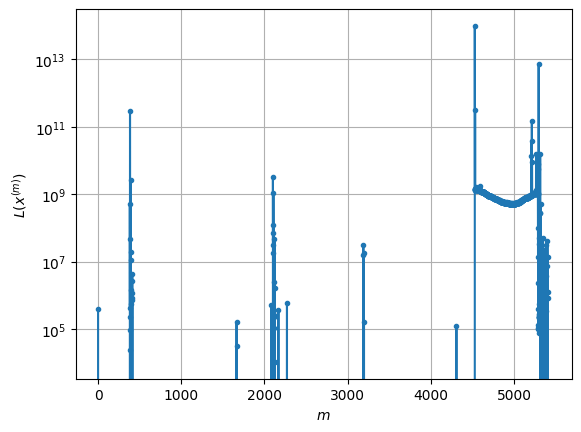

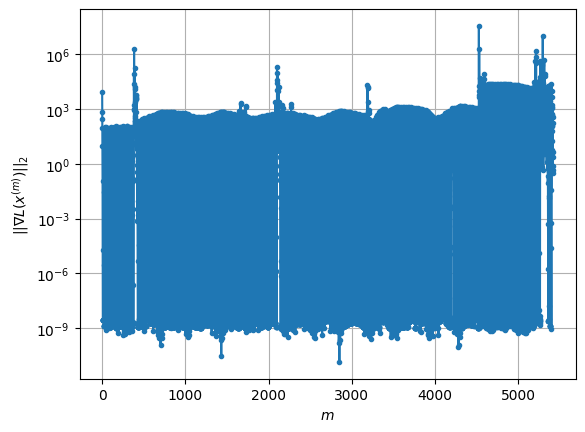

Windows:  90%|████████▉ | 354/395 [03:42<00:16,  2.44it/s]

Before applying the algorithm
Cost function: 54740244.33238387
Gradient norm: 27390.60330966092
Global relative error: 10282.810289266363
Position relative errors: 5.917380338564909 m, 3040.943796117692 m, 3711.6348569096817 m, 9093.225982944703 m

Iteration 1
Cost function: 42468973.7509925 (-22.42%)
Gradient norm: 14372.156677243684 (-47.53%)
Global relative error: 28659.282186816356 (178.71%)
Position relative errors: 0.061055174826078557 m, 19641.290492327218 m, 7962.787014626779 m, 19290.991810816035 m

Iteration 2
Cost function: 4073106.8176465295 (-90.41%)
Gradient norm: 2572.74491641186 (-82.10%)
Global relative error: 21920.114623930924 (-23.51%)
Position relative errors: 0.061055174826078557 m, 13299.066866177951 m, 3600.5623457005568 m, 17048.06074706493 m

Iteration 3
Cost function: 681451.9127549481 (-83.27%)
Gradient norm: 1303.677514649025 (-49.33%)
Global relative error: 16001.062291319608 (-27.00%)
Position relative errors: 0.061055174826078557 m, 8679.264326053733 m, 

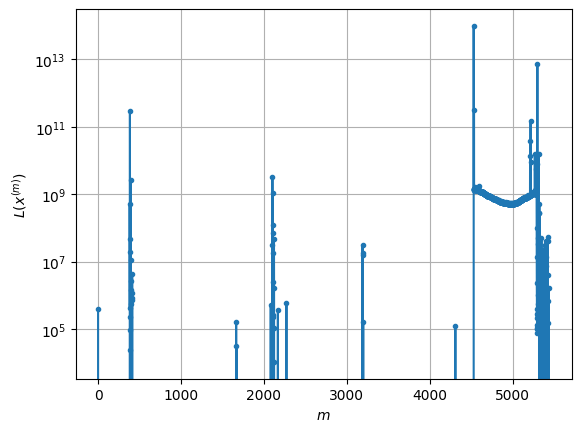

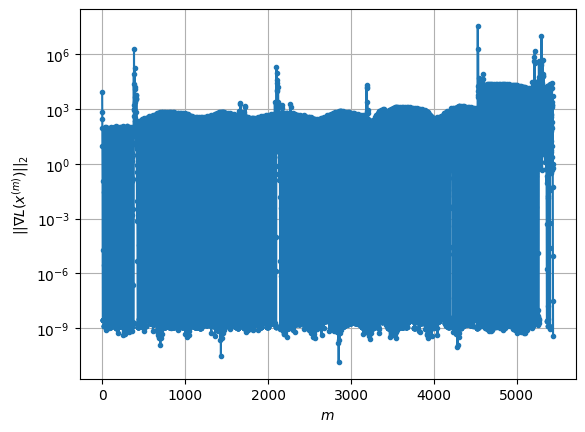

Windows:  90%|████████▉ | 355/395 [03:42<00:16,  2.49it/s]

Before applying the algorithm
Cost function: 68621496.05025786
Gradient norm: 30658.56226334337
Global relative error: 9932.978899482487
Position relative errors: 5.888577634397137 m, 2316.616005401872 m, 2984.982126453102 m, 9184.83938732004 m

Iteration 1
Cost function: 39837578088.875984 (57954.08%)
Gradient norm: 669302.287710629 (2083.08%)
Global relative error: 239162.4054707972 (2307.76%)
Position relative errors: 0.16599812376400164 m, 204339.17674080108 m, 83742.68909254626 m, 91822.07322006847 m

Iteration 2
Cost function: 610348805.0305023 (-98.47%)
Gradient norm: 59935.49581348727 (-91.05%)
Global relative error: 53165.425735736964 (-77.77%)
Position relative errors: 0.165998123728483 m, 39200.328125382395 m, 13327.825306838167 m, 33350.26099639614 m

Iteration 3
Cost function: 152534762.73276258 (-75.01%)
Gradient norm: 43293.771061978514 (-27.77%)
Global relative error: 24084.057605776183 (-54.70%)
Position relative errors: 0.16599812376400164 m, 16679.282126905615 m, 235

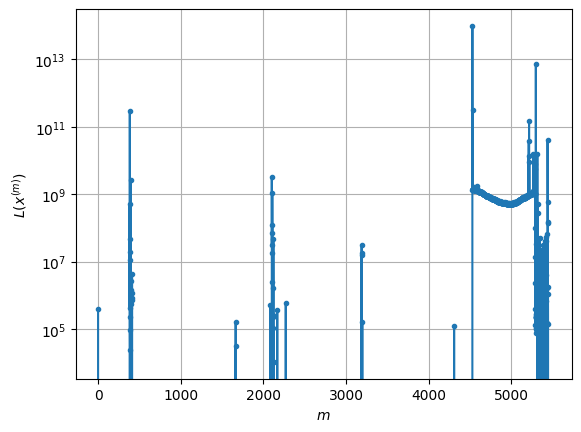

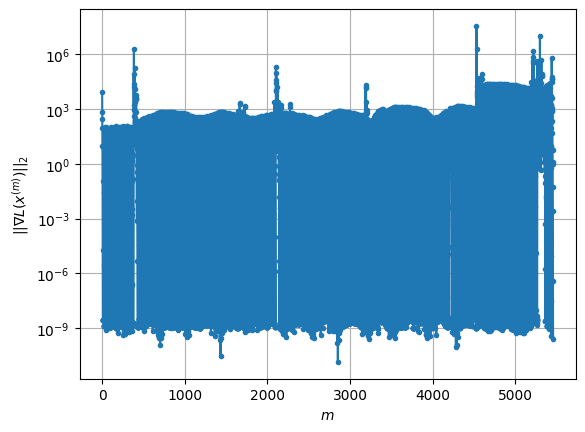

Windows:  90%|█████████ | 356/395 [03:43<00:15,  2.53it/s]

Before applying the algorithm
Cost function: 83291215.01130667
Gradient norm: 33754.77097945165
Global relative error: 9941.642632489702
Position relative errors: 6.049499786744604 m, 2299.959990344584 m, 2987.069297311569 m, 9197.706118794958 m

Iteration 1
Cost function: 92961242.2687761 (11.61%)
Gradient norm: 22072.483550116576 (-34.61%)
Global relative error: 18185.77029391821 (82.93%)
Position relative errors: 0.13049165290543005 m, 16307.827208216764 m, 7468.631789507332 m, 2995.083848908394 m

Iteration 2
Cost function: 10882582.314847283 (-88.29%)
Gradient norm: 5258.1127035592945 (-76.18%)
Global relative error: 8815.971226754802 (-51.52%)
Position relative errors: 0.13049165290543005 m, 7895.471425449651 m, 3231.266544955966 m, 2217.1538727506663 m

Iteration 3
Cost function: 1399098.657891724 (-87.14%)
Gradient norm: 1838.3370666797523 (-65.04%)
Global relative error: 5802.0047718000305 (-34.19%)
Position relative errors: 0.13049165290543005 m, 3516.311223530641 m, 3688.777

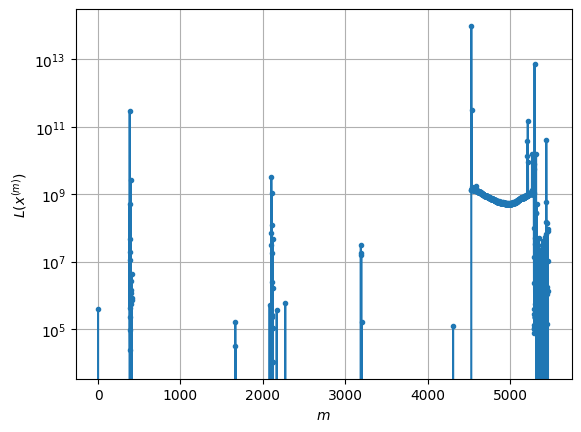

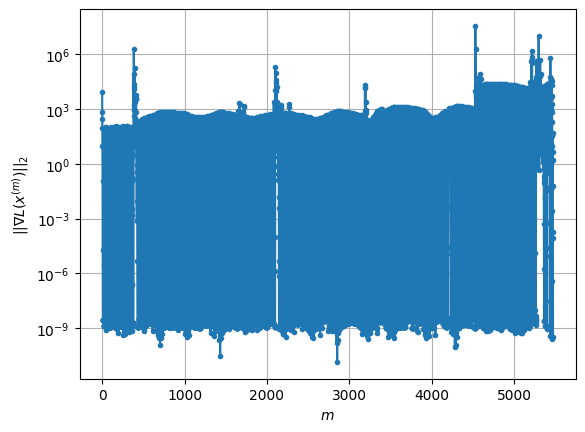

Windows:  90%|█████████ | 357/395 [03:43<00:16,  2.37it/s]

Before applying the algorithm
Cost function: 99303439.30353476
Gradient norm: 36834.05555175002
Global relative error: 9898.910335083947
Position relative errors: 5.927406981756171 m, 2242.4969312460707 m, 3040.2164604783725 m, 9148.255999188545 m

Iteration 1
Cost function: 20526171.227111362 (-79.33%)
Gradient norm: 8162.139241463737 (-77.84%)
Global relative error: 10330.33130131957 (4.36%)
Position relative errors: 0.1604698396936138 m, 7725.3791575139485 m, 4101.625694323377 m, 5494.0726294444175 m

Iteration 2
Cost function: 2817692.7069617296 (-86.27%)
Gradient norm: 2753.3660995701184 (-66.27%)
Global relative error: 5749.891100273315 (-44.34%)
Position relative errors: 0.1604698396936138 m, 4471.820625020533 m, 2867.395289045066 m, 2194.5427645132504 m

Iteration 3
Cost function: 159095.31746881947 (-94.35%)
Gradient norm: 890.8377068690323 (-67.65%)
Global relative error: 5230.579947364568 (-9.03%)
Position relative errors: 0.1604698396936138 m, 2003.4658490216564 m, 3516.820

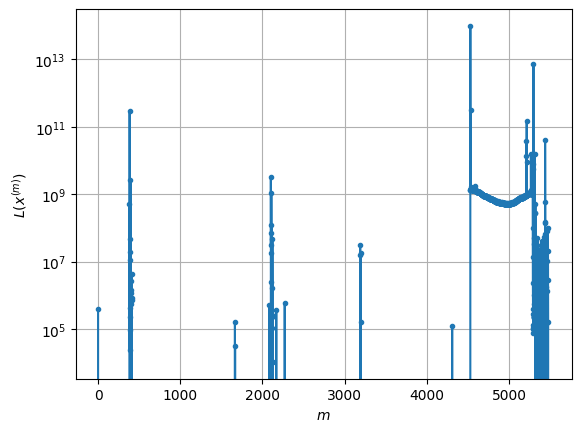

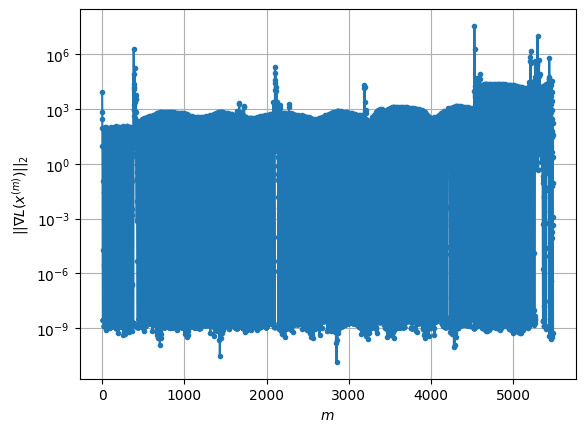

Windows:  91%|█████████ | 358/395 [03:44<00:15,  2.44it/s]

Before applying the algorithm
Cost function: 115693728.28199326
Gradient norm: 39728.17648428853
Global relative error: 10337.709976670669
Position relative errors: 5.771902857179651 m, 3060.409636747948 m, 3839.1939846252862 m, 9095.96400251894 m

Iteration 1
Cost function: 12110681.152940424 (-89.53%)
Gradient norm: 5620.225051233439 (-85.85%)
Global relative error: 9818.557739611982 (-5.02%)
Position relative errors: 0.18845842980474986 m, 6390.872137596165 m, 4297.4719070506035 m, 6088.220517039033 m

Iteration 2
Cost function: 1653150.2912720037 (-86.35%)
Gradient norm: 2325.867334023661 (-58.62%)
Global relative error: 5991.339330215856 (-38.98%)
Position relative errors: 0.18845842980474986 m, 4271.176295146155 m, 3067.7009014197174 m, 2866.40465635863 m

Iteration 3
Cost function: -26743.86417068365 (-101.62%)
Gradient norm: 657.4874579626103 (-71.73%)
Global relative error: 6075.150714415084 (1.40%)
Position relative errors: 0.18845842980474986 m, 3001.65023702689 m, 3703.2845

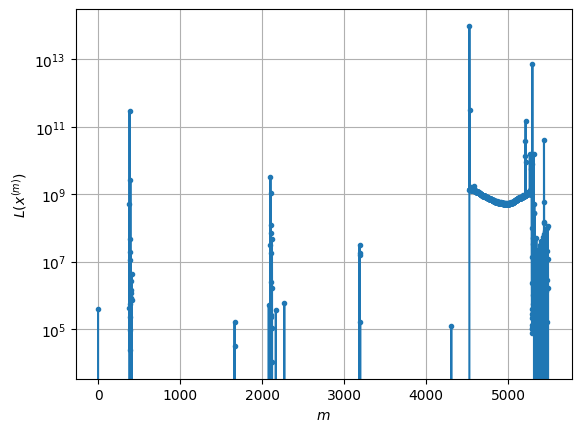

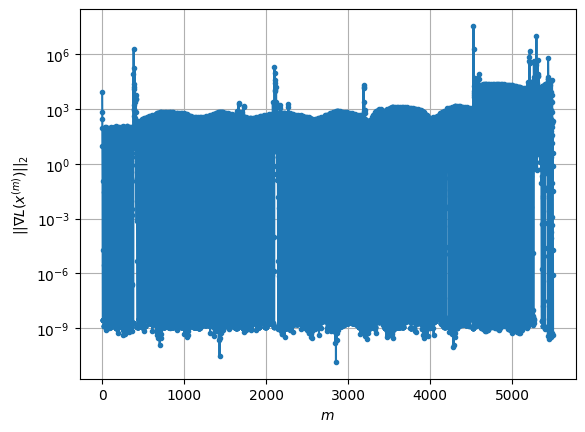

Windows:  91%|█████████ | 359/395 [03:44<00:14,  2.44it/s]

Before applying the algorithm
Cost function: 132171112.22573297
Gradient norm: 42439.51898645712
Global relative error: 10386.795174248424
Position relative errors: 6.002662344244806 m, 3020.9685285787605 m, 3872.7082847079505 m, 9150.693849735164 m

Iteration 1
Cost function: 7803118.314464417 (-94.10%)
Gradient norm: 4125.592661669624 (-90.28%)
Global relative error: 9055.860469033996 (-12.81%)
Position relative errors: 0.14863970914250565 m, 5047.091740780365 m, 3899.4432239698167 m, 6426.7920922149115 m

Iteration 2
Cost function: 1034187.9462898687 (-86.75%)
Gradient norm: 2086.447301837421 (-49.43%)
Global relative error: 5589.720992934694 (-38.28%)
Position relative errors: 0.14863970914250565 m, 3734.2375572471205 m, 2693.0436103496595 m, 3165.7237744970316 m

Iteration 3
Cost function: -117416.01747892304 (-111.35%)
Gradient norm: 489.8482982037737 (-76.52%)
Global relative error: 5856.724108680254 (4.78%)
Position relative errors: 0.14863970914250565 m, 2985.3281959442565 m, 

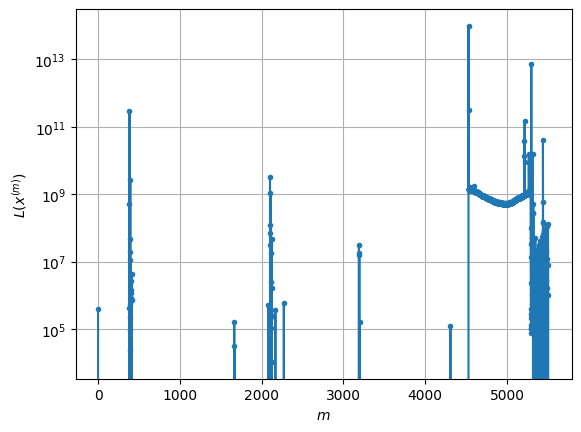

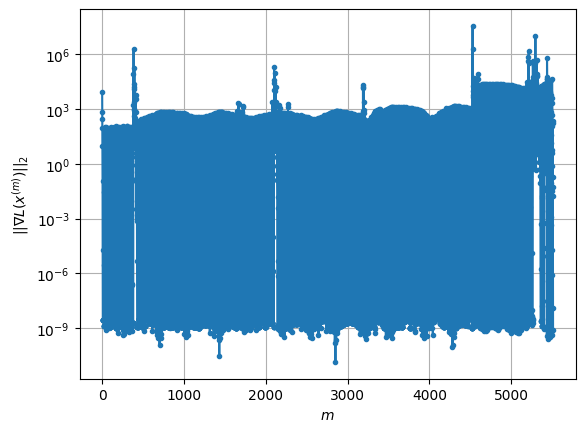

Windows:  91%|█████████ | 360/395 [03:44<00:13,  2.53it/s]

Before applying the algorithm
Cost function: 149447474.962356
Gradient norm: 45104.12503620273
Global relative error: 10278.496562807552
Position relative errors: 5.887466762552297 m, 2908.7471379422777 m, 3850.5484144657953 m, 9073.795391333026 m

Iteration 1
Cost function: 5585295.990753894 (-96.26%)
Gradient norm: 3274.0582021978958 (-92.74%)
Global relative error: 8404.237364991124 (-18.23%)
Position relative errors: 0.2287092731358416 m, 4270.25688071572 m, 3592.3597074244194 m, 6282.109710838052 m

Iteration 2
Cost function: 861416.933531961 (-84.58%)
Gradient norm: 2449.105449013518 (-25.20%)
Global relative error: 6094.580433875739 (-27.48%)
Position relative errors: 0.2287092731358416 m, 3924.0682030432904 m, 1656.058160783055 m, 4356.249487537261 m

Iteration 3
Cost function: -156856.74757357882 (-118.21%)
Gradient norm: 301.52126483442134 (-87.69%)
Global relative error: 6070.328084325644 (-0.40%)
Position relative errors: 0.2287092731358416 m, 3503.5115788536764 m, 1994.724

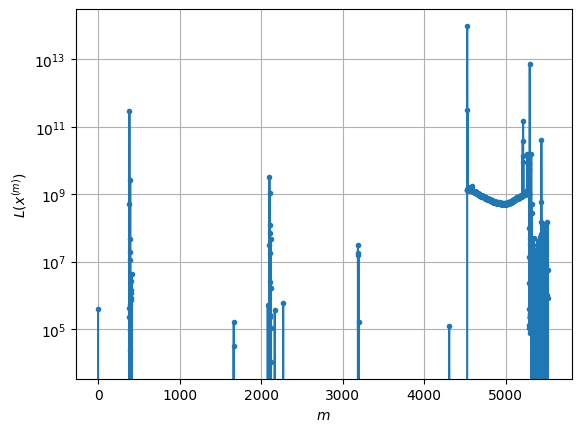

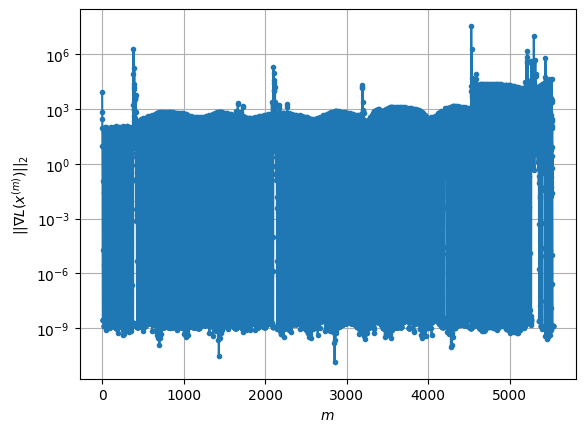

Windows:  91%|█████████▏| 361/395 [03:45<00:13,  2.47it/s]

Before applying the algorithm
Cost function: 166324054.50813624
Gradient norm: 47562.14653212804
Global relative error: 10340.07486377768
Position relative errors: 5.783732919103768 m, 2894.6013247964247 m, 3879.9474067440756 m, 9135.549362664 m

Iteration 1
Cost function: 4224358.173748906 (-97.46%)
Gradient norm: 2717.446906391357 (-94.29%)
Global relative error: 8020.698068867934 (-22.43%)
Position relative errors: 0.10811931307892099 m, 3772.7089472177877 m, 3466.855409954275 m, 6168.714160635829 m

Iteration 2
Cost function: 2114703.3931667553 (-49.94%)
Gradient norm: 5086.511892358431 (87.18%)
Global relative error: 8548.053487557407 (6.57%)
Position relative errors: 0.10811931307892099 m, 1533.7716069221356 m, 6583.240846463962 m, 5229.871810955206 m

Iteration 3
Cost function: -157202.3291957732 (-107.43%)
Gradient norm: 221.73025526039123 (-95.64%)
Global relative error: 8296.061341584526 (-2.95%)
Position relative errors: 0.10811931307892099 m, 332.3290319536592 m, 6376.27987

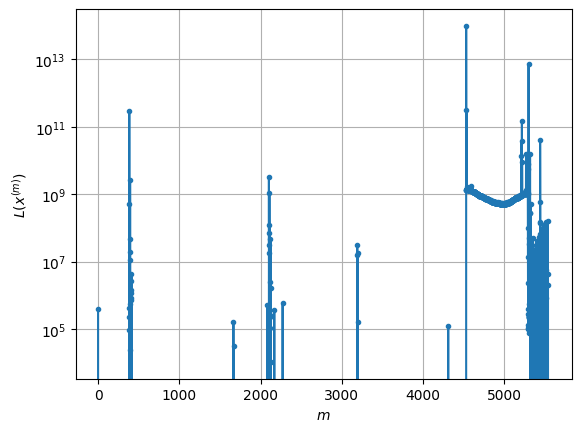

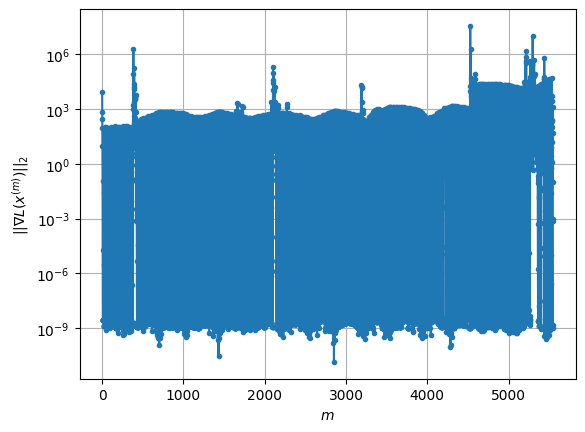

Windows:  92%|█████████▏| 362/395 [03:45<00:13,  2.51it/s]

Before applying the algorithm
Cost function: 182894907.8947539
Gradient norm: 49855.6000365796
Global relative error: 10319.699684801803
Position relative errors: 5.777823841459039 m, 2774.6825402229024 m, 3909.029795553667 m, 9137.323578721078 m

Iteration 1
Cost function: 3247649.6550419135 (-98.22%)
Gradient norm: 2292.8014554066754 (-95.40%)
Global relative error: 7536.02952672559 (-26.97%)
Position relative errors: 0.30857639421131944 m, 3345.2438755017483 m, 3383.5320458550923 m, 5841.8050603470565 m

Iteration 2
Cost function: 624153.405239407 (-80.78%)
Gradient norm: 2575.819436995401 (12.34%)
Global relative error: 6227.638167709455 (-17.36%)
Position relative errors: 0.30857639421131944 m, 1622.5894592805407 m, 5091.668561906893 m, 3193.662924849633 m

Iteration 3
Cost function: -191208.54897087312 (-130.63%)
Gradient norm: 183.6881847500568 (-92.87%)
Global relative error: 6051.110105163724 (-2.83%)
Position relative errors: 0.30857639421131944 m, 928.3132080359688 m, 4989.0

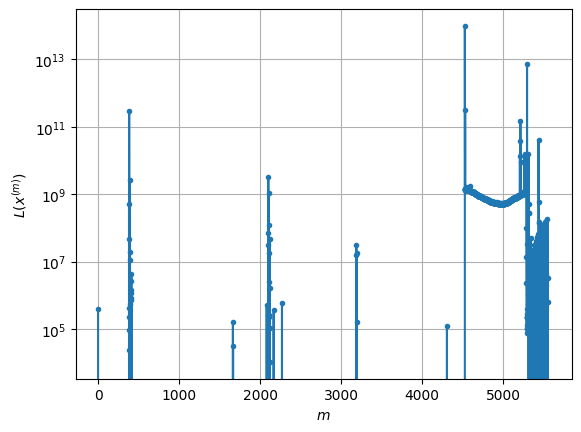

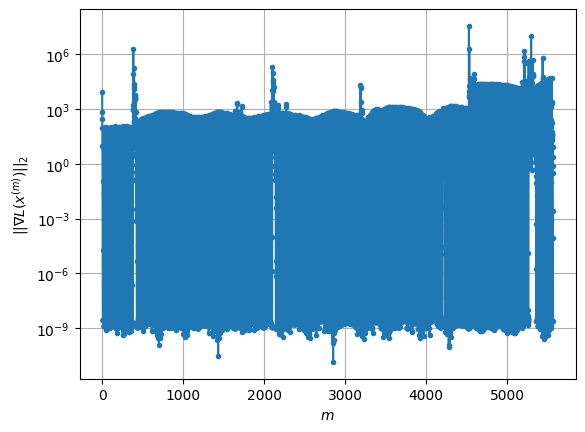

Windows:  92%|█████████▏| 363/395 [03:46<00:12,  2.48it/s]

Before applying the algorithm
Cost function: 198390593.3123878
Gradient norm: 51916.285098072105
Global relative error: 10350.176999717021
Position relative errors: 5.535929489010233 m, 2764.278236450129 m, 3874.826952616367 m, 9189.37188236451 m

Iteration 1
Cost function: 2533902.270657012 (-98.72%)
Gradient norm: 1963.7783989693876 (-96.22%)
Global relative error: 7143.971306361013 (-30.98%)
Position relative errors: 0.15701519694990282 m, 3132.6298135700413 m, 3251.2776939015525 m, 5534.084405246786 m

Iteration 2
Cost function: 19175437.041968536 (656.76%)
Gradient norm: 16360.34200345104 (733.11%)
Global relative error: 15864.64431095839 (122.07%)
Position relative errors: 0.15701519694990282 m, 6875.37962776943 m, 5858.308400949871 m, 13041.098770297445 m

Iteration 3
Cost function: -159231.8906438013 (-100.83%)
Gradient norm: 190.0472556304308 (-98.84%)
Global relative error: 15344.674361845615 (-3.28%)
Position relative errors: 0.15701519694990282 m, 6787.645773913452 m, 5495.

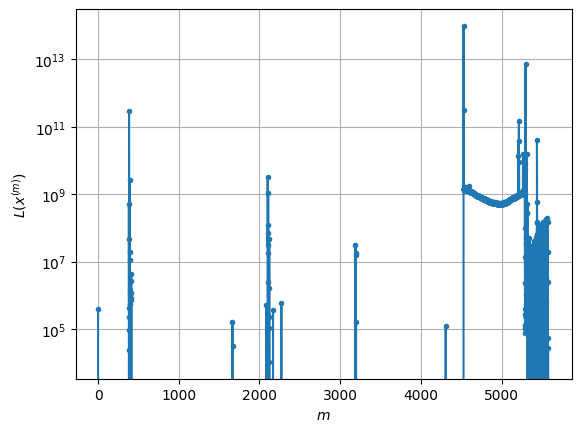

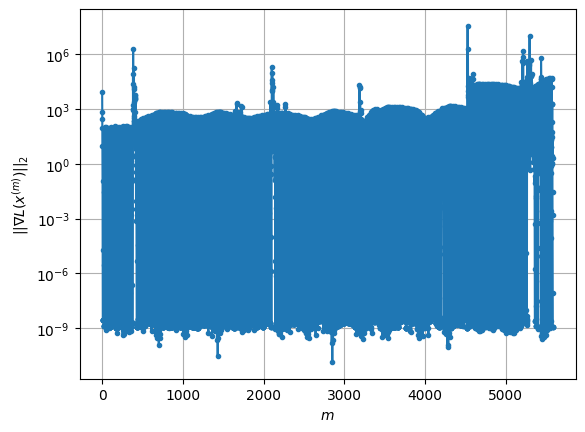

Windows:  92%|█████████▏| 364/395 [03:46<00:12,  2.45it/s]

Before applying the algorithm
Cost function: 213628654.7404983
Gradient norm: 53863.42775611675
Global relative error: 10228.877961815382
Position relative errors: 5.936910325493919 m, 2691.189133474404 m, 3776.218968501222 m, 9116.007259460806 m

Iteration 1
Cost function: 1814208.743155033 (-99.15%)
Gradient norm: 1605.1321192632852 (-97.02%)
Global relative error: 6475.51050267299 (-36.69%)
Position relative errors: 0.15884576955731586 m, 2976.6829601559143 m, 3051.4814665393387 m, 4871.76185306852 m

Iteration 2
Cost function: 54873.67332889335 (-96.98%)
Gradient norm: 1017.4766248361661 (-36.61%)
Global relative error: 4398.022350549831 (-32.08%)
Position relative errors: 0.15884576955731586 m, 2776.822377570112 m, 2014.6315431232629 m, 2747.2032494003042 m

Iteration 3
Cost function: -218458.52202445344 (-498.11%)
Gradient norm: 182.90201564291326 (-82.02%)
Global relative error: 4567.562410318418 (3.85%)
Position relative errors: 0.15884576955731586 m, 2614.7436078173823 m, 2357

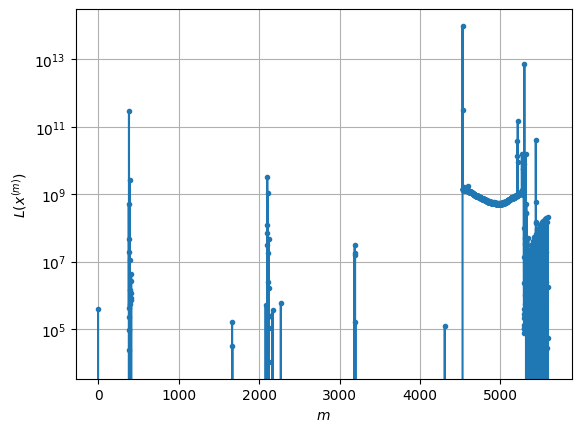

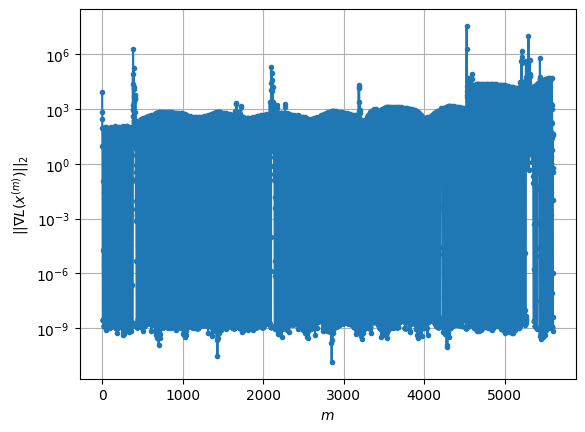

Windows:  92%|█████████▏| 365/395 [03:47<00:12,  2.38it/s]

Before applying the algorithm
Cost function: 227286406.4404244
Gradient norm: 55565.46953696931
Global relative error: 10178.404968235984
Position relative errors: 5.806740726659483 m, 2578.926354454354 m, 3732.4170510003714 m, 9110.004646489446 m

Iteration 1
Cost function: 1191125.424388341 (-99.48%)
Gradient norm: 1262.264608432498 (-97.73%)
Global relative error: 5853.457155250429 (-42.49%)
Position relative errors: 0.21293830229444546 m, 2689.0366286351214 m, 2937.9193682228406 m, 4286.579205249009 m

Iteration 2
Cost function: -58051.325769957184 (-104.87%)
Gradient norm: 668.8752747090855 (-47.01%)
Global relative error: 4098.503934635676 (-29.98%)
Position relative errors: 0.21293830229444546 m, 2335.6044302008427 m, 2411.1491486486298 m, 2345.8761795248934 m

Iteration 3
Cost function: -225182.4219159711 (-287.90%)
Gradient norm: 179.71319709182438 (-73.13%)
Global relative error: 4460.870601622483 (8.84%)
Position relative errors: 0.21293830229444546 m, 2292.332266496399 m, 2

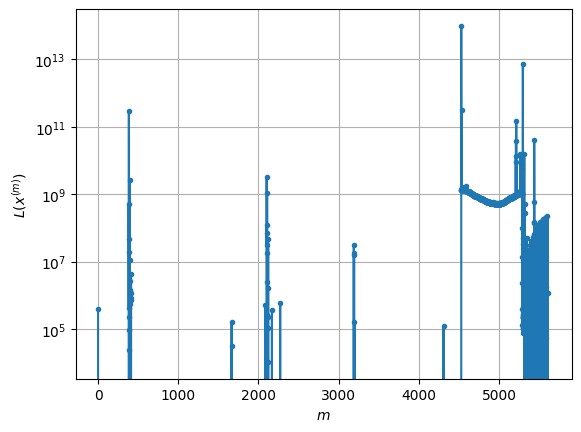

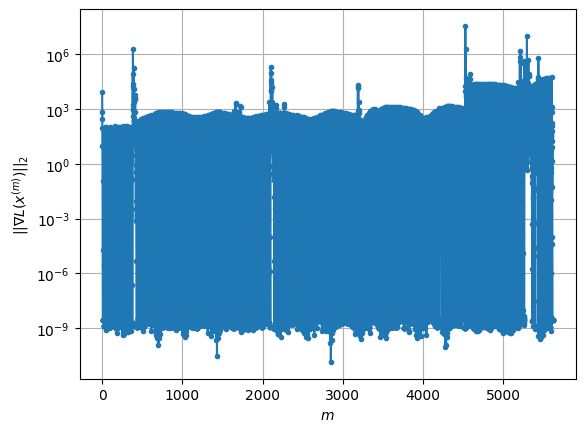

Windows:  93%|█████████▎| 366/395 [03:47<00:11,  2.46it/s]

Before applying the algorithm
Cost function: 238997759.23599812
Gradient norm: 56996.4130887585
Global relative error: 10136.387169544852
Position relative errors: 5.924516020829299 m, 2411.844855993276 m, 3816.323047757528 m, 9074.093465491409 m

Iteration 1
Cost function: 676199.9606798736 (-99.72%)
Gradient norm: 942.4133214197849 (-98.35%)
Global relative error: 5260.149044048319 (-48.11%)
Position relative errors: 0.2369018212044421 m, 2395.0728357983608 m, 3036.7332027673647 m, 3561.632372885784 m

Iteration 2
Cost function: -135037.76330967678 (-119.97%)
Gradient norm: 422.77486596271694 (-55.14%)
Global relative error: 3951.3972572531798 (-24.88%)
Position relative errors: 0.2369018212044421 m, 2046.7563710192499 m, 2662.9313372641154 m, 2075.4047708558733 m

Iteration 3
Cost function: -230525.9254164199 (-70.71%)
Gradient norm: 120.4101927978609 (-71.52%)
Global relative error: 4237.121290780532 (7.23%)
Position relative errors: 0.2369018212044421 m, 2057.036459013565 m, 2888.

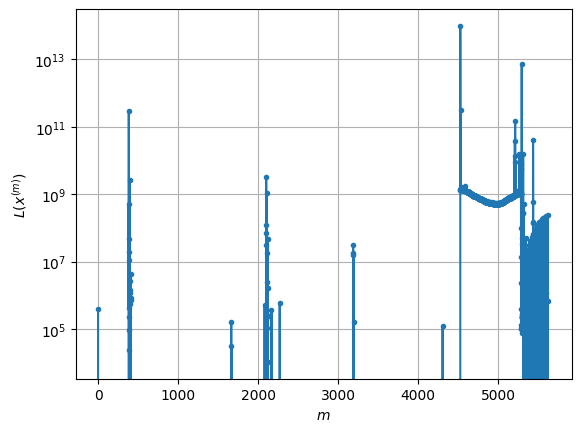

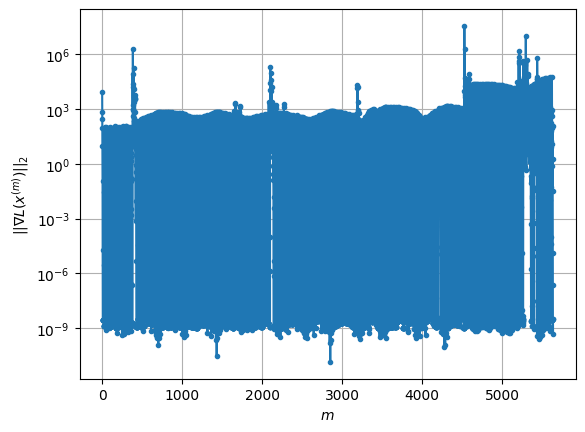

Windows:  93%|█████████▎| 367/395 [03:47<00:11,  2.47it/s]

Before applying the algorithm
Cost function: 248810719.1922851
Gradient norm: 58192.310069615225
Global relative error: 10093.31328304002
Position relative errors: 5.71361267907269 m, 2504.3378477637734 m, 3530.288120640189 m, 9116.71967429918 m

Iteration 1
Cost function: 290512.9647126165 (-99.88%)
Gradient norm: 664.4654960114262 (-98.86%)
Global relative error: 4663.889062019861 (-53.79%)
Position relative errors: 0.10295986594990643 m, 2421.2359889333543 m, 2576.748055940257 m, 3037.1246962113005 m

Iteration 2
Cost function: -184723.36339203184 (-163.59%)
Gradient norm: 252.15183062571631 (-62.05%)
Global relative error: 3782.3948853961483 (-18.90%)
Position relative errors: 0.10295986594990643 m, 2113.8591555090793 m, 2344.9558759457 m, 2076.91405094558 m

Iteration 3
Cost function: -233892.45651739265 (-26.62%)
Gradient norm: 54.699187646389625 (-78.31%)
Global relative error: 3838.7790086667196 (1.49%)
Position relative errors: 0.10295986594990643 m, 2083.167638075182 m, 2455.

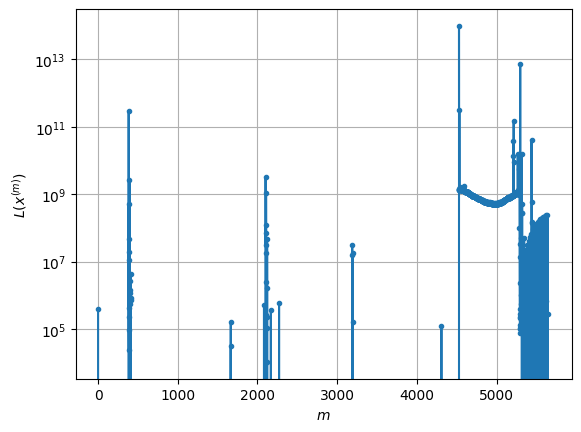

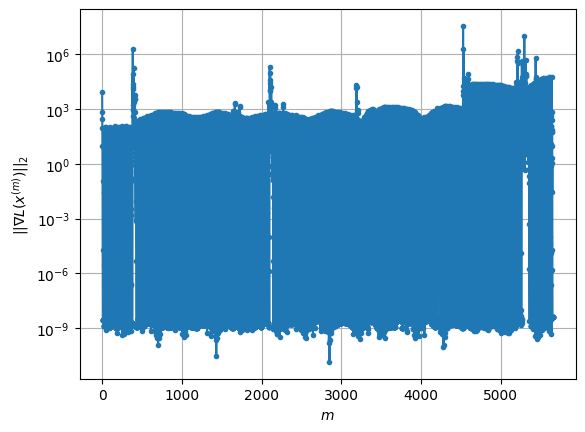

Windows:  93%|█████████▎| 368/395 [03:48<00:11,  2.41it/s]

Before applying the algorithm
Cost function: 256086021.75230002
Gradient norm: 59091.9629604306
Global relative error: 10022.08179066562
Position relative errors: 5.879876515077681 m, 2343.880788176873 m, 3491.9795841189352 m, 9095.535992219055 m

Iteration 1
Cost function: -19543.13774575254 (-100.01%)
Gradient norm: 390.574569920582 (-99.34%)
Global relative error: 3983.291573703099 (-60.25%)
Position relative errors: 0.18876621060062662 m, 2085.6597859759977 m, 2505.816769386406 m, 2282.9590460458667 m

Iteration 2
Cost function: -219460.42869176273 (-1022.95%)
Gradient norm: 124.66567779379876 (-68.08%)
Global relative error: 3463.812053098753 (-13.04%)
Position relative errors: 0.18876621060062662 m, 1873.8830376458593 m, 2327.9442436106056 m, 1744.02309859121 m

Iteration 3
Cost function: -235679.5451358784 (-7.39%)
Gradient norm: 16.712053114320792 (-86.59%)
Global relative error: 3321.2415241056037 (-4.12%)
Position relative errors: 0.18876621060062662 m, 1818.8094012500437 m, 

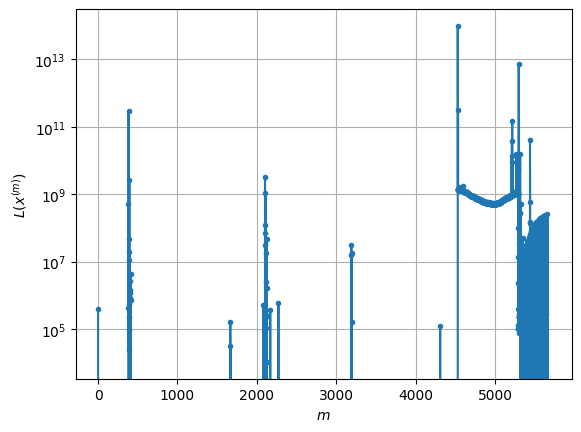

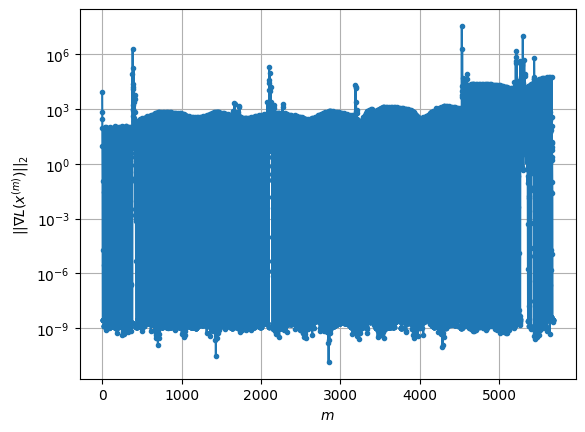

Windows:  93%|█████████▎| 369/395 [03:48<00:11,  2.35it/s]

Before applying the algorithm
Cost function: 260891780.1962817
Gradient norm: 59701.533410049255
Global relative error: 10002.651022846685
Position relative errors: 5.850421537983254 m, 2297.4923398347223 m, 3443.995939190716 m, 9104.279510394617 m

Iteration 1
Cost function: -171801.71824700676 (-100.07%)
Gradient norm: 210.7143703215649 (-99.65%)
Global relative error: 3517.580417350773 (-64.83%)
Position relative errors: 0.17472962742289283 m, 1910.5594803956683 m, 2404.8340272688492 m, 1707.1610825836801 m

Iteration 2
Cost function: -232771.91431277295 (-35.49%)
Gradient norm: 58.24595098774874 (-72.36%)
Global relative error: 3165.411024864439 (-10.01%)
Position relative errors: 0.17472962742289283 m, 1754.9201118332278 m, 2229.815100993238 m, 1393.7353296080375 m

Iteration 3
Cost function: -236042.28867827175 (-1.40%)
Gradient norm: 7.521474633119515 (-87.09%)
Global relative error: 2927.933728269005 (-7.50%)
Position relative errors: 0.17472962742289283 m, 1646.4357731820144 m

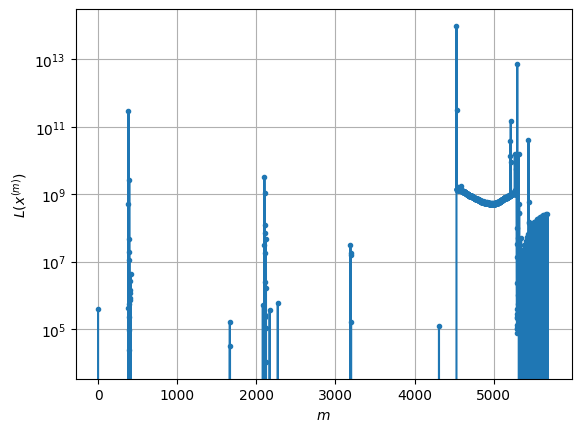

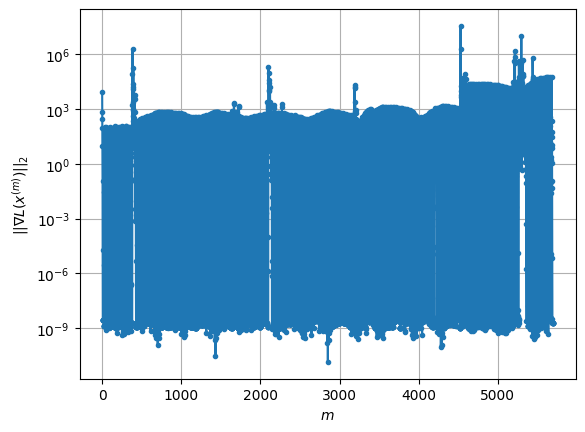

Windows:  94%|█████████▎| 370/395 [03:49<00:10,  2.34it/s]

Before applying the algorithm
Cost function: 261945016.98997796
Gradient norm: 59907.80783193693
Global relative error: 9910.49413632425
Position relative errors: 5.760461713894239 m, 2166.0055949182265 m, 3320.714372416479 m, 9081.505099965405 m

Iteration 1
Cost function: -233824.78350408413 (-100.09%)
Gradient norm: 92.91032451281268 (-99.84%)
Global relative error: 2989.830453131936 (-69.83%)
Position relative errors: 0.14857270464273745 m, 1656.2544022607426 m, 2205.639764243628 m, 1142.6543307887798 m

Iteration 2
Cost function: -236072.868465263 (-0.96%)
Gradient norm: 7.0070940442104765 (-92.46%)
Global relative error: 2734.1795027565704 (-8.55%)
Position relative errors: 0.14857270464273745 m, 1534.3230780279564 m, 2015.8254570145084 m, 1016.187073423612 m

Iteration 3
Cost function: -236127.9549673562 (-0.02%)
Gradient norm: 5.922985619429182 (-15.47%)
Global relative error: 2665.4973628395364 (-2.51%)
Position relative errors: 0.14857270464273745 m, 1446.4148765808418 m, 192

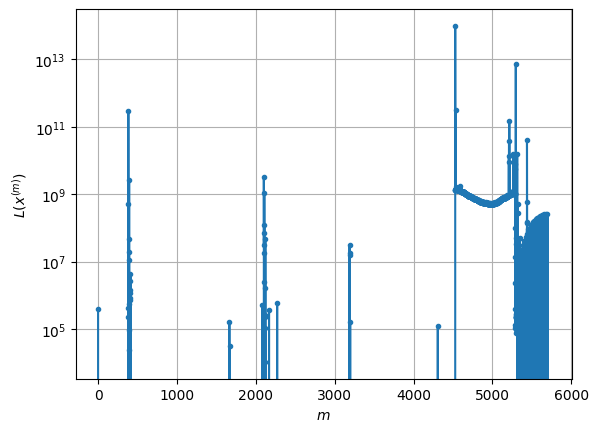

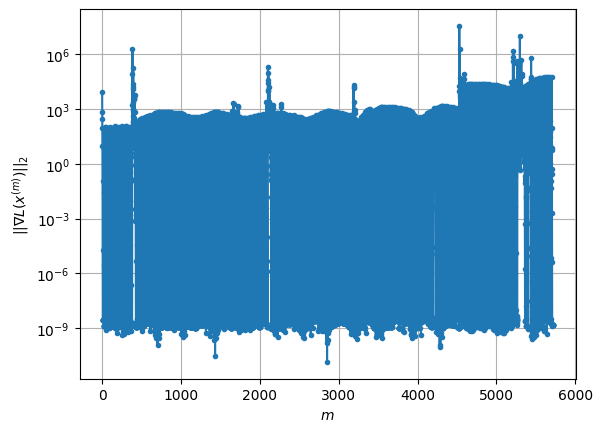

Windows:  94%|█████████▍| 371/395 [03:49<00:09,  2.45it/s]

Before applying the algorithm
Cost function: 259620906.19006827
Gradient norm: 59709.71456357396
Global relative error: 9867.833580401373
Position relative errors: 5.9289874153686455 m, 2111.6894316027046 m, 3246.4328164780927 m, 9074.703784195497 m

Iteration 1
Cost function: -214852.67266810653 (-100.08%)
Gradient norm: 70.99571009726242 (-99.88%)
Global relative error: 2950.884423532266 (-70.10%)
Position relative errors: 0.2047741606299593 m, 1584.196697316527 m, 2105.374287067017 m, 1319.14419811355 m

Iteration 2
Cost function: -200150.35996858648 (6.84%)
Gradient norm: 290.40481335612253 (309.05%)
Global relative error: 3770.669462711062 (27.78%)
Position relative errors: 0.2047741606299593 m, 2228.1732342808923 m, 2397.885926629738 m, 1864.9498429528417 m

Iteration 3
Cost function: -234346.35117551888 (-17.09%)
Gradient norm: 42.03809353142998 (-85.52%)
Global relative error: 3596.193192774617 (-4.63%)
Position relative errors: 0.2047741606299593 m, 1884.6912609547237 m, 2314.

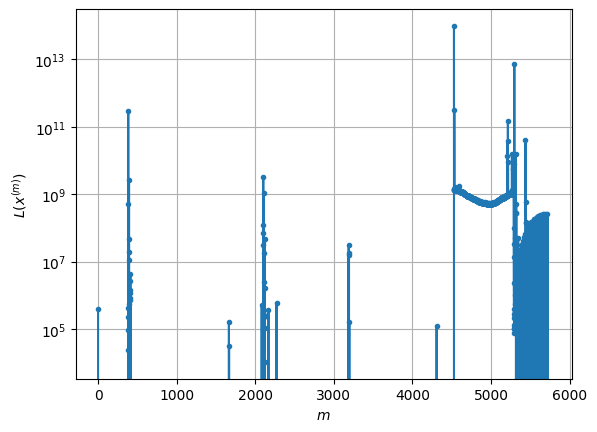

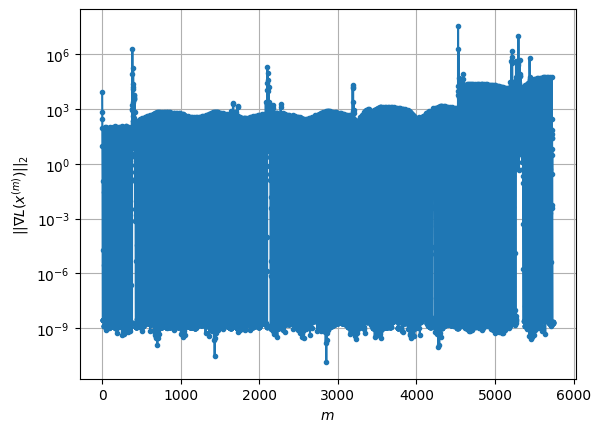

Windows:  94%|█████████▍| 372/395 [03:49<00:09,  2.50it/s]

Before applying the algorithm
Cost function: 251934496.73077145
Gradient norm: 58876.03013690004
Global relative error: 9799.135221112843
Position relative errors: 5.632886522663368 m, 1981.7641492131056 m, 3108.0962551208327 m, 9078.004663399308 m

Iteration 1
Cost function: -182320.48490560675 (-100.07%)
Gradient norm: 41.7244492502928 (-99.93%)
Global relative error: 3259.6302054272924 (-66.74%)
Position relative errors: 0.2595870777045601 m, 1492.6476535094803 m, 1903.5429003830127 m, 2179.1092694679196 m

Iteration 2
Cost function: -117543.0565104374 (35.53%)
Gradient norm: 794.86257812878 (1805.03%)
Global relative error: 5349.144894025393 (64.10%)
Position relative errors: 0.2595870777150569 m, 3868.3540232603364 m, 2938.7499672361982 m, 2233.3243385916226 m

Iteration 3
Cost function: -160403.38926018367 (-36.46%)
Gradient norm: 93.884266135176 (-88.19%)
Global relative error: 4812.598127538651 (-10.03%)
Position relative errors: 0.2595870777150569 m, 3360.426644207962 m, 2757.

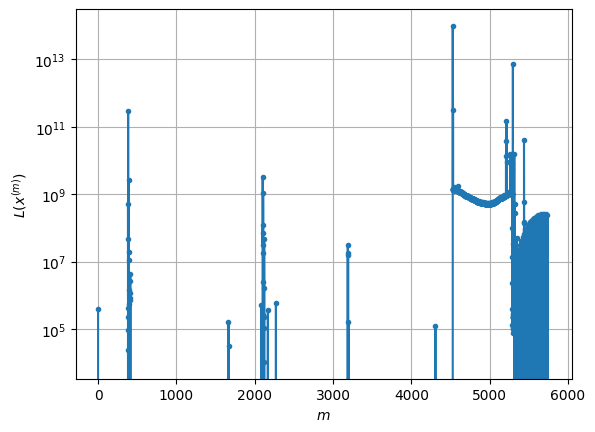

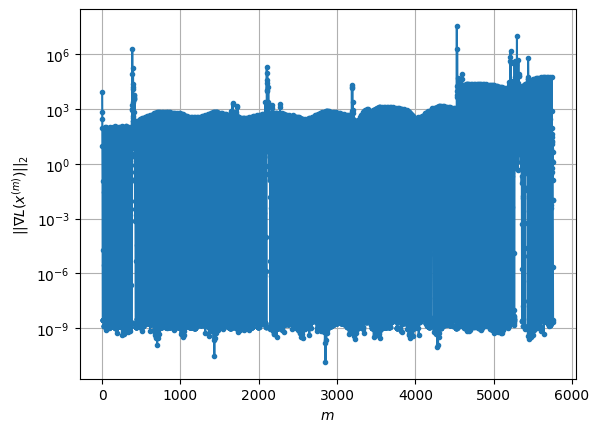

Windows:  94%|█████████▍| 373/395 [03:50<00:09,  2.34it/s]

Before applying the algorithm
Cost function: 229593138.74438903
Gradient norm: 55902.554044455625
Global relative error: 10327.369475695374
Position relative errors: 6.090480378027714 m, 3905.298237986376 m, 3105.338259780117 m, 9040.73686094236 m

Iteration 1
Cost function: 566769.6951274406 (-99.75%)
Gradient norm: 807.558230267947 (-98.56%)
Global relative error: 7026.491805520214 (-31.96%)
Position relative errors: 0.0935346622121317 m, 6012.114748008415 m, 1664.9181270769495 m, 3229.394804248403 m

Iteration 2
Cost function: -101073.44642657854 (-117.83%)
Gradient norm: 377.3065602695586 (-53.28%)
Global relative error: 5667.901208346235 (-19.34%)
Position relative errors: 0.0935346622121317 m, 4423.362348011731 m, 2108.3488184281996 m, 2844.0665827914163 m

Iteration 3
Cost function: -212448.96574737673 (-110.19%)
Gradient norm: 135.2550881059637 (-64.15%)
Global relative error: 5254.5991111129015 (-7.29%)
Position relative errors: 0.0935346622121317 m, 2838.846764570535 m, 2371.

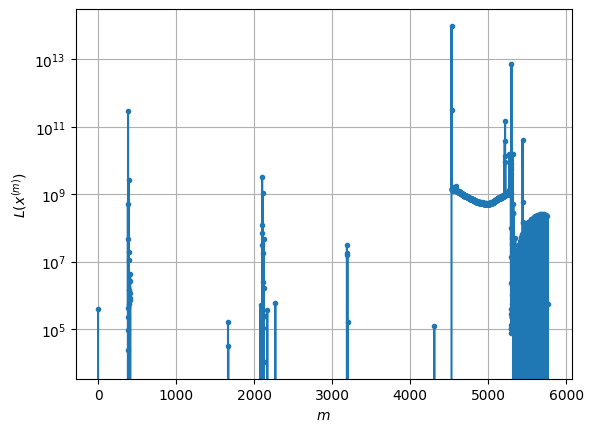

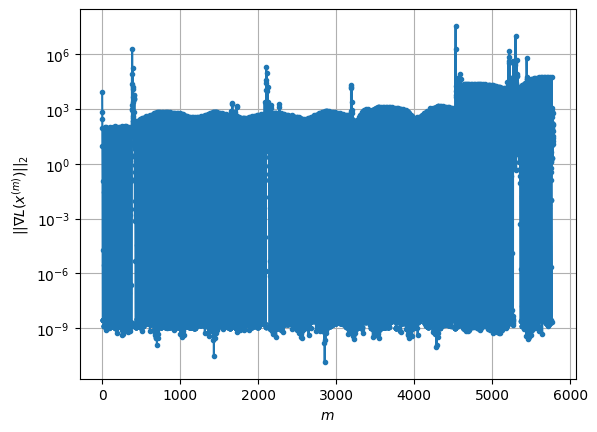

Windows:  95%|█████████▍| 374/395 [03:50<00:08,  2.36it/s]

Before applying the algorithm
Cost function: 230308857.86197698
Gradient norm: 56163.717336486356
Global relative error: 10206.328360828977
Position relative errors: 5.866269123683951 m, 1705.0762182525145 m, 4338.122585246558 m, 9078.40690806529 m

Iteration 1
Cost function: -145113.35029099594 (-100.06%)
Gradient norm: 197.79485584923447 (-99.65%)
Global relative error: 5786.873961661583 (-43.30%)
Position relative errors: 0.25270454333439674 m, 2010.2572160680495 m, 3712.7594408067885 m, 3954.3841127765168 m

Iteration 2
Cost function: -222747.3506567057 (-53.50%)
Gradient norm: 87.52194676426632 (-55.75%)
Global relative error: 5114.200318038992 (-11.62%)
Position relative errors: 0.25270454333439674 m, 1324.2348891200797 m, 3080.2290775757124 m, 3858.574333144359 m

Iteration 3
Cost function: -232717.5362003938 (-4.48%)
Gradient norm: 24.35593985603765 (-72.17%)
Global relative error: 4906.7775786921575 (-4.06%)
Position relative errors: 0.25270454333439674 m, 1034.997674249115 m,

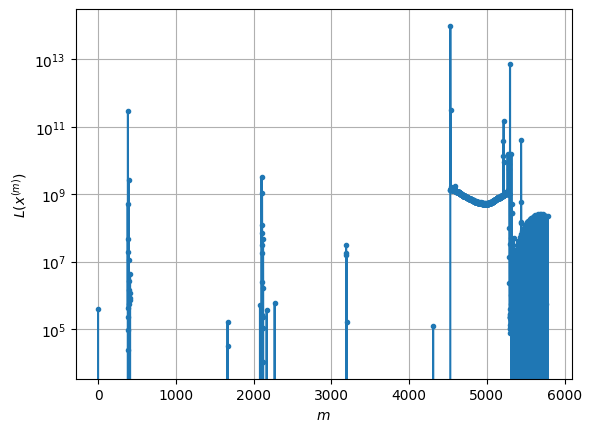

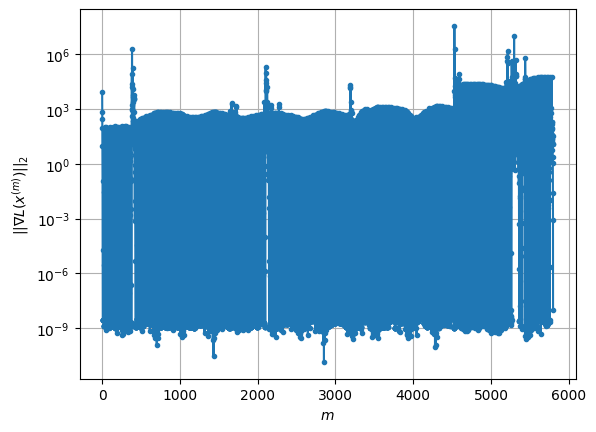

Windows:  95%|█████████▍| 375/395 [03:51<00:08,  2.33it/s]

Before applying the algorithm
Cost function: 209623268.3318
Gradient norm: 53601.6819797116
Global relative error: 9530.936699640224
Position relative errors: 5.977174573413894 m, 1644.2168895466095 m, 2651.130701872821 m, 9004.543461071235 m

Iteration 1
Cost function: -182544.728351824 (-100.09%)
Gradient norm: 124.33657154014332 (-99.77%)
Global relative error: 4966.960223719299 (-47.89%)
Position relative errors: 0.30129808655977236 m, 1868.979217893219 m, 1187.9644899477614 m, 4443.12708591666 m

Iteration 2
Cost function: -224359.8359602502 (-22.91%)
Gradient norm: 76.92333987533537 (-38.13%)
Global relative error: 4534.59757534425 (-8.70%)
Position relative errors: 0.30129808655977236 m, 1105.5206752902675 m, 410.39734909025583 m, 4375.728580085102 m

Iteration 3
Cost function: 1380099.358344199 (715.13%)
Gradient norm: 2911.551108340766 (3685.00%)
Global relative error: 13272.285815847492 (192.69%)
Position relative errors: 0.30129808655977236 m, 3825.906619308878 m, 9673.89092

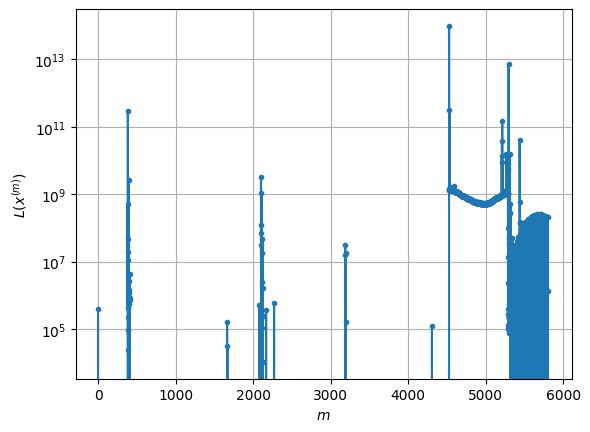

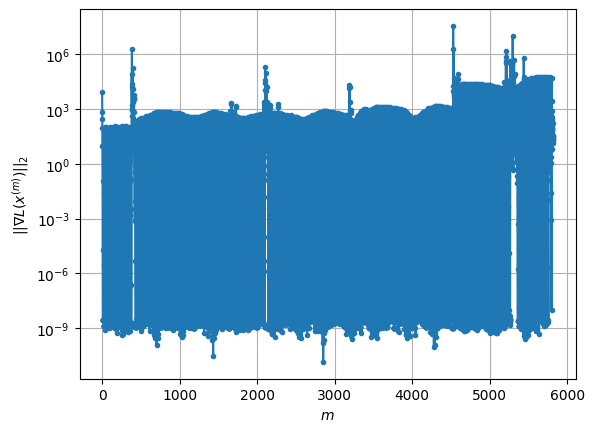

Windows:  95%|█████████▌| 376/395 [03:51<00:07,  2.43it/s]

Before applying the algorithm
Cost function: 193041116.1751969
Gradient norm: 51381.7063949138
Global relative error: 9514.19259456225
Position relative errors: 6.121710314191411 m, 1884.511502083779 m, 2611.0834332829895 m, 8951.299676875578 m

Iteration 1
Cost function: -32271.774026062427 (-100.02%)
Gradient norm: 299.91496875398633 (-99.42%)
Global relative error: 5647.401679563452 (-40.64%)
Position relative errors: 0.19205405733346723 m, 2270.1577836672527 m, 1162.6927829710673 m, 5036.145130388035 m

Iteration 2
Cost function: -198252.77775296 (-514.32%)
Gradient norm: 162.28005555681392 (-45.89%)
Global relative error: 5045.751699816038 (-10.65%)
Position relative errors: 0.19205405733346723 m, 1361.0975106440742 m, 868.0106004739464 m, 4777.935149674266 m

Iteration 3
Cost function: -227691.42596816045 (-14.85%)
Gradient norm: 48.00797763194647 (-70.42%)
Global relative error: 5244.663213341369 (3.94%)
Position relative errors: 0.19205405733346723 m, 927.1103173345779 m, 934.4

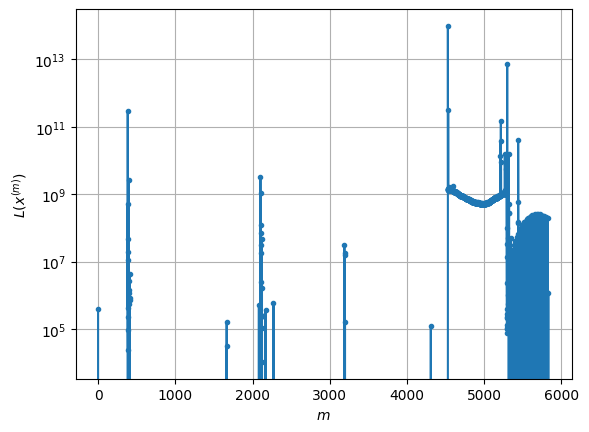

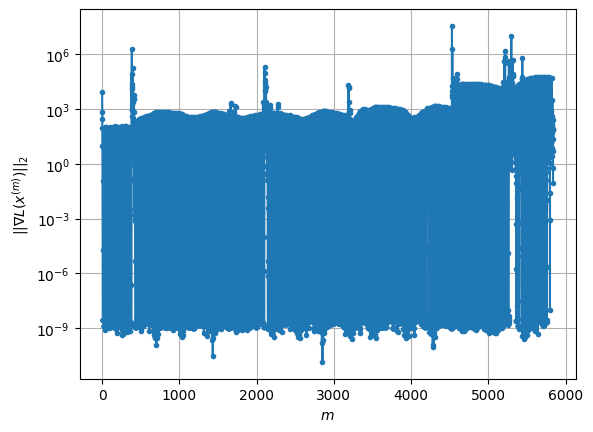

Windows:  95%|█████████▌| 377/395 [03:52<00:07,  2.32it/s]

Before applying the algorithm
Cost function: 171586126.4092269
Gradient norm: 48353.17162964146
Global relative error: 9471.01687786691
Position relative errors: 5.870689514466441 m, 1683.4035894827775 m, 2602.4287319387686 m, 8948.11517631276 m

Iteration 1
Cost function: 491201.0172773227 (-99.71%)
Gradient norm: 728.6499790385395 (-98.49%)
Global relative error: 6361.274309646303 (-32.83%)
Position relative errors: 0.12788302991228606 m, 2320.073022612971 m, 1306.4255436393164 m, 5775.0711006445945 m

Iteration 2
Cost function: -93046.20411561243 (-118.94%)
Gradient norm: 433.2206854096463 (-40.54%)
Global relative error: 5062.979976725671 (-20.41%)
Position relative errors: 0.12788302991228606 m, 1253.0411978895943 m, 881.5892441594282 m, 4823.025638742032 m

Iteration 3
Cost function: -205239.29989939637 (-120.58%)
Gradient norm: 255.97513236303 (-40.91%)
Global relative error: 5891.613948848957 (16.37%)
Position relative errors: 0.12788302991228606 m, 319.0172854244145 m, 1770.33

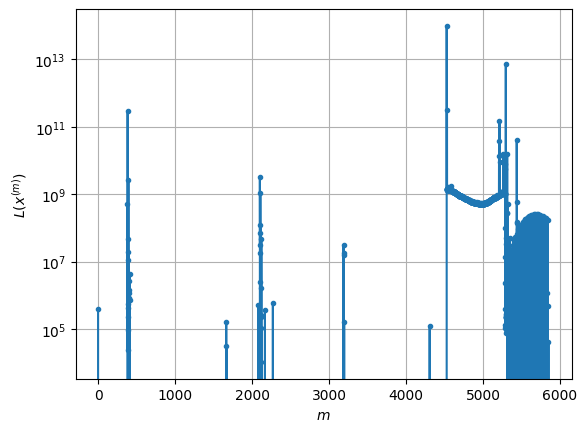

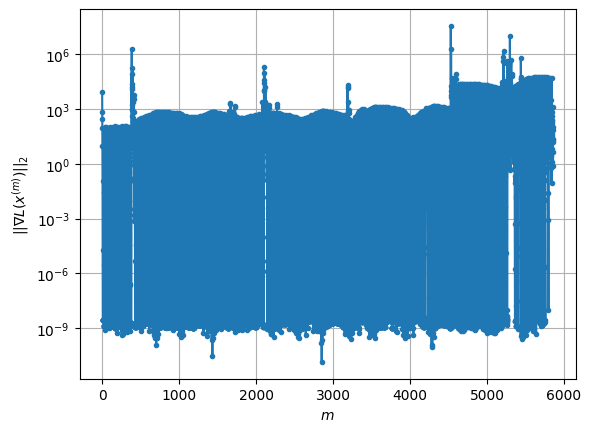

Windows:  96%|█████████▌| 378/395 [03:52<00:07,  2.32it/s]

Before applying the algorithm
Cost function: 149951187.02373976
Gradient norm: 45142.45183879397
Global relative error: 9510.475077198813
Position relative errors: 6.042348930703204 m, 1682.268324373145 m, 2653.3635834810175 m, 8975.181104365087 m

Iteration 1
Cost function: 1438048.5727271116 (-99.04%)
Gradient norm: 1328.7208704678767 (-97.06%)
Global relative error: 7139.953310370758 (-24.93%)
Position relative errors: 0.2097604180974174 m, 2553.516594728488 m, 1572.8068532919622 m, 6477.646642601337 m

Iteration 2
Cost function: 123658.28185665642 (-91.40%)
Gradient norm: 938.9209609834821 (-29.34%)
Global relative error: 5475.42903966696 (-23.31%)
Position relative errors: 0.2097604180974174 m, 1727.808164878855 m, 1638.2487949470058 m, 4928.111621007266 m

Iteration 3
Cost function: -167200.43159493062 (-235.21%)
Gradient norm: 228.48193503382402 (-75.67%)
Global relative error: 5792.06526795701 (5.78%)
Position relative errors: 0.2097604180974174 m, 617.9695933282975 m, 1966.655

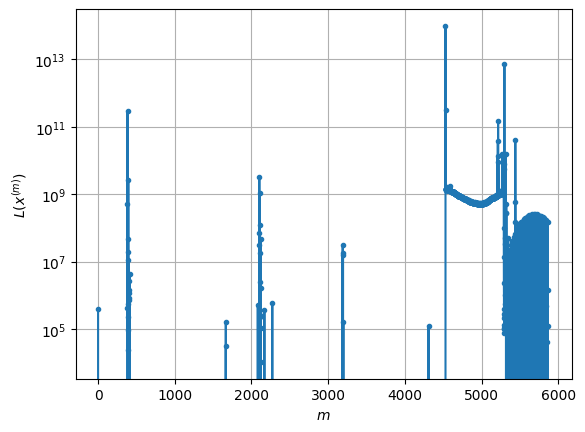

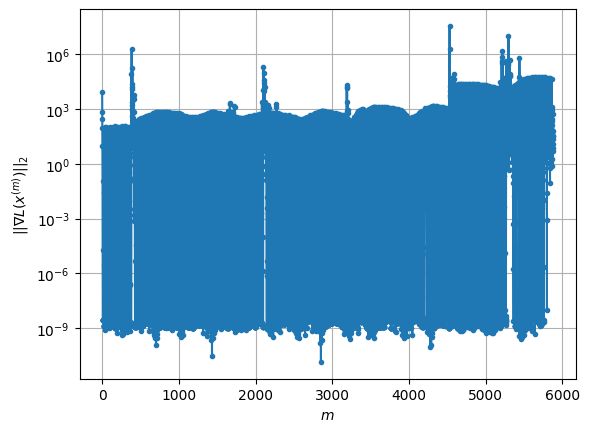

Windows:  96%|█████████▌| 379/395 [03:52<00:06,  2.38it/s]

Before applying the algorithm
Cost function: 130469906.70661037
Gradient norm: 42064.2319742045
Global relative error: 9506.282296542891
Position relative errors: 6.084465266441575 m, 1679.6002729265624 m, 2598.052005967028 m, 8987.412037321901 m

Iteration 1
Cost function: 3139864.595023564 (-97.59%)
Gradient norm: 2210.309654477436 (-94.75%)
Global relative error: 7811.7952579478815 (-17.82%)
Position relative errors: 0.14730280177694993 m, 2918.87846586105 m, 1601.2779443597888 m, 7065.079116833305 m

Iteration 2
Cost function: 443828.808699063 (-85.86%)
Gradient norm: 1152.2641055775146 (-47.87%)
Global relative error: 5367.951810774773 (-31.28%)
Position relative errors: 0.14730280177694993 m, 1759.9929693969773 m, 1007.417948459007 m, 4967.653449685632 m

Iteration 3
Cost function: -89064.75639597714 (-120.07%)
Gradient norm: 590.9123537978064 (-48.72%)
Global relative error: 6394.912722968319 (19.13%)
Position relative errors: 0.14730280177694993 m, 419.7843307901239 m, 2447.836

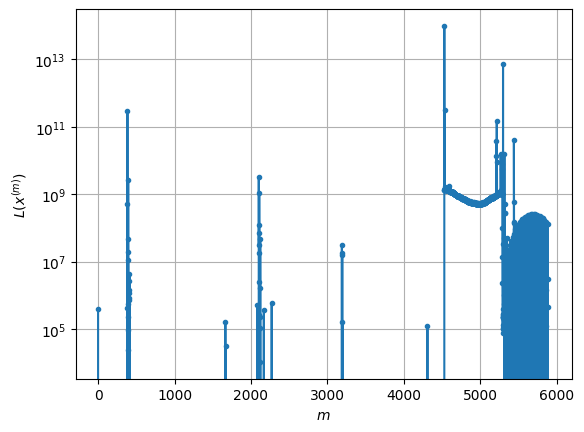

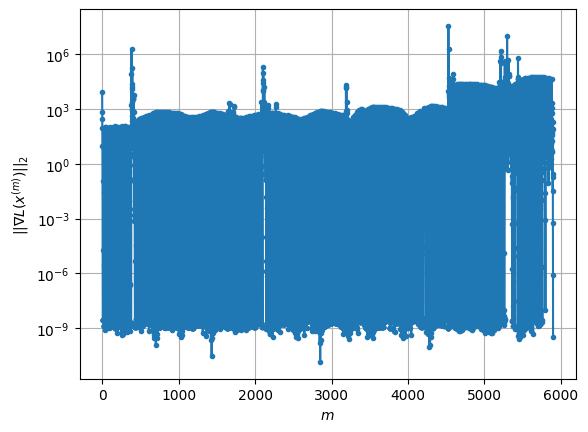

Windows:  96%|█████████▌| 380/395 [03:53<00:06,  2.35it/s]

Before applying the algorithm
Cost function: 112079125.29906489
Gradient norm: 38930.87868301371
Global relative error: 9401.157531156077
Position relative errors: 5.9946375088670525 m, 1690.630426102649 m, 2519.666374249432 m, 8896.62299878423 m

Iteration 1
Cost function: 7167566.212773956 (-93.60%)
Gradient norm: 3912.2664430245036 (-89.95%)
Global relative error: 8610.167749119564 (-8.41%)
Position relative errors: 0.09469869487395538 m, 3967.114922206882 m, 1761.5166294481546 m, 7434.3238216358295 m

Iteration 2
Cost function: 1115835.0336438268 (-84.43%)
Gradient norm: 1355.2520071226004 (-65.36%)
Global relative error: 6462.776603966166 (-24.94%)
Position relative errors: 0.0946986948522905 m, 1860.3024641290585 m, 1837.413882781995 m, 5908.112224464766 m

Iteration 3
Cost function: 48270.71306186083 (-95.67%)
Gradient norm: 683.8194872552839 (-49.54%)
Global relative error: 7516.465641169624 (16.30%)
Position relative errors: 0.0946986948522905 m, 552.6607767878537 m, 3521.9077

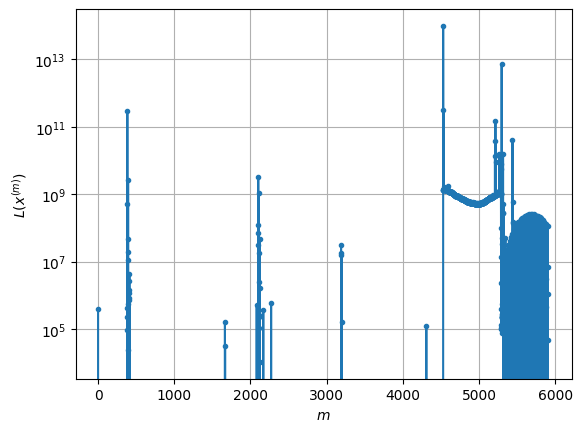

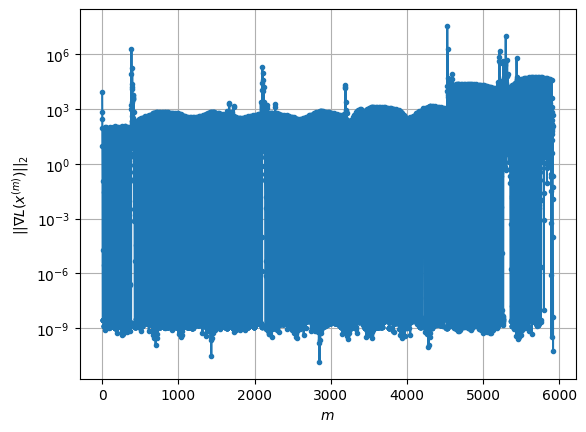

Windows:  96%|█████████▋| 381/395 [03:53<00:05,  2.34it/s]

Before applying the algorithm
Cost function: 92479754.22451864
Gradient norm: 35310.96067080087
Global relative error: 9504.987605607255
Position relative errors: 5.953643938770467 m, 1672.814618326343 m, 2620.6058329640614 m, 8980.754445722898 m

Iteration 1
Cost function: 31413515.301602457 (-66.03%)
Gradient norm: 11118.541128168565 (-68.51%)
Global relative error: 11427.403296233673 (20.23%)
Position relative errors: 0.19615143039772384 m, 7188.9529652560395 m, 2531.090280733019 m, 8513.117141621147 m

Iteration 2
Cost function: 4669296.700445958 (-85.14%)
Gradient norm: 2970.3598803996124 (-73.28%)
Global relative error: 8433.73168939489 (-26.20%)
Position relative errors: 0.19615143040892352 m, 3046.85821013303 m, 3065.4769473730835 m, 7240.332620760534 m

Iteration 3
Cost function: 681499.0865063379 (-85.40%)
Gradient norm: 1022.7412138573027 (-65.57%)
Global relative error: 7040.300102483295 (-16.52%)
Position relative errors: 0.19615143040892352 m, 1024.4353444747549 m, 3224.6

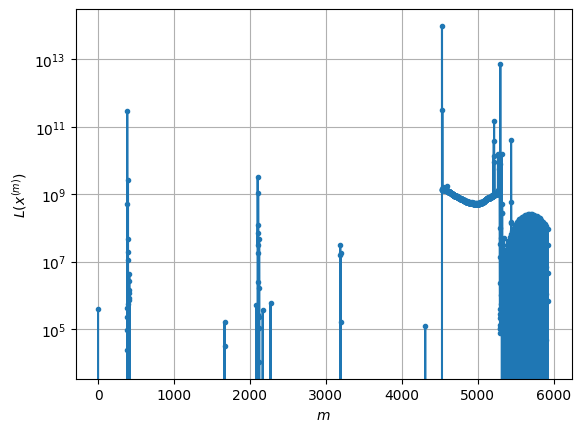

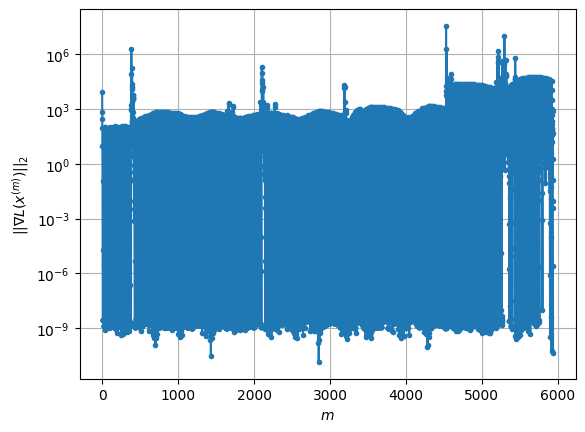

Windows:  97%|█████████▋| 382/395 [03:54<00:05,  2.42it/s]

Before applying the algorithm
Cost function: 76222461.85885644
Gradient norm: 31984.22177928651
Global relative error: 9539.712416560971
Position relative errors: 6.047676469188018 m, 1647.704524898726 m, 2623.3053145344784 m, 9021.331989178681 m

Iteration 1
Cost function: 92998560740.52196 (121909.39%)
Gradient norm: 1107287.0061840995 (3361.98%)
Global relative error: 213159.82412638544 (2134.45%)
Position relative errors: 0.16899752391742268 m, 201500.24631649832 m, 25041.48422006207 m, 64866.48163286809 m

Iteration 2
Cost function: 1347599746.8758748 (-98.55%)
Gradient norm: 80337.00141039825 (-92.74%)
Global relative error: 50300.238750718236 (-76.40%)
Position relative errors: 0.1689975239173462 m, 24620.309274923715 m, 6293.919076240686 m, 43408.70866124508 m

Iteration 3
Cost function: 8128203607.557613 (503.16%)
Gradient norm: 290959.97446534166 (262.17%)
Global relative error: 116162.43551765542 (130.94%)
Position relative errors: 0.16899752390480863 m, 79375.48504370921 m,

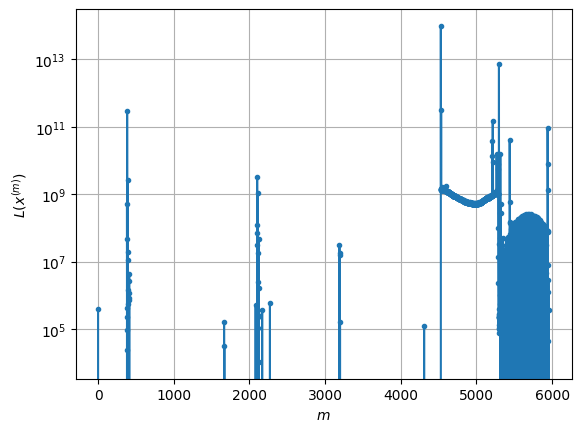

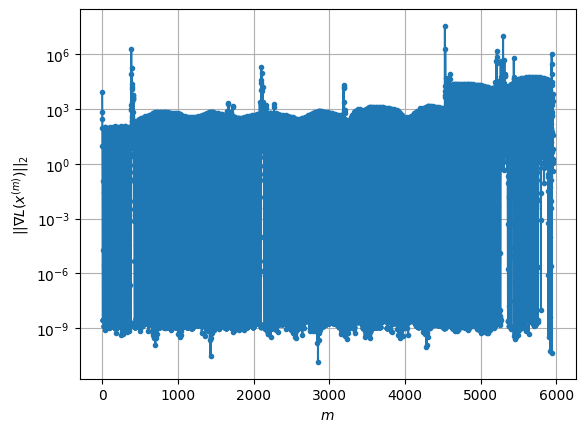

Windows:  97%|█████████▋| 383/395 [03:54<00:04,  2.47it/s]

Before applying the algorithm
Cost function: 61760628.2315406
Gradient norm: 28675.515041321345
Global relative error: 9517.319455934032
Position relative errors: 5.922047936552471 m, 1662.5510189422023 m, 2716.6044770306394 m, 8967.176173419775 m

Iteration 1
Cost function: 4931472.068359316 (-92.02%)
Gradient norm: 8233.111851394076 (-71.29%)
Global relative error: 9901.511977825216 (4.04%)
Position relative errors: 0.1758004379065512 m, 7347.882056275547 m, 1303.850407399683 m, 6505.649280664094 m

Iteration 2
Cost function: -207943.48613678882 (-104.22%)
Gradient norm: 75.51408119599766 (-99.08%)
Global relative error: 8803.018399465562 (-11.09%)
Position relative errors: 0.1758004379117668 m, 6285.108672759142 m, 2739.4728792766155 m, 5519.126739842674 m

Iteration 3
Cost function: -228716.19100558068 (-9.99%)
Gradient norm: 65.91799421008034 (-12.71%)
Global relative error: 7587.000709707697 (-13.81%)
Position relative errors: 0.1758004379117668 m, 5134.289570206842 m, 3233.13048

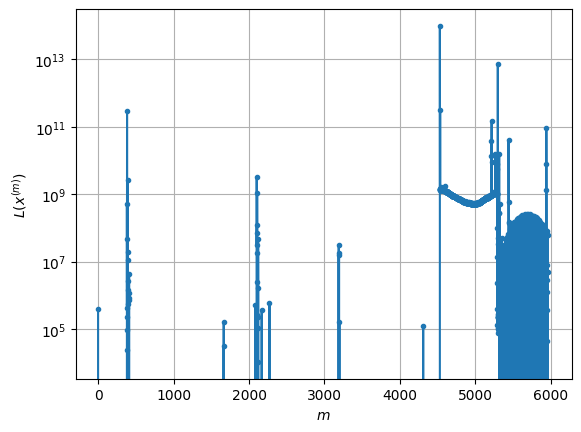

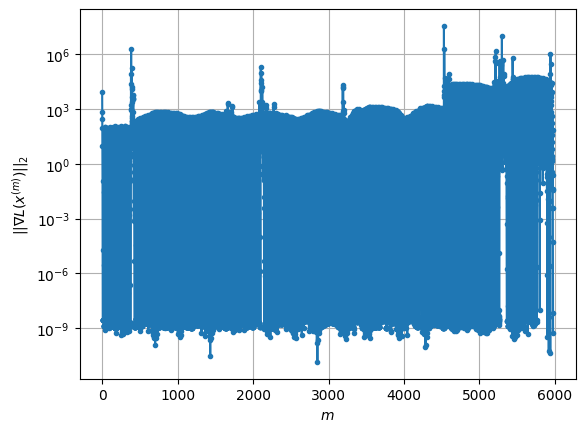

Windows:  97%|█████████▋| 384/395 [03:54<00:04,  2.45it/s]

Before applying the algorithm
Cost function: 45437117.90069391
Gradient norm: 24888.04041572516
Global relative error: 9799.950606100936
Position relative errors: 6.247824652077932 m, 2200.745683984443 m, 4299.139796295907 m, 8525.721835385515 m

Iteration 1
Cost function: 6885632.061424077 (-84.85%)
Gradient norm: 3986.9588046585077 (-83.98%)
Global relative error: 10239.440767502525 (4.48%)
Position relative errors: 0.18032229802146857 m, 2065.9125584856047 m, 4321.795403528431 m, 9048.483934380614 m

Iteration 2
Cost function: 1038936.0572976014 (-84.91%)
Gradient norm: 1347.6796991160816 (-66.20%)
Global relative error: 11171.163350392053 (9.10%)
Position relative errors: 0.18032229802146857 m, 1372.0910413954882 m, 6248.44337182185 m, 9156.638940857056 m

Iteration 3
Cost function: 1797.1894121520818 (-99.83%)
Gradient norm: 543.7203934660397 (-59.66%)
Global relative error: 10378.369864772854 (-7.10%)
Position relative errors: 0.18032229802146857 m, 2223.6365217664484 m, 6260.218

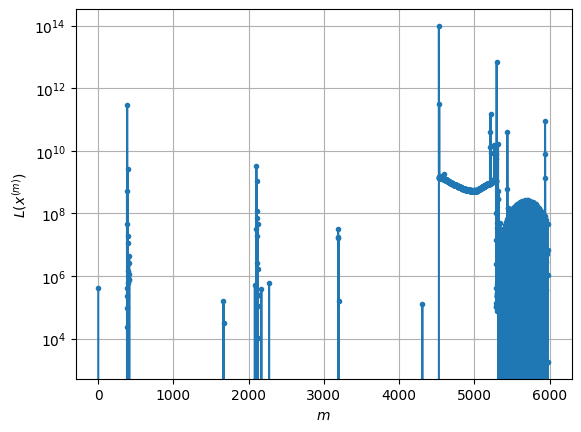

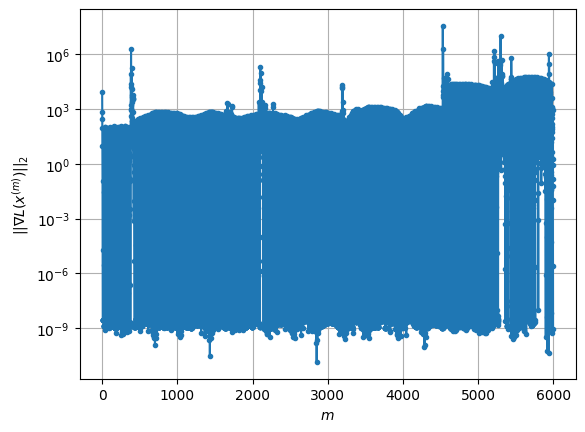

Windows:  97%|█████████▋| 385/395 [03:55<00:04,  2.26it/s]

Before applying the algorithm
Cost function: 39773996.762869574
Gradient norm: 22727.306720166485
Global relative error: 9553.799873713679
Position relative errors: 6.226554231048247 m, 1647.2045769125093 m, 2584.8548256475315 m, 9047.374933282374 m

Iteration 1
Cost function: -1952.1096881296326 (-100.00%)
Gradient norm: 1254.3607401426173 (-94.48%)
Global relative error: 7645.819297224226 (-19.97%)
Position relative errors: 0.12404177603546661 m, 2785.495366399098 m, 2035.975530267656 m, 6821.221974735001 m

Iteration 2
Cost function: -210126.61597509094 (-10664.08%)
Gradient norm: 192.40128943903147 (-84.66%)
Global relative error: 8092.5808718260105 (5.84%)
Position relative errors: 0.12404177604026755 m, 3149.4556476008574 m, 3689.6411845483667 m, 6475.495310708258 m

Iteration 3
Cost function: -231152.72602470074 (-10.01%)
Gradient norm: 97.6877484375595 (-49.23%)
Global relative error: 7275.3738835129925 (-10.10%)
Position relative errors: 0.12404177604026755 m, 2909.87708209540

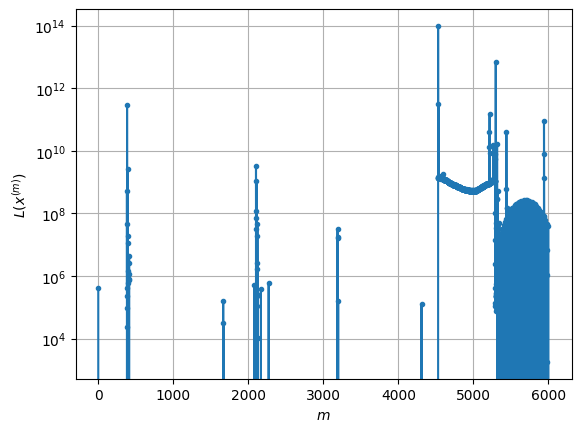

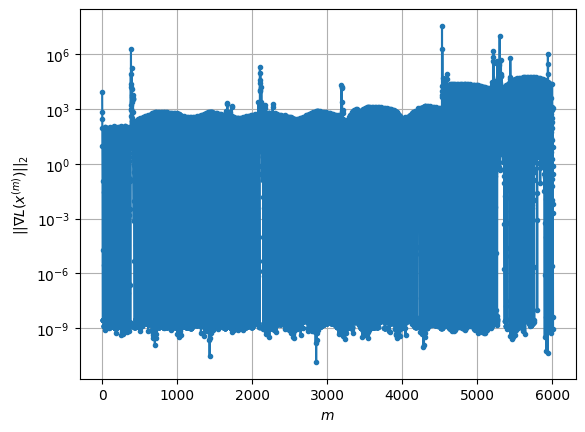

Windows:  98%|█████████▊| 386/395 [03:55<00:03,  2.37it/s]

Before applying the algorithm
Cost function: 31261812.727750875
Gradient norm: 19936.762963000165
Global relative error: 9658.516728571643
Position relative errors: 6.055886957998795 m, 1645.7546976475362 m, 2719.0175077921413 m, 9119.204527468522 m

Iteration 1
Cost function: 49044.73295493676 (-99.84%)
Gradient norm: 828.3678741456412 (-95.85%)
Global relative error: 7355.2313622663 (-23.85%)
Position relative errors: 0.1348655169068625 m, 2005.0643932413157 m, 2564.1631650803747 m, 6593.84255499462 m

Iteration 2
Cost function: -192932.6896346614 (-493.38%)
Gradient norm: 194.50547389845855 (-76.52%)
Global relative error: 7851.918234611372 (6.75%)
Position relative errors: 0.1348655169068625 m, 2676.5921464729904 m, 3949.1663184947392 m, 6234.348966742217 m

Iteration 3
Cost function: -229343.7000455879 (-18.87%)
Gradient norm: 95.17630898049167 (-51.07%)
Global relative error: 7333.839676080375 (-6.60%)
Position relative errors: 0.1348655169068625 m, 2738.17610055308 m, 4158.93524

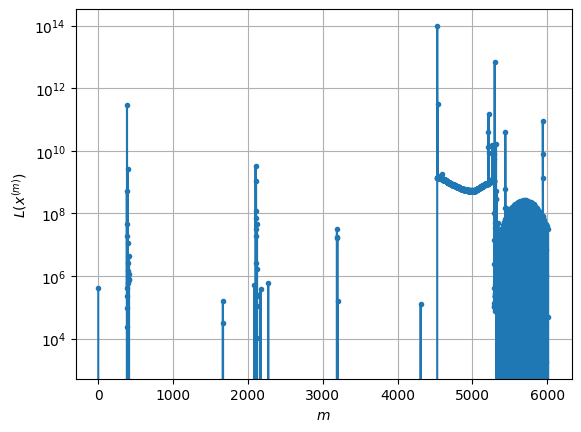

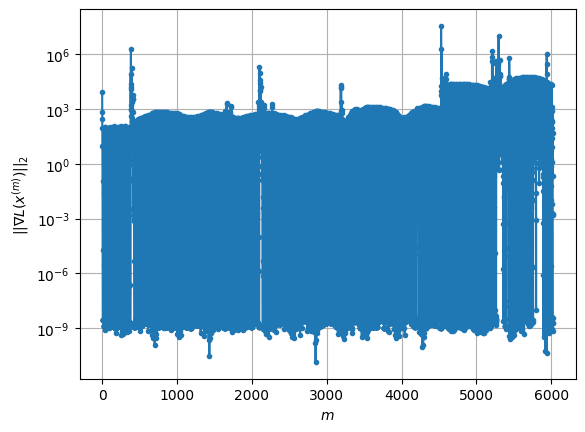

Windows:  98%|█████████▊| 387/395 [03:56<00:03,  2.35it/s]

Before applying the algorithm
Cost function: 25993700.2785088
Gradient norm: 17989.043440572197
Global relative error: 9577.702077744803
Position relative errors: 6.2125343086174425 m, 1637.3693940899022 m, 2616.9938860571488 m, 9065.157903515317 m

Iteration 1
Cost function: 159679.16378624254 (-99.39%)
Gradient norm: 761.0658714694014 (-95.77%)
Global relative error: 6808.124541005129 (-28.92%)
Position relative errors: 0.1313870632623625 m, 1277.82880203012 m, 2808.7406637616127 m, 6066.553720077193 m

Iteration 2
Cost function: -177645.46921363962 (-211.25%)
Gradient norm: 202.43768505793548 (-73.40%)
Global relative error: 7219.5055114117495 (6.04%)
Position relative errors: 0.1313870632623625 m, 2130.295210288248 m, 3909.0598870232598 m, 5681.26198852906 m

Iteration 3
Cost function: -228468.54988185447 (-28.61%)
Gradient norm: 83.04860274122241 (-58.98%)
Global relative error: 6975.064191942736 (-3.39%)
Position relative errors: 0.1313870632623625 m, 2445.9915653183566 m, 4096.2

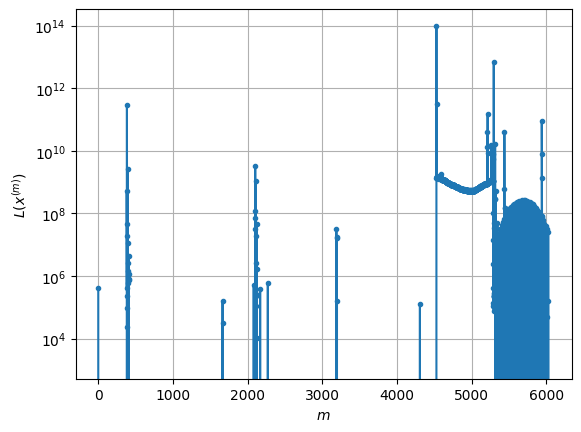

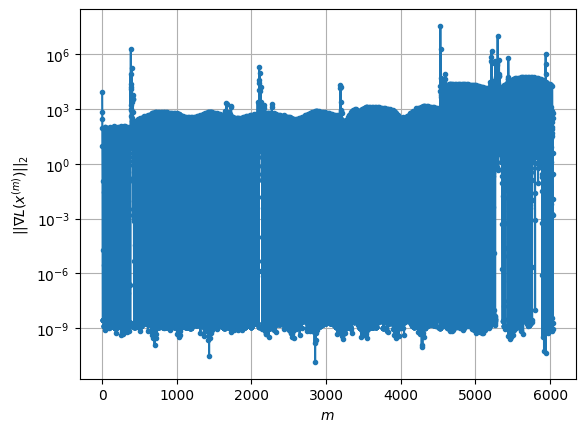

Windows:  98%|█████████▊| 388/395 [03:56<00:03,  2.30it/s]

Before applying the algorithm
Cost function: 22377839.65350286
Gradient norm: 16505.963830701425
Global relative error: 9607.284524908497
Position relative errors: 6.126164500126708 m, 1645.3157509292264 m, 2610.3722357566594 m, 9096.866356597031 m

Iteration 1
Cost function: 329990.3637915541 (-98.53%)
Gradient norm: 873.8632853328 (-94.71%)
Global relative error: 6296.7222305670175 (-34.46%)
Position relative errors: 0.13294826696265638 m, 558.0949351984519 m, 3356.746394253958 m, 5295.6303445206295 m

Iteration 2
Cost function: -154960.61283344973 (-146.96%)
Gradient norm: 232.58961849180002 (-73.38%)
Global relative error: 6610.928020479473 (4.99%)
Position relative errors: 0.13294826696265638 m, 1463.9945865797945 m, 4069.426075998927 m, 4997.506054356273 m

Iteration 3
Cost function: -226867.01553012725 (-46.40%)
Gradient norm: 76.45714312522918 (-67.13%)
Global relative error: 6596.70066414535 (-0.22%)
Position relative errors: 0.13294826696265638 m, 2088.150148316614 m, 4108.83

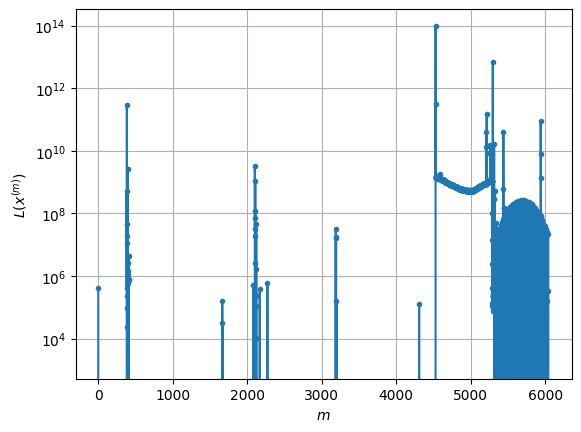

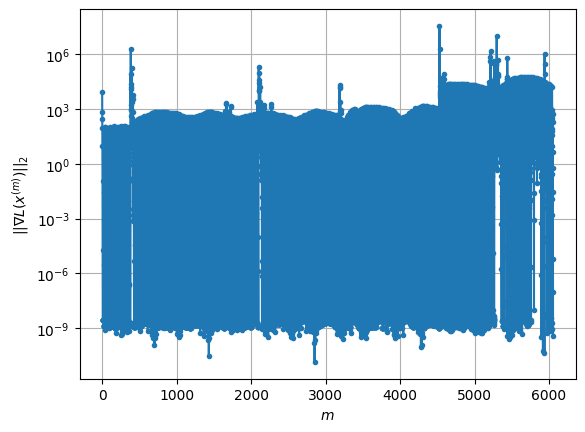

Windows:  98%|█████████▊| 389/395 [03:57<00:02,  2.17it/s]

Before applying the algorithm
Cost function: 20622759.96049903
Gradient norm: 15757.82151038976
Global relative error: 9784.47152584819
Position relative errors: 6.30518027717261 m, 1692.4379411478567 m, 2723.989880730002 m, 9242.585272109558 m

Iteration 1
Cost function: 714514.7222788276 (-96.54%)
Gradient norm: 1280.2404677105587 (-91.88%)
Global relative error: 6233.200253047932 (-36.29%)
Position relative errors: 0.21041059566820144 m, 1613.9361049883687 m, 4558.798934105007 m, 3929.294359052182 m

Iteration 2
Cost function: -98354.65029218196 (-113.77%)
Gradient norm: 311.40786446480683 (-75.68%)
Global relative error: 5937.276086740381 (-4.75%)
Position relative errors: 0.21041059566820144 m, 510.8587318426754 m, 4578.270065129949 m, 3742.1544777145077 m

Iteration 3
Cost function: -220207.82756766598 (-123.89%)
Gradient norm: 89.84926959563408 (-71.15%)
Global relative error: 5974.521932117491 (0.63%)
Position relative errors: 0.21041059566820144 m, 1382.9959695136397 m, 4252.0

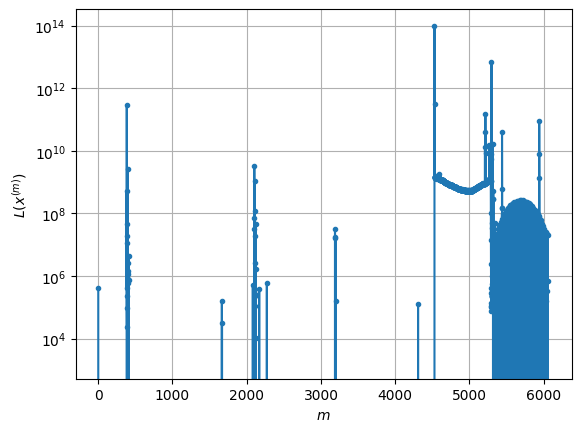

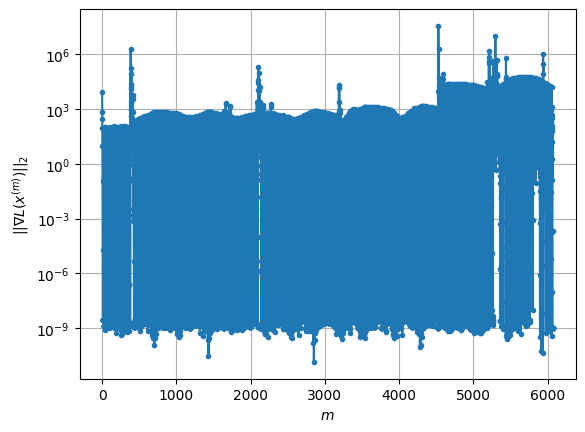

Windows:  99%|█████████▊| 390/395 [03:57<00:02,  2.28it/s]

Before applying the algorithm
Cost function: 21471720.825014327
Gradient norm: 16110.621810516808
Global relative error: 9683.544146047168
Position relative errors: 6.133279591117946 m, 1643.6729384759794 m, 2668.320204520248 m, 9160.960523228423 m

Iteration 1
Cost function: 2793607.6468396722 (-86.99%)
Gradient norm: 3067.9676004554085 (-80.96%)
Global relative error: 9284.18163968956 (-4.12%)
Position relative errors: 0.12548996625152828 m, 5497.979451189189 m, 7367.715192553768 m, 1287.9538182977678 m

Iteration 2
Cost function: 190958.28504523402 (-93.16%)
Gradient norm: 639.0495414895814 (-79.17%)
Global relative error: 6529.284429230666 (-29.67%)
Position relative errors: 0.12548996625152828 m, 3027.03129744287 m, 5647.505257984004 m, 1244.2357360016836 m

Iteration 3
Cost function: -168905.3772314457 (-188.45%)
Gradient norm: 243.852460328082 (-61.84%)
Global relative error: 5511.753468949285 (-15.58%)
Position relative errors: 0.12548996625152828 m, 933.9146980435547 m, 5174.8

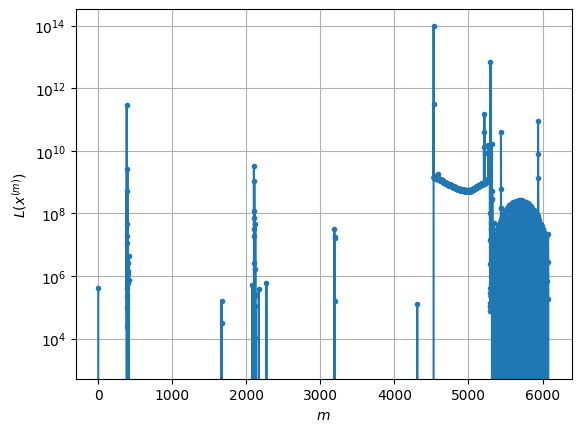

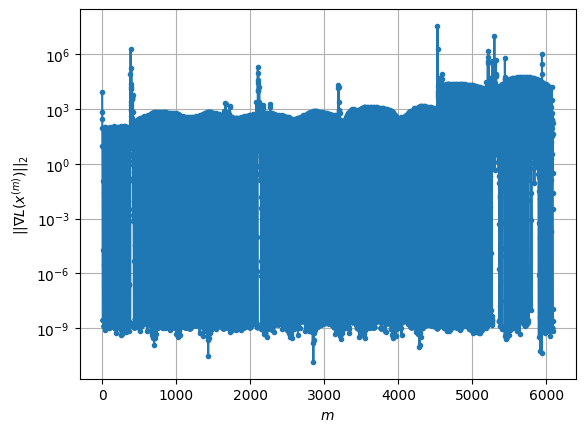

Windows:  99%|█████████▉| 391/395 [03:58<00:01,  2.29it/s]

Before applying the algorithm
Cost function: 24395964.724093113
Gradient norm: 17330.70665294283
Global relative error: 9844.737290715582
Position relative errors: 6.158646631773676 m, 1650.303235485161 m, 2757.334547725876 m, 9304.085226038533 m

Iteration 1
Cost function: 2366892441.80484 (9601.98%)
Gradient norm: 130190.3373462309 (651.21%)
Global relative error: 103505.62751625082 (951.38%)
Position relative errors: 0.1419438298437707 m, 63749.364369272604 m, 60226.96073077561 m, 54973.81425038912 m

Iteration 2
Cost function: 80951947.36342019 (-96.58%)
Gradient norm: 15732.702473371215 (-87.92%)
Global relative error: 39200.503855391435 (-62.13%)
Position relative errors: 0.1419438298437707 m, 21279.094456585346 m, 24687.747839541036 m, 21779.99839971557 m

Iteration 3
Cost function: 5164362788993.159 (6379441.14%)
Gradient norm: 8415659.76505759 (53391.51%)
Global relative error: 1423448.730923789 (3531.20%)
Position relative errors: 0.14194382976144385 m, 571322.200264466 m, 96

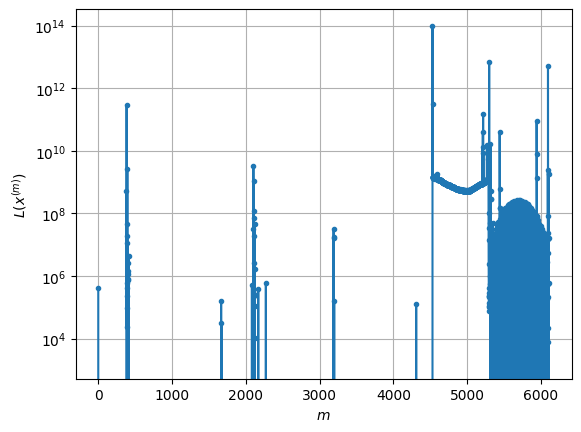

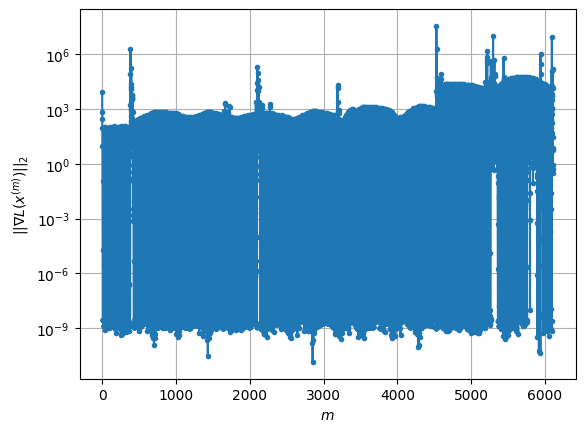

Windows:  99%|█████████▉| 392/395 [03:58<00:01,  2.29it/s]

Before applying the algorithm
Cost function: 28319355.511734728
Gradient norm: 18858.767929138503
Global relative error: 9672.581310510817
Position relative errors: 6.301065748674807 m, 1781.670757406677 m, 3311.0527322137245 m, 8910.373383175232 m

Iteration 1
Cost function: 83054684.95247737 (193.28%)
Gradient norm: 19308.673240315435 (2.39%)
Global relative error: 35152.79595311464 (263.43%)
Position relative errors: 0.19284061238521294 m, 17917.903012814353 m, 20876.78574839131 m, 21881.52227175137 m

Iteration 2
Cost function: 10277414.045476818 (-87.63%)
Gradient norm: 3761.1861840375195 (-80.52%)
Global relative error: 20322.023681401588 (-42.19%)
Position relative errors: 0.19284061238521294 m, 11052.760388536366 m, 11034.935889276298 m, 13000.95032639172 m

Iteration 3
Cost function: 1622007.6169509466 (-84.22%)
Gradient norm: 1484.661694217512 (-60.53%)
Global relative error: 13755.1492657499 (-32.31%)
Position relative errors: 0.19284061238521294 m, 8274.592905307345 m, 4743

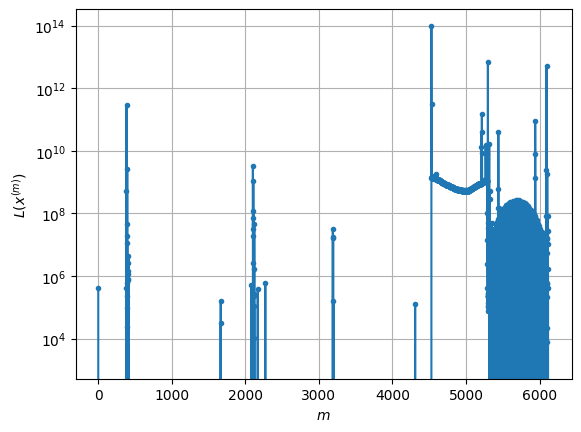

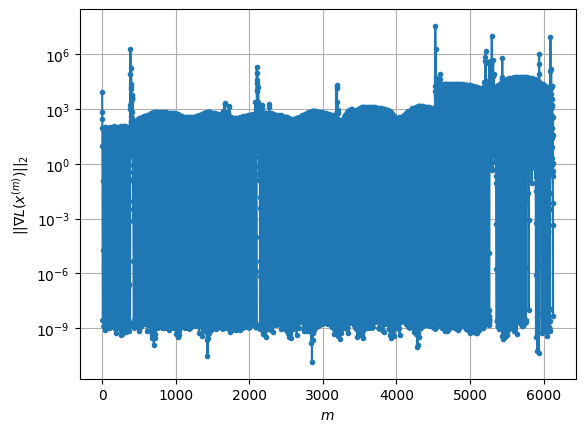

Windows:  99%|█████████▉| 393/395 [03:59<00:00,  2.11it/s]

Before applying the algorithm
Cost function: 35237533.47669156
Gradient norm: 21274.394774845925
Global relative error: 9908.367352040268
Position relative errors: 6.427090832366423 m, 1893.4913773118615 m, 3393.2774177228794 m, 9113.135465522602 m

Iteration 1
Cost function: 6817698015.685055 (19247.83%)
Gradient norm: 303473.5093933226 (1326.47%)
Global relative error: 73159.56669633936 (638.36%)
Position relative errors: 0.08895128540688209 m, 20824.4494602588 m, 68920.63032396525 m, 12984.005413574474 m

Iteration 2
Cost function: 24567671.010344025 (-99.64%)
Gradient norm: 7802.7241184118175 (-97.43%)
Global relative error: 38223.61581951068 (-47.75%)
Position relative errors: 0.08895128529702297 m, 14891.461546395612 m, 30356.33916338874 m, 17825.684527844467 m

Iteration 3
Cost function: 4231166.951254775 (-82.78%)
Gradient norm: 3585.365802731667 (-54.05%)
Global relative error: 40130.82224933778 (4.99%)
Position relative errors: 0.08895128540688209 m, 15115.845290843974 m, 276

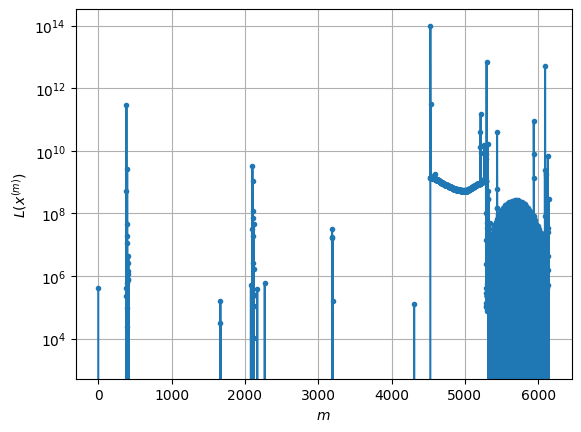

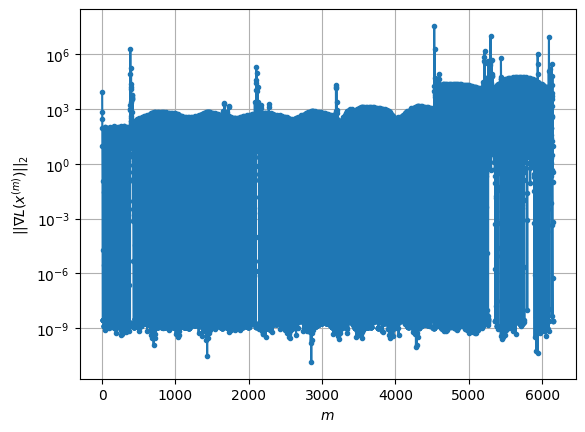

Windows: 100%|█████████▉| 394/395 [03:59<00:00,  2.23it/s]

Before applying the algorithm
Cost function: 42901661.88135339
Gradient norm: 23667.196750642604
Global relative error: 9823.34332773581
Position relative errors: 6.23184479132686 m, 1869.5245719265383 m, 3369.700435492565 m, 9034.434534510423 m

Iteration 1
Cost function: 9339280.999794831 (-78.23%)
Gradient norm: 11123.354382525396 (-53.00%)
Global relative error: 19337.109813607174 (96.85%)
Position relative errors: 0.14251626057920577 m, 10364.815578544456 m, 8179.265590002495 m, 14126.818593151953 m

Iteration 2
Cost function: 22735.455765098326 (-99.76%)
Gradient norm: 136.58044676279442 (-98.77%)
Global relative error: 18235.8220695315 (-5.70%)
Position relative errors: 0.14251626057920577 m, 9683.539196138083 m, 8537.13482267172 m, 12878.842315882004 m

Iteration 3
Cost function: 76712.52900171778 (237.41%)
Gradient norm: 521.9418354813556 (282.15%)
Global relative error: 19939.808866721625 (9.34%)
Position relative errors: 0.14251626057920577 m, 11143.950990843876 m, 10477.149

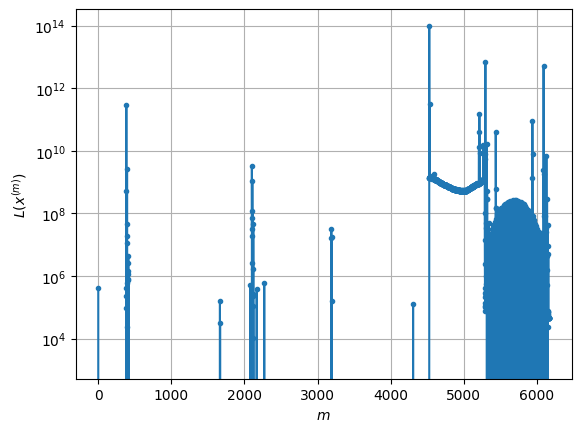

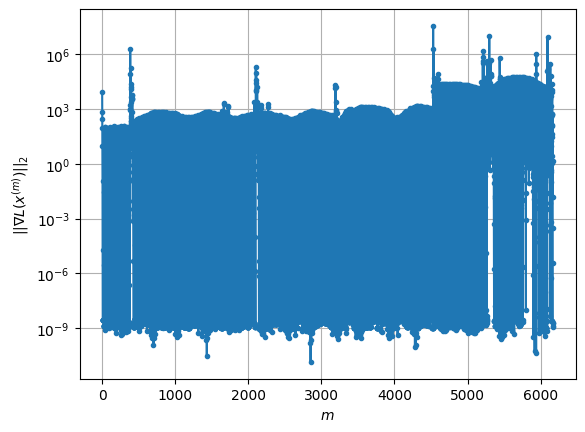

RMSE after convergence:
Chief: 0.18 m
Deputy 1: 6940.40 m
Deputy 2: 11893.20 m
Deputy 3: 52881.42 m


In [13]:
# Main execution loop
def run_estimation():
    # Initialize storage for results
    X_est_mm = np.zeros_like(X_true)
    X_est_mm[:, :, 0] = X_est[:, :, 0]  # Use same initial conditions
    
    # Storage for errors
    errors_chief_mm = []
    errors_deputy1_mm = []
    errors_deputy2_mm = []
    errors_deputy3_mm = []
    
    # Initialize solver
    solver = approxH_Newton()
    
    # Sliding window estimation
    for t in tqdm(range(T - W + 1), desc="Windows", leave=False):
        # Get measurements for current window
        Y_window = Y[:, :, t:t + W]
        
        # Initial guess is the previous estimate propagated forward
        if t == 0:
            x_init = X_est[:, :, t]
        else:
            x_init = X_est_mm[:, :, t]
        
        # Solve the optimization problem
        x_sol = solver.solve(x_init, Y_window, X_true[:, :, t])
        
        # Store the solution
        X_est_mm[:, :, t] = x_sol
        
        # Plot the results
        give_me_the_plots(solver.cost_function_values, solver.grad_norm_values)
        
        # Propagate solution to next timestep if not at the end
        if t < T - W:
            X_est_mm[:, :, t + 1] = SatelliteDynamics().x_new(dt, x_sol)
        
        # Calculate and store errors
        error_chief = np.linalg.norm(X_est_mm[:3, :, t] - X_true[:3, :, t])
        error_deputy1 = np.linalg.norm(X_est_mm[6:9, :, t] - X_true[6:9, :, t])
        error_deputy2 = np.linalg.norm(X_est_mm[12:15, :, t] - X_true[12:15, :, t])
        error_deputy3 = np.linalg.norm(X_est_mm[18:21, :, t] - X_true[18:21, :, t])
        
        errors_chief_mm.append(error_chief)
        errors_deputy1_mm.append(error_deputy1)
        errors_deputy2_mm.append(error_deputy2)
        errors_deputy3_mm.append(error_deputy3)
    
    return X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm

# Run the estimation
X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm = run_estimation()

# Print RMSE for each satellite
print("RMSE after convergence:")
print(f"Chief: {np.sqrt(np.mean(np.array(errors_chief_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 1: {np.sqrt(np.mean(np.array(errors_deputy1_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 2: {np.sqrt(np.mean(np.array(errors_deputy2_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 3: {np.sqrt(np.mean(np.array(errors_deputy3_mm[T_RMSE:])**2)):.2f} m")

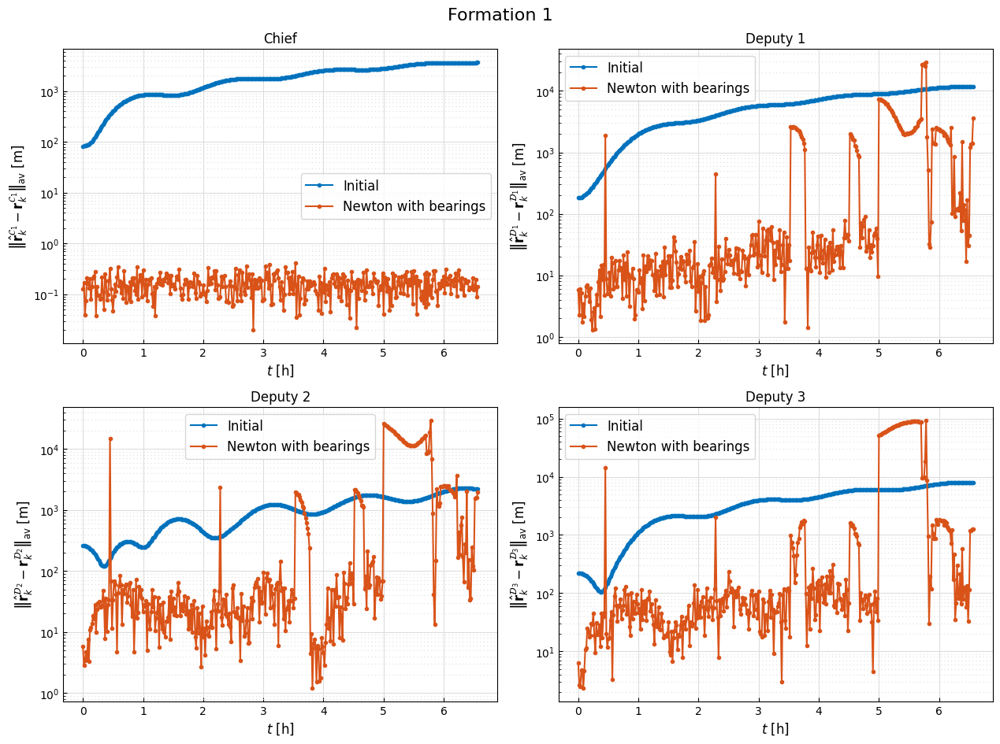

In [15]:
dev_chief = errors_chief_mm
dev_deputy1 = errors_deputy1_mm
dev_deputy2 = errors_deputy2_mm
dev_deputy3 = errors_deputy3_mm

# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, T) / dt
algorithm = "Newton with bearings"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, dev_chief_initial, ".-", label="Initial")
axs[0, 0].plot(time[:K - W + 1], dev_chief, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, dev_deputy1_initial, ".-", label="Initial")
axs[0, 1].plot(time[:K - W + 1], dev_deputy1, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, dev_deputy2_initial, ".-", label="Initial")
axs[1, 0].plot(time[:K - W + 1], dev_deputy2, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, dev_deputy3_initial, ".-", label="Initial")
axs[1, 1].plot(time[:K - W + 1], dev_deputy3, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()